In [1]:
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical
import numpy as np
from numpy import array
import pandas as pd
import cv2
from glob import glob
import PIL
import time
from tqdm import tqdm
import os

In [2]:
image_path = "C:/Users/batuh/Desktop/datasets/xray/"
images = glob(image_path + "*.png")
len(images)

7470

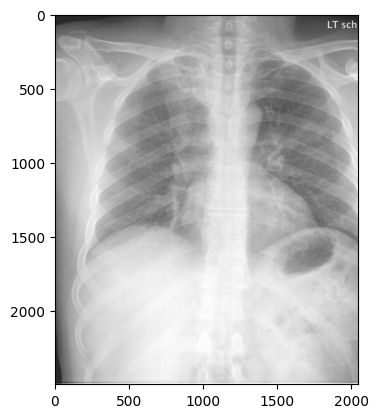

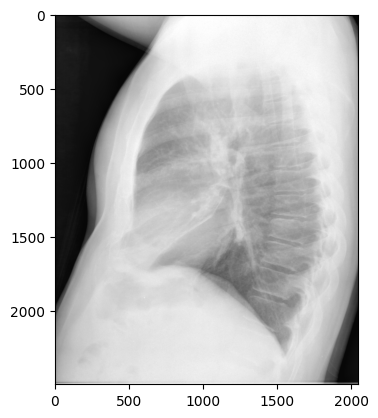

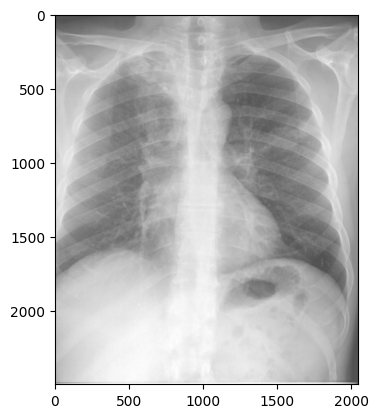

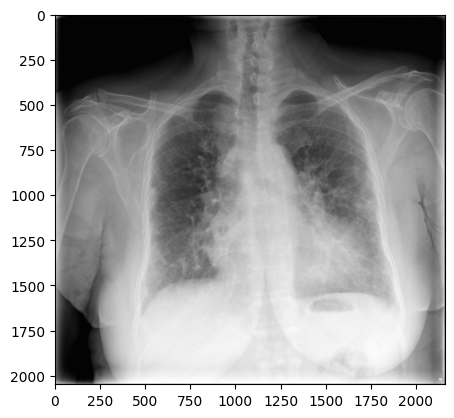

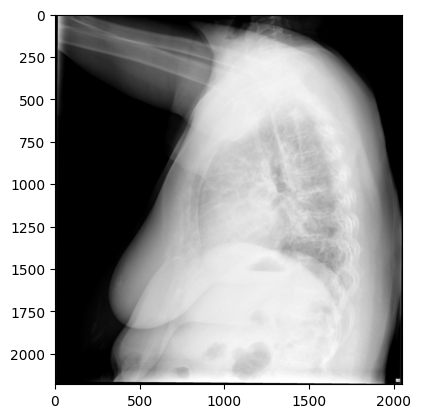

In [3]:
for i in range(5):
    plt.figure()
    image = cv2.imread(images[i])
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(image)

In [4]:
import re
# Read in the projections data
projections = pd.read_csv('C:/Users/batuh/Desktop/datasets/indiana_projections.csv')

# Read in the reports data
reports = pd.read_csv('C:/Users/batuh/Desktop/datasets/indiana_reports.csv')

# Define the path to the images folder
images_folder = 'C:/Users/batuh/Desktop/datasets/xray'

# Merge the projections and reports data on the UID column
reports = pd.merge(projections, reports, on='uid')

# Create a dictionary of image filenames and their corresponding captions
data = {}
for i in range(len(reports)):
    filename = reports.loc[i, 'filename']
    print(reports)
    caption = reports.loc[i, 'impression']
    if filename not in data:
        #print(data)
        data[filename] = []
    if isinstance(caption, str) and re.match(r'^\d+\.', caption):
        data[filename].append(caption.split('. ')[1])
    else:
        if data[filename]:
            data[filename][-1] += " " + caption
        else:
            data[filename].append(caption)

       uid                   filename projection  \
0        1     1_IM-0001-4001.dcm.png    Frontal   
1        1     1_IM-0001-3001.dcm.png    Lateral   
2        2     2_IM-0652-1001.dcm.png    Frontal   
3        2     2_IM-0652-2001.dcm.png    Lateral   
4        3     3_IM-1384-1001.dcm.png    Frontal   
...    ...                        ...        ...   
7461  3997  3997_IM-2048-1002.dcm.png    Lateral   
7462  3998  3998_IM-2048-1001.dcm.png    Frontal   
7463  3998  3998_IM-2048-1002.dcm.png    Lateral   
7464  3999  3999_IM-2049-1001.dcm.png    Frontal   
7465  3999  3999_IM-2049-2001.dcm.png    Lateral   

                                                   MeSH  \
0                                                normal   
1                                                normal   
2     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
3     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
4                                                normal   
...                  

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



       uid                   filename projection  \
0        1     1_IM-0001-4001.dcm.png    Frontal   
1        1     1_IM-0001-3001.dcm.png    Lateral   
2        2     2_IM-0652-1001.dcm.png    Frontal   
3        2     2_IM-0652-2001.dcm.png    Lateral   
4        3     3_IM-1384-1001.dcm.png    Frontal   
...    ...                        ...        ...   
7461  3997  3997_IM-2048-1002.dcm.png    Lateral   
7462  3998  3998_IM-2048-1001.dcm.png    Frontal   
7463  3998  3998_IM-2048-1002.dcm.png    Lateral   
7464  3999  3999_IM-2049-1001.dcm.png    Frontal   
7465  3999  3999_IM-2049-2001.dcm.png    Lateral   

                                                   MeSH  \
0                                                normal   
1                                                normal   
2     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
3     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
4                                                normal   
...                  

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



       uid                   filename projection  \
0        1     1_IM-0001-4001.dcm.png    Frontal   
1        1     1_IM-0001-3001.dcm.png    Lateral   
2        2     2_IM-0652-1001.dcm.png    Frontal   
3        2     2_IM-0652-2001.dcm.png    Lateral   
4        3     3_IM-1384-1001.dcm.png    Frontal   
...    ...                        ...        ...   
7461  3997  3997_IM-2048-1002.dcm.png    Lateral   
7462  3998  3998_IM-2048-1001.dcm.png    Frontal   
7463  3998  3998_IM-2048-1002.dcm.png    Lateral   
7464  3999  3999_IM-2049-1001.dcm.png    Frontal   
7465  3999  3999_IM-2049-2001.dcm.png    Lateral   

                                                   MeSH  \
0                                                normal   
1                                                normal   
2     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
3     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
4                                                normal   
...                  

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



       uid                   filename projection  \
0        1     1_IM-0001-4001.dcm.png    Frontal   
1        1     1_IM-0001-3001.dcm.png    Lateral   
2        2     2_IM-0652-1001.dcm.png    Frontal   
3        2     2_IM-0652-2001.dcm.png    Lateral   
4        3     3_IM-1384-1001.dcm.png    Frontal   
...    ...                        ...        ...   
7461  3997  3997_IM-2048-1002.dcm.png    Lateral   
7462  3998  3998_IM-2048-1001.dcm.png    Frontal   
7463  3998  3998_IM-2048-1002.dcm.png    Lateral   
7464  3999  3999_IM-2049-1001.dcm.png    Frontal   
7465  3999  3999_IM-2049-2001.dcm.png    Lateral   

                                                   MeSH  \
0                                                normal   
1                                                normal   
2     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
3     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
4                                                normal   
...                  

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



       uid                   filename projection  \
0        1     1_IM-0001-4001.dcm.png    Frontal   
1        1     1_IM-0001-3001.dcm.png    Lateral   
2        2     2_IM-0652-1001.dcm.png    Frontal   
3        2     2_IM-0652-2001.dcm.png    Lateral   
4        3     3_IM-1384-1001.dcm.png    Frontal   
...    ...                        ...        ...   
7461  3997  3997_IM-2048-1002.dcm.png    Lateral   
7462  3998  3998_IM-2048-1001.dcm.png    Frontal   
7463  3998  3998_IM-2048-1002.dcm.png    Lateral   
7464  3999  3999_IM-2049-1001.dcm.png    Frontal   
7465  3999  3999_IM-2049-2001.dcm.png    Lateral   

                                                   MeSH  \
0                                                normal   
1                                                normal   
2     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
3     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
4                                                normal   
...                  

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



       uid                   filename projection  \
0        1     1_IM-0001-4001.dcm.png    Frontal   
1        1     1_IM-0001-3001.dcm.png    Lateral   
2        2     2_IM-0652-1001.dcm.png    Frontal   
3        2     2_IM-0652-2001.dcm.png    Lateral   
4        3     3_IM-1384-1001.dcm.png    Frontal   
...    ...                        ...        ...   
7461  3997  3997_IM-2048-1002.dcm.png    Lateral   
7462  3998  3998_IM-2048-1001.dcm.png    Frontal   
7463  3998  3998_IM-2048-1002.dcm.png    Lateral   
7464  3999  3999_IM-2049-1001.dcm.png    Frontal   
7465  3999  3999_IM-2049-2001.dcm.png    Lateral   

                                                   MeSH  \
0                                                normal   
1                                                normal   
2     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
3     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
4                                                normal   
...                  

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



       uid                   filename projection  \
0        1     1_IM-0001-4001.dcm.png    Frontal   
1        1     1_IM-0001-3001.dcm.png    Lateral   
2        2     2_IM-0652-1001.dcm.png    Frontal   
3        2     2_IM-0652-2001.dcm.png    Lateral   
4        3     3_IM-1384-1001.dcm.png    Frontal   
...    ...                        ...        ...   
7461  3997  3997_IM-2048-1002.dcm.png    Lateral   
7462  3998  3998_IM-2048-1001.dcm.png    Frontal   
7463  3998  3998_IM-2048-1002.dcm.png    Lateral   
7464  3999  3999_IM-2049-1001.dcm.png    Frontal   
7465  3999  3999_IM-2049-2001.dcm.png    Lateral   

                                                   MeSH  \
0                                                normal   
1                                                normal   
2     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
3     Cardiomegaly/borderline;Pulmonary Artery/enlarged   
4                                                normal   
...                  

In [5]:
def cleanse_data(data):
    dict_2 = dict()
    for key, value in data.items():
        for i in range(len(value)):
            lines = ""
            line1 = value[i]
            if isinstance(line1, str):
                for j in line1.split():
                    if len(j) < 2:
                        continue
                    j = j.lower()
                    lines += j + " "
                if key not in dict_2:
                    dict_2[key] = list()
                dict_2[key].append(lines)
    return dict_2

data2 = cleanse_data(data)
print(len(data2))

7414


In [6]:
# convert the following into a vocabulary of words and calculate the total words

def vocabulary(data2):
    all_desc = set()
    for key in data2.keys():
        [all_desc.update(d.split()) for d in data2[key]]
    return all_desc

# summarize vocabulary
vocabulary_data = vocabulary(data2)
print(len(vocabulary_data))

1891


In [7]:
def save_dict(data2, filename):
    lines = list()
    for key, value in data2.items():
        for desc in value:
            lines.append(key + ' ' + desc)
    data = '\n'.join(lines)
    file = open(filename, 'w')
    file.write(data)
    file.close()

save_dict(data2, 'captions1.txt')

In [8]:
images = 'C:/Users/batuh/Desktop/datasets/xray/'
img = glob(images + '*.png')
print(len(img))

def preprocess(image_path):
    # Convert all the images to size 299x299 as expected by the inception v3 model
    img = keras.preprocessing.image.load_img(image_path, target_size=(299, 299))
    # Convert PIL image to numpy array of 3-dimensions
    x = keras.preprocessing.image.img_to_array(img)
    # Add one more dimension
    x = np.expand_dims(x, axis=0)
    # pre-process the images using preprocess_input() from inception module
    x = tf.keras.applications.xception.preprocess_input(x)
    return x

7470


In [9]:
from keras.applications.xception import Xception
from keras.models import Model

# Load the Xception model
input1 = Xception(weights='imagenet')

# Create a new model, by removing the last layer (output layer) from the Xception model
model = Model(input1.input, input1.layers[-2].output)

model.summary()



Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 299, 299, 3)]        0         []                            
                                                                                                  
 block1_conv1 (Conv2D)       (None, 149, 149, 32)         864       ['input_1[0][0]']             
                                                                                                  
 block1_conv1_bn (BatchNorm  (None, 149, 149, 32)         128       ['block1_conv1[0][0]']        
 alization)                                                                                       
                                                                                                  
 block1_conv1_act (Activati  (None, 149, 149, 32)         0         ['block1_conv1_bn[0][0]'

In [10]:
import tensorflow as tf
from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, Dense, GlobalAveragePooling2D
from keras.layers import Flatten, Concatenate, Dropout, BatchNormalization
from keras.regularizers import l2
from keras import backend as K
from keras.applications.densenet import DenseNet121
from keras.applications.densenet import preprocess_input
import numpy as np
import pickle
import os
from tqdm import tqdm
from tensorflow.keras.utils import load_img, img_to_array

def chexnet(input_shape=(224,224,3), weights_path=None):
    input_layer = Input(shape=input_shape, name='input_1')
    densenet = DenseNet121(weights=None, include_top=False, input_tensor=input_layer)

    if weights_path is not None:
        densenet.load_weights(weights_path, by_name=True)

    x = densenet.output
    x = GlobalAveragePooling2D()(x)
    x = Dropout(0.5)(x)
    predictions = Dense(14, activation='sigmoid', kernel_regularizer=l2(0.0001))(x)
    model = Model(inputs=densenet.input, outputs=predictions)

    return model

# Define the input shape of the model
input_shape = (224, 224, 3)

# Load the pre-trained CheXNet model
base_model = chexnet(input_shape=input_shape, weights_path='C:/Users/batuh/Desktop/datasets/brucechou1983_CheXNet_Keras_0.3.0_weights.h5')

# Function to encode a given image into a vector
def encode(image):
    image = preprocess_input(image) # preprocess the image
    fea_vec = base_model.predict(image) # Get the encoding vector for the image
    fea_vec = np.reshape(fea_vec, fea_vec.shape[1]) # reshape
    return fea_vec

# Define the directory containing the chest X-ray images
img_dir = 'C:/Users/batuh/Desktop/datasets/xray/'

# Get a list of all the image filenames in the directory
img_list = os.listdir(img_dir)

encoding = {}

for img_filename in tqdm(img_list):
    # Load the image from the file
    img_path = os.path.join(img_dir, img_filename)
    img = load_img(img_path, target_size=input_shape[:2])
    x = img_to_array(img)
    x = np.expand_dims(x, axis=0)

    # Encode the image and store the encoding vector
    encoding[img_filename] = encode(x)

# Save the encoding vectors as a pickle file
with open("encodings.pkl", "wb") as f:
    pickle.dump(encoding, f)

  0%|                                                                                         | 0/7470 [00:00<?, ?it/s]

1/1 [==============================] - 2s 2s/step


  0%|                                                                               | 1/7470 [00:02<4:53:02,  2.35s/it]

1/1 [==============================] - 0s 120ms/step


  0%|                                                                               | 2/7470 [00:02<2:15:29,  1.09s/it]

1/1 [==============================] - 0s 124ms/step


  0%|                                                                               | 3/7470 [00:02<1:25:52,  1.45it/s]

1/1 [==============================] - 0s 109ms/step


  0%|                                                                               | 4/7470 [00:02<1:01:34,  2.02it/s]

1/1 [==============================] - 0s 110ms/step


  0%|                                                                                 | 5/7470 [00:03<47:45,  2.61it/s]

1/1 [==============================] - 0s 127ms/step


  0%|                                                                                 | 6/7470 [00:03<40:42,  3.06it/s]

1/1 [==============================] - 0s 114ms/step


  0%|                                                                                 | 7/7470 [00:03<36:07,  3.44it/s]

1/1 [==============================] - 0s 111ms/step


  0%|                                                                                 | 8/7470 [00:03<32:44,  3.80it/s]

1/1 [==============================] - 0s 121ms/step


  0%|                                                                                 | 9/7470 [00:03<30:21,  4.10it/s]

1/1 [==============================] - 0s 118ms/step


  0%|                                                                                | 10/7470 [00:04<28:31,  4.36it/s]

1/1 [==============================] - 0s 108ms/step


  0%|                                                                                | 11/7470 [00:04<27:38,  4.50it/s]

1/1 [==============================] - 0s 126ms/step


  0%|▏                                                                               | 12/7470 [00:04<27:16,  4.56it/s]

1/1 [==============================] - 0s 112ms/step


  0%|▏                                                                               | 13/7470 [00:04<27:02,  4.60it/s]

1/1 [==============================] - 0s 102ms/step


  0%|▏                                                                               | 14/7470 [00:05<26:08,  4.75it/s]

1/1 [==============================] - 0s 113ms/step


  0%|▏                                                                               | 15/7470 [00:05<26:05,  4.76it/s]

1/1 [==============================] - 0s 106ms/step


  0%|▏                                                                               | 16/7470 [00:05<25:35,  4.85it/s]

1/1 [==============================] - 0s 126ms/step


  0%|▏                                                                               | 17/7470 [00:05<26:04,  4.77it/s]

1/1 [==============================] - 0s 132ms/step


  0%|▏                                                                               | 18/7470 [00:05<26:31,  4.68it/s]

1/1 [==============================] - 0s 109ms/step


  0%|▏                                                                               | 19/7470 [00:06<26:12,  4.74it/s]

1/1 [==============================] - 0s 93ms/step


  0%|▏                                                                               | 20/7470 [00:06<25:00,  4.97it/s]

1/1 [==============================] - 0s 107ms/step


  0%|▏                                                                               | 21/7470 [00:06<24:29,  5.07it/s]

1/1 [==============================] - 0s 114ms/step


  0%|▏                                                                               | 22/7470 [00:06<24:41,  5.03it/s]

1/1 [==============================] - 0s 100ms/step


  0%|▏                                                                               | 23/7470 [00:06<24:21,  5.10it/s]

1/1 [==============================] - 0s 93ms/step


  0%|▎                                                                               | 24/7470 [00:07<23:30,  5.28it/s]

1/1 [==============================] - 0s 108ms/step


  0%|▎                                                                               | 25/7470 [00:07<23:57,  5.18it/s]

1/1 [==============================] - 0s 99ms/step


  0%|▎                                                                               | 26/7470 [00:07<23:53,  5.19it/s]

1/1 [==============================] - 0s 93ms/step


  0%|▎                                                                               | 27/7470 [00:07<23:12,  5.35it/s]

1/1 [==============================] - 0s 95ms/step


  0%|▎                                                                               | 28/7470 [00:07<23:05,  5.37it/s]

1/1 [==============================] - 0s 100ms/step


  0%|▎                                                                               | 29/7470 [00:07<23:50,  5.20it/s]

1/1 [==============================] - 0s 106ms/step


  0%|▎                                                                               | 30/7470 [00:08<23:51,  5.20it/s]

1/1 [==============================] - 0s 105ms/step


  0%|▎                                                                               | 31/7470 [00:08<23:41,  5.23it/s]

1/1 [==============================] - 0s 108ms/step


  0%|▎                                                                               | 32/7470 [00:08<23:47,  5.21it/s]

1/1 [==============================] - 0s 153ms/step


  0%|▎                                                                               | 33/7470 [00:08<25:32,  4.85it/s]

1/1 [==============================] - 0s 98ms/step


  0%|▎                                                                               | 34/7470 [00:08<24:53,  4.98it/s]

1/1 [==============================] - 0s 123ms/step


  0%|▎                                                                               | 35/7470 [00:09<25:30,  4.86it/s]

1/1 [==============================] - 0s 118ms/step


  0%|▍                                                                               | 36/7470 [00:09<26:03,  4.75it/s]

1/1 [==============================] - 0s 105ms/step


  0%|▍                                                                               | 37/7470 [00:09<25:32,  4.85it/s]

1/1 [==============================] - 0s 111ms/step


  1%|▍                                                                               | 38/7470 [00:09<25:08,  4.93it/s]

1/1 [==============================] - 0s 116ms/step


  1%|▍                                                                               | 39/7470 [00:10<25:19,  4.89it/s]

1/1 [==============================] - 0s 90ms/step


  1%|▍                                                                               | 40/7470 [00:10<24:28,  5.06it/s]

1/1 [==============================] - 0s 109ms/step


  1%|▍                                                                               | 41/7470 [00:10<24:20,  5.09it/s]

1/1 [==============================] - 0s 108ms/step


  1%|▍                                                                               | 42/7470 [00:10<23:58,  5.16it/s]

1/1 [==============================] - 0s 115ms/step


  1%|▍                                                                               | 43/7470 [00:10<24:21,  5.08it/s]

1/1 [==============================] - 0s 94ms/step


  1%|▍                                                                               | 44/7470 [00:10<23:43,  5.22it/s]

1/1 [==============================] - 0s 98ms/step


  1%|▍                                                                               | 45/7470 [00:11<23:08,  5.35it/s]

1/1 [==============================] - 0s 104ms/step


  1%|▍                                                                               | 46/7470 [00:11<23:38,  5.23it/s]

1/1 [==============================] - 0s 106ms/step


  1%|▌                                                                               | 47/7470 [00:11<24:05,  5.13it/s]

1/1 [==============================] - 0s 104ms/step


  1%|▌                                                                               | 48/7470 [00:11<24:07,  5.13it/s]

1/1 [==============================] - 0s 113ms/step


  1%|▌                                                                               | 49/7470 [00:11<24:23,  5.07it/s]

1/1 [==============================] - 0s 89ms/step


  1%|▌                                                                               | 50/7470 [00:12<23:24,  5.28it/s]

1/1 [==============================] - 0s 113ms/step


  1%|▌                                                                               | 51/7470 [00:12<23:39,  5.23it/s]

1/1 [==============================] - 0s 112ms/step


  1%|▌                                                                               | 52/7470 [00:12<24:01,  5.15it/s]

1/1 [==============================] - 0s 105ms/step


  1%|▌                                                                               | 53/7470 [00:12<23:42,  5.21it/s]

1/1 [==============================] - 0s 115ms/step


  1%|▌                                                                               | 54/7470 [00:12<24:02,  5.14it/s]

1/1 [==============================] - 0s 116ms/step


  1%|▌                                                                               | 55/7470 [00:13<24:26,  5.05it/s]

1/1 [==============================] - 0s 109ms/step


  1%|▌                                                                               | 56/7470 [00:13<24:15,  5.09it/s]

1/1 [==============================] - 0s 96ms/step


  1%|▌                                                                               | 57/7470 [00:13<23:30,  5.25it/s]

1/1 [==============================] - 0s 106ms/step


  1%|▌                                                                               | 58/7470 [00:13<24:09,  5.11it/s]

1/1 [==============================] - 0s 98ms/step


  1%|▋                                                                               | 59/7470 [00:13<23:55,  5.16it/s]

1/1 [==============================] - 0s 99ms/step


  1%|▋                                                                               | 60/7470 [00:14<23:34,  5.24it/s]

1/1 [==============================] - 0s 106ms/step


  1%|▋                                                                               | 61/7470 [00:14<23:30,  5.25it/s]

1/1 [==============================] - 0s 101ms/step


  1%|▋                                                                               | 62/7470 [00:14<23:13,  5.32it/s]

1/1 [==============================] - 0s 110ms/step


  1%|▋                                                                               | 63/7470 [00:14<23:30,  5.25it/s]

1/1 [==============================] - 0s 105ms/step


  1%|▋                                                                               | 64/7470 [00:14<23:24,  5.27it/s]

1/1 [==============================] - 0s 113ms/step


  1%|▋                                                                               | 65/7470 [00:14<23:36,  5.23it/s]

1/1 [==============================] - 0s 122ms/step


  1%|▋                                                                               | 66/7470 [00:15<24:25,  5.05it/s]

1/1 [==============================] - 0s 95ms/step


  1%|▋                                                                               | 67/7470 [00:15<23:45,  5.19it/s]

1/1 [==============================] - 0s 126ms/step


  1%|▋                                                                               | 68/7470 [00:15<24:43,  4.99it/s]

1/1 [==============================] - 0s 124ms/step


  1%|▋                                                                               | 69/7470 [00:15<25:20,  4.87it/s]

1/1 [==============================] - 0s 108ms/step


  1%|▋                                                                               | 70/7470 [00:16<25:14,  4.89it/s]

1/1 [==============================] - 0s 110ms/step


  1%|▊                                                                               | 71/7470 [00:16<24:51,  4.96it/s]

1/1 [==============================] - 0s 110ms/step


  1%|▊                                                                               | 72/7470 [00:16<25:28,  4.84it/s]

1/1 [==============================] - 0s 104ms/step


  1%|▊                                                                               | 73/7470 [00:16<25:13,  4.89it/s]

1/1 [==============================] - 0s 110ms/step


  1%|▊                                                                               | 74/7470 [00:16<26:21,  4.68it/s]

1/1 [==============================] - 0s 97ms/step


  1%|▊                                                                               | 75/7470 [00:17<25:17,  4.87it/s]

1/1 [==============================] - 0s 108ms/step


  1%|▊                                                                               | 76/7470 [00:17<24:42,  4.99it/s]

1/1 [==============================] - 0s 142ms/step


  1%|▊                                                                               | 77/7470 [00:17<26:26,  4.66it/s]

1/1 [==============================] - 0s 103ms/step


  1%|▊                                                                               | 78/7470 [00:17<26:13,  4.70it/s]

1/1 [==============================] - 0s 106ms/step


  1%|▊                                                                               | 79/7470 [00:17<25:39,  4.80it/s]

1/1 [==============================] - 0s 96ms/step


  1%|▊                                                                               | 80/7470 [00:18<24:46,  4.97it/s]

1/1 [==============================] - 0s 100ms/step


  1%|▊                                                                               | 81/7470 [00:18<24:51,  4.95it/s]

1/1 [==============================] - 0s 102ms/step


  1%|▉                                                                               | 82/7470 [00:18<24:07,  5.10it/s]

1/1 [==============================] - 0s 97ms/step


  1%|▉                                                                               | 83/7470 [00:18<23:46,  5.18it/s]

1/1 [==============================] - 0s 108ms/step


  1%|▉                                                                               | 84/7470 [00:18<23:54,  5.15it/s]

1/1 [==============================] - 0s 106ms/step


  1%|▉                                                                               | 85/7470 [00:19<23:44,  5.18it/s]

1/1 [==============================] - 0s 94ms/step


  1%|▉                                                                               | 86/7470 [00:19<23:23,  5.26it/s]

1/1 [==============================] - 0s 96ms/step


  1%|▉                                                                               | 87/7470 [00:19<23:08,  5.32it/s]

1/1 [==============================] - 0s 96ms/step


  1%|▉                                                                               | 88/7470 [00:19<22:59,  5.35it/s]

1/1 [==============================] - 0s 119ms/step


  1%|▉                                                                               | 89/7470 [00:19<23:32,  5.22it/s]

1/1 [==============================] - 0s 84ms/step


  1%|▉                                                                               | 90/7470 [00:19<22:41,  5.42it/s]

1/1 [==============================] - 0s 90ms/step


  1%|▉                                                                               | 91/7470 [00:20<22:37,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


  1%|▉                                                                               | 92/7470 [00:20<22:25,  5.48it/s]

1/1 [==============================] - 0s 100ms/step


  1%|▉                                                                               | 93/7470 [00:20<22:29,  5.46it/s]

1/1 [==============================] - 0s 102ms/step


  1%|█                                                                               | 94/7470 [00:20<22:36,  5.44it/s]

1/1 [==============================] - 0s 109ms/step


  1%|█                                                                               | 95/7470 [00:20<22:51,  5.38it/s]

1/1 [==============================] - 0s 101ms/step


  1%|█                                                                               | 96/7470 [00:21<22:42,  5.41it/s]

1/1 [==============================] - 0s 110ms/step


  1%|█                                                                               | 97/7470 [00:21<23:19,  5.27it/s]

1/1 [==============================] - 0s 89ms/step


  1%|█                                                                               | 98/7470 [00:21<22:59,  5.34it/s]

1/1 [==============================] - 0s 96ms/step


  1%|█                                                                               | 99/7470 [00:21<22:43,  5.41it/s]

1/1 [==============================] - 0s 90ms/step


  1%|█                                                                              | 100/7470 [00:21<22:28,  5.47it/s]

1/1 [==============================] - 0s 108ms/step


  1%|█                                                                              | 101/7470 [00:21<22:35,  5.43it/s]

1/1 [==============================] - 0s 97ms/step


  1%|█                                                                              | 102/7470 [00:22<22:29,  5.46it/s]

1/1 [==============================] - 0s 98ms/step


  1%|█                                                                              | 103/7470 [00:22<22:21,  5.49it/s]

1/1 [==============================] - 0s 86ms/step


  1%|█                                                                              | 104/7470 [00:22<22:15,  5.51it/s]

1/1 [==============================] - 0s 101ms/step


  1%|█                                                                              | 105/7470 [00:22<22:56,  5.35it/s]

1/1 [==============================] - 0s 108ms/step


  1%|█                                                                              | 106/7470 [00:22<23:21,  5.25it/s]

1/1 [==============================] - 0s 92ms/step


  1%|█▏                                                                             | 107/7470 [00:23<23:06,  5.31it/s]

1/1 [==============================] - 0s 103ms/step


  1%|█▏                                                                             | 108/7470 [00:23<22:45,  5.39it/s]

1/1 [==============================] - 0s 131ms/step


  1%|█▏                                                                             | 109/7470 [00:23<23:39,  5.18it/s]

1/1 [==============================] - 0s 114ms/step


  1%|█▏                                                                             | 110/7470 [00:23<24:19,  5.04it/s]

1/1 [==============================] - 0s 91ms/step


  1%|█▏                                                                             | 111/7470 [00:23<23:19,  5.26it/s]

1/1 [==============================] - 0s 96ms/step


  1%|█▏                                                                             | 112/7470 [00:24<23:24,  5.24it/s]

1/1 [==============================] - 0s 104ms/step


  2%|█▏                                                                             | 113/7470 [00:24<23:04,  5.31it/s]

1/1 [==============================] - 0s 98ms/step


  2%|█▏                                                                             | 114/7470 [00:24<23:00,  5.33it/s]

1/1 [==============================] - 0s 113ms/step


  2%|█▏                                                                             | 115/7470 [00:24<23:20,  5.25it/s]

1/1 [==============================] - 0s 107ms/step


  2%|█▏                                                                             | 116/7470 [00:24<23:30,  5.22it/s]

1/1 [==============================] - 0s 101ms/step


  2%|█▏                                                                             | 117/7470 [00:25<22:59,  5.33it/s]

1/1 [==============================] - 0s 96ms/step


  2%|█▏                                                                             | 118/7470 [00:25<23:02,  5.32it/s]

1/1 [==============================] - 0s 99ms/step


  2%|█▎                                                                             | 119/7470 [00:25<22:48,  5.37it/s]

1/1 [==============================] - 0s 97ms/step


  2%|█▎                                                                             | 120/7470 [00:25<22:45,  5.38it/s]

1/1 [==============================] - 0s 97ms/step


  2%|█▎                                                                             | 121/7470 [00:25<22:28,  5.45it/s]

1/1 [==============================] - 0s 86ms/step


  2%|█▎                                                                             | 122/7470 [00:25<21:43,  5.64it/s]

1/1 [==============================] - 0s 91ms/step


  2%|█▎                                                                             | 123/7470 [00:26<21:32,  5.69it/s]

1/1 [==============================] - 0s 100ms/step


  2%|█▎                                                                             | 124/7470 [00:26<21:11,  5.78it/s]

1/1 [==============================] - 0s 82ms/step


  2%|█▎                                                                             | 125/7470 [00:26<21:26,  5.71it/s]

1/1 [==============================] - 0s 93ms/step


  2%|█▎                                                                             | 126/7470 [00:26<21:42,  5.64it/s]

1/1 [==============================] - 0s 111ms/step


  2%|█▎                                                                             | 127/7470 [00:26<22:34,  5.42it/s]

1/1 [==============================] - 0s 97ms/step


  2%|█▎                                                                             | 128/7470 [00:26<22:18,  5.48it/s]

1/1 [==============================] - 0s 115ms/step


  2%|█▎                                                                             | 129/7470 [00:27<22:57,  5.33it/s]

1/1 [==============================] - 0s 108ms/step


  2%|█▎                                                                             | 130/7470 [00:27<23:30,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


  2%|█▍                                                                             | 131/7470 [00:27<22:53,  5.34it/s]

1/1 [==============================] - 0s 115ms/step


  2%|█▍                                                                             | 132/7470 [00:27<23:42,  5.16it/s]

1/1 [==============================] - 0s 97ms/step


  2%|█▍                                                                             | 133/7470 [00:27<23:14,  5.26it/s]

1/1 [==============================] - 0s 97ms/step


  2%|█▍                                                                             | 134/7470 [00:28<23:02,  5.31it/s]

1/1 [==============================] - 0s 113ms/step


  2%|█▍                                                                             | 135/7470 [00:28<23:24,  5.22it/s]

1/1 [==============================] - 0s 105ms/step


  2%|█▍                                                                             | 136/7470 [00:28<23:40,  5.16it/s]

1/1 [==============================] - 0s 126ms/step


  2%|█▍                                                                             | 137/7470 [00:28<24:56,  4.90it/s]

1/1 [==============================] - 0s 115ms/step


  2%|█▍                                                                             | 138/7470 [00:28<24:56,  4.90it/s]

1/1 [==============================] - 0s 104ms/step


  2%|█▍                                                                             | 139/7470 [00:29<24:47,  4.93it/s]

1/1 [==============================] - 0s 123ms/step


  2%|█▍                                                                             | 140/7470 [00:29<25:18,  4.83it/s]

1/1 [==============================] - 0s 110ms/step


  2%|█▍                                                                             | 141/7470 [00:29<25:12,  4.84it/s]

1/1 [==============================] - 0s 115ms/step


  2%|█▌                                                                             | 142/7470 [00:29<25:18,  4.83it/s]

1/1 [==============================] - 0s 104ms/step


  2%|█▌                                                                             | 143/7470 [00:29<24:44,  4.93it/s]

1/1 [==============================] - 0s 100ms/step


  2%|█▌                                                                             | 144/7470 [00:30<28:46,  4.24it/s]

1/1 [==============================] - 0s 104ms/step


  2%|█▌                                                                             | 145/7470 [00:30<27:12,  4.49it/s]

1/1 [==============================] - 0s 106ms/step


  2%|█▌                                                                             | 146/7470 [00:30<25:56,  4.71it/s]

1/1 [==============================] - 0s 110ms/step


  2%|█▌                                                                             | 147/7470 [00:30<25:32,  4.78it/s]

1/1 [==============================] - 0s 106ms/step


  2%|█▌                                                                             | 148/7470 [00:31<24:47,  4.92it/s]

1/1 [==============================] - 0s 94ms/step


  2%|█▌                                                                             | 149/7470 [00:31<24:10,  5.05it/s]

1/1 [==============================] - 0s 105ms/step


  2%|█▌                                                                             | 150/7470 [00:31<24:17,  5.02it/s]

1/1 [==============================] - 0s 100ms/step


  2%|█▌                                                                             | 151/7470 [00:31<23:35,  5.17it/s]

1/1 [==============================] - 0s 95ms/step


  2%|█▌                                                                             | 152/7470 [00:31<23:39,  5.15it/s]

1/1 [==============================] - 0s 92ms/step


  2%|█▌                                                                             | 153/7470 [00:32<22:57,  5.31it/s]

1/1 [==============================] - 0s 97ms/step


  2%|█▋                                                                             | 154/7470 [00:32<22:54,  5.32it/s]

1/1 [==============================] - 0s 93ms/step


  2%|█▋                                                                             | 155/7470 [00:32<22:23,  5.44it/s]

1/1 [==============================] - 0s 107ms/step


  2%|█▋                                                                             | 156/7470 [00:32<22:37,  5.39it/s]

1/1 [==============================] - 0s 100ms/step


  2%|█▋                                                                             | 157/7470 [00:32<22:45,  5.36it/s]

1/1 [==============================] - 0s 114ms/step


  2%|█▋                                                                             | 158/7470 [00:32<23:21,  5.22it/s]

1/1 [==============================] - 0s 106ms/step


  2%|█▋                                                                             | 159/7470 [00:33<23:25,  5.20it/s]

1/1 [==============================] - 0s 90ms/step


  2%|█▋                                                                             | 160/7470 [00:33<22:48,  5.34it/s]

1/1 [==============================] - 0s 92ms/step


  2%|█▋                                                                             | 161/7470 [00:33<22:45,  5.35it/s]

1/1 [==============================] - 0s 98ms/step


  2%|█▋                                                                             | 162/7470 [00:33<22:35,  5.39it/s]

1/1 [==============================] - 0s 117ms/step


  2%|█▋                                                                             | 163/7470 [00:33<23:08,  5.26it/s]

1/1 [==============================] - 0s 97ms/step


  2%|█▋                                                                             | 164/7470 [00:34<22:46,  5.35it/s]

1/1 [==============================] - 0s 113ms/step


  2%|█▋                                                                             | 165/7470 [00:34<23:14,  5.24it/s]

1/1 [==============================] - 0s 100ms/step


  2%|█▊                                                                             | 166/7470 [00:34<23:22,  5.21it/s]

1/1 [==============================] - 0s 100ms/step


  2%|█▊                                                                             | 167/7470 [00:34<23:16,  5.23it/s]

1/1 [==============================] - 0s 111ms/step


  2%|█▊                                                                             | 168/7470 [00:34<24:28,  4.97it/s]

1/1 [==============================] - 0s 121ms/step


  2%|█▊                                                                             | 169/7470 [00:35<24:37,  4.94it/s]

1/1 [==============================] - 0s 99ms/step


  2%|█▊                                                                             | 170/7470 [00:35<24:01,  5.06it/s]

1/1 [==============================] - 0s 105ms/step


  2%|█▊                                                                             | 171/7470 [00:35<24:07,  5.04it/s]

1/1 [==============================] - 0s 117ms/step


  2%|█▊                                                                             | 172/7470 [00:35<24:27,  4.97it/s]

1/1 [==============================] - 0s 108ms/step


  2%|█▊                                                                             | 173/7470 [00:35<24:23,  4.99it/s]

1/1 [==============================] - 0s 111ms/step


  2%|█▊                                                                             | 174/7470 [00:36<24:11,  5.03it/s]

1/1 [==============================] - 0s 83ms/step


  2%|█▊                                                                             | 175/7470 [00:36<23:23,  5.20it/s]

1/1 [==============================] - 0s 86ms/step


  2%|█▊                                                                             | 176/7470 [00:36<22:34,  5.39it/s]

1/1 [==============================] - 0s 80ms/step


  2%|█▊                                                                             | 177/7470 [00:36<21:58,  5.53it/s]

1/1 [==============================] - 0s 89ms/step


  2%|█▉                                                                             | 178/7470 [00:36<21:46,  5.58it/s]

1/1 [==============================] - 0s 106ms/step


  2%|█▉                                                                             | 179/7470 [00:36<22:06,  5.50it/s]

1/1 [==============================] - 0s 95ms/step


  2%|█▉                                                                             | 180/7470 [00:37<21:54,  5.55it/s]

1/1 [==============================] - 0s 95ms/step


  2%|█▉                                                                             | 181/7470 [00:37<21:48,  5.57it/s]

1/1 [==============================] - 0s 89ms/step


  2%|█▉                                                                             | 182/7470 [00:37<21:32,  5.64it/s]

1/1 [==============================] - 0s 111ms/step


  2%|█▉                                                                             | 183/7470 [00:37<22:21,  5.43it/s]

1/1 [==============================] - 0s 110ms/step


  2%|█▉                                                                             | 184/7470 [00:37<23:18,  5.21it/s]

1/1 [==============================] - 0s 136ms/step


  2%|█▉                                                                             | 185/7470 [00:38<24:21,  4.99it/s]

1/1 [==============================] - 0s 132ms/step


  2%|█▉                                                                             | 186/7470 [00:38<25:39,  4.73it/s]

1/1 [==============================] - 0s 136ms/step


  3%|█▉                                                                             | 187/7470 [00:38<26:32,  4.57it/s]

1/1 [==============================] - 0s 123ms/step


  3%|█▉                                                                             | 188/7470 [00:38<27:24,  4.43it/s]

1/1 [==============================] - 0s 111ms/step


  3%|█▉                                                                             | 189/7470 [00:39<27:09,  4.47it/s]

1/1 [==============================] - 0s 136ms/step


  3%|██                                                                             | 190/7470 [00:39<28:25,  4.27it/s]

1/1 [==============================] - 0s 112ms/step


  3%|██                                                                             | 191/7470 [00:39<28:02,  4.33it/s]

1/1 [==============================] - 0s 120ms/step


  3%|██                                                                             | 192/7470 [00:39<27:21,  4.43it/s]

1/1 [==============================] - 0s 114ms/step


  3%|██                                                                             | 193/7470 [00:39<27:09,  4.46it/s]

1/1 [==============================] - 0s 113ms/step


  3%|██                                                                             | 194/7470 [00:40<26:08,  4.64it/s]

1/1 [==============================] - 0s 104ms/step


  3%|██                                                                             | 195/7470 [00:40<25:18,  4.79it/s]

1/1 [==============================] - 0s 100ms/step


  3%|██                                                                             | 196/7470 [00:40<24:30,  4.95it/s]

1/1 [==============================] - 0s 100ms/step


  3%|██                                                                             | 197/7470 [00:40<23:50,  5.08it/s]

1/1 [==============================] - 0s 107ms/step


  3%|██                                                                             | 198/7470 [00:40<23:36,  5.13it/s]

1/1 [==============================] - 0s 114ms/step


  3%|██                                                                             | 199/7470 [00:41<24:09,  5.02it/s]

1/1 [==============================] - 0s 115ms/step


  3%|██                                                                             | 200/7470 [00:41<24:32,  4.94it/s]

1/1 [==============================] - 0s 102ms/step


  3%|██▏                                                                            | 201/7470 [00:41<24:04,  5.03it/s]

1/1 [==============================] - 0s 104ms/step


  3%|██▏                                                                            | 202/7470 [00:41<24:07,  5.02it/s]

1/1 [==============================] - 0s 96ms/step


  3%|██▏                                                                            | 203/7470 [00:41<23:44,  5.10it/s]

1/1 [==============================] - 0s 96ms/step


  3%|██▏                                                                            | 204/7470 [00:42<23:12,  5.22it/s]

1/1 [==============================] - 0s 113ms/step


  3%|██▏                                                                            | 205/7470 [00:42<23:32,  5.15it/s]

1/1 [==============================] - 0s 109ms/step


  3%|██▏                                                                            | 206/7470 [00:42<23:24,  5.17it/s]

1/1 [==============================] - 0s 93ms/step


  3%|██▏                                                                            | 207/7470 [00:42<22:50,  5.30it/s]

1/1 [==============================] - 0s 113ms/step


  3%|██▏                                                                            | 208/7470 [00:42<23:15,  5.20it/s]

1/1 [==============================] - 0s 113ms/step


  3%|██▏                                                                            | 209/7470 [00:43<23:32,  5.14it/s]

1/1 [==============================] - 0s 114ms/step


  3%|██▏                                                                            | 210/7470 [00:43<23:28,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


  3%|██▏                                                                            | 211/7470 [00:43<23:14,  5.21it/s]

1/1 [==============================] - 0s 90ms/step


  3%|██▏                                                                            | 212/7470 [00:43<22:45,  5.32it/s]

1/1 [==============================] - 0s 132ms/step


  3%|██▎                                                                            | 213/7470 [00:43<23:59,  5.04it/s]

1/1 [==============================] - 0s 116ms/step


  3%|██▎                                                                            | 214/7470 [00:44<24:29,  4.94it/s]

1/1 [==============================] - 0s 104ms/step


  3%|██▎                                                                            | 215/7470 [00:44<24:48,  4.87it/s]

1/1 [==============================] - 0s 98ms/step


  3%|██▎                                                                            | 216/7470 [00:44<24:02,  5.03it/s]

1/1 [==============================] - 0s 119ms/step


  3%|██▎                                                                            | 217/7470 [00:44<24:37,  4.91it/s]

1/1 [==============================] - 0s 125ms/step


  3%|██▎                                                                            | 218/7470 [00:44<24:53,  4.85it/s]

1/1 [==============================] - 0s 109ms/step


  3%|██▎                                                                            | 219/7470 [00:45<24:51,  4.86it/s]

1/1 [==============================] - 0s 97ms/step


  3%|██▎                                                                            | 220/7470 [00:45<23:57,  5.04it/s]

1/1 [==============================] - 0s 108ms/step


  3%|██▎                                                                            | 221/7470 [00:45<23:52,  5.06it/s]

1/1 [==============================] - 0s 94ms/step


  3%|██▎                                                                            | 222/7470 [00:45<22:57,  5.26it/s]

1/1 [==============================] - 0s 93ms/step


  3%|██▎                                                                            | 223/7470 [00:45<22:18,  5.41it/s]

1/1 [==============================] - 0s 141ms/step


  3%|██▎                                                                            | 224/7470 [00:46<24:14,  4.98it/s]

1/1 [==============================] - 0s 130ms/step


  3%|██▍                                                                            | 225/7470 [00:46<25:34,  4.72it/s]

1/1 [==============================] - 0s 124ms/step


  3%|██▍                                                                            | 226/7470 [00:46<26:19,  4.59it/s]

1/1 [==============================] - 0s 113ms/step


  3%|██▍                                                                            | 227/7470 [00:46<26:00,  4.64it/s]

1/1 [==============================] - 0s 115ms/step


  3%|██▍                                                                            | 228/7470 [00:46<25:59,  4.64it/s]

1/1 [==============================] - 0s 104ms/step


  3%|██▍                                                                            | 229/7470 [00:47<25:28,  4.74it/s]

1/1 [==============================] - 0s 106ms/step


  3%|██▍                                                                            | 230/7470 [00:47<24:48,  4.86it/s]

1/1 [==============================] - 0s 107ms/step


  3%|██▍                                                                            | 231/7470 [00:47<24:41,  4.89it/s]

1/1 [==============================] - 0s 96ms/step


  3%|██▍                                                                            | 232/7470 [00:47<23:51,  5.06it/s]

1/1 [==============================] - 0s 90ms/step


  3%|██▍                                                                            | 233/7470 [00:47<23:15,  5.19it/s]

1/1 [==============================] - 0s 98ms/step


  3%|██▍                                                                            | 234/7470 [00:48<22:51,  5.28it/s]

1/1 [==============================] - 0s 100ms/step


  3%|██▍                                                                            | 235/7470 [00:48<22:19,  5.40it/s]

1/1 [==============================] - 0s 82ms/step


  3%|██▍                                                                            | 236/7470 [00:48<21:44,  5.55it/s]

1/1 [==============================] - 0s 101ms/step


  3%|██▌                                                                            | 237/7470 [00:48<22:13,  5.42it/s]

1/1 [==============================] - 0s 88ms/step


  3%|██▌                                                                            | 238/7470 [00:48<21:55,  5.50it/s]

1/1 [==============================] - 0s 107ms/step


  3%|██▌                                                                            | 239/7470 [00:48<22:22,  5.39it/s]

1/1 [==============================] - 0s 102ms/step


  3%|██▌                                                                            | 240/7470 [00:49<22:21,  5.39it/s]

1/1 [==============================] - 0s 110ms/step


  3%|██▌                                                                            | 241/7470 [00:49<22:41,  5.31it/s]

1/1 [==============================] - 0s 107ms/step


  3%|██▌                                                                            | 242/7470 [00:49<22:45,  5.29it/s]

1/1 [==============================] - 0s 108ms/step


  3%|██▌                                                                            | 243/7470 [00:49<22:37,  5.32it/s]

1/1 [==============================] - 0s 96ms/step


  3%|██▌                                                                            | 244/7470 [00:49<22:19,  5.39it/s]

1/1 [==============================] - 0s 104ms/step


  3%|██▌                                                                            | 245/7470 [00:50<22:29,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


  3%|██▌                                                                            | 246/7470 [00:50<22:18,  5.40it/s]

1/1 [==============================] - 0s 109ms/step


  3%|██▌                                                                            | 247/7470 [00:50<22:29,  5.35it/s]

1/1 [==============================] - 0s 93ms/step


  3%|██▌                                                                            | 248/7470 [00:50<22:24,  5.37it/s]

1/1 [==============================] - 0s 87ms/step


  3%|██▋                                                                            | 249/7470 [00:50<22:00,  5.47it/s]

1/1 [==============================] - 0s 90ms/step


  3%|██▋                                                                            | 250/7470 [00:51<21:29,  5.60it/s]

1/1 [==============================] - 0s 90ms/step


  3%|██▋                                                                            | 251/7470 [00:51<21:04,  5.71it/s]

1/1 [==============================] - 0s 101ms/step


  3%|██▋                                                                            | 252/7470 [00:51<21:36,  5.57it/s]

1/1 [==============================] - 0s 109ms/step


  3%|██▋                                                                            | 253/7470 [00:51<22:12,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


  3%|██▋                                                                            | 254/7470 [00:51<22:04,  5.45it/s]

1/1 [==============================] - 0s 91ms/step


  3%|██▋                                                                            | 255/7470 [00:51<22:10,  5.42it/s]

1/1 [==============================] - 0s 96ms/step


  3%|██▋                                                                            | 256/7470 [00:52<22:09,  5.43it/s]

1/1 [==============================] - 0s 95ms/step


  3%|██▋                                                                            | 257/7470 [00:52<21:50,  5.51it/s]

1/1 [==============================] - 0s 92ms/step


  3%|██▋                                                                            | 258/7470 [00:52<21:44,  5.53it/s]

1/1 [==============================] - 0s 96ms/step


  3%|██▋                                                                            | 259/7470 [00:52<21:43,  5.53it/s]

1/1 [==============================] - 0s 88ms/step


  3%|██▋                                                                            | 260/7470 [00:52<21:28,  5.60it/s]

1/1 [==============================] - 0s 89ms/step


  3%|██▊                                                                            | 261/7470 [00:53<20:59,  5.72it/s]

1/1 [==============================] - 0s 93ms/step


  4%|██▊                                                                            | 262/7470 [00:53<20:59,  5.72it/s]

1/1 [==============================] - 0s 112ms/step


  4%|██▊                                                                            | 263/7470 [00:53<21:45,  5.52it/s]

1/1 [==============================] - 0s 100ms/step


  4%|██▊                                                                            | 264/7470 [00:53<21:41,  5.54it/s]

1/1 [==============================] - 0s 103ms/step


  4%|██▊                                                                            | 265/7470 [00:53<22:22,  5.37it/s]

1/1 [==============================] - 0s 99ms/step


  4%|██▊                                                                            | 266/7470 [00:53<22:14,  5.40it/s]

1/1 [==============================] - 0s 100ms/step


  4%|██▊                                                                            | 267/7470 [00:54<21:57,  5.47it/s]

1/1 [==============================] - 0s 104ms/step


  4%|██▊                                                                            | 268/7470 [00:54<22:34,  5.32it/s]

1/1 [==============================] - 0s 110ms/step


  4%|██▊                                                                            | 269/7470 [00:54<22:51,  5.25it/s]

1/1 [==============================] - 0s 102ms/step


  4%|██▊                                                                            | 270/7470 [00:54<22:53,  5.24it/s]

1/1 [==============================] - 0s 115ms/step


  4%|██▊                                                                            | 271/7470 [00:54<23:36,  5.08it/s]

1/1 [==============================] - 0s 108ms/step


  4%|██▉                                                                            | 272/7470 [00:55<23:42,  5.06it/s]

1/1 [==============================] - 0s 115ms/step


  4%|██▉                                                                            | 273/7470 [00:55<23:51,  5.03it/s]

1/1 [==============================] - 0s 104ms/step


  4%|██▉                                                                            | 274/7470 [00:55<24:08,  4.97it/s]

1/1 [==============================] - 0s 97ms/step


  4%|██▉                                                                            | 275/7470 [00:55<23:36,  5.08it/s]

1/1 [==============================] - 0s 100ms/step


  4%|██▉                                                                            | 276/7470 [00:55<23:57,  5.00it/s]

1/1 [==============================] - 0s 95ms/step


  4%|██▉                                                                            | 277/7470 [00:56<23:31,  5.10it/s]

1/1 [==============================] - 0s 90ms/step


  4%|██▉                                                                            | 278/7470 [00:56<22:50,  5.25it/s]

1/1 [==============================] - 0s 104ms/step


  4%|██▉                                                                            | 279/7470 [00:56<23:23,  5.12it/s]

1/1 [==============================] - 0s 111ms/step


  4%|██▉                                                                            | 280/7470 [00:56<23:58,  5.00it/s]

1/1 [==============================] - 0s 107ms/step


  4%|██▉                                                                            | 281/7470 [00:56<23:55,  5.01it/s]

1/1 [==============================] - 0s 85ms/step


  4%|██▉                                                                            | 282/7470 [00:57<22:26,  5.34it/s]

1/1 [==============================] - 0s 97ms/step


  4%|██▉                                                                            | 283/7470 [00:57<22:32,  5.31it/s]

1/1 [==============================] - 0s 109ms/step


  4%|███                                                                            | 284/7470 [00:57<22:50,  5.24it/s]

1/1 [==============================] - 0s 90ms/step


  4%|███                                                                            | 285/7470 [00:57<22:33,  5.31it/s]

1/1 [==============================] - 0s 107ms/step


  4%|███                                                                            | 286/7470 [00:57<22:45,  5.26it/s]

1/1 [==============================] - 0s 102ms/step


  4%|███                                                                            | 287/7470 [00:58<23:04,  5.19it/s]

1/1 [==============================] - 0s 92ms/step


  4%|███                                                                            | 288/7470 [00:58<22:46,  5.26it/s]

1/1 [==============================] - 0s 98ms/step


  4%|███                                                                            | 289/7470 [00:58<22:23,  5.34it/s]

1/1 [==============================] - 0s 95ms/step


  4%|███                                                                            | 290/7470 [00:58<21:56,  5.45it/s]

1/1 [==============================] - 0s 99ms/step


  4%|███                                                                            | 291/7470 [00:58<21:45,  5.50it/s]

1/1 [==============================] - 0s 110ms/step


  4%|███                                                                            | 292/7470 [00:58<22:24,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


  4%|███                                                                            | 293/7470 [00:59<22:12,  5.39it/s]

1/1 [==============================] - 0s 100ms/step


  4%|███                                                                            | 294/7470 [00:59<21:34,  5.55it/s]

1/1 [==============================] - 0s 100ms/step


  4%|███                                                                            | 295/7470 [00:59<21:33,  5.55it/s]

1/1 [==============================] - 0s 100ms/step


  4%|███▏                                                                           | 296/7470 [00:59<21:35,  5.54it/s]

1/1 [==============================] - 0s 105ms/step


  4%|███▏                                                                           | 297/7470 [00:59<21:43,  5.50it/s]

1/1 [==============================] - 0s 87ms/step


  4%|███▏                                                                           | 298/7470 [00:59<21:10,  5.65it/s]

1/1 [==============================] - 0s 86ms/step


  4%|███▏                                                                           | 299/7470 [01:00<21:12,  5.63it/s]

1/1 [==============================] - 0s 91ms/step


  4%|███▏                                                                           | 300/7470 [01:00<20:57,  5.70it/s]

1/1 [==============================] - 0s 90ms/step


  4%|███▏                                                                           | 301/7470 [01:00<20:44,  5.76it/s]

1/1 [==============================] - 0s 100ms/step


  4%|███▏                                                                           | 302/7470 [01:00<21:01,  5.68it/s]

1/1 [==============================] - 0s 95ms/step


  4%|███▏                                                                           | 303/7470 [01:00<21:15,  5.62it/s]

1/1 [==============================] - 0s 100ms/step


  4%|███▏                                                                           | 304/7470 [01:01<21:10,  5.64it/s]

1/1 [==============================] - 0s 85ms/step


  4%|███▏                                                                           | 305/7470 [01:01<20:33,  5.81it/s]

1/1 [==============================] - 0s 84ms/step


  4%|███▏                                                                           | 306/7470 [01:01<20:53,  5.72it/s]

1/1 [==============================] - 0s 109ms/step


  4%|███▏                                                                           | 307/7470 [01:01<21:47,  5.48it/s]

1/1 [==============================] - 0s 109ms/step


  4%|███▎                                                                           | 308/7470 [01:01<21:59,  5.43it/s]

1/1 [==============================] - 0s 83ms/step


  4%|███▎                                                                           | 309/7470 [01:01<21:12,  5.63it/s]

1/1 [==============================] - 0s 85ms/step


  4%|███▎                                                                           | 310/7470 [01:02<20:56,  5.70it/s]

1/1 [==============================] - 0s 90ms/step


  4%|███▎                                                                           | 311/7470 [01:02<20:59,  5.68it/s]

1/1 [==============================] - 0s 104ms/step


  4%|███▎                                                                           | 312/7470 [01:02<21:34,  5.53it/s]

1/1 [==============================] - 0s 102ms/step


  4%|███▎                                                                           | 313/7470 [01:02<21:41,  5.50it/s]

1/1 [==============================] - 0s 97ms/step


  4%|███▎                                                                           | 314/7470 [01:02<21:32,  5.54it/s]

1/1 [==============================] - 0s 90ms/step


  4%|███▎                                                                           | 315/7470 [01:03<21:07,  5.64it/s]

1/1 [==============================] - 0s 89ms/step


  4%|███▎                                                                           | 316/7470 [01:03<20:45,  5.74it/s]

1/1 [==============================] - 0s 92ms/step


  4%|███▎                                                                           | 317/7470 [01:03<20:49,  5.72it/s]

1/1 [==============================] - 0s 109ms/step


  4%|███▎                                                                           | 318/7470 [01:03<21:00,  5.67it/s]

1/1 [==============================] - 0s 93ms/step


  4%|███▎                                                                           | 319/7470 [01:03<20:54,  5.70it/s]

1/1 [==============================] - 0s 100ms/step


  4%|███▍                                                                           | 320/7470 [01:03<21:26,  5.56it/s]

1/1 [==============================] - 0s 95ms/step


  4%|███▍                                                                           | 321/7470 [01:04<21:26,  5.56it/s]

1/1 [==============================] - 0s 93ms/step


  4%|███▍                                                                           | 322/7470 [01:04<21:04,  5.65it/s]

1/1 [==============================] - 0s 86ms/step


  4%|███▍                                                                           | 323/7470 [01:04<20:28,  5.82it/s]

1/1 [==============================] - 0s 111ms/step


  4%|███▍                                                                           | 324/7470 [01:04<21:28,  5.55it/s]

1/1 [==============================] - 0s 92ms/step


  4%|███▍                                                                           | 325/7470 [01:04<22:01,  5.41it/s]

1/1 [==============================] - 0s 106ms/step


  4%|███▍                                                                           | 326/7470 [01:05<22:23,  5.32it/s]

1/1 [==============================] - 0s 92ms/step


  4%|███▍                                                                           | 327/7470 [01:05<21:59,  5.41it/s]

1/1 [==============================] - 0s 90ms/step


  4%|███▍                                                                           | 328/7470 [01:05<21:26,  5.55it/s]

1/1 [==============================] - 0s 91ms/step


  4%|███▍                                                                           | 329/7470 [01:05<21:16,  5.60it/s]

1/1 [==============================] - 0s 108ms/step


  4%|███▍                                                                           | 330/7470 [01:05<21:34,  5.52it/s]

1/1 [==============================] - 0s 99ms/step


  4%|███▌                                                                           | 331/7470 [01:05<21:30,  5.53it/s]

1/1 [==============================] - 0s 90ms/step


  4%|███▌                                                                           | 332/7470 [01:06<21:16,  5.59it/s]

1/1 [==============================] - 0s 89ms/step


  4%|███▌                                                                           | 333/7470 [01:06<20:54,  5.69it/s]

1/1 [==============================] - 0s 80ms/step


  4%|███▌                                                                           | 334/7470 [01:06<20:36,  5.77it/s]

1/1 [==============================] - 0s 97ms/step


  4%|███▌                                                                           | 335/7470 [01:06<20:53,  5.69it/s]

1/1 [==============================] - 0s 88ms/step


  4%|███▌                                                                           | 336/7470 [01:06<20:30,  5.80it/s]

1/1 [==============================] - 0s 87ms/step


  5%|███▌                                                                           | 337/7470 [01:06<20:11,  5.89it/s]

1/1 [==============================] - 0s 91ms/step


  5%|███▌                                                                           | 338/7470 [01:07<20:33,  5.78it/s]

1/1 [==============================] - 0s 85ms/step


  5%|███▌                                                                           | 339/7470 [01:07<20:18,  5.85it/s]

1/1 [==============================] - 0s 80ms/step


  5%|███▌                                                                           | 340/7470 [01:07<20:03,  5.93it/s]

1/1 [==============================] - 0s 85ms/step


  5%|███▌                                                                           | 341/7470 [01:07<20:06,  5.91it/s]

1/1 [==============================] - 0s 107ms/step


  5%|███▌                                                                           | 342/7470 [01:07<20:50,  5.70it/s]

1/1 [==============================] - 0s 107ms/step


  5%|███▋                                                                           | 343/7470 [01:07<21:05,  5.63it/s]

1/1 [==============================] - 0s 85ms/step


  5%|███▋                                                                           | 344/7470 [01:08<20:43,  5.73it/s]

1/1 [==============================] - 0s 88ms/step


  5%|███▋                                                                           | 345/7470 [01:08<20:47,  5.71it/s]

1/1 [==============================] - 0s 86ms/step


  5%|███▋                                                                           | 346/7470 [01:08<20:31,  5.78it/s]

1/1 [==============================] - 0s 90ms/step


  5%|███▋                                                                           | 347/7470 [01:08<20:37,  5.76it/s]

1/1 [==============================] - 0s 89ms/step


  5%|███▋                                                                           | 348/7470 [01:08<20:37,  5.76it/s]

1/1 [==============================] - 0s 80ms/step


  5%|███▋                                                                           | 349/7470 [01:08<20:21,  5.83it/s]

1/1 [==============================] - 0s 89ms/step


  5%|███▋                                                                           | 350/7470 [01:09<20:55,  5.67it/s]

1/1 [==============================] - 0s 90ms/step


  5%|███▋                                                                           | 351/7470 [01:09<20:52,  5.69it/s]

1/1 [==============================] - 0s 85ms/step


  5%|███▋                                                                           | 352/7470 [01:09<20:29,  5.79it/s]

1/1 [==============================] - 0s 100ms/step


  5%|███▋                                                                           | 353/7470 [01:09<20:58,  5.65it/s]

1/1 [==============================] - 0s 100ms/step


  5%|███▋                                                                           | 354/7470 [01:09<20:56,  5.66it/s]

1/1 [==============================] - 0s 110ms/step


  5%|███▊                                                                           | 355/7470 [01:10<21:32,  5.50it/s]

1/1 [==============================] - 0s 85ms/step


  5%|███▊                                                                           | 356/7470 [01:10<21:21,  5.55it/s]

1/1 [==============================] - 0s 84ms/step


  5%|███▊                                                                           | 357/7470 [01:10<21:02,  5.63it/s]

1/1 [==============================] - 0s 95ms/step


  5%|███▊                                                                           | 358/7470 [01:10<21:17,  5.57it/s]

1/1 [==============================] - 0s 90ms/step


  5%|███▊                                                                           | 359/7470 [01:10<21:04,  5.63it/s]

1/1 [==============================] - 0s 96ms/step


  5%|███▊                                                                           | 360/7470 [01:10<21:19,  5.56it/s]

1/1 [==============================] - 0s 82ms/step


  5%|███▊                                                                           | 361/7470 [01:11<20:47,  5.70it/s]

1/1 [==============================] - 0s 82ms/step


  5%|███▊                                                                           | 362/7470 [01:11<20:14,  5.85it/s]

1/1 [==============================] - 0s 94ms/step


  5%|███▊                                                                           | 363/7470 [01:11<20:36,  5.75it/s]

1/1 [==============================] - 0s 91ms/step


  5%|███▊                                                                           | 364/7470 [01:11<20:54,  5.66it/s]

1/1 [==============================] - 0s 97ms/step


  5%|███▊                                                                           | 365/7470 [01:11<20:59,  5.64it/s]

1/1 [==============================] - 0s 105ms/step


  5%|███▊                                                                           | 366/7470 [01:12<21:18,  5.56it/s]

1/1 [==============================] - 0s 87ms/step


  5%|███▉                                                                           | 367/7470 [01:12<21:11,  5.59it/s]

1/1 [==============================] - 0s 89ms/step


  5%|███▉                                                                           | 368/7470 [01:12<21:03,  5.62it/s]

1/1 [==============================] - 0s 90ms/step


  5%|███▉                                                                           | 369/7470 [01:12<21:13,  5.58it/s]

1/1 [==============================] - 0s 92ms/step


  5%|███▉                                                                           | 370/7470 [01:12<21:06,  5.60it/s]

1/1 [==============================] - 0s 93ms/step


  5%|███▉                                                                           | 371/7470 [01:12<23:38,  5.00it/s]

1/1 [==============================] - 0s 90ms/step


  5%|███▉                                                                           | 372/7470 [01:13<22:13,  5.32it/s]

1/1 [==============================] - 0s 89ms/step


  5%|███▉                                                                           | 373/7470 [01:13<21:35,  5.48it/s]

1/1 [==============================] - 0s 98ms/step


  5%|███▉                                                                           | 374/7470 [01:13<21:30,  5.50it/s]

1/1 [==============================] - 0s 88ms/step


  5%|███▉                                                                           | 375/7470 [01:13<21:25,  5.52it/s]

1/1 [==============================] - 0s 111ms/step


  5%|███▉                                                                           | 376/7470 [01:13<21:54,  5.40it/s]

1/1 [==============================] - 0s 100ms/step


  5%|███▉                                                                           | 377/7470 [01:14<21:33,  5.49it/s]

1/1 [==============================] - 0s 103ms/step


  5%|███▉                                                                           | 378/7470 [01:14<21:49,  5.42it/s]

1/1 [==============================] - 0s 85ms/step


  5%|████                                                                           | 379/7470 [01:14<21:29,  5.50it/s]

1/1 [==============================] - 0s 92ms/step


  5%|████                                                                           | 380/7470 [01:14<21:13,  5.57it/s]

1/1 [==============================] - 0s 89ms/step


  5%|████                                                                           | 381/7470 [01:14<21:33,  5.48it/s]

1/1 [==============================] - 0s 95ms/step


  5%|████                                                                           | 382/7470 [01:14<21:30,  5.49it/s]

1/1 [==============================] - 0s 81ms/step


  5%|████                                                                           | 383/7470 [01:15<21:06,  5.60it/s]

1/1 [==============================] - 0s 95ms/step


  5%|████                                                                           | 384/7470 [01:15<21:28,  5.50it/s]

1/1 [==============================] - 0s 87ms/step


  5%|████                                                                           | 385/7470 [01:15<20:45,  5.69it/s]

1/1 [==============================] - 0s 87ms/step


  5%|████                                                                           | 386/7470 [01:15<20:29,  5.76it/s]

1/1 [==============================] - 0s 105ms/step


  5%|████                                                                           | 387/7470 [01:15<20:45,  5.69it/s]

1/1 [==============================] - 0s 100ms/step


  5%|████                                                                           | 388/7470 [01:16<21:02,  5.61it/s]

1/1 [==============================] - 0s 117ms/step


  5%|████                                                                           | 389/7470 [01:16<21:37,  5.46it/s]

1/1 [==============================] - 0s 108ms/step


  5%|████                                                                           | 390/7470 [01:16<22:29,  5.24it/s]

1/1 [==============================] - 0s 84ms/step


  5%|████▏                                                                          | 391/7470 [01:16<22:10,  5.32it/s]

1/1 [==============================] - 0s 98ms/step


  5%|████▏                                                                          | 392/7470 [01:16<22:09,  5.32it/s]

1/1 [==============================] - 0s 107ms/step


  5%|████▏                                                                          | 393/7470 [01:16<22:40,  5.20it/s]

1/1 [==============================] - 0s 104ms/step


  5%|████▏                                                                          | 394/7470 [01:17<22:39,  5.20it/s]

1/1 [==============================] - 0s 98ms/step


  5%|████▏                                                                          | 395/7470 [01:17<22:55,  5.14it/s]

1/1 [==============================] - 0s 111ms/step


  5%|████▏                                                                          | 396/7470 [01:17<22:49,  5.16it/s]

1/1 [==============================] - 0s 93ms/step


  5%|████▏                                                                          | 397/7470 [01:17<22:56,  5.14it/s]

1/1 [==============================] - 0s 120ms/step


  5%|████▏                                                                          | 398/7470 [01:17<23:12,  5.08it/s]

1/1 [==============================] - 0s 104ms/step


  5%|████▏                                                                          | 399/7470 [01:18<23:13,  5.07it/s]

1/1 [==============================] - 0s 100ms/step


  5%|████▏                                                                          | 400/7470 [01:18<22:37,  5.21it/s]

1/1 [==============================] - 0s 104ms/step


  5%|████▏                                                                          | 401/7470 [01:18<22:53,  5.15it/s]

1/1 [==============================] - 0s 105ms/step


  5%|████▎                                                                          | 402/7470 [01:18<22:45,  5.17it/s]

1/1 [==============================] - 0s 96ms/step


  5%|████▎                                                                          | 403/7470 [01:18<22:48,  5.16it/s]

1/1 [==============================] - 0s 86ms/step


  5%|████▎                                                                          | 404/7470 [01:19<21:57,  5.36it/s]

1/1 [==============================] - 0s 113ms/step


  5%|████▎                                                                          | 405/7470 [01:19<22:14,  5.30it/s]

1/1 [==============================] - 0s 104ms/step


  5%|████▎                                                                          | 406/7470 [01:19<22:19,  5.28it/s]

1/1 [==============================] - 0s 98ms/step


  5%|████▎                                                                          | 407/7470 [01:19<21:51,  5.39it/s]

1/1 [==============================] - 0s 81ms/step


  5%|████▎                                                                          | 408/7470 [01:19<21:24,  5.50it/s]

1/1 [==============================] - 0s 106ms/step


  5%|████▎                                                                          | 409/7470 [01:20<21:20,  5.51it/s]

1/1 [==============================] - 0s 97ms/step


  5%|████▎                                                                          | 410/7470 [01:20<21:17,  5.53it/s]

1/1 [==============================] - 0s 100ms/step


  6%|████▎                                                                          | 411/7470 [01:20<21:20,  5.51it/s]

1/1 [==============================] - 0s 113ms/step


  6%|████▎                                                                          | 412/7470 [01:20<22:00,  5.35it/s]

1/1 [==============================] - 0s 93ms/step


  6%|████▎                                                                          | 413/7470 [01:20<22:00,  5.35it/s]

1/1 [==============================] - 0s 101ms/step


  6%|████▍                                                                          | 414/7470 [01:20<21:53,  5.37it/s]

1/1 [==============================] - 0s 87ms/step


  6%|████▍                                                                          | 415/7470 [01:21<21:31,  5.46it/s]

1/1 [==============================] - 0s 88ms/step


  6%|████▍                                                                          | 416/7470 [01:21<21:03,  5.58it/s]

1/1 [==============================] - 0s 100ms/step


  6%|████▍                                                                          | 417/7470 [01:21<21:26,  5.48it/s]

1/1 [==============================] - 0s 96ms/step


  6%|████▍                                                                          | 418/7470 [01:21<21:43,  5.41it/s]

1/1 [==============================] - 0s 89ms/step


  6%|████▍                                                                          | 419/7470 [01:21<21:15,  5.53it/s]

1/1 [==============================] - 0s 88ms/step


  6%|████▍                                                                          | 420/7470 [01:22<20:47,  5.65it/s]

1/1 [==============================] - 0s 119ms/step


  6%|████▍                                                                          | 421/7470 [01:22<22:03,  5.33it/s]

1/1 [==============================] - 0s 107ms/step


  6%|████▍                                                                          | 422/7470 [01:22<22:33,  5.21it/s]

1/1 [==============================] - 0s 86ms/step


  6%|████▍                                                                          | 423/7470 [01:22<23:00,  5.11it/s]

1/1 [==============================] - 0s 118ms/step


  6%|████▍                                                                          | 424/7470 [01:22<23:37,  4.97it/s]

1/1 [==============================] - 0s 102ms/step


  6%|████▍                                                                          | 425/7470 [01:23<23:06,  5.08it/s]

1/1 [==============================] - 0s 89ms/step


  6%|████▌                                                                          | 426/7470 [01:23<22:55,  5.12it/s]

1/1 [==============================] - 0s 82ms/step


  6%|████▌                                                                          | 427/7470 [01:23<21:41,  5.41it/s]

1/1 [==============================] - 0s 113ms/step


  6%|████▌                                                                          | 428/7470 [01:23<22:09,  5.30it/s]

1/1 [==============================] - 0s 115ms/step


  6%|████▌                                                                          | 429/7470 [01:23<22:54,  5.12it/s]

1/1 [==============================] - 0s 115ms/step


  6%|████▌                                                                          | 430/7470 [01:23<22:59,  5.10it/s]

1/1 [==============================] - 0s 112ms/step


  6%|████▌                                                                          | 431/7470 [01:24<23:33,  4.98it/s]

1/1 [==============================] - 0s 98ms/step


  6%|████▌                                                                          | 432/7470 [01:24<23:10,  5.06it/s]

1/1 [==============================] - 0s 117ms/step


  6%|████▌                                                                          | 433/7470 [01:24<23:25,  5.01it/s]

1/1 [==============================] - 0s 110ms/step


  6%|████▌                                                                          | 434/7470 [01:24<23:44,  4.94it/s]

1/1 [==============================] - 0s 108ms/step


  6%|████▌                                                                          | 435/7470 [01:24<23:26,  5.00it/s]

1/1 [==============================] - 0s 107ms/step


  6%|████▌                                                                          | 436/7470 [01:25<23:09,  5.06it/s]

1/1 [==============================] - 0s 86ms/step


  6%|████▌                                                                          | 437/7470 [01:25<22:36,  5.19it/s]

1/1 [==============================] - 0s 94ms/step


  6%|████▋                                                                          | 438/7470 [01:25<21:49,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


  6%|████▋                                                                          | 439/7470 [01:25<22:04,  5.31it/s]

1/1 [==============================] - 0s 85ms/step


  6%|████▋                                                                          | 440/7470 [01:25<21:34,  5.43it/s]

1/1 [==============================] - 0s 90ms/step


  6%|████▋                                                                          | 441/7470 [01:26<21:00,  5.58it/s]

1/1 [==============================] - 0s 90ms/step


  6%|████▋                                                                          | 442/7470 [01:26<21:04,  5.56it/s]

1/1 [==============================] - 0s 90ms/step


  6%|████▋                                                                          | 443/7470 [01:26<20:44,  5.65it/s]

1/1 [==============================] - 0s 98ms/step


  6%|████▋                                                                          | 444/7470 [01:26<20:34,  5.69it/s]

1/1 [==============================] - 0s 104ms/step


  6%|████▋                                                                          | 445/7470 [01:26<20:59,  5.58it/s]

1/1 [==============================] - 0s 104ms/step


  6%|████▋                                                                          | 446/7470 [01:26<21:32,  5.44it/s]

1/1 [==============================] - 0s 86ms/step


  6%|████▋                                                                          | 447/7470 [01:27<21:12,  5.52it/s]

1/1 [==============================] - 0s 93ms/step


  6%|████▋                                                                          | 448/7470 [01:27<20:57,  5.58it/s]

1/1 [==============================] - 0s 95ms/step


  6%|████▋                                                                          | 449/7470 [01:27<20:40,  5.66it/s]

1/1 [==============================] - 0s 92ms/step


  6%|████▊                                                                          | 450/7470 [01:27<20:48,  5.62it/s]

1/1 [==============================] - 0s 88ms/step


  6%|████▊                                                                          | 451/7470 [01:27<20:43,  5.64it/s]

1/1 [==============================] - 0s 85ms/step


  6%|████▊                                                                          | 452/7470 [01:28<20:37,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


  6%|████▊                                                                          | 453/7470 [01:28<20:54,  5.59it/s]

1/1 [==============================] - 0s 103ms/step


  6%|████▊                                                                          | 454/7470 [01:28<21:13,  5.51it/s]

1/1 [==============================] - 0s 112ms/step


  6%|████▊                                                                          | 455/7470 [01:28<21:39,  5.40it/s]

1/1 [==============================] - 0s 100ms/step


  6%|████▊                                                                          | 456/7470 [01:28<21:45,  5.37it/s]

1/1 [==============================] - 0s 120ms/step


  6%|████▊                                                                          | 457/7470 [01:28<22:14,  5.26it/s]

1/1 [==============================] - 0s 96ms/step


  6%|████▊                                                                          | 458/7470 [01:29<21:50,  5.35it/s]

1/1 [==============================] - 0s 100ms/step


  6%|████▊                                                                          | 459/7470 [01:29<21:39,  5.39it/s]

1/1 [==============================] - 0s 99ms/step


  6%|████▊                                                                          | 460/7470 [01:29<21:46,  5.36it/s]

1/1 [==============================] - 0s 90ms/step


  6%|████▉                                                                          | 461/7470 [01:29<21:12,  5.51it/s]

1/1 [==============================] - 0s 100ms/step


  6%|████▉                                                                          | 462/7470 [01:29<21:09,  5.52it/s]

1/1 [==============================] - 0s 91ms/step


  6%|████▉                                                                          | 463/7470 [01:30<21:06,  5.53it/s]

1/1 [==============================] - 0s 97ms/step


  6%|████▉                                                                          | 464/7470 [01:30<21:05,  5.53it/s]

1/1 [==============================] - 0s 90ms/step


  6%|████▉                                                                          | 465/7470 [01:30<20:48,  5.61it/s]

1/1 [==============================] - 0s 87ms/step


  6%|████▉                                                                          | 466/7470 [01:30<20:24,  5.72it/s]

1/1 [==============================] - 0s 110ms/step


  6%|████▉                                                                          | 467/7470 [01:30<20:51,  5.60it/s]

1/1 [==============================] - 0s 100ms/step


  6%|████▉                                                                          | 468/7470 [01:30<20:58,  5.56it/s]

1/1 [==============================] - 0s 89ms/step


  6%|████▉                                                                          | 469/7470 [01:31<20:58,  5.56it/s]

1/1 [==============================] - 0s 85ms/step


  6%|████▉                                                                          | 470/7470 [01:31<20:56,  5.57it/s]

1/1 [==============================] - 0s 90ms/step


  6%|████▉                                                                          | 471/7470 [01:31<20:39,  5.65it/s]

1/1 [==============================] - 0s 97ms/step


  6%|████▉                                                                          | 472/7470 [01:31<20:45,  5.62it/s]

1/1 [==============================] - 0s 91ms/step


  6%|█████                                                                          | 473/7470 [01:31<20:53,  5.58it/s]

1/1 [==============================] - 0s 95ms/step


  6%|█████                                                                          | 474/7470 [01:32<20:25,  5.71it/s]

1/1 [==============================] - 0s 95ms/step


  6%|█████                                                                          | 475/7470 [01:32<20:04,  5.81it/s]

1/1 [==============================] - 0s 104ms/step


  6%|█████                                                                          | 476/7470 [01:32<20:32,  5.68it/s]

1/1 [==============================] - 0s 100ms/step


  6%|█████                                                                          | 477/7470 [01:32<20:45,  5.62it/s]

1/1 [==============================] - 0s 109ms/step


  6%|█████                                                                          | 478/7470 [01:32<21:31,  5.42it/s]

1/1 [==============================] - 0s 105ms/step


  6%|█████                                                                          | 479/7470 [01:32<21:52,  5.33it/s]

1/1 [==============================] - 0s 93ms/step


  6%|█████                                                                          | 480/7470 [01:33<21:53,  5.32it/s]

1/1 [==============================] - 0s 89ms/step


  6%|█████                                                                          | 481/7470 [01:33<21:40,  5.37it/s]

1/1 [==============================] - 0s 95ms/step


  6%|█████                                                                          | 482/7470 [01:33<21:20,  5.46it/s]

1/1 [==============================] - 0s 90ms/step


  6%|█████                                                                          | 483/7470 [01:33<21:12,  5.49it/s]

1/1 [==============================] - 0s 86ms/step


  6%|█████                                                                          | 484/7470 [01:33<20:44,  5.61it/s]

1/1 [==============================] - 0s 97ms/step


  6%|█████▏                                                                         | 485/7470 [01:34<20:24,  5.70it/s]

1/1 [==============================] - 0s 85ms/step


  7%|█████▏                                                                         | 486/7470 [01:34<19:52,  5.86it/s]

1/1 [==============================] - 0s 89ms/step


  7%|█████▏                                                                         | 487/7470 [01:34<20:12,  5.76it/s]

1/1 [==============================] - 0s 100ms/step


  7%|█████▏                                                                         | 488/7470 [01:34<20:40,  5.63it/s]

1/1 [==============================] - 0s 100ms/step


  7%|█████▏                                                                         | 489/7470 [01:34<20:56,  5.56it/s]

1/1 [==============================] - 0s 107ms/step


  7%|█████▏                                                                         | 490/7470 [01:34<21:32,  5.40it/s]

1/1 [==============================] - 0s 117ms/step


  7%|█████▏                                                                         | 491/7470 [01:35<22:10,  5.25it/s]

1/1 [==============================] - 0s 97ms/step


  7%|█████▏                                                                         | 492/7470 [01:35<22:18,  5.21it/s]

1/1 [==============================] - 0s 115ms/step


  7%|█████▏                                                                         | 493/7470 [01:35<22:14,  5.23it/s]

1/1 [==============================] - 0s 109ms/step


  7%|█████▏                                                                         | 494/7470 [01:35<22:18,  5.21it/s]

1/1 [==============================] - 0s 98ms/step


  7%|█████▏                                                                         | 495/7470 [01:35<22:02,  5.28it/s]

1/1 [==============================] - 0s 101ms/step


  7%|█████▏                                                                         | 496/7470 [01:36<22:42,  5.12it/s]

1/1 [==============================] - 0s 106ms/step


  7%|█████▎                                                                         | 497/7470 [01:36<22:21,  5.20it/s]

1/1 [==============================] - 0s 91ms/step


  7%|█████▎                                                                         | 498/7470 [01:36<21:42,  5.35it/s]

1/1 [==============================] - 0s 110ms/step


  7%|█████▎                                                                         | 499/7470 [01:36<22:03,  5.27it/s]

1/1 [==============================] - 0s 113ms/step


  7%|█████▎                                                                         | 500/7470 [01:36<22:32,  5.15it/s]

1/1 [==============================] - 0s 110ms/step


  7%|█████▎                                                                         | 501/7470 [01:37<22:40,  5.12it/s]

1/1 [==============================] - 0s 107ms/step


  7%|█████▎                                                                         | 502/7470 [01:37<22:24,  5.18it/s]

1/1 [==============================] - 0s 80ms/step


  7%|█████▎                                                                         | 503/7470 [01:37<21:36,  5.38it/s]

1/1 [==============================] - 0s 92ms/step


  7%|█████▎                                                                         | 504/7470 [01:37<21:07,  5.49it/s]

1/1 [==============================] - 0s 80ms/step


  7%|█████▎                                                                         | 505/7470 [01:37<20:37,  5.63it/s]

1/1 [==============================] - 0s 92ms/step


  7%|█████▎                                                                         | 506/7470 [01:37<20:35,  5.64it/s]

1/1 [==============================] - 0s 80ms/step


  7%|█████▎                                                                         | 507/7470 [01:38<20:25,  5.68it/s]

1/1 [==============================] - 0s 90ms/step


  7%|█████▎                                                                         | 508/7470 [01:38<20:38,  5.62it/s]

1/1 [==============================] - 0s 89ms/step


  7%|█████▍                                                                         | 509/7470 [01:38<20:42,  5.60it/s]

1/1 [==============================] - 0s 91ms/step


  7%|█████▍                                                                         | 510/7470 [01:38<20:27,  5.67it/s]

1/1 [==============================] - 0s 97ms/step


  7%|█████▍                                                                         | 511/7470 [01:38<20:07,  5.76it/s]

1/1 [==============================] - 0s 100ms/step


  7%|█████▍                                                                         | 512/7470 [01:39<21:01,  5.52it/s]

1/1 [==============================] - 0s 100ms/step


  7%|█████▍                                                                         | 513/7470 [01:39<21:20,  5.43it/s]

1/1 [==============================] - 0s 80ms/step


  7%|█████▍                                                                         | 514/7470 [01:39<20:50,  5.56it/s]

1/1 [==============================] - 0s 87ms/step


  7%|█████▍                                                                         | 515/7470 [01:39<20:09,  5.75it/s]

1/1 [==============================] - 0s 98ms/step


  7%|█████▍                                                                         | 516/7470 [01:39<20:23,  5.68it/s]

1/1 [==============================] - 0s 88ms/step


  7%|█████▍                                                                         | 517/7470 [01:39<20:09,  5.75it/s]

1/1 [==============================] - 0s 90ms/step


  7%|█████▍                                                                         | 518/7470 [01:40<20:21,  5.69it/s]

1/1 [==============================] - 0s 82ms/step


  7%|█████▍                                                                         | 519/7470 [01:40<20:09,  5.75it/s]

1/1 [==============================] - 0s 90ms/step


  7%|█████▍                                                                         | 520/7470 [01:40<20:24,  5.68it/s]

1/1 [==============================] - 0s 98ms/step


  7%|█████▌                                                                         | 521/7470 [01:40<20:33,  5.63it/s]

1/1 [==============================] - 0s 102ms/step


  7%|█████▌                                                                         | 522/7470 [01:40<20:24,  5.67it/s]

1/1 [==============================] - 0s 106ms/step


  7%|█████▌                                                                         | 523/7470 [01:40<20:42,  5.59it/s]

1/1 [==============================] - 0s 85ms/step


  7%|█████▌                                                                         | 524/7470 [01:41<20:24,  5.67it/s]

1/1 [==============================] - 0s 103ms/step


  7%|█████▌                                                                         | 525/7470 [01:41<20:52,  5.54it/s]

1/1 [==============================] - 0s 100ms/step


  7%|█████▌                                                                         | 526/7470 [01:41<21:11,  5.46it/s]

1/1 [==============================] - 0s 90ms/step


  7%|█████▌                                                                         | 527/7470 [01:41<20:44,  5.58it/s]

1/1 [==============================] - 0s 90ms/step


  7%|█████▌                                                                         | 528/7470 [01:41<20:52,  5.54it/s]

1/1 [==============================] - 0s 80ms/step


  7%|█████▌                                                                         | 529/7470 [01:42<20:03,  5.77it/s]

1/1 [==============================] - 0s 80ms/step


  7%|█████▌                                                                         | 530/7470 [01:42<19:56,  5.80it/s]

1/1 [==============================] - 0s 82ms/step


  7%|█████▌                                                                         | 531/7470 [01:42<19:51,  5.82it/s]

1/1 [==============================] - 0s 85ms/step


  7%|█████▋                                                                         | 532/7470 [01:42<19:26,  5.95it/s]

1/1 [==============================] - 0s 85ms/step


  7%|█████▋                                                                         | 533/7470 [01:42<19:16,  6.00it/s]

1/1 [==============================] - 0s 88ms/step


  7%|█████▋                                                                         | 534/7470 [01:42<18:55,  6.11it/s]

1/1 [==============================] - 0s 109ms/step


  7%|█████▋                                                                         | 535/7470 [01:43<19:58,  5.78it/s]

1/1 [==============================] - 0s 100ms/step


  7%|█████▋                                                                         | 536/7470 [01:43<20:25,  5.66it/s]

1/1 [==============================] - 0s 100ms/step


  7%|█████▋                                                                         | 537/7470 [01:43<20:33,  5.62it/s]

1/1 [==============================] - 0s 95ms/step


  7%|█████▋                                                                         | 538/7470 [01:43<20:46,  5.56it/s]

1/1 [==============================] - 0s 92ms/step


  7%|█████▋                                                                         | 539/7470 [01:43<20:36,  5.61it/s]

1/1 [==============================] - 0s 105ms/step


  7%|█████▋                                                                         | 540/7470 [01:43<20:55,  5.52it/s]

1/1 [==============================] - 0s 91ms/step


  7%|█████▋                                                                         | 541/7470 [01:44<20:42,  5.58it/s]

1/1 [==============================] - 0s 103ms/step


  7%|█████▋                                                                         | 542/7470 [01:44<20:55,  5.52it/s]

1/1 [==============================] - 0s 86ms/step


  7%|█████▋                                                                         | 543/7470 [01:44<20:14,  5.70it/s]

1/1 [==============================] - 0s 93ms/step


  7%|█████▊                                                                         | 544/7470 [01:44<20:36,  5.60it/s]

1/1 [==============================] - 0s 92ms/step


  7%|█████▊                                                                         | 545/7470 [01:44<20:38,  5.59it/s]

1/1 [==============================] - 0s 87ms/step


  7%|█████▊                                                                         | 546/7470 [01:44<20:11,  5.72it/s]

1/1 [==============================] - 0s 107ms/step


  7%|█████▊                                                                         | 547/7470 [01:45<20:39,  5.59it/s]

1/1 [==============================] - 0s 110ms/step


  7%|█████▊                                                                         | 548/7470 [01:45<21:22,  5.40it/s]

1/1 [==============================] - 0s 89ms/step


  7%|█████▊                                                                         | 549/7470 [01:45<21:27,  5.38it/s]

1/1 [==============================] - 0s 81ms/step


  7%|█████▊                                                                         | 550/7470 [01:45<20:57,  5.50it/s]

1/1 [==============================] - 0s 80ms/step


  7%|█████▊                                                                         | 551/7470 [01:45<19:52,  5.80it/s]

1/1 [==============================] - 0s 87ms/step


  7%|█████▊                                                                         | 552/7470 [01:46<20:08,  5.72it/s]

1/1 [==============================] - 0s 90ms/step


  7%|█████▊                                                                         | 553/7470 [01:46<19:48,  5.82it/s]

1/1 [==============================] - 0s 90ms/step


  7%|█████▊                                                                         | 554/7470 [01:46<20:15,  5.69it/s]

1/1 [==============================] - 0s 95ms/step


  7%|█████▊                                                                         | 555/7470 [01:46<20:03,  5.75it/s]

1/1 [==============================] - 0s 103ms/step


  7%|█████▉                                                                         | 556/7470 [01:46<20:19,  5.67it/s]

1/1 [==============================] - 0s 90ms/step


  7%|█████▉                                                                         | 557/7470 [01:46<20:04,  5.74it/s]

1/1 [==============================] - 0s 103ms/step


  7%|█████▉                                                                         | 558/7470 [01:47<20:32,  5.61it/s]

1/1 [==============================] - 0s 110ms/step


  7%|█████▉                                                                         | 559/7470 [01:47<21:04,  5.47it/s]

1/1 [==============================] - 0s 111ms/step


  7%|█████▉                                                                         | 560/7470 [01:47<21:23,  5.38it/s]

1/1 [==============================] - 0s 91ms/step


  8%|█████▉                                                                         | 561/7470 [01:47<20:58,  5.49it/s]

1/1 [==============================] - 0s 89ms/step


  8%|█████▉                                                                         | 562/7470 [01:47<20:20,  5.66it/s]

1/1 [==============================] - 0s 89ms/step


  8%|█████▉                                                                         | 563/7470 [01:48<20:14,  5.69it/s]

1/1 [==============================] - 0s 99ms/step


  8%|█████▉                                                                         | 564/7470 [01:48<20:30,  5.61it/s]

1/1 [==============================] - 0s 86ms/step


  8%|█████▉                                                                         | 565/7470 [01:48<20:05,  5.73it/s]

1/1 [==============================] - 0s 87ms/step


  8%|█████▉                                                                         | 566/7470 [01:48<20:05,  5.73it/s]

1/1 [==============================] - 0s 91ms/step


  8%|█████▉                                                                         | 567/7470 [01:48<20:29,  5.61it/s]

1/1 [==============================] - 0s 87ms/step


  8%|██████                                                                         | 568/7470 [01:48<20:22,  5.65it/s]

1/1 [==============================] - 0s 89ms/step


  8%|██████                                                                         | 569/7470 [01:49<20:23,  5.64it/s]

1/1 [==============================] - 0s 113ms/step


  8%|██████                                                                         | 570/7470 [01:49<21:25,  5.37it/s]

1/1 [==============================] - 0s 119ms/step


  8%|██████                                                                         | 571/7470 [01:49<21:51,  5.26it/s]

1/1 [==============================] - 0s 100ms/step


  8%|██████                                                                         | 572/7470 [01:49<21:38,  5.31it/s]

1/1 [==============================] - 0s 99ms/step


  8%|██████                                                                         | 573/7470 [01:49<21:15,  5.41it/s]

1/1 [==============================] - 0s 95ms/step


  8%|██████                                                                         | 574/7470 [01:50<20:56,  5.49it/s]

1/1 [==============================] - 0s 81ms/step


  8%|██████                                                                         | 575/7470 [01:50<20:40,  5.56it/s]

1/1 [==============================] - 0s 95ms/step


  8%|██████                                                                         | 576/7470 [01:50<20:24,  5.63it/s]

1/1 [==============================] - 0s 104ms/step


  8%|██████                                                                         | 577/7470 [01:50<20:44,  5.54it/s]

1/1 [==============================] - 0s 102ms/step


  8%|██████                                                                         | 578/7470 [01:50<20:17,  5.66it/s]

1/1 [==============================] - 0s 101ms/step


  8%|██████                                                                         | 579/7470 [01:50<20:22,  5.64it/s]

1/1 [==============================] - 0s 100ms/step


  8%|██████▏                                                                        | 580/7470 [01:51<20:19,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


  8%|██████▏                                                                        | 581/7470 [01:51<20:33,  5.58it/s]

1/1 [==============================] - 0s 99ms/step


  8%|██████▏                                                                        | 582/7470 [01:51<20:27,  5.61it/s]

1/1 [==============================] - 0s 108ms/step


  8%|██████▏                                                                        | 583/7470 [01:51<21:00,  5.46it/s]

1/1 [==============================] - 0s 93ms/step


  8%|██████▏                                                                        | 584/7470 [01:51<20:57,  5.47it/s]

1/1 [==============================] - 0s 90ms/step


  8%|██████▏                                                                        | 585/7470 [01:51<20:39,  5.56it/s]

1/1 [==============================] - 0s 99ms/step


  8%|██████▏                                                                        | 586/7470 [01:52<20:42,  5.54it/s]

1/1 [==============================] - 0s 88ms/step


  8%|██████▏                                                                        | 587/7470 [01:52<20:13,  5.67it/s]

1/1 [==============================] - 0s 85ms/step


  8%|██████▏                                                                        | 588/7470 [01:52<19:41,  5.82it/s]

1/1 [==============================] - 0s 110ms/step


  8%|██████▏                                                                        | 589/7470 [01:52<20:29,  5.60it/s]

1/1 [==============================] - 0s 87ms/step


  8%|██████▏                                                                        | 590/7470 [01:52<20:23,  5.62it/s]

1/1 [==============================] - 0s 95ms/step


  8%|██████▎                                                                        | 591/7470 [01:53<20:27,  5.60it/s]

1/1 [==============================] - 0s 93ms/step


  8%|██████▎                                                                        | 592/7470 [01:53<20:33,  5.58it/s]

1/1 [==============================] - 0s 105ms/step


  8%|██████▎                                                                        | 593/7470 [01:53<20:27,  5.60it/s]

1/1 [==============================] - 0s 89ms/step


  8%|██████▎                                                                        | 594/7470 [01:53<20:14,  5.66it/s]

1/1 [==============================] - 0s 113ms/step


  8%|██████▎                                                                        | 595/7470 [01:53<20:47,  5.51it/s]

1/1 [==============================] - 0s 107ms/step


  8%|██████▎                                                                        | 596/7470 [01:53<21:03,  5.44it/s]

1/1 [==============================] - 0s 92ms/step


  8%|██████▎                                                                        | 597/7470 [01:54<20:48,  5.51it/s]

1/1 [==============================] - 0s 80ms/step


  8%|██████▎                                                                        | 598/7470 [01:54<20:05,  5.70it/s]

1/1 [==============================] - 0s 80ms/step


  8%|██████▎                                                                        | 599/7470 [01:54<20:15,  5.65it/s]

1/1 [==============================] - 0s 113ms/step


  8%|██████▎                                                                        | 600/7470 [01:54<21:09,  5.41it/s]

1/1 [==============================] - 0s 86ms/step


  8%|██████▎                                                                        | 601/7470 [01:54<20:32,  5.57it/s]

1/1 [==============================] - 0s 88ms/step


  8%|██████▎                                                                        | 602/7470 [01:55<19:57,  5.74it/s]

1/1 [==============================] - 0s 83ms/step


  8%|██████▍                                                                        | 603/7470 [01:55<20:03,  5.71it/s]

1/1 [==============================] - 0s 107ms/step


  8%|██████▍                                                                        | 604/7470 [01:55<20:36,  5.55it/s]

1/1 [==============================] - 0s 100ms/step


  8%|██████▍                                                                        | 605/7470 [01:55<20:54,  5.47it/s]

1/1 [==============================] - 0s 108ms/step


  8%|██████▍                                                                        | 606/7470 [01:55<21:50,  5.24it/s]

1/1 [==============================] - 0s 93ms/step


  8%|██████▍                                                                        | 607/7470 [01:55<21:07,  5.42it/s]

1/1 [==============================] - 0s 93ms/step


  8%|██████▍                                                                        | 608/7470 [01:56<21:09,  5.41it/s]

1/1 [==============================] - 0s 83ms/step


  8%|██████▍                                                                        | 609/7470 [01:56<20:31,  5.57it/s]

1/1 [==============================] - 0s 82ms/step


  8%|██████▍                                                                        | 610/7470 [01:56<20:22,  5.61it/s]

1/1 [==============================] - 0s 86ms/step


  8%|██████▍                                                                        | 611/7470 [01:56<20:12,  5.66it/s]

1/1 [==============================] - 0s 89ms/step


  8%|██████▍                                                                        | 612/7470 [01:56<19:55,  5.74it/s]

1/1 [==============================] - 0s 90ms/step


  8%|██████▍                                                                        | 613/7470 [01:56<19:46,  5.78it/s]

1/1 [==============================] - 0s 99ms/step


  8%|██████▍                                                                        | 614/7470 [01:57<19:44,  5.79it/s]

1/1 [==============================] - 0s 85ms/step


  8%|██████▌                                                                        | 615/7470 [01:57<19:38,  5.81it/s]

1/1 [==============================] - 0s 117ms/step


  8%|██████▌                                                                        | 616/7470 [01:57<20:32,  5.56it/s]

1/1 [==============================] - 0s 106ms/step


  8%|██████▌                                                                        | 617/7470 [01:57<20:56,  5.45it/s]

1/1 [==============================] - 0s 92ms/step


  8%|██████▌                                                                        | 618/7470 [01:57<20:53,  5.47it/s]

1/1 [==============================] - 0s 95ms/step


  8%|██████▌                                                                        | 619/7470 [01:58<20:39,  5.53it/s]

1/1 [==============================] - 0s 97ms/step


  8%|██████▌                                                                        | 620/7470 [01:58<20:55,  5.46it/s]

1/1 [==============================] - 0s 80ms/step


  8%|██████▌                                                                        | 621/7470 [01:58<20:31,  5.56it/s]

1/1 [==============================] - 0s 90ms/step


  8%|██████▌                                                                        | 622/7470 [01:58<20:10,  5.66it/s]

1/1 [==============================] - 0s 85ms/step


  8%|██████▌                                                                        | 623/7470 [01:58<20:16,  5.63it/s]

1/1 [==============================] - 0s 89ms/step


  8%|██████▌                                                                        | 624/7470 [01:58<20:04,  5.68it/s]

1/1 [==============================] - 0s 90ms/step


  8%|██████▌                                                                        | 625/7470 [01:59<19:48,  5.76it/s]

1/1 [==============================] - 0s 92ms/step


  8%|██████▌                                                                        | 626/7470 [01:59<19:50,  5.75it/s]

1/1 [==============================] - 0s 115ms/step


  8%|██████▋                                                                        | 627/7470 [01:59<20:34,  5.54it/s]

1/1 [==============================] - 0s 104ms/step


  8%|██████▋                                                                        | 628/7470 [01:59<21:34,  5.28it/s]

1/1 [==============================] - 0s 106ms/step


  8%|██████▋                                                                        | 629/7470 [01:59<21:56,  5.20it/s]

1/1 [==============================] - 0s 85ms/step


  8%|██████▋                                                                        | 630/7470 [02:00<21:04,  5.41it/s]

1/1 [==============================] - 0s 111ms/step


  8%|██████▋                                                                        | 631/7470 [02:00<21:03,  5.41it/s]

1/1 [==============================] - 0s 100ms/step


  8%|██████▋                                                                        | 632/7470 [02:00<21:10,  5.38it/s]

1/1 [==============================] - 0s 82ms/step


  8%|██████▋                                                                        | 633/7470 [02:00<20:17,  5.62it/s]

1/1 [==============================] - 0s 117ms/step


  8%|██████▋                                                                        | 634/7470 [02:00<22:04,  5.16it/s]

1/1 [==============================] - 0s 97ms/step


  9%|██████▋                                                                        | 635/7470 [02:01<22:05,  5.16it/s]

1/1 [==============================] - 0s 96ms/step


  9%|██████▋                                                                        | 636/7470 [02:01<21:27,  5.31it/s]

1/1 [==============================] - 0s 107ms/step


  9%|██████▋                                                                        | 637/7470 [02:01<21:30,  5.30it/s]

1/1 [==============================] - 0s 112ms/step


  9%|██████▋                                                                        | 638/7470 [02:01<22:03,  5.16it/s]

1/1 [==============================] - 0s 113ms/step


  9%|██████▊                                                                        | 639/7470 [02:01<21:56,  5.19it/s]

1/1 [==============================] - 0s 81ms/step


  9%|██████▊                                                                        | 640/7470 [02:01<21:19,  5.34it/s]

1/1 [==============================] - 0s 119ms/step


  9%|██████▊                                                                        | 641/7470 [02:02<22:04,  5.15it/s]

1/1 [==============================] - 0s 96ms/step


  9%|██████▊                                                                        | 642/7470 [02:02<21:38,  5.26it/s]

1/1 [==============================] - 0s 101ms/step


  9%|██████▊                                                                        | 643/7470 [02:02<21:24,  5.32it/s]

1/1 [==============================] - 0s 90ms/step


  9%|██████▊                                                                        | 644/7470 [02:02<21:10,  5.37it/s]

1/1 [==============================] - 0s 110ms/step


  9%|██████▊                                                                        | 645/7470 [02:02<21:06,  5.39it/s]

1/1 [==============================] - 0s 107ms/step


  9%|██████▊                                                                        | 646/7470 [02:03<21:23,  5.32it/s]

1/1 [==============================] - 0s 104ms/step


  9%|██████▊                                                                        | 647/7470 [02:03<21:41,  5.24it/s]

1/1 [==============================] - 0s 105ms/step


  9%|██████▊                                                                        | 648/7470 [02:03<22:24,  5.07it/s]

1/1 [==============================] - 0s 101ms/step


  9%|██████▊                                                                        | 649/7470 [02:03<21:51,  5.20it/s]

1/1 [==============================] - 0s 106ms/step


  9%|██████▊                                                                        | 650/7470 [02:03<21:38,  5.25it/s]

1/1 [==============================] - 0s 91ms/step


  9%|██████▉                                                                        | 651/7470 [02:04<21:17,  5.34it/s]

1/1 [==============================] - 0s 90ms/step


  9%|██████▉                                                                        | 652/7470 [02:04<20:41,  5.49it/s]

1/1 [==============================] - 0s 111ms/step


  9%|██████▉                                                                        | 653/7470 [02:04<21:11,  5.36it/s]

1/1 [==============================] - 0s 90ms/step


  9%|██████▉                                                                        | 654/7470 [02:04<20:43,  5.48it/s]

1/1 [==============================] - 0s 90ms/step


  9%|██████▉                                                                        | 655/7470 [02:04<20:31,  5.54it/s]

1/1 [==============================] - 0s 96ms/step


  9%|██████▉                                                                        | 656/7470 [02:04<20:34,  5.52it/s]

1/1 [==============================] - 0s 107ms/step


  9%|██████▉                                                                        | 657/7470 [02:05<21:15,  5.34it/s]

1/1 [==============================] - 0s 106ms/step


  9%|██████▉                                                                        | 658/7470 [02:05<21:45,  5.22it/s]

1/1 [==============================] - 0s 95ms/step


  9%|██████▉                                                                        | 659/7470 [02:05<21:30,  5.28it/s]

1/1 [==============================] - 0s 100ms/step


  9%|██████▉                                                                        | 660/7470 [02:05<21:24,  5.30it/s]

1/1 [==============================] - 0s 109ms/step


  9%|██████▉                                                                        | 661/7470 [02:05<21:45,  5.22it/s]

1/1 [==============================] - 0s 98ms/step


  9%|███████                                                                        | 662/7470 [02:06<21:21,  5.31it/s]

1/1 [==============================] - 0s 91ms/step


  9%|███████                                                                        | 663/7470 [02:06<20:44,  5.47it/s]

1/1 [==============================] - 0s 80ms/step


  9%|███████                                                                        | 664/7470 [02:06<20:38,  5.49it/s]

1/1 [==============================] - 0s 100ms/step


  9%|███████                                                                        | 665/7470 [02:06<20:49,  5.44it/s]

1/1 [==============================] - 0s 102ms/step


  9%|███████                                                                        | 666/7470 [02:06<21:13,  5.34it/s]

1/1 [==============================] - 0s 104ms/step


  9%|███████                                                                        | 667/7470 [02:07<21:04,  5.38it/s]

1/1 [==============================] - 0s 93ms/step


  9%|███████                                                                        | 668/7470 [02:07<20:33,  5.52it/s]

1/1 [==============================] - 0s 85ms/step


  9%|███████                                                                        | 669/7470 [02:07<19:51,  5.71it/s]

1/1 [==============================] - 0s 98ms/step


  9%|███████                                                                        | 670/7470 [02:07<20:04,  5.65it/s]

1/1 [==============================] - 0s 116ms/step


  9%|███████                                                                        | 671/7470 [02:07<21:04,  5.38it/s]

1/1 [==============================] - 0s 100ms/step


  9%|███████                                                                        | 672/7470 [02:07<21:25,  5.29it/s]

1/1 [==============================] - 0s 101ms/step


  9%|███████                                                                        | 673/7470 [02:08<21:38,  5.23it/s]

1/1 [==============================] - 0s 98ms/step


  9%|███████▏                                                                       | 674/7470 [02:08<21:16,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


  9%|███████▏                                                                       | 675/7470 [02:08<21:02,  5.38it/s]

1/1 [==============================] - 0s 84ms/step


  9%|███████▏                                                                       | 676/7470 [02:08<20:07,  5.63it/s]

1/1 [==============================] - 0s 95ms/step


  9%|███████▏                                                                       | 677/7470 [02:08<20:36,  5.49it/s]

1/1 [==============================] - 0s 92ms/step


  9%|███████▏                                                                       | 678/7470 [02:09<20:21,  5.56it/s]

1/1 [==============================] - 0s 106ms/step


  9%|███████▏                                                                       | 679/7470 [02:09<20:55,  5.41it/s]

1/1 [==============================] - 0s 93ms/step


  9%|███████▏                                                                       | 680/7470 [02:09<20:48,  5.44it/s]

1/1 [==============================] - 0s 87ms/step


  9%|███████▏                                                                       | 681/7470 [02:09<20:09,  5.61it/s]

1/1 [==============================] - 0s 87ms/step


  9%|███████▏                                                                       | 682/7470 [02:09<19:37,  5.77it/s]

1/1 [==============================] - 0s 101ms/step


  9%|███████▏                                                                       | 683/7470 [02:09<19:59,  5.66it/s]

1/1 [==============================] - 0s 92ms/step


  9%|███████▏                                                                       | 684/7470 [02:10<20:12,  5.60it/s]

1/1 [==============================] - 0s 95ms/step


  9%|███████▏                                                                       | 685/7470 [02:10<20:15,  5.58it/s]

1/1 [==============================] - 0s 86ms/step


  9%|███████▎                                                                       | 686/7470 [02:10<20:18,  5.57it/s]

1/1 [==============================] - 0s 89ms/step


  9%|███████▎                                                                       | 687/7470 [02:10<19:57,  5.67it/s]

1/1 [==============================] - 0s 80ms/step


  9%|███████▎                                                                       | 688/7470 [02:10<20:03,  5.64it/s]

1/1 [==============================] - 0s 88ms/step


  9%|███████▎                                                                       | 689/7470 [02:10<19:50,  5.70it/s]

1/1 [==============================] - 0s 90ms/step


  9%|███████▎                                                                       | 690/7470 [02:11<19:36,  5.76it/s]

1/1 [==============================] - 0s 87ms/step


  9%|███████▎                                                                       | 691/7470 [02:11<19:29,  5.79it/s]

1/1 [==============================] - 0s 93ms/step


  9%|███████▎                                                                       | 692/7470 [02:11<19:50,  5.69it/s]

1/1 [==============================] - 0s 80ms/step


  9%|███████▎                                                                       | 693/7470 [02:11<19:33,  5.78it/s]

1/1 [==============================] - 0s 85ms/step


  9%|███████▎                                                                       | 694/7470 [02:11<19:28,  5.80it/s]

1/1 [==============================] - 0s 98ms/step


  9%|███████▎                                                                       | 695/7470 [02:12<19:52,  5.68it/s]

1/1 [==============================] - 0s 92ms/step


  9%|███████▎                                                                       | 696/7470 [02:12<19:49,  5.69it/s]

1/1 [==============================] - 0s 104ms/step


  9%|███████▎                                                                       | 697/7470 [02:12<20:22,  5.54it/s]

1/1 [==============================] - 0s 86ms/step


  9%|███████▍                                                                       | 698/7470 [02:12<19:57,  5.66it/s]

1/1 [==============================] - 0s 90ms/step


  9%|███████▍                                                                       | 699/7470 [02:12<20:03,  5.62it/s]

1/1 [==============================] - 0s 90ms/step


  9%|███████▍                                                                       | 700/7470 [02:12<19:47,  5.70it/s]

1/1 [==============================] - 0s 96ms/step


  9%|███████▍                                                                       | 701/7470 [02:13<20:15,  5.57it/s]

1/1 [==============================] - 0s 95ms/step


  9%|███████▍                                                                       | 702/7470 [02:13<20:17,  5.56it/s]

1/1 [==============================] - 0s 91ms/step


  9%|███████▍                                                                       | 703/7470 [02:13<20:46,  5.43it/s]

1/1 [==============================] - 0s 91ms/step


  9%|███████▍                                                                       | 704/7470 [02:13<20:10,  5.59it/s]

1/1 [==============================] - 0s 86ms/step


  9%|███████▍                                                                       | 705/7470 [02:13<20:10,  5.59it/s]

1/1 [==============================] - 0s 90ms/step


  9%|███████▍                                                                       | 706/7470 [02:13<19:55,  5.66it/s]

1/1 [==============================] - 0s 110ms/step


  9%|███████▍                                                                       | 707/7470 [02:14<20:38,  5.46it/s]

1/1 [==============================] - 0s 106ms/step


  9%|███████▍                                                                       | 708/7470 [02:14<20:52,  5.40it/s]

1/1 [==============================] - 0s 90ms/step


  9%|███████▍                                                                       | 709/7470 [02:14<20:42,  5.44it/s]

1/1 [==============================] - 0s 84ms/step


 10%|███████▌                                                                       | 710/7470 [02:14<20:34,  5.48it/s]

1/1 [==============================] - 0s 97ms/step


 10%|███████▌                                                                       | 711/7470 [02:14<20:25,  5.51it/s]

1/1 [==============================] - 0s 111ms/step


 10%|███████▌                                                                       | 712/7470 [02:15<20:32,  5.48it/s]

1/1 [==============================] - 0s 88ms/step


 10%|███████▌                                                                       | 713/7470 [02:15<20:17,  5.55it/s]

1/1 [==============================] - 0s 88ms/step


 10%|███████▌                                                                       | 714/7470 [02:15<19:52,  5.67it/s]

1/1 [==============================] - 0s 89ms/step


 10%|███████▌                                                                       | 715/7470 [02:15<19:35,  5.75it/s]

1/1 [==============================] - 0s 100ms/step


 10%|███████▌                                                                       | 716/7470 [02:15<19:37,  5.73it/s]

1/1 [==============================] - 0s 91ms/step


 10%|███████▌                                                                       | 717/7470 [02:15<19:39,  5.72it/s]

1/1 [==============================] - 0s 99ms/step


 10%|███████▌                                                                       | 718/7470 [02:16<19:59,  5.63it/s]

1/1 [==============================] - 0s 103ms/step


 10%|███████▌                                                                       | 719/7470 [02:16<20:10,  5.58it/s]

1/1 [==============================] - 0s 100ms/step


 10%|███████▌                                                                       | 720/7470 [02:16<20:33,  5.47it/s]

1/1 [==============================] - 0s 88ms/step


 10%|███████▋                                                                       | 721/7470 [02:16<20:23,  5.52it/s]

1/1 [==============================] - 0s 100ms/step


 10%|███████▋                                                                       | 722/7470 [02:16<20:23,  5.52it/s]

1/1 [==============================] - 0s 90ms/step


 10%|███████▋                                                                       | 723/7470 [02:17<19:54,  5.65it/s]

1/1 [==============================] - 0s 90ms/step


 10%|███████▋                                                                       | 724/7470 [02:17<19:46,  5.69it/s]

1/1 [==============================] - 0s 101ms/step


 10%|███████▋                                                                       | 725/7470 [02:17<19:37,  5.73it/s]

1/1 [==============================] - 0s 95ms/step


 10%|███████▋                                                                       | 726/7470 [02:17<19:47,  5.68it/s]

1/1 [==============================] - 0s 118ms/step


 10%|███████▋                                                                       | 727/7470 [02:17<20:47,  5.41it/s]

1/1 [==============================] - 0s 116ms/step


 10%|███████▋                                                                       | 728/7470 [02:17<21:37,  5.20it/s]

1/1 [==============================] - 0s 100ms/step


 10%|███████▋                                                                       | 729/7470 [02:18<22:28,  5.00it/s]

1/1 [==============================] - 0s 111ms/step


 10%|███████▋                                                                       | 730/7470 [02:18<23:35,  4.76it/s]

1/1 [==============================] - 0s 106ms/step


 10%|███████▋                                                                       | 731/7470 [02:18<23:54,  4.70it/s]

1/1 [==============================] - 0s 100ms/step


 10%|███████▋                                                                       | 732/7470 [02:18<22:48,  4.92it/s]

1/1 [==============================] - 0s 100ms/step


 10%|███████▊                                                                       | 733/7470 [02:19<22:38,  4.96it/s]

1/1 [==============================] - 0s 88ms/step


 10%|███████▊                                                                       | 734/7470 [02:19<22:02,  5.09it/s]

1/1 [==============================] - 0s 83ms/step


 10%|███████▊                                                                       | 735/7470 [02:19<21:03,  5.33it/s]

1/1 [==============================] - 0s 93ms/step


 10%|███████▊                                                                       | 736/7470 [02:19<21:08,  5.31it/s]

1/1 [==============================] - 0s 89ms/step


 10%|███████▊                                                                       | 737/7470 [02:19<20:51,  5.38it/s]

1/1 [==============================] - 0s 88ms/step


 10%|███████▊                                                                       | 738/7470 [02:19<20:18,  5.52it/s]

1/1 [==============================] - 0s 83ms/step


 10%|███████▊                                                                       | 739/7470 [02:20<19:36,  5.72it/s]

1/1 [==============================] - 0s 107ms/step


 10%|███████▊                                                                       | 740/7470 [02:20<20:26,  5.49it/s]

1/1 [==============================] - 0s 110ms/step


 10%|███████▊                                                                       | 741/7470 [02:20<20:35,  5.45it/s]

1/1 [==============================] - 0s 89ms/step


 10%|███████▊                                                                       | 742/7470 [02:20<20:14,  5.54it/s]

1/1 [==============================] - 0s 80ms/step


 10%|███████▊                                                                       | 743/7470 [02:20<20:13,  5.54it/s]

1/1 [==============================] - 0s 86ms/step


 10%|███████▊                                                                       | 744/7470 [02:21<19:52,  5.64it/s]

1/1 [==============================] - 0s 110ms/step


 10%|███████▉                                                                       | 745/7470 [02:21<20:10,  5.56it/s]

1/1 [==============================] - 0s 118ms/step


 10%|███████▉                                                                       | 746/7470 [02:21<20:53,  5.36it/s]

1/1 [==============================] - 0s 114ms/step


 10%|███████▉                                                                       | 747/7470 [02:21<21:04,  5.31it/s]

1/1 [==============================] - 0s 99ms/step


 10%|███████▉                                                                       | 748/7470 [02:21<21:28,  5.22it/s]

1/1 [==============================] - 0s 120ms/step


 10%|███████▉                                                                       | 749/7470 [02:21<21:45,  5.15it/s]

1/1 [==============================] - 0s 100ms/step


 10%|███████▉                                                                       | 750/7470 [02:22<22:10,  5.05it/s]

1/1 [==============================] - 0s 119ms/step


 10%|███████▉                                                                       | 751/7470 [02:22<22:32,  4.97it/s]

1/1 [==============================] - 0s 112ms/step


 10%|███████▉                                                                       | 752/7470 [02:22<22:14,  5.03it/s]

1/1 [==============================] - 0s 101ms/step


 10%|███████▉                                                                       | 753/7470 [02:22<22:00,  5.09it/s]

1/1 [==============================] - 0s 102ms/step


 10%|███████▉                                                                       | 754/7470 [02:22<21:47,  5.14it/s]

1/1 [==============================] - 0s 110ms/step


 10%|███████▉                                                                       | 755/7470 [02:23<21:37,  5.18it/s]

1/1 [==============================] - 0s 110ms/step


 10%|███████▉                                                                       | 756/7470 [02:23<21:36,  5.18it/s]

1/1 [==============================] - 0s 115ms/step


 10%|████████                                                                       | 757/7470 [02:23<22:30,  4.97it/s]

1/1 [==============================] - 0s 100ms/step


 10%|████████                                                                       | 758/7470 [02:23<22:01,  5.08it/s]

1/1 [==============================] - 0s 100ms/step


 10%|████████                                                                       | 759/7470 [02:23<21:47,  5.13it/s]

1/1 [==============================] - 0s 110ms/step


 10%|████████                                                                       | 760/7470 [02:24<22:03,  5.07it/s]

1/1 [==============================] - 0s 92ms/step


 10%|████████                                                                       | 761/7470 [02:24<21:44,  5.14it/s]

1/1 [==============================] - 0s 108ms/step


 10%|████████                                                                       | 762/7470 [02:24<21:44,  5.14it/s]

1/1 [==============================] - 0s 101ms/step


 10%|████████                                                                       | 763/7470 [02:24<22:24,  4.99it/s]

1/1 [==============================] - 0s 118ms/step


 10%|████████                                                                       | 764/7470 [02:24<23:19,  4.79it/s]

1/1 [==============================] - 0s 95ms/step


 10%|████████                                                                       | 765/7470 [02:25<22:55,  4.87it/s]

1/1 [==============================] - 0s 101ms/step


 10%|████████                                                                       | 766/7470 [02:25<22:17,  5.01it/s]

1/1 [==============================] - 0s 86ms/step


 10%|████████                                                                       | 767/7470 [02:25<21:17,  5.25it/s]

1/1 [==============================] - 0s 93ms/step


 10%|████████                                                                       | 768/7470 [02:25<21:10,  5.27it/s]

1/1 [==============================] - 0s 111ms/step


 10%|████████▏                                                                      | 769/7470 [02:25<21:25,  5.21it/s]

1/1 [==============================] - 0s 95ms/step


 10%|████████▏                                                                      | 770/7470 [02:26<21:11,  5.27it/s]

1/1 [==============================] - 0s 92ms/step


 10%|████████▏                                                                      | 771/7470 [02:26<20:51,  5.35it/s]

1/1 [==============================] - 0s 98ms/step


 10%|████████▏                                                                      | 772/7470 [02:26<20:41,  5.40it/s]

1/1 [==============================] - 0s 105ms/step


 10%|████████▏                                                                      | 773/7470 [02:26<20:41,  5.39it/s]

1/1 [==============================] - 0s 106ms/step


 10%|████████▏                                                                      | 774/7470 [02:26<20:56,  5.33it/s]

1/1 [==============================] - 0s 84ms/step


 10%|████████▏                                                                      | 775/7470 [02:27<20:20,  5.48it/s]

1/1 [==============================] - 0s 106ms/step


 10%|████████▏                                                                      | 776/7470 [02:27<21:05,  5.29it/s]

1/1 [==============================] - 0s 116ms/step


 10%|████████▏                                                                      | 777/7470 [02:27<21:52,  5.10it/s]

1/1 [==============================] - 0s 92ms/step


 10%|████████▏                                                                      | 778/7470 [02:27<21:17,  5.24it/s]

1/1 [==============================] - 0s 110ms/step


 10%|████████▏                                                                      | 779/7470 [02:27<21:22,  5.22it/s]

1/1 [==============================] - 0s 95ms/step


 10%|████████▏                                                                      | 780/7470 [02:28<21:44,  5.13it/s]

1/1 [==============================] - 0s 102ms/step


 10%|████████▎                                                                      | 781/7470 [02:28<21:21,  5.22it/s]

1/1 [==============================] - 0s 104ms/step


 10%|████████▎                                                                      | 782/7470 [02:28<21:43,  5.13it/s]

1/1 [==============================] - 0s 88ms/step


 10%|████████▎                                                                      | 783/7470 [02:28<21:17,  5.24it/s]

1/1 [==============================] - 0s 94ms/step


 10%|████████▎                                                                      | 784/7470 [02:28<20:43,  5.38it/s]

1/1 [==============================] - 0s 95ms/step


 11%|████████▎                                                                      | 785/7470 [02:28<20:21,  5.47it/s]

1/1 [==============================] - 0s 106ms/step


 11%|████████▎                                                                      | 786/7470 [02:29<20:35,  5.41it/s]

1/1 [==============================] - 0s 112ms/step


 11%|████████▎                                                                      | 787/7470 [02:29<20:56,  5.32it/s]

1/1 [==============================] - 0s 115ms/step


 11%|████████▎                                                                      | 788/7470 [02:29<21:52,  5.09it/s]

1/1 [==============================] - 0s 99ms/step


 11%|████████▎                                                                      | 789/7470 [02:29<21:29,  5.18it/s]

1/1 [==============================] - 0s 100ms/step


 11%|████████▎                                                                      | 790/7470 [02:29<21:10,  5.26it/s]

1/1 [==============================] - 0s 113ms/step


 11%|████████▎                                                                      | 791/7470 [02:30<21:04,  5.28it/s]

1/1 [==============================] - 0s 100ms/step


 11%|████████▍                                                                      | 792/7470 [02:30<20:51,  5.34it/s]

1/1 [==============================] - 0s 101ms/step


 11%|████████▍                                                                      | 793/7470 [02:30<21:06,  5.27it/s]

1/1 [==============================] - 0s 92ms/step


 11%|████████▍                                                                      | 794/7470 [02:30<20:18,  5.48it/s]

1/1 [==============================] - 0s 89ms/step


 11%|████████▍                                                                      | 795/7470 [02:30<19:51,  5.60it/s]

1/1 [==============================] - 0s 103ms/step


 11%|████████▍                                                                      | 796/7470 [02:30<19:56,  5.58it/s]

1/1 [==============================] - 0s 95ms/step


 11%|████████▍                                                                      | 797/7470 [02:31<20:03,  5.54it/s]

1/1 [==============================] - 0s 115ms/step


 11%|████████▍                                                                      | 798/7470 [02:31<20:51,  5.33it/s]

1/1 [==============================] - 0s 110ms/step


 11%|████████▍                                                                      | 799/7470 [02:31<21:13,  5.24it/s]

1/1 [==============================] - 0s 83ms/step


 11%|████████▍                                                                      | 800/7470 [02:31<20:18,  5.47it/s]

1/1 [==============================] - 0s 91ms/step


 11%|████████▍                                                                      | 801/7470 [02:31<19:58,  5.57it/s]

1/1 [==============================] - 0s 100ms/step


 11%|████████▍                                                                      | 802/7470 [02:32<20:02,  5.55it/s]

1/1 [==============================] - 0s 82ms/step


 11%|████████▍                                                                      | 803/7470 [02:32<19:22,  5.73it/s]

1/1 [==============================] - 0s 89ms/step


 11%|████████▌                                                                      | 804/7470 [02:32<19:27,  5.71it/s]

1/1 [==============================] - 0s 90ms/step


 11%|████████▌                                                                      | 805/7470 [02:32<19:26,  5.71it/s]

1/1 [==============================] - 0s 95ms/step


 11%|████████▌                                                                      | 806/7470 [02:32<20:01,  5.55it/s]

1/1 [==============================] - 0s 100ms/step


 11%|████████▌                                                                      | 807/7470 [02:32<20:18,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 11%|████████▌                                                                      | 808/7470 [02:33<20:00,  5.55it/s]

1/1 [==============================] - 0s 96ms/step


 11%|████████▌                                                                      | 809/7470 [02:33<19:52,  5.59it/s]

1/1 [==============================] - 0s 100ms/step


 11%|████████▌                                                                      | 810/7470 [02:33<20:10,  5.50it/s]

1/1 [==============================] - 0s 110ms/step


 11%|████████▌                                                                      | 811/7470 [02:33<20:52,  5.32it/s]

1/1 [==============================] - 0s 90ms/step


 11%|████████▌                                                                      | 812/7470 [02:33<20:34,  5.39it/s]

1/1 [==============================] - 0s 83ms/step


 11%|████████▌                                                                      | 813/7470 [02:34<20:05,  5.52it/s]

1/1 [==============================] - 0s 90ms/step


 11%|████████▌                                                                      | 814/7470 [02:34<19:43,  5.63it/s]

1/1 [==============================] - 0s 90ms/step


 11%|████████▌                                                                      | 815/7470 [02:34<20:09,  5.50it/s]

1/1 [==============================] - 0s 100ms/step


 11%|████████▋                                                                      | 816/7470 [02:34<19:43,  5.62it/s]

1/1 [==============================] - 0s 96ms/step


 11%|████████▋                                                                      | 817/7470 [02:34<19:47,  5.60it/s]

1/1 [==============================] - 0s 100ms/step


 11%|████████▋                                                                      | 818/7470 [02:34<20:35,  5.38it/s]

1/1 [==============================] - 0s 97ms/step


 11%|████████▋                                                                      | 819/7470 [02:35<20:27,  5.42it/s]

1/1 [==============================] - 0s 92ms/step


 11%|████████▋                                                                      | 820/7470 [02:35<20:09,  5.50it/s]

1/1 [==============================] - 0s 93ms/step


 11%|████████▋                                                                      | 821/7470 [02:35<20:17,  5.46it/s]

1/1 [==============================] - 0s 107ms/step


 11%|████████▋                                                                      | 822/7470 [02:35<20:29,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 11%|████████▋                                                                      | 823/7470 [02:35<20:15,  5.47it/s]

1/1 [==============================] - 0s 91ms/step


 11%|████████▋                                                                      | 824/7470 [02:36<20:02,  5.53it/s]

1/1 [==============================] - 0s 89ms/step


 11%|████████▋                                                                      | 825/7470 [02:36<19:53,  5.57it/s]

1/1 [==============================] - 0s 88ms/step


 11%|████████▋                                                                      | 826/7470 [02:36<19:41,  5.62it/s]

1/1 [==============================] - 0s 91ms/step


 11%|████████▋                                                                      | 827/7470 [02:36<19:36,  5.65it/s]

1/1 [==============================] - 0s 93ms/step


 11%|████████▊                                                                      | 828/7470 [02:36<19:22,  5.71it/s]

1/1 [==============================] - 0s 89ms/step


 11%|████████▊                                                                      | 829/7470 [02:36<19:01,  5.82it/s]

1/1 [==============================] - 0s 97ms/step


 11%|████████▊                                                                      | 830/7470 [02:37<19:23,  5.71it/s]

1/1 [==============================] - 0s 99ms/step


 11%|████████▊                                                                      | 831/7470 [02:37<19:07,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 11%|████████▊                                                                      | 832/7470 [02:37<19:40,  5.62it/s]

1/1 [==============================] - 0s 96ms/step


 11%|████████▊                                                                      | 833/7470 [02:37<19:50,  5.58it/s]

1/1 [==============================] - 0s 99ms/step


 11%|████████▊                                                                      | 834/7470 [02:37<19:59,  5.53it/s]

1/1 [==============================] - 0s 108ms/step


 11%|████████▊                                                                      | 835/7470 [02:38<20:30,  5.39it/s]

1/1 [==============================] - 0s 91ms/step


 11%|████████▊                                                                      | 836/7470 [02:38<19:53,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 11%|████████▊                                                                      | 837/7470 [02:38<20:06,  5.50it/s]

1/1 [==============================] - 0s 108ms/step


 11%|████████▊                                                                      | 838/7470 [02:38<20:30,  5.39it/s]

1/1 [==============================] - 0s 107ms/step


 11%|████████▊                                                                      | 839/7470 [02:38<20:44,  5.33it/s]

1/1 [==============================] - 0s 99ms/step


 11%|████████▉                                                                      | 840/7470 [02:38<20:40,  5.35it/s]

1/1 [==============================] - 0s 92ms/step


 11%|████████▉                                                                      | 841/7470 [02:39<20:08,  5.49it/s]

1/1 [==============================] - 0s 98ms/step


 11%|████████▉                                                                      | 842/7470 [02:39<20:08,  5.49it/s]

1/1 [==============================] - 0s 96ms/step


 11%|████████▉                                                                      | 843/7470 [02:39<20:18,  5.44it/s]

1/1 [==============================] - 0s 116ms/step


 11%|████████▉                                                                      | 844/7470 [02:39<20:48,  5.31it/s]

1/1 [==============================] - 0s 110ms/step


 11%|████████▉                                                                      | 845/7470 [02:39<21:01,  5.25it/s]

1/1 [==============================] - 0s 87ms/step


 11%|████████▉                                                                      | 846/7470 [02:40<20:16,  5.44it/s]

1/1 [==============================] - 0s 92ms/step


 11%|████████▉                                                                      | 847/7470 [02:40<20:28,  5.39it/s]

1/1 [==============================] - 0s 95ms/step


 11%|████████▉                                                                      | 848/7470 [02:40<20:07,  5.48it/s]

1/1 [==============================] - 0s 99ms/step


 11%|████████▉                                                                      | 849/7470 [02:40<20:20,  5.43it/s]

1/1 [==============================] - 0s 97ms/step


 11%|████████▉                                                                      | 850/7470 [02:40<20:10,  5.47it/s]

1/1 [==============================] - 0s 92ms/step


 11%|████████▉                                                                      | 851/7470 [02:40<19:38,  5.62it/s]

1/1 [==============================] - 0s 88ms/step


 11%|█████████                                                                      | 852/7470 [02:41<19:45,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 11%|█████████                                                                      | 853/7470 [02:41<19:35,  5.63it/s]

1/1 [==============================] - 0s 84ms/step


 11%|█████████                                                                      | 854/7470 [02:41<19:08,  5.76it/s]

1/1 [==============================] - 0s 100ms/step


 11%|█████████                                                                      | 855/7470 [02:41<19:56,  5.53it/s]

1/1 [==============================] - 0s 103ms/step


 11%|█████████                                                                      | 856/7470 [02:41<20:10,  5.46it/s]

1/1 [==============================] - 0s 87ms/step


 11%|█████████                                                                      | 857/7470 [02:42<20:31,  5.37it/s]

1/1 [==============================] - 0s 84ms/step


 11%|█████████                                                                      | 858/7470 [02:42<20:07,  5.48it/s]

1/1 [==============================] - 0s 86ms/step


 11%|█████████                                                                      | 859/7470 [02:42<19:52,  5.54it/s]

1/1 [==============================] - 0s 89ms/step


 12%|█████████                                                                      | 860/7470 [02:42<19:41,  5.60it/s]

1/1 [==============================] - 0s 80ms/step


 12%|█████████                                                                      | 861/7470 [02:42<19:35,  5.62it/s]

1/1 [==============================] - 0s 85ms/step


 12%|█████████                                                                      | 862/7470 [02:42<19:16,  5.71it/s]

1/1 [==============================] - 0s 88ms/step


 12%|█████████▏                                                                     | 863/7470 [02:43<19:05,  5.77it/s]

1/1 [==============================] - 0s 95ms/step


 12%|█████████▏                                                                     | 864/7470 [02:43<19:19,  5.70it/s]

1/1 [==============================] - 0s 100ms/step


 12%|█████████▏                                                                     | 865/7470 [02:43<19:30,  5.64it/s]

1/1 [==============================] - 0s 97ms/step


 12%|█████████▏                                                                     | 866/7470 [02:43<19:51,  5.54it/s]

1/1 [==============================] - 0s 101ms/step


 12%|█████████▏                                                                     | 867/7470 [02:43<20:08,  5.46it/s]

1/1 [==============================] - 0s 107ms/step


 12%|█████████▏                                                                     | 868/7470 [02:44<20:15,  5.43it/s]

1/1 [==============================] - 0s 88ms/step


 12%|█████████▏                                                                     | 869/7470 [02:44<19:33,  5.62it/s]

1/1 [==============================] - 0s 103ms/step


 12%|█████████▏                                                                     | 870/7470 [02:44<19:36,  5.61it/s]

1/1 [==============================] - 0s 95ms/step


 12%|█████████▏                                                                     | 871/7470 [02:44<19:45,  5.57it/s]

1/1 [==============================] - 0s 90ms/step


 12%|█████████▏                                                                     | 872/7470 [02:44<19:31,  5.63it/s]

1/1 [==============================] - 0s 99ms/step


 12%|█████████▏                                                                     | 873/7470 [02:44<19:57,  5.51it/s]

1/1 [==============================] - 0s 96ms/step


 12%|█████████▏                                                                     | 874/7470 [02:45<19:37,  5.60it/s]

1/1 [==============================] - 0s 89ms/step


 12%|█████████▎                                                                     | 875/7470 [02:45<19:30,  5.63it/s]

1/1 [==============================] - 0s 84ms/step


 12%|█████████▎                                                                     | 876/7470 [02:45<19:19,  5.69it/s]

1/1 [==============================] - 0s 101ms/step


 12%|█████████▎                                                                     | 877/7470 [02:45<19:36,  5.60it/s]

1/1 [==============================] - 0s 102ms/step


 12%|█████████▎                                                                     | 878/7470 [02:45<19:34,  5.61it/s]

1/1 [==============================] - 0s 101ms/step


 12%|█████████▎                                                                     | 879/7470 [02:45<20:09,  5.45it/s]

1/1 [==============================] - 0s 95ms/step


 12%|█████████▎                                                                     | 880/7470 [02:46<20:21,  5.40it/s]

1/1 [==============================] - 0s 104ms/step


 12%|█████████▎                                                                     | 881/7470 [02:46<20:28,  5.37it/s]

1/1 [==============================] - 0s 92ms/step


 12%|█████████▎                                                                     | 882/7470 [02:46<20:12,  5.44it/s]

1/1 [==============================] - 0s 88ms/step


 12%|█████████▎                                                                     | 883/7470 [02:46<19:52,  5.52it/s]

1/1 [==============================] - 0s 114ms/step


 12%|█████████▎                                                                     | 884/7470 [02:46<20:21,  5.39it/s]

1/1 [==============================] - 0s 91ms/step


 12%|█████████▎                                                                     | 885/7470 [02:47<20:04,  5.47it/s]

1/1 [==============================] - 0s 95ms/step


 12%|█████████▎                                                                     | 886/7470 [02:47<20:11,  5.44it/s]

1/1 [==============================] - 0s 100ms/step


 12%|█████████▍                                                                     | 887/7470 [02:47<20:03,  5.47it/s]

1/1 [==============================] - 0s 86ms/step


 12%|█████████▍                                                                     | 888/7470 [02:47<19:37,  5.59it/s]

1/1 [==============================] - 0s 98ms/step


 12%|█████████▍                                                                     | 889/7470 [02:47<19:39,  5.58it/s]

1/1 [==============================] - 0s 114ms/step


 12%|█████████▍                                                                     | 890/7470 [02:47<20:00,  5.48it/s]

1/1 [==============================] - 0s 99ms/step


 12%|█████████▍                                                                     | 891/7470 [02:48<19:59,  5.48it/s]

1/1 [==============================] - 0s 99ms/step


 12%|█████████▍                                                                     | 892/7470 [02:48<19:31,  5.62it/s]

1/1 [==============================] - 0s 95ms/step


 12%|█████████▍                                                                     | 893/7470 [02:48<19:34,  5.60it/s]

1/1 [==============================] - 0s 89ms/step


 12%|█████████▍                                                                     | 894/7470 [02:48<19:35,  5.60it/s]

1/1 [==============================] - 0s 87ms/step


 12%|█████████▍                                                                     | 895/7470 [02:48<19:39,  5.58it/s]

1/1 [==============================] - 0s 105ms/step


 12%|█████████▍                                                                     | 896/7470 [02:49<20:13,  5.42it/s]

1/1 [==============================] - 0s 95ms/step


 12%|█████████▍                                                                     | 897/7470 [02:49<20:06,  5.45it/s]

1/1 [==============================] - 0s 92ms/step


 12%|█████████▍                                                                     | 898/7470 [02:49<20:03,  5.46it/s]

1/1 [==============================] - 0s 91ms/step


 12%|█████████▌                                                                     | 899/7470 [02:49<19:42,  5.56it/s]

1/1 [==============================] - 0s 91ms/step


 12%|█████████▌                                                                     | 900/7470 [02:49<19:31,  5.61it/s]

1/1 [==============================] - 0s 110ms/step


 12%|█████████▌                                                                     | 901/7470 [02:49<20:06,  5.44it/s]

1/1 [==============================] - 0s 113ms/step


 12%|█████████▌                                                                     | 902/7470 [02:50<20:51,  5.25it/s]

1/1 [==============================] - 0s 115ms/step


 12%|█████████▌                                                                     | 903/7470 [02:50<20:56,  5.22it/s]

1/1 [==============================] - 0s 98ms/step


 12%|█████████▌                                                                     | 904/7470 [02:50<20:19,  5.38it/s]

1/1 [==============================] - 0s 87ms/step


 12%|█████████▌                                                                     | 905/7470 [02:50<19:36,  5.58it/s]

1/1 [==============================] - 0s 90ms/step


 12%|█████████▌                                                                     | 906/7470 [02:50<19:37,  5.57it/s]

1/1 [==============================] - 0s 92ms/step


 12%|█████████▌                                                                     | 907/7470 [02:51<19:34,  5.59it/s]

1/1 [==============================] - 0s 91ms/step


 12%|█████████▌                                                                     | 908/7470 [02:51<19:15,  5.68it/s]

1/1 [==============================] - 0s 100ms/step


 12%|█████████▌                                                                     | 909/7470 [02:51<19:25,  5.63it/s]

1/1 [==============================] - 0s 87ms/step


 12%|█████████▌                                                                     | 910/7470 [02:51<19:10,  5.70it/s]

1/1 [==============================] - 0s 97ms/step


 12%|█████████▋                                                                     | 911/7470 [02:51<19:03,  5.73it/s]

1/1 [==============================] - 0s 86ms/step


 12%|█████████▋                                                                     | 912/7470 [02:51<18:41,  5.85it/s]

1/1 [==============================] - 0s 89ms/step


 12%|█████████▋                                                                     | 913/7470 [02:52<18:32,  5.90it/s]

1/1 [==============================] - 0s 98ms/step


 12%|█████████▋                                                                     | 914/7470 [02:52<18:57,  5.76it/s]

1/1 [==============================] - 0s 98ms/step


 12%|█████████▋                                                                     | 915/7470 [02:52<19:28,  5.61it/s]

1/1 [==============================] - 0s 91ms/step


 12%|█████████▋                                                                     | 916/7470 [02:52<19:27,  5.61it/s]

1/1 [==============================] - 0s 88ms/step


 12%|█████████▋                                                                     | 917/7470 [02:52<19:03,  5.73it/s]

1/1 [==============================] - 0s 103ms/step


 12%|█████████▋                                                                     | 918/7470 [02:53<19:33,  5.58it/s]

1/1 [==============================] - 0s 91ms/step


 12%|█████████▋                                                                     | 919/7470 [02:53<19:28,  5.61it/s]

1/1 [==============================] - 0s 103ms/step


 12%|█████████▋                                                                     | 920/7470 [02:53<19:50,  5.50it/s]

1/1 [==============================] - 0s 96ms/step


 12%|█████████▋                                                                     | 921/7470 [02:53<19:37,  5.56it/s]

1/1 [==============================] - 0s 104ms/step


 12%|█████████▊                                                                     | 922/7470 [02:53<21:11,  5.15it/s]

1/1 [==============================] - 0s 99ms/step


 12%|█████████▊                                                                     | 923/7470 [02:53<20:33,  5.31it/s]

1/1 [==============================] - 0s 108ms/step


 12%|█████████▊                                                                     | 924/7470 [02:54<20:41,  5.27it/s]

1/1 [==============================] - 0s 100ms/step


 12%|█████████▊                                                                     | 925/7470 [02:54<20:41,  5.27it/s]

1/1 [==============================] - 0s 88ms/step


 12%|█████████▊                                                                     | 926/7470 [02:54<19:57,  5.46it/s]

1/1 [==============================] - 0s 98ms/step


 12%|█████████▊                                                                     | 927/7470 [02:54<19:58,  5.46it/s]

1/1 [==============================] - 0s 98ms/step


 12%|█████████▊                                                                     | 928/7470 [02:54<20:04,  5.43it/s]

1/1 [==============================] - 0s 103ms/step


 12%|█████████▊                                                                     | 929/7470 [02:55<20:29,  5.32it/s]

1/1 [==============================] - 0s 100ms/step


 12%|█████████▊                                                                     | 930/7470 [02:55<20:20,  5.36it/s]

1/1 [==============================] - 0s 91ms/step


 12%|█████████▊                                                                     | 931/7470 [02:55<20:11,  5.40it/s]

1/1 [==============================] - 0s 76ms/step


 12%|█████████▊                                                                     | 932/7470 [02:55<19:34,  5.57it/s]

1/1 [==============================] - 0s 92ms/step


 12%|█████████▊                                                                     | 933/7470 [02:55<19:34,  5.57it/s]

1/1 [==============================] - 0s 98ms/step


 13%|█████████▉                                                                     | 934/7470 [02:55<19:48,  5.50it/s]

1/1 [==============================] - 0s 89ms/step


 13%|█████████▉                                                                     | 935/7470 [02:56<19:24,  5.61it/s]

1/1 [==============================] - 0s 88ms/step


 13%|█████████▉                                                                     | 936/7470 [02:56<19:38,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 13%|█████████▉                                                                     | 937/7470 [02:56<20:04,  5.43it/s]

1/1 [==============================] - 0s 87ms/step


 13%|█████████▉                                                                     | 938/7470 [02:56<19:42,  5.52it/s]

1/1 [==============================] - 0s 100ms/step


 13%|█████████▉                                                                     | 939/7470 [02:56<19:35,  5.55it/s]

1/1 [==============================] - 0s 93ms/step


 13%|█████████▉                                                                     | 940/7470 [02:57<19:42,  5.52it/s]

1/1 [==============================] - 0s 88ms/step


 13%|█████████▉                                                                     | 941/7470 [02:57<19:29,  5.58it/s]

1/1 [==============================] - 0s 105ms/step


 13%|█████████▉                                                                     | 942/7470 [02:57<19:44,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 13%|█████████▉                                                                     | 943/7470 [02:57<19:41,  5.52it/s]

1/1 [==============================] - 0s 89ms/step


 13%|█████████▉                                                                     | 944/7470 [02:57<19:31,  5.57it/s]

1/1 [==============================] - 0s 91ms/step


 13%|█████████▉                                                                     | 945/7470 [02:57<19:03,  5.71it/s]

1/1 [==============================] - 0s 90ms/step


 13%|██████████                                                                     | 946/7470 [02:58<19:19,  5.63it/s]

1/1 [==============================] - 0s 103ms/step


 13%|██████████                                                                     | 947/7470 [02:58<19:45,  5.50it/s]

1/1 [==============================] - 0s 98ms/step


 13%|██████████                                                                     | 948/7470 [02:58<19:53,  5.46it/s]

1/1 [==============================] - 0s 93ms/step


 13%|██████████                                                                     | 949/7470 [02:58<19:46,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 13%|██████████                                                                     | 950/7470 [02:58<19:39,  5.53it/s]

1/1 [==============================] - 0s 91ms/step


 13%|██████████                                                                     | 951/7470 [02:59<19:15,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 13%|██████████                                                                     | 952/7470 [02:59<19:04,  5.70it/s]

1/1 [==============================] - 0s 97ms/step


 13%|██████████                                                                     | 953/7470 [02:59<19:12,  5.66it/s]

1/1 [==============================] - 0s 104ms/step


 13%|██████████                                                                     | 954/7470 [02:59<19:33,  5.55it/s]

1/1 [==============================] - 0s 89ms/step


 13%|██████████                                                                     | 955/7470 [02:59<19:31,  5.56it/s]

1/1 [==============================] - 0s 95ms/step


 13%|██████████                                                                     | 956/7470 [02:59<19:38,  5.53it/s]

1/1 [==============================] - 0s 89ms/step


 13%|██████████                                                                     | 957/7470 [03:00<19:10,  5.66it/s]

1/1 [==============================] - 0s 108ms/step


 13%|██████████▏                                                                    | 958/7470 [03:00<19:36,  5.53it/s]

1/1 [==============================] - 0s 106ms/step


 13%|██████████▏                                                                    | 959/7470 [03:00<19:42,  5.51it/s]

1/1 [==============================] - 0s 87ms/step


 13%|██████████▏                                                                    | 960/7470 [03:00<19:19,  5.61it/s]

1/1 [==============================] - 0s 87ms/step


 13%|██████████▏                                                                    | 961/7470 [03:00<19:15,  5.63it/s]

1/1 [==============================] - 0s 98ms/step


 13%|██████████▏                                                                    | 962/7470 [03:00<19:17,  5.62it/s]

1/1 [==============================] - 0s 89ms/step


 13%|██████████▏                                                                    | 963/7470 [03:01<19:00,  5.70it/s]

1/1 [==============================] - 0s 80ms/step


 13%|██████████▏                                                                    | 964/7470 [03:01<19:01,  5.70it/s]

1/1 [==============================] - 0s 90ms/step


 13%|██████████▏                                                                    | 965/7470 [03:01<19:04,  5.68it/s]

1/1 [==============================] - 0s 91ms/step


 13%|██████████▏                                                                    | 966/7470 [03:01<19:05,  5.68it/s]

1/1 [==============================] - 0s 102ms/step


 13%|██████████▏                                                                    | 967/7470 [03:01<19:32,  5.55it/s]

1/1 [==============================] - 0s 97ms/step


 13%|██████████▏                                                                    | 968/7470 [03:02<19:25,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 13%|██████████▏                                                                    | 969/7470 [03:02<18:58,  5.71it/s]

1/1 [==============================] - 0s 114ms/step


 13%|██████████▎                                                                    | 970/7470 [03:02<19:40,  5.50it/s]

1/1 [==============================] - 0s 105ms/step


 13%|██████████▎                                                                    | 971/7470 [03:02<19:50,  5.46it/s]

1/1 [==============================] - 0s 85ms/step


 13%|██████████▎                                                                    | 972/7470 [03:02<19:11,  5.64it/s]

1/1 [==============================] - 0s 91ms/step


 13%|██████████▎                                                                    | 973/7470 [03:02<19:29,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 13%|██████████▎                                                                    | 974/7470 [03:03<19:23,  5.59it/s]

1/1 [==============================] - 0s 89ms/step


 13%|██████████▎                                                                    | 975/7470 [03:03<19:03,  5.68it/s]

1/1 [==============================] - 0s 101ms/step


 13%|██████████▎                                                                    | 976/7470 [03:03<19:08,  5.65it/s]

1/1 [==============================] - 0s 90ms/step


 13%|██████████▎                                                                    | 977/7470 [03:03<19:12,  5.63it/s]

1/1 [==============================] - 0s 90ms/step


 13%|██████████▎                                                                    | 978/7470 [03:03<19:08,  5.65it/s]

1/1 [==============================] - 0s 104ms/step


 13%|██████████▎                                                                    | 979/7470 [03:04<19:08,  5.65it/s]

1/1 [==============================] - 0s 99ms/step


 13%|██████████▎                                                                    | 980/7470 [03:04<19:02,  5.68it/s]

1/1 [==============================] - 0s 102ms/step


 13%|██████████▎                                                                    | 981/7470 [03:04<19:28,  5.55it/s]

1/1 [==============================] - 0s 100ms/step


 13%|██████████▍                                                                    | 982/7470 [03:04<19:53,  5.44it/s]

1/1 [==============================] - 0s 107ms/step


 13%|██████████▍                                                                    | 983/7470 [03:04<20:21,  5.31it/s]

1/1 [==============================] - 0s 95ms/step


 13%|██████████▍                                                                    | 984/7470 [03:04<19:52,  5.44it/s]

1/1 [==============================] - 0s 86ms/step


 13%|██████████▍                                                                    | 985/7470 [03:05<19:29,  5.54it/s]

1/1 [==============================] - 0s 99ms/step


 13%|██████████▍                                                                    | 986/7470 [03:05<19:19,  5.59it/s]

1/1 [==============================] - 0s 90ms/step


 13%|██████████▍                                                                    | 987/7470 [03:05<18:54,  5.71it/s]

1/1 [==============================] - 0s 80ms/step


 13%|██████████▍                                                                    | 988/7470 [03:05<18:34,  5.82it/s]

1/1 [==============================] - 0s 100ms/step


 13%|██████████▍                                                                    | 989/7470 [03:05<19:10,  5.63it/s]

1/1 [==============================] - 0s 97ms/step


 13%|██████████▍                                                                    | 990/7470 [03:06<19:45,  5.47it/s]

1/1 [==============================] - 0s 114ms/step


 13%|██████████▍                                                                    | 991/7470 [03:06<20:12,  5.34it/s]

1/1 [==============================] - 0s 100ms/step


 13%|██████████▍                                                                    | 992/7470 [03:06<20:06,  5.37it/s]

1/1 [==============================] - 0s 104ms/step


 13%|██████████▌                                                                    | 993/7470 [03:06<20:12,  5.34it/s]

1/1 [==============================] - 0s 101ms/step


 13%|██████████▌                                                                    | 994/7470 [03:06<20:41,  5.22it/s]

1/1 [==============================] - 0s 91ms/step


 13%|██████████▌                                                                    | 995/7470 [03:06<20:12,  5.34it/s]

1/1 [==============================] - 0s 90ms/step


 13%|██████████▌                                                                    | 996/7470 [03:07<19:40,  5.48it/s]

1/1 [==============================] - 0s 97ms/step


 13%|██████████▌                                                                    | 997/7470 [03:07<20:00,  5.39it/s]

1/1 [==============================] - 0s 103ms/step


 13%|██████████▌                                                                    | 998/7470 [03:07<19:53,  5.42it/s]

1/1 [==============================] - 0s 100ms/step


 13%|██████████▌                                                                    | 999/7470 [03:07<19:44,  5.46it/s]

1/1 [==============================] - 0s 115ms/step


 13%|██████████▍                                                                   | 1000/7470 [03:07<20:05,  5.37it/s]

1/1 [==============================] - 0s 90ms/step


 13%|██████████▍                                                                   | 1001/7470 [03:08<19:47,  5.45it/s]

1/1 [==============================] - 0s 105ms/step


 13%|██████████▍                                                                   | 1002/7470 [03:08<20:28,  5.27it/s]

1/1 [==============================] - 0s 98ms/step


 13%|██████████▍                                                                   | 1003/7470 [03:08<20:28,  5.26it/s]

1/1 [==============================] - 0s 120ms/step


 13%|██████████▍                                                                   | 1004/7470 [03:08<20:57,  5.14it/s]

1/1 [==============================] - 0s 97ms/step


 13%|██████████▍                                                                   | 1005/7470 [03:08<20:45,  5.19it/s]

1/1 [==============================] - 0s 108ms/step


 13%|██████████▌                                                                   | 1006/7470 [03:09<20:39,  5.21it/s]

1/1 [==============================] - 0s 99ms/step


 13%|██████████▌                                                                   | 1007/7470 [03:09<20:33,  5.24it/s]

1/1 [==============================] - 0s 89ms/step


 13%|██████████▌                                                                   | 1008/7470 [03:09<20:01,  5.38it/s]

1/1 [==============================] - 0s 107ms/step


 14%|██████████▌                                                                   | 1009/7470 [03:09<20:15,  5.32it/s]

1/1 [==============================] - 0s 104ms/step


 14%|██████████▌                                                                   | 1010/7470 [03:09<20:53,  5.15it/s]

1/1 [==============================] - 0s 92ms/step


 14%|██████████▌                                                                   | 1011/7470 [03:09<20:29,  5.25it/s]

1/1 [==============================] - 0s 106ms/step


 14%|██████████▌                                                                   | 1012/7470 [03:10<21:05,  5.10it/s]

1/1 [==============================] - 0s 95ms/step


 14%|██████████▌                                                                   | 1013/7470 [03:10<20:16,  5.31it/s]

1/1 [==============================] - 0s 112ms/step


 14%|██████████▌                                                                   | 1014/7470 [03:10<20:58,  5.13it/s]

1/1 [==============================] - 0s 107ms/step


 14%|██████████▌                                                                   | 1015/7470 [03:10<20:59,  5.12it/s]

1/1 [==============================] - 0s 95ms/step


 14%|██████████▌                                                                   | 1016/7470 [03:10<20:50,  5.16it/s]

1/1 [==============================] - 0s 92ms/step


 14%|██████████▌                                                                   | 1017/7470 [03:11<20:21,  5.28it/s]

1/1 [==============================] - 0s 82ms/step


 14%|██████████▋                                                                   | 1018/7470 [03:11<19:28,  5.52it/s]

1/1 [==============================] - 0s 92ms/step


 14%|██████████▋                                                                   | 1019/7470 [03:11<19:13,  5.59it/s]

1/1 [==============================] - 0s 103ms/step


 14%|██████████▋                                                                   | 1020/7470 [03:11<19:26,  5.53it/s]

1/1 [==============================] - 0s 86ms/step


 14%|██████████▋                                                                   | 1021/7470 [03:11<19:04,  5.63it/s]

1/1 [==============================] - 0s 90ms/step


 14%|██████████▋                                                                   | 1022/7470 [03:11<18:39,  5.76it/s]

1/1 [==============================] - 0s 89ms/step


 14%|██████████▋                                                                   | 1023/7470 [03:12<18:26,  5.82it/s]

1/1 [==============================] - 0s 91ms/step


 14%|██████████▋                                                                   | 1024/7470 [03:12<18:36,  5.77it/s]

1/1 [==============================] - 0s 105ms/step


 14%|██████████▋                                                                   | 1025/7470 [03:12<19:04,  5.63it/s]

1/1 [==============================] - 0s 115ms/step


 14%|██████████▋                                                                   | 1026/7470 [03:12<19:58,  5.38it/s]

1/1 [==============================] - 0s 110ms/step


 14%|██████████▋                                                                   | 1027/7470 [03:12<20:30,  5.24it/s]

1/1 [==============================] - 0s 85ms/step


 14%|██████████▋                                                                   | 1028/7470 [03:13<19:49,  5.42it/s]

1/1 [==============================] - 0s 97ms/step


 14%|██████████▋                                                                   | 1029/7470 [03:13<19:24,  5.53it/s]

1/1 [==============================] - 0s 89ms/step


 14%|██████████▊                                                                   | 1030/7470 [03:13<19:00,  5.65it/s]

1/1 [==============================] - 0s 97ms/step


 14%|██████████▊                                                                   | 1031/7470 [03:13<19:19,  5.55it/s]

1/1 [==============================] - 0s 86ms/step


 14%|██████████▊                                                                   | 1032/7470 [03:13<18:46,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 14%|██████████▊                                                                   | 1033/7470 [03:13<18:57,  5.66it/s]

1/1 [==============================] - 0s 95ms/step


 14%|██████████▊                                                                   | 1034/7470 [03:14<19:06,  5.61it/s]

1/1 [==============================] - 0s 95ms/step


 14%|██████████▊                                                                   | 1035/7470 [03:14<18:57,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 14%|██████████▊                                                                   | 1036/7470 [03:14<18:46,  5.71it/s]

1/1 [==============================] - 0s 112ms/step


 14%|██████████▊                                                                   | 1037/7470 [03:14<19:20,  5.54it/s]

1/1 [==============================] - 0s 107ms/step


 14%|██████████▊                                                                   | 1038/7470 [03:14<19:21,  5.54it/s]

1/1 [==============================] - 0s 86ms/step


 14%|██████████▊                                                                   | 1039/7470 [03:15<19:18,  5.55it/s]

1/1 [==============================] - 0s 89ms/step


 14%|██████████▊                                                                   | 1040/7470 [03:15<18:44,  5.72it/s]

1/1 [==============================] - 0s 102ms/step


 14%|██████████▊                                                                   | 1041/7470 [03:15<19:16,  5.56it/s]

1/1 [==============================] - 0s 96ms/step


 14%|██████████▉                                                                   | 1042/7470 [03:15<19:27,  5.51it/s]

1/1 [==============================] - 0s 100ms/step


 14%|██████████▉                                                                   | 1043/7470 [03:15<19:48,  5.41it/s]

1/1 [==============================] - 0s 96ms/step


 14%|██████████▉                                                                   | 1044/7470 [03:15<19:35,  5.47it/s]

1/1 [==============================] - 0s 86ms/step


 14%|██████████▉                                                                   | 1045/7470 [03:16<19:08,  5.59it/s]

1/1 [==============================] - 0s 85ms/step


 14%|██████████▉                                                                   | 1046/7470 [03:16<18:59,  5.64it/s]

1/1 [==============================] - 0s 93ms/step


 14%|██████████▉                                                                   | 1047/7470 [03:16<19:12,  5.57it/s]

1/1 [==============================] - 0s 106ms/step


 14%|██████████▉                                                                   | 1048/7470 [03:16<19:38,  5.45it/s]

1/1 [==============================] - 0s 101ms/step


 14%|██████████▉                                                                   | 1049/7470 [03:16<19:49,  5.40it/s]

1/1 [==============================] - 0s 95ms/step


 14%|██████████▉                                                                   | 1050/7470 [03:17<19:45,  5.42it/s]

1/1 [==============================] - 0s 87ms/step


 14%|██████████▉                                                                   | 1051/7470 [03:17<19:23,  5.51it/s]

1/1 [==============================] - 0s 86ms/step


 14%|██████████▉                                                                   | 1052/7470 [03:17<19:09,  5.58it/s]

1/1 [==============================] - 0s 84ms/step


 14%|██████████▉                                                                   | 1053/7470 [03:17<18:49,  5.68it/s]

1/1 [==============================] - 0s 99ms/step


 14%|███████████                                                                   | 1054/7470 [03:17<19:20,  5.53it/s]

1/1 [==============================] - 0s 95ms/step


 14%|███████████                                                                   | 1055/7470 [03:17<19:13,  5.56it/s]

1/1 [==============================] - 0s 90ms/step


 14%|███████████                                                                   | 1056/7470 [03:18<19:15,  5.55it/s]

1/1 [==============================] - 0s 95ms/step


 14%|███████████                                                                   | 1057/7470 [03:18<19:22,  5.52it/s]

1/1 [==============================] - 0s 90ms/step


 14%|███████████                                                                   | 1058/7470 [03:18<18:52,  5.66it/s]

1/1 [==============================] - 0s 97ms/step


 14%|███████████                                                                   | 1059/7470 [03:18<19:17,  5.54it/s]

1/1 [==============================] - 0s 106ms/step


 14%|███████████                                                                   | 1060/7470 [03:18<20:14,  5.28it/s]

1/1 [==============================] - 0s 104ms/step


 14%|███████████                                                                   | 1061/7470 [03:19<20:14,  5.28it/s]

1/1 [==============================] - 0s 87ms/step


 14%|███████████                                                                   | 1062/7470 [03:19<19:48,  5.39it/s]

1/1 [==============================] - 0s 93ms/step


 14%|███████████                                                                   | 1063/7470 [03:19<20:17,  5.26it/s]

1/1 [==============================] - 0s 91ms/step


 14%|███████████                                                                   | 1064/7470 [03:19<19:48,  5.39it/s]

1/1 [==============================] - 0s 88ms/step


 14%|███████████                                                                   | 1065/7470 [03:19<19:34,  5.45it/s]

1/1 [==============================] - 0s 93ms/step


 14%|███████████▏                                                                  | 1066/7470 [03:19<19:39,  5.43it/s]

1/1 [==============================] - 0s 101ms/step


 14%|███████████▏                                                                  | 1067/7470 [03:20<19:34,  5.45it/s]

1/1 [==============================] - 0s 93ms/step


 14%|███████████▏                                                                  | 1068/7470 [03:20<19:25,  5.49it/s]

1/1 [==============================] - 0s 93ms/step


 14%|███████████▏                                                                  | 1069/7470 [03:20<18:55,  5.64it/s]

1/1 [==============================] - 0s 113ms/step


 14%|███████████▏                                                                  | 1070/7470 [03:20<19:44,  5.40it/s]

1/1 [==============================] - 0s 111ms/step


 14%|███████████▏                                                                  | 1071/7470 [03:20<20:20,  5.24it/s]

1/1 [==============================] - 0s 115ms/step


 14%|███████████▏                                                                  | 1072/7470 [03:21<20:33,  5.18it/s]

1/1 [==============================] - 0s 98ms/step


 14%|███████████▏                                                                  | 1073/7470 [03:21<20:18,  5.25it/s]

1/1 [==============================] - 0s 98ms/step


 14%|███████████▏                                                                  | 1074/7470 [03:21<20:04,  5.31it/s]

1/1 [==============================] - 0s 88ms/step


 14%|███████████▏                                                                  | 1075/7470 [03:21<19:37,  5.43it/s]

1/1 [==============================] - 0s 91ms/step


 14%|███████████▏                                                                  | 1076/7470 [03:21<19:18,  5.52it/s]

1/1 [==============================] - 0s 99ms/step


 14%|███████████▏                                                                  | 1077/7470 [03:22<19:27,  5.48it/s]

1/1 [==============================] - 0s 87ms/step


 14%|███████████▎                                                                  | 1078/7470 [03:22<19:21,  5.50it/s]

1/1 [==============================] - 0s 96ms/step


 14%|███████████▎                                                                  | 1079/7470 [03:22<19:18,  5.52it/s]

1/1 [==============================] - 0s 91ms/step


 14%|███████████▎                                                                  | 1080/7470 [03:22<18:50,  5.65it/s]

1/1 [==============================] - 0s 103ms/step


 14%|███████████▎                                                                  | 1081/7470 [03:22<19:02,  5.59it/s]

1/1 [==============================] - 0s 93ms/step


 14%|███████████▎                                                                  | 1082/7470 [03:22<19:03,  5.58it/s]

1/1 [==============================] - 0s 112ms/step


 14%|███████████▎                                                                  | 1083/7470 [03:23<19:54,  5.35it/s]

1/1 [==============================] - 0s 86ms/step


 15%|███████████▎                                                                  | 1084/7470 [03:23<19:31,  5.45it/s]

1/1 [==============================] - 0s 93ms/step


 15%|███████████▎                                                                  | 1085/7470 [03:23<19:10,  5.55it/s]

1/1 [==============================] - 0s 95ms/step


 15%|███████████▎                                                                  | 1086/7470 [03:23<19:01,  5.59it/s]

1/1 [==============================] - 0s 108ms/step


 15%|███████████▎                                                                  | 1087/7470 [03:23<19:27,  5.47it/s]

1/1 [==============================] - 0s 99ms/step


 15%|███████████▎                                                                  | 1088/7470 [03:23<19:23,  5.48it/s]

1/1 [==============================] - 0s 100ms/step


 15%|███████████▎                                                                  | 1089/7470 [03:24<19:34,  5.43it/s]

1/1 [==============================] - 0s 100ms/step


 15%|███████████▍                                                                  | 1090/7470 [03:24<20:04,  5.30it/s]

1/1 [==============================] - 0s 111ms/step


 15%|███████████▍                                                                  | 1091/7470 [03:24<20:51,  5.10it/s]

1/1 [==============================] - 0s 104ms/step


 15%|███████████▍                                                                  | 1092/7470 [03:24<20:18,  5.23it/s]

1/1 [==============================] - 0s 111ms/step


 15%|███████████▍                                                                  | 1093/7470 [03:24<20:31,  5.18it/s]

1/1 [==============================] - 0s 110ms/step


 15%|███████████▍                                                                  | 1094/7470 [03:25<20:34,  5.16it/s]

1/1 [==============================] - 0s 93ms/step


 15%|███████████▍                                                                  | 1095/7470 [03:25<19:58,  5.32it/s]

1/1 [==============================] - 0s 86ms/step


 15%|███████████▍                                                                  | 1096/7470 [03:25<19:23,  5.48it/s]

1/1 [==============================] - 0s 95ms/step


 15%|███████████▍                                                                  | 1097/7470 [03:25<19:37,  5.41it/s]

1/1 [==============================] - 0s 95ms/step


 15%|███████████▍                                                                  | 1098/7470 [03:25<19:47,  5.37it/s]

1/1 [==============================] - 0s 87ms/step


 15%|███████████▍                                                                  | 1099/7470 [03:26<19:35,  5.42it/s]

1/1 [==============================] - 0s 97ms/step


 15%|███████████▍                                                                  | 1100/7470 [03:26<19:09,  5.54it/s]

1/1 [==============================] - 0s 98ms/step


 15%|███████████▍                                                                  | 1101/7470 [03:26<19:24,  5.47it/s]

1/1 [==============================] - 0s 88ms/step


 15%|███████████▌                                                                  | 1102/7470 [03:26<19:11,  5.53it/s]

1/1 [==============================] - 0s 101ms/step


 15%|███████████▌                                                                  | 1103/7470 [03:26<19:07,  5.55it/s]

1/1 [==============================] - 0s 98ms/step


 15%|███████████▌                                                                  | 1104/7470 [03:26<19:17,  5.50it/s]

1/1 [==============================] - 0s 99ms/step


 15%|███████████▌                                                                  | 1105/7470 [03:27<19:32,  5.43it/s]

1/1 [==============================] - 0s 119ms/step


 15%|███████████▌                                                                  | 1106/7470 [03:27<20:19,  5.22it/s]

1/1 [==============================] - 0s 98ms/step


 15%|███████████▌                                                                  | 1107/7470 [03:27<20:18,  5.22it/s]

1/1 [==============================] - 0s 107ms/step


 15%|███████████▌                                                                  | 1108/7470 [03:27<20:51,  5.09it/s]

1/1 [==============================] - 0s 94ms/step


 15%|███████████▌                                                                  | 1109/7470 [03:27<21:38,  4.90it/s]

1/1 [==============================] - 0s 96ms/step


 15%|███████████▌                                                                  | 1110/7470 [03:28<21:14,  4.99it/s]

1/1 [==============================] - 0s 116ms/step


 15%|███████████▌                                                                  | 1111/7470 [03:28<21:25,  4.95it/s]

1/1 [==============================] - 0s 98ms/step


 15%|███████████▌                                                                  | 1112/7470 [03:28<20:46,  5.10it/s]

1/1 [==============================] - 0s 117ms/step


 15%|███████████▌                                                                  | 1113/7470 [03:28<20:57,  5.05it/s]

1/1 [==============================] - 0s 106ms/step


 15%|███████████▋                                                                  | 1114/7470 [03:28<21:01,  5.04it/s]

1/1 [==============================] - 0s 110ms/step


 15%|███████████▋                                                                  | 1115/7470 [03:29<21:05,  5.02it/s]

1/1 [==============================] - 0s 108ms/step


 15%|███████████▋                                                                  | 1116/7470 [03:29<21:11,  5.00it/s]

1/1 [==============================] - 0s 110ms/step


 15%|███████████▋                                                                  | 1117/7470 [03:29<21:11,  5.00it/s]

1/1 [==============================] - 0s 126ms/step


 15%|███████████▋                                                                  | 1118/7470 [03:29<21:49,  4.85it/s]

1/1 [==============================] - 0s 116ms/step


 15%|███████████▋                                                                  | 1119/7470 [03:30<22:14,  4.76it/s]

1/1 [==============================] - 0s 123ms/step


 15%|███████████▋                                                                  | 1120/7470 [03:30<22:28,  4.71it/s]

1/1 [==============================] - 0s 116ms/step


 15%|███████████▋                                                                  | 1121/7470 [03:30<23:04,  4.59it/s]

1/1 [==============================] - 0s 111ms/step


 15%|███████████▋                                                                  | 1122/7470 [03:30<23:12,  4.56it/s]

1/1 [==============================] - 0s 118ms/step


 15%|███████████▋                                                                  | 1123/7470 [03:30<22:55,  4.61it/s]

1/1 [==============================] - 0s 114ms/step


 15%|███████████▋                                                                  | 1124/7470 [03:31<23:21,  4.53it/s]

1/1 [==============================] - 0s 105ms/step


 15%|███████████▋                                                                  | 1125/7470 [03:31<22:46,  4.64it/s]

1/1 [==============================] - 0s 113ms/step


 15%|███████████▊                                                                  | 1126/7470 [03:31<22:24,  4.72it/s]

1/1 [==============================] - 0s 114ms/step


 15%|███████████▊                                                                  | 1127/7470 [03:31<22:20,  4.73it/s]

1/1 [==============================] - 0s 107ms/step


 15%|███████████▊                                                                  | 1128/7470 [03:31<22:10,  4.77it/s]

1/1 [==============================] - 0s 90ms/step


 15%|███████████▊                                                                  | 1129/7470 [03:32<21:27,  4.92it/s]

1/1 [==============================] - 0s 92ms/step


 15%|███████████▊                                                                  | 1130/7470 [03:32<20:52,  5.06it/s]

1/1 [==============================] - 0s 100ms/step


 15%|███████████▊                                                                  | 1131/7470 [03:32<20:34,  5.14it/s]

1/1 [==============================] - 0s 93ms/step


 15%|███████████▊                                                                  | 1132/7470 [03:32<20:30,  5.15it/s]

1/1 [==============================] - 0s 117ms/step


 15%|███████████▊                                                                  | 1133/7470 [03:32<20:55,  5.05it/s]

1/1 [==============================] - 0s 91ms/step


 15%|███████████▊                                                                  | 1134/7470 [03:33<20:01,  5.27it/s]

1/1 [==============================] - 0s 113ms/step


 15%|███████████▊                                                                  | 1135/7470 [03:33<20:41,  5.10it/s]

1/1 [==============================] - 0s 107ms/step


 15%|███████████▊                                                                  | 1136/7470 [03:33<20:53,  5.05it/s]

1/1 [==============================] - 0s 107ms/step


 15%|███████████▊                                                                  | 1137/7470 [03:33<20:32,  5.14it/s]

1/1 [==============================] - 0s 121ms/step


 15%|███████████▉                                                                  | 1138/7470 [03:33<21:15,  4.97it/s]

1/1 [==============================] - 0s 114ms/step


 15%|███████████▉                                                                  | 1139/7470 [03:34<21:12,  4.98it/s]

1/1 [==============================] - 0s 95ms/step


 15%|███████████▉                                                                  | 1140/7470 [03:34<20:21,  5.18it/s]

1/1 [==============================] - 0s 100ms/step


 15%|███████████▉                                                                  | 1141/7470 [03:34<20:22,  5.18it/s]

1/1 [==============================] - 0s 90ms/step


 15%|███████████▉                                                                  | 1142/7470 [03:34<19:48,  5.33it/s]

1/1 [==============================] - 0s 91ms/step


 15%|███████████▉                                                                  | 1143/7470 [03:34<19:48,  5.32it/s]

1/1 [==============================] - 0s 92ms/step


 15%|███████████▉                                                                  | 1144/7470 [03:35<19:26,  5.42it/s]

1/1 [==============================] - 0s 95ms/step


 15%|███████████▉                                                                  | 1145/7470 [03:35<19:32,  5.40it/s]

1/1 [==============================] - 0s 97ms/step


 15%|███████████▉                                                                  | 1146/7470 [03:35<19:23,  5.44it/s]

1/1 [==============================] - 0s 113ms/step


 15%|███████████▉                                                                  | 1147/7470 [03:35<20:06,  5.24it/s]

1/1 [==============================] - 0s 100ms/step


 15%|███████████▉                                                                  | 1148/7470 [03:35<20:24,  5.16it/s]

1/1 [==============================] - 0s 98ms/step


 15%|███████████▉                                                                  | 1149/7470 [03:35<20:14,  5.20it/s]

1/1 [==============================] - 0s 95ms/step


 15%|████████████                                                                  | 1150/7470 [03:36<20:07,  5.23it/s]

1/1 [==============================] - 0s 89ms/step


 15%|████████████                                                                  | 1151/7470 [03:36<19:36,  5.37it/s]

1/1 [==============================] - 0s 97ms/step


 15%|████████████                                                                  | 1152/7470 [03:36<19:13,  5.48it/s]

1/1 [==============================] - 0s 93ms/step


 15%|████████████                                                                  | 1153/7470 [03:36<19:21,  5.44it/s]

1/1 [==============================] - 0s 100ms/step


 15%|████████████                                                                  | 1154/7470 [03:36<19:26,  5.41it/s]

1/1 [==============================] - 0s 97ms/step


 15%|████████████                                                                  | 1155/7470 [03:37<19:41,  5.34it/s]

1/1 [==============================] - 0s 98ms/step


 15%|████████████                                                                  | 1156/7470 [03:37<19:49,  5.31it/s]

1/1 [==============================] - 0s 100ms/step


 15%|████████████                                                                  | 1157/7470 [03:37<20:04,  5.24it/s]

1/1 [==============================] - 0s 103ms/step


 16%|████████████                                                                  | 1158/7470 [03:37<20:02,  5.25it/s]

1/1 [==============================] - 0s 100ms/step


 16%|████████████                                                                  | 1159/7470 [03:37<20:01,  5.25it/s]

1/1 [==============================] - 0s 93ms/step


 16%|████████████                                                                  | 1160/7470 [03:38<20:05,  5.24it/s]

1/1 [==============================] - 0s 100ms/step


 16%|████████████                                                                  | 1161/7470 [03:38<19:39,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 16%|████████████▏                                                                 | 1162/7470 [03:38<19:39,  5.35it/s]

1/1 [==============================] - 0s 104ms/step


 16%|████████████▏                                                                 | 1163/7470 [03:38<19:59,  5.26it/s]

1/1 [==============================] - 0s 92ms/step


 16%|████████████▏                                                                 | 1164/7470 [03:38<19:34,  5.37it/s]

1/1 [==============================] - 0s 97ms/step


 16%|████████████▏                                                                 | 1165/7470 [03:38<19:51,  5.29it/s]

1/1 [==============================] - 0s 92ms/step


 16%|████████████▏                                                                 | 1166/7470 [03:39<19:54,  5.28it/s]

1/1 [==============================] - 0s 97ms/step


 16%|████████████▏                                                                 | 1167/7470 [03:39<19:40,  5.34it/s]

1/1 [==============================] - 0s 95ms/step


 16%|████████████▏                                                                 | 1168/7470 [03:39<19:45,  5.32it/s]

1/1 [==============================] - 0s 95ms/step


 16%|████████████▏                                                                 | 1169/7470 [03:39<19:30,  5.38it/s]

1/1 [==============================] - 0s 105ms/step


 16%|████████████▏                                                                 | 1170/7470 [03:39<19:56,  5.26it/s]

1/1 [==============================] - 0s 102ms/step


 16%|████████████▏                                                                 | 1171/7470 [03:40<19:50,  5.29it/s]

1/1 [==============================] - 0s 87ms/step


 16%|████████████▏                                                                 | 1172/7470 [03:40<19:39,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 16%|████████████▏                                                                 | 1173/7470 [03:40<19:38,  5.34it/s]

1/1 [==============================] - 0s 93ms/step


 16%|████████████▎                                                                 | 1174/7470 [03:40<19:13,  5.46it/s]

1/1 [==============================] - 0s 80ms/step


 16%|████████████▎                                                                 | 1175/7470 [03:40<19:08,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 16%|████████████▎                                                                 | 1176/7470 [03:41<19:09,  5.47it/s]

1/1 [==============================] - 0s 84ms/step


 16%|████████████▎                                                                 | 1177/7470 [03:41<18:55,  5.54it/s]

1/1 [==============================] - 0s 86ms/step


 16%|████████████▎                                                                 | 1178/7470 [03:41<18:16,  5.74it/s]

1/1 [==============================] - 0s 82ms/step


 16%|████████████▎                                                                 | 1179/7470 [03:41<18:26,  5.68it/s]

1/1 [==============================] - 0s 91ms/step


 16%|████████████▎                                                                 | 1180/7470 [03:41<18:22,  5.71it/s]

1/1 [==============================] - 0s 108ms/step


 16%|████████████▎                                                                 | 1181/7470 [03:41<19:00,  5.51it/s]

1/1 [==============================] - 0s 120ms/step


 16%|████████████▎                                                                 | 1182/7470 [03:42<19:50,  5.28it/s]

1/1 [==============================] - 0s 101ms/step


 16%|████████████▎                                                                 | 1183/7470 [03:42<19:38,  5.33it/s]

1/1 [==============================] - 0s 106ms/step


 16%|████████████▎                                                                 | 1184/7470 [03:42<19:45,  5.30it/s]

1/1 [==============================] - 0s 96ms/step


 16%|████████████▎                                                                 | 1185/7470 [03:42<19:49,  5.29it/s]

1/1 [==============================] - 0s 100ms/step


 16%|████████████▍                                                                 | 1186/7470 [03:42<19:58,  5.24it/s]

1/1 [==============================] - 0s 93ms/step


 16%|████████████▍                                                                 | 1187/7470 [03:43<19:45,  5.30it/s]

1/1 [==============================] - 0s 83ms/step


 16%|████████████▍                                                                 | 1188/7470 [03:43<19:09,  5.47it/s]

1/1 [==============================] - 0s 93ms/step


 16%|████████████▍                                                                 | 1189/7470 [03:43<19:17,  5.43it/s]

1/1 [==============================] - 0s 118ms/step


 16%|████████████▍                                                                 | 1190/7470 [03:43<19:54,  5.26it/s]

1/1 [==============================] - 0s 101ms/step


 16%|████████████▍                                                                 | 1191/7470 [03:43<19:59,  5.23it/s]

1/1 [==============================] - 0s 119ms/step


 16%|████████████▍                                                                 | 1192/7470 [03:44<20:32,  5.10it/s]

1/1 [==============================] - 0s 109ms/step


 16%|████████████▍                                                                 | 1193/7470 [03:44<20:41,  5.05it/s]

1/1 [==============================] - 0s 91ms/step


 16%|████████████▍                                                                 | 1194/7470 [03:44<19:42,  5.31it/s]

1/1 [==============================] - 0s 86ms/step


 16%|████████████▍                                                                 | 1195/7470 [03:44<19:24,  5.39it/s]

1/1 [==============================] - 0s 95ms/step


 16%|████████████▍                                                                 | 1196/7470 [03:44<25:12,  4.15it/s]

1/1 [==============================] - 0s 98ms/step


 16%|████████████▍                                                                 | 1197/7470 [03:45<23:24,  4.47it/s]

1/1 [==============================] - 0s 96ms/step


 16%|████████████▌                                                                 | 1198/7470 [03:45<22:14,  4.70it/s]

1/1 [==============================] - 0s 119ms/step


 16%|████████████▌                                                                 | 1199/7470 [03:45<21:54,  4.77it/s]

1/1 [==============================] - 0s 108ms/step


 16%|████████████▌                                                                 | 1200/7470 [03:45<21:15,  4.92it/s]

1/1 [==============================] - 0s 104ms/step


 16%|████████████▌                                                                 | 1201/7470 [03:45<20:46,  5.03it/s]

1/1 [==============================] - 0s 122ms/step


 16%|████████████▌                                                                 | 1202/7470 [03:46<21:32,  4.85it/s]

1/1 [==============================] - 0s 114ms/step


 16%|████████████▌                                                                 | 1203/7470 [03:46<21:37,  4.83it/s]

1/1 [==============================] - 0s 100ms/step


 16%|████████████▌                                                                 | 1204/7470 [03:46<20:41,  5.05it/s]

1/1 [==============================] - 0s 100ms/step


 16%|████████████▌                                                                 | 1205/7470 [03:46<20:13,  5.16it/s]

1/1 [==============================] - 0s 99ms/step


 16%|████████████▌                                                                 | 1206/7470 [03:46<20:34,  5.08it/s]

1/1 [==============================] - 0s 100ms/step


 16%|████████████▌                                                                 | 1207/7470 [03:47<19:46,  5.28it/s]

1/1 [==============================] - 0s 93ms/step


 16%|████████████▌                                                                 | 1208/7470 [03:47<19:42,  5.30it/s]

1/1 [==============================] - 0s 100ms/step


 16%|████████████▌                                                                 | 1209/7470 [03:47<19:50,  5.26it/s]

1/1 [==============================] - 0s 101ms/step


 16%|████████████▋                                                                 | 1210/7470 [03:47<19:37,  5.32it/s]

1/1 [==============================] - 0s 113ms/step


 16%|████████████▋                                                                 | 1211/7470 [03:47<19:47,  5.27it/s]

1/1 [==============================] - 0s 121ms/step


 16%|████████████▋                                                                 | 1212/7470 [03:48<20:18,  5.14it/s]

1/1 [==============================] - 0s 105ms/step


 16%|████████████▋                                                                 | 1213/7470 [03:48<20:26,  5.10it/s]

1/1 [==============================] - 0s 100ms/step


 16%|████████████▋                                                                 | 1214/7470 [03:48<20:06,  5.19it/s]

1/1 [==============================] - 0s 90ms/step


 16%|████████████▋                                                                 | 1215/7470 [03:48<19:18,  5.40it/s]

1/1 [==============================] - 0s 96ms/step


 16%|████████████▋                                                                 | 1216/7470 [03:48<19:10,  5.43it/s]

1/1 [==============================] - 0s 96ms/step


 16%|████████████▋                                                                 | 1217/7470 [03:48<19:18,  5.40it/s]

1/1 [==============================] - 0s 100ms/step


 16%|████████████▋                                                                 | 1218/7470 [03:49<19:18,  5.40it/s]

1/1 [==============================] - 0s 101ms/step


 16%|████████████▋                                                                 | 1219/7470 [03:49<19:26,  5.36it/s]

1/1 [==============================] - 0s 98ms/step


 16%|████████████▋                                                                 | 1220/7470 [03:49<19:32,  5.33it/s]

1/1 [==============================] - 0s 95ms/step


 16%|████████████▋                                                                 | 1221/7470 [03:49<19:37,  5.31it/s]

1/1 [==============================] - 0s 96ms/step


 16%|████████████▊                                                                 | 1222/7470 [03:49<19:39,  5.30it/s]

1/1 [==============================] - 0s 101ms/step


 16%|████████████▊                                                                 | 1223/7470 [03:50<20:00,  5.20it/s]

1/1 [==============================] - 0s 104ms/step


 16%|████████████▊                                                                 | 1224/7470 [03:50<20:12,  5.15it/s]

1/1 [==============================] - 0s 112ms/step


 16%|████████████▊                                                                 | 1225/7470 [03:50<20:07,  5.17it/s]

1/1 [==============================] - 0s 95ms/step


 16%|████████████▊                                                                 | 1226/7470 [03:50<19:42,  5.28it/s]

1/1 [==============================] - 0s 100ms/step


 16%|████████████▊                                                                 | 1227/7470 [03:50<20:02,  5.19it/s]

1/1 [==============================] - 0s 92ms/step


 16%|████████████▊                                                                 | 1228/7470 [03:51<19:58,  5.21it/s]

1/1 [==============================] - 0s 88ms/step


 16%|████████████▊                                                                 | 1229/7470 [03:51<19:51,  5.24it/s]

1/1 [==============================] - 0s 100ms/step


 16%|████████████▊                                                                 | 1230/7470 [03:51<19:37,  5.30it/s]

1/1 [==============================] - 0s 106ms/step


 16%|████████████▊                                                                 | 1231/7470 [03:51<19:56,  5.22it/s]

1/1 [==============================] - 0s 103ms/step


 16%|████████████▊                                                                 | 1232/7470 [03:51<20:00,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


 17%|████████████▊                                                                 | 1233/7470 [03:51<19:59,  5.20it/s]

1/1 [==============================] - 0s 114ms/step


 17%|████████████▉                                                                 | 1234/7470 [03:52<20:16,  5.13it/s]

1/1 [==============================] - 0s 116ms/step


 17%|████████████▉                                                                 | 1235/7470 [03:52<20:27,  5.08it/s]

1/1 [==============================] - 0s 118ms/step


 17%|████████████▉                                                                 | 1236/7470 [03:52<20:59,  4.95it/s]

1/1 [==============================] - 0s 93ms/step


 17%|████████████▉                                                                 | 1237/7470 [03:52<20:06,  5.17it/s]

1/1 [==============================] - 0s 93ms/step


 17%|████████████▉                                                                 | 1238/7470 [03:52<19:22,  5.36it/s]

1/1 [==============================] - 0s 84ms/step


 17%|████████████▉                                                                 | 1239/7470 [03:53<18:55,  5.49it/s]

1/1 [==============================] - 0s 95ms/step


 17%|████████████▉                                                                 | 1240/7470 [03:53<19:10,  5.42it/s]

1/1 [==============================] - 0s 95ms/step


 17%|████████████▉                                                                 | 1241/7470 [03:53<19:00,  5.46it/s]

1/1 [==============================] - 0s 104ms/step


 17%|████████████▉                                                                 | 1242/7470 [03:53<19:23,  5.35it/s]

1/1 [==============================] - 0s 100ms/step


 17%|████████████▉                                                                 | 1243/7470 [03:53<19:36,  5.29it/s]

1/1 [==============================] - 0s 108ms/step


 17%|████████████▉                                                                 | 1244/7470 [03:54<19:45,  5.25it/s]

1/1 [==============================] - 0s 113ms/step


 17%|█████████████                                                                 | 1245/7470 [03:54<20:10,  5.14it/s]

1/1 [==============================] - 0s 100ms/step


 17%|█████████████                                                                 | 1246/7470 [03:54<20:04,  5.17it/s]

1/1 [==============================] - 0s 101ms/step


 17%|█████████████                                                                 | 1247/7470 [03:54<19:45,  5.25it/s]

1/1 [==============================] - 0s 90ms/step


 17%|█████████████                                                                 | 1248/7470 [03:54<19:03,  5.44it/s]

1/1 [==============================] - 0s 97ms/step


 17%|█████████████                                                                 | 1249/7470 [03:55<19:08,  5.42it/s]

1/1 [==============================] - 0s 95ms/step


 17%|█████████████                                                                 | 1250/7470 [03:55<18:56,  5.47it/s]

1/1 [==============================] - 0s 89ms/step


 17%|█████████████                                                                 | 1251/7470 [03:55<19:02,  5.44it/s]

1/1 [==============================] - 0s 95ms/step


 17%|█████████████                                                                 | 1252/7470 [03:55<18:54,  5.48it/s]

1/1 [==============================] - 0s 80ms/step


 17%|█████████████                                                                 | 1253/7470 [03:55<18:48,  5.51it/s]

1/1 [==============================] - 0s 91ms/step


 17%|█████████████                                                                 | 1254/7470 [03:55<18:51,  5.50it/s]

1/1 [==============================] - 0s 87ms/step


 17%|█████████████                                                                 | 1255/7470 [03:56<19:05,  5.43it/s]

1/1 [==============================] - 0s 97ms/step


 17%|█████████████                                                                 | 1256/7470 [03:56<18:55,  5.47it/s]

1/1 [==============================] - 0s 108ms/step


 17%|█████████████▏                                                                | 1257/7470 [03:56<19:26,  5.33it/s]

1/1 [==============================] - 0s 102ms/step


 17%|█████████████▏                                                                | 1258/7470 [03:56<19:43,  5.25it/s]

1/1 [==============================] - 0s 100ms/step


 17%|█████████████▏                                                                | 1259/7470 [03:56<19:48,  5.23it/s]

1/1 [==============================] - 0s 100ms/step


 17%|█████████████▏                                                                | 1260/7470 [03:57<19:26,  5.32it/s]

1/1 [==============================] - 0s 101ms/step


 17%|█████████████▏                                                                | 1261/7470 [03:57<19:43,  5.24it/s]

1/1 [==============================] - 0s 96ms/step


 17%|█████████████▏                                                                | 1262/7470 [03:57<19:49,  5.22it/s]

1/1 [==============================] - 0s 112ms/step


 17%|█████████████▏                                                                | 1263/7470 [03:57<20:00,  5.17it/s]

1/1 [==============================] - 0s 90ms/step


 17%|█████████████▏                                                                | 1264/7470 [03:57<19:36,  5.28it/s]

1/1 [==============================] - 0s 90ms/step


 17%|█████████████▏                                                                | 1265/7470 [03:58<19:39,  5.26it/s]

1/1 [==============================] - 0s 111ms/step


 17%|█████████████▏                                                                | 1266/7470 [03:58<19:43,  5.24it/s]

1/1 [==============================] - 0s 120ms/step


 17%|█████████████▏                                                                | 1267/7470 [03:58<20:16,  5.10it/s]

1/1 [==============================] - 0s 100ms/step


 17%|█████████████▏                                                                | 1268/7470 [03:58<19:41,  5.25it/s]

1/1 [==============================] - 0s 105ms/step


 17%|█████████████▎                                                                | 1269/7470 [03:58<19:58,  5.17it/s]

1/1 [==============================] - 0s 95ms/step


 17%|█████████████▎                                                                | 1270/7470 [03:58<19:57,  5.18it/s]

1/1 [==============================] - 0s 88ms/step


 17%|█████████████▎                                                                | 1271/7470 [03:59<19:44,  5.24it/s]

1/1 [==============================] - 0s 100ms/step


 17%|█████████████▎                                                                | 1272/7470 [03:59<19:44,  5.23it/s]

1/1 [==============================] - 0s 98ms/step


 17%|█████████████▎                                                                | 1273/7470 [03:59<19:29,  5.30it/s]

1/1 [==============================] - 0s 89ms/step


 17%|█████████████▎                                                                | 1274/7470 [03:59<19:25,  5.31it/s]

1/1 [==============================] - 0s 92ms/step


 17%|█████████████▎                                                                | 1275/7470 [03:59<19:10,  5.38it/s]

1/1 [==============================] - 0s 100ms/step


 17%|█████████████▎                                                                | 1276/7470 [04:00<18:59,  5.44it/s]

1/1 [==============================] - 0s 100ms/step


 17%|█████████████▎                                                                | 1277/7470 [04:00<19:17,  5.35it/s]

1/1 [==============================] - 0s 118ms/step


 17%|█████████████▎                                                                | 1278/7470 [04:00<19:38,  5.25it/s]

1/1 [==============================] - 0s 109ms/step


 17%|█████████████▎                                                                | 1279/7470 [04:00<19:35,  5.26it/s]

1/1 [==============================] - 0s 102ms/step


 17%|█████████████▎                                                                | 1280/7470 [04:00<19:16,  5.35it/s]

1/1 [==============================] - 0s 89ms/step


 17%|█████████████▍                                                                | 1281/7470 [04:01<19:18,  5.34it/s]

1/1 [==============================] - 0s 95ms/step


 17%|█████████████▍                                                                | 1282/7470 [04:01<19:07,  5.39it/s]

1/1 [==============================] - 0s 97ms/step


 17%|█████████████▍                                                                | 1283/7470 [04:01<20:05,  5.13it/s]

1/1 [==============================] - 0s 91ms/step


 17%|█████████████▍                                                                | 1284/7470 [04:01<19:28,  5.30it/s]

1/1 [==============================] - 0s 100ms/step


 17%|█████████████▍                                                                | 1285/7470 [04:01<19:38,  5.25it/s]

1/1 [==============================] - 0s 93ms/step


 17%|█████████████▍                                                                | 1286/7470 [04:01<19:25,  5.30it/s]

1/1 [==============================] - 0s 102ms/step


 17%|█████████████▍                                                                | 1287/7470 [04:02<19:14,  5.36it/s]

1/1 [==============================] - 0s 100ms/step


 17%|█████████████▍                                                                | 1288/7470 [04:02<19:28,  5.29it/s]

1/1 [==============================] - 0s 110ms/step


 17%|█████████████▍                                                                | 1289/7470 [04:02<19:52,  5.18it/s]

1/1 [==============================] - 0s 88ms/step


 17%|█████████████▍                                                                | 1290/7470 [04:02<19:58,  5.16it/s]

1/1 [==============================] - 0s 109ms/step


 17%|█████████████▍                                                                | 1291/7470 [04:02<20:22,  5.05it/s]

1/1 [==============================] - 0s 100ms/step


 17%|█████████████▍                                                                | 1292/7470 [04:03<19:44,  5.21it/s]

1/1 [==============================] - 0s 93ms/step


 17%|█████████████▌                                                                | 1293/7470 [04:03<19:37,  5.24it/s]

1/1 [==============================] - 0s 96ms/step


 17%|█████████████▌                                                                | 1294/7470 [04:03<19:21,  5.32it/s]

1/1 [==============================] - 0s 85ms/step


 17%|█████████████▌                                                                | 1295/7470 [04:03<18:29,  5.56it/s]

1/1 [==============================] - 0s 89ms/step


 17%|█████████████▌                                                                | 1296/7470 [04:03<18:30,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 17%|█████████████▌                                                                | 1297/7470 [04:04<18:32,  5.55it/s]

1/1 [==============================] - 0s 114ms/step


 17%|█████████████▌                                                                | 1298/7470 [04:04<19:18,  5.33it/s]

1/1 [==============================] - 0s 108ms/step


 17%|█████████████▌                                                                | 1299/7470 [04:04<19:36,  5.24it/s]

1/1 [==============================] - 0s 104ms/step


 17%|█████████████▌                                                                | 1300/7470 [04:04<20:03,  5.13it/s]

1/1 [==============================] - 0s 121ms/step


 17%|█████████████▌                                                                | 1301/7470 [04:04<20:20,  5.05it/s]

1/1 [==============================] - 0s 98ms/step


 17%|█████████████▌                                                                | 1302/7470 [04:05<20:18,  5.06it/s]

1/1 [==============================] - 0s 126ms/step


 17%|█████████████▌                                                                | 1303/7470 [04:05<20:58,  4.90it/s]

1/1 [==============================] - 0s 126ms/step


 17%|█████████████▌                                                                | 1304/7470 [04:05<21:44,  4.73it/s]

1/1 [==============================] - 0s 135ms/step


 17%|█████████████▋                                                                | 1305/7470 [04:05<22:39,  4.54it/s]

1/1 [==============================] - 0s 107ms/step


 17%|█████████████▋                                                                | 1306/7470 [04:05<22:33,  4.55it/s]

1/1 [==============================] - 0s 99ms/step


 17%|█████████████▋                                                                | 1307/7470 [04:06<21:33,  4.77it/s]

1/1 [==============================] - 0s 80ms/step


 18%|█████████████▋                                                                | 1308/7470 [04:06<20:28,  5.01it/s]

1/1 [==============================] - 0s 97ms/step


 18%|█████████████▋                                                                | 1309/7470 [04:06<19:53,  5.16it/s]

1/1 [==============================] - 0s 95ms/step


 18%|█████████████▋                                                                | 1310/7470 [04:06<19:45,  5.19it/s]

1/1 [==============================] - 0s 111ms/step


 18%|█████████████▋                                                                | 1311/7470 [04:06<19:48,  5.18it/s]

1/1 [==============================] - 0s 110ms/step


 18%|█████████████▋                                                                | 1312/7470 [04:07<19:35,  5.24it/s]

1/1 [==============================] - 0s 100ms/step


 18%|█████████████▋                                                                | 1313/7470 [04:07<19:41,  5.21it/s]

1/1 [==============================] - 0s 103ms/step


 18%|█████████████▋                                                                | 1314/7470 [04:07<19:22,  5.30it/s]

1/1 [==============================] - 0s 92ms/step


 18%|█████████████▋                                                                | 1315/7470 [04:07<19:07,  5.36it/s]

1/1 [==============================] - 0s 91ms/step


 18%|█████████████▋                                                                | 1316/7470 [04:07<18:40,  5.49it/s]

1/1 [==============================] - 0s 88ms/step


 18%|█████████████▊                                                                | 1317/7470 [04:07<18:41,  5.48it/s]

1/1 [==============================] - 0s 93ms/step


 18%|█████████████▊                                                                | 1318/7470 [04:08<18:37,  5.50it/s]

1/1 [==============================] - 0s 99ms/step


 18%|█████████████▊                                                                | 1319/7470 [04:08<18:37,  5.51it/s]

1/1 [==============================] - 0s 80ms/step


 18%|█████████████▊                                                                | 1320/7470 [04:08<18:27,  5.55it/s]

1/1 [==============================] - 0s 93ms/step


 18%|█████████████▊                                                                | 1321/7470 [04:08<18:24,  5.57it/s]

1/1 [==============================] - 0s 80ms/step


 18%|█████████████▊                                                                | 1322/7470 [04:08<18:09,  5.64it/s]

1/1 [==============================] - 0s 91ms/step


 18%|█████████████▊                                                                | 1323/7470 [04:09<18:14,  5.62it/s]

1/1 [==============================] - 0s 90ms/step


 18%|█████████████▊                                                                | 1324/7470 [04:09<17:59,  5.69it/s]

1/1 [==============================] - 0s 90ms/step


 18%|█████████████▊                                                                | 1325/7470 [04:09<17:49,  5.75it/s]

1/1 [==============================] - 0s 95ms/step


 18%|█████████████▊                                                                | 1326/7470 [04:09<17:59,  5.69it/s]

1/1 [==============================] - 0s 90ms/step


 18%|█████████████▊                                                                | 1327/7470 [04:09<18:07,  5.65it/s]

1/1 [==============================] - 0s 97ms/step


 18%|█████████████▊                                                                | 1328/7470 [04:09<18:12,  5.62it/s]

1/1 [==============================] - 0s 92ms/step


 18%|█████████████▉                                                                | 1329/7470 [04:10<18:16,  5.60it/s]

1/1 [==============================] - 0s 92ms/step


 18%|█████████████▉                                                                | 1330/7470 [04:10<18:03,  5.67it/s]

1/1 [==============================] - 0s 90ms/step


 18%|█████████████▉                                                                | 1331/7470 [04:10<17:48,  5.75it/s]

1/1 [==============================] - 0s 101ms/step


 18%|█████████████▉                                                                | 1332/7470 [04:10<18:08,  5.64it/s]

1/1 [==============================] - 0s 97ms/step


 18%|█████████████▉                                                                | 1333/7470 [04:10<18:26,  5.54it/s]

1/1 [==============================] - 0s 117ms/step


 18%|█████████████▉                                                                | 1334/7470 [04:11<19:19,  5.29it/s]

1/1 [==============================] - 0s 116ms/step


 18%|█████████████▉                                                                | 1335/7470 [04:11<19:55,  5.13it/s]

1/1 [==============================] - 0s 114ms/step


 18%|█████████████▉                                                                | 1336/7470 [04:11<20:19,  5.03it/s]

1/1 [==============================] - 0s 109ms/step


 18%|█████████████▉                                                                | 1337/7470 [04:11<20:28,  4.99it/s]

1/1 [==============================] - 0s 122ms/step


 18%|█████████████▉                                                                | 1338/7470 [04:11<21:07,  4.84it/s]

1/1 [==============================] - 0s 127ms/step


 18%|█████████████▉                                                                | 1339/7470 [04:12<22:05,  4.62it/s]

1/1 [==============================] - 0s 129ms/step


 18%|█████████████▉                                                                | 1340/7470 [04:12<25:06,  4.07it/s]

1/1 [==============================] - 0s 116ms/step


 18%|██████████████                                                                | 1341/7470 [04:12<24:13,  4.22it/s]

1/1 [==============================] - 0s 126ms/step


 18%|██████████████                                                                | 1342/7470 [04:12<24:01,  4.25it/s]

1/1 [==============================] - 0s 109ms/step


 18%|██████████████                                                                | 1343/7470 [04:13<23:16,  4.39it/s]

1/1 [==============================] - 0s 122ms/step


 18%|██████████████                                                                | 1344/7470 [04:13<22:59,  4.44it/s]

1/1 [==============================] - 0s 109ms/step


 18%|██████████████                                                                | 1345/7470 [04:13<22:30,  4.53it/s]

1/1 [==============================] - 0s 118ms/step


 18%|██████████████                                                                | 1346/7470 [04:13<22:23,  4.56it/s]

1/1 [==============================] - 0s 98ms/step


 18%|██████████████                                                                | 1347/7470 [04:13<21:39,  4.71it/s]

1/1 [==============================] - 0s 117ms/step


 18%|██████████████                                                                | 1348/7470 [04:14<21:42,  4.70it/s]

1/1 [==============================] - 0s 104ms/step


 18%|██████████████                                                                | 1349/7470 [04:14<21:20,  4.78it/s]

1/1 [==============================] - 0s 111ms/step


 18%|██████████████                                                                | 1350/7470 [04:14<21:22,  4.77it/s]

1/1 [==============================] - 0s 120ms/step


 18%|██████████████                                                                | 1351/7470 [04:14<21:45,  4.69it/s]

1/1 [==============================] - 0s 91ms/step


 18%|██████████████                                                                | 1352/7470 [04:14<22:05,  4.61it/s]

1/1 [==============================] - 0s 114ms/step


 18%|██████████████▏                                                               | 1353/7470 [04:15<22:15,  4.58it/s]

1/1 [==============================] - 0s 111ms/step


 18%|██████████████▏                                                               | 1354/7470 [04:15<22:57,  4.44it/s]

1/1 [==============================] - 0s 135ms/step


 18%|██████████████▏                                                               | 1355/7470 [04:15<23:40,  4.31it/s]

1/1 [==============================] - 0s 114ms/step


 18%|██████████████▏                                                               | 1356/7470 [04:15<23:11,  4.39it/s]

1/1 [==============================] - 0s 122ms/step


 18%|██████████████▏                                                               | 1357/7470 [04:16<22:37,  4.50it/s]

1/1 [==============================] - 0s 104ms/step


 18%|██████████████▏                                                               | 1358/7470 [04:16<21:46,  4.68it/s]

1/1 [==============================] - 0s 118ms/step


 18%|██████████████▏                                                               | 1359/7470 [04:16<22:19,  4.56it/s]

1/1 [==============================] - 0s 105ms/step


 18%|██████████████▏                                                               | 1360/7470 [04:16<21:58,  4.64it/s]

1/1 [==============================] - 0s 94ms/step


 18%|██████████████▏                                                               | 1361/7470 [04:16<21:37,  4.71it/s]

1/1 [==============================] - 0s 110ms/step


 18%|██████████████▏                                                               | 1362/7470 [04:17<21:06,  4.82it/s]

1/1 [==============================] - 0s 120ms/step


 18%|██████████████▏                                                               | 1363/7470 [04:17<21:29,  4.74it/s]

1/1 [==============================] - 0s 116ms/step


 18%|██████████████▏                                                               | 1364/7470 [04:17<21:26,  4.75it/s]

1/1 [==============================] - 0s 103ms/step


 18%|██████████████▎                                                               | 1365/7470 [04:17<20:58,  4.85it/s]

1/1 [==============================] - 0s 112ms/step


 18%|██████████████▎                                                               | 1366/7470 [04:17<20:51,  4.88it/s]

1/1 [==============================] - 0s 108ms/step


 18%|██████████████▎                                                               | 1367/7470 [04:18<20:27,  4.97it/s]

1/1 [==============================] - 0s 104ms/step


 18%|██████████████▎                                                               | 1368/7470 [04:18<20:07,  5.05it/s]

1/1 [==============================] - 0s 100ms/step


 18%|██████████████▎                                                               | 1369/7470 [04:18<20:11,  5.04it/s]

1/1 [==============================] - 0s 90ms/step


 18%|██████████████▎                                                               | 1370/7470 [04:18<19:51,  5.12it/s]

1/1 [==============================] - 0s 90ms/step


 18%|██████████████▎                                                               | 1371/7470 [04:18<19:08,  5.31it/s]

1/1 [==============================] - 0s 86ms/step


 18%|██████████████▎                                                               | 1372/7470 [04:19<18:36,  5.46it/s]

1/1 [==============================] - 0s 86ms/step


 18%|██████████████▎                                                               | 1373/7470 [04:19<18:11,  5.59it/s]

1/1 [==============================] - 0s 100ms/step


 18%|██████████████▎                                                               | 1374/7470 [04:19<18:38,  5.45it/s]

1/1 [==============================] - 0s 96ms/step


 18%|██████████████▎                                                               | 1375/7470 [04:19<18:23,  5.52it/s]

1/1 [==============================] - 0s 90ms/step


 18%|██████████████▎                                                               | 1376/7470 [04:19<18:40,  5.44it/s]

1/1 [==============================] - 0s 131ms/step


 18%|██████████████▍                                                               | 1377/7470 [04:20<19:37,  5.17it/s]

1/1 [==============================] - 0s 98ms/step


 18%|██████████████▍                                                               | 1378/7470 [04:20<20:18,  5.00it/s]

1/1 [==============================] - 0s 97ms/step


 18%|██████████████▍                                                               | 1379/7470 [04:20<19:40,  5.16it/s]

1/1 [==============================] - 0s 110ms/step


 18%|██████████████▍                                                               | 1380/7470 [04:20<20:24,  4.97it/s]

1/1 [==============================] - 0s 120ms/step


 18%|██████████████▍                                                               | 1381/7470 [04:20<20:54,  4.85it/s]

1/1 [==============================] - 0s 107ms/step


 19%|██████████████▍                                                               | 1382/7470 [04:21<21:19,  4.76it/s]

1/1 [==============================] - 0s 104ms/step


 19%|██████████████▍                                                               | 1383/7470 [04:21<20:44,  4.89it/s]

1/1 [==============================] - 0s 110ms/step


 19%|██████████████▍                                                               | 1384/7470 [04:21<20:41,  4.90it/s]

1/1 [==============================] - 0s 103ms/step


 19%|██████████████▍                                                               | 1385/7470 [04:21<21:03,  4.82it/s]

1/1 [==============================] - 0s 93ms/step


 19%|██████████████▍                                                               | 1386/7470 [04:21<20:16,  5.00it/s]

1/1 [==============================] - 0s 96ms/step


 19%|██████████████▍                                                               | 1387/7470 [04:22<19:48,  5.12it/s]

1/1 [==============================] - 0s 93ms/step


 19%|██████████████▍                                                               | 1388/7470 [04:22<18:59,  5.34it/s]

1/1 [==============================] - 0s 92ms/step


 19%|██████████████▌                                                               | 1389/7470 [04:22<18:25,  5.50it/s]

1/1 [==============================] - 0s 90ms/step


 19%|██████████████▌                                                               | 1390/7470 [04:22<18:07,  5.59it/s]

1/1 [==============================] - 0s 101ms/step


 19%|██████████████▌                                                               | 1391/7470 [04:22<17:58,  5.63it/s]

1/1 [==============================] - 0s 103ms/step


 19%|██████████████▌                                                               | 1392/7470 [04:22<18:24,  5.50it/s]

1/1 [==============================] - 0s 98ms/step


 19%|██████████████▌                                                               | 1393/7470 [04:23<18:40,  5.42it/s]

1/1 [==============================] - 0s 98ms/step


 19%|██████████████▌                                                               | 1394/7470 [04:23<18:41,  5.42it/s]

1/1 [==============================] - 0s 116ms/step


 19%|██████████████▌                                                               | 1395/7470 [04:23<19:14,  5.26it/s]

1/1 [==============================] - 0s 114ms/step


 19%|██████████████▌                                                               | 1396/7470 [04:23<19:35,  5.17it/s]

1/1 [==============================] - 0s 91ms/step


 19%|██████████████▌                                                               | 1397/7470 [04:23<19:09,  5.28it/s]

1/1 [==============================] - 0s 96ms/step


 19%|██████████████▌                                                               | 1398/7470 [04:24<18:37,  5.43it/s]

1/1 [==============================] - 0s 102ms/step


 19%|██████████████▌                                                               | 1399/7470 [04:24<18:31,  5.46it/s]

1/1 [==============================] - 0s 118ms/step


 19%|██████████████▌                                                               | 1400/7470 [04:24<19:49,  5.10it/s]

1/1 [==============================] - 0s 100ms/step


 19%|██████████████▋                                                               | 1401/7470 [04:24<19:47,  5.11it/s]

1/1 [==============================] - 0s 110ms/step


 19%|██████████████▋                                                               | 1402/7470 [04:24<20:18,  4.98it/s]

1/1 [==============================] - 0s 100ms/step


 19%|██████████████▋                                                               | 1403/7470 [04:25<19:33,  5.17it/s]

1/1 [==============================] - 0s 113ms/step


 19%|██████████████▋                                                               | 1404/7470 [04:25<19:57,  5.07it/s]

1/1 [==============================] - 0s 125ms/step


 19%|██████████████▋                                                               | 1405/7470 [04:25<20:29,  4.93it/s]

1/1 [==============================] - 0s 114ms/step


 19%|██████████████▋                                                               | 1406/7470 [04:25<20:23,  4.95it/s]

1/1 [==============================] - 0s 127ms/step


 19%|██████████████▋                                                               | 1407/7470 [04:25<20:34,  4.91it/s]

1/1 [==============================] - 0s 91ms/step


 19%|██████████████▋                                                               | 1408/7470 [04:26<19:31,  5.17it/s]

1/1 [==============================] - 0s 105ms/step


 19%|██████████████▋                                                               | 1409/7470 [04:26<19:18,  5.23it/s]

1/1 [==============================] - 0s 95ms/step


 19%|██████████████▋                                                               | 1410/7470 [04:26<18:58,  5.32it/s]

1/1 [==============================] - 0s 104ms/step


 19%|██████████████▋                                                               | 1411/7470 [04:26<18:36,  5.43it/s]

1/1 [==============================] - 0s 95ms/step


 19%|██████████████▋                                                               | 1412/7470 [04:26<18:17,  5.52it/s]

1/1 [==============================] - 0s 117ms/step


 19%|██████████████▊                                                               | 1413/7470 [04:27<19:07,  5.28it/s]

1/1 [==============================] - 0s 118ms/step


 19%|██████████████▊                                                               | 1414/7470 [04:27<19:47,  5.10it/s]

1/1 [==============================] - 0s 111ms/step


 19%|██████████████▊                                                               | 1415/7470 [04:27<19:53,  5.07it/s]

1/1 [==============================] - 0s 99ms/step


 19%|██████████████▊                                                               | 1416/7470 [04:27<20:17,  4.97it/s]

1/1 [==============================] - 0s 97ms/step


 19%|██████████████▊                                                               | 1417/7470 [04:27<20:01,  5.04it/s]

1/1 [==============================] - 0s 111ms/step


 19%|██████████████▊                                                               | 1418/7470 [04:28<20:17,  4.97it/s]

1/1 [==============================] - 0s 165ms/step


 19%|██████████████▊                                                               | 1419/7470 [04:28<23:37,  4.27it/s]

1/1 [==============================] - 0s 95ms/step


 19%|██████████████▊                                                               | 1420/7470 [04:28<22:01,  4.58it/s]

1/1 [==============================] - 0s 116ms/step


 19%|██████████████▊                                                               | 1421/7470 [04:28<21:23,  4.71it/s]

1/1 [==============================] - 0s 91ms/step


 19%|██████████████▊                                                               | 1422/7470 [04:28<20:21,  4.95it/s]

1/1 [==============================] - 0s 101ms/step


 19%|██████████████▊                                                               | 1423/7470 [04:29<20:21,  4.95it/s]

1/1 [==============================] - 0s 101ms/step


 19%|██████████████▊                                                               | 1424/7470 [04:29<19:58,  5.05it/s]

1/1 [==============================] - 0s 120ms/step


 19%|██████████████▉                                                               | 1425/7470 [04:29<20:18,  4.96it/s]

1/1 [==============================] - 0s 115ms/step


 19%|██████████████▉                                                               | 1426/7470 [04:29<20:30,  4.91it/s]

1/1 [==============================] - 0s 89ms/step


 19%|██████████████▉                                                               | 1427/7470 [04:29<19:36,  5.14it/s]

1/1 [==============================] - 0s 88ms/step


 19%|██████████████▉                                                               | 1428/7470 [04:30<19:23,  5.19it/s]

1/1 [==============================] - 0s 91ms/step


 19%|██████████████▉                                                               | 1429/7470 [04:30<18:47,  5.36it/s]

1/1 [==============================] - 0s 92ms/step


 19%|██████████████▉                                                               | 1430/7470 [04:30<18:25,  5.47it/s]

1/1 [==============================] - 0s 124ms/step


 19%|██████████████▉                                                               | 1431/7470 [04:30<19:20,  5.20it/s]

1/1 [==============================] - 0s 128ms/step


 19%|██████████████▉                                                               | 1432/7470 [04:30<20:28,  4.91it/s]

1/1 [==============================] - 0s 128ms/step


 19%|██████████████▉                                                               | 1433/7470 [04:31<21:02,  4.78it/s]

1/1 [==============================] - 0s 128ms/step


 19%|██████████████▉                                                               | 1434/7470 [04:31<21:59,  4.57it/s]

1/1 [==============================] - 0s 128ms/step


 19%|██████████████▉                                                               | 1435/7470 [04:31<22:36,  4.45it/s]

1/1 [==============================] - 0s 123ms/step


 19%|██████████████▉                                                               | 1436/7470 [04:31<22:33,  4.46it/s]

1/1 [==============================] - 0s 106ms/step


 19%|███████████████                                                               | 1437/7470 [04:31<21:43,  4.63it/s]

1/1 [==============================] - 0s 89ms/step


 19%|███████████████                                                               | 1438/7470 [04:32<21:03,  4.77it/s]

1/1 [==============================] - 0s 115ms/step


 19%|███████████████                                                               | 1439/7470 [04:32<20:55,  4.80it/s]

1/1 [==============================] - 0s 100ms/step


 19%|███████████████                                                               | 1440/7470 [04:32<20:12,  4.97it/s]

1/1 [==============================] - 0s 110ms/step


 19%|███████████████                                                               | 1441/7470 [04:32<20:21,  4.94it/s]

1/1 [==============================] - 0s 106ms/step


 19%|███████████████                                                               | 1442/7470 [04:32<20:21,  4.93it/s]

1/1 [==============================] - 0s 107ms/step


 19%|███████████████                                                               | 1443/7470 [04:33<20:01,  5.02it/s]

1/1 [==============================] - 0s 99ms/step


 19%|███████████████                                                               | 1444/7470 [04:33<19:43,  5.09it/s]

1/1 [==============================] - 0s 106ms/step


 19%|███████████████                                                               | 1445/7470 [04:33<19:32,  5.14it/s]

1/1 [==============================] - 0s 111ms/step


 19%|███████████████                                                               | 1446/7470 [04:33<19:30,  5.15it/s]

1/1 [==============================] - 0s 109ms/step


 19%|███████████████                                                               | 1447/7470 [04:33<19:15,  5.21it/s]

1/1 [==============================] - 0s 98ms/step


 19%|███████████████                                                               | 1448/7470 [04:34<18:43,  5.36it/s]

1/1 [==============================] - 0s 120ms/step


 19%|███████████████▏                                                              | 1449/7470 [04:34<18:59,  5.28it/s]

1/1 [==============================] - 0s 91ms/step


 19%|███████████████▏                                                              | 1450/7470 [04:34<18:25,  5.45it/s]

1/1 [==============================] - 0s 80ms/step


 19%|███████████████▏                                                              | 1451/7470 [04:34<17:41,  5.67it/s]

1/1 [==============================] - 0s 115ms/step


 19%|███████████████▏                                                              | 1452/7470 [04:34<18:20,  5.47it/s]

1/1 [==============================] - 0s 112ms/step


 19%|███████████████▏                                                              | 1453/7470 [04:35<18:37,  5.39it/s]

1/1 [==============================] - 0s 108ms/step


 19%|███████████████▏                                                              | 1454/7470 [04:35<18:32,  5.41it/s]

1/1 [==============================] - 0s 104ms/step


 19%|███████████████▏                                                              | 1455/7470 [04:35<18:35,  5.39it/s]

1/1 [==============================] - 0s 116ms/step


 19%|███████████████▏                                                              | 1456/7470 [04:35<19:52,  5.04it/s]

1/1 [==============================] - 0s 113ms/step


 20%|███████████████▏                                                              | 1457/7470 [04:35<19:58,  5.02it/s]

1/1 [==============================] - 0s 105ms/step


 20%|███████████████▏                                                              | 1458/7470 [04:36<20:36,  4.86it/s]

1/1 [==============================] - 0s 90ms/step


 20%|███████████████▏                                                              | 1459/7470 [04:36<19:48,  5.06it/s]

1/1 [==============================] - 0s 109ms/step


 20%|███████████████▏                                                              | 1460/7470 [04:36<19:53,  5.04it/s]

1/1 [==============================] - 0s 134ms/step


 20%|███████████████▎                                                              | 1461/7470 [04:36<20:34,  4.87it/s]

1/1 [==============================] - 0s 102ms/step


 20%|███████████████▎                                                              | 1462/7470 [04:36<20:16,  4.94it/s]

1/1 [==============================] - 0s 96ms/step


 20%|███████████████▎                                                              | 1463/7470 [04:37<19:37,  5.10it/s]

1/1 [==============================] - 0s 110ms/step


 20%|███████████████▎                                                              | 1464/7470 [04:37<19:30,  5.13it/s]

1/1 [==============================] - 0s 99ms/step


 20%|███████████████▎                                                              | 1465/7470 [04:37<19:27,  5.14it/s]

1/1 [==============================] - 0s 96ms/step


 20%|███████████████▎                                                              | 1466/7470 [04:37<18:45,  5.33it/s]

1/1 [==============================] - 0s 110ms/step


 20%|███████████████▎                                                              | 1467/7470 [04:37<18:59,  5.27it/s]

1/1 [==============================] - 0s 109ms/step


 20%|███████████████▎                                                              | 1468/7470 [04:37<19:17,  5.18it/s]

1/1 [==============================] - 0s 104ms/step


 20%|███████████████▎                                                              | 1469/7470 [04:38<19:12,  5.21it/s]

1/1 [==============================] - 0s 102ms/step


 20%|███████████████▎                                                              | 1470/7470 [04:38<18:56,  5.28it/s]

1/1 [==============================] - 0s 91ms/step


 20%|███████████████▎                                                              | 1471/7470 [04:38<18:33,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 20%|███████████████▎                                                              | 1472/7470 [04:38<18:31,  5.40it/s]

1/1 [==============================] - 0s 107ms/step


 20%|███████████████▍                                                              | 1473/7470 [04:38<18:31,  5.40it/s]

1/1 [==============================] - 0s 91ms/step


 20%|███████████████▍                                                              | 1474/7470 [04:39<18:15,  5.48it/s]

1/1 [==============================] - 0s 90ms/step


 20%|███████████████▍                                                              | 1475/7470 [04:39<17:49,  5.60it/s]

1/1 [==============================] - 0s 90ms/step


 20%|███████████████▍                                                              | 1476/7470 [04:39<17:24,  5.74it/s]

1/1 [==============================] - 0s 96ms/step


 20%|███████████████▍                                                              | 1477/7470 [04:39<17:36,  5.67it/s]

1/1 [==============================] - 0s 120ms/step


 20%|███████████████▍                                                              | 1478/7470 [04:39<18:48,  5.31it/s]

1/1 [==============================] - 0s 109ms/step


 20%|███████████████▍                                                              | 1479/7470 [04:39<19:05,  5.23it/s]

1/1 [==============================] - 0s 103ms/step


 20%|███████████████▍                                                              | 1480/7470 [04:40<18:35,  5.37it/s]

1/1 [==============================] - 0s 113ms/step


 20%|███████████████▍                                                              | 1481/7470 [04:40<19:11,  5.20it/s]

1/1 [==============================] - 0s 90ms/step


 20%|███████████████▍                                                              | 1482/7470 [04:40<18:38,  5.35it/s]

1/1 [==============================] - 0s 90ms/step


 20%|███████████████▍                                                              | 1483/7470 [04:40<17:50,  5.59it/s]

1/1 [==============================] - 0s 100ms/step


 20%|███████████████▍                                                              | 1484/7470 [04:40<17:51,  5.58it/s]

1/1 [==============================] - 0s 96ms/step


 20%|███████████████▌                                                              | 1485/7470 [04:41<17:46,  5.61it/s]

1/1 [==============================] - 0s 88ms/step


 20%|███████████████▌                                                              | 1486/7470 [04:41<17:25,  5.72it/s]

1/1 [==============================] - 0s 89ms/step


 20%|███████████████▌                                                              | 1487/7470 [04:41<17:11,  5.80it/s]

1/1 [==============================] - 0s 91ms/step


 20%|███████████████▌                                                              | 1488/7470 [04:41<17:43,  5.62it/s]

1/1 [==============================] - 0s 90ms/step


 20%|███████████████▌                                                              | 1489/7470 [04:41<17:40,  5.64it/s]

1/1 [==============================] - 0s 90ms/step


 20%|███████████████▌                                                              | 1490/7470 [04:41<17:34,  5.67it/s]

1/1 [==============================] - 0s 124ms/step


 20%|███████████████▌                                                              | 1491/7470 [04:42<18:52,  5.28it/s]

1/1 [==============================] - 0s 100ms/step


 20%|███████████████▌                                                              | 1492/7470 [04:42<18:53,  5.27it/s]

1/1 [==============================] - 0s 107ms/step


 20%|███████████████▌                                                              | 1493/7470 [04:42<19:12,  5.18it/s]

1/1 [==============================] - 0s 93ms/step


 20%|███████████████▌                                                              | 1494/7470 [04:42<19:06,  5.21it/s]

1/1 [==============================] - 0s 90ms/step


 20%|███████████████▌                                                              | 1495/7470 [04:42<18:44,  5.31it/s]

1/1 [==============================] - 0s 84ms/step


 20%|███████████████▌                                                              | 1496/7470 [04:43<18:11,  5.47it/s]

1/1 [==============================] - 0s 89ms/step


 20%|███████████████▋                                                              | 1497/7470 [04:43<17:50,  5.58it/s]

1/1 [==============================] - 0s 88ms/step


 20%|███████████████▋                                                              | 1498/7470 [04:43<17:14,  5.77it/s]

1/1 [==============================] - 0s 91ms/step


 20%|███████████████▋                                                              | 1499/7470 [04:43<17:26,  5.70it/s]

1/1 [==============================] - 0s 99ms/step


 20%|███████████████▋                                                              | 1500/7470 [04:43<17:42,  5.62it/s]

1/1 [==============================] - 0s 100ms/step


 20%|███████████████▋                                                              | 1501/7470 [04:43<17:53,  5.56it/s]

1/1 [==============================] - 0s 85ms/step


 20%|███████████████▋                                                              | 1502/7470 [04:44<17:56,  5.55it/s]

1/1 [==============================] - 0s 106ms/step


 20%|███████████████▋                                                              | 1503/7470 [04:44<18:35,  5.35it/s]

1/1 [==============================] - 0s 98ms/step


 20%|███████████████▋                                                              | 1504/7470 [04:44<18:40,  5.32it/s]

1/1 [==============================] - 0s 87ms/step


 20%|███████████████▋                                                              | 1505/7470 [04:44<18:21,  5.41it/s]

1/1 [==============================] - 0s 105ms/step


 20%|███████████████▋                                                              | 1506/7470 [04:44<18:30,  5.37it/s]

1/1 [==============================] - 0s 97ms/step


 20%|███████████████▋                                                              | 1507/7470 [04:45<18:04,  5.50it/s]

1/1 [==============================] - 0s 113ms/step


 20%|███████████████▋                                                              | 1508/7470 [04:45<18:45,  5.30it/s]

1/1 [==============================] - 0s 112ms/step


 20%|███████████████▊                                                              | 1509/7470 [04:45<19:09,  5.19it/s]

1/1 [==============================] - 0s 108ms/step


 20%|███████████████▊                                                              | 1510/7470 [04:45<19:28,  5.10it/s]

1/1 [==============================] - 0s 120ms/step


 20%|███████████████▊                                                              | 1511/7470 [04:45<20:00,  4.96it/s]

1/1 [==============================] - 0s 101ms/step


 20%|███████████████▊                                                              | 1512/7470 [04:46<20:11,  4.92it/s]

1/1 [==============================] - 0s 125ms/step


 20%|███████████████▊                                                              | 1513/7470 [04:46<21:07,  4.70it/s]

1/1 [==============================] - 0s 107ms/step


 20%|███████████████▊                                                              | 1514/7470 [04:46<20:57,  4.74it/s]

1/1 [==============================] - 0s 116ms/step


 20%|███████████████▊                                                              | 1515/7470 [04:46<21:17,  4.66it/s]

1/1 [==============================] - 0s 132ms/step


 20%|███████████████▊                                                              | 1516/7470 [04:47<21:57,  4.52it/s]

1/1 [==============================] - 0s 112ms/step


 20%|███████████████▊                                                              | 1517/7470 [04:47<21:35,  4.59it/s]

1/1 [==============================] - 0s 96ms/step


 20%|███████████████▊                                                              | 1518/7470 [04:47<20:40,  4.80it/s]

1/1 [==============================] - 0s 89ms/step


 20%|███████████████▊                                                              | 1519/7470 [04:47<19:58,  4.97it/s]

1/1 [==============================] - 0s 107ms/step


 20%|███████████████▊                                                              | 1520/7470 [04:47<19:43,  5.03it/s]

1/1 [==============================] - 0s 98ms/step


 20%|███████████████▉                                                              | 1521/7470 [04:47<19:31,  5.08it/s]

1/1 [==============================] - 0s 91ms/step


 20%|███████████████▉                                                              | 1522/7470 [04:48<19:08,  5.18it/s]

1/1 [==============================] - 0s 95ms/step


 20%|███████████████▉                                                              | 1523/7470 [04:48<18:47,  5.28it/s]

1/1 [==============================] - 0s 115ms/step


 20%|███████████████▉                                                              | 1524/7470 [04:48<19:05,  5.19it/s]

1/1 [==============================] - 0s 111ms/step


 20%|███████████████▉                                                              | 1525/7470 [04:48<19:38,  5.04it/s]

1/1 [==============================] - 0s 125ms/step


 20%|███████████████▉                                                              | 1526/7470 [04:48<20:27,  4.84it/s]

1/1 [==============================] - 0s 125ms/step


 20%|███████████████▉                                                              | 1527/7470 [04:49<20:42,  4.78it/s]

1/1 [==============================] - 0s 121ms/step


 20%|███████████████▉                                                              | 1528/7470 [04:49<21:04,  4.70it/s]

1/1 [==============================] - 0s 112ms/step


 20%|███████████████▉                                                              | 1529/7470 [04:49<21:16,  4.65it/s]

1/1 [==============================] - 0s 116ms/step


 20%|███████████████▉                                                              | 1530/7470 [04:49<21:06,  4.69it/s]

1/1 [==============================] - 0s 130ms/step


 20%|███████████████▉                                                              | 1531/7470 [04:50<21:38,  4.58it/s]

1/1 [==============================] - 0s 114ms/step


 21%|███████████████▉                                                              | 1532/7470 [04:50<21:32,  4.59it/s]

1/1 [==============================] - 0s 107ms/step


 21%|████████████████                                                              | 1533/7470 [04:50<22:01,  4.49it/s]

1/1 [==============================] - 0s 105ms/step


 21%|████████████████                                                              | 1534/7470 [04:50<21:34,  4.59it/s]

1/1 [==============================] - 0s 124ms/step


 21%|████████████████                                                              | 1535/7470 [04:50<21:34,  4.58it/s]

1/1 [==============================] - 0s 92ms/step


 21%|████████████████                                                              | 1536/7470 [04:51<20:46,  4.76it/s]

1/1 [==============================] - 0s 97ms/step


 21%|████████████████                                                              | 1537/7470 [04:51<20:39,  4.79it/s]

1/1 [==============================] - 0s 106ms/step


 21%|████████████████                                                              | 1538/7470 [04:51<19:58,  4.95it/s]

1/1 [==============================] - 0s 109ms/step


 21%|████████████████                                                              | 1539/7470 [04:51<19:38,  5.03it/s]

1/1 [==============================] - 0s 103ms/step


 21%|████████████████                                                              | 1540/7470 [04:51<19:21,  5.11it/s]

1/1 [==============================] - 0s 102ms/step


 21%|████████████████                                                              | 1541/7470 [04:52<19:10,  5.15it/s]

1/1 [==============================] - 0s 100ms/step


 21%|████████████████                                                              | 1542/7470 [04:52<19:03,  5.18it/s]

1/1 [==============================] - 0s 99ms/step


 21%|████████████████                                                              | 1543/7470 [04:52<18:56,  5.22it/s]

1/1 [==============================] - 0s 116ms/step


 21%|████████████████                                                              | 1544/7470 [04:52<19:27,  5.08it/s]

1/1 [==============================] - 0s 112ms/step


 21%|████████████████▏                                                             | 1545/7470 [04:52<19:19,  5.11it/s]

1/1 [==============================] - 0s 88ms/step


 21%|████████████████▏                                                             | 1546/7470 [04:53<18:49,  5.25it/s]

1/1 [==============================] - 0s 96ms/step


 21%|████████████████▏                                                             | 1547/7470 [04:53<18:39,  5.29it/s]

1/1 [==============================] - 0s 100ms/step


 21%|████████████████▏                                                             | 1548/7470 [04:53<19:00,  5.19it/s]

1/1 [==============================] - 0s 107ms/step


 21%|████████████████▏                                                             | 1549/7470 [04:53<19:40,  5.02it/s]

1/1 [==============================] - 0s 88ms/step


 21%|████████████████▏                                                             | 1550/7470 [04:53<18:45,  5.26it/s]

1/1 [==============================] - 0s 90ms/step


 21%|████████████████▏                                                             | 1551/7470 [04:54<18:27,  5.34it/s]

1/1 [==============================] - 0s 101ms/step


 21%|████████████████▏                                                             | 1552/7470 [04:54<18:46,  5.25it/s]

1/1 [==============================] - 0s 118ms/step


 21%|████████████████▏                                                             | 1553/7470 [04:54<19:27,  5.07it/s]

1/1 [==============================] - 0s 108ms/step


 21%|████████████████▏                                                             | 1554/7470 [04:54<19:40,  5.01it/s]

1/1 [==============================] - 0s 106ms/step


 21%|████████████████▏                                                             | 1555/7470 [04:54<19:48,  4.98it/s]

1/1 [==============================] - 0s 94ms/step


 21%|████████████████▏                                                             | 1556/7470 [04:55<19:30,  5.05it/s]

1/1 [==============================] - 0s 97ms/step


 21%|████████████████▎                                                             | 1557/7470 [04:55<19:02,  5.18it/s]

1/1 [==============================] - 0s 80ms/step


 21%|████████████████▎                                                             | 1558/7470 [04:55<18:32,  5.31it/s]

1/1 [==============================] - 0s 100ms/step


 21%|████████████████▎                                                             | 1559/7470 [04:55<18:35,  5.30it/s]

1/1 [==============================] - 0s 97ms/step


 21%|████████████████▎                                                             | 1560/7470 [04:55<18:25,  5.35it/s]

1/1 [==============================] - 0s 85ms/step


 21%|████████████████▎                                                             | 1561/7470 [04:55<18:07,  5.43it/s]

1/1 [==============================] - 0s 86ms/step


 21%|████████████████▎                                                             | 1562/7470 [04:56<18:00,  5.47it/s]

1/1 [==============================] - 0s 98ms/step


 21%|████████████████▎                                                             | 1563/7470 [04:56<18:06,  5.44it/s]

1/1 [==============================] - 0s 96ms/step


 21%|████████████████▎                                                             | 1564/7470 [04:56<18:05,  5.44it/s]

1/1 [==============================] - 0s 118ms/step


 21%|████████████████▎                                                             | 1565/7470 [04:56<18:34,  5.30it/s]

1/1 [==============================] - 0s 100ms/step


 21%|████████████████▎                                                             | 1566/7470 [04:56<18:06,  5.43it/s]

1/1 [==============================] - 0s 116ms/step


 21%|████████████████▎                                                             | 1567/7470 [04:57<18:37,  5.28it/s]

1/1 [==============================] - 0s 100ms/step


 21%|████████████████▎                                                             | 1568/7470 [04:57<18:11,  5.41it/s]

1/1 [==============================] - 0s 95ms/step


 21%|████████████████▍                                                             | 1569/7470 [04:57<18:20,  5.36it/s]

1/1 [==============================] - 0s 109ms/step


 21%|████████████████▍                                                             | 1570/7470 [04:57<18:45,  5.24it/s]

1/1 [==============================] - 0s 120ms/step


 21%|████████████████▍                                                             | 1571/7470 [04:57<19:36,  5.02it/s]

1/1 [==============================] - 0s 123ms/step


 21%|████████████████▍                                                             | 1572/7470 [04:58<20:02,  4.91it/s]

1/1 [==============================] - 0s 113ms/step


 21%|████████████████▍                                                             | 1573/7470 [04:58<20:09,  4.87it/s]

1/1 [==============================] - 0s 104ms/step


 21%|████████████████▍                                                             | 1574/7470 [04:58<19:48,  4.96it/s]

1/1 [==============================] - 0s 94ms/step


 21%|████████████████▍                                                             | 1575/7470 [04:58<19:04,  5.15it/s]

1/1 [==============================] - 0s 117ms/step


 21%|████████████████▍                                                             | 1576/7470 [04:58<19:20,  5.08it/s]

1/1 [==============================] - 0s 113ms/step


 21%|████████████████▍                                                             | 1577/7470 [04:59<19:26,  5.05it/s]

1/1 [==============================] - 0s 103ms/step


 21%|████████████████▍                                                             | 1578/7470 [04:59<19:14,  5.11it/s]

1/1 [==============================] - 0s 113ms/step


 21%|████████████████▍                                                             | 1579/7470 [04:59<19:14,  5.10it/s]

1/1 [==============================] - 0s 100ms/step


 21%|████████████████▍                                                             | 1580/7470 [04:59<19:10,  5.12it/s]

1/1 [==============================] - 0s 103ms/step


 21%|████████████████▌                                                             | 1581/7470 [04:59<19:05,  5.14it/s]

1/1 [==============================] - 0s 98ms/step


 21%|████████████████▌                                                             | 1582/7470 [04:59<18:42,  5.24it/s]

1/1 [==============================] - 0s 113ms/step


 21%|████████████████▌                                                             | 1583/7470 [05:00<19:04,  5.14it/s]

1/1 [==============================] - 0s 92ms/step


 21%|████████████████▌                                                             | 1584/7470 [05:00<19:23,  5.06it/s]

1/1 [==============================] - 0s 107ms/step


 21%|████████████████▌                                                             | 1585/7470 [05:00<19:12,  5.11it/s]

1/1 [==============================] - 0s 120ms/step


 21%|████████████████▌                                                             | 1586/7470 [05:00<19:40,  4.98it/s]

1/1 [==============================] - 0s 110ms/step


 21%|████████████████▌                                                             | 1587/7470 [05:01<20:01,  4.90it/s]

1/1 [==============================] - 0s 114ms/step


 21%|████████████████▌                                                             | 1588/7470 [05:01<20:26,  4.79it/s]

1/1 [==============================] - 0s 95ms/step


 21%|████████████████▌                                                             | 1589/7470 [05:01<20:08,  4.87it/s]

1/1 [==============================] - 0s 112ms/step


 21%|████████████████▌                                                             | 1590/7470 [05:01<20:03,  4.89it/s]

1/1 [==============================] - 0s 114ms/step


 21%|████████████████▌                                                             | 1591/7470 [05:01<20:04,  4.88it/s]

1/1 [==============================] - 0s 85ms/step


 21%|████████████████▌                                                             | 1592/7470 [05:02<19:07,  5.12it/s]

1/1 [==============================] - 0s 105ms/step


 21%|████████████████▋                                                             | 1593/7470 [05:02<19:14,  5.09it/s]

1/1 [==============================] - 0s 100ms/step


 21%|████████████████▋                                                             | 1594/7470 [05:02<18:28,  5.30it/s]

1/1 [==============================] - 0s 101ms/step


 21%|████████████████▋                                                             | 1595/7470 [05:02<18:18,  5.35it/s]

1/1 [==============================] - 0s 96ms/step


 21%|████████████████▋                                                             | 1596/7470 [05:02<18:06,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 21%|████████████████▋                                                             | 1597/7470 [05:02<17:57,  5.45it/s]

1/1 [==============================] - 0s 106ms/step


 21%|████████████████▋                                                             | 1598/7470 [05:03<18:20,  5.34it/s]

1/1 [==============================] - 0s 102ms/step


 21%|████████████████▋                                                             | 1599/7470 [05:03<18:15,  5.36it/s]

1/1 [==============================] - 0s 93ms/step


 21%|████████████████▋                                                             | 1600/7470 [05:03<18:01,  5.43it/s]

1/1 [==============================] - 0s 100ms/step


 21%|████████████████▋                                                             | 1601/7470 [05:03<18:22,  5.32it/s]

1/1 [==============================] - 0s 93ms/step


 21%|████████████████▋                                                             | 1602/7470 [05:03<18:08,  5.39it/s]

1/1 [==============================] - 0s 90ms/step


 21%|████████████████▋                                                             | 1603/7470 [05:04<17:59,  5.44it/s]

1/1 [==============================] - 0s 84ms/step


 21%|████████████████▋                                                             | 1604/7470 [05:04<17:33,  5.57it/s]

1/1 [==============================] - 0s 99ms/step


 21%|████████████████▊                                                             | 1605/7470 [05:04<17:29,  5.59it/s]

1/1 [==============================] - 0s 104ms/step


 21%|████████████████▊                                                             | 1606/7470 [05:04<17:36,  5.55it/s]

1/1 [==============================] - 0s 100ms/step


 22%|████████████████▊                                                             | 1607/7470 [05:04<17:48,  5.49it/s]

1/1 [==============================] - 0s 85ms/step


 22%|████████████████▊                                                             | 1608/7470 [05:04<17:19,  5.64it/s]

1/1 [==============================] - 0s 110ms/step


 22%|████████████████▊                                                             | 1609/7470 [05:05<17:36,  5.55it/s]

1/1 [==============================] - 0s 105ms/step


 22%|████████████████▊                                                             | 1610/7470 [05:05<17:52,  5.46it/s]

1/1 [==============================] - 0s 96ms/step


 22%|████████████████▊                                                             | 1611/7470 [05:05<18:05,  5.40it/s]

1/1 [==============================] - 0s 105ms/step


 22%|████████████████▊                                                             | 1612/7470 [05:05<18:18,  5.33it/s]

1/1 [==============================] - 0s 97ms/step


 22%|████████████████▊                                                             | 1613/7470 [05:05<18:21,  5.32it/s]

1/1 [==============================] - 0s 90ms/step


 22%|████████████████▊                                                             | 1614/7470 [05:06<17:52,  5.46it/s]

1/1 [==============================] - 0s 85ms/step


 22%|████████████████▊                                                             | 1615/7470 [05:06<17:04,  5.71it/s]

1/1 [==============================] - 0s 112ms/step


 22%|████████████████▊                                                             | 1616/7470 [05:06<17:57,  5.43it/s]

1/1 [==============================] - 0s 114ms/step


 22%|████████████████▉                                                             | 1617/7470 [05:06<18:16,  5.34it/s]

1/1 [==============================] - 0s 104ms/step


 22%|████████████████▉                                                             | 1618/7470 [05:06<18:30,  5.27it/s]

1/1 [==============================] - 0s 114ms/step


 22%|████████████████▉                                                             | 1619/7470 [05:06<18:25,  5.29it/s]

1/1 [==============================] - 0s 117ms/step


 22%|████████████████▉                                                             | 1620/7470 [05:07<18:40,  5.22it/s]

1/1 [==============================] - 0s 97ms/step


 22%|████████████████▉                                                             | 1621/7470 [05:07<18:21,  5.31it/s]

1/1 [==============================] - 0s 97ms/step


 22%|████████████████▉                                                             | 1622/7470 [05:07<18:19,  5.32it/s]

1/1 [==============================] - 0s 94ms/step


 22%|████████████████▉                                                             | 1623/7470 [05:07<17:25,  5.59it/s]

1/1 [==============================] - 0s 79ms/step


 22%|████████████████▉                                                             | 1624/7470 [05:07<17:15,  5.65it/s]

1/1 [==============================] - 0s 99ms/step


 22%|████████████████▉                                                             | 1625/7470 [05:08<17:27,  5.58it/s]

1/1 [==============================] - 0s 82ms/step


 22%|████████████████▉                                                             | 1626/7470 [05:08<17:21,  5.61it/s]

1/1 [==============================] - 0s 79ms/step


 22%|████████████████▉                                                             | 1627/7470 [05:08<16:44,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 22%|████████████████▉                                                             | 1628/7470 [05:08<17:13,  5.65it/s]

1/1 [==============================] - 0s 101ms/step


 22%|█████████████████                                                             | 1629/7470 [05:08<17:44,  5.49it/s]

1/1 [==============================] - 0s 98ms/step


 22%|█████████████████                                                             | 1630/7470 [05:08<17:40,  5.51it/s]

1/1 [==============================] - 0s 113ms/step


 22%|█████████████████                                                             | 1631/7470 [05:09<17:55,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 22%|█████████████████                                                             | 1632/7470 [05:09<17:33,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 22%|█████████████████                                                             | 1633/7470 [05:09<17:46,  5.47it/s]

1/1 [==============================] - 0s 106ms/step


 22%|█████████████████                                                             | 1634/7470 [05:09<17:25,  5.58it/s]

1/1 [==============================] - 0s 102ms/step


 22%|█████████████████                                                             | 1635/7470 [05:09<17:43,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 22%|█████████████████                                                             | 1636/7470 [05:10<17:19,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 22%|█████████████████                                                             | 1637/7470 [05:10<17:35,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 22%|█████████████████                                                             | 1638/7470 [05:10<17:28,  5.56it/s]

1/1 [==============================] - 0s 100ms/step


 22%|█████████████████                                                             | 1639/7470 [05:10<17:21,  5.60it/s]

1/1 [==============================] - 0s 105ms/step


 22%|█████████████████                                                             | 1640/7470 [05:10<17:46,  5.47it/s]

1/1 [==============================] - 0s 101ms/step


 22%|█████████████████▏                                                            | 1641/7470 [05:10<17:54,  5.43it/s]

1/1 [==============================] - 0s 98ms/step


 22%|█████████████████▏                                                            | 1642/7470 [05:11<17:47,  5.46it/s]

1/1 [==============================] - 0s 107ms/step


 22%|█████████████████▏                                                            | 1643/7470 [05:11<18:26,  5.26it/s]

1/1 [==============================] - 0s 114ms/step


 22%|█████████████████▏                                                            | 1644/7470 [05:11<19:14,  5.05it/s]

1/1 [==============================] - 0s 82ms/step


 22%|█████████████████▏                                                            | 1645/7470 [05:11<18:07,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 22%|█████████████████▏                                                            | 1646/7470 [05:11<17:46,  5.46it/s]

1/1 [==============================] - 0s 102ms/step


 22%|█████████████████▏                                                            | 1647/7470 [05:12<17:37,  5.51it/s]

1/1 [==============================] - 0s 99ms/step


 22%|█████████████████▏                                                            | 1648/7470 [05:12<17:46,  5.46it/s]

1/1 [==============================] - 0s 100ms/step


 22%|█████████████████▏                                                            | 1649/7470 [05:12<17:47,  5.45it/s]

1/1 [==============================] - 0s 124ms/step


 22%|█████████████████▏                                                            | 1650/7470 [05:12<18:34,  5.22it/s]

1/1 [==============================] - 0s 106ms/step


 22%|█████████████████▏                                                            | 1651/7470 [05:12<19:28,  4.98it/s]

1/1 [==============================] - 0s 93ms/step


 22%|█████████████████▏                                                            | 1652/7470 [05:13<18:58,  5.11it/s]

1/1 [==============================] - 0s 96ms/step


 22%|█████████████████▎                                                            | 1653/7470 [05:13<18:58,  5.11it/s]

1/1 [==============================] - 0s 115ms/step


 22%|█████████████████▎                                                            | 1654/7470 [05:13<19:13,  5.04it/s]

1/1 [==============================] - 0s 91ms/step


 22%|█████████████████▎                                                            | 1655/7470 [05:13<18:46,  5.16it/s]

1/1 [==============================] - 0s 136ms/step


 22%|█████████████████▎                                                            | 1656/7470 [05:13<19:58,  4.85it/s]

1/1 [==============================] - 0s 91ms/step


 22%|█████████████████▎                                                            | 1657/7470 [05:14<19:13,  5.04it/s]

1/1 [==============================] - 0s 103ms/step


 22%|█████████████████▎                                                            | 1658/7470 [05:14<19:15,  5.03it/s]

1/1 [==============================] - 0s 106ms/step


 22%|█████████████████▎                                                            | 1659/7470 [05:14<19:09,  5.05it/s]

1/1 [==============================] - 0s 105ms/step


 22%|█████████████████▎                                                            | 1660/7470 [05:14<19:10,  5.05it/s]

1/1 [==============================] - 0s 96ms/step


 22%|█████████████████▎                                                            | 1661/7470 [05:14<18:55,  5.12it/s]

1/1 [==============================] - 0s 97ms/step


 22%|█████████████████▎                                                            | 1662/7470 [05:15<18:28,  5.24it/s]

1/1 [==============================] - 0s 81ms/step


 22%|█████████████████▎                                                            | 1663/7470 [05:15<18:42,  5.17it/s]

1/1 [==============================] - 0s 109ms/step


 22%|█████████████████▍                                                            | 1664/7470 [05:15<18:16,  5.29it/s]

1/1 [==============================] - 0s 120ms/step


 22%|█████████████████▍                                                            | 1665/7470 [05:15<18:37,  5.19it/s]

1/1 [==============================] - 0s 116ms/step


 22%|█████████████████▍                                                            | 1666/7470 [05:15<19:32,  4.95it/s]

1/1 [==============================] - 0s 81ms/step


 22%|█████████████████▍                                                            | 1667/7470 [05:16<18:54,  5.11it/s]

1/1 [==============================] - 0s 105ms/step


 22%|█████████████████▍                                                            | 1668/7470 [05:16<18:04,  5.35it/s]

1/1 [==============================] - 0s 111ms/step


 22%|█████████████████▍                                                            | 1669/7470 [05:16<18:15,  5.30it/s]

1/1 [==============================] - 0s 117ms/step


 22%|█████████████████▍                                                            | 1670/7470 [05:16<18:27,  5.24it/s]

1/1 [==============================] - 0s 93ms/step


 22%|█████████████████▍                                                            | 1671/7470 [05:16<18:04,  5.35it/s]

1/1 [==============================] - 0s 95ms/step


 22%|█████████████████▍                                                            | 1672/7470 [05:16<17:37,  5.48it/s]

1/1 [==============================] - 0s 124ms/step


 22%|█████████████████▍                                                            | 1673/7470 [05:17<18:20,  5.27it/s]

1/1 [==============================] - 0s 103ms/step


 22%|█████████████████▍                                                            | 1674/7470 [05:17<18:31,  5.21it/s]

1/1 [==============================] - 0s 118ms/step


 22%|█████████████████▍                                                            | 1675/7470 [05:17<18:52,  5.12it/s]

1/1 [==============================] - 0s 106ms/step


 22%|█████████████████▌                                                            | 1676/7470 [05:17<19:01,  5.07it/s]

1/1 [==============================] - 0s 105ms/step


 22%|█████████████████▌                                                            | 1677/7470 [05:17<19:16,  5.01it/s]

1/1 [==============================] - 0s 113ms/step


 22%|█████████████████▌                                                            | 1678/7470 [05:18<19:30,  4.95it/s]

1/1 [==============================] - 0s 101ms/step


 22%|█████████████████▌                                                            | 1679/7470 [05:18<19:15,  5.01it/s]

1/1 [==============================] - 0s 123ms/step


 22%|█████████████████▌                                                            | 1680/7470 [05:18<19:18,  5.00it/s]

1/1 [==============================] - 0s 96ms/step


 23%|█████████████████▌                                                            | 1681/7470 [05:18<19:13,  5.02it/s]

1/1 [==============================] - 0s 89ms/step


 23%|█████████████████▌                                                            | 1682/7470 [05:18<18:14,  5.29it/s]

1/1 [==============================] - 0s 90ms/step


 23%|█████████████████▌                                                            | 1683/7470 [05:19<18:04,  5.34it/s]

1/1 [==============================] - 0s 78ms/step


 23%|█████████████████▌                                                            | 1684/7470 [05:19<17:37,  5.47it/s]

1/1 [==============================] - 0s 114ms/step


 23%|█████████████████▌                                                            | 1685/7470 [05:19<18:37,  5.18it/s]

1/1 [==============================] - 0s 103ms/step


 23%|█████████████████▌                                                            | 1686/7470 [05:19<18:53,  5.10it/s]

1/1 [==============================] - 0s 124ms/step


 23%|█████████████████▌                                                            | 1687/7470 [05:19<20:18,  4.75it/s]

1/1 [==============================] - 0s 121ms/step


 23%|█████████████████▋                                                            | 1688/7470 [05:20<21:20,  4.51it/s]

1/1 [==============================] - 0s 112ms/step


 23%|█████████████████▋                                                            | 1689/7470 [05:20<22:50,  4.22it/s]

1/1 [==============================] - 0s 111ms/step


 23%|█████████████████▋                                                            | 1690/7470 [05:20<22:01,  4.37it/s]

1/1 [==============================] - 0s 111ms/step


 23%|█████████████████▋                                                            | 1691/7470 [05:20<21:41,  4.44it/s]

1/1 [==============================] - 0s 98ms/step


 23%|█████████████████▋                                                            | 1692/7470 [05:21<22:08,  4.35it/s]

1/1 [==============================] - 0s 92ms/step


 23%|█████████████████▋                                                            | 1693/7470 [05:21<20:31,  4.69it/s]

1/1 [==============================] - 0s 115ms/step


 23%|█████████████████▋                                                            | 1694/7470 [05:21<20:29,  4.70it/s]

1/1 [==============================] - 0s 107ms/step


 23%|█████████████████▋                                                            | 1695/7470 [05:21<20:05,  4.79it/s]

1/1 [==============================] - 0s 114ms/step


 23%|█████████████████▋                                                            | 1696/7470 [05:21<20:01,  4.80it/s]

1/1 [==============================] - 0s 115ms/step


 23%|█████████████████▋                                                            | 1697/7470 [05:22<19:58,  4.82it/s]

1/1 [==============================] - 0s 88ms/step


 23%|█████████████████▋                                                            | 1698/7470 [05:22<19:01,  5.06it/s]

1/1 [==============================] - 0s 99ms/step


 23%|█████████████████▋                                                            | 1699/7470 [05:22<18:35,  5.17it/s]

1/1 [==============================] - 0s 103ms/step


 23%|█████████████████▊                                                            | 1700/7470 [05:22<18:33,  5.18it/s]

1/1 [==============================] - 0s 110ms/step


 23%|█████████████████▊                                                            | 1701/7470 [05:22<19:26,  4.95it/s]

1/1 [==============================] - 0s 104ms/step


 23%|█████████████████▊                                                            | 1702/7470 [05:23<18:58,  5.06it/s]

1/1 [==============================] - 0s 102ms/step


 23%|█████████████████▊                                                            | 1703/7470 [05:23<19:17,  4.98it/s]

1/1 [==============================] - 0s 112ms/step


 23%|█████████████████▊                                                            | 1704/7470 [05:23<19:29,  4.93it/s]

1/1 [==============================] - 0s 116ms/step


 23%|█████████████████▊                                                            | 1705/7470 [05:23<19:30,  4.92it/s]

1/1 [==============================] - 0s 110ms/step


 23%|█████████████████▊                                                            | 1706/7470 [05:23<19:25,  4.95it/s]

1/1 [==============================] - 0s 102ms/step


 23%|█████████████████▊                                                            | 1707/7470 [05:24<19:20,  4.96it/s]

1/1 [==============================] - 0s 116ms/step


 23%|█████████████████▊                                                            | 1708/7470 [05:24<19:59,  4.80it/s]

1/1 [==============================] - 0s 91ms/step


 23%|█████████████████▊                                                            | 1709/7470 [05:24<19:10,  5.01it/s]

1/1 [==============================] - 0s 98ms/step


 23%|█████████████████▊                                                            | 1710/7470 [05:24<18:30,  5.19it/s]

1/1 [==============================] - 0s 92ms/step


 23%|█████████████████▊                                                            | 1711/7470 [05:24<18:24,  5.21it/s]

1/1 [==============================] - 0s 94ms/step


 23%|█████████████████▉                                                            | 1712/7470 [05:25<17:57,  5.34it/s]

1/1 [==============================] - 0s 97ms/step


 23%|█████████████████▉                                                            | 1713/7470 [05:25<17:36,  5.45it/s]

1/1 [==============================] - 0s 90ms/step


 23%|█████████████████▉                                                            | 1714/7470 [05:25<17:19,  5.54it/s]

1/1 [==============================] - 0s 100ms/step


 23%|█████████████████▉                                                            | 1715/7470 [05:25<17:43,  5.41it/s]

1/1 [==============================] - 0s 102ms/step


 23%|█████████████████▉                                                            | 1716/7470 [05:25<17:52,  5.36it/s]

1/1 [==============================] - 0s 100ms/step


 23%|█████████████████▉                                                            | 1717/7470 [05:25<17:58,  5.33it/s]

1/1 [==============================] - 0s 91ms/step


 23%|█████████████████▉                                                            | 1718/7470 [05:26<17:34,  5.45it/s]

1/1 [==============================] - 0s 93ms/step


 23%|█████████████████▉                                                            | 1719/7470 [05:26<17:14,  5.56it/s]

1/1 [==============================] - 0s 98ms/step


 23%|█████████████████▉                                                            | 1720/7470 [05:26<17:25,  5.50it/s]

1/1 [==============================] - 0s 85ms/step


 23%|█████████████████▉                                                            | 1721/7470 [05:26<17:18,  5.53it/s]

1/1 [==============================] - 0s 88ms/step


 23%|█████████████████▉                                                            | 1722/7470 [05:26<17:02,  5.62it/s]

1/1 [==============================] - 0s 89ms/step


 23%|█████████████████▉                                                            | 1723/7470 [05:27<16:46,  5.71it/s]

1/1 [==============================] - 0s 95ms/step


 23%|██████████████████                                                            | 1724/7470 [05:27<16:51,  5.68it/s]

1/1 [==============================] - 0s 90ms/step


 23%|██████████████████                                                            | 1725/7470 [05:27<17:00,  5.63it/s]

1/1 [==============================] - 0s 91ms/step


 23%|██████████████████                                                            | 1726/7470 [05:27<17:07,  5.59it/s]

1/1 [==============================] - 0s 114ms/step


 23%|██████████████████                                                            | 1727/7470 [05:27<18:16,  5.24it/s]

1/1 [==============================] - 0s 109ms/step


 23%|██████████████████                                                            | 1728/7470 [05:27<18:31,  5.17it/s]

1/1 [==============================] - 0s 111ms/step


 23%|██████████████████                                                            | 1729/7470 [05:28<19:02,  5.03it/s]

1/1 [==============================] - 0s 113ms/step


 23%|██████████████████                                                            | 1730/7470 [05:28<19:09,  4.99it/s]

1/1 [==============================] - 0s 98ms/step


 23%|██████████████████                                                            | 1731/7470 [05:28<18:52,  5.07it/s]

1/1 [==============================] - 0s 116ms/step


 23%|██████████████████                                                            | 1732/7470 [05:28<19:05,  5.01it/s]

1/1 [==============================] - 0s 111ms/step


 23%|██████████████████                                                            | 1733/7470 [05:28<19:12,  4.98it/s]

1/1 [==============================] - 0s 95ms/step


 23%|██████████████████                                                            | 1734/7470 [05:29<18:27,  5.18it/s]

1/1 [==============================] - 0s 94ms/step


 23%|██████████████████                                                            | 1735/7470 [05:29<18:06,  5.28it/s]

1/1 [==============================] - 0s 82ms/step


 23%|██████████████████▏                                                           | 1736/7470 [05:29<17:17,  5.53it/s]

1/1 [==============================] - 0s 100ms/step


 23%|██████████████████▏                                                           | 1737/7470 [05:29<17:29,  5.46it/s]

1/1 [==============================] - 0s 96ms/step


 23%|██████████████████▏                                                           | 1738/7470 [05:29<17:25,  5.48it/s]

1/1 [==============================] - 0s 95ms/step


 23%|██████████████████▏                                                           | 1739/7470 [05:30<17:38,  5.41it/s]

1/1 [==============================] - 0s 92ms/step


 23%|██████████████████▏                                                           | 1740/7470 [05:30<17:21,  5.50it/s]

1/1 [==============================] - 0s 99ms/step


 23%|██████████████████▏                                                           | 1741/7470 [05:30<16:52,  5.66it/s]

1/1 [==============================] - 0s 102ms/step


 23%|██████████████████▏                                                           | 1742/7470 [05:30<17:27,  5.47it/s]

1/1 [==============================] - 0s 98ms/step


 23%|██████████████████▏                                                           | 1743/7470 [05:30<17:19,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 23%|██████████████████▏                                                           | 1744/7470 [05:30<16:39,  5.73it/s]

1/1 [==============================] - 0s 105ms/step


 23%|██████████████████▏                                                           | 1745/7470 [05:31<16:59,  5.62it/s]

1/1 [==============================] - 0s 80ms/step


 23%|██████████████████▏                                                           | 1746/7470 [05:31<17:02,  5.60it/s]

1/1 [==============================] - 0s 93ms/step


 23%|██████████████████▏                                                           | 1747/7470 [05:31<16:47,  5.68it/s]

1/1 [==============================] - 0s 90ms/step


 23%|██████████████████▎                                                           | 1748/7470 [05:31<16:26,  5.80it/s]

1/1 [==============================] - 0s 103ms/step


 23%|██████████████████▎                                                           | 1749/7470 [05:31<16:50,  5.66it/s]

1/1 [==============================] - 0s 103ms/step


 23%|██████████████████▎                                                           | 1750/7470 [05:32<17:21,  5.49it/s]

1/1 [==============================] - 0s 84ms/step


 23%|██████████████████▎                                                           | 1751/7470 [05:32<16:59,  5.61it/s]

1/1 [==============================] - 0s 90ms/step


 23%|██████████████████▎                                                           | 1752/7470 [05:32<17:01,  5.60it/s]

1/1 [==============================] - 0s 80ms/step


 23%|██████████████████▎                                                           | 1753/7470 [05:32<16:39,  5.72it/s]

1/1 [==============================] - 0s 90ms/step


 23%|██████████████████▎                                                           | 1754/7470 [05:32<16:31,  5.77it/s]

1/1 [==============================] - 0s 85ms/step


 23%|██████████████████▎                                                           | 1755/7470 [05:32<16:24,  5.80it/s]

1/1 [==============================] - 0s 82ms/step


 24%|██████████████████▎                                                           | 1756/7470 [05:33<16:10,  5.89it/s]

1/1 [==============================] - 0s 80ms/step


 24%|██████████████████▎                                                           | 1757/7470 [05:33<16:04,  5.92it/s]

1/1 [==============================] - 0s 92ms/step


 24%|██████████████████▎                                                           | 1758/7470 [05:33<16:24,  5.80it/s]

1/1 [==============================] - 0s 83ms/step


 24%|██████████████████▎                                                           | 1759/7470 [05:33<15:50,  6.01it/s]

1/1 [==============================] - 0s 80ms/step


 24%|██████████████████▍                                                           | 1760/7470 [05:33<16:07,  5.90it/s]

1/1 [==============================] - 0s 116ms/step


 24%|██████████████████▍                                                           | 1761/7470 [05:33<17:13,  5.53it/s]

1/1 [==============================] - 0s 105ms/step


 24%|██████████████████▍                                                           | 1762/7470 [05:34<17:42,  5.37it/s]

1/1 [==============================] - 0s 87ms/step


 24%|██████████████████▍                                                           | 1763/7470 [05:34<17:21,  5.48it/s]

1/1 [==============================] - 0s 91ms/step


 24%|██████████████████▍                                                           | 1764/7470 [05:34<17:34,  5.41it/s]

1/1 [==============================] - 0s 83ms/step


 24%|██████████████████▍                                                           | 1765/7470 [05:34<17:10,  5.54it/s]

1/1 [==============================] - 0s 93ms/step


 24%|██████████████████▍                                                           | 1766/7470 [05:34<17:13,  5.52it/s]

1/1 [==============================] - 0s 82ms/step


 24%|██████████████████▍                                                           | 1767/7470 [05:35<17:05,  5.56it/s]

1/1 [==============================] - 0s 100ms/step


 24%|██████████████████▍                                                           | 1768/7470 [05:35<17:24,  5.46it/s]

1/1 [==============================] - 0s 90ms/step


 24%|██████████████████▍                                                           | 1769/7470 [05:35<17:00,  5.59it/s]

1/1 [==============================] - 0s 99ms/step


 24%|██████████████████▍                                                           | 1770/7470 [05:35<17:22,  5.47it/s]

1/1 [==============================] - 0s 85ms/step


 24%|██████████████████▍                                                           | 1771/7470 [05:35<17:13,  5.52it/s]

1/1 [==============================] - 0s 106ms/step


 24%|██████████████████▌                                                           | 1772/7470 [05:35<17:33,  5.41it/s]

1/1 [==============================] - 0s 104ms/step


 24%|██████████████████▌                                                           | 1773/7470 [05:36<17:36,  5.39it/s]

1/1 [==============================] - 0s 112ms/step


 24%|██████████████████▌                                                           | 1774/7470 [05:36<18:09,  5.23it/s]

1/1 [==============================] - 0s 99ms/step


 24%|██████████████████▌                                                           | 1775/7470 [05:36<17:43,  5.35it/s]

1/1 [==============================] - 0s 108ms/step


 24%|██████████████████▌                                                           | 1776/7470 [05:36<18:38,  5.09it/s]

1/1 [==============================] - 0s 96ms/step


 24%|██████████████████▌                                                           | 1777/7470 [05:36<18:44,  5.06it/s]

1/1 [==============================] - 0s 107ms/step


 24%|██████████████████▌                                                           | 1778/7470 [05:37<18:46,  5.05it/s]

1/1 [==============================] - 0s 93ms/step


 24%|██████████████████▌                                                           | 1779/7470 [05:37<18:07,  5.23it/s]

1/1 [==============================] - 0s 115ms/step


 24%|██████████████████▌                                                           | 1780/7470 [05:37<18:21,  5.16it/s]

1/1 [==============================] - 0s 101ms/step


 24%|██████████████████▌                                                           | 1781/7470 [05:37<17:58,  5.27it/s]

1/1 [==============================] - 0s 115ms/step


 24%|██████████████████▌                                                           | 1782/7470 [05:37<18:09,  5.22it/s]

1/1 [==============================] - 0s 110ms/step


 24%|██████████████████▌                                                           | 1783/7470 [05:38<18:16,  5.19it/s]

1/1 [==============================] - 0s 100ms/step


 24%|██████████████████▋                                                           | 1784/7470 [05:38<18:01,  5.26it/s]

1/1 [==============================] - 0s 88ms/step


 24%|██████████████████▋                                                           | 1785/7470 [05:38<17:29,  5.42it/s]

1/1 [==============================] - 0s 95ms/step


 24%|██████████████████▋                                                           | 1786/7470 [05:38<17:18,  5.47it/s]

1/1 [==============================] - 0s 95ms/step


 24%|██████████████████▋                                                           | 1787/7470 [05:38<16:56,  5.59it/s]

1/1 [==============================] - 0s 90ms/step


 24%|██████████████████▋                                                           | 1788/7470 [05:38<16:58,  5.58it/s]

1/1 [==============================] - 0s 100ms/step


 24%|██████████████████▋                                                           | 1789/7470 [05:39<16:45,  5.65it/s]

1/1 [==============================] - 0s 116ms/step


 24%|██████████████████▋                                                           | 1790/7470 [05:39<17:45,  5.33it/s]

1/1 [==============================] - 0s 91ms/step


 24%|██████████████████▋                                                           | 1791/7470 [05:39<17:31,  5.40it/s]

1/1 [==============================] - 0s 89ms/step


 24%|██████████████████▋                                                           | 1792/7470 [05:39<17:18,  5.47it/s]

1/1 [==============================] - 0s 111ms/step


 24%|██████████████████▋                                                           | 1793/7470 [05:39<17:45,  5.33it/s]

1/1 [==============================] - 0s 114ms/step


 24%|██████████████████▋                                                           | 1794/7470 [05:40<18:17,  5.17it/s]

1/1 [==============================] - 0s 103ms/step


 24%|██████████████████▋                                                           | 1795/7470 [05:40<18:05,  5.23it/s]

1/1 [==============================] - 0s 95ms/step


 24%|██████████████████▊                                                           | 1796/7470 [05:40<17:58,  5.26it/s]

1/1 [==============================] - 0s 80ms/step


 24%|██████████████████▊                                                           | 1797/7470 [05:40<17:37,  5.36it/s]

1/1 [==============================] - 0s 90ms/step


 24%|██████████████████▊                                                           | 1798/7470 [05:40<17:03,  5.54it/s]

1/1 [==============================] - 0s 109ms/step


 24%|██████████████████▊                                                           | 1799/7470 [05:40<17:16,  5.47it/s]

1/1 [==============================] - 0s 110ms/step


 24%|██████████████████▊                                                           | 1800/7470 [05:41<17:37,  5.36it/s]

1/1 [==============================] - 0s 102ms/step


 24%|██████████████████▊                                                           | 1801/7470 [05:41<17:21,  5.44it/s]

1/1 [==============================] - 0s 101ms/step


 24%|██████████████████▊                                                           | 1802/7470 [05:41<17:32,  5.38it/s]

1/1 [==============================] - 0s 91ms/step


 24%|██████████████████▊                                                           | 1803/7470 [05:41<17:40,  5.34it/s]

1/1 [==============================] - 0s 93ms/step


 24%|██████████████████▊                                                           | 1804/7470 [05:41<17:21,  5.44it/s]

1/1 [==============================] - 0s 110ms/step


 24%|██████████████████▊                                                           | 1805/7470 [05:42<17:47,  5.31it/s]

1/1 [==============================] - 0s 95ms/step


 24%|██████████████████▊                                                           | 1806/7470 [05:42<17:55,  5.27it/s]

1/1 [==============================] - 0s 104ms/step


 24%|██████████████████▊                                                           | 1807/7470 [05:42<17:57,  5.26it/s]

1/1 [==============================] - 0s 103ms/step


 24%|██████████████████▉                                                           | 1808/7470 [05:42<18:31,  5.10it/s]

1/1 [==============================] - 0s 97ms/step


 24%|██████████████████▉                                                           | 1809/7470 [05:42<18:05,  5.21it/s]

1/1 [==============================] - 0s 125ms/step


 24%|██████████████████▉                                                           | 1810/7470 [05:43<18:35,  5.07it/s]

1/1 [==============================] - 0s 103ms/step


 24%|██████████████████▉                                                           | 1811/7470 [05:43<18:19,  5.15it/s]

1/1 [==============================] - 0s 120ms/step


 24%|██████████████████▉                                                           | 1812/7470 [05:43<19:17,  4.89it/s]

1/1 [==============================] - 0s 122ms/step


 24%|██████████████████▉                                                           | 1813/7470 [05:43<20:07,  4.69it/s]

1/1 [==============================] - 0s 97ms/step


 24%|██████████████████▉                                                           | 1814/7470 [05:43<20:09,  4.68it/s]

1/1 [==============================] - 0s 115ms/step


 24%|██████████████████▉                                                           | 1815/7470 [05:44<20:44,  4.54it/s]

1/1 [==============================] - 0s 116ms/step


 24%|██████████████████▉                                                           | 1816/7470 [05:44<20:18,  4.64it/s]

1/1 [==============================] - 0s 96ms/step


 24%|██████████████████▉                                                           | 1817/7470 [05:44<20:16,  4.65it/s]

1/1 [==============================] - 0s 110ms/step


 24%|██████████████████▉                                                           | 1818/7470 [05:44<19:54,  4.73it/s]

1/1 [==============================] - 0s 136ms/step


 24%|██████████████████▉                                                           | 1819/7470 [05:45<20:13,  4.66it/s]

1/1 [==============================] - 0s 140ms/step


 24%|███████████████████                                                           | 1820/7470 [05:45<20:52,  4.51it/s]

1/1 [==============================] - 0s 126ms/step


 24%|███████████████████                                                           | 1821/7470 [05:45<21:37,  4.35it/s]

1/1 [==============================] - 0s 111ms/step


 24%|███████████████████                                                           | 1822/7470 [05:45<21:03,  4.47it/s]

1/1 [==============================] - 0s 99ms/step


 24%|███████████████████                                                           | 1823/7470 [05:45<20:25,  4.61it/s]

1/1 [==============================] - 0s 118ms/step


 24%|███████████████████                                                           | 1824/7470 [05:46<20:33,  4.58it/s]

1/1 [==============================] - 0s 105ms/step


 24%|███████████████████                                                           | 1825/7470 [05:46<19:58,  4.71it/s]

1/1 [==============================] - 0s 108ms/step


 24%|███████████████████                                                           | 1826/7470 [05:46<19:54,  4.72it/s]

1/1 [==============================] - 0s 115ms/step


 24%|███████████████████                                                           | 1827/7470 [05:46<19:44,  4.77it/s]

1/1 [==============================] - 0s 107ms/step


 24%|███████████████████                                                           | 1828/7470 [05:46<19:34,  4.80it/s]

1/1 [==============================] - 0s 100ms/step


 24%|███████████████████                                                           | 1829/7470 [05:47<18:52,  4.98it/s]

1/1 [==============================] - 0s 130ms/step


 24%|███████████████████                                                           | 1830/7470 [05:47<19:32,  4.81it/s]

1/1 [==============================] - 0s 114ms/step


 25%|███████████████████                                                           | 1831/7470 [05:47<19:55,  4.72it/s]

1/1 [==============================] - 0s 118ms/step


 25%|███████████████████▏                                                          | 1832/7470 [05:47<20:04,  4.68it/s]

1/1 [==============================] - 0s 95ms/step


 25%|███████████████████▏                                                          | 1833/7470 [05:48<19:12,  4.89it/s]

1/1 [==============================] - 0s 101ms/step


 25%|███████████████████▏                                                          | 1834/7470 [05:48<18:40,  5.03it/s]

1/1 [==============================] - 0s 115ms/step


 25%|███████████████████▏                                                          | 1835/7470 [05:48<19:04,  4.92it/s]

1/1 [==============================] - 0s 100ms/step


 25%|███████████████████▏                                                          | 1836/7470 [05:48<18:29,  5.08it/s]

1/1 [==============================] - 0s 102ms/step


 25%|███████████████████▏                                                          | 1837/7470 [05:48<18:21,  5.11it/s]

1/1 [==============================] - 0s 100ms/step


 25%|███████████████████▏                                                          | 1838/7470 [05:48<17:54,  5.24it/s]

1/1 [==============================] - 0s 121ms/step


 25%|███████████████████▏                                                          | 1839/7470 [05:49<19:05,  4.92it/s]

1/1 [==============================] - 0s 108ms/step


 25%|███████████████████▏                                                          | 1840/7470 [05:49<19:20,  4.85it/s]

1/1 [==============================] - 0s 89ms/step


 25%|███████████████████▏                                                          | 1841/7470 [05:49<18:40,  5.02it/s]

1/1 [==============================] - 0s 92ms/step


 25%|███████████████████▏                                                          | 1842/7470 [05:49<18:19,  5.12it/s]

1/1 [==============================] - 0s 105ms/step


 25%|███████████████████▏                                                          | 1843/7470 [05:49<18:21,  5.11it/s]

1/1 [==============================] - 0s 114ms/step


 25%|███████████████████▎                                                          | 1844/7470 [05:50<18:40,  5.02it/s]

1/1 [==============================] - 0s 110ms/step


 25%|███████████████████▎                                                          | 1845/7470 [05:50<18:33,  5.05it/s]

1/1 [==============================] - 0s 114ms/step


 25%|███████████████████▎                                                          | 1846/7470 [05:50<18:54,  4.96it/s]

1/1 [==============================] - 0s 98ms/step


 25%|███████████████████▎                                                          | 1847/7470 [05:50<18:10,  5.16it/s]

1/1 [==============================] - 0s 93ms/step


 25%|███████████████████▎                                                          | 1848/7470 [05:50<17:41,  5.30it/s]

1/1 [==============================] - 0s 90ms/step


 25%|███████████████████▎                                                          | 1849/7470 [05:51<17:41,  5.30it/s]

1/1 [==============================] - 0s 82ms/step


 25%|███████████████████▎                                                          | 1850/7470 [05:51<17:06,  5.48it/s]

1/1 [==============================] - 0s 90ms/step


 25%|███████████████████▎                                                          | 1851/7470 [05:51<16:44,  5.59it/s]

1/1 [==============================] - 0s 91ms/step


 25%|███████████████████▎                                                          | 1852/7470 [05:51<16:46,  5.58it/s]

1/1 [==============================] - 0s 86ms/step


 25%|███████████████████▎                                                          | 1853/7470 [05:51<16:07,  5.81it/s]

1/1 [==============================] - 0s 95ms/step


 25%|███████████████████▎                                                          | 1854/7470 [05:51<16:18,  5.74it/s]

1/1 [==============================] - 0s 97ms/step


 25%|███████████████████▎                                                          | 1855/7470 [05:52<16:19,  5.73it/s]

1/1 [==============================] - 0s 125ms/step


 25%|███████████████████▍                                                          | 1856/7470 [05:52<17:22,  5.39it/s]

1/1 [==============================] - 0s 114ms/step


 25%|███████████████████▍                                                          | 1857/7470 [05:52<17:35,  5.32it/s]

1/1 [==============================] - 0s 117ms/step


 25%|███████████████████▍                                                          | 1858/7470 [05:52<18:04,  5.17it/s]

1/1 [==============================] - 0s 117ms/step


 25%|███████████████████▍                                                          | 1859/7470 [05:52<18:13,  5.13it/s]

1/1 [==============================] - 0s 101ms/step


 25%|███████████████████▍                                                          | 1860/7470 [05:53<19:15,  4.86it/s]

1/1 [==============================] - 0s 95ms/step


 25%|███████████████████▍                                                          | 1861/7470 [05:53<18:58,  4.93it/s]

1/1 [==============================] - 0s 99ms/step


 25%|███████████████████▍                                                          | 1862/7470 [05:53<18:56,  4.93it/s]

1/1 [==============================] - 0s 103ms/step


 25%|███████████████████▍                                                          | 1863/7470 [05:53<18:44,  4.98it/s]

1/1 [==============================] - 0s 131ms/step


 25%|███████████████████▍                                                          | 1864/7470 [05:54<19:26,  4.81it/s]

1/1 [==============================] - 0s 118ms/step


 25%|███████████████████▍                                                          | 1865/7470 [05:54<19:13,  4.86it/s]

1/1 [==============================] - 0s 134ms/step


 25%|███████████████████▍                                                          | 1866/7470 [05:54<19:50,  4.71it/s]

1/1 [==============================] - 0s 126ms/step


 25%|███████████████████▍                                                          | 1867/7470 [05:54<20:01,  4.66it/s]

1/1 [==============================] - 0s 103ms/step


 25%|███████████████████▌                                                          | 1868/7470 [05:54<19:04,  4.89it/s]

1/1 [==============================] - 0s 118ms/step


 25%|███████████████████▌                                                          | 1869/7470 [05:55<19:31,  4.78it/s]

1/1 [==============================] - 0s 107ms/step


 25%|███████████████████▌                                                          | 1870/7470 [05:55<19:15,  4.85it/s]

1/1 [==============================] - 0s 115ms/step


 25%|███████████████████▌                                                          | 1871/7470 [05:55<19:53,  4.69it/s]

1/1 [==============================] - 0s 102ms/step


 25%|███████████████████▌                                                          | 1872/7470 [05:55<19:19,  4.83it/s]

1/1 [==============================] - 0s 125ms/step


 25%|███████████████████▌                                                          | 1873/7470 [05:55<19:42,  4.73it/s]

1/1 [==============================] - 0s 94ms/step


 25%|███████████████████▌                                                          | 1874/7470 [05:56<18:44,  4.98it/s]

1/1 [==============================] - 0s 124ms/step


 25%|███████████████████▌                                                          | 1875/7470 [05:56<19:10,  4.86it/s]

1/1 [==============================] - 0s 120ms/step


 25%|███████████████████▌                                                          | 1876/7470 [05:56<19:23,  4.81it/s]

1/1 [==============================] - 0s 114ms/step


 25%|███████████████████▌                                                          | 1877/7470 [05:56<19:35,  4.76it/s]

1/1 [==============================] - 0s 100ms/step


 25%|███████████████████▌                                                          | 1878/7470 [05:56<19:09,  4.87it/s]

1/1 [==============================] - 0s 109ms/step


 25%|███████████████████▌                                                          | 1879/7470 [05:57<18:57,  4.92it/s]

1/1 [==============================] - 0s 115ms/step


 25%|███████████████████▋                                                          | 1880/7470 [05:57<19:21,  4.81it/s]

1/1 [==============================] - 0s 107ms/step


 25%|███████████████████▋                                                          | 1881/7470 [05:57<19:45,  4.71it/s]

1/1 [==============================] - 0s 100ms/step


 25%|███████████████████▋                                                          | 1882/7470 [05:57<19:17,  4.83it/s]

1/1 [==============================] - 0s 123ms/step


 25%|███████████████████▋                                                          | 1883/7470 [05:57<19:36,  4.75it/s]

1/1 [==============================] - 0s 103ms/step


 25%|███████████████████▋                                                          | 1884/7470 [05:58<20:13,  4.60it/s]

1/1 [==============================] - 0s 106ms/step


 25%|███████████████████▋                                                          | 1885/7470 [05:58<20:12,  4.60it/s]

1/1 [==============================] - 0s 107ms/step


 25%|███████████████████▋                                                          | 1886/7470 [05:58<19:52,  4.68it/s]

1/1 [==============================] - 0s 93ms/step


 25%|███████████████████▋                                                          | 1887/7470 [05:58<19:03,  4.88it/s]

1/1 [==============================] - 0s 102ms/step


 25%|███████████████████▋                                                          | 1888/7470 [05:59<18:36,  5.00it/s]

1/1 [==============================] - 0s 96ms/step


 25%|███████████████████▋                                                          | 1889/7470 [05:59<18:06,  5.14it/s]

1/1 [==============================] - 0s 122ms/step


 25%|███████████████████▋                                                          | 1890/7470 [05:59<18:46,  4.95it/s]

1/1 [==============================] - 0s 106ms/step


 25%|███████████████████▋                                                          | 1891/7470 [05:59<18:33,  5.01it/s]

1/1 [==============================] - 0s 114ms/step


 25%|███████████████████▊                                                          | 1892/7470 [05:59<18:36,  5.00it/s]

1/1 [==============================] - 0s 120ms/step


 25%|███████████████████▊                                                          | 1893/7470 [06:00<18:55,  4.91it/s]

1/1 [==============================] - 0s 101ms/step


 25%|███████████████████▊                                                          | 1894/7470 [06:00<18:48,  4.94it/s]

1/1 [==============================] - 0s 130ms/step


 25%|███████████████████▊                                                          | 1895/7470 [06:00<19:48,  4.69it/s]

1/1 [==============================] - 0s 133ms/step


 25%|███████████████████▊                                                          | 1896/7470 [06:00<20:20,  4.57it/s]

1/1 [==============================] - 0s 127ms/step


 25%|███████████████████▊                                                          | 1897/7470 [06:00<21:06,  4.40it/s]

1/1 [==============================] - 0s 108ms/step


 25%|███████████████████▊                                                          | 1898/7470 [06:01<20:23,  4.56it/s]

1/1 [==============================] - 0s 110ms/step


 25%|███████████████████▊                                                          | 1899/7470 [06:01<19:48,  4.69it/s]

1/1 [==============================] - 0s 103ms/step


 25%|███████████████████▊                                                          | 1900/7470 [06:01<19:23,  4.79it/s]

1/1 [==============================] - 0s 108ms/step


 25%|███████████████████▊                                                          | 1901/7470 [06:01<18:46,  4.94it/s]

1/1 [==============================] - 0s 90ms/step


 25%|███████████████████▊                                                          | 1902/7470 [06:01<17:59,  5.16it/s]

1/1 [==============================] - 0s 98ms/step


 25%|███████████████████▊                                                          | 1903/7470 [06:02<17:30,  5.30it/s]

1/1 [==============================] - 0s 107ms/step


 25%|███████████████████▉                                                          | 1904/7470 [06:02<17:31,  5.29it/s]

1/1 [==============================] - 0s 117ms/step


 26%|███████████████████▉                                                          | 1905/7470 [06:02<17:46,  5.22it/s]

1/1 [==============================] - 0s 126ms/step


 26%|███████████████████▉                                                          | 1906/7470 [06:02<18:30,  5.01it/s]

1/1 [==============================] - 0s 100ms/step


 26%|███████████████████▉                                                          | 1907/7470 [06:02<18:18,  5.07it/s]

1/1 [==============================] - 0s 97ms/step


 26%|███████████████████▉                                                          | 1908/7470 [06:03<18:12,  5.09it/s]

1/1 [==============================] - 0s 93ms/step


 26%|███████████████████▉                                                          | 1909/7470 [06:03<17:54,  5.17it/s]

1/1 [==============================] - 0s 95ms/step


 26%|███████████████████▉                                                          | 1910/7470 [06:03<17:57,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


 26%|███████████████████▉                                                          | 1911/7470 [06:03<17:44,  5.22it/s]

1/1 [==============================] - 0s 96ms/step


 26%|███████████████████▉                                                          | 1912/7470 [06:03<17:33,  5.27it/s]

1/1 [==============================] - 0s 97ms/step


 26%|███████████████████▉                                                          | 1913/7470 [06:04<17:23,  5.32it/s]

1/1 [==============================] - 0s 111ms/step


 26%|███████████████████▉                                                          | 1914/7470 [06:04<17:33,  5.27it/s]

1/1 [==============================] - 0s 102ms/step


 26%|███████████████████▉                                                          | 1915/7470 [06:04<17:19,  5.34it/s]

1/1 [==============================] - 0s 112ms/step


 26%|████████████████████                                                          | 1916/7470 [06:04<17:37,  5.25it/s]

1/1 [==============================] - 0s 118ms/step


 26%|████████████████████                                                          | 1917/7470 [06:04<17:48,  5.20it/s]

1/1 [==============================] - 0s 95ms/step


 26%|████████████████████                                                          | 1918/7470 [06:04<17:40,  5.24it/s]

1/1 [==============================] - 0s 99ms/step


 26%|████████████████████                                                          | 1919/7470 [06:05<17:37,  5.25it/s]

1/1 [==============================] - 0s 88ms/step


 26%|████████████████████                                                          | 1920/7470 [06:05<17:19,  5.34it/s]

1/1 [==============================] - 0s 97ms/step


 26%|████████████████████                                                          | 1921/7470 [06:05<16:55,  5.46it/s]

1/1 [==============================] - 0s 103ms/step


 26%|████████████████████                                                          | 1922/7470 [06:05<16:50,  5.49it/s]

1/1 [==============================] - 0s 109ms/step


 26%|████████████████████                                                          | 1923/7470 [06:05<17:10,  5.38it/s]

1/1 [==============================] - 0s 102ms/step


 26%|████████████████████                                                          | 1924/7470 [06:06<17:23,  5.32it/s]

1/1 [==============================] - 0s 92ms/step


 26%|████████████████████                                                          | 1925/7470 [06:06<17:11,  5.38it/s]

1/1 [==============================] - 0s 106ms/step


 26%|████████████████████                                                          | 1926/7470 [06:06<17:08,  5.39it/s]

1/1 [==============================] - 0s 111ms/step


 26%|████████████████████                                                          | 1927/7470 [06:06<17:26,  5.29it/s]

1/1 [==============================] - 0s 105ms/step


 26%|████████████████████▏                                                         | 1928/7470 [06:06<17:26,  5.30it/s]

1/1 [==============================] - 0s 87ms/step


 26%|████████████████████▏                                                         | 1929/7470 [06:07<17:04,  5.41it/s]

1/1 [==============================] - 0s 93ms/step


 26%|████████████████████▏                                                         | 1930/7470 [06:07<16:48,  5.49it/s]

1/1 [==============================] - 0s 93ms/step


 26%|████████████████████▏                                                         | 1931/7470 [06:07<16:48,  5.49it/s]

1/1 [==============================] - 0s 101ms/step


 26%|████████████████████▏                                                         | 1932/7470 [06:07<17:08,  5.38it/s]

1/1 [==============================] - 0s 97ms/step


 26%|████████████████████▏                                                         | 1933/7470 [06:07<17:12,  5.37it/s]

1/1 [==============================] - 0s 93ms/step


 26%|████████████████████▏                                                         | 1934/7470 [06:07<16:49,  5.48it/s]

1/1 [==============================] - 0s 96ms/step


 26%|████████████████████▏                                                         | 1935/7470 [06:08<16:33,  5.57it/s]

1/1 [==============================] - 0s 108ms/step


 26%|████████████████████▏                                                         | 1936/7470 [06:08<16:54,  5.46it/s]

1/1 [==============================] - 0s 111ms/step


 26%|████████████████████▏                                                         | 1937/7470 [06:08<17:04,  5.40it/s]

1/1 [==============================] - 0s 115ms/step


 26%|████████████████████▏                                                         | 1938/7470 [06:08<17:59,  5.12it/s]

1/1 [==============================] - 0s 110ms/step


 26%|████████████████████▏                                                         | 1939/7470 [06:08<18:07,  5.09it/s]

1/1 [==============================] - 0s 103ms/step


 26%|████████████████████▎                                                         | 1940/7470 [06:09<17:52,  5.16it/s]

1/1 [==============================] - 0s 98ms/step


 26%|████████████████████▎                                                         | 1941/7470 [06:09<17:23,  5.30it/s]

1/1 [==============================] - 0s 93ms/step


 26%|████████████████████▎                                                         | 1942/7470 [06:09<17:05,  5.39it/s]

1/1 [==============================] - 0s 90ms/step


 26%|████████████████████▎                                                         | 1943/7470 [06:09<16:52,  5.46it/s]

1/1 [==============================] - 0s 95ms/step


 26%|████████████████████▎                                                         | 1944/7470 [06:09<17:00,  5.41it/s]

1/1 [==============================] - 0s 100ms/step


 26%|████████████████████▎                                                         | 1945/7470 [06:09<16:51,  5.46it/s]

1/1 [==============================] - 0s 97ms/step


 26%|████████████████████▎                                                         | 1946/7470 [06:10<16:54,  5.45it/s]

1/1 [==============================] - 0s 101ms/step


 26%|████████████████████▎                                                         | 1947/7470 [06:10<16:52,  5.45it/s]

1/1 [==============================] - 0s 99ms/step


 26%|████████████████████▎                                                         | 1948/7470 [06:10<17:16,  5.33it/s]

1/1 [==============================] - 0s 120ms/step


 26%|████████████████████▎                                                         | 1949/7470 [06:10<17:53,  5.14it/s]

1/1 [==============================] - 0s 112ms/step


 26%|████████████████████▎                                                         | 1950/7470 [06:10<17:51,  5.15it/s]

1/1 [==============================] - 0s 88ms/step


 26%|████████████████████▎                                                         | 1951/7470 [06:11<17:08,  5.36it/s]

1/1 [==============================] - 0s 93ms/step


 26%|████████████████████▍                                                         | 1952/7470 [06:11<16:47,  5.47it/s]

1/1 [==============================] - 0s 93ms/step


 26%|████████████████████▍                                                         | 1953/7470 [06:11<16:36,  5.53it/s]

1/1 [==============================] - 0s 88ms/step


 26%|████████████████████▍                                                         | 1954/7470 [06:11<16:12,  5.67it/s]

1/1 [==============================] - 0s 93ms/step


 26%|████████████████████▍                                                         | 1955/7470 [06:11<16:05,  5.71it/s]

1/1 [==============================] - 0s 89ms/step


 26%|████████████████████▍                                                         | 1956/7470 [06:11<16:07,  5.70it/s]

1/1 [==============================] - 0s 96ms/step


 26%|████████████████████▍                                                         | 1957/7470 [06:12<16:31,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 26%|████████████████████▍                                                         | 1958/7470 [06:12<16:43,  5.49it/s]

1/1 [==============================] - 0s 89ms/step


 26%|████████████████████▍                                                         | 1959/7470 [06:12<16:42,  5.50it/s]

1/1 [==============================] - 0s 102ms/step


 26%|████████████████████▍                                                         | 1960/7470 [06:12<16:58,  5.41it/s]

1/1 [==============================] - 0s 97ms/step


 26%|████████████████████▍                                                         | 1961/7470 [06:12<17:06,  5.37it/s]

1/1 [==============================] - 0s 97ms/step


 26%|████████████████████▍                                                         | 1962/7470 [06:13<17:00,  5.40it/s]

1/1 [==============================] - 0s 110ms/step


 26%|████████████████████▍                                                         | 1963/7470 [06:13<17:24,  5.27it/s]

1/1 [==============================] - 0s 97ms/step


 26%|████████████████████▌                                                         | 1964/7470 [06:13<17:11,  5.34it/s]

1/1 [==============================] - 0s 90ms/step


 26%|████████████████████▌                                                         | 1965/7470 [06:13<17:04,  5.37it/s]

1/1 [==============================] - 0s 99ms/step


 26%|████████████████████▌                                                         | 1966/7470 [06:13<17:01,  5.39it/s]

1/1 [==============================] - 0s 92ms/step


 26%|████████████████████▌                                                         | 1967/7470 [06:14<16:53,  5.43it/s]

1/1 [==============================] - 0s 89ms/step


 26%|████████████████████▌                                                         | 1968/7470 [06:14<16:28,  5.56it/s]

1/1 [==============================] - 0s 98ms/step


 26%|████████████████████▌                                                         | 1969/7470 [06:14<16:51,  5.44it/s]

1/1 [==============================] - 0s 91ms/step


 26%|████████████████████▌                                                         | 1970/7470 [06:14<16:34,  5.53it/s]

1/1 [==============================] - 0s 110ms/step


 26%|████████████████████▌                                                         | 1971/7470 [06:14<16:58,  5.40it/s]

1/1 [==============================] - 0s 100ms/step


 26%|████████████████████▌                                                         | 1972/7470 [06:14<16:50,  5.44it/s]

1/1 [==============================] - 0s 87ms/step


 26%|████████████████████▌                                                         | 1973/7470 [06:15<16:50,  5.44it/s]

1/1 [==============================] - 0s 93ms/step


 26%|████████████████████▌                                                         | 1974/7470 [06:15<16:45,  5.47it/s]

1/1 [==============================] - 0s 93ms/step


 26%|████████████████████▌                                                         | 1975/7470 [06:15<16:38,  5.50it/s]

1/1 [==============================] - 0s 101ms/step


 26%|████████████████████▋                                                         | 1976/7470 [06:15<17:08,  5.34it/s]

1/1 [==============================] - 0s 103ms/step


 26%|████████████████████▋                                                         | 1977/7470 [06:15<17:22,  5.27it/s]

1/1 [==============================] - 0s 95ms/step


 26%|████████████████████▋                                                         | 1978/7470 [06:16<17:18,  5.29it/s]

1/1 [==============================] - 0s 100ms/step


 26%|████████████████████▋                                                         | 1979/7470 [06:16<17:14,  5.31it/s]

1/1 [==============================] - 0s 103ms/step


 27%|████████████████████▋                                                         | 1980/7470 [06:16<17:19,  5.28it/s]

1/1 [==============================] - 0s 94ms/step


 27%|████████████████████▋                                                         | 1981/7470 [06:16<16:56,  5.40it/s]

1/1 [==============================] - 0s 100ms/step


 27%|████████████████████▋                                                         | 1982/7470 [06:16<16:53,  5.42it/s]

1/1 [==============================] - 0s 97ms/step


 27%|████████████████████▋                                                         | 1983/7470 [06:17<17:04,  5.35it/s]

1/1 [==============================] - 0s 98ms/step


 27%|████████████████████▋                                                         | 1984/7470 [06:17<17:09,  5.33it/s]

1/1 [==============================] - 0s 89ms/step


 27%|████████████████████▋                                                         | 1985/7470 [06:17<16:54,  5.41it/s]

1/1 [==============================] - 0s 96ms/step


 27%|████████████████████▋                                                         | 1986/7470 [06:17<17:00,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 27%|████████████████████▋                                                         | 1987/7470 [06:17<17:00,  5.37it/s]

1/1 [==============================] - 0s 95ms/step


 27%|████████████████████▊                                                         | 1988/7470 [06:17<17:01,  5.37it/s]

1/1 [==============================] - 0s 92ms/step


 27%|████████████████████▊                                                         | 1989/7470 [06:18<16:37,  5.50it/s]

1/1 [==============================] - 0s 105ms/step


 27%|████████████████████▊                                                         | 1990/7470 [06:18<16:38,  5.49it/s]

1/1 [==============================] - 0s 97ms/step


 27%|████████████████████▊                                                         | 1991/7470 [06:18<16:52,  5.41it/s]

1/1 [==============================] - 0s 113ms/step


 27%|████████████████████▊                                                         | 1992/7470 [06:18<17:38,  5.18it/s]

1/1 [==============================] - 0s 115ms/step


 27%|████████████████████▊                                                         | 1993/7470 [06:18<17:48,  5.12it/s]

1/1 [==============================] - 0s 102ms/step


 27%|████████████████████▊                                                         | 1994/7470 [06:19<17:41,  5.16it/s]

1/1 [==============================] - 0s 102ms/step


 27%|████████████████████▊                                                         | 1995/7470 [06:19<17:37,  5.18it/s]

1/1 [==============================] - 0s 93ms/step


 27%|████████████████████▊                                                         | 1996/7470 [06:19<17:05,  5.34it/s]

1/1 [==============================] - 0s 90ms/step


 27%|████████████████████▊                                                         | 1997/7470 [06:19<16:51,  5.41it/s]

1/1 [==============================] - 0s 97ms/step


 27%|████████████████████▊                                                         | 1998/7470 [06:19<16:49,  5.42it/s]

1/1 [==============================] - 0s 106ms/step


 27%|████████████████████▊                                                         | 1999/7470 [06:20<17:02,  5.35it/s]

1/1 [==============================] - 0s 103ms/step


 27%|████████████████████▉                                                         | 2000/7470 [06:20<17:12,  5.30it/s]

1/1 [==============================] - 0s 119ms/step


 27%|████████████████████▉                                                         | 2001/7470 [06:20<17:28,  5.21it/s]

1/1 [==============================] - 0s 116ms/step


 27%|████████████████████▉                                                         | 2002/7470 [06:20<17:52,  5.10it/s]

1/1 [==============================] - 0s 88ms/step


 27%|████████████████████▉                                                         | 2003/7470 [06:20<17:10,  5.31it/s]

1/1 [==============================] - 0s 111ms/step


 27%|████████████████████▉                                                         | 2004/7470 [06:20<17:10,  5.30it/s]

1/1 [==============================] - 0s 101ms/step


 27%|████████████████████▉                                                         | 2005/7470 [06:21<17:01,  5.35it/s]

1/1 [==============================] - 0s 99ms/step


 27%|████████████████████▉                                                         | 2006/7470 [06:21<16:48,  5.42it/s]

1/1 [==============================] - 0s 95ms/step


 27%|████████████████████▉                                                         | 2007/7470 [06:21<16:47,  5.42it/s]

1/1 [==============================] - 0s 114ms/step


 27%|████████████████████▉                                                         | 2008/7470 [06:21<17:24,  5.23it/s]

1/1 [==============================] - 0s 123ms/step


 27%|████████████████████▉                                                         | 2009/7470 [06:21<17:53,  5.09it/s]

1/1 [==============================] - 0s 141ms/step


 27%|████████████████████▉                                                         | 2010/7470 [06:22<19:03,  4.77it/s]

1/1 [==============================] - 0s 121ms/step


 27%|████████████████████▉                                                         | 2011/7470 [06:22<19:27,  4.68it/s]

1/1 [==============================] - 0s 126ms/step


 27%|█████████████████████                                                         | 2012/7470 [06:22<19:20,  4.70it/s]

1/1 [==============================] - 0s 110ms/step


 27%|█████████████████████                                                         | 2013/7470 [06:22<19:40,  4.62it/s]

1/1 [==============================] - 0s 122ms/step


 27%|█████████████████████                                                         | 2014/7470 [06:23<19:48,  4.59it/s]

1/1 [==============================] - 0s 132ms/step


 27%|█████████████████████                                                         | 2015/7470 [06:23<20:52,  4.35it/s]

1/1 [==============================] - 0s 120ms/step


 27%|█████████████████████                                                         | 2016/7470 [06:23<21:12,  4.29it/s]

1/1 [==============================] - 0s 89ms/step


 27%|█████████████████████                                                         | 2017/7470 [06:23<19:50,  4.58it/s]

1/1 [==============================] - 0s 98ms/step


 27%|█████████████████████                                                         | 2018/7470 [06:23<18:59,  4.78it/s]

1/1 [==============================] - 0s 108ms/step


 27%|█████████████████████                                                         | 2019/7470 [06:24<18:38,  4.87it/s]

1/1 [==============================] - 0s 103ms/step


 27%|█████████████████████                                                         | 2020/7470 [06:24<18:11,  4.99it/s]

1/1 [==============================] - 0s 113ms/step


 27%|█████████████████████                                                         | 2021/7470 [06:24<17:54,  5.07it/s]

1/1 [==============================] - 0s 110ms/step


 27%|█████████████████████                                                         | 2022/7470 [06:24<17:49,  5.09it/s]

1/1 [==============================] - 0s 97ms/step


 27%|█████████████████████                                                         | 2023/7470 [06:24<17:44,  5.12it/s]

1/1 [==============================] - 0s 122ms/step


 27%|█████████████████████▏                                                        | 2024/7470 [06:25<18:08,  5.00it/s]

1/1 [==============================] - 0s 117ms/step


 27%|█████████████████████▏                                                        | 2025/7470 [06:25<18:28,  4.91it/s]

1/1 [==============================] - 0s 123ms/step


 27%|█████████████████████▏                                                        | 2026/7470 [06:25<18:39,  4.86it/s]

1/1 [==============================] - 0s 103ms/step


 27%|█████████████████████▏                                                        | 2027/7470 [06:25<18:35,  4.88it/s]

1/1 [==============================] - 0s 90ms/step


 27%|█████████████████████▏                                                        | 2028/7470 [06:25<18:27,  4.91it/s]

1/1 [==============================] - 0s 103ms/step


 27%|█████████████████████▏                                                        | 2029/7470 [06:26<18:32,  4.89it/s]

1/1 [==============================] - 0s 103ms/step


 27%|█████████████████████▏                                                        | 2030/7470 [06:26<18:31,  4.89it/s]

1/1 [==============================] - 0s 99ms/step


 27%|█████████████████████▏                                                        | 2031/7470 [06:26<17:50,  5.08it/s]

1/1 [==============================] - 0s 113ms/step


 27%|█████████████████████▏                                                        | 2032/7470 [06:26<17:57,  5.05it/s]

1/1 [==============================] - 0s 87ms/step


 27%|█████████████████████▏                                                        | 2033/7470 [06:26<17:35,  5.15it/s]

1/1 [==============================] - 0s 114ms/step


 27%|█████████████████████▏                                                        | 2034/7470 [06:27<17:40,  5.12it/s]

1/1 [==============================] - 0s 125ms/step


 27%|█████████████████████▏                                                        | 2035/7470 [06:27<18:12,  4.98it/s]

1/1 [==============================] - 0s 87ms/step


 27%|█████████████████████▎                                                        | 2036/7470 [06:27<18:30,  4.89it/s]

1/1 [==============================] - 0s 98ms/step


 27%|█████████████████████▎                                                        | 2037/7470 [06:27<18:02,  5.02it/s]

1/1 [==============================] - 0s 103ms/step


 27%|█████████████████████▎                                                        | 2038/7470 [06:27<17:45,  5.10it/s]

1/1 [==============================] - 0s 123ms/step


 27%|█████████████████████▎                                                        | 2039/7470 [06:28<18:06,  5.00it/s]

1/1 [==============================] - 0s 102ms/step


 27%|█████████████████████▎                                                        | 2040/7470 [06:28<18:12,  4.97it/s]

1/1 [==============================] - 0s 106ms/step


 27%|█████████████████████▎                                                        | 2041/7470 [06:28<18:26,  4.90it/s]

1/1 [==============================] - 0s 93ms/step


 27%|█████████████████████▎                                                        | 2042/7470 [06:28<18:03,  5.01it/s]

1/1 [==============================] - 0s 114ms/step


 27%|█████████████████████▎                                                        | 2043/7470 [06:28<18:20,  4.93it/s]

1/1 [==============================] - 0s 101ms/step


 27%|█████████████████████▎                                                        | 2044/7470 [06:29<17:59,  5.02it/s]

1/1 [==============================] - 0s 110ms/step


 27%|█████████████████████▎                                                        | 2045/7470 [06:29<18:26,  4.90it/s]

1/1 [==============================] - 0s 101ms/step


 27%|█████████████████████▎                                                        | 2046/7470 [06:29<18:28,  4.90it/s]

1/1 [==============================] - 0s 87ms/step


 27%|█████████████████████▎                                                        | 2047/7470 [06:29<17:46,  5.08it/s]

1/1 [==============================] - 0s 108ms/step


 27%|█████████████████████▍                                                        | 2048/7470 [06:29<18:08,  4.98it/s]

1/1 [==============================] - 0s 95ms/step


 27%|█████████████████████▍                                                        | 2049/7470 [06:30<17:44,  5.09it/s]

1/1 [==============================] - 0s 120ms/step


 27%|█████████████████████▍                                                        | 2050/7470 [06:30<18:22,  4.92it/s]

1/1 [==============================] - 0s 111ms/step


 27%|█████████████████████▍                                                        | 2051/7470 [06:30<18:33,  4.87it/s]

1/1 [==============================] - 0s 108ms/step


 27%|█████████████████████▍                                                        | 2052/7470 [06:30<18:21,  4.92it/s]

1/1 [==============================] - 0s 94ms/step


 27%|█████████████████████▍                                                        | 2053/7470 [06:30<18:06,  4.99it/s]

1/1 [==============================] - 0s 109ms/step


 27%|█████████████████████▍                                                        | 2054/7470 [06:31<18:08,  4.98it/s]

1/1 [==============================] - 0s 110ms/step


 28%|█████████████████████▍                                                        | 2055/7470 [06:31<18:05,  4.99it/s]

1/1 [==============================] - 0s 112ms/step


 28%|█████████████████████▍                                                        | 2056/7470 [06:31<18:17,  4.93it/s]

1/1 [==============================] - 0s 110ms/step


 28%|█████████████████████▍                                                        | 2057/7470 [06:31<18:13,  4.95it/s]

1/1 [==============================] - 0s 108ms/step


 28%|█████████████████████▍                                                        | 2058/7470 [06:31<18:04,  4.99it/s]

1/1 [==============================] - 0s 86ms/step


 28%|█████████████████████▍                                                        | 2059/7470 [06:32<17:23,  5.19it/s]

1/1 [==============================] - 0s 92ms/step


 28%|█████████████████████▌                                                        | 2060/7470 [06:32<17:13,  5.23it/s]

1/1 [==============================] - 0s 97ms/step


 28%|█████████████████████▌                                                        | 2061/7470 [06:32<17:01,  5.30it/s]

1/1 [==============================] - 0s 93ms/step


 28%|█████████████████████▌                                                        | 2062/7470 [06:32<16:46,  5.38it/s]

1/1 [==============================] - 0s 103ms/step


 28%|█████████████████████▌                                                        | 2063/7470 [06:32<16:48,  5.36it/s]

1/1 [==============================] - 0s 87ms/step


 28%|█████████████████████▌                                                        | 2064/7470 [06:33<16:41,  5.40it/s]

1/1 [==============================] - 0s 117ms/step


 28%|█████████████████████▌                                                        | 2065/7470 [06:33<16:56,  5.32it/s]

1/1 [==============================] - 0s 106ms/step


 28%|█████████████████████▌                                                        | 2066/7470 [06:33<17:06,  5.26it/s]

1/1 [==============================] - 0s 103ms/step


 28%|█████████████████████▌                                                        | 2067/7470 [06:33<16:55,  5.32it/s]

1/1 [==============================] - 0s 101ms/step


 28%|█████████████████████▌                                                        | 2068/7470 [06:33<17:03,  5.28it/s]

1/1 [==============================] - 0s 112ms/step


 28%|█████████████████████▌                                                        | 2069/7470 [06:33<17:23,  5.17it/s]

1/1 [==============================] - 0s 97ms/step


 28%|█████████████████████▌                                                        | 2070/7470 [06:34<17:22,  5.18it/s]

1/1 [==============================] - 0s 95ms/step


 28%|█████████████████████▌                                                        | 2071/7470 [06:34<17:08,  5.25it/s]

1/1 [==============================] - 0s 90ms/step


 28%|█████████████████████▋                                                        | 2072/7470 [06:34<16:43,  5.38it/s]

1/1 [==============================] - 0s 98ms/step


 28%|█████████████████████▋                                                        | 2073/7470 [06:34<16:36,  5.42it/s]

1/1 [==============================] - 0s 99ms/step


 28%|█████████████████████▋                                                        | 2074/7470 [06:34<16:42,  5.38it/s]

1/1 [==============================] - 0s 91ms/step


 28%|█████████████████████▋                                                        | 2075/7470 [06:35<16:25,  5.47it/s]

1/1 [==============================] - 0s 120ms/step


 28%|█████████████████████▋                                                        | 2076/7470 [06:35<16:50,  5.34it/s]

1/1 [==============================] - 0s 125ms/step


 28%|█████████████████████▋                                                        | 2077/7470 [06:35<17:33,  5.12it/s]

1/1 [==============================] - 0s 98ms/step


 28%|█████████████████████▋                                                        | 2078/7470 [06:35<17:24,  5.16it/s]

1/1 [==============================] - 0s 118ms/step


 28%|█████████████████████▋                                                        | 2079/7470 [06:35<17:41,  5.08it/s]

1/1 [==============================] - 0s 102ms/step


 28%|█████████████████████▋                                                        | 2080/7470 [06:36<17:19,  5.19it/s]

1/1 [==============================] - 0s 115ms/step


 28%|█████████████████████▋                                                        | 2081/7470 [06:36<17:39,  5.09it/s]

1/1 [==============================] - 0s 90ms/step


 28%|█████████████████████▋                                                        | 2082/7470 [06:36<17:12,  5.22it/s]

1/1 [==============================] - 0s 88ms/step


 28%|█████████████████████▊                                                        | 2083/7470 [06:36<16:51,  5.33it/s]

1/1 [==============================] - 0s 91ms/step


 28%|█████████████████████▊                                                        | 2084/7470 [06:36<16:30,  5.44it/s]

1/1 [==============================] - 0s 99ms/step


 28%|█████████████████████▊                                                        | 2085/7470 [06:36<16:31,  5.43it/s]

1/1 [==============================] - 0s 92ms/step


 28%|█████████████████████▊                                                        | 2086/7470 [06:37<16:10,  5.54it/s]

1/1 [==============================] - 0s 109ms/step


 28%|█████████████████████▊                                                        | 2087/7470 [06:37<16:42,  5.37it/s]

1/1 [==============================] - 0s 112ms/step


 28%|█████████████████████▊                                                        | 2088/7470 [06:37<16:55,  5.30it/s]

1/1 [==============================] - 0s 90ms/step


 28%|█████████████████████▊                                                        | 2089/7470 [06:37<16:48,  5.34it/s]

1/1 [==============================] - 0s 96ms/step


 28%|█████████████████████▊                                                        | 2090/7470 [06:37<16:28,  5.44it/s]

1/1 [==============================] - 0s 89ms/step


 28%|█████████████████████▊                                                        | 2091/7470 [06:38<16:16,  5.51it/s]

1/1 [==============================] - 0s 104ms/step


 28%|█████████████████████▊                                                        | 2092/7470 [06:38<16:34,  5.41it/s]

1/1 [==============================] - 0s 102ms/step


 28%|█████████████████████▊                                                        | 2093/7470 [06:38<16:51,  5.31it/s]

1/1 [==============================] - 0s 113ms/step


 28%|█████████████████████▊                                                        | 2094/7470 [06:38<17:14,  5.20it/s]

1/1 [==============================] - 0s 111ms/step


 28%|█████████████████████▉                                                        | 2095/7470 [06:38<17:24,  5.15it/s]

1/1 [==============================] - 0s 104ms/step


 28%|█████████████████████▉                                                        | 2096/7470 [06:39<17:14,  5.19it/s]

1/1 [==============================] - 0s 119ms/step


 28%|█████████████████████▉                                                        | 2097/7470 [06:39<17:31,  5.11it/s]

1/1 [==============================] - 0s 119ms/step


 28%|█████████████████████▉                                                        | 2098/7470 [06:39<17:41,  5.06it/s]

1/1 [==============================] - 0s 111ms/step


 28%|█████████████████████▉                                                        | 2099/7470 [06:39<17:39,  5.07it/s]

1/1 [==============================] - 0s 115ms/step


 28%|█████████████████████▉                                                        | 2100/7470 [06:39<17:34,  5.09it/s]

1/1 [==============================] - 0s 117ms/step


 28%|█████████████████████▉                                                        | 2101/7470 [06:40<17:51,  5.01it/s]

1/1 [==============================] - 0s 104ms/step


 28%|█████████████████████▉                                                        | 2102/7470 [06:40<17:37,  5.08it/s]

1/1 [==============================] - 0s 93ms/step


 28%|█████████████████████▉                                                        | 2103/7470 [06:40<17:06,  5.23it/s]

1/1 [==============================] - 0s 88ms/step


 28%|█████████████████████▉                                                        | 2104/7470 [06:40<16:20,  5.47it/s]

1/1 [==============================] - 0s 95ms/step


 28%|█████████████████████▉                                                        | 2105/7470 [06:40<16:23,  5.46it/s]

1/1 [==============================] - 0s 99ms/step


 28%|█████████████████████▉                                                        | 2106/7470 [06:40<16:27,  5.43it/s]

1/1 [==============================] - 0s 90ms/step


 28%|██████████████████████                                                        | 2107/7470 [06:41<16:05,  5.55it/s]

1/1 [==============================] - 0s 95ms/step


 28%|██████████████████████                                                        | 2108/7470 [06:41<15:39,  5.71it/s]

1/1 [==============================] - 0s 109ms/step


 28%|██████████████████████                                                        | 2109/7470 [06:41<16:17,  5.48it/s]

1/1 [==============================] - 0s 97ms/step


 28%|██████████████████████                                                        | 2110/7470 [06:41<16:18,  5.48it/s]

1/1 [==============================] - 0s 98ms/step


 28%|██████████████████████                                                        | 2111/7470 [06:41<16:25,  5.44it/s]

1/1 [==============================] - 0s 95ms/step


 28%|██████████████████████                                                        | 2112/7470 [06:42<16:14,  5.50it/s]

1/1 [==============================] - 0s 110ms/step


 28%|██████████████████████                                                        | 2113/7470 [06:42<16:20,  5.46it/s]

1/1 [==============================] - 0s 90ms/step


 28%|██████████████████████                                                        | 2114/7470 [06:42<16:12,  5.50it/s]

1/1 [==============================] - 0s 95ms/step


 28%|██████████████████████                                                        | 2115/7470 [06:42<16:01,  5.57it/s]

1/1 [==============================] - 0s 88ms/step


 28%|██████████████████████                                                        | 2116/7470 [06:42<15:40,  5.69it/s]

1/1 [==============================] - 0s 96ms/step


 28%|██████████████████████                                                        | 2117/7470 [06:42<15:46,  5.66it/s]

1/1 [==============================] - 0s 89ms/step


 28%|██████████████████████                                                        | 2118/7470 [06:43<15:42,  5.68it/s]

1/1 [==============================] - 0s 90ms/step


 28%|██████████████████████▏                                                       | 2119/7470 [06:43<15:58,  5.58it/s]

1/1 [==============================] - 0s 109ms/step


 28%|██████████████████████▏                                                       | 2120/7470 [06:43<16:15,  5.48it/s]

1/1 [==============================] - 0s 97ms/step


 28%|██████████████████████▏                                                       | 2121/7470 [06:43<16:21,  5.45it/s]

1/1 [==============================] - 0s 105ms/step


 28%|██████████████████████▏                                                       | 2122/7470 [06:43<16:36,  5.36it/s]

1/1 [==============================] - 0s 87ms/step


 28%|██████████████████████▏                                                       | 2123/7470 [06:44<16:30,  5.40it/s]

1/1 [==============================] - 0s 92ms/step


 28%|██████████████████████▏                                                       | 2124/7470 [06:44<16:11,  5.50it/s]

1/1 [==============================] - 0s 92ms/step


 28%|██████████████████████▏                                                       | 2125/7470 [06:44<16:03,  5.55it/s]

1/1 [==============================] - 0s 102ms/step


 28%|██████████████████████▏                                                       | 2126/7470 [06:44<16:13,  5.49it/s]

1/1 [==============================] - 0s 92ms/step


 28%|██████████████████████▏                                                       | 2127/7470 [06:44<15:55,  5.59it/s]

1/1 [==============================] - 0s 99ms/step


 28%|██████████████████████▏                                                       | 2128/7470 [06:44<16:09,  5.51it/s]

1/1 [==============================] - 0s 86ms/step


 29%|██████████████████████▏                                                       | 2129/7470 [06:45<15:55,  5.59it/s]

1/1 [==============================] - 0s 98ms/step


 29%|██████████████████████▏                                                       | 2130/7470 [06:45<16:16,  5.47it/s]

1/1 [==============================] - 0s 108ms/step


 29%|██████████████████████▎                                                       | 2131/7470 [06:45<16:35,  5.36it/s]

1/1 [==============================] - 0s 106ms/step


 29%|██████████████████████▎                                                       | 2132/7470 [06:45<17:01,  5.22it/s]

1/1 [==============================] - 0s 94ms/step


 29%|██████████████████████▎                                                       | 2133/7470 [06:45<16:30,  5.39it/s]

1/1 [==============================] - 0s 92ms/step


 29%|██████████████████████▎                                                       | 2134/7470 [06:46<16:17,  5.46it/s]

1/1 [==============================] - 0s 120ms/step


 29%|██████████████████████▎                                                       | 2135/7470 [06:46<17:04,  5.21it/s]

1/1 [==============================] - 0s 117ms/step


 29%|██████████████████████▎                                                       | 2136/7470 [06:46<17:35,  5.05it/s]

1/1 [==============================] - 0s 107ms/step


 29%|██████████████████████▎                                                       | 2137/7470 [06:46<17:23,  5.11it/s]

1/1 [==============================] - 0s 97ms/step


 29%|██████████████████████▎                                                       | 2138/7470 [06:46<17:04,  5.20it/s]

1/1 [==============================] - 0s 118ms/step


 29%|██████████████████████▎                                                       | 2139/7470 [06:47<17:32,  5.06it/s]

1/1 [==============================] - 0s 98ms/step


 29%|██████████████████████▎                                                       | 2140/7470 [06:47<17:25,  5.10it/s]

1/1 [==============================] - 0s 118ms/step


 29%|██████████████████████▎                                                       | 2141/7470 [06:47<18:00,  4.93it/s]

1/1 [==============================] - 0s 110ms/step


 29%|██████████████████████▎                                                       | 2142/7470 [06:47<18:40,  4.76it/s]

1/1 [==============================] - 0s 102ms/step


 29%|██████████████████████▍                                                       | 2143/7470 [06:47<18:33,  4.78it/s]

1/1 [==============================] - 0s 102ms/step


 29%|██████████████████████▍                                                       | 2144/7470 [06:48<17:59,  4.94it/s]

1/1 [==============================] - 0s 102ms/step


 29%|██████████████████████▍                                                       | 2145/7470 [06:48<17:57,  4.94it/s]

1/1 [==============================] - 0s 116ms/step


 29%|██████████████████████▍                                                       | 2146/7470 [06:48<18:15,  4.86it/s]

1/1 [==============================] - 0s 110ms/step


 29%|██████████████████████▍                                                       | 2147/7470 [06:48<18:10,  4.88it/s]

1/1 [==============================] - 0s 124ms/step


 29%|██████████████████████▍                                                       | 2148/7470 [06:48<18:29,  4.80it/s]

1/1 [==============================] - 0s 94ms/step


 29%|██████████████████████▍                                                       | 2149/7470 [06:49<17:45,  4.99it/s]

1/1 [==============================] - 0s 100ms/step


 29%|██████████████████████▍                                                       | 2150/7470 [06:49<17:23,  5.10it/s]

1/1 [==============================] - 0s 103ms/step


 29%|██████████████████████▍                                                       | 2151/7470 [06:49<17:20,  5.11it/s]

1/1 [==============================] - 0s 118ms/step


 29%|██████████████████████▍                                                       | 2152/7470 [06:49<17:35,  5.04it/s]

1/1 [==============================] - 0s 126ms/step


 29%|██████████████████████▍                                                       | 2153/7470 [06:49<18:09,  4.88it/s]

1/1 [==============================] - 0s 119ms/step


 29%|██████████████████████▍                                                       | 2154/7470 [06:50<17:54,  4.95it/s]

1/1 [==============================] - 0s 94ms/step


 29%|██████████████████████▌                                                       | 2155/7470 [06:50<17:37,  5.03it/s]

1/1 [==============================] - 0s 108ms/step


 29%|██████████████████████▌                                                       | 2156/7470 [06:50<17:40,  5.01it/s]

1/1 [==============================] - 0s 106ms/step


 29%|██████████████████████▌                                                       | 2157/7470 [06:50<17:33,  5.04it/s]

1/1 [==============================] - 0s 89ms/step


 29%|██████████████████████▌                                                       | 2158/7470 [06:50<16:52,  5.25it/s]

1/1 [==============================] - 0s 111ms/step


 29%|██████████████████████▌                                                       | 2159/7470 [06:51<16:59,  5.21it/s]

1/1 [==============================] - 0s 100ms/step


 29%|██████████████████████▌                                                       | 2160/7470 [06:51<16:37,  5.32it/s]

1/1 [==============================] - 0s 96ms/step


 29%|██████████████████████▌                                                       | 2161/7470 [06:51<16:34,  5.34it/s]

1/1 [==============================] - 0s 107ms/step


 29%|██████████████████████▌                                                       | 2162/7470 [06:51<16:35,  5.33it/s]

1/1 [==============================] - 0s 116ms/step


 29%|██████████████████████▌                                                       | 2163/7470 [06:51<16:49,  5.26it/s]

1/1 [==============================] - 0s 114ms/step


 29%|██████████████████████▌                                                       | 2164/7470 [06:52<17:14,  5.13it/s]

1/1 [==============================] - 0s 92ms/step


 29%|██████████████████████▌                                                       | 2165/7470 [06:52<16:59,  5.20it/s]

1/1 [==============================] - 0s 90ms/step


 29%|██████████████████████▌                                                       | 2166/7470 [06:52<16:41,  5.29it/s]

1/1 [==============================] - 0s 108ms/step


 29%|██████████████████████▋                                                       | 2167/7470 [06:52<16:55,  5.22it/s]

1/1 [==============================] - 0s 97ms/step


 29%|██████████████████████▋                                                       | 2168/7470 [06:52<16:46,  5.27it/s]

1/1 [==============================] - 0s 115ms/step


 29%|██████████████████████▋                                                       | 2169/7470 [06:52<17:09,  5.15it/s]

1/1 [==============================] - 0s 102ms/step


 29%|██████████████████████▋                                                       | 2170/7470 [06:53<17:04,  5.17it/s]

1/1 [==============================] - 0s 88ms/step


 29%|██████████████████████▋                                                       | 2171/7470 [06:53<16:33,  5.33it/s]

1/1 [==============================] - 0s 98ms/step


 29%|██████████████████████▋                                                       | 2172/7470 [06:53<16:47,  5.26it/s]

1/1 [==============================] - 0s 107ms/step


 29%|██████████████████████▋                                                       | 2173/7470 [06:53<16:57,  5.20it/s]

1/1 [==============================] - 0s 110ms/step


 29%|██████████████████████▋                                                       | 2174/7470 [06:53<17:11,  5.14it/s]

1/1 [==============================] - 0s 91ms/step


 29%|██████████████████████▋                                                       | 2175/7470 [06:54<16:40,  5.29it/s]

1/1 [==============================] - 0s 104ms/step


 29%|██████████████████████▋                                                       | 2176/7470 [06:54<16:38,  5.30it/s]

1/1 [==============================] - 0s 106ms/step


 29%|██████████████████████▋                                                       | 2177/7470 [06:54<16:28,  5.35it/s]

1/1 [==============================] - 0s 95ms/step


 29%|██████████████████████▋                                                       | 2178/7470 [06:54<16:38,  5.30it/s]

1/1 [==============================] - 0s 93ms/step


 29%|██████████████████████▊                                                       | 2179/7470 [06:54<16:33,  5.33it/s]

1/1 [==============================] - 0s 105ms/step


 29%|██████████████████████▊                                                       | 2180/7470 [06:55<16:44,  5.27it/s]

1/1 [==============================] - 0s 117ms/step


 29%|██████████████████████▊                                                       | 2181/7470 [06:55<17:10,  5.13it/s]

1/1 [==============================] - 0s 115ms/step


 29%|██████████████████████▊                                                       | 2182/7470 [06:55<17:25,  5.06it/s]

1/1 [==============================] - 0s 105ms/step


 29%|██████████████████████▊                                                       | 2183/7470 [06:55<17:22,  5.07it/s]

1/1 [==============================] - 0s 106ms/step


 29%|██████████████████████▊                                                       | 2184/7470 [06:55<17:26,  5.05it/s]

1/1 [==============================] - 0s 116ms/step


 29%|██████████████████████▊                                                       | 2185/7470 [06:56<17:43,  4.97it/s]

1/1 [==============================] - 0s 107ms/step


 29%|██████████████████████▊                                                       | 2186/7470 [06:56<17:43,  4.97it/s]

1/1 [==============================] - 0s 104ms/step


 29%|██████████████████████▊                                                       | 2187/7470 [06:56<17:37,  4.99it/s]

1/1 [==============================] - 0s 101ms/step


 29%|██████████████████████▊                                                       | 2188/7470 [06:56<17:16,  5.09it/s]

1/1 [==============================] - 0s 103ms/step


 29%|██████████████████████▊                                                       | 2189/7470 [06:56<17:08,  5.14it/s]

1/1 [==============================] - 0s 116ms/step


 29%|██████████████████████▊                                                       | 2190/7470 [06:57<17:29,  5.03it/s]

1/1 [==============================] - 0s 121ms/step


 29%|██████████████████████▉                                                       | 2191/7470 [06:57<18:03,  4.87it/s]

1/1 [==============================] - 0s 94ms/step


 29%|██████████████████████▉                                                       | 2192/7470 [06:57<17:34,  5.00it/s]

1/1 [==============================] - 0s 95ms/step


 29%|██████████████████████▉                                                       | 2193/7470 [06:57<17:10,  5.12it/s]

1/1 [==============================] - 0s 104ms/step


 29%|██████████████████████▉                                                       | 2194/7470 [06:57<16:51,  5.22it/s]

1/1 [==============================] - 0s 102ms/step


 29%|██████████████████████▉                                                       | 2195/7470 [06:58<16:52,  5.21it/s]

1/1 [==============================] - 0s 101ms/step


 29%|██████████████████████▉                                                       | 2196/7470 [06:58<16:46,  5.24it/s]

1/1 [==============================] - 0s 106ms/step


 29%|██████████████████████▉                                                       | 2197/7470 [06:58<16:50,  5.22it/s]

1/1 [==============================] - 0s 97ms/step


 29%|██████████████████████▉                                                       | 2198/7470 [06:58<16:35,  5.29it/s]

1/1 [==============================] - 0s 112ms/step


 29%|██████████████████████▉                                                       | 2199/7470 [06:58<16:53,  5.20it/s]

1/1 [==============================] - 0s 101ms/step


 29%|██████████████████████▉                                                       | 2200/7470 [06:58<16:48,  5.22it/s]

1/1 [==============================] - 0s 113ms/step


 29%|██████████████████████▉                                                       | 2201/7470 [06:59<17:07,  5.13it/s]

1/1 [==============================] - 0s 131ms/step


 29%|██████████████████████▉                                                       | 2202/7470 [06:59<17:36,  4.99it/s]

1/1 [==============================] - 0s 110ms/step


 29%|███████████████████████                                                       | 2203/7470 [06:59<17:30,  5.01it/s]

1/1 [==============================] - 0s 91ms/step


 30%|███████████████████████                                                       | 2204/7470 [06:59<17:13,  5.09it/s]

1/1 [==============================] - 0s 99ms/step


 30%|███████████████████████                                                       | 2205/7470 [06:59<17:04,  5.14it/s]

1/1 [==============================] - 0s 113ms/step


 30%|███████████████████████                                                       | 2206/7470 [07:00<17:04,  5.14it/s]

1/1 [==============================] - 0s 121ms/step


 30%|███████████████████████                                                       | 2207/7470 [07:00<17:30,  5.01it/s]

1/1 [==============================] - 0s 104ms/step


 30%|███████████████████████                                                       | 2208/7470 [07:00<17:25,  5.03it/s]

1/1 [==============================] - 0s 98ms/step


 30%|███████████████████████                                                       | 2209/7470 [07:00<17:05,  5.13it/s]

1/1 [==============================] - 0s 99ms/step


 30%|███████████████████████                                                       | 2210/7470 [07:00<17:18,  5.06it/s]

1/1 [==============================] - 0s 100ms/step


 30%|███████████████████████                                                       | 2211/7470 [07:01<17:14,  5.08it/s]

1/1 [==============================] - 0s 105ms/step


 30%|███████████████████████                                                       | 2212/7470 [07:01<17:19,  5.06it/s]

1/1 [==============================] - 0s 102ms/step


 30%|███████████████████████                                                       | 2213/7470 [07:01<16:56,  5.17it/s]

1/1 [==============================] - 0s 95ms/step


 30%|███████████████████████                                                       | 2214/7470 [07:01<16:20,  5.36it/s]

1/1 [==============================] - 0s 99ms/step


 30%|███████████████████████▏                                                      | 2215/7470 [07:01<16:33,  5.29it/s]

1/1 [==============================] - 0s 111ms/step


 30%|███████████████████████▏                                                      | 2216/7470 [07:02<16:49,  5.20it/s]

1/1 [==============================] - 0s 120ms/step


 30%|███████████████████████▏                                                      | 2217/7470 [07:02<17:09,  5.10it/s]

1/1 [==============================] - 0s 101ms/step


 30%|███████████████████████▏                                                      | 2218/7470 [07:02<17:07,  5.11it/s]

1/1 [==============================] - 0s 102ms/step


 30%|███████████████████████▏                                                      | 2219/7470 [07:02<16:59,  5.15it/s]

1/1 [==============================] - 0s 91ms/step


 30%|███████████████████████▏                                                      | 2220/7470 [07:02<16:30,  5.30it/s]

1/1 [==============================] - 0s 95ms/step


 30%|███████████████████████▏                                                      | 2221/7470 [07:03<16:25,  5.32it/s]

1/1 [==============================] - 0s 110ms/step


 30%|███████████████████████▏                                                      | 2222/7470 [07:03<16:32,  5.29it/s]

1/1 [==============================] - 0s 112ms/step


 30%|███████████████████████▏                                                      | 2223/7470 [07:03<17:00,  5.14it/s]

1/1 [==============================] - 0s 116ms/step


 30%|███████████████████████▏                                                      | 2224/7470 [07:03<17:12,  5.08it/s]

1/1 [==============================] - 0s 98ms/step


 30%|███████████████████████▏                                                      | 2225/7470 [07:03<16:50,  5.19it/s]

1/1 [==============================] - 0s 92ms/step


 30%|███████████████████████▏                                                      | 2226/7470 [07:04<16:30,  5.29it/s]

1/1 [==============================] - 0s 109ms/step


 30%|███████████████████████▎                                                      | 2227/7470 [07:04<16:29,  5.30it/s]

1/1 [==============================] - 0s 107ms/step


 30%|███████████████████████▎                                                      | 2228/7470 [07:04<16:54,  5.17it/s]

1/1 [==============================] - 0s 88ms/step


 30%|███████████████████████▎                                                      | 2229/7470 [07:04<16:26,  5.31it/s]

1/1 [==============================] - 0s 104ms/step


 30%|███████████████████████▎                                                      | 2230/7470 [07:04<16:39,  5.24it/s]

1/1 [==============================] - 0s 96ms/step


 30%|███████████████████████▎                                                      | 2231/7470 [07:04<16:26,  5.31it/s]

1/1 [==============================] - 0s 96ms/step


 30%|███████████████████████▎                                                      | 2232/7470 [07:05<15:58,  5.46it/s]

1/1 [==============================] - 0s 93ms/step


 30%|███████████████████████▎                                                      | 2233/7470 [07:05<15:28,  5.64it/s]

1/1 [==============================] - 0s 99ms/step


 30%|███████████████████████▎                                                      | 2234/7470 [07:05<15:45,  5.54it/s]

1/1 [==============================] - 0s 98ms/step


 30%|███████████████████████▎                                                      | 2235/7470 [07:05<15:56,  5.47it/s]

1/1 [==============================] - 0s 96ms/step


 30%|███████████████████████▎                                                      | 2236/7470 [07:05<16:01,  5.44it/s]

1/1 [==============================] - 0s 93ms/step


 30%|███████████████████████▎                                                      | 2237/7470 [07:06<16:03,  5.43it/s]

1/1 [==============================] - 0s 116ms/step


 30%|███████████████████████▎                                                      | 2238/7470 [07:06<16:34,  5.26it/s]

1/1 [==============================] - 0s 128ms/step


 30%|███████████████████████▍                                                      | 2239/7470 [07:06<17:13,  5.06it/s]

1/1 [==============================] - 0s 99ms/step


 30%|███████████████████████▍                                                      | 2240/7470 [07:06<16:58,  5.13it/s]

1/1 [==============================] - 0s 98ms/step


 30%|███████████████████████▍                                                      | 2241/7470 [07:06<16:47,  5.19it/s]

1/1 [==============================] - 0s 106ms/step


 30%|███████████████████████▍                                                      | 2242/7470 [07:07<16:54,  5.15it/s]

1/1 [==============================] - 0s 104ms/step


 30%|███████████████████████▍                                                      | 2243/7470 [07:07<17:00,  5.12it/s]

1/1 [==============================] - 0s 88ms/step


 30%|███████████████████████▍                                                      | 2244/7470 [07:07<16:34,  5.25it/s]

1/1 [==============================] - 0s 92ms/step


 30%|███████████████████████▍                                                      | 2245/7470 [07:07<16:28,  5.29it/s]

1/1 [==============================] - 0s 96ms/step


 30%|███████████████████████▍                                                      | 2246/7470 [07:07<16:34,  5.25it/s]

1/1 [==============================] - 0s 108ms/step


 30%|███████████████████████▍                                                      | 2247/7470 [07:08<16:19,  5.33it/s]

1/1 [==============================] - 0s 108ms/step


 30%|███████████████████████▍                                                      | 2248/7470 [07:08<16:30,  5.27it/s]

1/1 [==============================] - 0s 106ms/step


 30%|███████████████████████▍                                                      | 2249/7470 [07:08<16:35,  5.25it/s]

1/1 [==============================] - 0s 110ms/step


 30%|███████████████████████▍                                                      | 2250/7470 [07:08<16:37,  5.24it/s]

1/1 [==============================] - 0s 98ms/step


 30%|███████████████████████▌                                                      | 2251/7470 [07:08<16:19,  5.33it/s]

1/1 [==============================] - 0s 90ms/step


 30%|███████████████████████▌                                                      | 2252/7470 [07:08<15:51,  5.49it/s]

1/1 [==============================] - 0s 89ms/step


 30%|███████████████████████▌                                                      | 2253/7470 [07:09<15:52,  5.48it/s]

1/1 [==============================] - 0s 89ms/step


 30%|███████████████████████▌                                                      | 2254/7470 [07:09<15:42,  5.53it/s]

1/1 [==============================] - 0s 103ms/step


 30%|███████████████████████▌                                                      | 2255/7470 [07:09<16:03,  5.41it/s]

1/1 [==============================] - 0s 97ms/step


 30%|███████████████████████▌                                                      | 2256/7470 [07:09<15:50,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 30%|███████████████████████▌                                                      | 2257/7470 [07:09<15:46,  5.51it/s]

1/1 [==============================] - 0s 98ms/step


 30%|███████████████████████▌                                                      | 2258/7470 [07:10<20:40,  4.20it/s]

1/1 [==============================] - 0s 110ms/step


 30%|███████████████████████▌                                                      | 2259/7470 [07:10<19:30,  4.45it/s]

1/1 [==============================] - 0s 109ms/step


 30%|███████████████████████▌                                                      | 2260/7470 [07:10<18:44,  4.63it/s]

1/1 [==============================] - 0s 109ms/step


 30%|███████████████████████▌                                                      | 2261/7470 [07:10<18:16,  4.75it/s]

1/1 [==============================] - 0s 109ms/step


 30%|███████████████████████▌                                                      | 2262/7470 [07:10<17:51,  4.86it/s]

1/1 [==============================] - 0s 118ms/step


 30%|███████████████████████▋                                                      | 2263/7470 [07:11<17:48,  4.87it/s]

1/1 [==============================] - 0s 105ms/step


 30%|███████████████████████▋                                                      | 2264/7470 [07:11<17:32,  4.95it/s]

1/1 [==============================] - 0s 108ms/step


 30%|███████████████████████▋                                                      | 2265/7470 [07:11<17:30,  4.96it/s]

1/1 [==============================] - 0s 107ms/step


 30%|███████████████████████▋                                                      | 2266/7470 [07:11<17:27,  4.97it/s]

1/1 [==============================] - 0s 112ms/step


 30%|███████████████████████▋                                                      | 2267/7470 [07:11<17:25,  4.98it/s]

1/1 [==============================] - 0s 108ms/step


 30%|███████████████████████▋                                                      | 2268/7470 [07:12<17:21,  4.99it/s]

1/1 [==============================] - 0s 113ms/step


 30%|███████████████████████▋                                                      | 2269/7470 [07:12<17:29,  4.96it/s]

1/1 [==============================] - 0s 110ms/step


 30%|███████████████████████▋                                                      | 2270/7470 [07:12<17:30,  4.95it/s]

1/1 [==============================] - 0s 113ms/step


 30%|███████████████████████▋                                                      | 2271/7470 [07:12<17:39,  4.91it/s]

1/1 [==============================] - 0s 110ms/step


 30%|███████████████████████▋                                                      | 2272/7470 [07:13<17:40,  4.90it/s]

1/1 [==============================] - 0s 103ms/step


 30%|███████████████████████▋                                                      | 2273/7470 [07:13<17:48,  4.86it/s]

1/1 [==============================] - 0s 107ms/step


 30%|███████████████████████▋                                                      | 2274/7470 [07:13<17:47,  4.87it/s]

1/1 [==============================] - 0s 100ms/step


 30%|███████████████████████▊                                                      | 2275/7470 [07:13<17:31,  4.94it/s]

1/1 [==============================] - 0s 103ms/step


 30%|███████████████████████▊                                                      | 2276/7470 [07:13<17:12,  5.03it/s]

1/1 [==============================] - 0s 116ms/step


 30%|███████████████████████▊                                                      | 2277/7470 [07:14<17:49,  4.85it/s]

1/1 [==============================] - 0s 110ms/step


 30%|███████████████████████▊                                                      | 2278/7470 [07:14<17:44,  4.88it/s]

1/1 [==============================] - 0s 111ms/step


 31%|███████████████████████▊                                                      | 2279/7470 [07:14<17:32,  4.93it/s]

1/1 [==============================] - 0s 113ms/step


 31%|███████████████████████▊                                                      | 2280/7470 [07:14<17:18,  5.00it/s]

1/1 [==============================] - 0s 100ms/step


 31%|███████████████████████▊                                                      | 2281/7470 [07:14<17:07,  5.05it/s]

1/1 [==============================] - 0s 110ms/step


 31%|███████████████████████▊                                                      | 2282/7470 [07:15<17:09,  5.04it/s]

1/1 [==============================] - 0s 99ms/step


 31%|███████████████████████▊                                                      | 2283/7470 [07:15<17:13,  5.02it/s]

1/1 [==============================] - 0s 118ms/step


 31%|███████████████████████▊                                                      | 2284/7470 [07:15<17:23,  4.97it/s]

1/1 [==============================] - 0s 115ms/step


 31%|███████████████████████▊                                                      | 2285/7470 [07:15<17:42,  4.88it/s]

1/1 [==============================] - 0s 104ms/step


 31%|███████████████████████▊                                                      | 2286/7470 [07:15<17:28,  4.95it/s]

1/1 [==============================] - 0s 95ms/step


 31%|███████████████████████▉                                                      | 2287/7470 [07:16<17:30,  4.93it/s]

1/1 [==============================] - 0s 111ms/step


 31%|███████████████████████▉                                                      | 2288/7470 [07:16<17:20,  4.98it/s]

1/1 [==============================] - 0s 110ms/step


 31%|███████████████████████▉                                                      | 2289/7470 [07:16<17:12,  5.02it/s]

1/1 [==============================] - 0s 98ms/step


 31%|███████████████████████▉                                                      | 2290/7470 [07:16<16:54,  5.11it/s]

1/1 [==============================] - 0s 105ms/step


 31%|███████████████████████▉                                                      | 2291/7470 [07:16<16:36,  5.19it/s]

1/1 [==============================] - 0s 115ms/step


 31%|███████████████████████▉                                                      | 2292/7470 [07:17<16:56,  5.10it/s]

1/1 [==============================] - 0s 111ms/step


 31%|███████████████████████▉                                                      | 2293/7470 [07:17<16:53,  5.11it/s]

1/1 [==============================] - 0s 115ms/step


 31%|███████████████████████▉                                                      | 2294/7470 [07:17<17:08,  5.03it/s]

1/1 [==============================] - 0s 103ms/step


 31%|███████████████████████▉                                                      | 2295/7470 [07:17<17:27,  4.94it/s]

1/1 [==============================] - 0s 104ms/step


 31%|███████████████████████▉                                                      | 2296/7470 [07:17<16:57,  5.08it/s]

1/1 [==============================] - 0s 115ms/step


 31%|███████████████████████▉                                                      | 2297/7470 [07:18<17:02,  5.06it/s]

1/1 [==============================] - 0s 107ms/step


 31%|███████████████████████▉                                                      | 2298/7470 [07:18<16:55,  5.10it/s]

1/1 [==============================] - 0s 108ms/step


 31%|████████████████████████                                                      | 2299/7470 [07:18<17:07,  5.03it/s]

1/1 [==============================] - 0s 112ms/step


 31%|████████████████████████                                                      | 2300/7470 [07:18<17:09,  5.02it/s]

1/1 [==============================] - 0s 114ms/step


 31%|████████████████████████                                                      | 2301/7470 [07:18<17:30,  4.92it/s]

1/1 [==============================] - 0s 104ms/step


 31%|████████████████████████                                                      | 2302/7470 [07:19<17:17,  4.98it/s]

1/1 [==============================] - 0s 113ms/step


 31%|████████████████████████                                                      | 2303/7470 [07:19<17:07,  5.03it/s]

1/1 [==============================] - 0s 108ms/step


 31%|████████████████████████                                                      | 2304/7470 [07:19<17:08,  5.02it/s]

1/1 [==============================] - 0s 107ms/step


 31%|████████████████████████                                                      | 2305/7470 [07:19<16:50,  5.11it/s]

1/1 [==============================] - 0s 109ms/step


 31%|████████████████████████                                                      | 2306/7470 [07:19<16:43,  5.15it/s]

1/1 [==============================] - 0s 111ms/step


 31%|████████████████████████                                                      | 2307/7470 [07:19<17:01,  5.06it/s]

1/1 [==============================] - 0s 113ms/step


 31%|████████████████████████                                                      | 2308/7470 [07:20<17:02,  5.05it/s]

1/1 [==============================] - 0s 112ms/step


 31%|████████████████████████                                                      | 2309/7470 [07:20<17:06,  5.03it/s]

1/1 [==============================] - 0s 112ms/step


 31%|████████████████████████                                                      | 2310/7470 [07:20<17:22,  4.95it/s]

1/1 [==============================] - 0s 112ms/step


 31%|████████████████████████▏                                                     | 2311/7470 [07:20<17:22,  4.95it/s]

1/1 [==============================] - 0s 114ms/step


 31%|████████████████████████▏                                                     | 2312/7470 [07:21<17:24,  4.94it/s]

1/1 [==============================] - 0s 106ms/step


 31%|████████████████████████▏                                                     | 2313/7470 [07:21<17:30,  4.91it/s]

1/1 [==============================] - 0s 114ms/step


 31%|████████████████████████▏                                                     | 2314/7470 [07:21<17:58,  4.78it/s]

1/1 [==============================] - 0s 113ms/step


 31%|████████████████████████▏                                                     | 2315/7470 [07:21<17:50,  4.82it/s]

1/1 [==============================] - 0s 109ms/step


 31%|████████████████████████▏                                                     | 2316/7470 [07:21<17:34,  4.89it/s]

1/1 [==============================] - 0s 118ms/step


 31%|████████████████████████▏                                                     | 2317/7470 [07:22<18:08,  4.73it/s]

1/1 [==============================] - 0s 110ms/step


 31%|████████████████████████▏                                                     | 2318/7470 [07:22<18:03,  4.75it/s]

1/1 [==============================] - 0s 119ms/step


 31%|████████████████████████▏                                                     | 2319/7470 [07:22<17:58,  4.78it/s]

1/1 [==============================] - 0s 112ms/step


 31%|████████████████████████▏                                                     | 2320/7470 [07:22<17:51,  4.81it/s]

1/1 [==============================] - 0s 110ms/step


 31%|████████████████████████▏                                                     | 2321/7470 [07:22<17:48,  4.82it/s]

1/1 [==============================] - 0s 107ms/step


 31%|████████████████████████▏                                                     | 2322/7470 [07:23<17:42,  4.85it/s]

1/1 [==============================] - 0s 110ms/step


 31%|████████████████████████▎                                                     | 2323/7470 [07:23<17:57,  4.78it/s]

1/1 [==============================] - 0s 117ms/step


 31%|████████████████████████▎                                                     | 2324/7470 [07:23<18:03,  4.75it/s]

1/1 [==============================] - 0s 116ms/step


 31%|████████████████████████▎                                                     | 2325/7470 [07:23<18:20,  4.68it/s]

1/1 [==============================] - 0s 107ms/step


 31%|████████████████████████▎                                                     | 2326/7470 [07:23<18:27,  4.65it/s]

1/1 [==============================] - 0s 112ms/step


 31%|████████████████████████▎                                                     | 2327/7470 [07:24<18:34,  4.62it/s]

1/1 [==============================] - 0s 104ms/step


 31%|████████████████████████▎                                                     | 2328/7470 [07:24<18:08,  4.72it/s]

1/1 [==============================] - 0s 119ms/step


 31%|████████████████████████▎                                                     | 2329/7470 [07:24<18:24,  4.65it/s]

1/1 [==============================] - 0s 108ms/step


 31%|████████████████████████▎                                                     | 2330/7470 [07:24<18:00,  4.76it/s]

1/1 [==============================] - 0s 113ms/step


 31%|████████████████████████▎                                                     | 2331/7470 [07:25<17:46,  4.82it/s]

1/1 [==============================] - 0s 121ms/step


 31%|████████████████████████▎                                                     | 2332/7470 [07:25<18:23,  4.66it/s]

1/1 [==============================] - 0s 110ms/step


 31%|████████████████████████▎                                                     | 2333/7470 [07:25<18:08,  4.72it/s]

1/1 [==============================] - 0s 110ms/step


 31%|████████████████████████▎                                                     | 2334/7470 [07:25<18:05,  4.73it/s]

1/1 [==============================] - 0s 111ms/step


 31%|████████████████████████▍                                                     | 2335/7470 [07:25<18:03,  4.74it/s]

1/1 [==============================] - 0s 120ms/step


 31%|████████████████████████▍                                                     | 2336/7470 [07:26<18:27,  4.63it/s]

1/1 [==============================] - 0s 125ms/step


 31%|████████████████████████▍                                                     | 2337/7470 [07:26<18:38,  4.59it/s]

1/1 [==============================] - 0s 113ms/step


 31%|████████████████████████▍                                                     | 2338/7470 [07:26<18:26,  4.64it/s]

1/1 [==============================] - 0s 106ms/step


 31%|████████████████████████▍                                                     | 2339/7470 [07:26<17:49,  4.80it/s]

1/1 [==============================] - 0s 98ms/step


 31%|████████████████████████▍                                                     | 2340/7470 [07:26<17:04,  5.01it/s]

1/1 [==============================] - 0s 112ms/step


 31%|████████████████████████▍                                                     | 2341/7470 [07:27<17:04,  5.01it/s]

1/1 [==============================] - 0s 109ms/step


 31%|████████████████████████▍                                                     | 2342/7470 [07:27<17:04,  5.01it/s]

1/1 [==============================] - 0s 110ms/step


 31%|████████████████████████▍                                                     | 2343/7470 [07:27<17:04,  5.00it/s]

1/1 [==============================] - 0s 102ms/step


 31%|████████████████████████▍                                                     | 2344/7470 [07:27<17:19,  4.93it/s]

1/1 [==============================] - 0s 107ms/step


 31%|████████████████████████▍                                                     | 2345/7470 [07:27<17:18,  4.94it/s]

1/1 [==============================] - 0s 97ms/step


 31%|████████████████████████▍                                                     | 2346/7470 [07:28<16:57,  5.03it/s]

1/1 [==============================] - 0s 108ms/step


 31%|████████████████████████▌                                                     | 2347/7470 [07:28<17:25,  4.90it/s]

1/1 [==============================] - 0s 125ms/step


 31%|████████████████████████▌                                                     | 2348/7470 [07:28<18:08,  4.70it/s]

1/1 [==============================] - 0s 98ms/step


 31%|████████████████████████▌                                                     | 2349/7470 [07:28<17:55,  4.76it/s]

1/1 [==============================] - 0s 88ms/step


 31%|████████████████████████▌                                                     | 2350/7470 [07:28<17:03,  5.00it/s]

1/1 [==============================] - 0s 101ms/step


 31%|████████████████████████▌                                                     | 2351/7470 [07:29<18:25,  4.63it/s]

1/1 [==============================] - 0s 119ms/step


 31%|████████████████████████▌                                                     | 2352/7470 [07:29<18:24,  4.63it/s]

1/1 [==============================] - 0s 121ms/step


 31%|████████████████████████▌                                                     | 2353/7470 [07:29<18:07,  4.71it/s]

1/1 [==============================] - 0s 111ms/step


 32%|████████████████████████▌                                                     | 2354/7470 [07:29<17:36,  4.84it/s]

1/1 [==============================] - 0s 121ms/step


 32%|████████████████████████▌                                                     | 2355/7470 [07:29<17:31,  4.86it/s]

1/1 [==============================] - 0s 122ms/step


 32%|████████████████████████▌                                                     | 2356/7470 [07:30<17:38,  4.83it/s]

1/1 [==============================] - 0s 129ms/step


 32%|████████████████████████▌                                                     | 2357/7470 [07:30<19:13,  4.43it/s]

1/1 [==============================] - 0s 118ms/step


 32%|████████████████████████▌                                                     | 2358/7470 [07:30<19:07,  4.46it/s]

1/1 [==============================] - 0s 114ms/step


 32%|████████████████████████▋                                                     | 2359/7470 [07:30<18:18,  4.65it/s]

1/1 [==============================] - 0s 103ms/step


 32%|████████████████████████▋                                                     | 2360/7470 [07:31<19:00,  4.48it/s]

1/1 [==============================] - 0s 115ms/step


 32%|████████████████████████▋                                                     | 2361/7470 [07:31<19:54,  4.28it/s]

1/1 [==============================] - 0s 110ms/step


 32%|████████████████████████▋                                                     | 2362/7470 [07:31<20:43,  4.11it/s]

1/1 [==============================] - 0s 105ms/step


 32%|████████████████████████▋                                                     | 2363/7470 [07:31<20:35,  4.13it/s]

1/1 [==============================] - 0s 108ms/step


 32%|████████████████████████▋                                                     | 2364/7470 [07:32<21:46,  3.91it/s]

1/1 [==============================] - 0s 96ms/step


 32%|████████████████████████▋                                                     | 2365/7470 [07:32<21:55,  3.88it/s]

1/1 [==============================] - 0s 108ms/step


 32%|████████████████████████▋                                                     | 2366/7470 [07:32<22:13,  3.83it/s]

1/1 [==============================] - 0s 98ms/step


 32%|████████████████████████▋                                                     | 2367/7470 [07:33<24:20,  3.49it/s]

1/1 [==============================] - 0s 108ms/step


 32%|████████████████████████▋                                                     | 2368/7470 [07:33<26:43,  3.18it/s]

1/1 [==============================] - 0s 106ms/step


 32%|████████████████████████▋                                                     | 2369/7470 [07:33<28:07,  3.02it/s]

1/1 [==============================] - 0s 114ms/step


 32%|████████████████████████▋                                                     | 2370/7470 [07:34<28:19,  3.00it/s]

1/1 [==============================] - 0s 123ms/step


 32%|████████████████████████▊                                                     | 2371/7470 [07:34<29:53,  2.84it/s]

1/1 [==============================] - 0s 117ms/step


 32%|████████████████████████▊                                                     | 2372/7470 [07:35<32:43,  2.60it/s]

1/1 [==============================] - 0s 114ms/step


 32%|████████████████████████▊                                                     | 2373/7470 [07:35<32:35,  2.61it/s]

1/1 [==============================] - 0s 118ms/step


 32%|████████████████████████▊                                                     | 2374/7470 [07:35<32:28,  2.62it/s]

1/1 [==============================] - 0s 111ms/step


 32%|████████████████████████▊                                                     | 2375/7470 [07:35<28:23,  2.99it/s]

1/1 [==============================] - 0s 96ms/step


 32%|████████████████████████▊                                                     | 2376/7470 [07:36<24:43,  3.43it/s]

1/1 [==============================] - 0s 99ms/step


 32%|████████████████████████▊                                                     | 2377/7470 [07:36<21:56,  3.87it/s]

1/1 [==============================] - 0s 96ms/step


 32%|████████████████████████▊                                                     | 2378/7470 [07:36<19:53,  4.26it/s]

1/1 [==============================] - 0s 107ms/step


 32%|████████████████████████▊                                                     | 2379/7470 [07:36<18:52,  4.50it/s]

1/1 [==============================] - 0s 88ms/step


 32%|████████████████████████▊                                                     | 2380/7470 [07:36<17:35,  4.82it/s]

1/1 [==============================] - 0s 94ms/step


 32%|████████████████████████▊                                                     | 2381/7470 [07:37<16:58,  5.00it/s]

1/1 [==============================] - 0s 98ms/step


 32%|████████████████████████▊                                                     | 2382/7470 [07:37<16:35,  5.11it/s]

1/1 [==============================] - 0s 91ms/step


 32%|████████████████████████▉                                                     | 2383/7470 [07:37<15:48,  5.36it/s]

1/1 [==============================] - 0s 85ms/step


 32%|████████████████████████▉                                                     | 2384/7470 [07:37<15:32,  5.45it/s]

1/1 [==============================] - 0s 107ms/step


 32%|████████████████████████▉                                                     | 2385/7470 [07:37<15:45,  5.38it/s]

1/1 [==============================] - 0s 99ms/step


 32%|████████████████████████▉                                                     | 2386/7470 [07:38<21:12,  3.99it/s]

1/1 [==============================] - 0s 110ms/step


 32%|████████████████████████▉                                                     | 2387/7470 [07:38<24:37,  3.44it/s]

1/1 [==============================] - 0s 97ms/step


 32%|████████████████████████▉                                                     | 2388/7470 [07:38<25:33,  3.31it/s]

1/1 [==============================] - 0s 106ms/step


 32%|████████████████████████▉                                                     | 2389/7470 [07:39<27:17,  3.10it/s]

1/1 [==============================] - 0s 104ms/step


 32%|████████████████████████▉                                                     | 2390/7470 [07:39<23:59,  3.53it/s]

1/1 [==============================] - 0s 106ms/step


 32%|████████████████████████▉                                                     | 2391/7470 [07:39<22:18,  3.79it/s]

1/1 [==============================] - 0s 116ms/step


 32%|████████████████████████▉                                                     | 2392/7470 [07:39<20:32,  4.12it/s]

1/1 [==============================] - 0s 116ms/step


 32%|████████████████████████▉                                                     | 2393/7470 [07:40<19:27,  4.35it/s]

1/1 [==============================] - 0s 112ms/step


 32%|████████████████████████▉                                                     | 2394/7470 [07:40<18:36,  4.55it/s]

1/1 [==============================] - 0s 105ms/step


 32%|█████████████████████████                                                     | 2395/7470 [07:40<17:53,  4.73it/s]

1/1 [==============================] - 0s 86ms/step


 32%|█████████████████████████                                                     | 2396/7470 [07:40<16:53,  5.01it/s]

1/1 [==============================] - 0s 97ms/step


 32%|█████████████████████████                                                     | 2397/7470 [07:40<16:38,  5.08it/s]

1/1 [==============================] - 0s 92ms/step


 32%|█████████████████████████                                                     | 2398/7470 [07:41<16:12,  5.22it/s]

1/1 [==============================] - 0s 112ms/step


 32%|█████████████████████████                                                     | 2399/7470 [07:41<16:25,  5.14it/s]

1/1 [==============================] - 0s 96ms/step


 32%|█████████████████████████                                                     | 2400/7470 [07:41<16:04,  5.26it/s]

1/1 [==============================] - 0s 87ms/step


 32%|█████████████████████████                                                     | 2401/7470 [07:41<15:31,  5.44it/s]

1/1 [==============================] - 0s 88ms/step


 32%|█████████████████████████                                                     | 2402/7470 [07:41<15:17,  5.52it/s]

1/1 [==============================] - 0s 111ms/step


 32%|█████████████████████████                                                     | 2403/7470 [07:41<15:20,  5.50it/s]

1/1 [==============================] - 0s 126ms/step


 32%|█████████████████████████                                                     | 2404/7470 [07:42<16:20,  5.17it/s]

1/1 [==============================] - 0s 115ms/step


 32%|█████████████████████████                                                     | 2405/7470 [07:42<17:02,  4.95it/s]

1/1 [==============================] - 0s 115ms/step


 32%|█████████████████████████                                                     | 2406/7470 [07:42<17:14,  4.90it/s]

1/1 [==============================] - 0s 102ms/step


 32%|█████████████████████████▏                                                    | 2407/7470 [07:42<17:04,  4.94it/s]

1/1 [==============================] - 0s 115ms/step


 32%|█████████████████████████▏                                                    | 2408/7470 [07:42<16:54,  4.99it/s]

1/1 [==============================] - 0s 114ms/step


 32%|█████████████████████████▏                                                    | 2409/7470 [07:43<17:14,  4.89it/s]

1/1 [==============================] - 0s 128ms/step


 32%|█████████████████████████▏                                                    | 2410/7470 [07:43<17:38,  4.78it/s]

1/1 [==============================] - 0s 101ms/step


 32%|█████████████████████████▏                                                    | 2411/7470 [07:43<17:07,  4.92it/s]

1/1 [==============================] - 0s 99ms/step


 32%|█████████████████████████▏                                                    | 2412/7470 [07:43<16:43,  5.04it/s]

1/1 [==============================] - 0s 98ms/step


 32%|█████████████████████████▏                                                    | 2413/7470 [07:43<16:24,  5.14it/s]

1/1 [==============================] - 0s 116ms/step


 32%|█████████████████████████▏                                                    | 2414/7470 [07:44<16:42,  5.04it/s]

1/1 [==============================] - 0s 99ms/step


 32%|█████████████████████████▏                                                    | 2415/7470 [07:44<16:34,  5.08it/s]

1/1 [==============================] - 0s 101ms/step


 32%|█████████████████████████▏                                                    | 2416/7470 [07:44<16:16,  5.17it/s]

1/1 [==============================] - 0s 122ms/step


 32%|█████████████████████████▏                                                    | 2417/7470 [07:44<16:42,  5.04it/s]

1/1 [==============================] - 0s 100ms/step


 32%|█████████████████████████▏                                                    | 2418/7470 [07:44<16:47,  5.01it/s]

1/1 [==============================] - 0s 125ms/step


 32%|█████████████████████████▎                                                    | 2419/7470 [07:45<17:13,  4.89it/s]

1/1 [==============================] - 0s 99ms/step


 32%|█████████████████████████▎                                                    | 2420/7470 [07:45<17:06,  4.92it/s]

1/1 [==============================] - 0s 115ms/step


 32%|█████████████████████████▎                                                    | 2421/7470 [07:45<17:25,  4.83it/s]

1/1 [==============================] - 0s 113ms/step


 32%|█████████████████████████▎                                                    | 2422/7470 [07:45<17:45,  4.74it/s]

1/1 [==============================] - 0s 111ms/step


 32%|█████████████████████████▎                                                    | 2423/7470 [07:46<17:44,  4.74it/s]

1/1 [==============================] - 0s 100ms/step


 32%|█████████████████████████▎                                                    | 2424/7470 [07:46<17:04,  4.93it/s]

1/1 [==============================] - 0s 99ms/step


 32%|█████████████████████████▎                                                    | 2425/7470 [07:46<16:17,  5.16it/s]

1/1 [==============================] - 0s 100ms/step


 32%|█████████████████████████▎                                                    | 2426/7470 [07:46<15:58,  5.26it/s]

1/1 [==============================] - 0s 95ms/step


 32%|█████████████████████████▎                                                    | 2427/7470 [07:46<15:29,  5.42it/s]

1/1 [==============================] - 0s 103ms/step


 33%|█████████████████████████▎                                                    | 2428/7470 [07:46<15:40,  5.36it/s]

1/1 [==============================] - 0s 108ms/step


 33%|█████████████████████████▎                                                    | 2429/7470 [07:47<16:00,  5.25it/s]

1/1 [==============================] - 0s 101ms/step


 33%|█████████████████████████▎                                                    | 2430/7470 [07:47<15:50,  5.30it/s]

1/1 [==============================] - 0s 109ms/step


 33%|█████████████████████████▍                                                    | 2431/7470 [07:47<16:01,  5.24it/s]

1/1 [==============================] - 0s 91ms/step


 33%|█████████████████████████▍                                                    | 2432/7470 [07:47<15:38,  5.37it/s]

1/1 [==============================] - 0s 91ms/step


 33%|█████████████████████████▍                                                    | 2433/7470 [07:47<15:11,  5.52it/s]

1/1 [==============================] - 0s 99ms/step


 33%|█████████████████████████▍                                                    | 2434/7470 [07:48<15:19,  5.48it/s]

1/1 [==============================] - 0s 93ms/step


 33%|█████████████████████████▍                                                    | 2435/7470 [07:48<15:03,  5.57it/s]

1/1 [==============================] - 0s 93ms/step


 33%|█████████████████████████▍                                                    | 2436/7470 [07:48<15:14,  5.51it/s]

1/1 [==============================] - 0s 99ms/step


 33%|█████████████████████████▍                                                    | 2437/7470 [07:48<15:11,  5.52it/s]

1/1 [==============================] - 0s 92ms/step


 33%|█████████████████████████▍                                                    | 2438/7470 [07:48<15:08,  5.54it/s]

1/1 [==============================] - 0s 84ms/step


 33%|█████████████████████████▍                                                    | 2439/7470 [07:48<14:37,  5.73it/s]

1/1 [==============================] - 0s 97ms/step


 33%|█████████████████████████▍                                                    | 2440/7470 [07:49<15:06,  5.55it/s]

1/1 [==============================] - 0s 103ms/step


 33%|█████████████████████████▍                                                    | 2441/7470 [07:49<15:15,  5.50it/s]

1/1 [==============================] - 0s 83ms/step


 33%|█████████████████████████▍                                                    | 2442/7470 [07:49<15:13,  5.50it/s]

1/1 [==============================] - 0s 100ms/step


 33%|█████████████████████████▌                                                    | 2443/7470 [07:49<15:15,  5.49it/s]

1/1 [==============================] - 0s 99ms/step


 33%|█████████████████████████▌                                                    | 2444/7470 [07:49<15:26,  5.42it/s]

1/1 [==============================] - 0s 96ms/step


 33%|█████████████████████████▌                                                    | 2445/7470 [07:50<15:22,  5.45it/s]

1/1 [==============================] - 0s 95ms/step


 33%|█████████████████████████▌                                                    | 2446/7470 [07:50<15:11,  5.51it/s]

1/1 [==============================] - 0s 101ms/step


 33%|█████████████████████████▌                                                    | 2447/7470 [07:50<15:10,  5.52it/s]

1/1 [==============================] - 0s 90ms/step


 33%|█████████████████████████▌                                                    | 2448/7470 [07:50<15:03,  5.56it/s]

1/1 [==============================] - 0s 92ms/step


 33%|█████████████████████████▌                                                    | 2449/7470 [07:50<14:59,  5.58it/s]

1/1 [==============================] - 0s 87ms/step


 33%|█████████████████████████▌                                                    | 2450/7470 [07:50<14:50,  5.64it/s]

1/1 [==============================] - 0s 85ms/step


 33%|█████████████████████████▌                                                    | 2451/7470 [07:51<14:49,  5.64it/s]

1/1 [==============================] - 0s 95ms/step


 33%|█████████████████████████▌                                                    | 2452/7470 [07:51<14:43,  5.68it/s]

1/1 [==============================] - 0s 107ms/step


 33%|█████████████████████████▌                                                    | 2453/7470 [07:51<15:18,  5.46it/s]

1/1 [==============================] - 0s 96ms/step


 33%|█████████████████████████▌                                                    | 2454/7470 [07:51<15:13,  5.49it/s]

1/1 [==============================] - 0s 95ms/step


 33%|█████████████████████████▋                                                    | 2455/7470 [07:51<15:26,  5.42it/s]

1/1 [==============================] - 0s 88ms/step


 33%|█████████████████████████▋                                                    | 2456/7470 [07:52<15:13,  5.49it/s]

1/1 [==============================] - 0s 90ms/step


 33%|█████████████████████████▋                                                    | 2457/7470 [07:52<15:00,  5.57it/s]

1/1 [==============================] - 0s 95ms/step


 33%|█████████████████████████▋                                                    | 2458/7470 [07:52<15:12,  5.49it/s]

1/1 [==============================] - 0s 103ms/step


 33%|█████████████████████████▋                                                    | 2459/7470 [07:52<15:21,  5.44it/s]

1/1 [==============================] - 0s 96ms/step


 33%|█████████████████████████▋                                                    | 2460/7470 [07:52<15:16,  5.47it/s]

1/1 [==============================] - 0s 102ms/step


 33%|█████████████████████████▋                                                    | 2461/7470 [07:52<15:26,  5.40it/s]

1/1 [==============================] - 0s 96ms/step


 33%|█████████████████████████▋                                                    | 2462/7470 [07:53<15:12,  5.49it/s]

1/1 [==============================] - 0s 90ms/step


 33%|█████████████████████████▋                                                    | 2463/7470 [07:53<15:05,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 33%|█████████████████████████▋                                                    | 2464/7470 [07:53<14:49,  5.63it/s]

1/1 [==============================] - 0s 108ms/step


 33%|█████████████████████████▋                                                    | 2465/7470 [07:53<15:16,  5.46it/s]

1/1 [==============================] - 0s 84ms/step


 33%|█████████████████████████▋                                                    | 2466/7470 [07:53<14:42,  5.67it/s]

1/1 [==============================] - 0s 101ms/step


 33%|█████████████████████████▊                                                    | 2467/7470 [07:54<14:52,  5.61it/s]

1/1 [==============================] - 0s 103ms/step


 33%|█████████████████████████▊                                                    | 2468/7470 [07:54<15:24,  5.41it/s]

1/1 [==============================] - 0s 92ms/step


 33%|█████████████████████████▊                                                    | 2469/7470 [07:54<15:33,  5.36it/s]

1/1 [==============================] - 0s 93ms/step


 33%|█████████████████████████▊                                                    | 2470/7470 [07:54<15:11,  5.48it/s]

1/1 [==============================] - 0s 100ms/step


 33%|█████████████████████████▊                                                    | 2471/7470 [07:54<14:48,  5.63it/s]

1/1 [==============================] - 0s 117ms/step


 33%|█████████████████████████▊                                                    | 2472/7470 [07:54<15:36,  5.33it/s]

1/1 [==============================] - 0s 96ms/step


 33%|█████████████████████████▊                                                    | 2473/7470 [07:55<15:22,  5.42it/s]

1/1 [==============================] - 0s 100ms/step


 33%|█████████████████████████▊                                                    | 2474/7470 [07:55<15:13,  5.47it/s]

1/1 [==============================] - 0s 110ms/step


 33%|█████████████████████████▊                                                    | 2475/7470 [07:55<15:40,  5.31it/s]

1/1 [==============================] - 0s 95ms/step


 33%|█████████████████████████▊                                                    | 2476/7470 [07:55<15:29,  5.37it/s]

1/1 [==============================] - 0s 95ms/step


 33%|█████████████████████████▊                                                    | 2477/7470 [07:55<15:25,  5.39it/s]

1/1 [==============================] - 0s 99ms/step


 33%|█████████████████████████▊                                                    | 2478/7470 [07:56<15:32,  5.36it/s]

1/1 [==============================] - 0s 87ms/step


 33%|█████████████████████████▉                                                    | 2479/7470 [07:56<15:03,  5.53it/s]

1/1 [==============================] - 0s 100ms/step


 33%|█████████████████████████▉                                                    | 2480/7470 [07:56<15:04,  5.52it/s]

1/1 [==============================] - 0s 99ms/step


 33%|█████████████████████████▉                                                    | 2481/7470 [07:56<15:26,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 33%|█████████████████████████▉                                                    | 2482/7470 [07:56<15:01,  5.53it/s]

1/1 [==============================] - 0s 93ms/step


 33%|█████████████████████████▉                                                    | 2483/7470 [07:56<14:53,  5.58it/s]

1/1 [==============================] - 0s 98ms/step


 33%|█████████████████████████▉                                                    | 2484/7470 [07:57<14:57,  5.56it/s]

1/1 [==============================] - 0s 100ms/step


 33%|█████████████████████████▉                                                    | 2485/7470 [07:57<14:54,  5.57it/s]

1/1 [==============================] - 0s 93ms/step


 33%|█████████████████████████▉                                                    | 2486/7470 [07:57<14:49,  5.60it/s]

1/1 [==============================] - 0s 96ms/step


 33%|█████████████████████████▉                                                    | 2487/7470 [07:57<14:55,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 33%|█████████████████████████▉                                                    | 2488/7470 [07:57<15:01,  5.52it/s]

1/1 [==============================] - 0s 88ms/step


 33%|█████████████████████████▉                                                    | 2489/7470 [07:58<14:54,  5.57it/s]

1/1 [==============================] - 0s 100ms/step


 33%|██████████████████████████                                                    | 2490/7470 [07:58<14:51,  5.58it/s]

1/1 [==============================] - 0s 92ms/step


 33%|██████████████████████████                                                    | 2491/7470 [07:58<14:45,  5.62it/s]

1/1 [==============================] - 0s 90ms/step


 33%|██████████████████████████                                                    | 2492/7470 [07:58<14:41,  5.65it/s]

1/1 [==============================] - 0s 95ms/step


 33%|██████████████████████████                                                    | 2493/7470 [07:58<14:45,  5.62it/s]

1/1 [==============================] - 0s 85ms/step


 33%|██████████████████████████                                                    | 2494/7470 [07:58<14:33,  5.69it/s]

1/1 [==============================] - 0s 91ms/step


 33%|██████████████████████████                                                    | 2495/7470 [07:59<14:32,  5.70it/s]

1/1 [==============================] - 0s 95ms/step


 33%|██████████████████████████                                                    | 2496/7470 [07:59<14:31,  5.71it/s]

1/1 [==============================] - 0s 90ms/step


 33%|██████████████████████████                                                    | 2497/7470 [07:59<14:38,  5.66it/s]

1/1 [==============================] - 0s 98ms/step


 33%|██████████████████████████                                                    | 2498/7470 [07:59<15:08,  5.47it/s]

1/1 [==============================] - 0s 100ms/step


 33%|██████████████████████████                                                    | 2499/7470 [07:59<15:24,  5.38it/s]

1/1 [==============================] - 0s 85ms/step


 33%|██████████████████████████                                                    | 2500/7470 [07:59<15:10,  5.46it/s]

1/1 [==============================] - 0s 97ms/step


 33%|██████████████████████████                                                    | 2501/7470 [08:00<15:09,  5.46it/s]

1/1 [==============================] - 0s 90ms/step


 33%|██████████████████████████▏                                                   | 2502/7470 [08:00<15:05,  5.49it/s]

1/1 [==============================] - 0s 90ms/step


 34%|██████████████████████████▏                                                   | 2503/7470 [08:00<14:35,  5.68it/s]

1/1 [==============================] - 0s 92ms/step


 34%|██████████████████████████▏                                                   | 2504/7470 [08:00<14:23,  5.75it/s]

1/1 [==============================] - 0s 88ms/step


 34%|██████████████████████████▏                                                   | 2505/7470 [08:00<14:18,  5.78it/s]

1/1 [==============================] - 0s 95ms/step


 34%|██████████████████████████▏                                                   | 2506/7470 [08:01<14:12,  5.83it/s]

1/1 [==============================] - 0s 91ms/step


 34%|██████████████████████████▏                                                   | 2507/7470 [08:01<14:50,  5.57it/s]

1/1 [==============================] - 0s 90ms/step


 34%|██████████████████████████▏                                                   | 2508/7470 [08:01<14:39,  5.64it/s]

1/1 [==============================] - 0s 100ms/step


 34%|██████████████████████████▏                                                   | 2509/7470 [08:01<14:55,  5.54it/s]

1/1 [==============================] - 0s 104ms/step


 34%|██████████████████████████▏                                                   | 2510/7470 [08:01<15:09,  5.45it/s]

1/1 [==============================] - 0s 90ms/step


 34%|██████████████████████████▏                                                   | 2511/7470 [08:01<15:06,  5.47it/s]

1/1 [==============================] - 0s 91ms/step


 34%|██████████████████████████▏                                                   | 2512/7470 [08:02<14:58,  5.52it/s]

1/1 [==============================] - 0s 91ms/step


 34%|██████████████████████████▏                                                   | 2513/7470 [08:02<14:47,  5.59it/s]

1/1 [==============================] - 0s 104ms/step


 34%|██████████████████████████▎                                                   | 2514/7470 [08:02<15:02,  5.49it/s]

1/1 [==============================] - 0s 85ms/step


 34%|██████████████████████████▎                                                   | 2515/7470 [08:02<14:49,  5.57it/s]

1/1 [==============================] - 0s 92ms/step


 34%|██████████████████████████▎                                                   | 2516/7470 [08:02<14:36,  5.65it/s]

1/1 [==============================] - 0s 86ms/step


 34%|██████████████████████████▎                                                   | 2517/7470 [08:03<14:20,  5.75it/s]

1/1 [==============================] - 0s 91ms/step


 34%|██████████████████████████▎                                                   | 2518/7470 [08:03<14:21,  5.75it/s]

1/1 [==============================] - 0s 89ms/step


 34%|██████████████████████████▎                                                   | 2519/7470 [08:03<14:07,  5.84it/s]

1/1 [==============================] - 0s 113ms/step


 34%|██████████████████████████▎                                                   | 2520/7470 [08:03<15:05,  5.47it/s]

1/1 [==============================] - 0s 105ms/step


 34%|██████████████████████████▎                                                   | 2521/7470 [08:03<15:30,  5.32it/s]

1/1 [==============================] - 0s 93ms/step


 34%|██████████████████████████▎                                                   | 2522/7470 [08:03<15:22,  5.37it/s]

1/1 [==============================] - 0s 90ms/step


 34%|██████████████████████████▎                                                   | 2523/7470 [08:04<15:09,  5.44it/s]

1/1 [==============================] - 0s 104ms/step


 34%|██████████████████████████▎                                                   | 2524/7470 [08:04<15:17,  5.39it/s]

1/1 [==============================] - 0s 98ms/step


 34%|██████████████████████████▎                                                   | 2525/7470 [08:04<15:14,  5.41it/s]

1/1 [==============================] - 0s 92ms/step


 34%|██████████████████████████▍                                                   | 2526/7470 [08:04<15:16,  5.40it/s]

1/1 [==============================] - 0s 100ms/step


 34%|██████████████████████████▍                                                   | 2527/7470 [08:04<15:09,  5.44it/s]

1/1 [==============================] - 0s 96ms/step


 34%|██████████████████████████▍                                                   | 2528/7470 [08:05<14:43,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 34%|██████████████████████████▍                                                   | 2529/7470 [08:05<14:39,  5.61it/s]

1/1 [==============================] - 0s 97ms/step


 34%|██████████████████████████▍                                                   | 2530/7470 [08:05<14:37,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 34%|██████████████████████████▍                                                   | 2531/7470 [08:05<14:33,  5.65it/s]

1/1 [==============================] - 0s 90ms/step


 34%|██████████████████████████▍                                                   | 2532/7470 [08:05<14:15,  5.77it/s]

1/1 [==============================] - 0s 92ms/step


 34%|██████████████████████████▍                                                   | 2533/7470 [08:05<14:10,  5.80it/s]

1/1 [==============================] - 0s 101ms/step


 34%|██████████████████████████▍                                                   | 2534/7470 [08:06<14:23,  5.71it/s]

1/1 [==============================] - 0s 91ms/step


 34%|██████████████████████████▍                                                   | 2535/7470 [08:06<14:30,  5.67it/s]

1/1 [==============================] - 0s 90ms/step


 34%|██████████████████████████▍                                                   | 2536/7470 [08:06<14:19,  5.74it/s]

1/1 [==============================] - 0s 115ms/step


 34%|██████████████████████████▍                                                   | 2537/7470 [08:06<14:46,  5.57it/s]

1/1 [==============================] - 0s 93ms/step


 34%|██████████████████████████▌                                                   | 2538/7470 [08:06<14:52,  5.53it/s]

1/1 [==============================] - 0s 99ms/step


 34%|██████████████████████████▌                                                   | 2539/7470 [08:06<14:56,  5.50it/s]

1/1 [==============================] - 0s 100ms/step


 34%|██████████████████████████▌                                                   | 2540/7470 [08:07<14:53,  5.52it/s]

1/1 [==============================] - 0s 97ms/step


 34%|██████████████████████████▌                                                   | 2541/7470 [08:07<14:56,  5.50it/s]

1/1 [==============================] - 0s 90ms/step


 34%|██████████████████████████▌                                                   | 2542/7470 [08:07<14:52,  5.52it/s]

1/1 [==============================] - 0s 106ms/step


 34%|██████████████████████████▌                                                   | 2543/7470 [08:07<14:59,  5.48it/s]

1/1 [==============================] - 0s 95ms/step


 34%|██████████████████████████▌                                                   | 2544/7470 [08:07<15:05,  5.44it/s]

1/1 [==============================] - 0s 100ms/step


 34%|██████████████████████████▌                                                   | 2545/7470 [08:08<15:06,  5.43it/s]

1/1 [==============================] - 0s 117ms/step


 34%|██████████████████████████▌                                                   | 2546/7470 [08:08<16:02,  5.12it/s]

1/1 [==============================] - 0s 120ms/step


 34%|██████████████████████████▌                                                   | 2547/7470 [08:08<16:14,  5.05it/s]

1/1 [==============================] - 0s 111ms/step


 34%|██████████████████████████▌                                                   | 2548/7470 [08:08<16:06,  5.09it/s]

1/1 [==============================] - 0s 93ms/step


 34%|██████████████████████████▌                                                   | 2549/7470 [08:08<15:44,  5.21it/s]

1/1 [==============================] - 0s 93ms/step


 34%|██████████████████████████▋                                                   | 2550/7470 [08:09<15:30,  5.29it/s]

1/1 [==============================] - 0s 88ms/step


 34%|██████████████████████████▋                                                   | 2551/7470 [08:09<15:06,  5.43it/s]

1/1 [==============================] - 0s 89ms/step


 34%|██████████████████████████▋                                                   | 2552/7470 [08:09<14:52,  5.51it/s]

1/1 [==============================] - 0s 89ms/step


 34%|██████████████████████████▋                                                   | 2553/7470 [08:09<14:43,  5.57it/s]

1/1 [==============================] - 0s 88ms/step


 34%|██████████████████████████▋                                                   | 2554/7470 [08:09<14:47,  5.54it/s]

1/1 [==============================] - 0s 93ms/step


 34%|██████████████████████████▋                                                   | 2555/7470 [08:09<15:05,  5.43it/s]

1/1 [==============================] - 0s 93ms/step


 34%|██████████████████████████▋                                                   | 2556/7470 [08:10<15:01,  5.45it/s]

1/1 [==============================] - 0s 92ms/step


 34%|██████████████████████████▋                                                   | 2557/7470 [08:10<14:52,  5.51it/s]

1/1 [==============================] - 0s 95ms/step


 34%|██████████████████████████▋                                                   | 2558/7470 [08:10<14:45,  5.54it/s]

1/1 [==============================] - 0s 93ms/step


 34%|██████████████████████████▋                                                   | 2559/7470 [08:10<14:36,  5.60it/s]

1/1 [==============================] - 0s 92ms/step


 34%|██████████████████████████▋                                                   | 2560/7470 [08:10<14:18,  5.72it/s]

1/1 [==============================] - 0s 91ms/step


 34%|██████████████████████████▋                                                   | 2561/7470 [08:11<14:27,  5.66it/s]

1/1 [==============================] - 0s 93ms/step


 34%|██████████████████████████▊                                                   | 2562/7470 [08:11<14:20,  5.71it/s]

1/1 [==============================] - 0s 104ms/step


 34%|██████████████████████████▊                                                   | 2563/7470 [08:11<14:34,  5.61it/s]

1/1 [==============================] - 0s 100ms/step


 34%|██████████████████████████▊                                                   | 2564/7470 [08:11<14:35,  5.61it/s]

1/1 [==============================] - 0s 103ms/step


 34%|██████████████████████████▊                                                   | 2565/7470 [08:11<14:46,  5.53it/s]

1/1 [==============================] - 0s 96ms/step


 34%|██████████████████████████▊                                                   | 2566/7470 [08:11<14:46,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 34%|██████████████████████████▊                                                   | 2567/7470 [08:12<14:47,  5.52it/s]

1/1 [==============================] - 0s 104ms/step


 34%|██████████████████████████▊                                                   | 2568/7470 [08:12<14:52,  5.49it/s]

1/1 [==============================] - 0s 90ms/step


 34%|██████████████████████████▊                                                   | 2569/7470 [08:12<14:52,  5.49it/s]

1/1 [==============================] - 0s 108ms/step


 34%|██████████████████████████▊                                                   | 2570/7470 [08:12<15:07,  5.40it/s]

1/1 [==============================] - 0s 90ms/step


 34%|██████████████████████████▊                                                   | 2571/7470 [08:12<14:41,  5.56it/s]

1/1 [==============================] - 0s 92ms/step


 34%|██████████████████████████▊                                                   | 2572/7470 [08:13<14:43,  5.54it/s]

1/1 [==============================] - 0s 110ms/step


 34%|██████████████████████████▊                                                   | 2573/7470 [08:13<15:09,  5.39it/s]

1/1 [==============================] - 0s 102ms/step


 34%|██████████████████████████▉                                                   | 2574/7470 [08:13<15:29,  5.27it/s]

1/1 [==============================] - 0s 109ms/step


 34%|██████████████████████████▉                                                   | 2575/7470 [08:13<15:43,  5.19it/s]

1/1 [==============================] - 0s 110ms/step


 34%|██████████████████████████▉                                                   | 2576/7470 [08:13<15:44,  5.18it/s]

1/1 [==============================] - 0s 85ms/step


 34%|██████████████████████████▉                                                   | 2577/7470 [08:13<15:21,  5.31it/s]

1/1 [==============================] - 0s 102ms/step


 35%|██████████████████████████▉                                                   | 2578/7470 [08:14<15:18,  5.33it/s]

1/1 [==============================] - 0s 108ms/step


 35%|██████████████████████████▉                                                   | 2579/7470 [08:14<15:12,  5.36it/s]

1/1 [==============================] - 0s 88ms/step


 35%|██████████████████████████▉                                                   | 2580/7470 [08:14<15:02,  5.42it/s]

1/1 [==============================] - 0s 92ms/step


 35%|██████████████████████████▉                                                   | 2581/7470 [08:14<14:48,  5.50it/s]

1/1 [==============================] - 0s 95ms/step


 35%|██████████████████████████▉                                                   | 2582/7470 [08:14<14:38,  5.57it/s]

1/1 [==============================] - 0s 93ms/step


 35%|██████████████████████████▉                                                   | 2583/7470 [08:15<14:38,  5.56it/s]

1/1 [==============================] - 0s 97ms/step


 35%|██████████████████████████▉                                                   | 2584/7470 [08:15<14:54,  5.46it/s]

1/1 [==============================] - 0s 89ms/step


 35%|██████████████████████████▉                                                   | 2585/7470 [08:15<14:40,  5.54it/s]

1/1 [==============================] - 0s 95ms/step


 35%|███████████████████████████                                                   | 2586/7470 [08:15<14:45,  5.52it/s]

1/1 [==============================] - 0s 93ms/step


 35%|███████████████████████████                                                   | 2587/7470 [08:15<14:35,  5.57it/s]

1/1 [==============================] - 0s 107ms/step


 35%|███████████████████████████                                                   | 2588/7470 [08:15<14:31,  5.60it/s]

1/1 [==============================] - 0s 98ms/step


 35%|███████████████████████████                                                   | 2589/7470 [08:16<14:26,  5.63it/s]

1/1 [==============================] - 0s 103ms/step


 35%|███████████████████████████                                                   | 2590/7470 [08:16<14:30,  5.61it/s]

1/1 [==============================] - 0s 96ms/step


 35%|███████████████████████████                                                   | 2591/7470 [08:16<14:38,  5.55it/s]

1/1 [==============================] - 0s 97ms/step


 35%|███████████████████████████                                                   | 2592/7470 [08:16<14:36,  5.56it/s]

1/1 [==============================] - 0s 101ms/step


 35%|███████████████████████████                                                   | 2593/7470 [08:16<14:53,  5.46it/s]

1/1 [==============================] - 0s 101ms/step


 35%|███████████████████████████                                                   | 2594/7470 [08:17<15:01,  5.41it/s]

1/1 [==============================] - 0s 89ms/step


 35%|███████████████████████████                                                   | 2595/7470 [08:17<14:46,  5.50it/s]

1/1 [==============================] - 0s 93ms/step


 35%|███████████████████████████                                                   | 2596/7470 [08:17<14:39,  5.54it/s]

1/1 [==============================] - 0s 85ms/step


 35%|███████████████████████████                                                   | 2597/7470 [08:17<14:38,  5.55it/s]

1/1 [==============================] - 0s 95ms/step


 35%|███████████████████████████▏                                                  | 2598/7470 [08:17<14:34,  5.57it/s]

1/1 [==============================] - 0s 87ms/step


 35%|███████████████████████████▏                                                  | 2599/7470 [08:17<14:13,  5.70it/s]

1/1 [==============================] - 0s 91ms/step


 35%|███████████████████████████▏                                                  | 2600/7470 [08:18<14:02,  5.78it/s]

1/1 [==============================] - 0s 99ms/step


 35%|███████████████████████████▏                                                  | 2601/7470 [08:18<14:07,  5.74it/s]

1/1 [==============================] - 0s 95ms/step


 35%|███████████████████████████▏                                                  | 2602/7470 [08:18<14:21,  5.65it/s]

1/1 [==============================] - 0s 87ms/step


 35%|███████████████████████████▏                                                  | 2603/7470 [08:18<14:14,  5.70it/s]

1/1 [==============================] - 0s 82ms/step


 35%|███████████████████████████▏                                                  | 2604/7470 [08:18<14:08,  5.73it/s]

1/1 [==============================] - 0s 101ms/step


 35%|███████████████████████████▏                                                  | 2605/7470 [08:18<14:06,  5.75it/s]

1/1 [==============================] - 0s 101ms/step


 35%|███████████████████████████▏                                                  | 2606/7470 [08:19<14:13,  5.70it/s]

1/1 [==============================] - 0s 93ms/step


 35%|███████████████████████████▏                                                  | 2607/7470 [08:19<14:21,  5.64it/s]

1/1 [==============================] - 0s 108ms/step


 35%|███████████████████████████▏                                                  | 2608/7470 [08:19<14:38,  5.53it/s]

1/1 [==============================] - 0s 83ms/step


 35%|███████████████████████████▏                                                  | 2609/7470 [08:19<14:12,  5.70it/s]

1/1 [==============================] - 0s 92ms/step


 35%|███████████████████████████▎                                                  | 2610/7470 [08:19<14:41,  5.52it/s]

1/1 [==============================] - 0s 88ms/step


 35%|███████████████████████████▎                                                  | 2611/7470 [08:20<14:32,  5.57it/s]

1/1 [==============================] - 0s 84ms/step


 35%|███████████████████████████▎                                                  | 2612/7470 [08:20<14:05,  5.74it/s]

1/1 [==============================] - 0s 87ms/step


 35%|███████████████████████████▎                                                  | 2613/7470 [08:20<14:20,  5.64it/s]

1/1 [==============================] - 0s 101ms/step


 35%|███████████████████████████▎                                                  | 2614/7470 [08:20<14:32,  5.57it/s]

1/1 [==============================] - 0s 100ms/step


 35%|███████████████████████████▎                                                  | 2615/7470 [08:20<14:35,  5.55it/s]

1/1 [==============================] - 0s 103ms/step


 35%|███████████████████████████▎                                                  | 2616/7470 [08:20<14:43,  5.49it/s]

1/1 [==============================] - 0s 98ms/step


 35%|███████████████████████████▎                                                  | 2617/7470 [08:21<15:03,  5.37it/s]

1/1 [==============================] - 0s 100ms/step


 35%|███████████████████████████▎                                                  | 2618/7470 [08:21<14:36,  5.53it/s]

1/1 [==============================] - 0s 84ms/step


 35%|███████████████████████████▎                                                  | 2619/7470 [08:21<14:18,  5.65it/s]

1/1 [==============================] - 0s 83ms/step


 35%|███████████████████████████▎                                                  | 2620/7470 [08:21<14:24,  5.61it/s]

1/1 [==============================] - 0s 84ms/step


 35%|███████████████████████████▎                                                  | 2621/7470 [08:21<14:07,  5.72it/s]

1/1 [==============================] - 0s 82ms/step


 35%|███████████████████████████▍                                                  | 2622/7470 [08:22<14:18,  5.65it/s]

1/1 [==============================] - 0s 100ms/step


 35%|███████████████████████████▍                                                  | 2623/7470 [08:22<14:28,  5.58it/s]

1/1 [==============================] - 0s 100ms/step


 35%|███████████████████████████▍                                                  | 2624/7470 [08:22<14:32,  5.55it/s]

1/1 [==============================] - 0s 95ms/step


 35%|███████████████████████████▍                                                  | 2625/7470 [08:22<14:29,  5.57it/s]

1/1 [==============================] - 0s 120ms/step


 35%|███████████████████████████▍                                                  | 2626/7470 [08:22<14:53,  5.42it/s]

1/1 [==============================] - 0s 106ms/step


 35%|███████████████████████████▍                                                  | 2627/7470 [08:22<14:54,  5.41it/s]

1/1 [==============================] - 0s 91ms/step


 35%|███████████████████████████▍                                                  | 2628/7470 [08:23<14:37,  5.52it/s]

1/1 [==============================] - 0s 82ms/step


 35%|███████████████████████████▍                                                  | 2629/7470 [08:23<14:18,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 35%|███████████████████████████▍                                                  | 2630/7470 [08:23<14:32,  5.55it/s]

1/1 [==============================] - 0s 84ms/step


 35%|███████████████████████████▍                                                  | 2631/7470 [08:23<14:29,  5.56it/s]

1/1 [==============================] - 0s 118ms/step


 35%|███████████████████████████▍                                                  | 2632/7470 [08:23<15:14,  5.29it/s]

1/1 [==============================] - 0s 109ms/step


 35%|███████████████████████████▍                                                  | 2633/7470 [08:24<15:24,  5.23it/s]

1/1 [==============================] - 0s 117ms/step


 35%|███████████████████████████▌                                                  | 2634/7470 [08:24<15:55,  5.06it/s]

1/1 [==============================] - 0s 145ms/step


 35%|███████████████████████████▌                                                  | 2635/7470 [08:24<16:44,  4.82it/s]

1/1 [==============================] - 0s 112ms/step


 35%|███████████████████████████▌                                                  | 2636/7470 [08:24<16:57,  4.75it/s]

1/1 [==============================] - 0s 102ms/step


 35%|███████████████████████████▌                                                  | 2637/7470 [08:24<17:12,  4.68it/s]

1/1 [==============================] - 0s 100ms/step


 35%|███████████████████████████▌                                                  | 2638/7470 [08:25<16:49,  4.79it/s]

1/1 [==============================] - 0s 122ms/step


 35%|███████████████████████████▌                                                  | 2639/7470 [08:25<16:57,  4.75it/s]

1/1 [==============================] - 0s 152ms/step


 35%|███████████████████████████▌                                                  | 2640/7470 [08:25<18:25,  4.37it/s]

1/1 [==============================] - 0s 91ms/step


 35%|███████████████████████████▌                                                  | 2641/7470 [08:25<17:19,  4.64it/s]

1/1 [==============================] - 0s 89ms/step


 35%|███████████████████████████▌                                                  | 2642/7470 [08:25<16:28,  4.88it/s]

1/1 [==============================] - 0s 97ms/step


 35%|███████████████████████████▌                                                  | 2643/7470 [08:26<16:19,  4.93it/s]

1/1 [==============================] - 0s 128ms/step


 35%|███████████████████████████▌                                                  | 2644/7470 [08:26<16:31,  4.87it/s]

1/1 [==============================] - 0s 95ms/step


 35%|███████████████████████████▌                                                  | 2645/7470 [08:26<16:08,  4.98it/s]

1/1 [==============================] - 0s 120ms/step


 35%|███████████████████████████▋                                                  | 2646/7470 [08:26<16:29,  4.88it/s]

1/1 [==============================] - 0s 108ms/step


 35%|███████████████████████████▋                                                  | 2647/7470 [08:26<15:59,  5.02it/s]

1/1 [==============================] - 0s 112ms/step


 35%|███████████████████████████▋                                                  | 2648/7470 [08:27<16:10,  4.97it/s]

1/1 [==============================] - 0s 97ms/step


 35%|███████████████████████████▋                                                  | 2649/7470 [08:27<16:35,  4.84it/s]

1/1 [==============================] - 0s 102ms/step


 35%|███████████████████████████▋                                                  | 2650/7470 [08:27<16:25,  4.89it/s]

1/1 [==============================] - 0s 100ms/step


 35%|███████████████████████████▋                                                  | 2651/7470 [08:27<16:01,  5.01it/s]

1/1 [==============================] - 0s 100ms/step


 36%|███████████████████████████▋                                                  | 2652/7470 [08:27<15:43,  5.11it/s]

1/1 [==============================] - 0s 105ms/step


 36%|███████████████████████████▋                                                  | 2653/7470 [08:28<15:58,  5.03it/s]

1/1 [==============================] - 0s 101ms/step


 36%|███████████████████████████▋                                                  | 2654/7470 [08:28<15:28,  5.19it/s]

1/1 [==============================] - 0s 90ms/step


 36%|███████████████████████████▋                                                  | 2655/7470 [08:28<15:17,  5.25it/s]

1/1 [==============================] - 0s 97ms/step


 36%|███████████████████████████▋                                                  | 2656/7470 [08:28<15:16,  5.25it/s]

1/1 [==============================] - 0s 98ms/step


 36%|███████████████████████████▋                                                  | 2657/7470 [08:28<14:48,  5.42it/s]

1/1 [==============================] - 0s 92ms/step


 36%|███████████████████████████▊                                                  | 2658/7470 [08:29<14:25,  5.56it/s]

1/1 [==============================] - 0s 93ms/step


 36%|███████████████████████████▊                                                  | 2659/7470 [08:29<14:21,  5.59it/s]

1/1 [==============================] - 0s 88ms/step


 36%|███████████████████████████▊                                                  | 2660/7470 [08:29<14:12,  5.64it/s]

1/1 [==============================] - 0s 89ms/step


 36%|███████████████████████████▊                                                  | 2661/7470 [08:29<14:16,  5.62it/s]

1/1 [==============================] - 0s 92ms/step


 36%|███████████████████████████▊                                                  | 2662/7470 [08:29<14:23,  5.56it/s]

1/1 [==============================] - 0s 96ms/step


 36%|███████████████████████████▊                                                  | 2663/7470 [08:29<14:04,  5.69it/s]

1/1 [==============================] - 0s 99ms/step


 36%|███████████████████████████▊                                                  | 2664/7470 [08:30<14:07,  5.67it/s]

1/1 [==============================] - 0s 99ms/step


 36%|███████████████████████████▊                                                  | 2665/7470 [08:30<14:14,  5.63it/s]

1/1 [==============================] - 0s 93ms/step


 36%|███████████████████████████▊                                                  | 2666/7470 [08:30<14:17,  5.60it/s]

1/1 [==============================] - 0s 92ms/step


 36%|███████████████████████████▊                                                  | 2667/7470 [08:30<14:20,  5.58it/s]

1/1 [==============================] - 0s 99ms/step


 36%|███████████████████████████▊                                                  | 2668/7470 [08:30<14:40,  5.46it/s]

1/1 [==============================] - 0s 100ms/step


 36%|███████████████████████████▊                                                  | 2669/7470 [08:31<14:21,  5.57it/s]

1/1 [==============================] - 0s 88ms/step


 36%|███████████████████████████▉                                                  | 2670/7470 [08:31<14:03,  5.69it/s]

1/1 [==============================] - 0s 109ms/step


 36%|███████████████████████████▉                                                  | 2671/7470 [08:31<14:52,  5.38it/s]

1/1 [==============================] - 0s 102ms/step


 36%|███████████████████████████▉                                                  | 2672/7470 [08:31<14:58,  5.34it/s]

1/1 [==============================] - 0s 112ms/step


 36%|███████████████████████████▉                                                  | 2673/7470 [08:31<15:18,  5.22it/s]

1/1 [==============================] - 0s 107ms/step


 36%|███████████████████████████▉                                                  | 2674/7470 [08:32<15:19,  5.21it/s]

1/1 [==============================] - 0s 105ms/step


 36%|███████████████████████████▉                                                  | 2675/7470 [08:32<15:15,  5.24it/s]

1/1 [==============================] - 0s 107ms/step


 36%|███████████████████████████▉                                                  | 2676/7470 [08:32<15:10,  5.27it/s]

1/1 [==============================] - 0s 90ms/step


 36%|███████████████████████████▉                                                  | 2677/7470 [08:32<14:40,  5.44it/s]

1/1 [==============================] - 0s 107ms/step


 36%|███████████████████████████▉                                                  | 2678/7470 [08:32<15:32,  5.14it/s]

1/1 [==============================] - 0s 102ms/step


 36%|███████████████████████████▉                                                  | 2679/7470 [08:32<15:32,  5.14it/s]

1/1 [==============================] - 0s 100ms/step


 36%|███████████████████████████▉                                                  | 2680/7470 [08:33<14:50,  5.38it/s]

1/1 [==============================] - 0s 84ms/step


 36%|███████████████████████████▉                                                  | 2681/7470 [08:33<14:56,  5.34it/s]

1/1 [==============================] - 0s 87ms/step


 36%|████████████████████████████                                                  | 2682/7470 [08:33<14:45,  5.41it/s]

1/1 [==============================] - 0s 95ms/step


 36%|████████████████████████████                                                  | 2683/7470 [08:33<14:37,  5.45it/s]

1/1 [==============================] - 0s 95ms/step


 36%|████████████████████████████                                                  | 2684/7470 [08:33<14:47,  5.39it/s]

1/1 [==============================] - 0s 96ms/step


 36%|████████████████████████████                                                  | 2685/7470 [08:34<14:37,  5.45it/s]

1/1 [==============================] - 0s 95ms/step


 36%|████████████████████████████                                                  | 2686/7470 [08:34<14:20,  5.56it/s]

1/1 [==============================] - 0s 92ms/step


 36%|████████████████████████████                                                  | 2687/7470 [08:34<14:20,  5.56it/s]

1/1 [==============================] - 0s 96ms/step


 36%|████████████████████████████                                                  | 2688/7470 [08:34<14:13,  5.60it/s]

1/1 [==============================] - 0s 90ms/step


 36%|████████████████████████████                                                  | 2689/7470 [08:34<14:05,  5.66it/s]

1/1 [==============================] - 0s 119ms/step


 36%|████████████████████████████                                                  | 2690/7470 [08:34<14:40,  5.43it/s]

1/1 [==============================] - 0s 114ms/step


 36%|████████████████████████████                                                  | 2691/7470 [08:35<15:00,  5.31it/s]

1/1 [==============================] - 0s 92ms/step


 36%|████████████████████████████                                                  | 2692/7470 [08:35<15:06,  5.27it/s]

1/1 [==============================] - 0s 119ms/step


 36%|████████████████████████████                                                  | 2693/7470 [08:35<15:29,  5.14it/s]

1/1 [==============================] - 0s 125ms/step


 36%|████████████████████████████▏                                                 | 2694/7470 [08:35<16:13,  4.91it/s]

1/1 [==============================] - 0s 98ms/step


 36%|████████████████████████████▏                                                 | 2695/7470 [08:35<16:23,  4.86it/s]

1/1 [==============================] - 0s 96ms/step


 36%|████████████████████████████▏                                                 | 2696/7470 [08:36<16:06,  4.94it/s]

1/1 [==============================] - 0s 99ms/step


 36%|████████████████████████████▏                                                 | 2697/7470 [08:36<16:00,  4.97it/s]

1/1 [==============================] - 0s 95ms/step


 36%|████████████████████████████▏                                                 | 2698/7470 [08:36<15:40,  5.07it/s]

1/1 [==============================] - 0s 93ms/step


 36%|████████████████████████████▏                                                 | 2699/7470 [08:36<15:13,  5.22it/s]

1/1 [==============================] - 0s 89ms/step


 36%|████████████████████████████▏                                                 | 2700/7470 [08:36<15:07,  5.25it/s]

1/1 [==============================] - 0s 101ms/step


 36%|████████████████████████████▏                                                 | 2701/7470 [08:37<14:52,  5.34it/s]

1/1 [==============================] - 0s 106ms/step


 36%|████████████████████████████▏                                                 | 2702/7470 [08:37<14:56,  5.32it/s]

1/1 [==============================] - 0s 84ms/step


 36%|████████████████████████████▏                                                 | 2703/7470 [08:37<14:30,  5.48it/s]

1/1 [==============================] - 0s 90ms/step


 36%|████████████████████████████▏                                                 | 2704/7470 [08:37<14:26,  5.50it/s]

1/1 [==============================] - 0s 87ms/step


 36%|████████████████████████████▏                                                 | 2705/7470 [08:37<14:09,  5.61it/s]

1/1 [==============================] - 0s 108ms/step


 36%|████████████████████████████▎                                                 | 2706/7470 [08:38<14:30,  5.48it/s]

1/1 [==============================] - 0s 110ms/step


 36%|████████████████████████████▎                                                 | 2707/7470 [08:38<15:19,  5.18it/s]

1/1 [==============================] - 0s 96ms/step


 36%|████████████████████████████▎                                                 | 2708/7470 [08:38<15:45,  5.03it/s]

1/1 [==============================] - 0s 97ms/step


 36%|████████████████████████████▎                                                 | 2709/7470 [08:38<15:45,  5.03it/s]

1/1 [==============================] - 0s 96ms/step


 36%|████████████████████████████▎                                                 | 2710/7470 [08:38<15:45,  5.04it/s]

1/1 [==============================] - 0s 96ms/step


 36%|████████████████████████████▎                                                 | 2711/7470 [08:39<15:40,  5.06it/s]

1/1 [==============================] - 0s 110ms/step


 36%|████████████████████████████▎                                                 | 2712/7470 [08:39<15:37,  5.07it/s]

1/1 [==============================] - 0s 112ms/step


 36%|████████████████████████████▎                                                 | 2713/7470 [08:39<15:58,  4.96it/s]

1/1 [==============================] - 0s 90ms/step


 36%|████████████████████████████▎                                                 | 2714/7470 [08:39<15:32,  5.10it/s]

1/1 [==============================] - 0s 106ms/step


 36%|████████████████████████████▎                                                 | 2715/7470 [08:39<15:44,  5.03it/s]

1/1 [==============================] - 0s 105ms/step


 36%|████████████████████████████▎                                                 | 2716/7470 [08:40<15:37,  5.07it/s]

1/1 [==============================] - 0s 101ms/step


 36%|████████████████████████████▎                                                 | 2717/7470 [08:40<15:43,  5.04it/s]

1/1 [==============================] - 0s 104ms/step


 36%|████████████████████████████▍                                                 | 2718/7470 [08:40<15:47,  5.01it/s]

1/1 [==============================] - 0s 110ms/step


 36%|████████████████████████████▍                                                 | 2719/7470 [08:40<15:42,  5.04it/s]

1/1 [==============================] - 0s 109ms/step


 36%|████████████████████████████▍                                                 | 2720/7470 [08:40<15:46,  5.02it/s]

1/1 [==============================] - 0s 102ms/step


 36%|████████████████████████████▍                                                 | 2721/7470 [08:41<15:31,  5.10it/s]

1/1 [==============================] - 0s 91ms/step


 36%|████████████████████████████▍                                                 | 2722/7470 [08:41<15:05,  5.24it/s]

1/1 [==============================] - 0s 114ms/step


 36%|████████████████████████████▍                                                 | 2723/7470 [08:41<15:25,  5.13it/s]

1/1 [==============================] - 0s 128ms/step


 36%|████████████████████████████▍                                                 | 2724/7470 [08:41<15:52,  4.99it/s]

1/1 [==============================] - 0s 105ms/step


 36%|████████████████████████████▍                                                 | 2725/7470 [08:41<16:12,  4.88it/s]

1/1 [==============================] - 0s 114ms/step


 36%|████████████████████████████▍                                                 | 2726/7470 [08:42<16:04,  4.92it/s]

1/1 [==============================] - 0s 115ms/step


 37%|████████████████████████████▍                                                 | 2727/7470 [08:42<16:22,  4.83it/s]

1/1 [==============================] - 0s 105ms/step


 37%|████████████████████████████▍                                                 | 2728/7470 [08:42<17:10,  4.60it/s]

1/1 [==============================] - 0s 121ms/step


 37%|████████████████████████████▍                                                 | 2729/7470 [08:42<17:22,  4.55it/s]

1/1 [==============================] - 0s 120ms/step


 37%|████████████████████████████▌                                                 | 2730/7470 [08:42<17:47,  4.44it/s]

1/1 [==============================] - 0s 128ms/step


 37%|████████████████████████████▌                                                 | 2731/7470 [08:43<18:22,  4.30it/s]

1/1 [==============================] - 0s 100ms/step


 37%|████████████████████████████▌                                                 | 2732/7470 [08:43<17:31,  4.51it/s]

1/1 [==============================] - 0s 100ms/step


 37%|████████████████████████████▌                                                 | 2733/7470 [08:43<16:42,  4.72it/s]

1/1 [==============================] - 0s 98ms/step


 37%|████████████████████████████▌                                                 | 2734/7470 [08:43<16:08,  4.89it/s]

1/1 [==============================] - 0s 94ms/step


 37%|████████████████████████████▌                                                 | 2735/7470 [08:43<15:19,  5.15it/s]

1/1 [==============================] - 0s 104ms/step


 37%|████████████████████████████▌                                                 | 2736/7470 [08:44<15:20,  5.14it/s]

1/1 [==============================] - 0s 103ms/step


 37%|████████████████████████████▌                                                 | 2737/7470 [08:44<15:09,  5.20it/s]

1/1 [==============================] - 0s 100ms/step


 37%|████████████████████████████▌                                                 | 2738/7470 [08:44<15:06,  5.22it/s]

1/1 [==============================] - 0s 104ms/step


 37%|████████████████████████████▌                                                 | 2739/7470 [08:44<15:14,  5.17it/s]

1/1 [==============================] - 0s 110ms/step


 37%|████████████████████████████▌                                                 | 2740/7470 [08:44<15:27,  5.10it/s]

1/1 [==============================] - 0s 99ms/step


 37%|████████████████████████████▌                                                 | 2741/7470 [08:45<15:28,  5.09it/s]

1/1 [==============================] - 0s 120ms/step


 37%|████████████████████████████▋                                                 | 2742/7470 [08:45<15:23,  5.12it/s]

1/1 [==============================] - 0s 105ms/step


 37%|████████████████████████████▋                                                 | 2743/7470 [08:45<15:29,  5.09it/s]

1/1 [==============================] - 0s 100ms/step


 37%|████████████████████████████▋                                                 | 2744/7470 [08:45<15:29,  5.09it/s]

1/1 [==============================] - 0s 97ms/step


 37%|████████████████████████████▋                                                 | 2745/7470 [08:45<15:01,  5.24it/s]

1/1 [==============================] - 0s 103ms/step


 37%|████████████████████████████▋                                                 | 2746/7470 [08:46<14:30,  5.43it/s]

1/1 [==============================] - 0s 103ms/step


 37%|████████████████████████████▋                                                 | 2747/7470 [08:46<14:48,  5.31it/s]

1/1 [==============================] - 0s 125ms/step


 37%|████████████████████████████▋                                                 | 2748/7470 [08:46<14:59,  5.25it/s]

1/1 [==============================] - 0s 97ms/step


 37%|████████████████████████████▋                                                 | 2749/7470 [08:46<15:02,  5.23it/s]

1/1 [==============================] - 0s 105ms/step


 37%|████████████████████████████▋                                                 | 2750/7470 [08:46<15:00,  5.24it/s]

1/1 [==============================] - 0s 98ms/step


 37%|████████████████████████████▋                                                 | 2751/7470 [08:47<15:04,  5.22it/s]

1/1 [==============================] - 0s 95ms/step


 37%|████████████████████████████▋                                                 | 2752/7470 [08:47<14:51,  5.29it/s]

1/1 [==============================] - 0s 97ms/step


 37%|████████████████████████████▋                                                 | 2753/7470 [08:47<14:37,  5.38it/s]

1/1 [==============================] - 0s 112ms/step


 37%|████████████████████████████▊                                                 | 2754/7470 [08:47<14:56,  5.26it/s]

1/1 [==============================] - 0s 101ms/step


 37%|████████████████████████████▊                                                 | 2755/7470 [08:47<15:04,  5.22it/s]

1/1 [==============================] - 0s 115ms/step


 37%|████████████████████████████▊                                                 | 2756/7470 [08:47<15:12,  5.17it/s]

1/1 [==============================] - 0s 100ms/step


 37%|████████████████████████████▊                                                 | 2757/7470 [08:48<14:43,  5.34it/s]

1/1 [==============================] - 0s 106ms/step


 37%|████████████████████████████▊                                                 | 2758/7470 [08:48<15:29,  5.07it/s]

1/1 [==============================] - 0s 117ms/step


 37%|████████████████████████████▊                                                 | 2759/7470 [08:48<15:33,  5.05it/s]

1/1 [==============================] - 0s 109ms/step


 37%|████████████████████████████▊                                                 | 2760/7470 [08:48<15:35,  5.04it/s]

1/1 [==============================] - 0s 117ms/step


 37%|████████████████████████████▊                                                 | 2761/7470 [08:48<15:51,  4.95it/s]

1/1 [==============================] - 0s 127ms/step


 37%|████████████████████████████▊                                                 | 2762/7470 [08:49<16:22,  4.79it/s]

1/1 [==============================] - 0s 110ms/step


 37%|████████████████████████████▊                                                 | 2763/7470 [08:49<16:16,  4.82it/s]

1/1 [==============================] - 0s 111ms/step


 37%|████████████████████████████▊                                                 | 2764/7470 [08:49<16:05,  4.88it/s]

1/1 [==============================] - 0s 107ms/step


 37%|████████████████████████████▊                                                 | 2765/7470 [08:49<15:54,  4.93it/s]

1/1 [==============================] - 0s 107ms/step


 37%|████████████████████████████▉                                                 | 2766/7470 [08:49<15:39,  5.01it/s]

1/1 [==============================] - 0s 117ms/step


 37%|████████████████████████████▉                                                 | 2767/7470 [08:50<15:53,  4.93it/s]

1/1 [==============================] - 0s 110ms/step


 37%|████████████████████████████▉                                                 | 2768/7470 [08:50<15:38,  5.01it/s]

1/1 [==============================] - 0s 121ms/step


 37%|████████████████████████████▉                                                 | 2769/7470 [08:50<15:57,  4.91it/s]

1/1 [==============================] - 0s 120ms/step


 37%|████████████████████████████▉                                                 | 2770/7470 [08:50<15:54,  4.93it/s]

1/1 [==============================] - 0s 101ms/step


 37%|████████████████████████████▉                                                 | 2771/7470 [08:51<15:28,  5.06it/s]

1/1 [==============================] - 0s 127ms/step


 37%|████████████████████████████▉                                                 | 2772/7470 [08:51<15:46,  4.96it/s]

1/1 [==============================] - 0s 105ms/step


 37%|████████████████████████████▉                                                 | 2773/7470 [08:51<15:17,  5.12it/s]

1/1 [==============================] - 0s 120ms/step


 37%|████████████████████████████▉                                                 | 2774/7470 [08:51<15:21,  5.09it/s]

1/1 [==============================] - 0s 99ms/step


 37%|████████████████████████████▉                                                 | 2775/7470 [08:51<15:27,  5.06it/s]

1/1 [==============================] - 0s 133ms/step


 37%|████████████████████████████▉                                                 | 2776/7470 [08:52<16:02,  4.87it/s]

1/1 [==============================] - 0s 121ms/step


 37%|████████████████████████████▉                                                 | 2777/7470 [08:52<15:56,  4.91it/s]

1/1 [==============================] - 0s 91ms/step


 37%|█████████████████████████████                                                 | 2778/7470 [08:52<15:17,  5.11it/s]

1/1 [==============================] - 0s 117ms/step


 37%|█████████████████████████████                                                 | 2779/7470 [08:52<15:23,  5.08it/s]

1/1 [==============================] - 0s 110ms/step


 37%|█████████████████████████████                                                 | 2780/7470 [08:52<15:38,  4.99it/s]

1/1 [==============================] - 0s 111ms/step


 37%|█████████████████████████████                                                 | 2781/7470 [08:52<15:28,  5.05it/s]

1/1 [==============================] - 0s 117ms/step


 37%|█████████████████████████████                                                 | 2782/7470 [08:53<15:28,  5.05it/s]

1/1 [==============================] - 0s 126ms/step


 37%|█████████████████████████████                                                 | 2783/7470 [08:53<15:45,  4.96it/s]

1/1 [==============================] - 0s 129ms/step


 37%|█████████████████████████████                                                 | 2784/7470 [08:53<16:16,  4.80it/s]

1/1 [==============================] - 0s 108ms/step


 37%|█████████████████████████████                                                 | 2785/7470 [08:53<16:03,  4.86it/s]

1/1 [==============================] - 0s 108ms/step


 37%|█████████████████████████████                                                 | 2786/7470 [08:54<16:18,  4.79it/s]

1/1 [==============================] - 0s 115ms/step


 37%|█████████████████████████████                                                 | 2787/7470 [08:54<16:03,  4.86it/s]

1/1 [==============================] - 0s 103ms/step


 37%|█████████████████████████████                                                 | 2788/7470 [08:54<15:42,  4.97it/s]

1/1 [==============================] - 0s 92ms/step


 37%|█████████████████████████████                                                 | 2789/7470 [08:54<14:56,  5.22it/s]

1/1 [==============================] - 0s 107ms/step


 37%|█████████████████████████████▏                                                | 2790/7470 [08:54<14:51,  5.25it/s]

1/1 [==============================] - 0s 92ms/step


 37%|█████████████████████████████▏                                                | 2791/7470 [08:54<14:40,  5.31it/s]

1/1 [==============================] - 0s 143ms/step


 37%|█████████████████████████████▏                                                | 2792/7470 [08:55<15:35,  5.00it/s]

1/1 [==============================] - 0s 111ms/step


 37%|█████████████████████████████▏                                                | 2793/7470 [08:55<15:46,  4.94it/s]

1/1 [==============================] - 0s 147ms/step


 37%|█████████████████████████████▏                                                | 2794/7470 [08:55<16:36,  4.69it/s]

1/1 [==============================] - 0s 133ms/step


 37%|█████████████████████████████▏                                                | 2795/7470 [08:55<17:19,  4.50it/s]

1/1 [==============================] - 0s 128ms/step


 37%|█████████████████████████████▏                                                | 2796/7470 [08:56<17:08,  4.54it/s]

1/1 [==============================] - 0s 92ms/step


 37%|█████████████████████████████▏                                                | 2797/7470 [08:56<16:22,  4.76it/s]

1/1 [==============================] - 0s 101ms/step


 37%|█████████████████████████████▏                                                | 2798/7470 [08:56<16:02,  4.85it/s]

1/1 [==============================] - 0s 99ms/step


 37%|█████████████████████████████▏                                                | 2799/7470 [08:56<15:34,  5.00it/s]

1/1 [==============================] - 0s 116ms/step


 37%|█████████████████████████████▏                                                | 2800/7470 [08:56<15:56,  4.88it/s]

1/1 [==============================] - 0s 112ms/step


 37%|█████████████████████████████▏                                                | 2801/7470 [08:57<16:17,  4.78it/s]

1/1 [==============================] - 0s 111ms/step


 38%|█████████████████████████████▎                                                | 2802/7470 [08:57<16:11,  4.81it/s]

1/1 [==============================] - 0s 121ms/step


 38%|█████████████████████████████▎                                                | 2803/7470 [08:57<16:35,  4.69it/s]

1/1 [==============================] - 0s 101ms/step


 38%|█████████████████████████████▎                                                | 2804/7470 [08:57<15:59,  4.87it/s]

1/1 [==============================] - 0s 111ms/step


 38%|█████████████████████████████▎                                                | 2805/7470 [08:57<16:01,  4.85it/s]

1/1 [==============================] - 0s 98ms/step


 38%|█████████████████████████████▎                                                | 2806/7470 [08:58<15:35,  4.99it/s]

1/1 [==============================] - 0s 92ms/step


 38%|█████████████████████████████▎                                                | 2807/7470 [08:58<15:12,  5.11it/s]

1/1 [==============================] - 0s 92ms/step


 38%|█████████████████████████████▎                                                | 2808/7470 [08:58<14:47,  5.25it/s]

1/1 [==============================] - 0s 99ms/step


 38%|█████████████████████████████▎                                                | 2809/7470 [08:58<14:43,  5.28it/s]

1/1 [==============================] - 0s 92ms/step


 38%|█████████████████████████████▎                                                | 2810/7470 [08:58<14:15,  5.45it/s]

1/1 [==============================] - 0s 88ms/step


 38%|█████████████████████████████▎                                                | 2811/7470 [08:59<13:52,  5.60it/s]

1/1 [==============================] - 0s 119ms/step


 38%|█████████████████████████████▎                                                | 2812/7470 [08:59<14:17,  5.43it/s]

1/1 [==============================] - 0s 112ms/step


 38%|█████████████████████████████▎                                                | 2813/7470 [08:59<14:33,  5.33it/s]

1/1 [==============================] - 0s 116ms/step


 38%|█████████████████████████████▍                                                | 2814/7470 [08:59<14:53,  5.21it/s]

1/1 [==============================] - 0s 97ms/step


 38%|█████████████████████████████▍                                                | 2815/7470 [08:59<14:33,  5.33it/s]

1/1 [==============================] - 0s 97ms/step


 38%|█████████████████████████████▍                                                | 2816/7470 [08:59<14:23,  5.39it/s]

1/1 [==============================] - 0s 108ms/step


 38%|█████████████████████████████▍                                                | 2817/7470 [09:00<14:33,  5.33it/s]

1/1 [==============================] - 0s 89ms/step


 38%|█████████████████████████████▍                                                | 2818/7470 [09:00<14:08,  5.48it/s]

1/1 [==============================] - 0s 96ms/step


 38%|█████████████████████████████▍                                                | 2819/7470 [09:00<14:03,  5.51it/s]

1/1 [==============================] - 0s 112ms/step


 38%|█████████████████████████████▍                                                | 2820/7470 [09:00<14:29,  5.35it/s]

1/1 [==============================] - 0s 98ms/step


 38%|█████████████████████████████▍                                                | 2821/7470 [09:00<14:33,  5.32it/s]

1/1 [==============================] - 0s 104ms/step


 38%|█████████████████████████████▍                                                | 2822/7470 [09:01<14:23,  5.38it/s]

1/1 [==============================] - 0s 114ms/step


 38%|█████████████████████████████▍                                                | 2823/7470 [09:01<14:36,  5.30it/s]

1/1 [==============================] - 0s 93ms/step


 38%|█████████████████████████████▍                                                | 2824/7470 [09:01<14:30,  5.34it/s]

1/1 [==============================] - 0s 92ms/step


 38%|█████████████████████████████▍                                                | 2825/7470 [09:01<14:21,  5.39it/s]

1/1 [==============================] - 0s 112ms/step


 38%|█████████████████████████████▌                                                | 2826/7470 [09:01<14:44,  5.25it/s]

1/1 [==============================] - 0s 115ms/step


 38%|█████████████████████████████▌                                                | 2827/7470 [09:02<15:08,  5.11it/s]

1/1 [==============================] - 0s 93ms/step


 38%|█████████████████████████████▌                                                | 2828/7470 [09:02<14:39,  5.28it/s]

1/1 [==============================] - 0s 100ms/step


 38%|█████████████████████████████▌                                                | 2829/7470 [09:02<14:30,  5.33it/s]

1/1 [==============================] - 0s 87ms/step


 38%|█████████████████████████████▌                                                | 2830/7470 [09:02<14:06,  5.48it/s]

1/1 [==============================] - 0s 123ms/step


 38%|█████████████████████████████▌                                                | 2831/7470 [09:02<15:04,  5.13it/s]

1/1 [==============================] - 0s 115ms/step


 38%|█████████████████████████████▌                                                | 2832/7470 [09:02<15:13,  5.08it/s]

1/1 [==============================] - 0s 99ms/step


 38%|█████████████████████████████▌                                                | 2833/7470 [09:03<14:43,  5.25it/s]

1/1 [==============================] - 0s 102ms/step


 38%|█████████████████████████████▌                                                | 2834/7470 [09:03<14:40,  5.26it/s]

1/1 [==============================] - 0s 97ms/step


 38%|█████████████████████████████▌                                                | 2835/7470 [09:03<14:33,  5.30it/s]

1/1 [==============================] - 0s 106ms/step


 38%|█████████████████████████████▌                                                | 2836/7470 [09:03<14:50,  5.20it/s]

1/1 [==============================] - 0s 92ms/step


 38%|█████████████████████████████▌                                                | 2837/7470 [09:03<14:25,  5.35it/s]

1/1 [==============================] - 0s 92ms/step


 38%|█████████████████████████████▋                                                | 2838/7470 [09:04<14:15,  5.42it/s]

1/1 [==============================] - 0s 105ms/step


 38%|█████████████████████████████▋                                                | 2839/7470 [09:04<14:23,  5.36it/s]

1/1 [==============================] - 0s 107ms/step


 38%|█████████████████████████████▋                                                | 2840/7470 [09:04<14:18,  5.39it/s]

1/1 [==============================] - 0s 88ms/step


 38%|█████████████████████████████▋                                                | 2841/7470 [09:04<14:00,  5.51it/s]

1/1 [==============================] - 0s 84ms/step


 38%|█████████████████████████████▋                                                | 2842/7470 [09:04<14:00,  5.51it/s]

1/1 [==============================] - 0s 93ms/step


 38%|█████████████████████████████▋                                                | 2843/7470 [09:05<14:13,  5.42it/s]

1/1 [==============================] - 0s 113ms/step


 38%|█████████████████████████████▋                                                | 2844/7470 [09:05<14:16,  5.40it/s]

1/1 [==============================] - 0s 107ms/step


 38%|█████████████████████████████▋                                                | 2845/7470 [09:05<14:26,  5.34it/s]

1/1 [==============================] - 0s 100ms/step


 38%|█████████████████████████████▋                                                | 2846/7470 [09:05<14:37,  5.27it/s]

1/1 [==============================] - 0s 102ms/step


 38%|█████████████████████████████▋                                                | 2847/7470 [09:05<14:52,  5.18it/s]

1/1 [==============================] - 0s 97ms/step


 38%|█████████████████████████████▋                                                | 2848/7470 [09:05<14:42,  5.24it/s]

1/1 [==============================] - 0s 114ms/step


 38%|█████████████████████████████▋                                                | 2849/7470 [09:06<14:56,  5.16it/s]

1/1 [==============================] - 0s 107ms/step


 38%|█████████████████████████████▊                                                | 2850/7470 [09:06<14:56,  5.15it/s]

1/1 [==============================] - 0s 95ms/step


 38%|█████████████████████████████▊                                                | 2851/7470 [09:06<14:22,  5.36it/s]

1/1 [==============================] - 0s 84ms/step


 38%|█████████████████████████████▊                                                | 2852/7470 [09:06<14:18,  5.38it/s]

1/1 [==============================] - 0s 95ms/step


 38%|█████████████████████████████▊                                                | 2853/7470 [09:06<14:24,  5.34it/s]

1/1 [==============================] - 0s 89ms/step


 38%|█████████████████████████████▊                                                | 2854/7470 [09:07<14:02,  5.48it/s]

1/1 [==============================] - 0s 97ms/step


 38%|█████████████████████████████▊                                                | 2855/7470 [09:07<14:06,  5.46it/s]

1/1 [==============================] - 0s 110ms/step


 38%|█████████████████████████████▊                                                | 2856/7470 [09:07<14:10,  5.42it/s]

1/1 [==============================] - 0s 98ms/step


 38%|█████████████████████████████▊                                                | 2857/7470 [09:07<14:10,  5.42it/s]

1/1 [==============================] - 0s 98ms/step


 38%|█████████████████████████████▊                                                | 2858/7470 [09:07<14:08,  5.44it/s]

1/1 [==============================] - 0s 97ms/step


 38%|█████████████████████████████▊                                                | 2859/7470 [09:08<14:00,  5.48it/s]

1/1 [==============================] - 0s 99ms/step


 38%|█████████████████████████████▊                                                | 2860/7470 [09:08<13:53,  5.53it/s]

1/1 [==============================] - 0s 93ms/step


 38%|█████████████████████████████▊                                                | 2861/7470 [09:08<13:51,  5.54it/s]

1/1 [==============================] - 0s 95ms/step


 38%|█████████████████████████████▉                                                | 2862/7470 [09:08<13:49,  5.56it/s]

1/1 [==============================] - 0s 89ms/step


 38%|█████████████████████████████▉                                                | 2863/7470 [09:08<14:00,  5.48it/s]

1/1 [==============================] - 0s 88ms/step


 38%|█████████████████████████████▉                                                | 2864/7470 [09:08<13:56,  5.51it/s]

1/1 [==============================] - 0s 101ms/step


 38%|█████████████████████████████▉                                                | 2865/7470 [09:09<14:15,  5.38it/s]

1/1 [==============================] - 0s 110ms/step


 38%|█████████████████████████████▉                                                | 2866/7470 [09:09<14:17,  5.37it/s]

1/1 [==============================] - 0s 90ms/step


 38%|█████████████████████████████▉                                                | 2867/7470 [09:09<14:14,  5.39it/s]

1/1 [==============================] - 0s 105ms/step


 38%|█████████████████████████████▉                                                | 2868/7470 [09:09<14:21,  5.34it/s]

1/1 [==============================] - 0s 104ms/step


 38%|█████████████████████████████▉                                                | 2869/7470 [09:09<14:12,  5.39it/s]

1/1 [==============================] - 0s 90ms/step


 38%|█████████████████████████████▉                                                | 2870/7470 [09:10<13:36,  5.63it/s]

1/1 [==============================] - 0s 95ms/step


 38%|█████████████████████████████▉                                                | 2871/7470 [09:10<13:45,  5.57it/s]

1/1 [==============================] - 0s 106ms/step


 38%|█████████████████████████████▉                                                | 2872/7470 [09:10<13:53,  5.52it/s]

1/1 [==============================] - 0s 100ms/step


 38%|█████████████████████████████▉                                                | 2873/7470 [09:10<13:53,  5.52it/s]

1/1 [==============================] - 0s 105ms/step


 38%|██████████████████████████████                                                | 2874/7470 [09:10<13:59,  5.47it/s]

1/1 [==============================] - 0s 93ms/step


 38%|██████████████████████████████                                                | 2875/7470 [09:10<13:52,  5.52it/s]

1/1 [==============================] - 0s 93ms/step


 39%|██████████████████████████████                                                | 2876/7470 [09:11<13:41,  5.59it/s]

1/1 [==============================] - 0s 95ms/step


 39%|██████████████████████████████                                                | 2877/7470 [09:11<13:31,  5.66it/s]

1/1 [==============================] - 0s 102ms/step


 39%|██████████████████████████████                                                | 2878/7470 [09:11<13:43,  5.58it/s]

1/1 [==============================] - 0s 92ms/step


 39%|██████████████████████████████                                                | 2879/7470 [09:11<13:33,  5.64it/s]

1/1 [==============================] - 0s 95ms/step


 39%|██████████████████████████████                                                | 2880/7470 [09:11<13:32,  5.65it/s]

1/1 [==============================] - 0s 118ms/step


 39%|██████████████████████████████                                                | 2881/7470 [09:11<13:54,  5.50it/s]

1/1 [==============================] - 0s 104ms/step


 39%|██████████████████████████████                                                | 2882/7470 [09:12<13:53,  5.50it/s]

1/1 [==============================] - 0s 116ms/step


 39%|██████████████████████████████                                                | 2883/7470 [09:12<14:17,  5.35it/s]

1/1 [==============================] - 0s 97ms/step


 39%|██████████████████████████████                                                | 2884/7470 [09:12<14:35,  5.24it/s]

1/1 [==============================] - 0s 111ms/step


 39%|██████████████████████████████                                                | 2885/7470 [09:12<14:51,  5.14it/s]

1/1 [==============================] - 0s 103ms/step


 39%|██████████████████████████████▏                                               | 2886/7470 [09:12<14:54,  5.12it/s]

1/1 [==============================] - 0s 128ms/step


 39%|██████████████████████████████▏                                               | 2887/7470 [09:13<15:46,  4.84it/s]

1/1 [==============================] - 0s 100ms/step


 39%|██████████████████████████████▏                                               | 2888/7470 [09:13<16:07,  4.74it/s]

1/1 [==============================] - 0s 92ms/step


 39%|██████████████████████████████▏                                               | 2889/7470 [09:13<15:45,  4.84it/s]

1/1 [==============================] - 0s 105ms/step


 39%|██████████████████████████████▏                                               | 2890/7470 [09:13<15:39,  4.87it/s]

1/1 [==============================] - 0s 108ms/step


 39%|██████████████████████████████▏                                               | 2891/7470 [09:14<15:29,  4.93it/s]

1/1 [==============================] - 0s 107ms/step


 39%|██████████████████████████████▏                                               | 2892/7470 [09:14<15:18,  4.99it/s]

1/1 [==============================] - 0s 89ms/step


 39%|██████████████████████████████▏                                               | 2893/7470 [09:14<14:39,  5.20it/s]

1/1 [==============================] - 0s 111ms/step


 39%|██████████████████████████████▏                                               | 2894/7470 [09:14<14:55,  5.11it/s]

1/1 [==============================] - 0s 93ms/step


 39%|██████████████████████████████▏                                               | 2895/7470 [09:14<14:25,  5.28it/s]

1/1 [==============================] - 0s 95ms/step


 39%|██████████████████████████████▏                                               | 2896/7470 [09:14<14:00,  5.44it/s]

1/1 [==============================] - 0s 101ms/step


 39%|██████████████████████████████▏                                               | 2897/7470 [09:15<14:02,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 39%|██████████████████████████████▎                                               | 2898/7470 [09:15<14:00,  5.44it/s]

1/1 [==============================] - 0s 101ms/step


 39%|██████████████████████████████▎                                               | 2899/7470 [09:15<14:05,  5.40it/s]

1/1 [==============================] - 0s 108ms/step


 39%|██████████████████████████████▎                                               | 2900/7470 [09:15<14:19,  5.32it/s]

1/1 [==============================] - 0s 118ms/step


 39%|██████████████████████████████▎                                               | 2901/7470 [09:15<14:52,  5.12it/s]

1/1 [==============================] - 0s 120ms/step


 39%|██████████████████████████████▎                                               | 2902/7470 [09:16<15:08,  5.03it/s]

1/1 [==============================] - 0s 95ms/step


 39%|██████████████████████████████▎                                               | 2903/7470 [09:16<14:52,  5.12it/s]

1/1 [==============================] - 0s 113ms/step


 39%|██████████████████████████████▎                                               | 2904/7470 [09:16<15:10,  5.02it/s]

1/1 [==============================] - 0s 100ms/step


 39%|██████████████████████████████▎                                               | 2905/7470 [09:16<14:49,  5.13it/s]

1/1 [==============================] - 0s 100ms/step


 39%|██████████████████████████████▎                                               | 2906/7470 [09:16<14:31,  5.24it/s]

1/1 [==============================] - 0s 102ms/step


 39%|██████████████████████████████▎                                               | 2907/7470 [09:17<14:41,  5.18it/s]

1/1 [==============================] - 0s 92ms/step


 39%|██████████████████████████████▎                                               | 2908/7470 [09:17<13:58,  5.44it/s]

1/1 [==============================] - 0s 90ms/step


 39%|██████████████████████████████▍                                               | 2909/7470 [09:17<13:38,  5.57it/s]

1/1 [==============================] - 0s 103ms/step


 39%|██████████████████████████████▍                                               | 2910/7470 [09:17<13:41,  5.55it/s]

1/1 [==============================] - 0s 129ms/step


 39%|██████████████████████████████▍                                               | 2911/7470 [09:17<14:37,  5.20it/s]

1/1 [==============================] - 0s 110ms/step


 39%|██████████████████████████████▍                                               | 2912/7470 [09:18<14:47,  5.13it/s]

1/1 [==============================] - 0s 115ms/step


 39%|██████████████████████████████▍                                               | 2913/7470 [09:18<15:01,  5.05it/s]

1/1 [==============================] - 0s 115ms/step


 39%|██████████████████████████████▍                                               | 2914/7470 [09:18<15:28,  4.91it/s]

1/1 [==============================] - 0s 112ms/step


 39%|██████████████████████████████▍                                               | 2915/7470 [09:18<15:30,  4.90it/s]

1/1 [==============================] - 0s 122ms/step


 39%|██████████████████████████████▍                                               | 2916/7470 [09:18<15:42,  4.83it/s]

1/1 [==============================] - 0s 121ms/step


 39%|██████████████████████████████▍                                               | 2917/7470 [09:19<15:44,  4.82it/s]

1/1 [==============================] - 0s 107ms/step


 39%|██████████████████████████████▍                                               | 2918/7470 [09:19<15:26,  4.91it/s]

1/1 [==============================] - 0s 112ms/step


 39%|██████████████████████████████▍                                               | 2919/7470 [09:19<15:24,  4.93it/s]

1/1 [==============================] - 0s 118ms/step


 39%|██████████████████████████████▍                                               | 2920/7470 [09:19<15:47,  4.80it/s]

1/1 [==============================] - 0s 95ms/step


 39%|██████████████████████████████▌                                               | 2921/7470 [09:19<15:20,  4.94it/s]

1/1 [==============================] - 0s 102ms/step


 39%|██████████████████████████████▌                                               | 2922/7470 [09:20<15:25,  4.91it/s]

1/1 [==============================] - 0s 100ms/step


 39%|██████████████████████████████▌                                               | 2923/7470 [09:20<15:13,  4.98it/s]

1/1 [==============================] - 0s 94ms/step


 39%|██████████████████████████████▌                                               | 2924/7470 [09:20<14:43,  5.14it/s]

1/1 [==============================] - 0s 90ms/step


 39%|██████████████████████████████▌                                               | 2925/7470 [09:20<14:26,  5.25it/s]

1/1 [==============================] - 0s 93ms/step


 39%|██████████████████████████████▌                                               | 2926/7470 [09:20<14:22,  5.27it/s]

1/1 [==============================] - 0s 101ms/step


 39%|██████████████████████████████▌                                               | 2927/7470 [09:21<14:20,  5.28it/s]

1/1 [==============================] - 0s 104ms/step


 39%|██████████████████████████████▌                                               | 2928/7470 [09:21<14:14,  5.31it/s]

1/1 [==============================] - 0s 99ms/step


 39%|██████████████████████████████▌                                               | 2929/7470 [09:21<13:58,  5.42it/s]

1/1 [==============================] - 0s 110ms/step


 39%|██████████████████████████████▌                                               | 2930/7470 [09:21<14:12,  5.33it/s]

1/1 [==============================] - 0s 95ms/step


 39%|██████████████████████████████▌                                               | 2931/7470 [09:21<14:09,  5.34it/s]

1/1 [==============================] - 0s 126ms/step


 39%|██████████████████████████████▌                                               | 2932/7470 [09:21<14:39,  5.16it/s]

1/1 [==============================] - 0s 98ms/step


 39%|██████████████████████████████▋                                               | 2933/7470 [09:22<14:34,  5.19it/s]

1/1 [==============================] - 0s 120ms/step


 39%|██████████████████████████████▋                                               | 2934/7470 [09:22<14:47,  5.11it/s]

1/1 [==============================] - 0s 117ms/step


 39%|██████████████████████████████▋                                               | 2935/7470 [09:22<15:08,  4.99it/s]

1/1 [==============================] - 0s 122ms/step


 39%|██████████████████████████████▋                                               | 2936/7470 [09:22<15:30,  4.87it/s]

1/1 [==============================] - 0s 118ms/step


 39%|██████████████████████████████▋                                               | 2937/7470 [09:22<15:52,  4.76it/s]

1/1 [==============================] - 0s 98ms/step


 39%|██████████████████████████████▋                                               | 2938/7470 [09:23<15:13,  4.96it/s]

1/1 [==============================] - 0s 101ms/step


 39%|██████████████████████████████▋                                               | 2939/7470 [09:23<14:58,  5.04it/s]

1/1 [==============================] - 0s 103ms/step


 39%|██████████████████████████████▋                                               | 2940/7470 [09:23<14:49,  5.09it/s]

1/1 [==============================] - 0s 105ms/step


 39%|██████████████████████████████▋                                               | 2941/7470 [09:23<14:42,  5.13it/s]

1/1 [==============================] - 0s 104ms/step


 39%|██████████████████████████████▋                                               | 2942/7470 [09:23<14:51,  5.08it/s]

1/1 [==============================] - 0s 90ms/step


 39%|██████████████████████████████▋                                               | 2943/7470 [09:24<14:14,  5.29it/s]

1/1 [==============================] - 0s 87ms/step


 39%|██████████████████████████████▋                                               | 2944/7470 [09:24<13:49,  5.46it/s]

1/1 [==============================] - 0s 99ms/step


 39%|██████████████████████████████▊                                               | 2945/7470 [09:24<14:06,  5.34it/s]

1/1 [==============================] - 0s 100ms/step


 39%|██████████████████████████████▊                                               | 2946/7470 [09:24<14:15,  5.29it/s]

1/1 [==============================] - 0s 120ms/step


 39%|██████████████████████████████▊                                               | 2947/7470 [09:24<14:48,  5.09it/s]

1/1 [==============================] - 0s 120ms/step


 39%|██████████████████████████████▊                                               | 2948/7470 [09:25<14:59,  5.03it/s]

1/1 [==============================] - 0s 90ms/step


 39%|██████████████████████████████▊                                               | 2949/7470 [09:25<14:25,  5.22it/s]

1/1 [==============================] - 0s 111ms/step


 39%|██████████████████████████████▊                                               | 2950/7470 [09:25<14:35,  5.16it/s]

1/1 [==============================] - 0s 95ms/step


 40%|██████████████████████████████▊                                               | 2951/7470 [09:25<14:01,  5.37it/s]

1/1 [==============================] - 0s 95ms/step


 40%|██████████████████████████████▊                                               | 2952/7470 [09:25<13:54,  5.41it/s]

1/1 [==============================] - 0s 97ms/step


 40%|██████████████████████████████▊                                               | 2953/7470 [09:26<13:47,  5.46it/s]

1/1 [==============================] - 0s 115ms/step


 40%|██████████████████████████████▊                                               | 2954/7470 [09:26<14:14,  5.28it/s]

1/1 [==============================] - 0s 100ms/step


 40%|██████████████████████████████▊                                               | 2955/7470 [09:26<14:08,  5.32it/s]

1/1 [==============================] - 0s 105ms/step


 40%|██████████████████████████████▊                                               | 2956/7470 [09:26<13:59,  5.38it/s]

1/1 [==============================] - 0s 101ms/step


 40%|██████████████████████████████▉                                               | 2957/7470 [09:26<14:04,  5.35it/s]

1/1 [==============================] - 0s 113ms/step


 40%|██████████████████████████████▉                                               | 2958/7470 [09:26<14:10,  5.30it/s]

1/1 [==============================] - 0s 86ms/step


 40%|██████████████████████████████▉                                               | 2959/7470 [09:27<13:56,  5.39it/s]

1/1 [==============================] - 0s 86ms/step


 40%|██████████████████████████████▉                                               | 2960/7470 [09:27<13:35,  5.53it/s]

1/1 [==============================] - 0s 90ms/step


 40%|██████████████████████████████▉                                               | 2961/7470 [09:27<14:14,  5.28it/s]

1/1 [==============================] - 0s 115ms/step


 40%|██████████████████████████████▉                                               | 2962/7470 [09:27<14:28,  5.19it/s]

1/1 [==============================] - 0s 95ms/step


 40%|██████████████████████████████▉                                               | 2963/7470 [09:27<14:04,  5.34it/s]

1/1 [==============================] - 0s 101ms/step


 40%|██████████████████████████████▉                                               | 2964/7470 [09:28<14:01,  5.36it/s]

1/1 [==============================] - 0s 120ms/step


 40%|██████████████████████████████▉                                               | 2965/7470 [09:28<14:27,  5.20it/s]

1/1 [==============================] - 0s 112ms/step


 40%|██████████████████████████████▉                                               | 2966/7470 [09:28<14:31,  5.17it/s]

1/1 [==============================] - 0s 114ms/step


 40%|██████████████████████████████▉                                               | 2967/7470 [09:28<14:46,  5.08it/s]

1/1 [==============================] - 0s 101ms/step


 40%|██████████████████████████████▉                                               | 2968/7470 [09:28<14:35,  5.14it/s]

1/1 [==============================] - 0s 99ms/step


 40%|███████████████████████████████                                               | 2969/7470 [09:29<14:33,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


 40%|███████████████████████████████                                               | 2970/7470 [09:29<14:16,  5.26it/s]

1/1 [==============================] - 0s 91ms/step


 40%|███████████████████████████████                                               | 2971/7470 [09:29<13:50,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 40%|███████████████████████████████                                               | 2972/7470 [09:29<13:45,  5.45it/s]

1/1 [==============================] - 0s 114ms/step


 40%|███████████████████████████████                                               | 2973/7470 [09:29<14:06,  5.31it/s]

1/1 [==============================] - 0s 100ms/step


 40%|███████████████████████████████                                               | 2974/7470 [09:29<13:39,  5.49it/s]

1/1 [==============================] - 0s 112ms/step


 40%|███████████████████████████████                                               | 2975/7470 [09:30<13:56,  5.38it/s]

1/1 [==============================] - 0s 92ms/step


 40%|███████████████████████████████                                               | 2976/7470 [09:30<13:45,  5.44it/s]

1/1 [==============================] - 0s 92ms/step


 40%|███████████████████████████████                                               | 2977/7470 [09:30<13:36,  5.51it/s]

1/1 [==============================] - 0s 102ms/step


 40%|███████████████████████████████                                               | 2978/7470 [09:30<13:50,  5.41it/s]

1/1 [==============================] - 0s 98ms/step


 40%|███████████████████████████████                                               | 2979/7470 [09:30<13:48,  5.42it/s]

1/1 [==============================] - 0s 100ms/step


 40%|███████████████████████████████                                               | 2980/7470 [09:31<13:47,  5.42it/s]

1/1 [==============================] - 0s 112ms/step


 40%|███████████████████████████████▏                                              | 2981/7470 [09:31<14:23,  5.20it/s]

1/1 [==============================] - 0s 115ms/step


 40%|███████████████████████████████▏                                              | 2982/7470 [09:31<14:25,  5.18it/s]

1/1 [==============================] - 0s 87ms/step


 40%|███████████████████████████████▏                                              | 2983/7470 [09:31<13:47,  5.42it/s]

1/1 [==============================] - 0s 100ms/step


 40%|███████████████████████████████▏                                              | 2984/7470 [09:31<13:54,  5.38it/s]

1/1 [==============================] - 0s 97ms/step


 40%|███████████████████████████████▏                                              | 2985/7470 [09:32<13:46,  5.43it/s]

1/1 [==============================] - 0s 89ms/step


 40%|███████████████████████████████▏                                              | 2986/7470 [09:32<13:40,  5.47it/s]

1/1 [==============================] - 0s 96ms/step


 40%|███████████████████████████████▏                                              | 2987/7470 [09:32<13:36,  5.49it/s]

1/1 [==============================] - 0s 100ms/step


 40%|███████████████████████████████▏                                              | 2988/7470 [09:32<13:55,  5.37it/s]

1/1 [==============================] - 0s 97ms/step


 40%|███████████████████████████████▏                                              | 2989/7470 [09:32<13:54,  5.37it/s]

1/1 [==============================] - 0s 99ms/step


 40%|███████████████████████████████▏                                              | 2990/7470 [09:32<13:44,  5.43it/s]

1/1 [==============================] - 0s 111ms/step


 40%|███████████████████████████████▏                                              | 2991/7470 [09:33<13:55,  5.36it/s]

1/1 [==============================] - 0s 100ms/step


 40%|███████████████████████████████▏                                              | 2992/7470 [09:33<14:07,  5.29it/s]

1/1 [==============================] - 0s 88ms/step


 40%|███████████████████████████████▎                                              | 2993/7470 [09:33<13:42,  5.44it/s]

1/1 [==============================] - 0s 108ms/step


 40%|███████████████████████████████▎                                              | 2994/7470 [09:33<14:06,  5.29it/s]

1/1 [==============================] - 0s 106ms/step


 40%|███████████████████████████████▎                                              | 2995/7470 [09:33<14:08,  5.28it/s]

1/1 [==============================] - 0s 99ms/step


 40%|███████████████████████████████▎                                              | 2996/7470 [09:34<14:05,  5.29it/s]

1/1 [==============================] - 0s 111ms/step


 40%|███████████████████████████████▎                                              | 2997/7470 [09:34<14:23,  5.18it/s]

1/1 [==============================] - 0s 112ms/step


 40%|███████████████████████████████▎                                              | 2998/7470 [09:34<14:32,  5.12it/s]

1/1 [==============================] - 0s 112ms/step


 40%|███████████████████████████████▎                                              | 2999/7470 [09:34<14:42,  5.07it/s]

1/1 [==============================] - 0s 115ms/step


 40%|███████████████████████████████▎                                              | 3000/7470 [09:34<14:42,  5.06it/s]

1/1 [==============================] - 0s 106ms/step


 40%|███████████████████████████████▎                                              | 3001/7470 [09:35<14:38,  5.09it/s]

1/1 [==============================] - 0s 102ms/step


 40%|███████████████████████████████▎                                              | 3002/7470 [09:35<15:00,  4.96it/s]

1/1 [==============================] - 0s 109ms/step


 40%|███████████████████████████████▎                                              | 3003/7470 [09:35<14:47,  5.03it/s]

1/1 [==============================] - 0s 106ms/step


 40%|███████████████████████████████▎                                              | 3004/7470 [09:35<14:32,  5.12it/s]

1/1 [==============================] - 0s 115ms/step


 40%|███████████████████████████████▍                                              | 3005/7470 [09:35<14:40,  5.07it/s]

1/1 [==============================] - 0s 108ms/step


 40%|███████████████████████████████▍                                              | 3006/7470 [09:36<14:27,  5.15it/s]

1/1 [==============================] - 0s 108ms/step


 40%|███████████████████████████████▍                                              | 3007/7470 [09:36<14:33,  5.11it/s]

1/1 [==============================] - 0s 125ms/step


 40%|███████████████████████████████▍                                              | 3008/7470 [09:36<14:44,  5.04it/s]

1/1 [==============================] - 0s 112ms/step


 40%|███████████████████████████████▍                                              | 3009/7470 [09:36<15:07,  4.92it/s]

1/1 [==============================] - 0s 94ms/step


 40%|███████████████████████████████▍                                              | 3010/7470 [09:36<14:28,  5.14it/s]

1/1 [==============================] - 0s 102ms/step


 40%|███████████████████████████████▍                                              | 3011/7470 [09:37<14:23,  5.17it/s]

1/1 [==============================] - 0s 85ms/step


 40%|███████████████████████████████▍                                              | 3012/7470 [09:37<13:47,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 40%|███████████████████████████████▍                                              | 3013/7470 [09:37<13:41,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 40%|███████████████████████████████▍                                              | 3014/7470 [09:37<13:36,  5.46it/s]

1/1 [==============================] - 0s 95ms/step


 40%|███████████████████████████████▍                                              | 3015/7470 [09:37<13:34,  5.47it/s]

1/1 [==============================] - 0s 102ms/step


 40%|███████████████████████████████▍                                              | 3016/7470 [09:37<13:42,  5.42it/s]

1/1 [==============================] - 0s 86ms/step


 40%|███████████████████████████████▌                                              | 3017/7470 [09:38<13:19,  5.57it/s]

1/1 [==============================] - 0s 110ms/step


 40%|███████████████████████████████▌                                              | 3018/7470 [09:38<13:47,  5.38it/s]

1/1 [==============================] - 0s 95ms/step


 40%|███████████████████████████████▌                                              | 3019/7470 [09:38<13:32,  5.48it/s]

1/1 [==============================] - 0s 116ms/step


 40%|███████████████████████████████▌                                              | 3020/7470 [09:38<14:01,  5.29it/s]

1/1 [==============================] - 0s 116ms/step


 40%|███████████████████████████████▌                                              | 3021/7470 [09:38<14:12,  5.22it/s]

1/1 [==============================] - 0s 89ms/step


 40%|███████████████████████████████▌                                              | 3022/7470 [09:39<13:33,  5.47it/s]

1/1 [==============================] - 0s 90ms/step


 40%|███████████████████████████████▌                                              | 3023/7470 [09:39<13:29,  5.50it/s]

1/1 [==============================] - 0s 88ms/step


 40%|███████████████████████████████▌                                              | 3024/7470 [09:39<13:26,  5.52it/s]

1/1 [==============================] - 0s 100ms/step


 40%|███████████████████████████████▌                                              | 3025/7470 [09:39<13:29,  5.49it/s]

1/1 [==============================] - 0s 93ms/step


 41%|███████████████████████████████▌                                              | 3026/7470 [09:39<13:08,  5.64it/s]

1/1 [==============================] - 0s 90ms/step


 41%|███████████████████████████████▌                                              | 3027/7470 [09:39<13:24,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 41%|███████████████████████████████▌                                              | 3028/7470 [09:40<13:15,  5.59it/s]

1/1 [==============================] - 0s 85ms/step


 41%|███████████████████████████████▋                                              | 3029/7470 [09:40<13:10,  5.62it/s]

1/1 [==============================] - 0s 115ms/step


 41%|███████████████████████████████▋                                              | 3030/7470 [09:40<13:32,  5.47it/s]

1/1 [==============================] - 0s 117ms/step


 41%|███████████████████████████████▋                                              | 3031/7470 [09:40<14:00,  5.28it/s]

1/1 [==============================] - 0s 97ms/step


 41%|███████████████████████████████▋                                              | 3032/7470 [09:40<13:49,  5.35it/s]

1/1 [==============================] - 0s 110ms/step


 41%|███████████████████████████████▋                                              | 3033/7470 [09:41<14:00,  5.28it/s]

1/1 [==============================] - 0s 116ms/step


 41%|███████████████████████████████▋                                              | 3034/7470 [09:41<14:17,  5.18it/s]

1/1 [==============================] - 0s 122ms/step


 41%|███████████████████████████████▋                                              | 3035/7470 [09:41<14:48,  4.99it/s]

1/1 [==============================] - 0s 117ms/step


 41%|███████████████████████████████▋                                              | 3036/7470 [09:41<15:02,  4.91it/s]

1/1 [==============================] - 0s 125ms/step


 41%|███████████████████████████████▋                                              | 3037/7470 [09:41<15:22,  4.81it/s]

1/1 [==============================] - 0s 116ms/step


 41%|███████████████████████████████▋                                              | 3038/7470 [09:42<15:25,  4.79it/s]

1/1 [==============================] - 0s 112ms/step


 41%|███████████████████████████████▋                                              | 3039/7470 [09:42<15:34,  4.74it/s]

1/1 [==============================] - 0s 106ms/step


 41%|███████████████████████████████▋                                              | 3040/7470 [09:42<15:09,  4.87it/s]

1/1 [==============================] - 0s 93ms/step


 41%|███████████████████████████████▊                                              | 3041/7470 [09:42<14:43,  5.01it/s]

1/1 [==============================] - 0s 104ms/step


 41%|███████████████████████████████▊                                              | 3042/7470 [09:42<14:45,  5.00it/s]

1/1 [==============================] - 0s 91ms/step


 41%|███████████████████████████████▊                                              | 3043/7470 [09:43<14:19,  5.15it/s]

1/1 [==============================] - 0s 119ms/step


 41%|███████████████████████████████▊                                              | 3044/7470 [09:43<14:25,  5.12it/s]

1/1 [==============================] - 0s 98ms/step


 41%|███████████████████████████████▊                                              | 3045/7470 [09:43<14:02,  5.25it/s]

1/1 [==============================] - 0s 116ms/step


 41%|███████████████████████████████▊                                              | 3046/7470 [09:43<14:05,  5.23it/s]

1/1 [==============================] - 0s 120ms/step


 41%|███████████████████████████████▊                                              | 3047/7470 [09:43<14:45,  5.00it/s]

1/1 [==============================] - 0s 121ms/step


 41%|███████████████████████████████▊                                              | 3048/7470 [09:44<14:58,  4.92it/s]

1/1 [==============================] - 0s 95ms/step


 41%|███████████████████████████████▊                                              | 3049/7470 [09:44<14:46,  4.99it/s]

1/1 [==============================] - 0s 118ms/step


 41%|███████████████████████████████▊                                              | 3050/7470 [09:44<14:58,  4.92it/s]

1/1 [==============================] - 0s 114ms/step


 41%|███████████████████████████████▊                                              | 3051/7470 [09:44<14:47,  4.98it/s]

1/1 [==============================] - 0s 96ms/step


 41%|███████████████████████████████▊                                              | 3052/7470 [09:44<14:42,  5.01it/s]

1/1 [==============================] - 0s 112ms/step


 41%|███████████████████████████████▉                                              | 3053/7470 [09:45<14:45,  4.99it/s]

1/1 [==============================] - 0s 106ms/step


 41%|███████████████████████████████▉                                              | 3054/7470 [09:45<14:36,  5.04it/s]

1/1 [==============================] - 0s 105ms/step


 41%|███████████████████████████████▉                                              | 3055/7470 [09:45<14:21,  5.12it/s]

1/1 [==============================] - 0s 128ms/step


 41%|███████████████████████████████▉                                              | 3056/7470 [09:45<14:38,  5.03it/s]

1/1 [==============================] - 0s 100ms/step


 41%|███████████████████████████████▉                                              | 3057/7470 [09:45<14:06,  5.21it/s]

1/1 [==============================] - 0s 102ms/step


 41%|███████████████████████████████▉                                              | 3058/7470 [09:46<14:07,  5.21it/s]

1/1 [==============================] - 0s 120ms/step


 41%|███████████████████████████████▉                                              | 3059/7470 [09:46<14:48,  4.97it/s]

1/1 [==============================] - 0s 113ms/step


 41%|███████████████████████████████▉                                              | 3060/7470 [09:46<14:54,  4.93it/s]

1/1 [==============================] - 0s 116ms/step


 41%|███████████████████████████████▉                                              | 3061/7470 [09:46<14:53,  4.94it/s]

1/1 [==============================] - 0s 130ms/step


 41%|███████████████████████████████▉                                              | 3062/7470 [09:46<15:04,  4.87it/s]

1/1 [==============================] - 0s 120ms/step


 41%|███████████████████████████████▉                                              | 3063/7470 [09:47<15:29,  4.74it/s]

1/1 [==============================] - 0s 96ms/step


 41%|███████████████████████████████▉                                              | 3064/7470 [09:47<14:39,  5.01it/s]

1/1 [==============================] - 0s 105ms/step


 41%|████████████████████████████████                                              | 3065/7470 [09:47<14:23,  5.10it/s]

1/1 [==============================] - 0s 115ms/step


 41%|████████████████████████████████                                              | 3066/7470 [09:47<14:39,  5.01it/s]

1/1 [==============================] - 0s 112ms/step


 41%|████████████████████████████████                                              | 3067/7470 [09:47<14:48,  4.96it/s]

1/1 [==============================] - 0s 122ms/step


 41%|████████████████████████████████                                              | 3068/7470 [09:48<15:25,  4.76it/s]

1/1 [==============================] - 0s 109ms/step


 41%|████████████████████████████████                                              | 3069/7470 [09:48<15:10,  4.83it/s]

1/1 [==============================] - 0s 97ms/step


 41%|████████████████████████████████                                              | 3070/7470 [09:48<14:39,  5.00it/s]

1/1 [==============================] - 0s 117ms/step


 41%|████████████████████████████████                                              | 3071/7470 [09:48<14:49,  4.95it/s]

1/1 [==============================] - 0s 152ms/step


 41%|████████████████████████████████                                              | 3072/7470 [09:48<15:58,  4.59it/s]

1/1 [==============================] - 0s 145ms/step


 41%|████████████████████████████████                                              | 3073/7470 [09:49<16:48,  4.36it/s]

1/1 [==============================] - 0s 101ms/step


 41%|████████████████████████████████                                              | 3074/7470 [09:49<16:27,  4.45it/s]

1/1 [==============================] - 0s 125ms/step


 41%|████████████████████████████████                                              | 3075/7470 [09:49<16:29,  4.44it/s]

1/1 [==============================] - 0s 116ms/step


 41%|████████████████████████████████                                              | 3076/7470 [09:49<16:06,  4.55it/s]

1/1 [==============================] - 0s 97ms/step


 41%|████████████████████████████████▏                                             | 3077/7470 [09:50<15:20,  4.77it/s]

1/1 [==============================] - 0s 104ms/step


 41%|████████████████████████████████▏                                             | 3078/7470 [09:50<14:50,  4.93it/s]

1/1 [==============================] - 0s 95ms/step


 41%|████████████████████████████████▏                                             | 3079/7470 [09:50<14:21,  5.10it/s]

1/1 [==============================] - 0s 97ms/step


 41%|████████████████████████████████▏                                             | 3080/7470 [09:50<14:08,  5.17it/s]

1/1 [==============================] - 0s 96ms/step


 41%|████████████████████████████████▏                                             | 3081/7470 [09:50<13:53,  5.27it/s]

1/1 [==============================] - 0s 118ms/step


 41%|████████████████████████████████▏                                             | 3082/7470 [09:50<13:56,  5.25it/s]

1/1 [==============================] - 0s 116ms/step


 41%|████████████████████████████████▏                                             | 3083/7470 [09:51<14:03,  5.20it/s]

1/1 [==============================] - 0s 120ms/step


 41%|████████████████████████████████▏                                             | 3084/7470 [09:51<14:19,  5.10it/s]

1/1 [==============================] - 0s 122ms/step


 41%|████████████████████████████████▏                                             | 3085/7470 [09:51<14:31,  5.03it/s]

1/1 [==============================] - 0s 113ms/step


 41%|████████████████████████████████▏                                             | 3086/7470 [09:51<14:30,  5.04it/s]

1/1 [==============================] - 0s 116ms/step


 41%|████████████████████████████████▏                                             | 3087/7470 [09:52<14:37,  5.00it/s]

1/1 [==============================] - 0s 101ms/step


 41%|████████████████████████████████▏                                             | 3088/7470 [09:52<14:09,  5.16it/s]

1/1 [==============================] - 0s 111ms/step


 41%|████████████████████████████████▎                                             | 3089/7470 [09:52<14:06,  5.18it/s]

1/1 [==============================] - 0s 103ms/step


 41%|████████████████████████████████▎                                             | 3090/7470 [09:52<14:13,  5.13it/s]

1/1 [==============================] - 0s 102ms/step


 41%|████████████████████████████████▎                                             | 3091/7470 [09:52<14:07,  5.17it/s]

1/1 [==============================] - 0s 98ms/step


 41%|████████████████████████████████▎                                             | 3092/7470 [09:52<13:49,  5.28it/s]

1/1 [==============================] - 0s 95ms/step


 41%|████████████████████████████████▎                                             | 3093/7470 [09:53<13:36,  5.36it/s]

1/1 [==============================] - 0s 85ms/step


 41%|████████████████████████████████▎                                             | 3094/7470 [09:53<13:27,  5.42it/s]

1/1 [==============================] - 0s 100ms/step


 41%|████████████████████████████████▎                                             | 3095/7470 [09:53<13:21,  5.46it/s]

1/1 [==============================] - 0s 90ms/step


 41%|████████████████████████████████▎                                             | 3096/7470 [09:53<13:04,  5.58it/s]

1/1 [==============================] - 0s 88ms/step


 41%|████████████████████████████████▎                                             | 3097/7470 [09:53<12:52,  5.66it/s]

1/1 [==============================] - 0s 92ms/step


 41%|████████████████████████████████▎                                             | 3098/7470 [09:54<12:58,  5.61it/s]

1/1 [==============================] - 0s 110ms/step


 41%|████████████████████████████████▎                                             | 3099/7470 [09:54<13:24,  5.43it/s]

1/1 [==============================] - 0s 102ms/step


 41%|████████████████████████████████▎                                             | 3100/7470 [09:54<13:39,  5.33it/s]

1/1 [==============================] - 0s 91ms/step


 42%|████████████████████████████████▍                                             | 3101/7470 [09:54<13:31,  5.38it/s]

1/1 [==============================] - 0s 105ms/step


 42%|████████████████████████████████▍                                             | 3102/7470 [09:54<13:46,  5.29it/s]

1/1 [==============================] - 0s 112ms/step


 42%|████████████████████████████████▍                                             | 3103/7470 [09:54<14:12,  5.12it/s]

1/1 [==============================] - 0s 92ms/step


 42%|████████████████████████████████▍                                             | 3104/7470 [09:55<13:47,  5.28it/s]

1/1 [==============================] - 0s 103ms/step


 42%|████████████████████████████████▍                                             | 3105/7470 [09:55<13:38,  5.33it/s]

1/1 [==============================] - 0s 90ms/step


 42%|████████████████████████████████▍                                             | 3106/7470 [09:55<13:11,  5.51it/s]

1/1 [==============================] - 0s 90ms/step


 42%|████████████████████████████████▍                                             | 3107/7470 [09:55<13:09,  5.53it/s]

1/1 [==============================] - 0s 90ms/step


 42%|████████████████████████████████▍                                             | 3108/7470 [09:55<12:55,  5.63it/s]

1/1 [==============================] - 0s 92ms/step


 42%|████████████████████████████████▍                                             | 3109/7470 [09:56<12:57,  5.61it/s]

1/1 [==============================] - 0s 109ms/step


 42%|████████████████████████████████▍                                             | 3110/7470 [09:56<13:22,  5.43it/s]

1/1 [==============================] - 0s 100ms/step


 42%|████████████████████████████████▍                                             | 3111/7470 [09:56<13:27,  5.40it/s]

1/1 [==============================] - 0s 118ms/step


 42%|████████████████████████████████▍                                             | 3112/7470 [09:56<13:59,  5.19it/s]

1/1 [==============================] - 0s 129ms/step


 42%|████████████████████████████████▌                                             | 3113/7470 [09:56<14:38,  4.96it/s]

1/1 [==============================] - 0s 107ms/step


 42%|████████████████████████████████▌                                             | 3114/7470 [09:57<14:36,  4.97it/s]

1/1 [==============================] - 0s 103ms/step


 42%|████████████████████████████████▌                                             | 3115/7470 [09:57<14:36,  4.97it/s]

1/1 [==============================] - 0s 112ms/step


 42%|████████████████████████████████▌                                             | 3116/7470 [09:57<14:44,  4.92it/s]

1/1 [==============================] - 0s 123ms/step


 42%|████████████████████████████████▌                                             | 3117/7470 [09:57<15:01,  4.83it/s]

1/1 [==============================] - 0s 105ms/step


 42%|████████████████████████████████▌                                             | 3118/7470 [09:57<14:34,  4.98it/s]

1/1 [==============================] - 0s 92ms/step


 42%|████████████████████████████████▌                                             | 3119/7470 [09:58<14:01,  5.17it/s]

1/1 [==============================] - 0s 100ms/step


 42%|████████████████████████████████▌                                             | 3120/7470 [09:58<13:49,  5.25it/s]

1/1 [==============================] - 0s 106ms/step


 42%|████████████████████████████████▌                                             | 3121/7470 [09:58<13:39,  5.31it/s]

1/1 [==============================] - 0s 114ms/step


 42%|████████████████████████████████▌                                             | 3122/7470 [09:58<13:55,  5.20it/s]

1/1 [==============================] - 0s 96ms/step


 42%|████████████████████████████████▌                                             | 3123/7470 [09:58<13:48,  5.25it/s]

1/1 [==============================] - 0s 113ms/step


 42%|████████████████████████████████▌                                             | 3124/7470 [09:59<13:59,  5.18it/s]

1/1 [==============================] - 0s 95ms/step


 42%|████████████████████████████████▋                                             | 3125/7470 [09:59<13:55,  5.20it/s]

1/1 [==============================] - 0s 118ms/step


 42%|████████████████████████████████▋                                             | 3126/7470 [09:59<14:10,  5.11it/s]

1/1 [==============================] - 0s 110ms/step


 42%|████████████████████████████████▋                                             | 3127/7470 [09:59<14:07,  5.12it/s]

1/1 [==============================] - 0s 93ms/step


 42%|████████████████████████████████▋                                             | 3128/7470 [09:59<13:50,  5.23it/s]

1/1 [==============================] - 0s 112ms/step


 42%|████████████████████████████████▋                                             | 3129/7470 [09:59<14:02,  5.15it/s]

1/1 [==============================] - 0s 111ms/step


 42%|████████████████████████████████▋                                             | 3130/7470 [10:00<13:56,  5.19it/s]

1/1 [==============================] - 0s 113ms/step


 42%|████████████████████████████████▋                                             | 3131/7470 [10:00<14:14,  5.08it/s]

1/1 [==============================] - 0s 115ms/step


 42%|████████████████████████████████▋                                             | 3132/7470 [10:00<14:21,  5.03it/s]

1/1 [==============================] - 0s 116ms/step


 42%|████████████████████████████████▋                                             | 3133/7470 [10:00<14:26,  5.01it/s]

1/1 [==============================] - 0s 116ms/step


 42%|████████████████████████████████▋                                             | 3134/7470 [10:00<14:21,  5.03it/s]

1/1 [==============================] - 0s 116ms/step


 42%|████████████████████████████████▋                                             | 3135/7470 [10:01<14:37,  4.94it/s]

1/1 [==============================] - 0s 109ms/step


 42%|████████████████████████████████▋                                             | 3136/7470 [10:01<14:47,  4.88it/s]

1/1 [==============================] - 0s 100ms/step


 42%|████████████████████████████████▊                                             | 3137/7470 [10:01<14:40,  4.92it/s]

1/1 [==============================] - 0s 100ms/step


 42%|████████████████████████████████▊                                             | 3138/7470 [10:01<14:23,  5.02it/s]

1/1 [==============================] - 0s 113ms/step


 42%|████████████████████████████████▊                                             | 3139/7470 [10:02<14:42,  4.91it/s]

1/1 [==============================] - 0s 100ms/step


 42%|████████████████████████████████▊                                             | 3140/7470 [10:02<14:11,  5.09it/s]

1/1 [==============================] - 0s 117ms/step


 42%|████████████████████████████████▊                                             | 3141/7470 [10:02<14:11,  5.09it/s]

1/1 [==============================] - 0s 118ms/step


 42%|████████████████████████████████▊                                             | 3142/7470 [10:02<14:10,  5.09it/s]

1/1 [==============================] - 0s 100ms/step


 42%|████████████████████████████████▊                                             | 3143/7470 [10:02<13:44,  5.25it/s]

1/1 [==============================] - 0s 100ms/step


 42%|████████████████████████████████▊                                             | 3144/7470 [10:02<13:25,  5.37it/s]

1/1 [==============================] - 0s 104ms/step


 42%|████████████████████████████████▊                                             | 3145/7470 [10:03<13:44,  5.25it/s]

1/1 [==============================] - 0s 115ms/step


 42%|████████████████████████████████▊                                             | 3146/7470 [10:03<14:07,  5.10it/s]

1/1 [==============================] - 0s 93ms/step


 42%|████████████████████████████████▊                                             | 3147/7470 [10:03<13:39,  5.27it/s]

1/1 [==============================] - 0s 105ms/step


 42%|████████████████████████████████▊                                             | 3148/7470 [10:03<13:31,  5.32it/s]

1/1 [==============================] - 0s 101ms/step


 42%|████████████████████████████████▉                                             | 3149/7470 [10:03<13:23,  5.38it/s]

1/1 [==============================] - 0s 98ms/step


 42%|████████████████████████████████▉                                             | 3150/7470 [10:04<13:23,  5.38it/s]

1/1 [==============================] - 0s 93ms/step


 42%|████████████████████████████████▉                                             | 3151/7470 [10:04<13:18,  5.41it/s]

1/1 [==============================] - 0s 110ms/step


 42%|████████████████████████████████▉                                             | 3152/7470 [10:04<13:24,  5.37it/s]

1/1 [==============================] - 0s 95ms/step


 42%|████████████████████████████████▉                                             | 3153/7470 [10:04<13:08,  5.47it/s]

1/1 [==============================] - 0s 109ms/step


 42%|████████████████████████████████▉                                             | 3154/7470 [10:04<13:25,  5.36it/s]

1/1 [==============================] - 0s 110ms/step


 42%|████████████████████████████████▉                                             | 3155/7470 [10:04<13:36,  5.29it/s]

1/1 [==============================] - 0s 100ms/step


 42%|████████████████████████████████▉                                             | 3156/7470 [10:05<13:34,  5.30it/s]

1/1 [==============================] - 0s 125ms/step


 42%|████████████████████████████████▉                                             | 3157/7470 [10:05<13:48,  5.20it/s]

1/1 [==============================] - 0s 121ms/step


 42%|████████████████████████████████▉                                             | 3158/7470 [10:05<13:58,  5.14it/s]

1/1 [==============================] - 0s 100ms/step


 42%|████████████████████████████████▉                                             | 3159/7470 [10:05<14:05,  5.10it/s]

1/1 [==============================] - 0s 121ms/step


 42%|████████████████████████████████▉                                             | 3160/7470 [10:06<14:34,  4.93it/s]

1/1 [==============================] - 0s 100ms/step


 42%|█████████████████████████████████                                             | 3161/7470 [10:06<14:06,  5.09it/s]

1/1 [==============================] - 0s 130ms/step


 42%|█████████████████████████████████                                             | 3162/7470 [10:06<14:11,  5.06it/s]

1/1 [==============================] - 0s 100ms/step


 42%|█████████████████████████████████                                             | 3163/7470 [10:06<13:56,  5.15it/s]

1/1 [==============================] - 0s 117ms/step


 42%|█████████████████████████████████                                             | 3164/7470 [10:06<14:02,  5.11it/s]

1/1 [==============================] - 0s 121ms/step


 42%|█████████████████████████████████                                             | 3165/7470 [10:06<14:15,  5.03it/s]

1/1 [==============================] - 0s 118ms/step


 42%|█████████████████████████████████                                             | 3166/7470 [10:07<14:20,  5.00it/s]

1/1 [==============================] - 0s 114ms/step


 42%|█████████████████████████████████                                             | 3167/7470 [10:07<14:12,  5.05it/s]

1/1 [==============================] - 0s 111ms/step


 42%|█████████████████████████████████                                             | 3168/7470 [10:07<14:42,  4.87it/s]

1/1 [==============================] - 0s 93ms/step


 42%|█████████████████████████████████                                             | 3169/7470 [10:07<14:35,  4.91it/s]

1/1 [==============================] - 0s 117ms/step


 42%|█████████████████████████████████                                             | 3170/7470 [10:07<14:34,  4.92it/s]

1/1 [==============================] - 0s 113ms/step


 42%|█████████████████████████████████                                             | 3171/7470 [10:08<14:26,  4.96it/s]

1/1 [==============================] - 0s 100ms/step


 42%|█████████████████████████████████                                             | 3172/7470 [10:08<14:11,  5.05it/s]

1/1 [==============================] - 0s 120ms/step


 42%|█████████████████████████████████▏                                            | 3173/7470 [10:08<14:29,  4.94it/s]

1/1 [==============================] - 0s 111ms/step


 42%|█████████████████████████████████▏                                            | 3174/7470 [10:08<14:29,  4.94it/s]

1/1 [==============================] - 0s 87ms/step


 43%|█████████████████████████████████▏                                            | 3175/7470 [10:08<14:06,  5.07it/s]

1/1 [==============================] - 0s 123ms/step


 43%|█████████████████████████████████▏                                            | 3176/7470 [10:09<14:30,  4.93it/s]

1/1 [==============================] - 0s 119ms/step


 43%|█████████████████████████████████▏                                            | 3177/7470 [10:09<14:35,  4.90it/s]

1/1 [==============================] - 0s 120ms/step


 43%|█████████████████████████████████▏                                            | 3178/7470 [10:09<14:50,  4.82it/s]

1/1 [==============================] - 0s 107ms/step


 43%|█████████████████████████████████▏                                            | 3179/7470 [10:09<14:33,  4.91it/s]

1/1 [==============================] - 0s 91ms/step


 43%|█████████████████████████████████▏                                            | 3180/7470 [10:10<14:05,  5.07it/s]

1/1 [==============================] - 0s 118ms/step


 43%|█████████████████████████████████▏                                            | 3181/7470 [10:10<14:08,  5.05it/s]

1/1 [==============================] - 0s 132ms/step


 43%|█████████████████████████████████▏                                            | 3182/7470 [10:10<14:59,  4.77it/s]

1/1 [==============================] - 0s 115ms/step


 43%|█████████████████████████████████▏                                            | 3183/7470 [10:10<14:55,  4.79it/s]

1/1 [==============================] - 0s 114ms/step


 43%|█████████████████████████████████▏                                            | 3184/7470 [10:10<14:57,  4.78it/s]

1/1 [==============================] - 0s 110ms/step


 43%|█████████████████████████████████▎                                            | 3185/7470 [10:11<14:47,  4.83it/s]

1/1 [==============================] - 0s 144ms/step


 43%|█████████████████████████████████▎                                            | 3186/7470 [10:11<15:24,  4.63it/s]

1/1 [==============================] - 0s 126ms/step


 43%|█████████████████████████████████▎                                            | 3187/7470 [10:11<15:40,  4.55it/s]

1/1 [==============================] - 0s 122ms/step


 43%|█████████████████████████████████▎                                            | 3188/7470 [10:11<15:45,  4.53it/s]

1/1 [==============================] - 0s 105ms/step


 43%|█████████████████████████████████▎                                            | 3189/7470 [10:11<15:13,  4.69it/s]

1/1 [==============================] - 0s 97ms/step


 43%|█████████████████████████████████▎                                            | 3190/7470 [10:12<14:40,  4.86it/s]

1/1 [==============================] - 0s 98ms/step


 43%|█████████████████████████████████▎                                            | 3191/7470 [10:12<13:59,  5.09it/s]

1/1 [==============================] - 0s 93ms/step


 43%|█████████████████████████████████▎                                            | 3192/7470 [10:12<13:54,  5.12it/s]

1/1 [==============================] - 0s 102ms/step


 43%|█████████████████████████████████▎                                            | 3193/7470 [10:12<14:00,  5.09it/s]

1/1 [==============================] - 0s 119ms/step


 43%|█████████████████████████████████▎                                            | 3194/7470 [10:12<14:19,  4.98it/s]

1/1 [==============================] - 0s 121ms/step


 43%|█████████████████████████████████▎                                            | 3195/7470 [10:13<14:21,  4.96it/s]

1/1 [==============================] - 0s 91ms/step


 43%|█████████████████████████████████▎                                            | 3196/7470 [10:13<13:48,  5.16it/s]

1/1 [==============================] - 0s 115ms/step


 43%|█████████████████████████████████▍                                            | 3197/7470 [10:13<13:56,  5.11it/s]

1/1 [==============================] - 0s 116ms/step


 43%|█████████████████████████████████▍                                            | 3198/7470 [10:13<14:13,  5.01it/s]

1/1 [==============================] - 0s 112ms/step


 43%|█████████████████████████████████▍                                            | 3199/7470 [10:13<14:27,  4.92it/s]

1/1 [==============================] - 0s 117ms/step


 43%|█████████████████████████████████▍                                            | 3200/7470 [10:14<14:27,  4.92it/s]

1/1 [==============================] - 0s 118ms/step


 43%|█████████████████████████████████▍                                            | 3201/7470 [10:14<14:11,  5.01it/s]

1/1 [==============================] - 0s 94ms/step


 43%|█████████████████████████████████▍                                            | 3202/7470 [10:14<13:37,  5.22it/s]

1/1 [==============================] - 0s 117ms/step


 43%|█████████████████████████████████▍                                            | 3203/7470 [10:14<13:40,  5.20it/s]

1/1 [==============================] - 0s 119ms/step


 43%|█████████████████████████████████▍                                            | 3204/7470 [10:14<13:55,  5.10it/s]

1/1 [==============================] - 0s 111ms/step


 43%|█████████████████████████████████▍                                            | 3205/7470 [10:15<13:53,  5.12it/s]

1/1 [==============================] - 0s 103ms/step


 43%|█████████████████████████████████▍                                            | 3206/7470 [10:15<14:17,  4.97it/s]

1/1 [==============================] - 0s 113ms/step


 43%|█████████████████████████████████▍                                            | 3207/7470 [10:15<14:37,  4.86it/s]

1/1 [==============================] - 0s 116ms/step


 43%|█████████████████████████████████▍                                            | 3208/7470 [10:15<14:30,  4.90it/s]

1/1 [==============================] - 0s 104ms/step


 43%|█████████████████████████████████▌                                            | 3209/7470 [10:15<14:24,  4.93it/s]

1/1 [==============================] - 0s 138ms/step


 43%|█████████████████████████████████▌                                            | 3210/7470 [10:16<14:50,  4.78it/s]

1/1 [==============================] - 0s 119ms/step


 43%|█████████████████████████████████▌                                            | 3211/7470 [10:16<14:56,  4.75it/s]

1/1 [==============================] - 0s 110ms/step


 43%|█████████████████████████████████▌                                            | 3212/7470 [10:16<14:39,  4.84it/s]

1/1 [==============================] - 0s 102ms/step


 43%|█████████████████████████████████▌                                            | 3213/7470 [10:16<14:43,  4.82it/s]

1/1 [==============================] - 0s 97ms/step


 43%|█████████████████████████████████▌                                            | 3214/7470 [10:16<14:20,  4.94it/s]

1/1 [==============================] - 0s 94ms/step


 43%|█████████████████████████████████▌                                            | 3215/7470 [10:17<14:05,  5.03it/s]

1/1 [==============================] - 0s 94ms/step


 43%|█████████████████████████████████▌                                            | 3216/7470 [10:17<13:25,  5.28it/s]

1/1 [==============================] - 0s 79ms/step


 43%|█████████████████████████████████▌                                            | 3217/7470 [10:17<13:04,  5.42it/s]

1/1 [==============================] - 0s 101ms/step


 43%|█████████████████████████████████▌                                            | 3218/7470 [10:17<13:21,  5.30it/s]

1/1 [==============================] - 0s 102ms/step


 43%|█████████████████████████████████▌                                            | 3219/7470 [10:17<13:24,  5.29it/s]

1/1 [==============================] - 0s 102ms/step


 43%|█████████████████████████████████▌                                            | 3220/7470 [10:18<13:30,  5.25it/s]

1/1 [==============================] - 0s 110ms/step


 43%|█████████████████████████████████▋                                            | 3221/7470 [10:18<13:39,  5.19it/s]

1/1 [==============================] - 0s 109ms/step


 43%|█████████████████████████████████▋                                            | 3222/7470 [10:18<14:01,  5.05it/s]

1/1 [==============================] - 0s 116ms/step


 43%|█████████████████████████████████▋                                            | 3223/7470 [10:18<14:23,  4.92it/s]

1/1 [==============================] - 0s 119ms/step


 43%|█████████████████████████████████▋                                            | 3224/7470 [10:18<15:15,  4.64it/s]

1/1 [==============================] - 0s 146ms/step


 43%|█████████████████████████████████▋                                            | 3225/7470 [10:19<16:29,  4.29it/s]

1/1 [==============================] - 0s 111ms/step


 43%|█████████████████████████████████▋                                            | 3226/7470 [10:19<15:39,  4.52it/s]

1/1 [==============================] - 0s 106ms/step


 43%|█████████████████████████████████▋                                            | 3227/7470 [10:19<15:05,  4.69it/s]

1/1 [==============================] - 0s 110ms/step


 43%|█████████████████████████████████▋                                            | 3228/7470 [10:19<14:47,  4.78it/s]

1/1 [==============================] - 0s 99ms/step


 43%|█████████████████████████████████▋                                            | 3229/7470 [10:19<14:15,  4.96it/s]

1/1 [==============================] - 0s 116ms/step


 43%|█████████████████████████████████▋                                            | 3230/7470 [10:20<14:21,  4.92it/s]

1/1 [==============================] - 0s 111ms/step


 43%|█████████████████████████████████▋                                            | 3231/7470 [10:20<14:18,  4.94it/s]

1/1 [==============================] - 0s 121ms/step


 43%|█████████████████████████████████▋                                            | 3232/7470 [10:20<14:41,  4.81it/s]

1/1 [==============================] - 0s 101ms/step


 43%|█████████████████████████████████▊                                            | 3233/7470 [10:20<14:19,  4.93it/s]

1/1 [==============================] - 0s 123ms/step


 43%|█████████████████████████████████▊                                            | 3234/7470 [10:20<14:36,  4.83it/s]

1/1 [==============================] - 0s 109ms/step


 43%|█████████████████████████████████▊                                            | 3235/7470 [10:21<14:26,  4.88it/s]

1/1 [==============================] - 0s 100ms/step


 43%|█████████████████████████████████▊                                            | 3236/7470 [10:21<14:28,  4.88it/s]

1/1 [==============================] - 0s 102ms/step


 43%|█████████████████████████████████▊                                            | 3237/7470 [10:21<14:12,  4.96it/s]

1/1 [==============================] - 0s 118ms/step


 43%|█████████████████████████████████▊                                            | 3238/7470 [10:21<14:17,  4.94it/s]

1/1 [==============================] - 0s 95ms/step


 43%|█████████████████████████████████▊                                            | 3239/7470 [10:21<13:53,  5.08it/s]

1/1 [==============================] - 0s 101ms/step


 43%|█████████████████████████████████▊                                            | 3240/7470 [10:22<13:44,  5.13it/s]

1/1 [==============================] - 0s 119ms/step


 43%|█████████████████████████████████▊                                            | 3241/7470 [10:22<13:55,  5.06it/s]

1/1 [==============================] - 0s 104ms/step


 43%|█████████████████████████████████▊                                            | 3242/7470 [10:22<13:45,  5.12it/s]

1/1 [==============================] - 0s 108ms/step


 43%|█████████████████████████████████▊                                            | 3243/7470 [10:22<13:43,  5.13it/s]

1/1 [==============================] - 0s 108ms/step


 43%|█████████████████████████████████▊                                            | 3244/7470 [10:22<13:51,  5.08it/s]

1/1 [==============================] - 0s 119ms/step


 43%|█████████████████████████████████▉                                            | 3245/7470 [10:23<14:18,  4.92it/s]

1/1 [==============================] - 0s 119ms/step


 43%|█████████████████████████████████▉                                            | 3246/7470 [10:23<14:33,  4.84it/s]

1/1 [==============================] - 0s 119ms/step


 43%|█████████████████████████████████▉                                            | 3247/7470 [10:23<14:33,  4.84it/s]

1/1 [==============================] - 0s 107ms/step


 43%|█████████████████████████████████▉                                            | 3248/7470 [10:23<14:22,  4.90it/s]

1/1 [==============================] - 0s 112ms/step


 43%|█████████████████████████████████▉                                            | 3249/7470 [10:24<14:24,  4.88it/s]

1/1 [==============================] - 0s 112ms/step


 44%|█████████████████████████████████▉                                            | 3250/7470 [10:24<14:43,  4.78it/s]

1/1 [==============================] - 0s 94ms/step


 44%|█████████████████████████████████▉                                            | 3251/7470 [10:24<14:03,  5.00it/s]

1/1 [==============================] - 0s 103ms/step


 44%|█████████████████████████████████▉                                            | 3252/7470 [10:24<13:54,  5.06it/s]

1/1 [==============================] - 0s 109ms/step


 44%|█████████████████████████████████▉                                            | 3253/7470 [10:24<13:48,  5.09it/s]

1/1 [==============================] - 0s 90ms/step


 44%|█████████████████████████████████▉                                            | 3254/7470 [10:24<13:22,  5.26it/s]

1/1 [==============================] - 0s 98ms/step


 44%|█████████████████████████████████▉                                            | 3255/7470 [10:25<13:16,  5.29it/s]

1/1 [==============================] - 0s 98ms/step


 44%|█████████████████████████████████▉                                            | 3256/7470 [10:25<12:52,  5.46it/s]

1/1 [==============================] - 0s 108ms/step


 44%|██████████████████████████████████                                            | 3257/7470 [10:25<13:10,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 44%|██████████████████████████████████                                            | 3258/7470 [10:25<13:06,  5.36it/s]

1/1 [==============================] - 0s 115ms/step


 44%|██████████████████████████████████                                            | 3259/7470 [10:25<13:29,  5.20it/s]

1/1 [==============================] - 0s 111ms/step


 44%|██████████████████████████████████                                            | 3260/7470 [10:26<13:45,  5.10it/s]

1/1 [==============================] - 0s 111ms/step


 44%|██████████████████████████████████                                            | 3261/7470 [10:26<13:58,  5.02it/s]

1/1 [==============================] - 0s 105ms/step


 44%|██████████████████████████████████                                            | 3262/7470 [10:26<14:07,  4.96it/s]

1/1 [==============================] - 0s 120ms/step


 44%|██████████████████████████████████                                            | 3263/7470 [10:26<14:16,  4.91it/s]

1/1 [==============================] - 0s 110ms/step


 44%|██████████████████████████████████                                            | 3264/7470 [10:26<14:16,  4.91it/s]

1/1 [==============================] - 0s 121ms/step


 44%|██████████████████████████████████                                            | 3265/7470 [10:27<14:12,  4.93it/s]

1/1 [==============================] - 0s 109ms/step


 44%|██████████████████████████████████                                            | 3266/7470 [10:27<14:26,  4.85it/s]

1/1 [==============================] - 0s 90ms/step


 44%|██████████████████████████████████                                            | 3267/7470 [10:27<13:59,  5.01it/s]

1/1 [==============================] - 0s 99ms/step


 44%|██████████████████████████████████                                            | 3268/7470 [10:27<13:39,  5.13it/s]

1/1 [==============================] - 0s 101ms/step


 44%|██████████████████████████████████▏                                           | 3269/7470 [10:27<13:24,  5.22it/s]

1/1 [==============================] - 0s 104ms/step


 44%|██████████████████████████████████▏                                           | 3270/7470 [10:28<13:28,  5.20it/s]

1/1 [==============================] - 0s 102ms/step


 44%|██████████████████████████████████▏                                           | 3271/7470 [10:28<14:00,  5.00it/s]

1/1 [==============================] - 0s 97ms/step


 44%|██████████████████████████████████▏                                           | 3272/7470 [10:28<13:49,  5.06it/s]

1/1 [==============================] - 0s 102ms/step


 44%|██████████████████████████████████▏                                           | 3273/7470 [10:28<14:05,  4.96it/s]

1/1 [==============================] - 0s 102ms/step


 44%|██████████████████████████████████▏                                           | 3274/7470 [10:28<13:51,  5.05it/s]

1/1 [==============================] - 0s 106ms/step


 44%|██████████████████████████████████▏                                           | 3275/7470 [10:29<13:42,  5.10it/s]

1/1 [==============================] - 0s 97ms/step


 44%|██████████████████████████████████▏                                           | 3276/7470 [10:29<13:14,  5.28it/s]

1/1 [==============================] - 0s 92ms/step


 44%|██████████████████████████████████▏                                           | 3277/7470 [10:29<13:20,  5.24it/s]

1/1 [==============================] - 0s 90ms/step


 44%|██████████████████████████████████▏                                           | 3278/7470 [10:29<13:19,  5.24it/s]

1/1 [==============================] - 0s 88ms/step


 44%|██████████████████████████████████▏                                           | 3279/7470 [10:29<13:11,  5.29it/s]

1/1 [==============================] - 0s 90ms/step


 44%|██████████████████████████████████▏                                           | 3280/7470 [10:30<13:18,  5.25it/s]

1/1 [==============================] - 0s 89ms/step


 44%|██████████████████████████████████▎                                           | 3281/7470 [10:30<12:59,  5.37it/s]

1/1 [==============================] - 0s 92ms/step


 44%|██████████████████████████████████▎                                           | 3282/7470 [10:30<12:56,  5.39it/s]

1/1 [==============================] - 0s 107ms/step


 44%|██████████████████████████████████▎                                           | 3283/7470 [10:30<13:23,  5.21it/s]

1/1 [==============================] - 0s 91ms/step


 44%|██████████████████████████████████▎                                           | 3284/7470 [10:30<13:19,  5.24it/s]

1/1 [==============================] - 0s 85ms/step


 44%|██████████████████████████████████▎                                           | 3285/7470 [10:30<12:53,  5.41it/s]

1/1 [==============================] - 0s 90ms/step


 44%|██████████████████████████████████▎                                           | 3286/7470 [10:31<12:50,  5.43it/s]

1/1 [==============================] - 0s 83ms/step


 44%|██████████████████████████████████▎                                           | 3287/7470 [10:31<12:54,  5.40it/s]

1/1 [==============================] - 0s 84ms/step


 44%|██████████████████████████████████▎                                           | 3288/7470 [10:31<13:42,  5.08it/s]

1/1 [==============================] - 0s 101ms/step


 44%|██████████████████████████████████▎                                           | 3289/7470 [10:31<13:46,  5.06it/s]

1/1 [==============================] - 0s 98ms/step


 44%|██████████████████████████████████▎                                           | 3290/7470 [10:31<13:49,  5.04it/s]

1/1 [==============================] - 0s 112ms/step


 44%|██████████████████████████████████▎                                           | 3291/7470 [10:32<13:51,  5.03it/s]

1/1 [==============================] - 0s 92ms/step


 44%|██████████████████████████████████▎                                           | 3292/7470 [10:32<13:48,  5.04it/s]

1/1 [==============================] - 0s 95ms/step


 44%|██████████████████████████████████▍                                           | 3293/7470 [10:32<14:02,  4.96it/s]

1/1 [==============================] - 0s 110ms/step


 44%|██████████████████████████████████▍                                           | 3294/7470 [10:32<13:59,  4.97it/s]

1/1 [==============================] - 0s 133ms/step


 44%|██████████████████████████████████▍                                           | 3295/7470 [10:32<14:26,  4.82it/s]

1/1 [==============================] - 0s 108ms/step


 44%|██████████████████████████████████▍                                           | 3296/7470 [10:33<14:39,  4.74it/s]

1/1 [==============================] - 0s 90ms/step


 44%|██████████████████████████████████▍                                           | 3297/7470 [10:33<14:04,  4.94it/s]

1/1 [==============================] - 0s 104ms/step


 44%|██████████████████████████████████▍                                           | 3298/7470 [10:33<13:54,  5.00it/s]

1/1 [==============================] - 0s 95ms/step


 44%|██████████████████████████████████▍                                           | 3299/7470 [10:33<13:31,  5.14it/s]

1/1 [==============================] - 0s 100ms/step


 44%|██████████████████████████████████▍                                           | 3300/7470 [10:33<13:23,  5.19it/s]

1/1 [==============================] - 0s 90ms/step


 44%|██████████████████████████████████▍                                           | 3301/7470 [10:34<12:56,  5.37it/s]

1/1 [==============================] - 0s 100ms/step


 44%|██████████████████████████████████▍                                           | 3302/7470 [10:34<13:06,  5.30it/s]

1/1 [==============================] - 0s 99ms/step


 44%|██████████████████████████████████▍                                           | 3303/7470 [10:34<13:00,  5.34it/s]

1/1 [==============================] - 0s 92ms/step


 44%|██████████████████████████████████▍                                           | 3304/7470 [10:34<13:08,  5.28it/s]

1/1 [==============================] - 0s 90ms/step


 44%|██████████████████████████████████▌                                           | 3305/7470 [10:34<12:54,  5.38it/s]

1/1 [==============================] - 0s 105ms/step


 44%|██████████████████████████████████▌                                           | 3306/7470 [10:35<13:11,  5.26it/s]

1/1 [==============================] - 0s 99ms/step


 44%|██████████████████████████████████▌                                           | 3307/7470 [10:35<13:36,  5.10it/s]

1/1 [==============================] - 0s 93ms/step


 44%|██████████████████████████████████▌                                           | 3308/7470 [10:35<13:28,  5.15it/s]

1/1 [==============================] - 0s 99ms/step


 44%|██████████████████████████████████▌                                           | 3309/7470 [10:35<13:35,  5.10it/s]

1/1 [==============================] - 0s 101ms/step


 44%|██████████████████████████████████▌                                           | 3310/7470 [10:35<13:40,  5.07it/s]

1/1 [==============================] - 0s 101ms/step


 44%|██████████████████████████████████▌                                           | 3311/7470 [10:36<13:36,  5.09it/s]

1/1 [==============================] - 0s 101ms/step


 44%|██████████████████████████████████▌                                           | 3312/7470 [10:36<13:32,  5.12it/s]

1/1 [==============================] - 0s 92ms/step


 44%|██████████████████████████████████▌                                           | 3313/7470 [10:36<13:16,  5.22it/s]

1/1 [==============================] - 0s 94ms/step


 44%|██████████████████████████████████▌                                           | 3314/7470 [10:36<13:21,  5.18it/s]

1/1 [==============================] - 0s 110ms/step


 44%|██████████████████████████████████▌                                           | 3315/7470 [10:36<13:25,  5.16it/s]

1/1 [==============================] - 0s 117ms/step


 44%|██████████████████████████████████▌                                           | 3316/7470 [10:37<14:19,  4.83it/s]

1/1 [==============================] - 0s 110ms/step


 44%|██████████████████████████████████▋                                           | 3317/7470 [10:37<15:03,  4.60it/s]

1/1 [==============================] - 0s 98ms/step


 44%|██████████████████████████████████▋                                           | 3318/7470 [10:37<14:29,  4.77it/s]

1/1 [==============================] - 0s 98ms/step


 44%|██████████████████████████████████▋                                           | 3319/7470 [10:37<14:04,  4.91it/s]

1/1 [==============================] - 0s 94ms/step


 44%|██████████████████████████████████▋                                           | 3320/7470 [10:38<17:31,  3.95it/s]

1/1 [==============================] - 0s 101ms/step


 44%|██████████████████████████████████▋                                           | 3321/7470 [10:38<16:18,  4.24it/s]

1/1 [==============================] - 0s 111ms/step


 44%|██████████████████████████████████▋                                           | 3322/7470 [10:38<15:37,  4.43it/s]

1/1 [==============================] - 0s 100ms/step


 44%|██████████████████████████████████▋                                           | 3323/7470 [10:38<15:17,  4.52it/s]

1/1 [==============================] - 0s 97ms/step


 44%|██████████████████████████████████▋                                           | 3324/7470 [10:38<14:50,  4.65it/s]

1/1 [==============================] - 0s 105ms/step


 45%|██████████████████████████████████▋                                           | 3325/7470 [10:39<14:31,  4.76it/s]

1/1 [==============================] - 0s 110ms/step


 45%|██████████████████████████████████▋                                           | 3326/7470 [10:39<14:19,  4.82it/s]

1/1 [==============================] - 0s 98ms/step


 45%|██████████████████████████████████▋                                           | 3327/7470 [10:39<14:06,  4.90it/s]

1/1 [==============================] - 0s 93ms/step


 45%|██████████████████████████████████▊                                           | 3328/7470 [10:39<13:48,  5.00it/s]

1/1 [==============================] - 0s 98ms/step


 45%|██████████████████████████████████▊                                           | 3329/7470 [10:39<13:26,  5.13it/s]

1/1 [==============================] - 0s 90ms/step


 45%|██████████████████████████████████▊                                           | 3330/7470 [10:40<13:08,  5.25it/s]

1/1 [==============================] - 0s 85ms/step


 45%|██████████████████████████████████▊                                           | 3331/7470 [10:40<12:46,  5.40it/s]

1/1 [==============================] - 0s 96ms/step


 45%|██████████████████████████████████▊                                           | 3332/7470 [10:40<12:47,  5.39it/s]

1/1 [==============================] - 0s 95ms/step


 45%|██████████████████████████████████▊                                           | 3333/7470 [10:40<12:59,  5.31it/s]

1/1 [==============================] - 0s 101ms/step


 45%|██████████████████████████████████▊                                           | 3334/7470 [10:40<13:14,  5.21it/s]

1/1 [==============================] - 0s 87ms/step


 45%|██████████████████████████████████▊                                           | 3335/7470 [10:40<13:05,  5.27it/s]

1/1 [==============================] - 0s 100ms/step


 45%|██████████████████████████████████▊                                           | 3336/7470 [10:41<13:18,  5.18it/s]

1/1 [==============================] - 0s 95ms/step


 45%|██████████████████████████████████▊                                           | 3337/7470 [10:41<13:16,  5.19it/s]

1/1 [==============================] - 0s 100ms/step


 45%|██████████████████████████████████▊                                           | 3338/7470 [10:41<13:20,  5.16it/s]

1/1 [==============================] - 0s 92ms/step


 45%|██████████████████████████████████▊                                           | 3339/7470 [10:41<13:06,  5.25it/s]

1/1 [==============================] - 0s 87ms/step


 45%|██████████████████████████████████▉                                           | 3340/7470 [10:41<12:53,  5.34it/s]

1/1 [==============================] - 0s 97ms/step


 45%|██████████████████████████████████▉                                           | 3341/7470 [10:42<12:47,  5.38it/s]

1/1 [==============================] - 0s 97ms/step


 45%|██████████████████████████████████▉                                           | 3342/7470 [10:42<12:55,  5.32it/s]

1/1 [==============================] - 0s 88ms/step


 45%|██████████████████████████████████▉                                           | 3343/7470 [10:42<12:50,  5.35it/s]

1/1 [==============================] - 0s 109ms/step


 45%|██████████████████████████████████▉                                           | 3344/7470 [10:42<13:23,  5.13it/s]

1/1 [==============================] - 0s 98ms/step


 45%|██████████████████████████████████▉                                           | 3345/7470 [10:42<13:15,  5.18it/s]

1/1 [==============================] - 0s 94ms/step


 45%|██████████████████████████████████▉                                           | 3346/7470 [10:43<13:07,  5.24it/s]

1/1 [==============================] - 0s 94ms/step


 45%|██████████████████████████████████▉                                           | 3347/7470 [10:43<12:55,  5.31it/s]

1/1 [==============================] - 0s 95ms/step


 45%|██████████████████████████████████▉                                           | 3348/7470 [10:43<12:43,  5.40it/s]

1/1 [==============================] - 0s 97ms/step


 45%|██████████████████████████████████▉                                           | 3349/7470 [10:43<12:50,  5.35it/s]

1/1 [==============================] - 0s 96ms/step


 45%|██████████████████████████████████▉                                           | 3350/7470 [10:43<12:40,  5.42it/s]

1/1 [==============================] - 0s 103ms/step


 45%|██████████████████████████████████▉                                           | 3351/7470 [10:43<12:50,  5.34it/s]

1/1 [==============================] - 0s 109ms/step


 45%|███████████████████████████████████                                           | 3352/7470 [10:44<13:07,  5.23it/s]

1/1 [==============================] - 0s 103ms/step


 45%|███████████████████████████████████                                           | 3353/7470 [10:44<13:16,  5.17it/s]

1/1 [==============================] - 0s 101ms/step


 45%|███████████████████████████████████                                           | 3354/7470 [10:44<13:13,  5.19it/s]

1/1 [==============================] - 0s 98ms/step


 45%|███████████████████████████████████                                           | 3355/7470 [10:44<13:44,  4.99it/s]

1/1 [==============================] - 0s 100ms/step


 45%|███████████████████████████████████                                           | 3356/7470 [10:44<13:36,  5.04it/s]

1/1 [==============================] - 0s 112ms/step


 45%|███████████████████████████████████                                           | 3357/7470 [10:45<13:50,  4.95it/s]

1/1 [==============================] - 0s 104ms/step


 45%|███████████████████████████████████                                           | 3358/7470 [10:45<13:33,  5.06it/s]

1/1 [==============================] - 0s 104ms/step


 45%|███████████████████████████████████                                           | 3359/7470 [10:45<13:28,  5.08it/s]

1/1 [==============================] - 0s 97ms/step


 45%|███████████████████████████████████                                           | 3360/7470 [10:45<13:25,  5.10it/s]

1/1 [==============================] - 0s 96ms/step


 45%|███████████████████████████████████                                           | 3361/7470 [10:45<13:16,  5.16it/s]

1/1 [==============================] - 0s 99ms/step


 45%|███████████████████████████████████                                           | 3362/7470 [10:46<13:01,  5.25it/s]

1/1 [==============================] - 0s 93ms/step


 45%|███████████████████████████████████                                           | 3363/7470 [10:46<13:24,  5.11it/s]

1/1 [==============================] - 0s 103ms/step


 45%|███████████████████████████████████▏                                          | 3364/7470 [10:46<13:15,  5.16it/s]

1/1 [==============================] - 0s 91ms/step


 45%|███████████████████████████████████▏                                          | 3365/7470 [10:46<12:54,  5.30it/s]

1/1 [==============================] - 0s 96ms/step


 45%|███████████████████████████████████▏                                          | 3366/7470 [10:46<12:50,  5.32it/s]

1/1 [==============================] - 0s 96ms/step


 45%|███████████████████████████████████▏                                          | 3367/7470 [10:47<13:19,  5.13it/s]

1/1 [==============================] - 0s 98ms/step


 45%|███████████████████████████████████▏                                          | 3368/7470 [10:47<13:11,  5.18it/s]

1/1 [==============================] - 0s 99ms/step


 45%|███████████████████████████████████▏                                          | 3369/7470 [10:47<13:04,  5.22it/s]

1/1 [==============================] - 0s 97ms/step


 45%|███████████████████████████████████▏                                          | 3370/7470 [10:47<12:50,  5.32it/s]

1/1 [==============================] - 0s 107ms/step


 45%|███████████████████████████████████▏                                          | 3371/7470 [10:47<13:05,  5.22it/s]

1/1 [==============================] - 0s 99ms/step


 45%|███████████████████████████████████▏                                          | 3372/7470 [10:48<13:06,  5.21it/s]

1/1 [==============================] - 0s 88ms/step


 45%|███████████████████████████████████▏                                          | 3373/7470 [10:48<12:41,  5.38it/s]

1/1 [==============================] - 0s 99ms/step


 45%|███████████████████████████████████▏                                          | 3374/7470 [10:48<12:45,  5.35it/s]

1/1 [==============================] - 0s 85ms/step


 45%|███████████████████████████████████▏                                          | 3375/7470 [10:48<12:32,  5.44it/s]

1/1 [==============================] - 0s 91ms/step


 45%|███████████████████████████████████▎                                          | 3376/7470 [10:48<12:47,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 45%|███████████████████████████████████▎                                          | 3377/7470 [10:48<12:48,  5.33it/s]

1/1 [==============================] - 0s 90ms/step


 45%|███████████████████████████████████▎                                          | 3378/7470 [10:49<12:40,  5.38it/s]

1/1 [==============================] - 0s 99ms/step


 45%|███████████████████████████████████▎                                          | 3379/7470 [10:49<12:29,  5.46it/s]

1/1 [==============================] - 0s 87ms/step


 45%|███████████████████████████████████▎                                          | 3380/7470 [10:49<12:22,  5.51it/s]

1/1 [==============================] - 0s 97ms/step


 45%|███████████████████████████████████▎                                          | 3381/7470 [10:49<12:38,  5.39it/s]

1/1 [==============================] - 0s 102ms/step


 45%|███████████████████████████████████▎                                          | 3382/7470 [10:49<12:43,  5.35it/s]

1/1 [==============================] - 0s 91ms/step


 45%|███████████████████████████████████▎                                          | 3383/7470 [10:50<12:40,  5.38it/s]

1/1 [==============================] - 0s 115ms/step


 45%|███████████████████████████████████▎                                          | 3384/7470 [10:50<12:56,  5.26it/s]

1/1 [==============================] - 0s 92ms/step


 45%|███████████████████████████████████▎                                          | 3385/7470 [10:50<12:46,  5.33it/s]

1/1 [==============================] - 0s 120ms/step


 45%|███████████████████████████████████▎                                          | 3386/7470 [10:50<13:34,  5.02it/s]

1/1 [==============================] - 0s 90ms/step


 45%|███████████████████████████████████▎                                          | 3387/7470 [10:50<13:23,  5.08it/s]

1/1 [==============================] - 0s 123ms/step


 45%|███████████████████████████████████▍                                          | 3388/7470 [10:51<13:56,  4.88it/s]

1/1 [==============================] - 0s 95ms/step


 45%|███████████████████████████████████▍                                          | 3389/7470 [10:51<13:41,  4.97it/s]

1/1 [==============================] - 0s 114ms/step


 45%|███████████████████████████████████▍                                          | 3390/7470 [10:51<13:47,  4.93it/s]

1/1 [==============================] - 0s 100ms/step


 45%|███████████████████████████████████▍                                          | 3391/7470 [10:51<14:16,  4.76it/s]

1/1 [==============================] - 0s 89ms/step


 45%|███████████████████████████████████▍                                          | 3392/7470 [10:51<13:42,  4.96it/s]

1/1 [==============================] - 0s 115ms/step


 45%|███████████████████████████████████▍                                          | 3393/7470 [10:52<13:40,  4.97it/s]

1/1 [==============================] - 0s 106ms/step


 45%|███████████████████████████████████▍                                          | 3394/7470 [10:52<13:38,  4.98it/s]

1/1 [==============================] - 0s 90ms/step


 45%|███████████████████████████████████▍                                          | 3395/7470 [10:52<13:27,  5.05it/s]

1/1 [==============================] - 0s 103ms/step


 45%|███████████████████████████████████▍                                          | 3396/7470 [10:52<13:21,  5.08it/s]

1/1 [==============================] - 0s 104ms/step


 45%|███████████████████████████████████▍                                          | 3397/7470 [10:52<13:11,  5.15it/s]

1/1 [==============================] - 0s 111ms/step


 45%|███████████████████████████████████▍                                          | 3398/7470 [10:53<13:40,  4.96it/s]

1/1 [==============================] - 0s 102ms/step


 46%|███████████████████████████████████▍                                          | 3399/7470 [10:53<13:35,  4.99it/s]

1/1 [==============================] - 0s 91ms/step


 46%|███████████████████████████████████▌                                          | 3400/7470 [10:53<13:13,  5.13it/s]

1/1 [==============================] - 0s 101ms/step


 46%|███████████████████████████████████▌                                          | 3401/7470 [10:53<13:11,  5.14it/s]

1/1 [==============================] - 0s 110ms/step


 46%|███████████████████████████████████▌                                          | 3402/7470 [10:53<13:37,  4.98it/s]

1/1 [==============================] - 0s 107ms/step


 46%|███████████████████████████████████▌                                          | 3403/7470 [10:54<13:45,  4.92it/s]

1/1 [==============================] - 0s 108ms/step


 46%|███████████████████████████████████▌                                          | 3404/7470 [10:54<13:42,  4.94it/s]

1/1 [==============================] - 0s 120ms/step


 46%|███████████████████████████████████▌                                          | 3405/7470 [10:54<13:51,  4.89it/s]

1/1 [==============================] - 0s 100ms/step


 46%|███████████████████████████████████▌                                          | 3406/7470 [10:54<14:04,  4.81it/s]

1/1 [==============================] - 0s 95ms/step


 46%|███████████████████████████████████▌                                          | 3407/7470 [10:54<13:35,  4.98it/s]

1/1 [==============================] - 0s 98ms/step


 46%|███████████████████████████████████▌                                          | 3408/7470 [10:55<13:28,  5.03it/s]

1/1 [==============================] - 0s 100ms/step


 46%|███████████████████████████████████▌                                          | 3409/7470 [10:55<13:29,  5.02it/s]

1/1 [==============================] - 0s 111ms/step


 46%|███████████████████████████████████▌                                          | 3410/7470 [10:55<13:27,  5.03it/s]

1/1 [==============================] - 0s 98ms/step


 46%|███████████████████████████████████▌                                          | 3411/7470 [10:55<13:12,  5.12it/s]

1/1 [==============================] - 0s 97ms/step


 46%|███████████████████████████████████▋                                          | 3412/7470 [10:55<13:04,  5.17it/s]

1/1 [==============================] - 0s 95ms/step


 46%|███████████████████████████████████▋                                          | 3413/7470 [10:56<12:49,  5.27it/s]

1/1 [==============================] - 0s 104ms/step


 46%|███████████████████████████████████▋                                          | 3414/7470 [10:56<12:55,  5.23it/s]

1/1 [==============================] - 0s 97ms/step


 46%|███████████████████████████████████▋                                          | 3415/7470 [10:56<13:01,  5.19it/s]

1/1 [==============================] - 0s 90ms/step


 46%|███████████████████████████████████▋                                          | 3416/7470 [10:56<12:56,  5.22it/s]

1/1 [==============================] - 0s 89ms/step


 46%|███████████████████████████████████▋                                          | 3417/7470 [10:56<12:40,  5.33it/s]

1/1 [==============================] - 0s 87ms/step


 46%|███████████████████████████████████▋                                          | 3418/7470 [10:57<12:21,  5.47it/s]

1/1 [==============================] - 0s 97ms/step


 46%|███████████████████████████████████▋                                          | 3419/7470 [10:57<12:35,  5.36it/s]

1/1 [==============================] - 0s 95ms/step


 46%|███████████████████████████████████▋                                          | 3420/7470 [10:57<12:35,  5.36it/s]

1/1 [==============================] - 0s 95ms/step


 46%|███████████████████████████████████▋                                          | 3421/7470 [10:57<12:30,  5.40it/s]

1/1 [==============================] - 0s 98ms/step


 46%|███████████████████████████████████▋                                          | 3422/7470 [10:57<12:31,  5.39it/s]

1/1 [==============================] - 0s 88ms/step


 46%|███████████████████████████████████▋                                          | 3423/7470 [10:57<12:24,  5.44it/s]

1/1 [==============================] - 0s 101ms/step


 46%|███████████████████████████████████▊                                          | 3424/7470 [10:58<12:24,  5.43it/s]

1/1 [==============================] - 0s 99ms/step


 46%|███████████████████████████████████▊                                          | 3425/7470 [10:58<12:34,  5.36it/s]

1/1 [==============================] - 0s 95ms/step


 46%|███████████████████████████████████▊                                          | 3426/7470 [10:58<12:35,  5.35it/s]

1/1 [==============================] - 0s 92ms/step


 46%|███████████████████████████████████▊                                          | 3427/7470 [10:58<12:37,  5.34it/s]

1/1 [==============================] - 0s 95ms/step


 46%|███████████████████████████████████▊                                          | 3428/7470 [10:58<12:26,  5.41it/s]

1/1 [==============================] - 0s 99ms/step


 46%|███████████████████████████████████▊                                          | 3429/7470 [10:59<12:31,  5.38it/s]

1/1 [==============================] - 0s 107ms/step


 46%|███████████████████████████████████▊                                          | 3430/7470 [10:59<12:37,  5.34it/s]

1/1 [==============================] - 0s 91ms/step


 46%|███████████████████████████████████▊                                          | 3431/7470 [10:59<12:39,  5.32it/s]

1/1 [==============================] - 0s 98ms/step


 46%|███████████████████████████████████▊                                          | 3432/7470 [10:59<12:48,  5.26it/s]

1/1 [==============================] - 0s 89ms/step


 46%|███████████████████████████████████▊                                          | 3433/7470 [10:59<12:28,  5.39it/s]

1/1 [==============================] - 0s 92ms/step


 46%|███████████████████████████████████▊                                          | 3434/7470 [10:59<12:28,  5.39it/s]

1/1 [==============================] - 0s 100ms/step


 46%|███████████████████████████████████▊                                          | 3435/7470 [11:00<12:23,  5.43it/s]

1/1 [==============================] - 0s 88ms/step


 46%|███████████████████████████████████▉                                          | 3436/7470 [11:00<12:33,  5.35it/s]

1/1 [==============================] - 0s 100ms/step


 46%|███████████████████████████████████▉                                          | 3437/7470 [11:00<12:37,  5.33it/s]

1/1 [==============================] - 0s 85ms/step


 46%|███████████████████████████████████▉                                          | 3438/7470 [11:00<12:26,  5.40it/s]

1/1 [==============================] - 0s 95ms/step


 46%|███████████████████████████████████▉                                          | 3439/7470 [11:00<12:11,  5.51it/s]

1/1 [==============================] - 0s 95ms/step


 46%|███████████████████████████████████▉                                          | 3440/7470 [11:01<12:20,  5.44it/s]

1/1 [==============================] - 0s 100ms/step


 46%|███████████████████████████████████▉                                          | 3441/7470 [11:01<12:36,  5.33it/s]

1/1 [==============================] - 0s 90ms/step


 46%|███████████████████████████████████▉                                          | 3442/7470 [11:01<12:29,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 46%|███████████████████████████████████▉                                          | 3443/7470 [11:01<12:31,  5.36it/s]

1/1 [==============================] - 0s 97ms/step


 46%|███████████████████████████████████▉                                          | 3444/7470 [11:01<12:35,  5.33it/s]

1/1 [==============================] - 0s 93ms/step


 46%|███████████████████████████████████▉                                          | 3445/7470 [11:02<12:21,  5.42it/s]

1/1 [==============================] - 0s 91ms/step


 46%|███████████████████████████████████▉                                          | 3446/7470 [11:02<12:06,  5.54it/s]

1/1 [==============================] - 0s 92ms/step


 46%|███████████████████████████████████▉                                          | 3447/7470 [11:02<12:19,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 46%|████████████████████████████████████                                          | 3448/7470 [11:02<12:25,  5.40it/s]

1/1 [==============================] - 0s 99ms/step


 46%|████████████████████████████████████                                          | 3449/7470 [11:02<12:30,  5.36it/s]

1/1 [==============================] - 0s 88ms/step


 46%|████████████████████████████████████                                          | 3450/7470 [11:02<12:26,  5.38it/s]

1/1 [==============================] - 0s 92ms/step


 46%|████████████████████████████████████                                          | 3451/7470 [11:03<12:37,  5.30it/s]

1/1 [==============================] - 0s 98ms/step


 46%|████████████████████████████████████                                          | 3452/7470 [11:03<12:34,  5.33it/s]

1/1 [==============================] - 0s 83ms/step


 46%|████████████████████████████████████                                          | 3453/7470 [11:03<12:35,  5.32it/s]

1/1 [==============================] - 0s 97ms/step


 46%|████████████████████████████████████                                          | 3454/7470 [11:03<12:31,  5.34it/s]

1/1 [==============================] - 0s 92ms/step


 46%|████████████████████████████████████                                          | 3455/7470 [11:03<12:26,  5.38it/s]

1/1 [==============================] - 0s 95ms/step


 46%|████████████████████████████████████                                          | 3456/7470 [11:04<12:13,  5.48it/s]

1/1 [==============================] - 0s 101ms/step


 46%|████████████████████████████████████                                          | 3457/7470 [11:04<12:30,  5.35it/s]

1/1 [==============================] - 0s 84ms/step


 46%|████████████████████████████████████                                          | 3458/7470 [11:04<12:21,  5.41it/s]

1/1 [==============================] - 0s 93ms/step


 46%|████████████████████████████████████                                          | 3459/7470 [11:04<12:10,  5.49it/s]

1/1 [==============================] - 0s 95ms/step


 46%|████████████████████████████████████▏                                         | 3460/7470 [11:04<12:08,  5.51it/s]

1/1 [==============================] - 0s 95ms/step


 46%|████████████████████████████████████▏                                         | 3461/7470 [11:04<12:07,  5.51it/s]

1/1 [==============================] - 0s 100ms/step


 46%|████████████████████████████████████▏                                         | 3462/7470 [11:05<12:15,  5.45it/s]

1/1 [==============================] - 0s 97ms/step


 46%|████████████████████████████████████▏                                         | 3463/7470 [11:05<12:33,  5.32it/s]

1/1 [==============================] - 0s 106ms/step


 46%|████████████████████████████████████▏                                         | 3464/7470 [11:05<12:56,  5.16it/s]

1/1 [==============================] - 0s 100ms/step


 46%|████████████████████████████████████▏                                         | 3465/7470 [11:05<12:57,  5.15it/s]

1/1 [==============================] - 0s 100ms/step


 46%|████████████████████████████████████▏                                         | 3466/7470 [11:05<12:59,  5.13it/s]

1/1 [==============================] - 0s 99ms/step


 46%|████████████████████████████████████▏                                         | 3467/7470 [11:06<12:50,  5.19it/s]

1/1 [==============================] - 0s 98ms/step


 46%|████████████████████████████████████▏                                         | 3468/7470 [11:06<12:59,  5.13it/s]

1/1 [==============================] - 0s 98ms/step


 46%|████████████████████████████████████▏                                         | 3469/7470 [11:06<12:50,  5.20it/s]

1/1 [==============================] - 0s 97ms/step


 46%|████████████████████████████████████▏                                         | 3470/7470 [11:06<12:29,  5.34it/s]

1/1 [==============================] - 0s 103ms/step


 46%|████████████████████████████████████▏                                         | 3471/7470 [11:06<13:29,  4.94it/s]

1/1 [==============================] - 0s 94ms/step


 46%|████████████████████████████████████▎                                         | 3472/7470 [11:07<13:22,  4.98it/s]

1/1 [==============================] - 0s 105ms/step


 46%|████████████████████████████████████▎                                         | 3473/7470 [11:07<13:10,  5.05it/s]

1/1 [==============================] - 0s 92ms/step


 47%|████████████████████████████████████▎                                         | 3474/7470 [11:07<12:42,  5.24it/s]

1/1 [==============================] - 0s 88ms/step


 47%|████████████████████████████████████▎                                         | 3475/7470 [11:07<12:15,  5.43it/s]

1/1 [==============================] - 0s 98ms/step


 47%|████████████████████████████████████▎                                         | 3476/7470 [11:07<12:23,  5.37it/s]

1/1 [==============================] - 0s 108ms/step


 47%|████████████████████████████████████▎                                         | 3477/7470 [11:08<12:40,  5.25it/s]

1/1 [==============================] - 0s 98ms/step


 47%|████████████████████████████████████▎                                         | 3478/7470 [11:08<12:31,  5.31it/s]

1/1 [==============================] - 0s 98ms/step


 47%|████████████████████████████████████▎                                         | 3479/7470 [11:08<12:36,  5.27it/s]

1/1 [==============================] - 0s 92ms/step


 47%|████████████████████████████████████▎                                         | 3480/7470 [11:08<12:23,  5.37it/s]

1/1 [==============================] - 0s 89ms/step


 47%|████████████████████████████████████▎                                         | 3481/7470 [11:08<12:06,  5.49it/s]

1/1 [==============================] - 0s 93ms/step


 47%|████████████████████████████████████▎                                         | 3482/7470 [11:08<12:17,  5.40it/s]

1/1 [==============================] - 0s 96ms/step


 47%|████████████████████████████████████▎                                         | 3483/7470 [11:09<12:21,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 47%|████████████████████████████████████▍                                         | 3484/7470 [11:09<12:14,  5.42it/s]

1/1 [==============================] - 0s 88ms/step


 47%|████████████████████████████████████▍                                         | 3485/7470 [11:09<12:04,  5.50it/s]

1/1 [==============================] - 0s 88ms/step


 47%|████████████████████████████████████▍                                         | 3486/7470 [11:09<11:57,  5.55it/s]

1/1 [==============================] - 0s 95ms/step


 47%|████████████████████████████████████▍                                         | 3487/7470 [11:09<11:59,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 47%|████████████████████████████████████▍                                         | 3488/7470 [11:10<12:11,  5.44it/s]

1/1 [==============================] - 0s 92ms/step


 47%|████████████████████████████████████▍                                         | 3489/7470 [11:10<12:13,  5.43it/s]

1/1 [==============================] - 0s 96ms/step


 47%|████████████████████████████████████▍                                         | 3490/7470 [11:10<12:21,  5.37it/s]

1/1 [==============================] - 0s 96ms/step


 47%|████████████████████████████████████▍                                         | 3491/7470 [11:10<12:17,  5.39it/s]

1/1 [==============================] - 0s 97ms/step


 47%|████████████████████████████████████▍                                         | 3492/7470 [11:10<12:18,  5.38it/s]

1/1 [==============================] - 0s 99ms/step


 47%|████████████████████████████████████▍                                         | 3493/7470 [11:11<12:51,  5.15it/s]

1/1 [==============================] - 0s 101ms/step


 47%|████████████████████████████████████▍                                         | 3494/7470 [11:11<13:11,  5.02it/s]

1/1 [==============================] - 0s 92ms/step


 47%|████████████████████████████████████▍                                         | 3495/7470 [11:11<12:41,  5.22it/s]

1/1 [==============================] - 0s 91ms/step


 47%|████████████████████████████████████▌                                         | 3496/7470 [11:11<12:34,  5.27it/s]

1/1 [==============================] - 0s 110ms/step


 47%|████████████████████████████████████▌                                         | 3497/7470 [11:11<13:03,  5.07it/s]

1/1 [==============================] - 0s 115ms/step


 47%|████████████████████████████████████▌                                         | 3498/7470 [11:12<13:04,  5.06it/s]

1/1 [==============================] - 0s 106ms/step


 47%|████████████████████████████████████▌                                         | 3499/7470 [11:12<12:57,  5.11it/s]

1/1 [==============================] - 0s 104ms/step


 47%|████████████████████████████████████▌                                         | 3500/7470 [11:12<12:55,  5.12it/s]

1/1 [==============================] - 0s 106ms/step


 47%|████████████████████████████████████▌                                         | 3501/7470 [11:12<12:54,  5.12it/s]

1/1 [==============================] - 0s 108ms/step


 47%|████████████████████████████████████▌                                         | 3502/7470 [11:12<13:00,  5.08it/s]

1/1 [==============================] - 0s 96ms/step


 47%|████████████████████████████████████▌                                         | 3503/7470 [11:12<12:39,  5.22it/s]

1/1 [==============================] - 0s 115ms/step


 47%|████████████████████████████████████▌                                         | 3504/7470 [11:13<12:51,  5.14it/s]

1/1 [==============================] - 0s 92ms/step


 47%|████████████████████████████████████▌                                         | 3505/7470 [11:13<12:32,  5.27it/s]

1/1 [==============================] - 0s 101ms/step


 47%|████████████████████████████████████▌                                         | 3506/7470 [11:13<12:32,  5.27it/s]

1/1 [==============================] - 0s 103ms/step


 47%|████████████████████████████████████▌                                         | 3507/7470 [11:13<12:41,  5.20it/s]

1/1 [==============================] - 0s 84ms/step


 47%|████████████████████████████████████▋                                         | 3508/7470 [11:13<12:22,  5.33it/s]

1/1 [==============================] - 0s 104ms/step


 47%|████████████████████████████████████▋                                         | 3509/7470 [11:14<12:35,  5.25it/s]

1/1 [==============================] - 0s 111ms/step


 47%|████████████████████████████████████▋                                         | 3510/7470 [11:14<12:59,  5.08it/s]

1/1 [==============================] - 0s 104ms/step


 47%|████████████████████████████████████▋                                         | 3511/7470 [11:14<12:58,  5.08it/s]

1/1 [==============================] - 0s 90ms/step


 47%|████████████████████████████████████▋                                         | 3512/7470 [11:14<12:28,  5.29it/s]

1/1 [==============================] - 0s 103ms/step


 47%|████████████████████████████████████▋                                         | 3513/7470 [11:14<12:28,  5.28it/s]

1/1 [==============================] - 0s 97ms/step


 47%|████████████████████████████████████▋                                         | 3514/7470 [11:15<12:17,  5.36it/s]

1/1 [==============================] - 0s 93ms/step


 47%|████████████████████████████████████▋                                         | 3515/7470 [11:15<12:45,  5.17it/s]

1/1 [==============================] - 0s 94ms/step


 47%|████████████████████████████████████▋                                         | 3516/7470 [11:15<12:43,  5.18it/s]

1/1 [==============================] - 0s 115ms/step


 47%|████████████████████████████████████▋                                         | 3517/7470 [11:15<13:13,  4.98it/s]

1/1 [==============================] - 0s 86ms/step


 47%|████████████████████████████████████▋                                         | 3518/7470 [11:15<12:48,  5.14it/s]

1/1 [==============================] - 0s 90ms/step


 47%|████████████████████████████████████▋                                         | 3519/7470 [11:16<12:48,  5.14it/s]

1/1 [==============================] - 0s 99ms/step


 47%|████████████████████████████████████▊                                         | 3520/7470 [11:16<12:41,  5.19it/s]

1/1 [==============================] - 0s 91ms/step


 47%|████████████████████████████████████▊                                         | 3521/7470 [11:16<12:33,  5.24it/s]

1/1 [==============================] - 0s 86ms/step


 47%|████████████████████████████████████▊                                         | 3522/7470 [11:16<12:19,  5.34it/s]

1/1 [==============================] - 0s 90ms/step


 47%|████████████████████████████████████▊                                         | 3523/7470 [11:16<12:14,  5.37it/s]

1/1 [==============================] - 0s 92ms/step


 47%|████████████████████████████████████▊                                         | 3524/7470 [11:16<12:08,  5.42it/s]

1/1 [==============================] - 0s 93ms/step


 47%|████████████████████████████████████▊                                         | 3525/7470 [11:17<12:04,  5.44it/s]

1/1 [==============================] - 0s 110ms/step


 47%|████████████████████████████████████▊                                         | 3526/7470 [11:17<12:11,  5.39it/s]

1/1 [==============================] - 0s 99ms/step


 47%|████████████████████████████████████▊                                         | 3527/7470 [11:17<12:11,  5.39it/s]

1/1 [==============================] - 0s 103ms/step


 47%|████████████████████████████████████▊                                         | 3528/7470 [11:17<12:21,  5.31it/s]

1/1 [==============================] - 0s 96ms/step


 47%|████████████████████████████████████▊                                         | 3529/7470 [11:17<12:18,  5.34it/s]

1/1 [==============================] - 0s 87ms/step


 47%|████████████████████████████████████▊                                         | 3530/7470 [11:18<12:21,  5.31it/s]

1/1 [==============================] - 0s 101ms/step


 47%|████████████████████████████████████▊                                         | 3531/7470 [11:18<12:33,  5.23it/s]

1/1 [==============================] - 0s 90ms/step


 47%|████████████████████████████████████▉                                         | 3532/7470 [11:18<12:21,  5.31it/s]

1/1 [==============================] - 0s 99ms/step


 47%|████████████████████████████████████▉                                         | 3533/7470 [11:18<12:11,  5.38it/s]

1/1 [==============================] - 0s 97ms/step


 47%|████████████████████████████████████▉                                         | 3534/7470 [11:18<12:05,  5.42it/s]

1/1 [==============================] - 0s 106ms/step


 47%|████████████████████████████████████▉                                         | 3535/7470 [11:19<12:10,  5.38it/s]

1/1 [==============================] - 0s 97ms/step


 47%|████████████████████████████████████▉                                         | 3536/7470 [11:19<12:07,  5.40it/s]

1/1 [==============================] - 0s 89ms/step


 47%|████████████████████████████████████▉                                         | 3537/7470 [11:19<12:05,  5.42it/s]

1/1 [==============================] - 0s 112ms/step


 47%|████████████████████████████████████▉                                         | 3538/7470 [11:19<12:33,  5.22it/s]

1/1 [==============================] - 0s 90ms/step


 47%|████████████████████████████████████▉                                         | 3539/7470 [11:19<12:13,  5.36it/s]

1/1 [==============================] - 0s 100ms/step


 47%|████████████████████████████████████▉                                         | 3540/7470 [11:20<12:46,  5.13it/s]

1/1 [==============================] - 0s 91ms/step


 47%|████████████████████████████████████▉                                         | 3541/7470 [11:20<12:35,  5.20it/s]

1/1 [==============================] - 0s 96ms/step


 47%|████████████████████████████████████▉                                         | 3542/7470 [11:20<12:44,  5.14it/s]

1/1 [==============================] - 0s 99ms/step


 47%|████████████████████████████████████▉                                         | 3543/7470 [11:20<12:29,  5.24it/s]

1/1 [==============================] - 0s 112ms/step


 47%|█████████████████████████████████████                                         | 3544/7470 [11:20<12:36,  5.19it/s]

1/1 [==============================] - 0s 96ms/step


 47%|█████████████████████████████████████                                         | 3545/7470 [11:20<12:22,  5.29it/s]

1/1 [==============================] - 0s 106ms/step


 47%|█████████████████████████████████████                                         | 3546/7470 [11:21<12:26,  5.26it/s]

1/1 [==============================] - 0s 98ms/step


 47%|█████████████████████████████████████                                         | 3547/7470 [11:21<12:20,  5.30it/s]

1/1 [==============================] - 0s 93ms/step


 47%|█████████████████████████████████████                                         | 3548/7470 [11:21<12:23,  5.27it/s]

1/1 [==============================] - 0s 88ms/step


 48%|█████████████████████████████████████                                         | 3549/7470 [11:21<12:12,  5.35it/s]

1/1 [==============================] - 0s 97ms/step


 48%|█████████████████████████████████████                                         | 3550/7470 [11:21<12:27,  5.24it/s]

1/1 [==============================] - 0s 107ms/step


 48%|█████████████████████████████████████                                         | 3551/7470 [11:22<12:29,  5.23it/s]

1/1 [==============================] - 0s 103ms/step


 48%|█████████████████████████████████████                                         | 3552/7470 [11:22<12:29,  5.23it/s]

1/1 [==============================] - 0s 96ms/step


 48%|█████████████████████████████████████                                         | 3553/7470 [11:22<12:18,  5.30it/s]

1/1 [==============================] - 0s 120ms/step


 48%|█████████████████████████████████████                                         | 3554/7470 [11:22<12:36,  5.17it/s]

1/1 [==============================] - 0s 118ms/step


 48%|█████████████████████████████████████                                         | 3555/7470 [11:22<13:19,  4.90it/s]

1/1 [==============================] - 0s 112ms/step


 48%|█████████████████████████████████████▏                                        | 3556/7470 [11:23<13:26,  4.86it/s]

1/1 [==============================] - 0s 128ms/step


 48%|█████████████████████████████████████▏                                        | 3557/7470 [11:23<13:45,  4.74it/s]

1/1 [==============================] - 0s 138ms/step


 48%|█████████████████████████████████████▏                                        | 3558/7470 [11:23<14:36,  4.46it/s]

1/1 [==============================] - 0s 110ms/step


 48%|█████████████████████████████████████▏                                        | 3559/7470 [11:23<14:22,  4.53it/s]

1/1 [==============================] - 0s 129ms/step


 48%|█████████████████████████████████████▏                                        | 3560/7470 [11:24<14:37,  4.45it/s]

1/1 [==============================] - 0s 117ms/step


 48%|█████████████████████████████████████▏                                        | 3561/7470 [11:24<15:03,  4.32it/s]

1/1 [==============================] - 0s 100ms/step


 48%|█████████████████████████████████████▏                                        | 3562/7470 [11:24<14:28,  4.50it/s]

1/1 [==============================] - 0s 115ms/step


 48%|█████████████████████████████████████▏                                        | 3563/7470 [11:24<14:11,  4.59it/s]

1/1 [==============================] - 0s 99ms/step


 48%|█████████████████████████████████████▏                                        | 3564/7470 [11:24<13:48,  4.71it/s]

1/1 [==============================] - 0s 95ms/step


 48%|█████████████████████████████████████▏                                        | 3565/7470 [11:25<13:22,  4.87it/s]

1/1 [==============================] - 0s 93ms/step


 48%|█████████████████████████████████████▏                                        | 3566/7470 [11:25<13:02,  4.99it/s]

1/1 [==============================] - 0s 91ms/step


 48%|█████████████████████████████████████▏                                        | 3567/7470 [11:25<12:50,  5.07it/s]

1/1 [==============================] - 0s 110ms/step


 48%|█████████████████████████████████████▎                                        | 3568/7470 [11:25<12:50,  5.06it/s]

1/1 [==============================] - 0s 101ms/step


 48%|█████████████████████████████████████▎                                        | 3569/7470 [11:25<12:44,  5.10it/s]

1/1 [==============================] - 0s 100ms/step


 48%|█████████████████████████████████████▎                                        | 3570/7470 [11:26<12:47,  5.08it/s]

1/1 [==============================] - 0s 95ms/step


 48%|█████████████████████████████████████▎                                        | 3571/7470 [11:26<12:39,  5.13it/s]

1/1 [==============================] - 0s 93ms/step


 48%|█████████████████████████████████████▎                                        | 3572/7470 [11:26<12:26,  5.22it/s]

1/1 [==============================] - 0s 91ms/step


 48%|█████████████████████████████████████▎                                        | 3573/7470 [11:26<12:24,  5.23it/s]

1/1 [==============================] - 0s 96ms/step


 48%|█████████████████████████████████████▎                                        | 3574/7470 [11:26<12:30,  5.19it/s]

1/1 [==============================] - 0s 96ms/step


 48%|█████████████████████████████████████▎                                        | 3575/7470 [11:26<12:10,  5.33it/s]

1/1 [==============================] - 0s 92ms/step


 48%|█████████████████████████████████████▎                                        | 3576/7470 [11:27<11:55,  5.44it/s]

1/1 [==============================] - 0s 103ms/step


 48%|█████████████████████████████████████▎                                        | 3577/7470 [11:27<11:58,  5.42it/s]

1/1 [==============================] - 0s 92ms/step


 48%|█████████████████████████████████████▎                                        | 3578/7470 [11:27<11:47,  5.50it/s]

1/1 [==============================] - 0s 93ms/step


 48%|█████████████████████████████████████▎                                        | 3579/7470 [11:27<11:46,  5.51it/s]

1/1 [==============================] - 0s 95ms/step


 48%|█████████████████████████████████████▍                                        | 3580/7470 [11:27<11:50,  5.48it/s]

1/1 [==============================] - 0s 100ms/step


 48%|█████████████████████████████████████▍                                        | 3581/7470 [11:28<12:06,  5.35it/s]

1/1 [==============================] - 0s 97ms/step


 48%|█████████████████████████████████████▍                                        | 3582/7470 [11:28<12:06,  5.35it/s]

1/1 [==============================] - 0s 97ms/step


 48%|█████████████████████████████████████▍                                        | 3583/7470 [11:28<11:59,  5.40it/s]

1/1 [==============================] - 0s 95ms/step


 48%|█████████████████████████████████████▍                                        | 3584/7470 [11:28<11:57,  5.41it/s]

1/1 [==============================] - 0s 104ms/step


 48%|█████████████████████████████████████▍                                        | 3585/7470 [11:28<12:17,  5.27it/s]

1/1 [==============================] - 0s 91ms/step


 48%|█████████████████████████████████████▍                                        | 3586/7470 [11:29<12:09,  5.32it/s]

1/1 [==============================] - 0s 101ms/step


 48%|█████████████████████████████████████▍                                        | 3587/7470 [11:29<12:04,  5.36it/s]

1/1 [==============================] - 0s 102ms/step


 48%|█████████████████████████████████████▍                                        | 3588/7470 [11:29<12:13,  5.29it/s]

1/1 [==============================] - 0s 94ms/step


 48%|█████████████████████████████████████▍                                        | 3589/7470 [11:29<12:16,  5.27it/s]

1/1 [==============================] - 0s 97ms/step


 48%|█████████████████████████████████████▍                                        | 3590/7470 [11:29<12:11,  5.30it/s]

1/1 [==============================] - 0s 92ms/step


 48%|█████████████████████████████████████▍                                        | 3591/7470 [11:29<12:09,  5.32it/s]

1/1 [==============================] - 0s 97ms/step


 48%|█████████████████████████████████████▌                                        | 3592/7470 [11:30<12:17,  5.26it/s]

1/1 [==============================] - 0s 92ms/step


 48%|█████████████████████████████████████▌                                        | 3593/7470 [11:30<12:01,  5.37it/s]

1/1 [==============================] - 0s 96ms/step


 48%|█████████████████████████████████████▌                                        | 3594/7470 [11:30<11:37,  5.56it/s]

1/1 [==============================] - 0s 96ms/step


 48%|█████████████████████████████████████▌                                        | 3595/7470 [11:30<11:41,  5.52it/s]

1/1 [==============================] - 0s 92ms/step


 48%|█████████████████████████████████████▌                                        | 3596/7470 [11:30<11:49,  5.46it/s]

1/1 [==============================] - 0s 100ms/step


 48%|█████████████████████████████████████▌                                        | 3597/7470 [11:31<12:01,  5.37it/s]

1/1 [==============================] - 0s 96ms/step


 48%|█████████████████████████████████████▌                                        | 3598/7470 [11:31<12:17,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 48%|█████████████████████████████████████▌                                        | 3599/7470 [11:31<12:12,  5.29it/s]

1/1 [==============================] - 0s 97ms/step


 48%|█████████████████████████████████████▌                                        | 3600/7470 [11:31<12:10,  5.30it/s]

1/1 [==============================] - 0s 94ms/step


 48%|█████████████████████████████████████▌                                        | 3601/7470 [11:31<12:09,  5.30it/s]

1/1 [==============================] - 0s 98ms/step


 48%|█████████████████████████████████████▌                                        | 3602/7470 [11:32<12:18,  5.24it/s]

1/1 [==============================] - 0s 89ms/step


 48%|█████████████████████████████████████▌                                        | 3603/7470 [11:32<12:02,  5.35it/s]

1/1 [==============================] - 0s 93ms/step


 48%|█████████████████████████████████████▋                                        | 3604/7470 [11:32<12:06,  5.32it/s]

1/1 [==============================] - 0s 90ms/step


 48%|█████████████████████████████████████▋                                        | 3605/7470 [11:32<11:58,  5.38it/s]

1/1 [==============================] - 0s 97ms/step


 48%|█████████████████████████████████████▋                                        | 3606/7470 [11:32<12:00,  5.36it/s]

1/1 [==============================] - 0s 93ms/step


 48%|█████████████████████████████████████▋                                        | 3607/7470 [11:32<11:57,  5.39it/s]

1/1 [==============================] - 0s 97ms/step


 48%|█████████████████████████████████████▋                                        | 3608/7470 [11:33<11:59,  5.36it/s]

1/1 [==============================] - 0s 88ms/step


 48%|█████████████████████████████████████▋                                        | 3609/7470 [11:33<11:44,  5.48it/s]

1/1 [==============================] - 0s 88ms/step


 48%|█████████████████████████████████████▋                                        | 3610/7470 [11:33<11:27,  5.62it/s]

1/1 [==============================] - 0s 88ms/step


 48%|█████████████████████████████████████▋                                        | 3611/7470 [11:33<11:28,  5.61it/s]

1/1 [==============================] - 0s 95ms/step


 48%|█████████████████████████████████████▋                                        | 3612/7470 [11:33<11:37,  5.53it/s]

1/1 [==============================] - 0s 98ms/step


 48%|█████████████████████████████████████▋                                        | 3613/7470 [11:34<11:32,  5.57it/s]

1/1 [==============================] - 0s 81ms/step


 48%|█████████████████████████████████████▋                                        | 3614/7470 [11:34<11:18,  5.68it/s]

1/1 [==============================] - 0s 92ms/step


 48%|█████████████████████████████████████▋                                        | 3615/7470 [11:34<11:29,  5.59it/s]

1/1 [==============================] - 0s 91ms/step


 48%|█████████████████████████████████████▊                                        | 3616/7470 [11:34<11:41,  5.49it/s]

1/1 [==============================] - 0s 102ms/step


 48%|█████████████████████████████████████▊                                        | 3617/7470 [11:34<11:37,  5.52it/s]

1/1 [==============================] - 0s 90ms/step


 48%|█████████████████████████████████████▊                                        | 3618/7470 [11:34<11:35,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 48%|█████████████████████████████████████▊                                        | 3619/7470 [11:35<11:35,  5.54it/s]

1/1 [==============================] - 0s 100ms/step


 48%|█████████████████████████████████████▊                                        | 3620/7470 [11:35<11:38,  5.51it/s]

1/1 [==============================] - 0s 95ms/step


 48%|█████████████████████████████████████▊                                        | 3621/7470 [11:35<11:59,  5.35it/s]

1/1 [==============================] - 0s 92ms/step


 48%|█████████████████████████████████████▊                                        | 3622/7470 [11:35<12:05,  5.30it/s]

1/1 [==============================] - 0s 96ms/step


 49%|█████████████████████████████████████▊                                        | 3623/7470 [11:35<12:12,  5.25it/s]

1/1 [==============================] - 0s 98ms/step


 49%|█████████████████████████████████████▊                                        | 3624/7470 [11:36<12:20,  5.19it/s]

1/1 [==============================] - 0s 102ms/step


 49%|█████████████████████████████████████▊                                        | 3625/7470 [11:36<12:23,  5.17it/s]

1/1 [==============================] - 0s 98ms/step


 49%|█████████████████████████████████████▊                                        | 3626/7470 [11:36<12:19,  5.20it/s]

1/1 [==============================] - 0s 97ms/step


 49%|█████████████████████████████████████▊                                        | 3627/7470 [11:36<12:09,  5.27it/s]

1/1 [==============================] - 0s 88ms/step


 49%|█████████████████████████████████████▉                                        | 3628/7470 [11:36<11:55,  5.37it/s]

1/1 [==============================] - 0s 86ms/step


 49%|█████████████████████████████████████▉                                        | 3629/7470 [11:37<11:52,  5.39it/s]

1/1 [==============================] - 0s 92ms/step


 49%|█████████████████████████████████████▉                                        | 3630/7470 [11:37<11:51,  5.40it/s]

1/1 [==============================] - 0s 100ms/step


 49%|█████████████████████████████████████▉                                        | 3631/7470 [11:37<12:07,  5.28it/s]

1/1 [==============================] - 0s 94ms/step


 49%|█████████████████████████████████████▉                                        | 3632/7470 [11:37<12:15,  5.22it/s]

1/1 [==============================] - 0s 100ms/step


 49%|█████████████████████████████████████▉                                        | 3633/7470 [11:37<12:09,  5.26it/s]

1/1 [==============================] - 0s 97ms/step


 49%|█████████████████████████████████████▉                                        | 3634/7470 [11:37<12:19,  5.19it/s]

1/1 [==============================] - 0s 87ms/step


 49%|█████████████████████████████████████▉                                        | 3635/7470 [11:38<12:00,  5.32it/s]

1/1 [==============================] - 0s 116ms/step


 49%|█████████████████████████████████████▉                                        | 3636/7470 [11:38<12:04,  5.29it/s]

1/1 [==============================] - 0s 92ms/step


 49%|█████████████████████████████████████▉                                        | 3637/7470 [11:38<12:11,  5.24it/s]

1/1 [==============================] - 0s 94ms/step


 49%|█████████████████████████████████████▉                                        | 3638/7470 [11:38<12:02,  5.30it/s]

1/1 [==============================] - 0s 90ms/step


 49%|█████████████████████████████████████▉                                        | 3639/7470 [11:38<11:49,  5.40it/s]

1/1 [==============================] - 0s 85ms/step


 49%|██████████████████████████████████████                                        | 3640/7470 [11:39<11:40,  5.47it/s]

1/1 [==============================] - 0s 92ms/step


 49%|██████████████████████████████████████                                        | 3641/7470 [11:39<11:49,  5.40it/s]

1/1 [==============================] - 0s 102ms/step


 49%|██████████████████████████████████████                                        | 3642/7470 [11:39<11:43,  5.44it/s]

1/1 [==============================] - 0s 97ms/step


 49%|██████████████████████████████████████                                        | 3643/7470 [11:39<12:34,  5.07it/s]

1/1 [==============================] - 0s 100ms/step


 49%|██████████████████████████████████████                                        | 3644/7470 [11:39<12:21,  5.16it/s]

1/1 [==============================] - 0s 95ms/step


 49%|██████████████████████████████████████                                        | 3645/7470 [11:40<12:25,  5.13it/s]

1/1 [==============================] - 0s 96ms/step


 49%|██████████████████████████████████████                                        | 3646/7470 [11:40<12:14,  5.21it/s]

1/1 [==============================] - 0s 88ms/step


 49%|██████████████████████████████████████                                        | 3647/7470 [11:40<11:50,  5.38it/s]

1/1 [==============================] - 0s 95ms/step


 49%|██████████████████████████████████████                                        | 3648/7470 [11:40<11:53,  5.36it/s]

1/1 [==============================] - 0s 101ms/step


 49%|██████████████████████████████████████                                        | 3649/7470 [11:40<12:05,  5.27it/s]

1/1 [==============================] - 0s 97ms/step


 49%|██████████████████████████████████████                                        | 3650/7470 [11:40<11:55,  5.34it/s]

1/1 [==============================] - 0s 83ms/step


 49%|██████████████████████████████████████                                        | 3651/7470 [11:41<11:42,  5.43it/s]

1/1 [==============================] - 0s 102ms/step


 49%|██████████████████████████████████████▏                                       | 3652/7470 [11:41<11:46,  5.40it/s]

1/1 [==============================] - 0s 89ms/step


 49%|██████████████████████████████████████▏                                       | 3653/7470 [11:41<11:45,  5.41it/s]

1/1 [==============================] - 0s 101ms/step


 49%|██████████████████████████████████████▏                                       | 3654/7470 [11:41<11:41,  5.44it/s]

1/1 [==============================] - 0s 82ms/step


 49%|██████████████████████████████████████▏                                       | 3655/7470 [11:41<11:16,  5.64it/s]

1/1 [==============================] - 0s 100ms/step


 49%|██████████████████████████████████████▏                                       | 3656/7470 [11:42<11:42,  5.43it/s]

1/1 [==============================] - 0s 101ms/step


 49%|██████████████████████████████████████▏                                       | 3657/7470 [11:42<11:44,  5.41it/s]

1/1 [==============================] - 0s 87ms/step


 49%|██████████████████████████████████████▏                                       | 3658/7470 [11:42<12:36,  5.04it/s]

1/1 [==============================] - 0s 94ms/step


 49%|██████████████████████████████████████▏                                       | 3659/7470 [11:42<12:09,  5.23it/s]

1/1 [==============================] - 0s 91ms/step


 49%|██████████████████████████████████████▏                                       | 3660/7470 [11:42<11:55,  5.32it/s]

1/1 [==============================] - 0s 92ms/step


 49%|██████████████████████████████████████▏                                       | 3661/7470 [11:43<11:52,  5.35it/s]

1/1 [==============================] - 0s 93ms/step


 49%|██████████████████████████████████████▏                                       | 3662/7470 [11:43<11:52,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 49%|██████████████████████████████████████▏                                       | 3663/7470 [11:43<11:52,  5.34it/s]

1/1 [==============================] - 0s 92ms/step


 49%|██████████████████████████████████████▎                                       | 3664/7470 [11:43<11:46,  5.39it/s]

1/1 [==============================] - 0s 95ms/step


 49%|██████████████████████████████████████▎                                       | 3665/7470 [11:43<11:35,  5.47it/s]

1/1 [==============================] - 0s 83ms/step


 49%|██████████████████████████████████████▎                                       | 3666/7470 [11:43<11:29,  5.51it/s]

1/1 [==============================] - 0s 98ms/step


 49%|██████████████████████████████████████▎                                       | 3667/7470 [11:44<11:42,  5.41it/s]

1/1 [==============================] - 0s 95ms/step


 49%|██████████████████████████████████████▎                                       | 3668/7470 [11:44<11:42,  5.42it/s]

1/1 [==============================] - 0s 82ms/step


 49%|██████████████████████████████████████▎                                       | 3669/7470 [11:44<11:27,  5.53it/s]

1/1 [==============================] - 0s 97ms/step


 49%|██████████████████████████████████████▎                                       | 3670/7470 [11:44<11:41,  5.42it/s]

1/1 [==============================] - 0s 98ms/step


 49%|██████████████████████████████████████▎                                       | 3671/7470 [11:44<11:50,  5.35it/s]

1/1 [==============================] - 0s 95ms/step


 49%|██████████████████████████████████████▎                                       | 3672/7470 [11:45<11:51,  5.34it/s]

1/1 [==============================] - 0s 83ms/step


 49%|██████████████████████████████████████▎                                       | 3673/7470 [11:45<11:55,  5.30it/s]

1/1 [==============================] - 0s 90ms/step


 49%|██████████████████████████████████████▎                                       | 3674/7470 [11:45<11:38,  5.43it/s]

1/1 [==============================] - 0s 88ms/step


 49%|██████████████████████████████████████▎                                       | 3675/7470 [11:45<11:28,  5.51it/s]

1/1 [==============================] - 0s 90ms/step


 49%|██████████████████████████████████████▍                                       | 3676/7470 [11:45<11:24,  5.54it/s]

1/1 [==============================] - 0s 110ms/step


 49%|██████████████████████████████████████▍                                       | 3677/7470 [11:45<11:31,  5.49it/s]

1/1 [==============================] - 0s 93ms/step


 49%|██████████████████████████████████████▍                                       | 3678/7470 [11:46<11:20,  5.57it/s]

1/1 [==============================] - 0s 82ms/step


 49%|██████████████████████████████████████▍                                       | 3679/7470 [11:46<11:21,  5.56it/s]

1/1 [==============================] - 0s 101ms/step


 49%|██████████████████████████████████████▍                                       | 3680/7470 [11:46<11:30,  5.49it/s]

1/1 [==============================] - 0s 91ms/step


 49%|██████████████████████████████████████▍                                       | 3681/7470 [11:46<11:34,  5.46it/s]

1/1 [==============================] - 0s 100ms/step


 49%|██████████████████████████████████████▍                                       | 3682/7470 [11:46<11:26,  5.52it/s]

1/1 [==============================] - 0s 90ms/step


 49%|██████████████████████████████████████▍                                       | 3683/7470 [11:47<11:36,  5.44it/s]

1/1 [==============================] - 0s 86ms/step


 49%|██████████████████████████████████████▍                                       | 3684/7470 [11:47<11:27,  5.51it/s]

1/1 [==============================] - 0s 99ms/step


 49%|██████████████████████████████████████▍                                       | 3685/7470 [11:47<11:51,  5.32it/s]

1/1 [==============================] - 0s 92ms/step


 49%|██████████████████████████████████████▍                                       | 3686/7470 [11:47<11:44,  5.37it/s]

1/1 [==============================] - 0s 103ms/step


 49%|██████████████████████████████████████▍                                       | 3687/7470 [11:47<11:46,  5.36it/s]

1/1 [==============================] - 0s 81ms/step


 49%|██████████████████████████████████████▌                                       | 3688/7470 [11:47<11:17,  5.58it/s]

1/1 [==============================] - 0s 95ms/step


 49%|██████████████████████████████████████▌                                       | 3689/7470 [11:48<11:36,  5.43it/s]

1/1 [==============================] - 0s 81ms/step


 49%|██████████████████████████████████████▌                                       | 3690/7470 [11:48<11:38,  5.41it/s]

1/1 [==============================] - 0s 86ms/step


 49%|██████████████████████████████████████▌                                       | 3691/7470 [11:48<11:36,  5.43it/s]

1/1 [==============================] - 0s 91ms/step


 49%|██████████████████████████████████████▌                                       | 3692/7470 [11:48<11:49,  5.33it/s]

1/1 [==============================] - 0s 89ms/step


 49%|██████████████████████████████████████▌                                       | 3693/7470 [11:48<11:44,  5.36it/s]

1/1 [==============================] - 0s 97ms/step


 49%|██████████████████████████████████████▌                                       | 3694/7470 [11:49<11:45,  5.36it/s]

1/1 [==============================] - 0s 86ms/step


 49%|██████████████████████████████████████▌                                       | 3695/7470 [11:49<11:47,  5.33it/s]

1/1 [==============================] - 0s 100ms/step


 49%|██████████████████████████████████████▌                                       | 3696/7470 [11:49<11:36,  5.42it/s]

1/1 [==============================] - 0s 89ms/step


 49%|██████████████████████████████████████▌                                       | 3697/7470 [11:49<11:42,  5.37it/s]

1/1 [==============================] - 0s 90ms/step


 50%|██████████████████████████████████████▌                                       | 3698/7470 [11:49<11:30,  5.46it/s]

1/1 [==============================] - 0s 87ms/step


 50%|██████████████████████████████████████▌                                       | 3699/7470 [11:50<11:33,  5.44it/s]

1/1 [==============================] - 0s 92ms/step


 50%|██████████████████████████████████████▋                                       | 3700/7470 [11:50<11:35,  5.42it/s]

1/1 [==============================] - 0s 96ms/step


 50%|██████████████████████████████████████▋                                       | 3701/7470 [11:50<11:44,  5.35it/s]

1/1 [==============================] - 0s 99ms/step


 50%|██████████████████████████████████████▋                                       | 3702/7470 [11:50<11:48,  5.32it/s]

1/1 [==============================] - 0s 101ms/step


 50%|██████████████████████████████████████▋                                       | 3703/7470 [11:50<12:15,  5.12it/s]

1/1 [==============================] - 0s 95ms/step


 50%|██████████████████████████████████████▋                                       | 3704/7470 [11:51<12:13,  5.14it/s]

1/1 [==============================] - 0s 90ms/step


 50%|██████████████████████████████████████▋                                       | 3705/7470 [11:51<12:03,  5.20it/s]

1/1 [==============================] - 0s 77ms/step


 50%|██████████████████████████████████████▋                                       | 3706/7470 [11:51<11:38,  5.39it/s]

1/1 [==============================] - 0s 88ms/step


 50%|██████████████████████████████████████▋                                       | 3707/7470 [11:51<11:51,  5.29it/s]

1/1 [==============================] - 0s 81ms/step


 50%|██████████████████████████████████████▋                                       | 3708/7470 [11:51<11:29,  5.46it/s]

1/1 [==============================] - 0s 87ms/step


 50%|██████████████████████████████████████▋                                       | 3709/7470 [11:51<11:31,  5.44it/s]

1/1 [==============================] - 0s 95ms/step


 50%|██████████████████████████████████████▋                                       | 3710/7470 [11:52<11:38,  5.38it/s]

1/1 [==============================] - 0s 84ms/step


 50%|██████████████████████████████████████▋                                       | 3711/7470 [11:52<11:25,  5.49it/s]

1/1 [==============================] - 0s 100ms/step


 50%|██████████████████████████████████████▊                                       | 3712/7470 [11:52<11:44,  5.33it/s]

1/1 [==============================] - 0s 98ms/step


 50%|██████████████████████████████████████▊                                       | 3713/7470 [11:52<11:43,  5.34it/s]

1/1 [==============================] - 0s 92ms/step


 50%|██████████████████████████████████████▊                                       | 3714/7470 [11:52<11:35,  5.40it/s]

1/1 [==============================] - 0s 100ms/step


 50%|██████████████████████████████████████▊                                       | 3715/7470 [11:53<11:32,  5.42it/s]

1/1 [==============================] - 0s 97ms/step


 50%|██████████████████████████████████████▊                                       | 3716/7470 [11:53<11:40,  5.36it/s]

1/1 [==============================] - 0s 99ms/step


 50%|██████████████████████████████████████▊                                       | 3717/7470 [11:53<11:48,  5.30it/s]

1/1 [==============================] - 0s 96ms/step


 50%|██████████████████████████████████████▊                                       | 3718/7470 [11:53<12:11,  5.13it/s]

1/1 [==============================] - 0s 95ms/step


 50%|██████████████████████████████████████▊                                       | 3719/7470 [11:53<11:54,  5.25it/s]

1/1 [==============================] - 0s 110ms/step


 50%|██████████████████████████████████████▊                                       | 3720/7470 [11:53<11:52,  5.26it/s]

1/1 [==============================] - 0s 106ms/step


 50%|██████████████████████████████████████▊                                       | 3721/7470 [11:54<11:56,  5.23it/s]

1/1 [==============================] - 0s 109ms/step


 50%|██████████████████████████████████████▊                                       | 3722/7470 [11:54<12:06,  5.16it/s]

1/1 [==============================] - 0s 104ms/step


 50%|██████████████████████████████████████▊                                       | 3723/7470 [11:54<12:12,  5.11it/s]

1/1 [==============================] - 0s 101ms/step


 50%|██████████████████████████████████████▉                                       | 3724/7470 [11:54<12:18,  5.07it/s]

1/1 [==============================] - 0s 83ms/step


 50%|██████████████████████████████████████▉                                       | 3725/7470 [11:54<12:12,  5.11it/s]

1/1 [==============================] - 0s 96ms/step


 50%|██████████████████████████████████████▉                                       | 3726/7470 [11:55<12:02,  5.18it/s]

1/1 [==============================] - 0s 95ms/step


 50%|██████████████████████████████████████▉                                       | 3727/7470 [11:55<11:58,  5.21it/s]

1/1 [==============================] - 0s 87ms/step


 50%|██████████████████████████████████████▉                                       | 3728/7470 [11:55<11:37,  5.37it/s]

1/1 [==============================] - 0s 97ms/step


 50%|██████████████████████████████████████▉                                       | 3729/7470 [11:55<11:38,  5.35it/s]

1/1 [==============================] - 0s 85ms/step


 50%|██████████████████████████████████████▉                                       | 3730/7470 [11:55<11:29,  5.42it/s]

1/1 [==============================] - 0s 83ms/step


 50%|██████████████████████████████████████▉                                       | 3731/7470 [11:56<11:46,  5.29it/s]

1/1 [==============================] - 0s 91ms/step


 50%|██████████████████████████████████████▉                                       | 3732/7470 [11:56<11:40,  5.34it/s]

1/1 [==============================] - 0s 90ms/step


 50%|██████████████████████████████████████▉                                       | 3733/7470 [11:56<11:54,  5.23it/s]

1/1 [==============================] - 0s 120ms/step


 50%|██████████████████████████████████████▉                                       | 3734/7470 [11:56<12:30,  4.98it/s]

1/1 [==============================] - 0s 96ms/step


 50%|███████████████████████████████████████                                       | 3735/7470 [11:56<12:45,  4.88it/s]

1/1 [==============================] - 0s 117ms/step


 50%|███████████████████████████████████████                                       | 3736/7470 [11:57<13:02,  4.77it/s]

1/1 [==============================] - 0s 90ms/step


 50%|███████████████████████████████████████                                       | 3737/7470 [11:57<12:47,  4.86it/s]

1/1 [==============================] - 0s 113ms/step


 50%|███████████████████████████████████████                                       | 3738/7470 [11:57<12:54,  4.82it/s]

1/1 [==============================] - 0s 107ms/step


 50%|███████████████████████████████████████                                       | 3739/7470 [11:57<12:45,  4.88it/s]

1/1 [==============================] - 0s 113ms/step


 50%|███████████████████████████████████████                                       | 3740/7470 [11:57<12:57,  4.80it/s]

1/1 [==============================] - 0s 102ms/step


 50%|███████████████████████████████████████                                       | 3741/7470 [11:58<12:46,  4.86it/s]

1/1 [==============================] - 0s 91ms/step


 50%|███████████████████████████████████████                                       | 3742/7470 [11:58<12:22,  5.02it/s]

1/1 [==============================] - 0s 101ms/step


 50%|███████████████████████████████████████                                       | 3743/7470 [11:58<12:18,  5.05it/s]

1/1 [==============================] - 0s 107ms/step


 50%|███████████████████████████████████████                                       | 3744/7470 [11:58<12:25,  5.00it/s]

1/1 [==============================] - 0s 95ms/step


 50%|███████████████████████████████████████                                       | 3745/7470 [11:58<12:09,  5.10it/s]

1/1 [==============================] - 0s 100ms/step


 50%|███████████████████████████████████████                                       | 3746/7470 [11:59<12:46,  4.86it/s]

1/1 [==============================] - 0s 101ms/step


 50%|███████████████████████████████████████▏                                      | 3747/7470 [11:59<12:41,  4.89it/s]

1/1 [==============================] - 0s 115ms/step


 50%|███████████████████████████████████████▏                                      | 3748/7470 [11:59<13:00,  4.77it/s]

1/1 [==============================] - 0s 100ms/step


 50%|███████████████████████████████████████▏                                      | 3749/7470 [11:59<12:48,  4.84it/s]

1/1 [==============================] - 0s 133ms/step


 50%|███████████████████████████████████████▏                                      | 3750/7470 [11:59<12:55,  4.80it/s]

1/1 [==============================] - 0s 98ms/step


 50%|███████████████████████████████████████▏                                      | 3751/7470 [12:00<12:41,  4.89it/s]

1/1 [==============================] - 0s 102ms/step


 50%|███████████████████████████████████████▏                                      | 3752/7470 [12:00<12:36,  4.92it/s]

1/1 [==============================] - 0s 103ms/step


 50%|███████████████████████████████████████▏                                      | 3753/7470 [12:00<12:24,  4.99it/s]

1/1 [==============================] - 0s 96ms/step


 50%|███████████████████████████████████████▏                                      | 3754/7470 [12:00<12:16,  5.05it/s]

1/1 [==============================] - 0s 105ms/step


 50%|███████████████████████████████████████▏                                      | 3755/7470 [12:00<12:27,  4.97it/s]

1/1 [==============================] - 0s 99ms/step


 50%|███████████████████████████████████████▏                                      | 3756/7470 [12:01<12:42,  4.87it/s]

1/1 [==============================] - 0s 106ms/step


 50%|███████████████████████████████████████▏                                      | 3757/7470 [12:01<12:47,  4.84it/s]

1/1 [==============================] - 0s 90ms/step


 50%|███████████████████████████████████████▏                                      | 3758/7470 [12:01<12:21,  5.01it/s]

1/1 [==============================] - 0s 100ms/step


 50%|███████████████████████████████████████▎                                      | 3759/7470 [12:01<12:41,  4.88it/s]

1/1 [==============================] - 0s 100ms/step


 50%|███████████████████████████████████████▎                                      | 3760/7470 [12:01<12:24,  4.98it/s]

1/1 [==============================] - 0s 100ms/step


 50%|███████████████████████████████████████▎                                      | 3761/7470 [12:02<12:19,  5.02it/s]

1/1 [==============================] - 0s 101ms/step


 50%|███████████████████████████████████████▎                                      | 3762/7470 [12:02<12:17,  5.02it/s]

1/1 [==============================] - 0s 103ms/step


 50%|███████████████████████████████████████▎                                      | 3763/7470 [12:02<12:20,  5.01it/s]

1/1 [==============================] - 0s 98ms/step


 50%|███████████████████████████████████████▎                                      | 3764/7470 [12:02<12:15,  5.04it/s]

1/1 [==============================] - 0s 94ms/step


 50%|███████████████████████████████████████▎                                      | 3765/7470 [12:02<12:01,  5.14it/s]

1/1 [==============================] - 0s 96ms/step


 50%|███████████████████████████████████████▎                                      | 3766/7470 [12:03<11:57,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


 50%|███████████████████████████████████████▎                                      | 3767/7470 [12:03<12:00,  5.14it/s]

1/1 [==============================] - 0s 106ms/step


 50%|███████████████████████████████████████▎                                      | 3768/7470 [12:03<11:59,  5.15it/s]

1/1 [==============================] - 0s 90ms/step


 50%|███████████████████████████████████████▎                                      | 3769/7470 [12:03<11:54,  5.18it/s]

1/1 [==============================] - 0s 92ms/step


 50%|███████████████████████████████████████▎                                      | 3770/7470 [12:03<11:50,  5.20it/s]

1/1 [==============================] - 0s 87ms/step


 50%|███████████████████████████████████████▍                                      | 3771/7470 [12:04<11:38,  5.30it/s]

1/1 [==============================] - 0s 90ms/step


 50%|███████████████████████████████████████▍                                      | 3772/7470 [12:04<11:42,  5.26it/s]

1/1 [==============================] - 0s 95ms/step


 51%|███████████████████████████████████████▍                                      | 3773/7470 [12:04<11:52,  5.19it/s]

1/1 [==============================] - 0s 109ms/step


 51%|███████████████████████████████████████▍                                      | 3774/7470 [12:04<11:57,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


 51%|███████████████████████████████████████▍                                      | 3775/7470 [12:04<11:46,  5.23it/s]

1/1 [==============================] - 0s 108ms/step


 51%|███████████████████████████████████████▍                                      | 3776/7470 [12:05<12:03,  5.11it/s]

1/1 [==============================] - 0s 98ms/step


 51%|███████████████████████████████████████▍                                      | 3777/7470 [12:05<12:03,  5.11it/s]

1/1 [==============================] - 0s 98ms/step


 51%|███████████████████████████████████████▍                                      | 3778/7470 [12:05<12:04,  5.10it/s]

1/1 [==============================] - 0s 91ms/step


 51%|███████████████████████████████████████▍                                      | 3779/7470 [12:05<11:50,  5.20it/s]

1/1 [==============================] - 0s 93ms/step


 51%|███████████████████████████████████████▍                                      | 3780/7470 [12:05<11:39,  5.27it/s]

1/1 [==============================] - 0s 99ms/step


 51%|███████████████████████████████████████▍                                      | 3781/7470 [12:06<11:49,  5.20it/s]

1/1 [==============================] - 0s 88ms/step


 51%|███████████████████████████████████████▍                                      | 3782/7470 [12:06<11:42,  5.25it/s]

1/1 [==============================] - 0s 86ms/step


 51%|███████████████████████████████████████▌                                      | 3783/7470 [12:06<11:31,  5.33it/s]

1/1 [==============================] - 0s 88ms/step


 51%|███████████████████████████████████████▌                                      | 3784/7470 [12:06<11:27,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 51%|███████████████████████████████████████▌                                      | 3785/7470 [12:06<11:30,  5.33it/s]

1/1 [==============================] - 0s 83ms/step


 51%|███████████████████████████████████████▌                                      | 3786/7470 [12:06<11:16,  5.45it/s]

1/1 [==============================] - 0s 97ms/step


 51%|███████████████████████████████████████▌                                      | 3787/7470 [12:07<11:36,  5.29it/s]

1/1 [==============================] - 0s 77ms/step


 51%|███████████████████████████████████████▌                                      | 3788/7470 [12:07<11:30,  5.33it/s]

1/1 [==============================] - 0s 100ms/step


 51%|███████████████████████████████████████▌                                      | 3789/7470 [12:07<11:46,  5.21it/s]

1/1 [==============================] - 0s 94ms/step


 51%|███████████████████████████████████████▌                                      | 3790/7470 [12:07<11:38,  5.27it/s]

1/1 [==============================] - 0s 105ms/step


 51%|███████████████████████████████████████▌                                      | 3791/7470 [12:07<11:33,  5.30it/s]

1/1 [==============================] - 0s 94ms/step


 51%|███████████████████████████████████████▌                                      | 3792/7470 [12:08<11:31,  5.32it/s]

1/1 [==============================] - 0s 93ms/step


 51%|███████████████████████████████████████▌                                      | 3793/7470 [12:08<11:22,  5.38it/s]

1/1 [==============================] - 0s 100ms/step


 51%|███████████████████████████████████████▌                                      | 3794/7470 [12:08<11:36,  5.27it/s]

1/1 [==============================] - 0s 104ms/step


 51%|███████████████████████████████████████▋                                      | 3795/7470 [12:08<11:48,  5.19it/s]

1/1 [==============================] - 0s 94ms/step


 51%|███████████████████████████████████████▋                                      | 3796/7470 [12:08<11:33,  5.30it/s]

1/1 [==============================] - 0s 95ms/step


 51%|███████████████████████████████████████▋                                      | 3797/7470 [12:09<11:21,  5.39it/s]

1/1 [==============================] - 0s 90ms/step


 51%|███████████████████████████████████████▋                                      | 3798/7470 [12:09<11:21,  5.39it/s]

1/1 [==============================] - 0s 100ms/step


 51%|███████████████████████████████████████▋                                      | 3799/7470 [12:09<11:17,  5.42it/s]

1/1 [==============================] - 0s 98ms/step


 51%|███████████████████████████████████████▋                                      | 3800/7470 [12:09<11:26,  5.35it/s]

1/1 [==============================] - 0s 102ms/step


 51%|███████████████████████████████████████▋                                      | 3801/7470 [12:09<11:30,  5.32it/s]

1/1 [==============================] - 0s 101ms/step


 51%|███████████████████████████████████████▋                                      | 3802/7470 [12:09<11:33,  5.29it/s]

1/1 [==============================] - 0s 107ms/step


 51%|███████████████████████████████████████▋                                      | 3803/7470 [12:10<11:29,  5.32it/s]

1/1 [==============================] - 0s 92ms/step


 51%|███████████████████████████████████████▋                                      | 3804/7470 [12:10<11:15,  5.43it/s]

1/1 [==============================] - 0s 85ms/step


 51%|███████████████████████████████████████▋                                      | 3805/7470 [12:10<11:11,  5.46it/s]

1/1 [==============================] - 0s 97ms/step


 51%|███████████████████████████████████████▋                                      | 3806/7470 [12:10<11:40,  5.23it/s]

1/1 [==============================] - 0s 96ms/step


 51%|███████████████████████████████████████▊                                      | 3807/7470 [12:10<11:34,  5.27it/s]

1/1 [==============================] - 0s 95ms/step


 51%|███████████████████████████████████████▊                                      | 3808/7470 [12:11<11:40,  5.23it/s]

1/1 [==============================] - 0s 90ms/step


 51%|███████████████████████████████████████▊                                      | 3809/7470 [12:11<11:34,  5.27it/s]

1/1 [==============================] - 0s 99ms/step


 51%|███████████████████████████████████████▊                                      | 3810/7470 [12:11<11:37,  5.25it/s]

1/1 [==============================] - 0s 113ms/step


 51%|███████████████████████████████████████▊                                      | 3811/7470 [12:11<12:01,  5.07it/s]

1/1 [==============================] - 0s 90ms/step


 51%|███████████████████████████████████████▊                                      | 3812/7470 [12:11<11:50,  5.15it/s]

1/1 [==============================] - 0s 100ms/step


 51%|███████████████████████████████████████▊                                      | 3813/7470 [12:12<11:35,  5.26it/s]

1/1 [==============================] - 0s 83ms/step


 51%|███████████████████████████████████████▊                                      | 3814/7470 [12:12<11:47,  5.17it/s]

1/1 [==============================] - 0s 102ms/step


 51%|███████████████████████████████████████▊                                      | 3815/7470 [12:12<12:16,  4.96it/s]

1/1 [==============================] - 0s 98ms/step


 51%|███████████████████████████████████████▊                                      | 3816/7470 [12:12<12:09,  5.01it/s]

1/1 [==============================] - 0s 91ms/step


 51%|███████████████████████████████████████▊                                      | 3817/7470 [12:12<11:50,  5.14it/s]

1/1 [==============================] - 0s 97ms/step


 51%|███████████████████████████████████████▊                                      | 3818/7470 [12:13<11:54,  5.11it/s]

1/1 [==============================] - 0s 94ms/step


 51%|███████████████████████████████████████▉                                      | 3819/7470 [12:13<11:44,  5.18it/s]

1/1 [==============================] - 0s 86ms/step


 51%|███████████████████████████████████████▉                                      | 3820/7470 [12:13<11:32,  5.27it/s]

1/1 [==============================] - 0s 99ms/step


 51%|███████████████████████████████████████▉                                      | 3821/7470 [12:13<11:53,  5.12it/s]

1/1 [==============================] - 0s 100ms/step


 51%|███████████████████████████████████████▉                                      | 3822/7470 [12:13<12:09,  5.00it/s]

1/1 [==============================] - 0s 98ms/step


 51%|███████████████████████████████████████▉                                      | 3823/7470 [12:14<12:20,  4.92it/s]

1/1 [==============================] - 0s 100ms/step


 51%|███████████████████████████████████████▉                                      | 3824/7470 [12:14<12:02,  5.05it/s]

1/1 [==============================] - 0s 100ms/step


 51%|███████████████████████████████████████▉                                      | 3825/7470 [12:14<11:46,  5.16it/s]

1/1 [==============================] - 0s 98ms/step


 51%|███████████████████████████████████████▉                                      | 3826/7470 [12:14<11:54,  5.10it/s]

1/1 [==============================] - 0s 93ms/step


 51%|███████████████████████████████████████▉                                      | 3827/7470 [12:14<11:41,  5.20it/s]

1/1 [==============================] - 0s 95ms/step


 51%|███████████████████████████████████████▉                                      | 3828/7470 [12:15<11:43,  5.17it/s]

1/1 [==============================] - 0s 90ms/step


 51%|███████████████████████████████████████▉                                      | 3829/7470 [12:15<11:35,  5.24it/s]

1/1 [==============================] - 0s 94ms/step


 51%|███████████████████████████████████████▉                                      | 3830/7470 [12:15<11:34,  5.24it/s]

1/1 [==============================] - 0s 87ms/step


 51%|████████████████████████████████████████                                      | 3831/7470 [12:15<11:18,  5.36it/s]

1/1 [==============================] - 0s 89ms/step


 51%|████████████████████████████████████████                                      | 3832/7470 [12:15<11:22,  5.33it/s]

1/1 [==============================] - 0s 91ms/step


 51%|████████████████████████████████████████                                      | 3833/7470 [12:15<11:23,  5.32it/s]

1/1 [==============================] - 0s 98ms/step


 51%|████████████████████████████████████████                                      | 3834/7470 [12:16<11:25,  5.30it/s]

1/1 [==============================] - 0s 88ms/step


 51%|████████████████████████████████████████                                      | 3835/7470 [12:16<11:09,  5.43it/s]

1/1 [==============================] - 0s 100ms/step


 51%|████████████████████████████████████████                                      | 3836/7470 [12:16<10:57,  5.53it/s]

1/1 [==============================] - 0s 100ms/step


 51%|████████████████████████████████████████                                      | 3837/7470 [12:16<11:17,  5.36it/s]

1/1 [==============================] - 0s 89ms/step


 51%|████████████████████████████████████████                                      | 3838/7470 [12:16<11:14,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 51%|████████████████████████████████████████                                      | 3839/7470 [12:17<11:29,  5.26it/s]

1/1 [==============================] - 0s 94ms/step


 51%|████████████████████████████████████████                                      | 3840/7470 [12:17<11:26,  5.29it/s]

1/1 [==============================] - 0s 99ms/step


 51%|████████████████████████████████████████                                      | 3841/7470 [12:17<11:15,  5.37it/s]

1/1 [==============================] - 0s 96ms/step


 51%|████████████████████████████████████████                                      | 3842/7470 [12:17<11:10,  5.41it/s]

1/1 [==============================] - 0s 92ms/step


 51%|████████████████████████████████████████▏                                     | 3843/7470 [12:17<11:03,  5.47it/s]

1/1 [==============================] - 0s 91ms/step


 51%|████████████████████████████████████████▏                                     | 3844/7470 [12:18<11:10,  5.41it/s]

1/1 [==============================] - 0s 117ms/step


 51%|████████████████████████████████████████▏                                     | 3845/7470 [12:18<11:50,  5.10it/s]

1/1 [==============================] - 0s 98ms/step


 51%|████████████████████████████████████████▏                                     | 3846/7470 [12:18<11:47,  5.12it/s]

1/1 [==============================] - 0s 94ms/step


 51%|████████████████████████████████████████▏                                     | 3847/7470 [12:18<11:41,  5.16it/s]

1/1 [==============================] - 0s 115ms/step


 52%|████████████████████████████████████████▏                                     | 3848/7470 [12:18<11:54,  5.07it/s]

1/1 [==============================] - 0s 116ms/step


 52%|████████████████████████████████████████▏                                     | 3849/7470 [12:19<11:47,  5.12it/s]

1/1 [==============================] - 0s 98ms/step


 52%|████████████████████████████████████████▏                                     | 3850/7470 [12:19<11:52,  5.08it/s]

1/1 [==============================] - 0s 100ms/step


 52%|████████████████████████████████████████▏                                     | 3851/7470 [12:19<11:35,  5.21it/s]

1/1 [==============================] - 0s 117ms/step


 52%|████████████████████████████████████████▏                                     | 3852/7470 [12:19<11:43,  5.14it/s]

1/1 [==============================] - 0s 105ms/step


 52%|████████████████████████████████████████▏                                     | 3853/7470 [12:19<11:49,  5.10it/s]

1/1 [==============================] - 0s 103ms/step


 52%|████████████████████████████████████████▏                                     | 3854/7470 [12:19<11:42,  5.15it/s]

1/1 [==============================] - 0s 100ms/step


 52%|████████████████████████████████████████▎                                     | 3855/7470 [12:20<11:41,  5.16it/s]

1/1 [==============================] - 0s 106ms/step


 52%|████████████████████████████████████████▎                                     | 3856/7470 [12:20<12:01,  5.01it/s]

1/1 [==============================] - 0s 97ms/step


 52%|████████████████████████████████████████▎                                     | 3857/7470 [12:20<11:52,  5.07it/s]

1/1 [==============================] - 0s 132ms/step


 52%|████████████████████████████████████████▎                                     | 3858/7470 [12:20<12:12,  4.93it/s]

1/1 [==============================] - 0s 96ms/step


 52%|████████████████████████████████████████▎                                     | 3859/7470 [12:20<12:05,  4.98it/s]

1/1 [==============================] - 0s 90ms/step


 52%|████████████████████████████████████████▎                                     | 3860/7470 [12:21<11:45,  5.12it/s]

1/1 [==============================] - 0s 89ms/step


 52%|████████████████████████████████████████▎                                     | 3861/7470 [12:21<11:39,  5.16it/s]

1/1 [==============================] - 0s 113ms/step


 52%|████████████████████████████████████████▎                                     | 3862/7470 [12:21<11:56,  5.03it/s]

1/1 [==============================] - 0s 118ms/step


 52%|████████████████████████████████████████▎                                     | 3863/7470 [12:21<12:15,  4.90it/s]

1/1 [==============================] - 0s 117ms/step


 52%|████████████████████████████████████████▎                                     | 3864/7470 [12:21<12:13,  4.91it/s]

1/1 [==============================] - 0s 94ms/step


 52%|████████████████████████████████████████▎                                     | 3865/7470 [12:22<12:07,  4.96it/s]

1/1 [==============================] - 0s 106ms/step


 52%|████████████████████████████████████████▎                                     | 3866/7470 [12:22<12:27,  4.82it/s]

1/1 [==============================] - 0s 100ms/step


 52%|████████████████████████████████████████▍                                     | 3867/7470 [12:22<12:14,  4.90it/s]

1/1 [==============================] - 0s 93ms/step


 52%|████████████████████████████████████████▍                                     | 3868/7470 [12:22<12:06,  4.96it/s]

1/1 [==============================] - 0s 96ms/step


 52%|████████████████████████████████████████▍                                     | 3869/7470 [12:22<11:56,  5.03it/s]

1/1 [==============================] - 0s 91ms/step


 52%|████████████████████████████████████████▍                                     | 3870/7470 [12:23<11:35,  5.18it/s]

1/1 [==============================] - 0s 90ms/step


 52%|████████████████████████████████████████▍                                     | 3871/7470 [12:23<11:16,  5.32it/s]

1/1 [==============================] - 0s 80ms/step


 52%|████████████████████████████████████████▍                                     | 3872/7470 [12:23<10:59,  5.46it/s]

1/1 [==============================] - 0s 77ms/step


 52%|████████████████████████████████████████▍                                     | 3873/7470 [12:23<11:18,  5.30it/s]

1/1 [==============================] - 0s 99ms/step


 52%|████████████████████████████████████████▍                                     | 3874/7470 [12:23<11:15,  5.32it/s]

1/1 [==============================] - 0s 83ms/step


 52%|████████████████████████████████████████▍                                     | 3875/7470 [12:24<11:07,  5.39it/s]

1/1 [==============================] - 0s 126ms/step


 52%|████████████████████████████████████████▍                                     | 3876/7470 [12:24<11:34,  5.18it/s]

1/1 [==============================] - 0s 104ms/step


 52%|████████████████████████████████████████▍                                     | 3877/7470 [12:24<11:41,  5.12it/s]

1/1 [==============================] - 0s 96ms/step


 52%|████████████████████████████████████████▍                                     | 3878/7470 [12:24<11:35,  5.16it/s]

1/1 [==============================] - 0s 103ms/step


 52%|████████████████████████████████████████▌                                     | 3879/7470 [12:24<11:28,  5.21it/s]

1/1 [==============================] - 0s 75ms/step


 52%|████████████████████████████████████████▌                                     | 3880/7470 [12:25<11:12,  5.34it/s]

1/1 [==============================] - 0s 98ms/step


 52%|████████████████████████████████████████▌                                     | 3881/7470 [12:25<11:27,  5.22it/s]

1/1 [==============================] - 0s 92ms/step


 52%|████████████████████████████████████████▌                                     | 3882/7470 [12:25<11:34,  5.17it/s]

1/1 [==============================] - 0s 117ms/step


 52%|████████████████████████████████████████▌                                     | 3883/7470 [12:25<12:23,  4.82it/s]

1/1 [==============================] - 0s 117ms/step


 52%|████████████████████████████████████████▌                                     | 3884/7470 [12:25<12:30,  4.78it/s]

1/1 [==============================] - 0s 100ms/step


 52%|████████████████████████████████████████▌                                     | 3885/7470 [12:26<11:58,  4.99it/s]

1/1 [==============================] - 0s 100ms/step


 52%|████████████████████████████████████████▌                                     | 3886/7470 [12:26<11:58,  4.99it/s]

1/1 [==============================] - 0s 109ms/step


 52%|████████████████████████████████████████▌                                     | 3887/7470 [12:26<12:09,  4.91it/s]

1/1 [==============================] - 0s 105ms/step


 52%|████████████████████████████████████████▌                                     | 3888/7470 [12:26<12:12,  4.89it/s]

1/1 [==============================] - 0s 110ms/step


 52%|████████████████████████████████████████▌                                     | 3889/7470 [12:26<12:02,  4.96it/s]

1/1 [==============================] - 0s 90ms/step


 52%|████████████████████████████████████████▌                                     | 3890/7470 [12:27<11:44,  5.08it/s]

1/1 [==============================] - 0s 90ms/step


 52%|████████████████████████████████████████▋                                     | 3891/7470 [12:27<11:31,  5.18it/s]

1/1 [==============================] - 0s 117ms/step


 52%|████████████████████████████████████████▋                                     | 3892/7470 [12:27<12:04,  4.94it/s]

1/1 [==============================] - 0s 109ms/step


 52%|████████████████████████████████████████▋                                     | 3893/7470 [12:27<12:09,  4.90it/s]

1/1 [==============================] - 0s 113ms/step


 52%|████████████████████████████████████████▋                                     | 3894/7470 [12:27<12:14,  4.87it/s]

1/1 [==============================] - 0s 107ms/step


 52%|████████████████████████████████████████▋                                     | 3895/7470 [12:28<12:18,  4.84it/s]

1/1 [==============================] - 0s 102ms/step


 52%|████████████████████████████████████████▋                                     | 3896/7470 [12:28<12:16,  4.85it/s]

1/1 [==============================] - 0s 103ms/step


 52%|████████████████████████████████████████▋                                     | 3897/7470 [12:28<12:04,  4.93it/s]

1/1 [==============================] - 0s 110ms/step


 52%|████████████████████████████████████████▋                                     | 3898/7470 [12:28<12:13,  4.87it/s]

1/1 [==============================] - 0s 126ms/step


 52%|████████████████████████████████████████▋                                     | 3899/7470 [12:28<12:44,  4.67it/s]

1/1 [==============================] - 0s 117ms/step


 52%|████████████████████████████████████████▋                                     | 3900/7470 [12:29<12:37,  4.72it/s]

1/1 [==============================] - 0s 90ms/step


 52%|████████████████████████████████████████▋                                     | 3901/7470 [12:29<12:10,  4.89it/s]

1/1 [==============================] - 0s 105ms/step


 52%|████████████████████████████████████████▋                                     | 3902/7470 [12:29<12:06,  4.91it/s]

1/1 [==============================] - 0s 103ms/step


 52%|████████████████████████████████████████▊                                     | 3903/7470 [12:29<11:57,  4.97it/s]

1/1 [==============================] - 0s 100ms/step


 52%|████████████████████████████████████████▊                                     | 3904/7470 [12:29<11:33,  5.14it/s]

1/1 [==============================] - 0s 100ms/step


 52%|████████████████████████████████████████▊                                     | 3905/7470 [12:30<11:21,  5.23it/s]

1/1 [==============================] - 0s 101ms/step


 52%|████████████████████████████████████████▊                                     | 3906/7470 [12:30<11:31,  5.16it/s]

1/1 [==============================] - 0s 88ms/step


 52%|████████████████████████████████████████▊                                     | 3907/7470 [12:30<11:13,  5.29it/s]

1/1 [==============================] - 0s 98ms/step


 52%|████████████████████████████████████████▊                                     | 3908/7470 [12:30<11:06,  5.35it/s]

1/1 [==============================] - 0s 111ms/step


 52%|████████████████████████████████████████▊                                     | 3909/7470 [12:30<11:24,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


 52%|████████████████████████████████████████▊                                     | 3910/7470 [12:31<11:05,  5.35it/s]

1/1 [==============================] - 0s 84ms/step


 52%|████████████████████████████████████████▊                                     | 3911/7470 [12:31<10:53,  5.45it/s]

1/1 [==============================] - 0s 90ms/step


 52%|████████████████████████████████████████▊                                     | 3912/7470 [12:31<10:40,  5.56it/s]

1/1 [==============================] - 0s 96ms/step


 52%|████████████████████████████████████████▊                                     | 3913/7470 [12:31<10:37,  5.58it/s]

1/1 [==============================] - 0s 98ms/step


 52%|████████████████████████████████████████▊                                     | 3914/7470 [12:31<10:40,  5.56it/s]

1/1 [==============================] - 0s 114ms/step


 52%|████████████████████████████████████████▉                                     | 3915/7470 [12:31<11:05,  5.34it/s]

1/1 [==============================] - 0s 105ms/step


 52%|████████████████████████████████████████▉                                     | 3916/7470 [12:32<11:10,  5.30it/s]

1/1 [==============================] - 0s 91ms/step


 52%|████████████████████████████████████████▉                                     | 3917/7470 [12:32<11:00,  5.38it/s]

1/1 [==============================] - 0s 103ms/step


 52%|████████████████████████████████████████▉                                     | 3918/7470 [12:32<10:58,  5.39it/s]

1/1 [==============================] - 0s 106ms/step


 52%|████████████████████████████████████████▉                                     | 3919/7470 [12:32<10:58,  5.39it/s]

1/1 [==============================] - 0s 98ms/step


 52%|████████████████████████████████████████▉                                     | 3920/7470 [12:32<10:54,  5.43it/s]

1/1 [==============================] - 0s 101ms/step


 52%|████████████████████████████████████████▉                                     | 3921/7470 [12:33<10:49,  5.46it/s]

1/1 [==============================] - 0s 109ms/step


 53%|████████████████████████████████████████▉                                     | 3922/7470 [12:33<11:00,  5.37it/s]

1/1 [==============================] - 0s 95ms/step


 53%|████████████████████████████████████████▉                                     | 3923/7470 [12:33<11:07,  5.32it/s]

1/1 [==============================] - 0s 89ms/step


 53%|████████████████████████████████████████▉                                     | 3924/7470 [12:33<11:02,  5.35it/s]

1/1 [==============================] - 0s 90ms/step


 53%|████████████████████████████████████████▉                                     | 3925/7470 [12:33<10:46,  5.49it/s]

1/1 [==============================] - 0s 91ms/step


 53%|████████████████████████████████████████▉                                     | 3926/7470 [12:33<10:39,  5.54it/s]

1/1 [==============================] - 0s 108ms/step


 53%|█████████████████████████████████████████                                     | 3927/7470 [12:34<10:50,  5.45it/s]

1/1 [==============================] - 0s 95ms/step


 53%|█████████████████████████████████████████                                     | 3928/7470 [12:34<10:36,  5.56it/s]

1/1 [==============================] - 0s 97ms/step


 53%|█████████████████████████████████████████                                     | 3929/7470 [12:34<10:58,  5.38it/s]

1/1 [==============================] - 0s 100ms/step


 53%|█████████████████████████████████████████                                     | 3930/7470 [12:34<10:40,  5.52it/s]

1/1 [==============================] - 0s 93ms/step


 53%|█████████████████████████████████████████                                     | 3931/7470 [12:34<10:47,  5.47it/s]

1/1 [==============================] - 0s 95ms/step


 53%|█████████████████████████████████████████                                     | 3932/7470 [12:35<10:54,  5.41it/s]

1/1 [==============================] - 0s 93ms/step


 53%|█████████████████████████████████████████                                     | 3933/7470 [12:35<10:55,  5.39it/s]

1/1 [==============================] - 0s 88ms/step


 53%|█████████████████████████████████████████                                     | 3934/7470 [12:35<10:53,  5.41it/s]

1/1 [==============================] - 0s 97ms/step


 53%|█████████████████████████████████████████                                     | 3935/7470 [12:35<11:07,  5.30it/s]

1/1 [==============================] - 0s 106ms/step


 53%|█████████████████████████████████████████                                     | 3936/7470 [12:35<11:12,  5.25it/s]

1/1 [==============================] - 0s 95ms/step


 53%|█████████████████████████████████████████                                     | 3937/7470 [12:36<11:13,  5.25it/s]

1/1 [==============================] - 0s 119ms/step


 53%|█████████████████████████████████████████                                     | 3938/7470 [12:36<11:29,  5.12it/s]

1/1 [==============================] - 0s 96ms/step


 53%|█████████████████████████████████████████▏                                    | 3939/7470 [12:36<11:12,  5.25it/s]

1/1 [==============================] - 0s 93ms/step


 53%|█████████████████████████████████████████▏                                    | 3940/7470 [12:36<10:56,  5.38it/s]

1/1 [==============================] - 0s 119ms/step


 53%|█████████████████████████████████████████▏                                    | 3941/7470 [12:36<11:34,  5.08it/s]

1/1 [==============================] - 0s 89ms/step


 53%|█████████████████████████████████████████▏                                    | 3942/7470 [12:37<11:12,  5.25it/s]

1/1 [==============================] - 0s 99ms/step


 53%|█████████████████████████████████████████▏                                    | 3943/7470 [12:37<11:11,  5.25it/s]

1/1 [==============================] - 0s 101ms/step


 53%|█████████████████████████████████████████▏                                    | 3944/7470 [12:37<11:10,  5.26it/s]

1/1 [==============================] - 0s 87ms/step


 53%|█████████████████████████████████████████▏                                    | 3945/7470 [12:37<10:56,  5.37it/s]

1/1 [==============================] - 0s 98ms/step


 53%|█████████████████████████████████████████▏                                    | 3946/7470 [12:37<11:12,  5.24it/s]

1/1 [==============================] - 0s 101ms/step


 53%|█████████████████████████████████████████▏                                    | 3947/7470 [12:37<11:15,  5.21it/s]

1/1 [==============================] - 0s 82ms/step


 53%|█████████████████████████████████████████▏                                    | 3948/7470 [12:38<11:10,  5.25it/s]

1/1 [==============================] - 0s 98ms/step


 53%|█████████████████████████████████████████▏                                    | 3949/7470 [12:38<11:05,  5.29it/s]

1/1 [==============================] - 0s 93ms/step


 53%|█████████████████████████████████████████▏                                    | 3950/7470 [12:38<11:04,  5.29it/s]

1/1 [==============================] - 0s 94ms/step


 53%|█████████████████████████████████████████▎                                    | 3951/7470 [12:38<11:16,  5.20it/s]

1/1 [==============================] - 0s 100ms/step


 53%|█████████████████████████████████████████▎                                    | 3952/7470 [12:38<10:59,  5.33it/s]

1/1 [==============================] - 0s 93ms/step


 53%|█████████████████████████████████████████▎                                    | 3953/7470 [12:39<11:07,  5.27it/s]

1/1 [==============================] - 0s 95ms/step


 53%|█████████████████████████████████████████▎                                    | 3954/7470 [12:39<11:04,  5.29it/s]

1/1 [==============================] - 0s 97ms/step


 53%|█████████████████████████████████████████▎                                    | 3955/7470 [12:39<10:58,  5.34it/s]

1/1 [==============================] - 0s 109ms/step


 53%|█████████████████████████████████████████▎                                    | 3956/7470 [12:39<11:21,  5.16it/s]

1/1 [==============================] - 0s 85ms/step


 53%|█████████████████████████████████████████▎                                    | 3957/7470 [12:39<11:18,  5.18it/s]

1/1 [==============================] - 0s 83ms/step


 53%|█████████████████████████████████████████▎                                    | 3958/7470 [12:40<11:08,  5.26it/s]

1/1 [==============================] - 0s 100ms/step


 53%|█████████████████████████████████████████▎                                    | 3959/7470 [12:40<11:17,  5.18it/s]

1/1 [==============================] - 0s 87ms/step


 53%|█████████████████████████████████████████▎                                    | 3960/7470 [12:40<11:03,  5.29it/s]

1/1 [==============================] - 0s 82ms/step


 53%|█████████████████████████████████████████▎                                    | 3961/7470 [12:40<10:44,  5.45it/s]

1/1 [==============================] - 0s 105ms/step


 53%|█████████████████████████████████████████▎                                    | 3962/7470 [12:40<11:06,  5.26it/s]

1/1 [==============================] - 0s 92ms/step


 53%|█████████████████████████████████████████▍                                    | 3963/7470 [12:40<11:04,  5.28it/s]

1/1 [==============================] - 0s 90ms/step


 53%|█████████████████████████████████████████▍                                    | 3964/7470 [12:41<10:52,  5.37it/s]

1/1 [==============================] - 0s 96ms/step


 53%|█████████████████████████████████████████▍                                    | 3965/7470 [12:41<10:47,  5.41it/s]

1/1 [==============================] - 0s 91ms/step


 53%|█████████████████████████████████████████▍                                    | 3966/7470 [12:41<10:43,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 53%|█████████████████████████████████████████▍                                    | 3967/7470 [12:41<10:43,  5.44it/s]

1/1 [==============================] - 0s 105ms/step


 53%|█████████████████████████████████████████▍                                    | 3968/7470 [12:41<11:01,  5.29it/s]

1/1 [==============================] - 0s 100ms/step


 53%|█████████████████████████████████████████▍                                    | 3969/7470 [12:42<10:54,  5.35it/s]

1/1 [==============================] - 0s 96ms/step


 53%|█████████████████████████████████████████▍                                    | 3970/7470 [12:42<10:59,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 53%|█████████████████████████████████████████▍                                    | 3971/7470 [12:42<10:46,  5.41it/s]

1/1 [==============================] - 0s 109ms/step


 53%|█████████████████████████████████████████▍                                    | 3972/7470 [12:42<10:53,  5.35it/s]

1/1 [==============================] - 0s 105ms/step


 53%|█████████████████████████████████████████▍                                    | 3973/7470 [12:42<10:45,  5.42it/s]

1/1 [==============================] - 0s 100ms/step


 53%|█████████████████████████████████████████▍                                    | 3974/7470 [12:43<11:30,  5.06it/s]

1/1 [==============================] - 0s 96ms/step


 53%|█████████████████████████████████████████▌                                    | 3975/7470 [12:43<11:15,  5.17it/s]

1/1 [==============================] - 0s 93ms/step


 53%|█████████████████████████████████████████▌                                    | 3976/7470 [12:43<11:07,  5.23it/s]

1/1 [==============================] - 0s 91ms/step


 53%|█████████████████████████████████████████▌                                    | 3977/7470 [12:43<10:53,  5.35it/s]

1/1 [==============================] - 0s 87ms/step


 53%|█████████████████████████████████████████▌                                    | 3978/7470 [12:43<10:49,  5.38it/s]

1/1 [==============================] - 0s 100ms/step


 53%|█████████████████████████████████████████▌                                    | 3979/7470 [12:43<11:03,  5.26it/s]

1/1 [==============================] - 0s 100ms/step


 53%|█████████████████████████████████████████▌                                    | 3980/7470 [12:44<10:56,  5.32it/s]

1/1 [==============================] - 0s 97ms/step


 53%|█████████████████████████████████████████▌                                    | 3981/7470 [12:44<11:12,  5.19it/s]

1/1 [==============================] - 0s 92ms/step


 53%|█████████████████████████████████████████▌                                    | 3982/7470 [12:44<10:58,  5.29it/s]

1/1 [==============================] - 0s 96ms/step


 53%|█████████████████████████████████████████▌                                    | 3983/7470 [12:44<11:03,  5.26it/s]

1/1 [==============================] - 0s 102ms/step


 53%|█████████████████████████████████████████▌                                    | 3984/7470 [12:44<10:50,  5.36it/s]

1/1 [==============================] - 0s 88ms/step


 53%|█████████████████████████████████████████▌                                    | 3985/7470 [12:45<10:41,  5.43it/s]

1/1 [==============================] - 0s 88ms/step


 53%|█████████████████████████████████████████▌                                    | 3986/7470 [12:45<10:29,  5.53it/s]

1/1 [==============================] - 0s 90ms/step


 53%|█████████████████████████████████████████▋                                    | 3987/7470 [12:45<10:43,  5.41it/s]

1/1 [==============================] - 0s 92ms/step


 53%|█████████████████████████████████████████▋                                    | 3988/7470 [12:45<10:41,  5.43it/s]

1/1 [==============================] - 0s 96ms/step


 53%|█████████████████████████████████████████▋                                    | 3989/7470 [12:45<10:59,  5.27it/s]

1/1 [==============================] - 0s 98ms/step


 53%|█████████████████████████████████████████▋                                    | 3990/7470 [12:46<10:50,  5.35it/s]

1/1 [==============================] - 0s 97ms/step


 53%|█████████████████████████████████████████▋                                    | 3991/7470 [12:46<11:16,  5.15it/s]

1/1 [==============================] - 0s 97ms/step


 53%|█████████████████████████████████████████▋                                    | 3992/7470 [12:46<11:12,  5.17it/s]

1/1 [==============================] - 0s 87ms/step


 53%|█████████████████████████████████████████▋                                    | 3993/7470 [12:46<11:00,  5.26it/s]

1/1 [==============================] - 0s 89ms/step


 53%|█████████████████████████████████████████▋                                    | 3994/7470 [12:46<10:51,  5.33it/s]

1/1 [==============================] - 0s 91ms/step


 53%|█████████████████████████████████████████▋                                    | 3995/7470 [12:47<10:55,  5.30it/s]

1/1 [==============================] - 0s 99ms/step


 53%|█████████████████████████████████████████▋                                    | 3996/7470 [12:47<10:43,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 54%|█████████████████████████████████████████▋                                    | 3997/7470 [12:47<10:56,  5.29it/s]

1/1 [==============================] - 0s 93ms/step


 54%|█████████████████████████████████████████▋                                    | 3998/7470 [12:47<10:50,  5.34it/s]

1/1 [==============================] - 0s 106ms/step


 54%|█████████████████████████████████████████▊                                    | 3999/7470 [12:47<11:07,  5.20it/s]

1/1 [==============================] - 0s 90ms/step


 54%|█████████████████████████████████████████▊                                    | 4000/7470 [12:47<10:56,  5.28it/s]

1/1 [==============================] - 0s 80ms/step


 54%|█████████████████████████████████████████▊                                    | 4001/7470 [12:48<10:28,  5.52it/s]

1/1 [==============================] - 0s 97ms/step


 54%|█████████████████████████████████████████▊                                    | 4002/7470 [12:48<10:36,  5.44it/s]

1/1 [==============================] - 0s 100ms/step


 54%|█████████████████████████████████████████▊                                    | 4003/7470 [12:48<10:34,  5.46it/s]

1/1 [==============================] - 0s 95ms/step


 54%|█████████████████████████████████████████▊                                    | 4004/7470 [12:48<10:44,  5.38it/s]

1/1 [==============================] - 0s 79ms/step


 54%|█████████████████████████████████████████▊                                    | 4005/7470 [12:48<10:25,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 54%|█████████████████████████████████████████▊                                    | 4006/7470 [12:49<10:29,  5.51it/s]

1/1 [==============================] - 0s 89ms/step


 54%|█████████████████████████████████████████▊                                    | 4007/7470 [12:49<10:23,  5.55it/s]

1/1 [==============================] - 0s 97ms/step


 54%|█████████████████████████████████████████▊                                    | 4008/7470 [12:49<10:23,  5.55it/s]

1/1 [==============================] - 0s 101ms/step


 54%|█████████████████████████████████████████▊                                    | 4009/7470 [12:49<10:39,  5.41it/s]

1/1 [==============================] - 0s 110ms/step


 54%|█████████████████████████████████████████▊                                    | 4010/7470 [12:49<10:59,  5.25it/s]

1/1 [==============================] - 0s 100ms/step


 54%|█████████████████████████████████████████▉                                    | 4011/7470 [12:49<10:45,  5.36it/s]

1/1 [==============================] - 0s 101ms/step


 54%|█████████████████████████████████████████▉                                    | 4012/7470 [12:50<11:32,  4.99it/s]

1/1 [==============================] - 0s 105ms/step


 54%|█████████████████████████████████████████▉                                    | 4013/7470 [12:50<11:06,  5.18it/s]

1/1 [==============================] - 0s 81ms/step


 54%|█████████████████████████████████████████▉                                    | 4014/7470 [12:50<11:05,  5.19it/s]

1/1 [==============================] - 0s 100ms/step


 54%|█████████████████████████████████████████▉                                    | 4015/7470 [12:50<11:06,  5.18it/s]

1/1 [==============================] - 0s 97ms/step


 54%|█████████████████████████████████████████▉                                    | 4016/7470 [12:50<10:51,  5.30it/s]

1/1 [==============================] - 0s 92ms/step


 54%|█████████████████████████████████████████▉                                    | 4017/7470 [12:51<10:39,  5.40it/s]

1/1 [==============================] - 0s 100ms/step


 54%|█████████████████████████████████████████▉                                    | 4018/7470 [12:51<10:38,  5.40it/s]

1/1 [==============================] - 0s 81ms/step


 54%|█████████████████████████████████████████▉                                    | 4019/7470 [12:51<10:18,  5.58it/s]

1/1 [==============================] - 0s 103ms/step


 54%|█████████████████████████████████████████▉                                    | 4020/7470 [12:51<10:45,  5.34it/s]

1/1 [==============================] - 0s 90ms/step


 54%|█████████████████████████████████████████▉                                    | 4021/7470 [12:51<10:35,  5.43it/s]

1/1 [==============================] - 0s 89ms/step


 54%|█████████████████████████████████████████▉                                    | 4022/7470 [12:52<10:34,  5.44it/s]

1/1 [==============================] - 0s 100ms/step


 54%|██████████████████████████████████████████                                    | 4023/7470 [12:52<10:33,  5.44it/s]

1/1 [==============================] - 0s 93ms/step


 54%|██████████████████████████████████████████                                    | 4024/7470 [12:52<10:41,  5.37it/s]

1/1 [==============================] - 0s 99ms/step


 54%|██████████████████████████████████████████                                    | 4025/7470 [12:52<10:43,  5.35it/s]

1/1 [==============================] - 0s 83ms/step


 54%|██████████████████████████████████████████                                    | 4026/7470 [12:52<10:43,  5.35it/s]

1/1 [==============================] - 0s 89ms/step


 54%|██████████████████████████████████████████                                    | 4027/7470 [12:52<10:39,  5.39it/s]

1/1 [==============================] - 0s 102ms/step


 54%|██████████████████████████████████████████                                    | 4028/7470 [12:53<10:52,  5.28it/s]

1/1 [==============================] - 0s 90ms/step


 54%|██████████████████████████████████████████                                    | 4029/7470 [12:53<10:37,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 54%|██████████████████████████████████████████                                    | 4030/7470 [12:53<10:33,  5.43it/s]

1/1 [==============================] - 0s 100ms/step


 54%|██████████████████████████████████████████                                    | 4031/7470 [12:53<10:43,  5.34it/s]

1/1 [==============================] - 0s 103ms/step


 54%|██████████████████████████████████████████                                    | 4032/7470 [12:53<10:46,  5.32it/s]

1/1 [==============================] - 0s 100ms/step


 54%|██████████████████████████████████████████                                    | 4033/7470 [12:54<10:54,  5.25it/s]

1/1 [==============================] - 0s 92ms/step


 54%|██████████████████████████████████████████                                    | 4034/7470 [12:54<10:44,  5.33it/s]

1/1 [==============================] - 0s 109ms/step


 54%|██████████████████████████████████████████▏                                   | 4035/7470 [12:54<11:05,  5.16it/s]

1/1 [==============================] - 0s 102ms/step


 54%|██████████████████████████████████████████▏                                   | 4036/7470 [12:54<10:56,  5.23it/s]

1/1 [==============================] - 0s 94ms/step


 54%|██████████████████████████████████████████▏                                   | 4037/7470 [12:54<10:37,  5.38it/s]

1/1 [==============================] - 0s 92ms/step


 54%|██████████████████████████████████████████▏                                   | 4038/7470 [12:55<10:32,  5.43it/s]

1/1 [==============================] - 0s 87ms/step


 54%|██████████████████████████████████████████▏                                   | 4039/7470 [12:55<10:22,  5.51it/s]

1/1 [==============================] - 0s 97ms/step


 54%|██████████████████████████████████████████▏                                   | 4040/7470 [12:55<10:17,  5.56it/s]

1/1 [==============================] - 0s 99ms/step


 54%|██████████████████████████████████████████▏                                   | 4041/7470 [12:55<10:21,  5.52it/s]

1/1 [==============================] - 0s 105ms/step


 54%|██████████████████████████████████████████▏                                   | 4042/7470 [12:55<10:37,  5.38it/s]

1/1 [==============================] - 0s 95ms/step


 54%|██████████████████████████████████████████▏                                   | 4043/7470 [12:55<10:39,  5.36it/s]

1/1 [==============================] - 0s 103ms/step


 54%|██████████████████████████████████████████▏                                   | 4044/7470 [12:56<10:40,  5.35it/s]

1/1 [==============================] - 0s 93ms/step


 54%|██████████████████████████████████████████▏                                   | 4045/7470 [12:56<10:30,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 54%|██████████████████████████████████████████▏                                   | 4046/7470 [12:56<10:33,  5.40it/s]

1/1 [==============================] - 0s 102ms/step


 54%|██████████████████████████████████████████▎                                   | 4047/7470 [12:56<10:29,  5.44it/s]

1/1 [==============================] - 0s 102ms/step


 54%|██████████████████████████████████████████▎                                   | 4048/7470 [12:56<10:28,  5.44it/s]

1/1 [==============================] - 0s 79ms/step


 54%|██████████████████████████████████████████▎                                   | 4049/7470 [12:57<10:08,  5.62it/s]

1/1 [==============================] - 0s 93ms/step


 54%|██████████████████████████████████████████▎                                   | 4050/7470 [12:57<10:50,  5.26it/s]

1/1 [==============================] - 0s 92ms/step


 54%|██████████████████████████████████████████▎                                   | 4051/7470 [12:57<10:49,  5.27it/s]

1/1 [==============================] - 0s 84ms/step


 54%|██████████████████████████████████████████▎                                   | 4052/7470 [12:57<10:34,  5.39it/s]

1/1 [==============================] - 0s 93ms/step


 54%|██████████████████████████████████████████▎                                   | 4053/7470 [12:57<10:33,  5.39it/s]

1/1 [==============================] - 0s 91ms/step


 54%|██████████████████████████████████████████▎                                   | 4054/7470 [12:57<10:28,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 54%|██████████████████████████████████████████▎                                   | 4055/7470 [12:58<11:07,  5.12it/s]

1/1 [==============================] - 0s 93ms/step


 54%|██████████████████████████████████████████▎                                   | 4056/7470 [12:58<10:52,  5.23it/s]

1/1 [==============================] - 0s 92ms/step


 54%|██████████████████████████████████████████▎                                   | 4057/7470 [12:58<10:49,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 54%|██████████████████████████████████████████▎                                   | 4058/7470 [12:58<10:47,  5.27it/s]

1/1 [==============================] - 0s 99ms/step


 54%|██████████████████████████████████████████▍                                   | 4059/7470 [12:58<10:43,  5.30it/s]

1/1 [==============================] - 0s 86ms/step


 54%|██████████████████████████████████████████▍                                   | 4060/7470 [12:59<10:42,  5.31it/s]

1/1 [==============================] - 0s 91ms/step


 54%|██████████████████████████████████████████▍                                   | 4061/7470 [12:59<10:27,  5.43it/s]

1/1 [==============================] - 0s 99ms/step


 54%|██████████████████████████████████████████▍                                   | 4062/7470 [12:59<10:36,  5.35it/s]

1/1 [==============================] - 0s 97ms/step


 54%|██████████████████████████████████████████▍                                   | 4063/7470 [12:59<10:29,  5.41it/s]

1/1 [==============================] - 0s 118ms/step


 54%|██████████████████████████████████████████▍                                   | 4064/7470 [12:59<10:30,  5.40it/s]

1/1 [==============================] - 0s 92ms/step


 54%|██████████████████████████████████████████▍                                   | 4065/7470 [13:00<10:24,  5.46it/s]

1/1 [==============================] - 0s 91ms/step


 54%|██████████████████████████████████████████▍                                   | 4066/7470 [13:00<10:32,  5.38it/s]

1/1 [==============================] - 0s 105ms/step


 54%|██████████████████████████████████████████▍                                   | 4067/7470 [13:00<10:29,  5.40it/s]

1/1 [==============================] - 0s 97ms/step


 54%|██████████████████████████████████████████▍                                   | 4068/7470 [13:00<10:36,  5.35it/s]

1/1 [==============================] - 0s 103ms/step


 54%|██████████████████████████████████████████▍                                   | 4069/7470 [13:00<10:39,  5.32it/s]

1/1 [==============================] - 0s 100ms/step


 54%|██████████████████████████████████████████▍                                   | 4070/7470 [13:00<10:27,  5.42it/s]

1/1 [==============================] - 0s 83ms/step


 54%|██████████████████████████████████████████▌                                   | 4071/7470 [13:01<10:25,  5.43it/s]

1/1 [==============================] - 0s 89ms/step


 55%|██████████████████████████████████████████▌                                   | 4072/7470 [13:01<10:24,  5.44it/s]

1/1 [==============================] - 0s 95ms/step


 55%|██████████████████████████████████████████▌                                   | 4073/7470 [13:01<10:36,  5.34it/s]

1/1 [==============================] - 0s 97ms/step


 55%|██████████████████████████████████████████▌                                   | 4074/7470 [13:01<10:19,  5.48it/s]

1/1 [==============================] - 0s 82ms/step


 55%|██████████████████████████████████████████▌                                   | 4075/7470 [13:01<10:35,  5.34it/s]

1/1 [==============================] - 0s 100ms/step


 55%|██████████████████████████████████████████▌                                   | 4076/7470 [13:02<10:33,  5.36it/s]

1/1 [==============================] - 0s 95ms/step


 55%|██████████████████████████████████████████▌                                   | 4077/7470 [13:02<10:45,  5.26it/s]

1/1 [==============================] - 0s 97ms/step


 55%|██████████████████████████████████████████▌                                   | 4078/7470 [13:02<10:47,  5.24it/s]

1/1 [==============================] - 0s 103ms/step


 55%|██████████████████████████████████████████▌                                   | 4079/7470 [13:02<10:54,  5.18it/s]

1/1 [==============================] - 0s 121ms/step


 55%|██████████████████████████████████████████▌                                   | 4080/7470 [13:02<11:22,  4.97it/s]

1/1 [==============================] - 0s 96ms/step


 55%|██████████████████████████████████████████▌                                   | 4081/7470 [13:03<11:14,  5.03it/s]

1/1 [==============================] - 0s 122ms/step


 55%|██████████████████████████████████████████▌                                   | 4082/7470 [13:03<11:30,  4.91it/s]

1/1 [==============================] - 0s 104ms/step


 55%|██████████████████████████████████████████▋                                   | 4083/7470 [13:03<11:31,  4.90it/s]

1/1 [==============================] - 0s 112ms/step


 55%|██████████████████████████████████████████▋                                   | 4084/7470 [13:03<11:34,  4.87it/s]

1/1 [==============================] - 0s 96ms/step


 55%|██████████████████████████████████████████▋                                   | 4085/7470 [13:03<11:14,  5.02it/s]

1/1 [==============================] - 0s 99ms/step


 55%|██████████████████████████████████████████▋                                   | 4086/7470 [13:04<11:14,  5.02it/s]

1/1 [==============================] - 0s 135ms/step


 55%|██████████████████████████████████████████▋                                   | 4087/7470 [13:04<11:37,  4.85it/s]

1/1 [==============================] - 0s 94ms/step


 55%|██████████████████████████████████████████▋                                   | 4088/7470 [13:04<11:32,  4.88it/s]

1/1 [==============================] - 0s 120ms/step


 55%|██████████████████████████████████████████▋                                   | 4089/7470 [13:04<11:44,  4.80it/s]

1/1 [==============================] - 0s 110ms/step


 55%|██████████████████████████████████████████▋                                   | 4090/7470 [13:04<11:42,  4.81it/s]

1/1 [==============================] - 0s 104ms/step


 55%|██████████████████████████████████████████▋                                   | 4091/7470 [13:05<11:27,  4.92it/s]

1/1 [==============================] - 0s 90ms/step


 55%|██████████████████████████████████████████▋                                   | 4092/7470 [13:05<11:10,  5.04it/s]

1/1 [==============================] - 0s 100ms/step


 55%|██████████████████████████████████████████▋                                   | 4093/7470 [13:05<10:52,  5.18it/s]

1/1 [==============================] - 0s 83ms/step


 55%|██████████████████████████████████████████▋                                   | 4094/7470 [13:05<10:52,  5.18it/s]

1/1 [==============================] - 0s 110ms/step


 55%|██████████████████████████████████████████▊                                   | 4095/7470 [13:05<10:57,  5.13it/s]

1/1 [==============================] - 0s 98ms/step


 55%|██████████████████████████████████████████▊                                   | 4096/7470 [13:06<11:02,  5.09it/s]

1/1 [==============================] - 0s 118ms/step


 55%|██████████████████████████████████████████▊                                   | 4097/7470 [13:06<11:19,  4.96it/s]

1/1 [==============================] - 0s 84ms/step


 55%|██████████████████████████████████████████▊                                   | 4098/7470 [13:06<11:04,  5.08it/s]

1/1 [==============================] - 0s 101ms/step


 55%|██████████████████████████████████████████▊                                   | 4099/7470 [13:06<11:25,  4.91it/s]

1/1 [==============================] - 0s 104ms/step


 55%|██████████████████████████████████████████▊                                   | 4100/7470 [13:06<11:10,  5.03it/s]

1/1 [==============================] - 0s 106ms/step


 55%|██████████████████████████████████████████▊                                   | 4101/7470 [13:07<11:20,  4.95it/s]

1/1 [==============================] - 0s 90ms/step


 55%|██████████████████████████████████████████▊                                   | 4102/7470 [13:07<11:14,  4.99it/s]

1/1 [==============================] - 0s 109ms/step


 55%|██████████████████████████████████████████▊                                   | 4103/7470 [13:07<11:27,  4.90it/s]

1/1 [==============================] - 0s 96ms/step


 55%|██████████████████████████████████████████▊                                   | 4104/7470 [13:07<11:17,  4.97it/s]

1/1 [==============================] - 0s 82ms/step


 55%|██████████████████████████████████████████▊                                   | 4105/7470 [13:07<10:38,  5.27it/s]

1/1 [==============================] - 0s 94ms/step


 55%|██████████████████████████████████████████▊                                   | 4106/7470 [13:08<10:44,  5.22it/s]

1/1 [==============================] - 0s 103ms/step


 55%|██████████████████████████████████████████▉                                   | 4107/7470 [13:08<10:32,  5.31it/s]

1/1 [==============================] - 0s 101ms/step


 55%|██████████████████████████████████████████▉                                   | 4108/7470 [13:08<10:37,  5.28it/s]

1/1 [==============================] - 0s 93ms/step


 55%|██████████████████████████████████████████▉                                   | 4109/7470 [13:08<10:31,  5.32it/s]

1/1 [==============================] - 0s 89ms/step


 55%|██████████████████████████████████████████▉                                   | 4110/7470 [13:08<10:23,  5.39it/s]

1/1 [==============================] - 0s 95ms/step


 55%|██████████████████████████████████████████▉                                   | 4111/7470 [13:09<10:38,  5.26it/s]

1/1 [==============================] - 0s 83ms/step


 55%|██████████████████████████████████████████▉                                   | 4112/7470 [13:09<10:46,  5.19it/s]

1/1 [==============================] - 0s 89ms/step


 55%|██████████████████████████████████████████▉                                   | 4113/7470 [13:09<10:47,  5.19it/s]

1/1 [==============================] - 0s 81ms/step


 55%|██████████████████████████████████████████▉                                   | 4114/7470 [13:09<10:44,  5.21it/s]

1/1 [==============================] - 0s 104ms/step


 55%|██████████████████████████████████████████▉                                   | 4115/7470 [13:09<10:55,  5.12it/s]

1/1 [==============================] - 0s 91ms/step


 55%|██████████████████████████████████████████▉                                   | 4116/7470 [13:10<10:54,  5.12it/s]

1/1 [==============================] - 0s 92ms/step


 55%|██████████████████████████████████████████▉                                   | 4117/7470 [13:10<10:37,  5.26it/s]

1/1 [==============================] - 0s 86ms/step


 55%|██████████████████████████████████████████▉                                   | 4118/7470 [13:10<10:21,  5.40it/s]

1/1 [==============================] - 0s 101ms/step


 55%|███████████████████████████████████████████                                   | 4119/7470 [13:10<10:41,  5.23it/s]

1/1 [==============================] - 0s 100ms/step


 55%|███████████████████████████████████████████                                   | 4120/7470 [13:10<10:44,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


 55%|███████████████████████████████████████████                                   | 4121/7470 [13:10<10:37,  5.25it/s]

1/1 [==============================] - 0s 101ms/step


 55%|███████████████████████████████████████████                                   | 4122/7470 [13:11<10:38,  5.24it/s]

1/1 [==============================] - 0s 92ms/step


 55%|███████████████████████████████████████████                                   | 4123/7470 [13:11<10:25,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 55%|███████████████████████████████████████████                                   | 4124/7470 [13:11<10:16,  5.43it/s]

1/1 [==============================] - 0s 98ms/step


 55%|███████████████████████████████████████████                                   | 4125/7470 [13:11<10:28,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 55%|███████████████████████████████████████████                                   | 4126/7470 [13:11<10:35,  5.26it/s]

1/1 [==============================] - 0s 101ms/step


 55%|███████████████████████████████████████████                                   | 4127/7470 [13:12<10:21,  5.38it/s]

1/1 [==============================] - 0s 94ms/step


 55%|███████████████████████████████████████████                                   | 4128/7470 [13:12<10:41,  5.21it/s]

1/1 [==============================] - 0s 94ms/step


 55%|███████████████████████████████████████████                                   | 4129/7470 [13:12<10:43,  5.19it/s]

1/1 [==============================] - 0s 90ms/step


 55%|███████████████████████████████████████████                                   | 4130/7470 [13:12<10:40,  5.22it/s]

1/1 [==============================] - 0s 91ms/step


 55%|███████████████████████████████████████████▏                                  | 4131/7470 [13:12<10:38,  5.23it/s]

1/1 [==============================] - 0s 89ms/step


 55%|███████████████████████████████████████████▏                                  | 4132/7470 [13:13<10:25,  5.34it/s]

1/1 [==============================] - 0s 88ms/step


 55%|███████████████████████████████████████████▏                                  | 4133/7470 [13:13<10:20,  5.38it/s]

1/1 [==============================] - 0s 84ms/step


 55%|███████████████████████████████████████████▏                                  | 4134/7470 [13:13<10:11,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 55%|███████████████████████████████████████████▏                                  | 4135/7470 [13:13<10:05,  5.51it/s]

1/1 [==============================] - 0s 85ms/step


 55%|███████████████████████████████████████████▏                                  | 4136/7470 [13:13<10:10,  5.46it/s]

1/1 [==============================] - 0s 88ms/step


 55%|███████████████████████████████████████████▏                                  | 4137/7470 [13:13<10:15,  5.42it/s]

1/1 [==============================] - 0s 90ms/step


 55%|███████████████████████████████████████████▏                                  | 4138/7470 [13:14<09:59,  5.56it/s]

1/1 [==============================] - 0s 98ms/step


 55%|███████████████████████████████████████████▏                                  | 4139/7470 [13:14<10:03,  5.52it/s]

1/1 [==============================] - 0s 98ms/step


 55%|███████████████████████████████████████████▏                                  | 4140/7470 [13:14<10:21,  5.36it/s]

1/1 [==============================] - 0s 95ms/step


 55%|███████████████████████████████████████████▏                                  | 4141/7470 [13:14<10:26,  5.32it/s]

1/1 [==============================] - 0s 108ms/step


 55%|███████████████████████████████████████████▏                                  | 4142/7470 [13:14<10:34,  5.25it/s]

1/1 [==============================] - 0s 100ms/step


 55%|███████████████████████████████████████████▎                                  | 4143/7470 [13:15<10:32,  5.26it/s]

1/1 [==============================] - 0s 88ms/step


 55%|███████████████████████████████████████████▎                                  | 4144/7470 [13:15<10:15,  5.40it/s]

1/1 [==============================] - 0s 96ms/step


 55%|███████████████████████████████████████████▎                                  | 4145/7470 [13:15<10:25,  5.32it/s]

1/1 [==============================] - 0s 94ms/step


 56%|███████████████████████████████████████████▎                                  | 4146/7470 [13:15<10:26,  5.31it/s]

1/1 [==============================] - 0s 93ms/step


 56%|███████████████████████████████████████████▎                                  | 4147/7470 [13:15<10:12,  5.43it/s]

1/1 [==============================] - 0s 95ms/step


 56%|███████████████████████████████████████████▎                                  | 4148/7470 [13:15<10:30,  5.27it/s]

1/1 [==============================] - 0s 100ms/step


 56%|███████████████████████████████████████████▎                                  | 4149/7470 [13:16<10:21,  5.35it/s]

1/1 [==============================] - 0s 87ms/step


 56%|███████████████████████████████████████████▎                                  | 4150/7470 [13:16<10:17,  5.38it/s]

1/1 [==============================] - 0s 81ms/step


 56%|███████████████████████████████████████████▎                                  | 4151/7470 [13:16<10:31,  5.26it/s]

1/1 [==============================] - 0s 93ms/step


 56%|███████████████████████████████████████████▎                                  | 4152/7470 [13:16<10:33,  5.24it/s]

1/1 [==============================] - 0s 90ms/step


 56%|███████████████████████████████████████████▎                                  | 4153/7470 [13:16<10:27,  5.29it/s]

1/1 [==============================] - 0s 84ms/step


 56%|███████████████████████████████████████████▍                                  | 4154/7470 [13:17<10:18,  5.36it/s]

1/1 [==============================] - 0s 97ms/step


 56%|███████████████████████████████████████████▍                                  | 4155/7470 [13:17<10:23,  5.32it/s]

1/1 [==============================] - 0s 91ms/step


 56%|███████████████████████████████████████████▍                                  | 4156/7470 [13:17<10:24,  5.31it/s]

1/1 [==============================] - 0s 100ms/step


 56%|███████████████████████████████████████████▍                                  | 4157/7470 [13:17<10:33,  5.23it/s]

1/1 [==============================] - 0s 97ms/step


 56%|███████████████████████████████████████████▍                                  | 4158/7470 [13:17<10:39,  5.18it/s]

1/1 [==============================] - 0s 98ms/step


 56%|███████████████████████████████████████████▍                                  | 4159/7470 [13:18<10:45,  5.13it/s]

1/1 [==============================] - 0s 95ms/step


 56%|███████████████████████████████████████████▍                                  | 4160/7470 [13:18<10:37,  5.19it/s]

1/1 [==============================] - 0s 100ms/step


 56%|███████████████████████████████████████████▍                                  | 4161/7470 [13:18<10:33,  5.23it/s]

1/1 [==============================] - 0s 94ms/step


 56%|███████████████████████████████████████████▍                                  | 4162/7470 [13:18<10:42,  5.15it/s]

1/1 [==============================] - 0s 102ms/step


 56%|███████████████████████████████████████████▍                                  | 4163/7470 [13:18<10:43,  5.14it/s]

1/1 [==============================] - 0s 89ms/step


 56%|███████████████████████████████████████████▍                                  | 4164/7470 [13:19<10:26,  5.27it/s]

1/1 [==============================] - 0s 95ms/step


 56%|███████████████████████████████████████████▍                                  | 4165/7470 [13:19<10:35,  5.20it/s]

1/1 [==============================] - 0s 91ms/step


 56%|███████████████████████████████████████████▌                                  | 4166/7470 [13:19<10:32,  5.22it/s]

1/1 [==============================] - 0s 83ms/step


 56%|███████████████████████████████████████████▌                                  | 4167/7470 [13:19<10:19,  5.33it/s]

1/1 [==============================] - 0s 95ms/step


 56%|███████████████████████████████████████████▌                                  | 4168/7470 [13:19<10:29,  5.25it/s]

1/1 [==============================] - 0s 92ms/step


 56%|███████████████████████████████████████████▌                                  | 4169/7470 [13:19<10:36,  5.19it/s]

1/1 [==============================] - 0s 100ms/step


 56%|███████████████████████████████████████████▌                                  | 4170/7470 [13:20<10:31,  5.23it/s]

1/1 [==============================] - 0s 97ms/step


 56%|███████████████████████████████████████████▌                                  | 4171/7470 [13:20<10:40,  5.15it/s]

1/1 [==============================] - 0s 104ms/step


 56%|███████████████████████████████████████████▌                                  | 4172/7470 [13:20<10:35,  5.19it/s]

1/1 [==============================] - 0s 91ms/step


 56%|███████████████████████████████████████████▌                                  | 4173/7470 [13:20<10:25,  5.27it/s]

1/1 [==============================] - 0s 100ms/step


 56%|███████████████████████████████████████████▌                                  | 4174/7470 [13:20<10:14,  5.36it/s]

1/1 [==============================] - 0s 100ms/step


 56%|███████████████████████████████████████████▌                                  | 4175/7470 [13:21<10:12,  5.38it/s]

1/1 [==============================] - 0s 96ms/step


 56%|███████████████████████████████████████████▌                                  | 4176/7470 [13:21<10:19,  5.32it/s]

1/1 [==============================] - 0s 105ms/step


 56%|███████████████████████████████████████████▌                                  | 4177/7470 [13:21<10:34,  5.19it/s]

1/1 [==============================] - 0s 97ms/step


 56%|███████████████████████████████████████████▋                                  | 4178/7470 [13:21<10:41,  5.13it/s]

1/1 [==============================] - 0s 96ms/step


 56%|███████████████████████████████████████████▋                                  | 4179/7470 [13:21<10:40,  5.14it/s]

1/1 [==============================] - 0s 103ms/step


 56%|███████████████████████████████████████████▋                                  | 4180/7470 [13:22<10:38,  5.15it/s]

1/1 [==============================] - 0s 104ms/step


 56%|███████████████████████████████████████████▋                                  | 4181/7470 [13:22<10:30,  5.21it/s]

1/1 [==============================] - 0s 110ms/step


 56%|███████████████████████████████████████████▋                                  | 4182/7470 [13:22<10:28,  5.23it/s]

1/1 [==============================] - 0s 107ms/step


 56%|███████████████████████████████████████████▋                                  | 4183/7470 [13:22<10:42,  5.12it/s]

1/1 [==============================] - 0s 96ms/step


 56%|███████████████████████████████████████████▋                                  | 4184/7470 [13:22<10:44,  5.10it/s]

1/1 [==============================] - 0s 98ms/step


 56%|███████████████████████████████████████████▋                                  | 4185/7470 [13:23<10:47,  5.08it/s]

1/1 [==============================] - 0s 92ms/step


 56%|███████████████████████████████████████████▋                                  | 4186/7470 [13:23<10:34,  5.18it/s]

1/1 [==============================] - 0s 95ms/step


 56%|███████████████████████████████████████████▋                                  | 4187/7470 [13:23<10:34,  5.17it/s]

1/1 [==============================] - 0s 106ms/step


 56%|███████████████████████████████████████████▋                                  | 4188/7470 [13:23<10:41,  5.12it/s]

1/1 [==============================] - 0s 109ms/step


 56%|███████████████████████████████████████████▋                                  | 4189/7470 [13:23<10:30,  5.21it/s]

1/1 [==============================] - 0s 108ms/step


 56%|███████████████████████████████████████████▊                                  | 4190/7470 [13:24<10:36,  5.15it/s]

1/1 [==============================] - 0s 103ms/step


 56%|███████████████████████████████████████████▊                                  | 4191/7470 [13:24<10:48,  5.06it/s]

1/1 [==============================] - 0s 83ms/step


 56%|███████████████████████████████████████████▊                                  | 4192/7470 [13:24<10:32,  5.18it/s]

1/1 [==============================] - 0s 100ms/step


 56%|███████████████████████████████████████████▊                                  | 4193/7470 [13:24<10:24,  5.25it/s]

1/1 [==============================] - 0s 108ms/step


 56%|███████████████████████████████████████████▊                                  | 4194/7470 [13:24<10:49,  5.04it/s]

1/1 [==============================] - 0s 104ms/step


 56%|███████████████████████████████████████████▊                                  | 4195/7470 [13:25<10:55,  5.00it/s]

1/1 [==============================] - 0s 90ms/step


 56%|███████████████████████████████████████████▊                                  | 4196/7470 [13:25<10:45,  5.08it/s]

1/1 [==============================] - 0s 104ms/step


 56%|███████████████████████████████████████████▊                                  | 4197/7470 [13:25<10:49,  5.04it/s]

1/1 [==============================] - 0s 104ms/step


 56%|███████████████████████████████████████████▊                                  | 4198/7470 [13:25<10:54,  5.00it/s]

1/1 [==============================] - 0s 96ms/step


 56%|███████████████████████████████████████████▊                                  | 4199/7470 [13:25<10:58,  4.97it/s]

1/1 [==============================] - 0s 89ms/step


 56%|███████████████████████████████████████████▊                                  | 4200/7470 [13:26<10:53,  5.00it/s]

1/1 [==============================] - 0s 96ms/step


 56%|███████████████████████████████████████████▊                                  | 4201/7470 [13:26<10:36,  5.14it/s]

1/1 [==============================] - 0s 97ms/step


 56%|███████████████████████████████████████████▉                                  | 4202/7470 [13:26<10:41,  5.09it/s]

1/1 [==============================] - 0s 92ms/step


 56%|███████████████████████████████████████████▉                                  | 4203/7470 [13:26<10:30,  5.18it/s]

1/1 [==============================] - 0s 94ms/step


 56%|███████████████████████████████████████████▉                                  | 4204/7470 [13:26<10:31,  5.17it/s]

1/1 [==============================] - 0s 105ms/step


 56%|███████████████████████████████████████████▉                                  | 4205/7470 [13:27<10:45,  5.06it/s]

1/1 [==============================] - 0s 107ms/step


 56%|███████████████████████████████████████████▉                                  | 4206/7470 [13:27<10:44,  5.06it/s]

1/1 [==============================] - 0s 96ms/step


 56%|███████████████████████████████████████████▉                                  | 4207/7470 [13:27<10:44,  5.06it/s]

1/1 [==============================] - 0s 99ms/step


 56%|███████████████████████████████████████████▉                                  | 4208/7470 [13:27<10:37,  5.12it/s]

1/1 [==============================] - 0s 100ms/step


 56%|███████████████████████████████████████████▉                                  | 4209/7470 [13:27<10:19,  5.27it/s]

1/1 [==============================] - 0s 117ms/step


 56%|███████████████████████████████████████████▉                                  | 4210/7470 [13:27<10:53,  4.99it/s]

1/1 [==============================] - 0s 97ms/step


 56%|███████████████████████████████████████████▉                                  | 4211/7470 [13:28<10:49,  5.02it/s]

1/1 [==============================] - 0s 84ms/step


 56%|███████████████████████████████████████████▉                                  | 4212/7470 [13:28<10:45,  5.05it/s]

1/1 [==============================] - 0s 99ms/step


 56%|███████████████████████████████████████████▉                                  | 4213/7470 [13:28<10:33,  5.14it/s]

1/1 [==============================] - 0s 102ms/step


 56%|████████████████████████████████████████████                                  | 4214/7470 [13:28<10:37,  5.11it/s]

1/1 [==============================] - 0s 100ms/step


 56%|████████████████████████████████████████████                                  | 4215/7470 [13:28<10:38,  5.09it/s]

1/1 [==============================] - 0s 100ms/step


 56%|████████████████████████████████████████████                                  | 4216/7470 [13:29<10:40,  5.08it/s]

1/1 [==============================] - 0s 93ms/step


 56%|████████████████████████████████████████████                                  | 4217/7470 [13:29<10:35,  5.12it/s]

1/1 [==============================] - 0s 92ms/step


 56%|████████████████████████████████████████████                                  | 4218/7470 [13:29<10:30,  5.16it/s]

1/1 [==============================] - 0s 82ms/step


 56%|████████████████████████████████████████████                                  | 4219/7470 [13:29<10:06,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 56%|████████████████████████████████████████████                                  | 4220/7470 [13:29<10:23,  5.21it/s]

1/1 [==============================] - 0s 97ms/step


 57%|████████████████████████████████████████████                                  | 4221/7470 [13:30<10:21,  5.23it/s]

1/1 [==============================] - 0s 87ms/step


 57%|████████████████████████████████████████████                                  | 4222/7470 [13:30<10:08,  5.34it/s]

1/1 [==============================] - 0s 91ms/step


 57%|████████████████████████████████████████████                                  | 4223/7470 [13:30<10:05,  5.36it/s]

1/1 [==============================] - 0s 79ms/step


 57%|████████████████████████████████████████████                                  | 4224/7470 [13:30<10:14,  5.29it/s]

1/1 [==============================] - 0s 96ms/step


 57%|████████████████████████████████████████████                                  | 4225/7470 [13:30<10:21,  5.22it/s]

1/1 [==============================] - 0s 105ms/step


 57%|████████████████████████████████████████████▏                                 | 4226/7470 [13:31<10:22,  5.21it/s]

1/1 [==============================] - 0s 86ms/step


 57%|████████████████████████████████████████████▏                                 | 4227/7470 [13:31<10:08,  5.33it/s]

1/1 [==============================] - 0s 90ms/step


 57%|████████████████████████████████████████████▏                                 | 4228/7470 [13:31<10:07,  5.33it/s]

1/1 [==============================] - 0s 100ms/step


 57%|████████████████████████████████████████████▏                                 | 4229/7470 [13:31<10:00,  5.40it/s]

1/1 [==============================] - 0s 95ms/step


 57%|████████████████████████████████████████████▏                                 | 4230/7470 [13:31<10:02,  5.37it/s]

1/1 [==============================] - 0s 90ms/step


 57%|████████████████████████████████████████████▏                                 | 4231/7470 [13:31<10:04,  5.36it/s]

1/1 [==============================] - 0s 89ms/step


 57%|████████████████████████████████████████████▏                                 | 4232/7470 [13:32<10:04,  5.35it/s]

1/1 [==============================] - 0s 98ms/step


 57%|████████████████████████████████████████████▏                                 | 4233/7470 [13:32<10:09,  5.31it/s]

1/1 [==============================] - 0s 96ms/step


 57%|████████████████████████████████████████████▏                                 | 4234/7470 [13:32<10:30,  5.13it/s]

1/1 [==============================] - 0s 98ms/step


 57%|████████████████████████████████████████████▏                                 | 4235/7470 [13:32<10:31,  5.13it/s]

1/1 [==============================] - 0s 96ms/step


 57%|████████████████████████████████████████████▏                                 | 4236/7470 [13:33<11:09,  4.83it/s]

1/1 [==============================] - 0s 97ms/step


 57%|████████████████████████████████████████████▏                                 | 4237/7470 [13:33<11:01,  4.89it/s]

1/1 [==============================] - 0s 83ms/step


 57%|████████████████████████████████████████████▎                                 | 4238/7470 [13:33<10:42,  5.03it/s]

1/1 [==============================] - 0s 114ms/step


 57%|████████████████████████████████████████████▎                                 | 4239/7470 [13:33<10:43,  5.02it/s]

1/1 [==============================] - 0s 102ms/step


 57%|████████████████████████████████████████████▎                                 | 4240/7470 [13:33<10:32,  5.11it/s]

1/1 [==============================] - 0s 103ms/step


 57%|████████████████████████████████████████████▎                                 | 4241/7470 [13:33<10:20,  5.20it/s]

1/1 [==============================] - 0s 95ms/step


 57%|████████████████████████████████████████████▎                                 | 4242/7470 [13:34<10:05,  5.33it/s]

1/1 [==============================] - 0s 89ms/step


 57%|████████████████████████████████████████████▎                                 | 4243/7470 [13:34<10:08,  5.31it/s]

1/1 [==============================] - 0s 79ms/step


 57%|████████████████████████████████████████████▎                                 | 4244/7470 [13:34<10:13,  5.26it/s]

1/1 [==============================] - 0s 88ms/step


 57%|████████████████████████████████████████████▎                                 | 4245/7470 [13:34<10:20,  5.20it/s]

1/1 [==============================] - 0s 84ms/step


 57%|████████████████████████████████████████████▎                                 | 4246/7470 [13:34<10:12,  5.26it/s]

1/1 [==============================] - 0s 93ms/step


 57%|████████████████████████████████████████████▎                                 | 4247/7470 [13:35<10:21,  5.18it/s]

1/1 [==============================] - 0s 95ms/step


 57%|████████████████████████████████████████████▎                                 | 4248/7470 [13:35<10:53,  4.93it/s]

1/1 [==============================] - 0s 88ms/step


 57%|████████████████████████████████████████████▎                                 | 4249/7470 [13:35<10:41,  5.02it/s]

1/1 [==============================] - 0s 91ms/step


 57%|████████████████████████████████████████████▍                                 | 4250/7470 [13:35<10:20,  5.19it/s]

1/1 [==============================] - 0s 96ms/step


 57%|████████████████████████████████████████████▍                                 | 4251/7470 [13:35<10:16,  5.23it/s]

1/1 [==============================] - 0s 93ms/step


 57%|████████████████████████████████████████████▍                                 | 4252/7470 [13:36<10:18,  5.20it/s]

1/1 [==============================] - 0s 96ms/step


 57%|████████████████████████████████████████████▍                                 | 4253/7470 [13:36<10:16,  5.22it/s]

1/1 [==============================] - 0s 94ms/step


 57%|████████████████████████████████████████████▍                                 | 4254/7470 [13:36<10:09,  5.27it/s]

1/1 [==============================] - 0s 94ms/step


 57%|████████████████████████████████████████████▍                                 | 4255/7470 [13:36<10:06,  5.30it/s]

1/1 [==============================] - 0s 98ms/step


 57%|████████████████████████████████████████████▍                                 | 4256/7470 [13:36<10:01,  5.35it/s]

1/1 [==============================] - 0s 95ms/step


 57%|████████████████████████████████████████████▍                                 | 4257/7470 [13:37<10:02,  5.33it/s]

1/1 [==============================] - 0s 88ms/step


 57%|████████████████████████████████████████████▍                                 | 4258/7470 [13:37<09:55,  5.40it/s]

1/1 [==============================] - 0s 90ms/step


 57%|████████████████████████████████████████████▍                                 | 4259/7470 [13:37<09:57,  5.37it/s]

1/1 [==============================] - 0s 85ms/step


 57%|████████████████████████████████████████████▍                                 | 4260/7470 [13:37<09:43,  5.51it/s]

1/1 [==============================] - 0s 88ms/step


 57%|████████████████████████████████████████████▍                                 | 4261/7470 [13:37<09:59,  5.35it/s]

1/1 [==============================] - 0s 101ms/step


 57%|████████████████████████████████████████████▌                                 | 4262/7470 [13:37<09:58,  5.36it/s]

1/1 [==============================] - 0s 89ms/step


 57%|████████████████████████████████████████████▌                                 | 4263/7470 [13:38<09:54,  5.39it/s]

1/1 [==============================] - 0s 98ms/step


 57%|████████████████████████████████████████████▌                                 | 4264/7470 [13:38<10:05,  5.30it/s]

1/1 [==============================] - 0s 83ms/step


 57%|████████████████████████████████████████████▌                                 | 4265/7470 [13:38<10:17,  5.19it/s]

1/1 [==============================] - 0s 121ms/step


 57%|████████████████████████████████████████████▌                                 | 4266/7470 [13:38<10:31,  5.07it/s]

1/1 [==============================] - 0s 100ms/step


 57%|████████████████████████████████████████████▌                                 | 4267/7470 [13:38<10:29,  5.08it/s]

1/1 [==============================] - 0s 87ms/step


 57%|████████████████████████████████████████████▌                                 | 4268/7470 [13:39<10:08,  5.26it/s]

1/1 [==============================] - 0s 91ms/step


 57%|████████████████████████████████████████████▌                                 | 4269/7470 [13:39<10:15,  5.20it/s]

1/1 [==============================] - 0s 85ms/step


 57%|████████████████████████████████████████████▌                                 | 4270/7470 [13:39<10:08,  5.26it/s]

1/1 [==============================] - 0s 98ms/step


 57%|████████████████████████████████████████████▌                                 | 4271/7470 [13:39<10:13,  5.22it/s]

1/1 [==============================] - 0s 105ms/step


 57%|████████████████████████████████████████████▌                                 | 4272/7470 [13:39<10:08,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 57%|████████████████████████████████████████████▌                                 | 4273/7470 [13:40<10:07,  5.26it/s]

1/1 [==============================] - 0s 91ms/step


 57%|████████████████████████████████████████████▋                                 | 4274/7470 [13:40<09:58,  5.34it/s]

1/1 [==============================] - 0s 97ms/step


 57%|████████████████████████████████████████████▋                                 | 4275/7470 [13:40<10:03,  5.29it/s]

1/1 [==============================] - 0s 91ms/step


 57%|████████████████████████████████████████████▋                                 | 4276/7470 [13:40<09:52,  5.39it/s]

1/1 [==============================] - 0s 104ms/step


 57%|████████████████████████████████████████████▋                                 | 4277/7470 [13:40<10:16,  5.18it/s]

1/1 [==============================] - 0s 96ms/step


 57%|████████████████████████████████████████████▋                                 | 4278/7470 [13:40<10:11,  5.22it/s]

1/1 [==============================] - 0s 93ms/step


 57%|████████████████████████████████████████████▋                                 | 4279/7470 [13:41<10:04,  5.28it/s]

1/1 [==============================] - 0s 96ms/step


 57%|████████████████████████████████████████████▋                                 | 4280/7470 [13:41<10:16,  5.18it/s]

1/1 [==============================] - 0s 105ms/step


 57%|████████████████████████████████████████████▋                                 | 4281/7470 [13:41<10:11,  5.21it/s]

1/1 [==============================] - 0s 90ms/step


 57%|████████████████████████████████████████████▋                                 | 4282/7470 [13:41<10:10,  5.23it/s]

1/1 [==============================] - 0s 91ms/step


 57%|████████████████████████████████████████████▋                                 | 4283/7470 [13:41<10:13,  5.19it/s]

1/1 [==============================] - 0s 96ms/step


 57%|████████████████████████████████████████████▋                                 | 4284/7470 [13:42<10:16,  5.16it/s]

1/1 [==============================] - 0s 96ms/step


 57%|████████████████████████████████████████████▋                                 | 4285/7470 [13:42<10:18,  5.15it/s]

1/1 [==============================] - 0s 87ms/step


 57%|████████████████████████████████████████████▊                                 | 4286/7470 [13:42<10:08,  5.23it/s]

1/1 [==============================] - 0s 99ms/step


 57%|████████████████████████████████████████████▊                                 | 4287/7470 [13:42<10:01,  5.30it/s]

1/1 [==============================] - 0s 96ms/step


 57%|████████████████████████████████████████████▊                                 | 4288/7470 [13:42<10:04,  5.27it/s]

1/1 [==============================] - 0s 97ms/step


 57%|████████████████████████████████████████████▊                                 | 4289/7470 [13:43<10:05,  5.25it/s]

1/1 [==============================] - 0s 92ms/step


 57%|████████████████████████████████████████████▊                                 | 4290/7470 [13:43<10:03,  5.27it/s]

1/1 [==============================] - 0s 105ms/step


 57%|████████████████████████████████████████████▊                                 | 4291/7470 [13:43<10:14,  5.18it/s]

1/1 [==============================] - 0s 91ms/step


 57%|████████████████████████████████████████████▊                                 | 4292/7470 [13:43<10:03,  5.27it/s]

1/1 [==============================] - 0s 112ms/step


 57%|████████████████████████████████████████████▊                                 | 4293/7470 [13:43<10:21,  5.11it/s]

1/1 [==============================] - 0s 92ms/step


 57%|████████████████████████████████████████████▊                                 | 4294/7470 [13:44<10:15,  5.16it/s]

1/1 [==============================] - 0s 100ms/step


 57%|████████████████████████████████████████████▊                                 | 4295/7470 [13:44<10:14,  5.16it/s]

1/1 [==============================] - 0s 101ms/step


 58%|████████████████████████████████████████████▊                                 | 4296/7470 [13:44<10:37,  4.98it/s]

1/1 [==============================] - 0s 98ms/step


 58%|████████████████████████████████████████████▊                                 | 4297/7470 [13:44<10:37,  4.98it/s]

1/1 [==============================] - 0s 96ms/step


 58%|████████████████████████████████████████████▉                                 | 4298/7470 [13:44<10:26,  5.06it/s]

1/1 [==============================] - 0s 96ms/step


 58%|████████████████████████████████████████████▉                                 | 4299/7470 [13:45<10:19,  5.12it/s]

1/1 [==============================] - 0s 100ms/step


 58%|████████████████████████████████████████████▉                                 | 4300/7470 [13:45<10:08,  5.21it/s]

1/1 [==============================] - 0s 95ms/step


 58%|████████████████████████████████████████████▉                                 | 4301/7470 [13:45<10:16,  5.14it/s]

1/1 [==============================] - 0s 91ms/step


 58%|████████████████████████████████████████████▉                                 | 4302/7470 [13:45<10:08,  5.21it/s]

1/1 [==============================] - 0s 100ms/step


 58%|████████████████████████████████████████████▉                                 | 4303/7470 [13:45<10:12,  5.17it/s]

1/1 [==============================] - 0s 82ms/step


 58%|████████████████████████████████████████████▉                                 | 4304/7470 [13:46<10:02,  5.25it/s]

1/1 [==============================] - 0s 87ms/step


 58%|████████████████████████████████████████████▉                                 | 4305/7470 [13:46<10:01,  5.27it/s]

1/1 [==============================] - 0s 91ms/step


 58%|████████████████████████████████████████████▉                                 | 4306/7470 [13:46<10:05,  5.23it/s]

1/1 [==============================] - 0s 99ms/step


 58%|████████████████████████████████████████████▉                                 | 4307/7470 [13:46<10:13,  5.16it/s]

1/1 [==============================] - 0s 104ms/step


 58%|████████████████████████████████████████████▉                                 | 4308/7470 [13:46<10:17,  5.12it/s]

1/1 [==============================] - 0s 97ms/step


 58%|████████████████████████████████████████████▉                                 | 4309/7470 [13:46<10:11,  5.17it/s]

1/1 [==============================] - 0s 115ms/step


 58%|█████████████████████████████████████████████                                 | 4310/7470 [13:47<10:15,  5.13it/s]

1/1 [==============================] - 0s 98ms/step


 58%|█████████████████████████████████████████████                                 | 4311/7470 [13:47<10:20,  5.09it/s]

1/1 [==============================] - 0s 106ms/step


 58%|█████████████████████████████████████████████                                 | 4312/7470 [13:47<10:20,  5.09it/s]

1/1 [==============================] - 0s 102ms/step


 58%|█████████████████████████████████████████████                                 | 4313/7470 [13:47<10:40,  4.93it/s]

1/1 [==============================] - 0s 84ms/step


 58%|█████████████████████████████████████████████                                 | 4314/7470 [13:47<10:21,  5.08it/s]

1/1 [==============================] - 0s 95ms/step


 58%|█████████████████████████████████████████████                                 | 4315/7470 [13:48<10:08,  5.19it/s]

1/1 [==============================] - 0s 106ms/step


 58%|█████████████████████████████████████████████                                 | 4316/7470 [13:48<10:45,  4.88it/s]

1/1 [==============================] - 0s 78ms/step


 58%|█████████████████████████████████████████████                                 | 4317/7470 [13:48<10:10,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


 58%|█████████████████████████████████████████████                                 | 4318/7470 [13:48<10:18,  5.10it/s]

1/1 [==============================] - 0s 102ms/step


 58%|█████████████████████████████████████████████                                 | 4319/7470 [13:48<10:13,  5.13it/s]

1/1 [==============================] - 0s 91ms/step


 58%|█████████████████████████████████████████████                                 | 4320/7470 [13:49<10:10,  5.16it/s]

1/1 [==============================] - 0s 97ms/step


 58%|█████████████████████████████████████████████                                 | 4321/7470 [13:49<10:00,  5.24it/s]

1/1 [==============================] - 0s 88ms/step


 58%|█████████████████████████████████████████████▏                                | 4322/7470 [13:49<09:53,  5.30it/s]

1/1 [==============================] - 0s 88ms/step


 58%|█████████████████████████████████████████████▏                                | 4323/7470 [13:49<09:57,  5.27it/s]

1/1 [==============================] - 0s 101ms/step


 58%|█████████████████████████████████████████████▏                                | 4324/7470 [13:49<10:00,  5.24it/s]

1/1 [==============================] - 0s 88ms/step


 58%|█████████████████████████████████████████████▏                                | 4325/7470 [13:50<09:58,  5.25it/s]

1/1 [==============================] - 0s 88ms/step


 58%|█████████████████████████████████████████████▏                                | 4326/7470 [13:50<09:49,  5.33it/s]

1/1 [==============================] - 0s 89ms/step


 58%|█████████████████████████████████████████████▏                                | 4327/7470 [13:50<09:46,  5.36it/s]

1/1 [==============================] - 0s 88ms/step


 58%|█████████████████████████████████████████████▏                                | 4328/7470 [13:50<09:35,  5.46it/s]

1/1 [==============================] - 0s 87ms/step


 58%|█████████████████████████████████████████████▏                                | 4329/7470 [13:50<09:38,  5.43it/s]

1/1 [==============================] - 0s 89ms/step


 58%|█████████████████████████████████████████████▏                                | 4330/7470 [13:51<09:41,  5.40it/s]

1/1 [==============================] - 0s 104ms/step


 58%|█████████████████████████████████████████████▏                                | 4331/7470 [13:51<09:37,  5.44it/s]

1/1 [==============================] - 0s 90ms/step


 58%|█████████████████████████████████████████████▏                                | 4332/7470 [13:51<09:28,  5.52it/s]

1/1 [==============================] - 0s 95ms/step


 58%|█████████████████████████████████████████████▏                                | 4333/7470 [13:51<09:40,  5.41it/s]

1/1 [==============================] - 0s 85ms/step


 58%|█████████████████████████████████████████████▎                                | 4334/7470 [13:51<09:38,  5.42it/s]

1/1 [==============================] - 0s 88ms/step


 58%|█████████████████████████████████████████████▎                                | 4335/7470 [13:51<09:32,  5.48it/s]

1/1 [==============================] - 0s 102ms/step


 58%|█████████████████████████████████████████████▎                                | 4336/7470 [13:52<09:49,  5.32it/s]

1/1 [==============================] - 0s 100ms/step


 58%|█████████████████████████████████████████████▎                                | 4337/7470 [13:52<09:48,  5.33it/s]

1/1 [==============================] - 0s 104ms/step


 58%|█████████████████████████████████████████████▎                                | 4338/7470 [13:52<09:42,  5.37it/s]

1/1 [==============================] - 0s 89ms/step


 58%|█████████████████████████████████████████████▎                                | 4339/7470 [13:52<09:41,  5.39it/s]

1/1 [==============================] - 0s 95ms/step


 58%|█████████████████████████████████████████████▎                                | 4340/7470 [13:52<09:49,  5.31it/s]

1/1 [==============================] - 0s 100ms/step


 58%|█████████████████████████████████████████████▎                                | 4341/7470 [13:53<09:52,  5.28it/s]

1/1 [==============================] - 0s 88ms/step


 58%|█████████████████████████████████████████████▎                                | 4342/7470 [13:53<09:52,  5.28it/s]

1/1 [==============================] - 0s 105ms/step


 58%|█████████████████████████████████████████████▎                                | 4343/7470 [13:53<09:52,  5.28it/s]

1/1 [==============================] - 0s 91ms/step


 58%|█████████████████████████████████████████████▎                                | 4344/7470 [13:53<09:48,  5.31it/s]

1/1 [==============================] - 0s 87ms/step


 58%|█████████████████████████████████████████████▎                                | 4345/7470 [13:53<09:38,  5.40it/s]

1/1 [==============================] - 0s 120ms/step


 58%|█████████████████████████████████████████████▍                                | 4346/7470 [13:54<09:54,  5.25it/s]

1/1 [==============================] - 0s 106ms/step


 58%|█████████████████████████████████████████████▍                                | 4347/7470 [13:54<10:12,  5.10it/s]

1/1 [==============================] - 0s 92ms/step


 58%|█████████████████████████████████████████████▍                                | 4348/7470 [13:54<10:05,  5.16it/s]

1/1 [==============================] - 0s 96ms/step


 58%|█████████████████████████████████████████████▍                                | 4349/7470 [13:54<10:06,  5.15it/s]

1/1 [==============================] - 0s 101ms/step


 58%|█████████████████████████████████████████████▍                                | 4350/7470 [13:54<10:16,  5.06it/s]

1/1 [==============================] - 0s 88ms/step


 58%|█████████████████████████████████████████████▍                                | 4351/7470 [13:54<09:57,  5.22it/s]

1/1 [==============================] - 0s 112ms/step


 58%|█████████████████████████████████████████████▍                                | 4352/7470 [13:55<10:05,  5.15it/s]

1/1 [==============================] - 0s 88ms/step


 58%|█████████████████████████████████████████████▍                                | 4353/7470 [13:55<09:45,  5.32it/s]

1/1 [==============================] - 0s 78ms/step


 58%|█████████████████████████████████████████████▍                                | 4354/7470 [13:55<09:35,  5.42it/s]

1/1 [==============================] - 0s 86ms/step


 58%|█████████████████████████████████████████████▍                                | 4355/7470 [13:55<09:33,  5.43it/s]

1/1 [==============================] - 0s 85ms/step


 58%|█████████████████████████████████████████████▍                                | 4356/7470 [13:55<09:45,  5.32it/s]

1/1 [==============================] - 0s 92ms/step


 58%|█████████████████████████████████████████████▍                                | 4357/7470 [13:56<09:50,  5.27it/s]

1/1 [==============================] - 0s 94ms/step


 58%|█████████████████████████████████████████████▌                                | 4358/7470 [13:56<09:47,  5.30it/s]

1/1 [==============================] - 0s 93ms/step


 58%|█████████████████████████████████████████████▌                                | 4359/7470 [13:56<09:43,  5.34it/s]

1/1 [==============================] - 0s 102ms/step


 58%|█████████████████████████████████████████████▌                                | 4360/7470 [13:56<09:49,  5.27it/s]

1/1 [==============================] - 0s 92ms/step


 58%|█████████████████████████████████████████████▌                                | 4361/7470 [13:56<09:58,  5.20it/s]

1/1 [==============================] - 0s 96ms/step


 58%|█████████████████████████████████████████████▌                                | 4362/7470 [13:57<10:04,  5.14it/s]

1/1 [==============================] - 0s 94ms/step


 58%|█████████████████████████████████████████████▌                                | 4363/7470 [13:57<10:08,  5.11it/s]

1/1 [==============================] - 0s 97ms/step


 58%|█████████████████████████████████████████████▌                                | 4364/7470 [13:57<10:06,  5.12it/s]

1/1 [==============================] - 0s 95ms/step


 58%|█████████████████████████████████████████████▌                                | 4365/7470 [13:57<10:07,  5.11it/s]

1/1 [==============================] - 0s 103ms/step


 58%|█████████████████████████████████████████████▌                                | 4366/7470 [13:57<10:06,  5.12it/s]

1/1 [==============================] - 0s 83ms/step


 58%|█████████████████████████████████████████████▌                                | 4367/7470 [13:58<09:49,  5.27it/s]

1/1 [==============================] - 0s 81ms/step


 58%|█████████████████████████████████████████████▌                                | 4368/7470 [13:58<09:43,  5.32it/s]

1/1 [==============================] - 0s 106ms/step


 58%|█████████████████████████████████████████████▌                                | 4369/7470 [13:58<10:02,  5.15it/s]

1/1 [==============================] - 0s 98ms/step


 59%|█████████████████████████████████████████████▋                                | 4370/7470 [13:58<10:00,  5.16it/s]

1/1 [==============================] - 0s 105ms/step


 59%|█████████████████████████████████████████████▋                                | 4371/7470 [13:58<09:56,  5.20it/s]

1/1 [==============================] - 0s 112ms/step


 59%|█████████████████████████████████████████████▋                                | 4372/7470 [13:59<10:12,  5.06it/s]

1/1 [==============================] - 0s 92ms/step


 59%|█████████████████████████████████████████████▋                                | 4373/7470 [13:59<10:01,  5.15it/s]

1/1 [==============================] - 0s 106ms/step


 59%|█████████████████████████████████████████████▋                                | 4374/7470 [13:59<10:03,  5.13it/s]

1/1 [==============================] - 0s 108ms/step


 59%|█████████████████████████████████████████████▋                                | 4375/7470 [13:59<09:58,  5.17it/s]

1/1 [==============================] - 0s 93ms/step


 59%|█████████████████████████████████████████████▋                                | 4376/7470 [13:59<09:54,  5.20it/s]

1/1 [==============================] - 0s 100ms/step


 59%|█████████████████████████████████████████████▋                                | 4377/7470 [13:59<09:49,  5.24it/s]

1/1 [==============================] - 0s 91ms/step


 59%|█████████████████████████████████████████████▋                                | 4378/7470 [14:00<10:03,  5.12it/s]

1/1 [==============================] - 0s 92ms/step


 59%|█████████████████████████████████████████████▋                                | 4379/7470 [14:00<09:56,  5.18it/s]

1/1 [==============================] - 0s 114ms/step


 59%|█████████████████████████████████████████████▋                                | 4380/7470 [14:00<10:09,  5.07it/s]

1/1 [==============================] - 0s 105ms/step


 59%|█████████████████████████████████████████████▋                                | 4381/7470 [14:00<10:01,  5.13it/s]

1/1 [==============================] - 0s 101ms/step


 59%|█████████████████████████████████████████████▊                                | 4382/7470 [14:01<12:32,  4.10it/s]

1/1 [==============================] - 0s 100ms/step


 59%|█████████████████████████████████████████████▊                                | 4383/7470 [14:01<11:38,  4.42it/s]

1/1 [==============================] - 0s 100ms/step


 59%|█████████████████████████████████████████████▊                                | 4384/7470 [14:01<11:00,  4.67it/s]

1/1 [==============================] - 0s 101ms/step


 59%|█████████████████████████████████████████████▊                                | 4385/7470 [14:01<10:43,  4.79it/s]

1/1 [==============================] - 0s 94ms/step


 59%|█████████████████████████████████████████████▊                                | 4386/7470 [14:01<10:28,  4.90it/s]

1/1 [==============================] - 0s 106ms/step


 59%|█████████████████████████████████████████████▊                                | 4387/7470 [14:02<10:16,  5.00it/s]

1/1 [==============================] - 0s 100ms/step


 59%|█████████████████████████████████████████████▊                                | 4388/7470 [14:02<10:19,  4.98it/s]

1/1 [==============================] - 0s 92ms/step


 59%|█████████████████████████████████████████████▊                                | 4389/7470 [14:02<10:03,  5.10it/s]

1/1 [==============================] - 0s 93ms/step


 59%|█████████████████████████████████████████████▊                                | 4390/7470 [14:02<10:03,  5.11it/s]

1/1 [==============================] - 0s 100ms/step


 59%|█████████████████████████████████████████████▊                                | 4391/7470 [14:02<10:08,  5.06it/s]

1/1 [==============================] - 0s 93ms/step


 59%|█████████████████████████████████████████████▊                                | 4392/7470 [14:03<10:02,  5.11it/s]

1/1 [==============================] - 0s 98ms/step


 59%|█████████████████████████████████████████████▊                                | 4393/7470 [14:03<10:03,  5.09it/s]

1/1 [==============================] - 0s 99ms/step


 59%|█████████████████████████████████████████████▉                                | 4394/7470 [14:03<10:01,  5.12it/s]

1/1 [==============================] - 0s 106ms/step


 59%|█████████████████████████████████████████████▉                                | 4395/7470 [14:03<10:04,  5.09it/s]

1/1 [==============================] - 0s 98ms/step


 59%|█████████████████████████████████████████████▉                                | 4396/7470 [14:03<10:07,  5.06it/s]

1/1 [==============================] - 0s 93ms/step


 59%|█████████████████████████████████████████████▉                                | 4397/7470 [14:04<10:03,  5.10it/s]

1/1 [==============================] - 0s 98ms/step


 59%|█████████████████████████████████████████████▉                                | 4398/7470 [14:04<10:01,  5.11it/s]

1/1 [==============================] - 0s 94ms/step


 59%|█████████████████████████████████████████████▉                                | 4399/7470 [14:04<09:58,  5.13it/s]

1/1 [==============================] - 0s 101ms/step


 59%|█████████████████████████████████████████████▉                                | 4400/7470 [14:04<10:01,  5.10it/s]

1/1 [==============================] - 0s 92ms/step


 59%|█████████████████████████████████████████████▉                                | 4401/7470 [14:04<09:45,  5.24it/s]

1/1 [==============================] - 0s 95ms/step


 59%|█████████████████████████████████████████████▉                                | 4402/7470 [14:04<09:46,  5.23it/s]

1/1 [==============================] - 0s 110ms/step


 59%|█████████████████████████████████████████████▉                                | 4403/7470 [14:05<10:06,  5.06it/s]

1/1 [==============================] - 0s 109ms/step


 59%|█████████████████████████████████████████████▉                                | 4404/7470 [14:05<10:07,  5.05it/s]

1/1 [==============================] - 0s 122ms/step


 59%|█████████████████████████████████████████████▉                                | 4405/7470 [14:05<10:20,  4.94it/s]

1/1 [==============================] - 0s 101ms/step


 59%|██████████████████████████████████████████████                                | 4406/7470 [14:05<10:14,  4.99it/s]

1/1 [==============================] - 0s 108ms/step


 59%|██████████████████████████████████████████████                                | 4407/7470 [14:06<10:20,  4.94it/s]

1/1 [==============================] - 0s 106ms/step


 59%|██████████████████████████████████████████████                                | 4408/7470 [14:06<10:22,  4.92it/s]

1/1 [==============================] - 0s 95ms/step


 59%|██████████████████████████████████████████████                                | 4409/7470 [14:06<10:16,  4.96it/s]

1/1 [==============================] - 0s 103ms/step


 59%|██████████████████████████████████████████████                                | 4410/7470 [14:06<10:15,  4.97it/s]

1/1 [==============================] - 0s 93ms/step


 59%|██████████████████████████████████████████████                                | 4411/7470 [14:06<10:02,  5.07it/s]

1/1 [==============================] - 0s 122ms/step


 59%|██████████████████████████████████████████████                                | 4412/7470 [14:07<10:11,  5.00it/s]

1/1 [==============================] - 0s 99ms/step


 59%|██████████████████████████████████████████████                                | 4413/7470 [14:07<10:07,  5.03it/s]

1/1 [==============================] - 0s 98ms/step


 59%|██████████████████████████████████████████████                                | 4414/7470 [14:07<09:48,  5.19it/s]

1/1 [==============================] - 0s 116ms/step


 59%|██████████████████████████████████████████████                                | 4415/7470 [14:07<09:55,  5.13it/s]

1/1 [==============================] - 0s 110ms/step


 59%|██████████████████████████████████████████████                                | 4416/7470 [14:07<09:56,  5.12it/s]

1/1 [==============================] - 0s 111ms/step


 59%|██████████████████████████████████████████████                                | 4417/7470 [14:07<10:09,  5.01it/s]

1/1 [==============================] - 0s 100ms/step


 59%|██████████████████████████████████████████████▏                               | 4418/7470 [14:08<09:50,  5.17it/s]

1/1 [==============================] - 0s 91ms/step


 59%|██████████████████████████████████████████████▏                               | 4419/7470 [14:08<09:56,  5.12it/s]

1/1 [==============================] - 0s 100ms/step


 59%|██████████████████████████████████████████████▏                               | 4420/7470 [14:08<09:49,  5.18it/s]

1/1 [==============================] - 0s 101ms/step


 59%|██████████████████████████████████████████████▏                               | 4421/7470 [14:08<09:46,  5.19it/s]

1/1 [==============================] - 0s 92ms/step


 59%|██████████████████████████████████████████████▏                               | 4422/7470 [14:08<09:45,  5.21it/s]

1/1 [==============================] - 0s 100ms/step


 59%|██████████████████████████████████████████████▏                               | 4423/7470 [14:09<09:50,  5.16it/s]

1/1 [==============================] - 0s 104ms/step


 59%|██████████████████████████████████████████████▏                               | 4424/7470 [14:09<09:58,  5.09it/s]

1/1 [==============================] - 0s 117ms/step


 59%|██████████████████████████████████████████████▏                               | 4425/7470 [14:09<10:26,  4.86it/s]

1/1 [==============================] - 0s 126ms/step


 59%|██████████████████████████████████████████████▏                               | 4426/7470 [14:09<10:51,  4.67it/s]

1/1 [==============================] - 0s 93ms/step


 59%|██████████████████████████████████████████████▏                               | 4427/7470 [14:09<10:29,  4.83it/s]

1/1 [==============================] - 0s 111ms/step


 59%|██████████████████████████████████████████████▏                               | 4428/7470 [14:10<10:47,  4.70it/s]

1/1 [==============================] - 0s 98ms/step


 59%|██████████████████████████████████████████████▏                               | 4429/7470 [14:10<10:28,  4.84it/s]

1/1 [==============================] - 0s 113ms/step


 59%|██████████████████████████████████████████████▎                               | 4430/7470 [14:10<10:39,  4.75it/s]

1/1 [==============================] - 0s 110ms/step


 59%|██████████████████████████████████████████████▎                               | 4431/7470 [14:10<10:45,  4.71it/s]

1/1 [==============================] - 0s 94ms/step


 59%|██████████████████████████████████████████████▎                               | 4432/7470 [14:11<10:22,  4.88it/s]

1/1 [==============================] - 0s 116ms/step


 59%|██████████████████████████████████████████████▎                               | 4433/7470 [14:11<11:00,  4.60it/s]

1/1 [==============================] - 0s 100ms/step


 59%|██████████████████████████████████████████████▎                               | 4434/7470 [14:11<10:33,  4.79it/s]

1/1 [==============================] - 0s 99ms/step


 59%|██████████████████████████████████████████████▎                               | 4435/7470 [14:11<10:30,  4.82it/s]

1/1 [==============================] - 0s 102ms/step


 59%|██████████████████████████████████████████████▎                               | 4436/7470 [14:11<10:16,  4.92it/s]

1/1 [==============================] - 0s 124ms/step


 59%|██████████████████████████████████████████████▎                               | 4437/7470 [14:12<10:38,  4.75it/s]

1/1 [==============================] - 0s 95ms/step


 59%|██████████████████████████████████████████████▎                               | 4438/7470 [14:12<10:35,  4.77it/s]

1/1 [==============================] - 0s 92ms/step


 59%|██████████████████████████████████████████████▎                               | 4439/7470 [14:12<10:11,  4.96it/s]

1/1 [==============================] - 0s 111ms/step


 59%|██████████████████████████████████████████████▎                               | 4440/7470 [14:12<10:21,  4.88it/s]

1/1 [==============================] - 0s 118ms/step


 59%|██████████████████████████████████████████████▎                               | 4441/7470 [14:12<10:44,  4.70it/s]

1/1 [==============================] - 0s 100ms/step


 59%|██████████████████████████████████████████████▍                               | 4442/7470 [14:13<10:36,  4.76it/s]

1/1 [==============================] - 0s 91ms/step


 59%|██████████████████████████████████████████████▍                               | 4443/7470 [14:13<10:36,  4.76it/s]

1/1 [==============================] - 0s 102ms/step


 59%|██████████████████████████████████████████████▍                               | 4444/7470 [14:13<10:26,  4.83it/s]

1/1 [==============================] - 0s 111ms/step


 60%|██████████████████████████████████████████████▍                               | 4445/7470 [14:13<10:27,  4.82it/s]

1/1 [==============================] - 0s 115ms/step


 60%|██████████████████████████████████████████████▍                               | 4446/7470 [14:13<10:25,  4.84it/s]

1/1 [==============================] - 0s 116ms/step


 60%|██████████████████████████████████████████████▍                               | 4447/7470 [14:14<10:45,  4.68it/s]

1/1 [==============================] - 0s 114ms/step


 60%|██████████████████████████████████████████████▍                               | 4448/7470 [14:14<10:32,  4.78it/s]

1/1 [==============================] - 0s 97ms/step


 60%|██████████████████████████████████████████████▍                               | 4449/7470 [14:14<10:06,  4.98it/s]

1/1 [==============================] - 0s 113ms/step


 60%|██████████████████████████████████████████████▍                               | 4450/7470 [14:14<10:14,  4.91it/s]

1/1 [==============================] - 0s 101ms/step


 60%|██████████████████████████████████████████████▍                               | 4451/7470 [14:14<10:05,  4.99it/s]

1/1 [==============================] - 0s 90ms/step


 60%|██████████████████████████████████████████████▍                               | 4452/7470 [14:15<09:45,  5.16it/s]

1/1 [==============================] - 0s 101ms/step


 60%|██████████████████████████████████████████████▍                               | 4453/7470 [14:15<09:46,  5.15it/s]

1/1 [==============================] - 0s 88ms/step


 60%|██████████████████████████████████████████████▌                               | 4454/7470 [14:15<09:49,  5.12it/s]

1/1 [==============================] - 0s 111ms/step


 60%|██████████████████████████████████████████████▌                               | 4455/7470 [14:15<09:57,  5.05it/s]

1/1 [==============================] - 0s 93ms/step


 60%|██████████████████████████████████████████████▌                               | 4456/7470 [14:15<09:44,  5.15it/s]

1/1 [==============================] - 0s 90ms/step


 60%|██████████████████████████████████████████████▌                               | 4457/7470 [14:16<09:39,  5.20it/s]

1/1 [==============================] - 0s 101ms/step


 60%|██████████████████████████████████████████████▌                               | 4458/7470 [14:16<09:43,  5.16it/s]

1/1 [==============================] - 0s 89ms/step


 60%|██████████████████████████████████████████████▌                               | 4459/7470 [14:16<09:34,  5.24it/s]

1/1 [==============================] - 0s 87ms/step


 60%|██████████████████████████████████████████████▌                               | 4460/7470 [14:16<09:34,  5.24it/s]

1/1 [==============================] - 0s 111ms/step


 60%|██████████████████████████████████████████████▌                               | 4461/7470 [14:16<09:37,  5.21it/s]

1/1 [==============================] - 0s 92ms/step


 60%|██████████████████████████████████████████████▌                               | 4462/7470 [14:17<09:35,  5.23it/s]

1/1 [==============================] - 0s 98ms/step


 60%|██████████████████████████████████████████████▌                               | 4463/7470 [14:17<09:43,  5.16it/s]

1/1 [==============================] - 0s 107ms/step


 60%|██████████████████████████████████████████████▌                               | 4464/7470 [14:17<09:49,  5.10it/s]

1/1 [==============================] - 0s 89ms/step


 60%|██████████████████████████████████████████████▌                               | 4465/7470 [14:17<09:44,  5.14it/s]

1/1 [==============================] - 0s 106ms/step


 60%|██████████████████████████████████████████████▋                               | 4466/7470 [14:17<09:43,  5.15it/s]

1/1 [==============================] - 0s 97ms/step


 60%|██████████████████████████████████████████████▋                               | 4467/7470 [14:18<09:45,  5.13it/s]

1/1 [==============================] - 0s 86ms/step


 60%|██████████████████████████████████████████████▋                               | 4468/7470 [14:18<09:29,  5.27it/s]

1/1 [==============================] - 0s 86ms/step


 60%|██████████████████████████████████████████████▋                               | 4469/7470 [14:18<09:19,  5.37it/s]

1/1 [==============================] - 0s 112ms/step


 60%|██████████████████████████████████████████████▋                               | 4470/7470 [14:18<09:30,  5.26it/s]

1/1 [==============================] - 0s 96ms/step


 60%|██████████████████████████████████████████████▋                               | 4471/7470 [14:18<09:26,  5.29it/s]

1/1 [==============================] - 0s 109ms/step


 60%|██████████████████████████████████████████████▋                               | 4472/7470 [14:18<09:18,  5.36it/s]

1/1 [==============================] - 0s 119ms/step


 60%|██████████████████████████████████████████████▋                               | 4473/7470 [14:19<09:39,  5.17it/s]

1/1 [==============================] - 0s 121ms/step


 60%|██████████████████████████████████████████████▋                               | 4474/7470 [14:19<09:47,  5.10it/s]

1/1 [==============================] - 0s 100ms/step


 60%|██████████████████████████████████████████████▋                               | 4475/7470 [14:19<09:50,  5.07it/s]

1/1 [==============================] - 0s 110ms/step


 60%|██████████████████████████████████████████████▋                               | 4476/7470 [14:19<09:58,  5.00it/s]

1/1 [==============================] - 0s 101ms/step


 60%|██████████████████████████████████████████████▋                               | 4477/7470 [14:19<09:49,  5.08it/s]

1/1 [==============================] - 0s 109ms/step


 60%|██████████████████████████████████████████████▊                               | 4478/7470 [14:20<09:50,  5.07it/s]

1/1 [==============================] - 0s 105ms/step


 60%|██████████████████████████████████████████████▊                               | 4479/7470 [14:20<09:52,  5.05it/s]

1/1 [==============================] - 0s 102ms/step


 60%|██████████████████████████████████████████████▊                               | 4480/7470 [14:20<09:49,  5.08it/s]

1/1 [==============================] - 0s 105ms/step


 60%|██████████████████████████████████████████████▊                               | 4481/7470 [14:20<09:43,  5.12it/s]

1/1 [==============================] - 0s 96ms/step


 60%|██████████████████████████████████████████████▊                               | 4482/7470 [14:20<09:55,  5.02it/s]

1/1 [==============================] - 0s 112ms/step


 60%|██████████████████████████████████████████████▊                               | 4483/7470 [14:21<10:02,  4.96it/s]

1/1 [==============================] - 0s 109ms/step


 60%|██████████████████████████████████████████████▊                               | 4484/7470 [14:21<09:51,  5.04it/s]

1/1 [==============================] - 0s 95ms/step


 60%|██████████████████████████████████████████████▊                               | 4485/7470 [14:21<09:36,  5.18it/s]

1/1 [==============================] - 0s 105ms/step


 60%|██████████████████████████████████████████████▊                               | 4486/7470 [14:21<09:40,  5.14it/s]

1/1 [==============================] - 0s 82ms/step


 60%|██████████████████████████████████████████████▊                               | 4487/7470 [14:21<09:36,  5.18it/s]

1/1 [==============================] - 0s 99ms/step


 60%|██████████████████████████████████████████████▊                               | 4488/7470 [14:22<09:29,  5.23it/s]

1/1 [==============================] - 0s 112ms/step


 60%|██████████████████████████████████████████████▊                               | 4489/7470 [14:22<09:34,  5.19it/s]

1/1 [==============================] - 0s 95ms/step


 60%|██████████████████████████████████████████████▉                               | 4490/7470 [14:22<09:27,  5.25it/s]

1/1 [==============================] - 0s 123ms/step


 60%|██████████████████████████████████████████████▉                               | 4491/7470 [14:22<09:43,  5.10it/s]

1/1 [==============================] - 0s 97ms/step


 60%|██████████████████████████████████████████████▉                               | 4492/7470 [14:22<09:39,  5.14it/s]

1/1 [==============================] - 0s 82ms/step


 60%|██████████████████████████████████████████████▉                               | 4493/7470 [14:23<09:28,  5.23it/s]

1/1 [==============================] - 0s 112ms/step


 60%|██████████████████████████████████████████████▉                               | 4494/7470 [14:23<09:52,  5.03it/s]

1/1 [==============================] - 0s 96ms/step


 60%|██████████████████████████████████████████████▉                               | 4495/7470 [14:23<09:45,  5.08it/s]

1/1 [==============================] - 0s 100ms/step


 60%|██████████████████████████████████████████████▉                               | 4496/7470 [14:23<09:46,  5.07it/s]

1/1 [==============================] - 0s 109ms/step


 60%|██████████████████████████████████████████████▉                               | 4497/7470 [14:23<09:56,  4.99it/s]

1/1 [==============================] - 0s 90ms/step


 60%|██████████████████████████████████████████████▉                               | 4498/7470 [14:24<09:41,  5.11it/s]

1/1 [==============================] - 0s 94ms/step


 60%|██████████████████████████████████████████████▉                               | 4499/7470 [14:24<09:33,  5.18it/s]

1/1 [==============================] - 0s 104ms/step


 60%|██████████████████████████████████████████████▉                               | 4500/7470 [14:24<09:36,  5.15it/s]

1/1 [==============================] - 0s 92ms/step


 60%|██████████████████████████████████████████████▉                               | 4501/7470 [14:24<09:41,  5.11it/s]

1/1 [==============================] - 0s 106ms/step


 60%|███████████████████████████████████████████████                               | 4502/7470 [14:24<09:53,  5.00it/s]

1/1 [==============================] - 0s 97ms/step


 60%|███████████████████████████████████████████████                               | 4503/7470 [14:25<10:21,  4.78it/s]

1/1 [==============================] - 0s 110ms/step


 60%|███████████████████████████████████████████████                               | 4504/7470 [14:25<10:16,  4.81it/s]

1/1 [==============================] - 0s 102ms/step


 60%|███████████████████████████████████████████████                               | 4505/7470 [14:25<10:03,  4.92it/s]

1/1 [==============================] - 0s 117ms/step


 60%|███████████████████████████████████████████████                               | 4506/7470 [14:25<10:12,  4.84it/s]

1/1 [==============================] - 0s 74ms/step


 60%|███████████████████████████████████████████████                               | 4507/7470 [14:25<10:17,  4.80it/s]

1/1 [==============================] - 0s 96ms/step


 60%|███████████████████████████████████████████████                               | 4508/7470 [14:26<09:59,  4.94it/s]

1/1 [==============================] - 0s 107ms/step


 60%|███████████████████████████████████████████████                               | 4509/7470 [14:26<09:51,  5.01it/s]

1/1 [==============================] - 0s 91ms/step


 60%|███████████████████████████████████████████████                               | 4510/7470 [14:26<09:38,  5.11it/s]

1/1 [==============================] - 0s 99ms/step


 60%|███████████████████████████████████████████████                               | 4511/7470 [14:26<09:42,  5.08it/s]

1/1 [==============================] - 0s 96ms/step


 60%|███████████████████████████████████████████████                               | 4512/7470 [14:26<09:36,  5.13it/s]

1/1 [==============================] - 0s 90ms/step


 60%|███████████████████████████████████████████████                               | 4513/7470 [14:27<09:43,  5.07it/s]

1/1 [==============================] - 0s 88ms/step


 60%|███████████████████████████████████████████████▏                              | 4514/7470 [14:27<09:37,  5.12it/s]

1/1 [==============================] - 0s 95ms/step


 60%|███████████████████████████████████████████████▏                              | 4515/7470 [14:27<09:41,  5.09it/s]

1/1 [==============================] - 0s 88ms/step


 60%|███████████████████████████████████████████████▏                              | 4516/7470 [14:27<09:32,  5.16it/s]

1/1 [==============================] - 0s 112ms/step


 60%|███████████████████████████████████████████████▏                              | 4517/7470 [14:27<09:50,  5.00it/s]

1/1 [==============================] - 0s 113ms/step


 60%|███████████████████████████████████████████████▏                              | 4518/7470 [14:28<09:48,  5.01it/s]

1/1 [==============================] - 0s 109ms/step


 60%|███████████████████████████████████████████████▏                              | 4519/7470 [14:28<09:55,  4.96it/s]

1/1 [==============================] - 0s 105ms/step


 61%|███████████████████████████████████████████████▏                              | 4520/7470 [14:28<09:46,  5.03it/s]

1/1 [==============================] - 0s 89ms/step


 61%|███████████████████████████████████████████████▏                              | 4521/7470 [14:28<09:33,  5.14it/s]

1/1 [==============================] - 0s 104ms/step


 61%|███████████████████████████████████████████████▏                              | 4522/7470 [14:28<09:45,  5.04it/s]

1/1 [==============================] - 0s 83ms/step


 61%|███████████████████████████████████████████████▏                              | 4523/7470 [14:29<09:24,  5.22it/s]

1/1 [==============================] - 0s 110ms/step


 61%|███████████████████████████████████████████████▏                              | 4524/7470 [14:29<09:43,  5.05it/s]

1/1 [==============================] - 0s 96ms/step


 61%|███████████████████████████████████████████████▏                              | 4525/7470 [14:29<09:33,  5.14it/s]

1/1 [==============================] - 0s 92ms/step


 61%|███████████████████████████████████████████████▎                              | 4526/7470 [14:29<09:33,  5.13it/s]

1/1 [==============================] - 0s 106ms/step


 61%|███████████████████████████████████████████████▎                              | 4527/7470 [14:29<09:42,  5.06it/s]

1/1 [==============================] - 0s 105ms/step


 61%|███████████████████████████████████████████████▎                              | 4528/7470 [14:30<09:53,  4.96it/s]

1/1 [==============================] - 0s 105ms/step


 61%|███████████████████████████████████████████████▎                              | 4529/7470 [14:30<09:48,  5.00it/s]

1/1 [==============================] - 0s 104ms/step


 61%|███████████████████████████████████████████████▎                              | 4530/7470 [14:30<09:41,  5.05it/s]

1/1 [==============================] - 0s 117ms/step


 61%|███████████████████████████████████████████████▎                              | 4531/7470 [14:30<10:03,  4.87it/s]

1/1 [==============================] - 0s 118ms/step


 61%|███████████████████████████████████████████████▎                              | 4532/7470 [14:30<10:11,  4.81it/s]

1/1 [==============================] - 0s 115ms/step


 61%|███████████████████████████████████████████████▎                              | 4533/7470 [14:31<10:13,  4.79it/s]

1/1 [==============================] - 0s 116ms/step


 61%|███████████████████████████████████████████████▎                              | 4534/7470 [14:31<10:11,  4.80it/s]

1/1 [==============================] - 0s 100ms/step


 61%|███████████████████████████████████████████████▎                              | 4535/7470 [14:31<09:44,  5.02it/s]

1/1 [==============================] - 0s 100ms/step


 61%|███████████████████████████████████████████████▎                              | 4536/7470 [14:31<09:59,  4.89it/s]

1/1 [==============================] - 0s 100ms/step


 61%|███████████████████████████████████████████████▎                              | 4537/7470 [14:31<09:56,  4.92it/s]

1/1 [==============================] - 0s 118ms/step


 61%|███████████████████████████████████████████████▍                              | 4538/7470 [14:32<09:58,  4.90it/s]

1/1 [==============================] - 0s 112ms/step


 61%|███████████████████████████████████████████████▍                              | 4539/7470 [14:32<09:53,  4.93it/s]

1/1 [==============================] - 0s 92ms/step


 61%|███████████████████████████████████████████████▍                              | 4540/7470 [14:32<09:39,  5.06it/s]

1/1 [==============================] - 0s 103ms/step


 61%|███████████████████████████████████████████████▍                              | 4541/7470 [14:32<09:47,  4.98it/s]

1/1 [==============================] - 0s 101ms/step


 61%|███████████████████████████████████████████████▍                              | 4542/7470 [14:32<09:50,  4.95it/s]

1/1 [==============================] - 0s 98ms/step


 61%|███████████████████████████████████████████████▍                              | 4543/7470 [14:33<09:36,  5.07it/s]

1/1 [==============================] - 0s 100ms/step


 61%|███████████████████████████████████████████████▍                              | 4544/7470 [14:33<09:18,  5.24it/s]

1/1 [==============================] - 0s 107ms/step


 61%|███████████████████████████████████████████████▍                              | 4545/7470 [14:33<09:25,  5.17it/s]

1/1 [==============================] - 0s 93ms/step


 61%|███████████████████████████████████████████████▍                              | 4546/7470 [14:33<09:32,  5.11it/s]

1/1 [==============================] - 0s 121ms/step


 61%|███████████████████████████████████████████████▍                              | 4547/7470 [14:33<09:55,  4.91it/s]

1/1 [==============================] - 0s 105ms/step


 61%|███████████████████████████████████████████████▍                              | 4548/7470 [14:34<09:36,  5.07it/s]

1/1 [==============================] - 0s 107ms/step


 61%|███████████████████████████████████████████████▍                              | 4549/7470 [14:34<09:42,  5.01it/s]

1/1 [==============================] - 0s 100ms/step


 61%|███████████████████████████████████████████████▌                              | 4550/7470 [14:34<09:19,  5.22it/s]

1/1 [==============================] - 0s 106ms/step


 61%|███████████████████████████████████████████████▌                              | 4551/7470 [14:34<09:29,  5.13it/s]

1/1 [==============================] - 0s 98ms/step


 61%|███████████████████████████████████████████████▌                              | 4552/7470 [14:34<09:23,  5.17it/s]

1/1 [==============================] - 0s 105ms/step


 61%|███████████████████████████████████████████████▌                              | 4553/7470 [14:35<09:13,  5.27it/s]

1/1 [==============================] - 0s 106ms/step


 61%|███████████████████████████████████████████████▌                              | 4554/7470 [14:35<09:18,  5.22it/s]

1/1 [==============================] - 0s 91ms/step


 61%|███████████████████████████████████████████████▌                              | 4555/7470 [14:35<09:04,  5.36it/s]

1/1 [==============================] - 0s 99ms/step


 61%|███████████████████████████████████████████████▌                              | 4556/7470 [14:35<09:14,  5.25it/s]

1/1 [==============================] - 0s 99ms/step


 61%|███████████████████████████████████████████████▌                              | 4557/7470 [14:35<09:18,  5.22it/s]

1/1 [==============================] - 0s 93ms/step


 61%|███████████████████████████████████████████████▌                              | 4558/7470 [14:35<09:16,  5.23it/s]

1/1 [==============================] - 0s 101ms/step


 61%|███████████████████████████████████████████████▌                              | 4559/7470 [14:36<09:22,  5.18it/s]

1/1 [==============================] - 0s 90ms/step


 61%|███████████████████████████████████████████████▌                              | 4560/7470 [14:36<09:10,  5.29it/s]

1/1 [==============================] - 0s 104ms/step


 61%|███████████████████████████████████████████████▌                              | 4561/7470 [14:36<09:20,  5.19it/s]

1/1 [==============================] - 0s 104ms/step


 61%|███████████████████████████████████████████████▋                              | 4562/7470 [14:36<09:27,  5.12it/s]

1/1 [==============================] - 0s 103ms/step


 61%|███████████████████████████████████████████████▋                              | 4563/7470 [14:36<09:14,  5.24it/s]

1/1 [==============================] - 0s 89ms/step


 61%|███████████████████████████████████████████████▋                              | 4564/7470 [14:37<09:10,  5.28it/s]

1/1 [==============================] - 0s 100ms/step


 61%|███████████████████████████████████████████████▋                              | 4565/7470 [14:37<09:16,  5.22it/s]

1/1 [==============================] - 0s 99ms/step


 61%|███████████████████████████████████████████████▋                              | 4566/7470 [14:37<09:17,  5.21it/s]

1/1 [==============================] - 0s 97ms/step


 61%|███████████████████████████████████████████████▋                              | 4567/7470 [14:37<09:19,  5.19it/s]

1/1 [==============================] - 0s 93ms/step


 61%|███████████████████████████████████████████████▋                              | 4568/7470 [14:37<09:17,  5.21it/s]

1/1 [==============================] - 0s 92ms/step


 61%|███████████████████████████████████████████████▋                              | 4569/7470 [14:38<09:10,  5.27it/s]

1/1 [==============================] - 0s 98ms/step


 61%|███████████████████████████████████████████████▋                              | 4570/7470 [14:38<09:32,  5.06it/s]

1/1 [==============================] - 0s 96ms/step


 61%|███████████████████████████████████████████████▋                              | 4571/7470 [14:38<09:20,  5.18it/s]

1/1 [==============================] - 0s 100ms/step


 61%|███████████████████████████████████████████████▋                              | 4572/7470 [14:38<09:11,  5.26it/s]

1/1 [==============================] - 0s 108ms/step


 61%|███████████████████████████████████████████████▊                              | 4573/7470 [14:38<09:35,  5.03it/s]

1/1 [==============================] - 0s 107ms/step


 61%|███████████████████████████████████████████████▊                              | 4574/7470 [14:39<09:30,  5.07it/s]

1/1 [==============================] - 0s 94ms/step


 61%|███████████████████████████████████████████████▊                              | 4575/7470 [14:39<09:08,  5.28it/s]

1/1 [==============================] - 0s 105ms/step


 61%|███████████████████████████████████████████████▊                              | 4576/7470 [14:39<09:17,  5.19it/s]

1/1 [==============================] - 0s 92ms/step


 61%|███████████████████████████████████████████████▊                              | 4577/7470 [14:39<09:20,  5.16it/s]

1/1 [==============================] - 0s 101ms/step


 61%|███████████████████████████████████████████████▊                              | 4578/7470 [14:39<09:16,  5.19it/s]

1/1 [==============================] - 0s 95ms/step


 61%|███████████████████████████████████████████████▊                              | 4579/7470 [14:40<09:18,  5.18it/s]

1/1 [==============================] - 0s 94ms/step


 61%|███████████████████████████████████████████████▊                              | 4580/7470 [14:40<09:09,  5.26it/s]

1/1 [==============================] - 0s 93ms/step


 61%|███████████████████████████████████████████████▊                              | 4581/7470 [14:40<09:05,  5.29it/s]

1/1 [==============================] - 0s 98ms/step


 61%|███████████████████████████████████████████████▊                              | 4582/7470 [14:40<09:08,  5.27it/s]

1/1 [==============================] - 0s 103ms/step


 61%|███████████████████████████████████████████████▊                              | 4583/7470 [14:40<09:27,  5.09it/s]

1/1 [==============================] - 0s 93ms/step


 61%|███████████████████████████████████████████████▊                              | 4584/7470 [14:40<09:15,  5.20it/s]

1/1 [==============================] - 0s 109ms/step


 61%|███████████████████████████████████████████████▉                              | 4585/7470 [14:41<09:14,  5.21it/s]

1/1 [==============================] - 0s 99ms/step


 61%|███████████████████████████████████████████████▉                              | 4586/7470 [14:41<09:09,  5.25it/s]

1/1 [==============================] - 0s 99ms/step


 61%|███████████████████████████████████████████████▉                              | 4587/7470 [14:41<09:05,  5.28it/s]

1/1 [==============================] - 0s 94ms/step


 61%|███████████████████████████████████████████████▉                              | 4588/7470 [14:41<09:06,  5.27it/s]

1/1 [==============================] - 0s 83ms/step


 61%|███████████████████████████████████████████████▉                              | 4589/7470 [14:41<08:52,  5.41it/s]

1/1 [==============================] - 0s 93ms/step


 61%|███████████████████████████████████████████████▉                              | 4590/7470 [14:42<09:01,  5.32it/s]

1/1 [==============================] - 0s 85ms/step


 61%|███████████████████████████████████████████████▉                              | 4591/7470 [14:42<08:46,  5.47it/s]

1/1 [==============================] - 0s 100ms/step


 61%|███████████████████████████████████████████████▉                              | 4592/7470 [14:42<08:47,  5.46it/s]

1/1 [==============================] - 0s 91ms/step


 61%|███████████████████████████████████████████████▉                              | 4593/7470 [14:42<08:49,  5.43it/s]

1/1 [==============================] - 0s 83ms/step


 61%|███████████████████████████████████████████████▉                              | 4594/7470 [14:42<08:31,  5.62it/s]

1/1 [==============================] - 0s 90ms/step


 62%|███████████████████████████████████████████████▉                              | 4595/7470 [14:43<08:43,  5.49it/s]

1/1 [==============================] - 0s 95ms/step


 62%|███████████████████████████████████████████████▉                              | 4596/7470 [14:43<08:53,  5.39it/s]

1/1 [==============================] - 0s 104ms/step


 62%|████████████████████████████████████████████████                              | 4597/7470 [14:43<08:55,  5.36it/s]

1/1 [==============================] - 0s 96ms/step


 62%|████████████████████████████████████████████████                              | 4598/7470 [14:43<08:49,  5.43it/s]

1/1 [==============================] - 0s 100ms/step


 62%|████████████████████████████████████████████████                              | 4599/7470 [14:43<09:01,  5.30it/s]

1/1 [==============================] - 0s 109ms/step


 62%|████████████████████████████████████████████████                              | 4600/7470 [14:43<09:06,  5.25it/s]

1/1 [==============================] - 0s 111ms/step


 62%|████████████████████████████████████████████████                              | 4601/7470 [14:44<09:06,  5.25it/s]

1/1 [==============================] - 0s 105ms/step


 62%|████████████████████████████████████████████████                              | 4602/7470 [14:44<09:10,  5.21it/s]

1/1 [==============================] - 0s 103ms/step


 62%|████████████████████████████████████████████████                              | 4603/7470 [14:44<09:17,  5.14it/s]

1/1 [==============================] - 0s 95ms/step


 62%|████████████████████████████████████████████████                              | 4604/7470 [14:44<09:11,  5.20it/s]

1/1 [==============================] - 0s 93ms/step


 62%|████████████████████████████████████████████████                              | 4605/7470 [14:44<09:14,  5.17it/s]

1/1 [==============================] - 0s 90ms/step


 62%|████████████████████████████████████████████████                              | 4606/7470 [14:45<08:55,  5.35it/s]

1/1 [==============================] - 0s 100ms/step


 62%|████████████████████████████████████████████████                              | 4607/7470 [14:45<09:01,  5.29it/s]

1/1 [==============================] - 0s 100ms/step


 62%|████████████████████████████████████████████████                              | 4608/7470 [14:45<09:07,  5.23it/s]

1/1 [==============================] - 0s 92ms/step


 62%|████████████████████████████████████████████████▏                             | 4609/7470 [14:45<09:04,  5.26it/s]

1/1 [==============================] - 0s 110ms/step


 62%|████████████████████████████████████████████████▏                             | 4610/7470 [14:45<09:06,  5.23it/s]

1/1 [==============================] - 0s 99ms/step


 62%|████████████████████████████████████████████████▏                             | 4611/7470 [14:46<09:07,  5.22it/s]

1/1 [==============================] - 0s 87ms/step


 62%|████████████████████████████████████████████████▏                             | 4612/7470 [14:46<09:12,  5.17it/s]

1/1 [==============================] - 0s 95ms/step


 62%|████████████████████████████████████████████████▏                             | 4613/7470 [14:46<09:03,  5.26it/s]

1/1 [==============================] - 0s 97ms/step


 62%|████████████████████████████████████████████████▏                             | 4614/7470 [14:46<09:08,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


 62%|████████████████████████████████████████████████▏                             | 4615/7470 [14:46<08:49,  5.39it/s]

1/1 [==============================] - 0s 101ms/step


 62%|████████████████████████████████████████████████▏                             | 4616/7470 [14:47<08:51,  5.37it/s]

1/1 [==============================] - 0s 98ms/step


 62%|████████████████████████████████████████████████▏                             | 4617/7470 [14:47<08:54,  5.34it/s]

1/1 [==============================] - 0s 103ms/step


 62%|████████████████████████████████████████████████▏                             | 4618/7470 [14:47<08:52,  5.36it/s]

1/1 [==============================] - 0s 92ms/step


 62%|████████████████████████████████████████████████▏                             | 4619/7470 [14:47<08:38,  5.50it/s]

1/1 [==============================] - 0s 97ms/step


 62%|████████████████████████████████████████████████▏                             | 4620/7470 [14:47<08:54,  5.33it/s]

1/1 [==============================] - 0s 97ms/step


 62%|████████████████████████████████████████████████▎                             | 4621/7470 [14:47<08:56,  5.31it/s]

1/1 [==============================] - 0s 87ms/step


 62%|████████████████████████████████████████████████▎                             | 4622/7470 [14:48<08:47,  5.40it/s]

1/1 [==============================] - 0s 110ms/step


 62%|████████████████████████████████████████████████▎                             | 4623/7470 [14:48<09:08,  5.19it/s]

1/1 [==============================] - 0s 108ms/step


 62%|████████████████████████████████████████████████▎                             | 4624/7470 [14:48<08:59,  5.28it/s]

1/1 [==============================] - 0s 96ms/step


 62%|████████████████████████████████████████████████▎                             | 4625/7470 [14:48<08:53,  5.33it/s]

1/1 [==============================] - 0s 99ms/step


 62%|████████████████████████████████████████████████▎                             | 4626/7470 [14:48<08:55,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 62%|████████████████████████████████████████████████▎                             | 4627/7470 [14:49<08:49,  5.37it/s]

1/1 [==============================] - 0s 86ms/step


 62%|████████████████████████████████████████████████▎                             | 4628/7470 [14:49<08:32,  5.55it/s]

1/1 [==============================] - 0s 90ms/step


 62%|████████████████████████████████████████████████▎                             | 4629/7470 [14:49<08:41,  5.45it/s]

1/1 [==============================] - 0s 96ms/step


 62%|████████████████████████████████████████████████▎                             | 4630/7470 [14:49<08:46,  5.39it/s]

1/1 [==============================] - 0s 114ms/step


 62%|████████████████████████████████████████████████▎                             | 4631/7470 [14:49<09:01,  5.25it/s]

1/1 [==============================] - 0s 93ms/step


 62%|████████████████████████████████████████████████▎                             | 4632/7470 [14:50<08:59,  5.26it/s]

1/1 [==============================] - 0s 93ms/step


 62%|████████████████████████████████████████████████▍                             | 4633/7470 [14:50<09:02,  5.23it/s]

1/1 [==============================] - 0s 84ms/step


 62%|████████████████████████████████████████████████▍                             | 4634/7470 [14:50<08:55,  5.29it/s]

1/1 [==============================] - 0s 94ms/step


 62%|████████████████████████████████████████████████▍                             | 4635/7470 [14:50<09:05,  5.20it/s]

1/1 [==============================] - 0s 98ms/step


 62%|████████████████████████████████████████████████▍                             | 4636/7470 [14:50<08:57,  5.28it/s]

1/1 [==============================] - 0s 104ms/step


 62%|████████████████████████████████████████████████▍                             | 4637/7470 [14:50<09:05,  5.19it/s]

1/1 [==============================] - 0s 97ms/step


 62%|████████████████████████████████████████████████▍                             | 4638/7470 [14:51<09:06,  5.18it/s]

1/1 [==============================] - 0s 84ms/step


 62%|████████████████████████████████████████████████▍                             | 4639/7470 [14:51<08:48,  5.35it/s]

1/1 [==============================] - 0s 82ms/step


 62%|████████████████████████████████████████████████▍                             | 4640/7470 [14:51<08:45,  5.38it/s]

1/1 [==============================] - 0s 92ms/step


 62%|████████████████████████████████████████████████▍                             | 4641/7470 [14:51<08:49,  5.34it/s]

1/1 [==============================] - 0s 88ms/step


 62%|████████████████████████████████████████████████▍                             | 4642/7470 [14:51<08:47,  5.36it/s]

1/1 [==============================] - 0s 91ms/step


 62%|████████████████████████████████████████████████▍                             | 4643/7470 [14:52<08:42,  5.41it/s]

1/1 [==============================] - 0s 86ms/step


 62%|████████████████████████████████████████████████▍                             | 4644/7470 [14:52<08:35,  5.48it/s]

1/1 [==============================] - 0s 95ms/step


 62%|████████████████████████████████████████████████▌                             | 4645/7470 [14:52<08:45,  5.37it/s]

1/1 [==============================] - 0s 87ms/step


 62%|████████████████████████████████████████████████▌                             | 4646/7470 [14:52<08:46,  5.36it/s]

1/1 [==============================] - 0s 89ms/step


 62%|████████████████████████████████████████████████▌                             | 4647/7470 [14:52<08:39,  5.43it/s]

1/1 [==============================] - 0s 98ms/step


 62%|████████████████████████████████████████████████▌                             | 4648/7470 [14:53<08:49,  5.33it/s]

1/1 [==============================] - 0s 89ms/step


 62%|████████████████████████████████████████████████▌                             | 4649/7470 [14:53<08:46,  5.35it/s]

1/1 [==============================] - 0s 96ms/step


 62%|████████████████████████████████████████████████▌                             | 4650/7470 [14:53<08:50,  5.32it/s]

1/1 [==============================] - 0s 82ms/step


 62%|████████████████████████████████████████████████▌                             | 4651/7470 [14:53<08:46,  5.35it/s]

1/1 [==============================] - 0s 103ms/step


 62%|████████████████████████████████████████████████▌                             | 4652/7470 [14:53<09:03,  5.19it/s]

1/1 [==============================] - 0s 100ms/step


 62%|████████████████████████████████████████████████▌                             | 4653/7470 [14:53<09:03,  5.18it/s]

1/1 [==============================] - 0s 96ms/step


 62%|████████████████████████████████████████████████▌                             | 4654/7470 [14:54<09:02,  5.19it/s]

1/1 [==============================] - 0s 91ms/step


 62%|████████████████████████████████████████████████▌                             | 4655/7470 [14:54<08:53,  5.27it/s]

1/1 [==============================] - 0s 82ms/step


 62%|████████████████████████████████████████████████▌                             | 4656/7470 [14:54<08:41,  5.40it/s]

1/1 [==============================] - 0s 89ms/step


 62%|████████████████████████████████████████████████▋                             | 4657/7470 [14:54<08:43,  5.37it/s]

1/1 [==============================] - 0s 106ms/step


 62%|████████████████████████████████████████████████▋                             | 4658/7470 [14:54<08:52,  5.28it/s]

1/1 [==============================] - 0s 106ms/step


 62%|████████████████████████████████████████████████▋                             | 4659/7470 [14:55<09:08,  5.12it/s]

1/1 [==============================] - 0s 84ms/step


 62%|████████████████████████████████████████████████▋                             | 4660/7470 [14:55<08:49,  5.31it/s]

1/1 [==============================] - 0s 100ms/step


 62%|████████████████████████████████████████████████▋                             | 4661/7470 [14:55<08:58,  5.22it/s]

1/1 [==============================] - 0s 95ms/step


 62%|████████████████████████████████████████████████▋                             | 4662/7470 [14:55<08:58,  5.21it/s]

1/1 [==============================] - 0s 104ms/step


 62%|████████████████████████████████████████████████▋                             | 4663/7470 [14:55<09:04,  5.15it/s]

1/1 [==============================] - 0s 83ms/step


 62%|████████████████████████████████████████████████▋                             | 4664/7470 [14:56<09:05,  5.15it/s]

1/1 [==============================] - 0s 121ms/step


 62%|████████████████████████████████████████████████▋                             | 4665/7470 [14:56<09:14,  5.05it/s]

1/1 [==============================] - 0s 95ms/step


 62%|████████████████████████████████████████████████▋                             | 4666/7470 [14:56<09:09,  5.10it/s]

1/1 [==============================] - 0s 99ms/step


 62%|████████████████████████████████████████████████▋                             | 4667/7470 [14:56<09:06,  5.13it/s]

1/1 [==============================] - 0s 90ms/step


 62%|████████████████████████████████████████████████▋                             | 4668/7470 [14:56<08:59,  5.19it/s]

1/1 [==============================] - 0s 92ms/step


 63%|████████████████████████████████████████████████▊                             | 4669/7470 [14:57<08:56,  5.22it/s]

1/1 [==============================] - 0s 93ms/step


 63%|████████████████████████████████████████████████▊                             | 4670/7470 [14:57<09:03,  5.15it/s]

1/1 [==============================] - 0s 96ms/step


 63%|████████████████████████████████████████████████▊                             | 4671/7470 [14:57<09:20,  5.00it/s]

1/1 [==============================] - 0s 92ms/step


 63%|████████████████████████████████████████████████▊                             | 4672/7470 [14:57<09:14,  5.05it/s]

1/1 [==============================] - 0s 96ms/step


 63%|████████████████████████████████████████████████▊                             | 4673/7470 [14:57<09:08,  5.10it/s]

1/1 [==============================] - 0s 112ms/step


 63%|████████████████████████████████████████████████▊                             | 4674/7470 [14:58<09:38,  4.83it/s]

1/1 [==============================] - 0s 95ms/step


 63%|████████████████████████████████████████████████▊                             | 4675/7470 [14:58<09:18,  5.01it/s]

1/1 [==============================] - 0s 97ms/step


 63%|████████████████████████████████████████████████▊                             | 4676/7470 [14:58<09:22,  4.96it/s]

1/1 [==============================] - 0s 98ms/step


 63%|████████████████████████████████████████████████▊                             | 4677/7470 [14:58<09:16,  5.02it/s]

1/1 [==============================] - 0s 105ms/step


 63%|████████████████████████████████████████████████▊                             | 4678/7470 [14:58<09:26,  4.93it/s]

1/1 [==============================] - 0s 90ms/step


 63%|████████████████████████████████████████████████▊                             | 4679/7470 [14:59<09:16,  5.02it/s]

1/1 [==============================] - 0s 97ms/step


 63%|████████████████████████████████████████████████▊                             | 4680/7470 [14:59<09:15,  5.03it/s]

1/1 [==============================] - 0s 97ms/step


 63%|████████████████████████████████████████████████▉                             | 4681/7470 [14:59<09:12,  5.05it/s]

1/1 [==============================] - 0s 91ms/step


 63%|████████████████████████████████████████████████▉                             | 4682/7470 [14:59<09:02,  5.14it/s]

1/1 [==============================] - 0s 89ms/step


 63%|████████████████████████████████████████████████▉                             | 4683/7470 [14:59<08:53,  5.23it/s]

1/1 [==============================] - 0s 110ms/step


 63%|████████████████████████████████████████████████▉                             | 4684/7470 [15:00<09:04,  5.12it/s]

1/1 [==============================] - 0s 100ms/step


 63%|████████████████████████████████████████████████▉                             | 4685/7470 [15:00<08:52,  5.23it/s]

1/1 [==============================] - 0s 105ms/step


 63%|████████████████████████████████████████████████▉                             | 4686/7470 [15:00<09:04,  5.12it/s]

1/1 [==============================] - 0s 98ms/step


 63%|████████████████████████████████████████████████▉                             | 4687/7470 [15:00<09:00,  5.15it/s]

1/1 [==============================] - 0s 83ms/step


 63%|████████████████████████████████████████████████▉                             | 4688/7470 [15:00<09:04,  5.11it/s]

1/1 [==============================] - 0s 105ms/step


 63%|████████████████████████████████████████████████▉                             | 4689/7470 [15:00<09:07,  5.08it/s]

1/1 [==============================] - 0s 109ms/step


 63%|████████████████████████████████████████████████▉                             | 4690/7470 [15:01<09:20,  4.96it/s]

1/1 [==============================] - 0s 105ms/step


 63%|████████████████████████████████████████████████▉                             | 4691/7470 [15:01<09:22,  4.94it/s]

1/1 [==============================] - 0s 87ms/step


 63%|████████████████████████████████████████████████▉                             | 4692/7470 [15:01<09:11,  5.04it/s]

1/1 [==============================] - 0s 83ms/step


 63%|█████████████████████████████████████████████████                             | 4693/7470 [15:01<08:53,  5.20it/s]

1/1 [==============================] - 0s 100ms/step


 63%|█████████████████████████████████████████████████                             | 4694/7470 [15:01<09:00,  5.14it/s]

1/1 [==============================] - 0s 85ms/step


 63%|█████████████████████████████████████████████████                             | 4695/7470 [15:02<08:50,  5.23it/s]

1/1 [==============================] - 0s 97ms/step


 63%|█████████████████████████████████████████████████                             | 4696/7470 [15:02<09:05,  5.09it/s]

1/1 [==============================] - 0s 91ms/step


 63%|█████████████████████████████████████████████████                             | 4697/7470 [15:02<08:51,  5.22it/s]

1/1 [==============================] - 0s 100ms/step


 63%|█████████████████████████████████████████████████                             | 4698/7470 [15:02<08:53,  5.20it/s]

1/1 [==============================] - 0s 119ms/step


 63%|█████████████████████████████████████████████████                             | 4699/7470 [15:02<09:17,  4.97it/s]

1/1 [==============================] - 0s 111ms/step


 63%|█████████████████████████████████████████████████                             | 4700/7470 [15:03<09:23,  4.91it/s]

1/1 [==============================] - 0s 98ms/step


 63%|█████████████████████████████████████████████████                             | 4701/7470 [15:03<09:18,  4.96it/s]

1/1 [==============================] - 0s 96ms/step


 63%|█████████████████████████████████████████████████                             | 4702/7470 [15:03<09:11,  5.02it/s]

1/1 [==============================] - 0s 101ms/step


 63%|█████████████████████████████████████████████████                             | 4703/7470 [15:03<09:10,  5.02it/s]

1/1 [==============================] - 0s 84ms/step


 63%|█████████████████████████████████████████████████                             | 4704/7470 [15:03<08:54,  5.18it/s]

1/1 [==============================] - 0s 97ms/step


 63%|█████████████████████████████████████████████████▏                            | 4705/7470 [15:04<09:13,  4.99it/s]

1/1 [==============================] - 0s 102ms/step


 63%|█████████████████████████████████████████████████▏                            | 4706/7470 [15:04<09:03,  5.08it/s]

1/1 [==============================] - 0s 86ms/step


 63%|█████████████████████████████████████████████████▏                            | 4707/7470 [15:04<08:55,  5.16it/s]

1/1 [==============================] - 0s 97ms/step


 63%|█████████████████████████████████████████████████▏                            | 4708/7470 [15:04<08:51,  5.20it/s]

1/1 [==============================] - 0s 76ms/step


 63%|█████████████████████████████████████████████████▏                            | 4709/7470 [15:04<08:45,  5.26it/s]

1/1 [==============================] - 0s 98ms/step


 63%|█████████████████████████████████████████████████▏                            | 4710/7470 [15:05<08:54,  5.16it/s]

1/1 [==============================] - 0s 98ms/step


 63%|█████████████████████████████████████████████████▏                            | 4711/7470 [15:05<08:53,  5.17it/s]

1/1 [==============================] - 0s 100ms/step


 63%|█████████████████████████████████████████████████▏                            | 4712/7470 [15:05<09:24,  4.89it/s]

1/1 [==============================] - 0s 101ms/step


 63%|█████████████████████████████████████████████████▏                            | 4713/7470 [15:05<09:02,  5.08it/s]

1/1 [==============================] - 0s 101ms/step


 63%|█████████████████████████████████████████████████▏                            | 4714/7470 [15:05<09:05,  5.05it/s]

1/1 [==============================] - 0s 100ms/step


 63%|█████████████████████████████████████████████████▏                            | 4715/7470 [15:06<09:02,  5.08it/s]

1/1 [==============================] - 0s 114ms/step


 63%|█████████████████████████████████████████████████▏                            | 4716/7470 [15:06<09:05,  5.05it/s]

1/1 [==============================] - 0s 111ms/step


 63%|█████████████████████████████████████████████████▎                            | 4717/7470 [15:06<09:03,  5.06it/s]

1/1 [==============================] - 0s 98ms/step


 63%|█████████████████████████████████████████████████▎                            | 4718/7470 [15:06<09:04,  5.05it/s]

1/1 [==============================] - 0s 93ms/step


 63%|█████████████████████████████████████████████████▎                            | 4719/7470 [15:06<08:59,  5.10it/s]

1/1 [==============================] - 0s 99ms/step


 63%|█████████████████████████████████████████████████▎                            | 4720/7470 [15:07<08:54,  5.14it/s]

1/1 [==============================] - 0s 98ms/step


 63%|█████████████████████████████████████████████████▎                            | 4721/7470 [15:07<08:49,  5.19it/s]

1/1 [==============================] - 0s 90ms/step


 63%|█████████████████████████████████████████████████▎                            | 4722/7470 [15:07<08:44,  5.24it/s]

1/1 [==============================] - 0s 88ms/step


 63%|█████████████████████████████████████████████████▎                            | 4723/7470 [15:07<08:38,  5.30it/s]

1/1 [==============================] - 0s 99ms/step


 63%|█████████████████████████████████████████████████▎                            | 4724/7470 [15:07<08:46,  5.21it/s]

1/1 [==============================] - 0s 95ms/step


 63%|█████████████████████████████████████████████████▎                            | 4725/7470 [15:08<08:49,  5.19it/s]

1/1 [==============================] - 0s 101ms/step


 63%|█████████████████████████████████████████████████▎                            | 4726/7470 [15:08<09:12,  4.97it/s]

1/1 [==============================] - 0s 103ms/step


 63%|█████████████████████████████████████████████████▎                            | 4727/7470 [15:08<09:03,  5.05it/s]

1/1 [==============================] - 0s 94ms/step


 63%|█████████████████████████████████████████████████▎                            | 4728/7470 [15:08<08:56,  5.11it/s]

1/1 [==============================] - 0s 93ms/step


 63%|█████████████████████████████████████████████████▍                            | 4729/7470 [15:08<08:42,  5.25it/s]

1/1 [==============================] - 0s 91ms/step


 63%|█████████████████████████████████████████████████▍                            | 4730/7470 [15:09<08:43,  5.24it/s]

1/1 [==============================] - 0s 83ms/step


 63%|█████████████████████████████████████████████████▍                            | 4731/7470 [15:09<08:46,  5.20it/s]

1/1 [==============================] - 0s 91ms/step


 63%|█████████████████████████████████████████████████▍                            | 4732/7470 [15:09<08:49,  5.17it/s]

1/1 [==============================] - 0s 89ms/step


 63%|█████████████████████████████████████████████████▍                            | 4733/7470 [15:09<08:43,  5.23it/s]

1/1 [==============================] - 0s 96ms/step


 63%|█████████████████████████████████████████████████▍                            | 4734/7470 [15:09<08:49,  5.16it/s]

1/1 [==============================] - 0s 104ms/step


 63%|█████████████████████████████████████████████████▍                            | 4735/7470 [15:09<08:48,  5.17it/s]

1/1 [==============================] - 0s 90ms/step


 63%|█████████████████████████████████████████████████▍                            | 4736/7470 [15:10<08:47,  5.18it/s]

1/1 [==============================] - 0s 98ms/step


 63%|█████████████████████████████████████████████████▍                            | 4737/7470 [15:10<08:42,  5.23it/s]

1/1 [==============================] - 0s 88ms/step


 63%|█████████████████████████████████████████████████▍                            | 4738/7470 [15:10<08:30,  5.35it/s]

1/1 [==============================] - 0s 92ms/step


 63%|█████████████████████████████████████████████████▍                            | 4739/7470 [15:10<08:28,  5.37it/s]

1/1 [==============================] - 0s 93ms/step


 63%|█████████████████████████████████████████████████▍                            | 4740/7470 [15:10<08:35,  5.30it/s]

1/1 [==============================] - 0s 87ms/step


 63%|█████████████████████████████████████████████████▌                            | 4741/7470 [15:11<08:36,  5.28it/s]

1/1 [==============================] - 0s 91ms/step


 63%|█████████████████████████████████████████████████▌                            | 4742/7470 [15:11<08:40,  5.25it/s]

1/1 [==============================] - 0s 91ms/step


 63%|█████████████████████████████████████████████████▌                            | 4743/7470 [15:11<08:41,  5.23it/s]

1/1 [==============================] - 0s 98ms/step


 64%|█████████████████████████████████████████████████▌                            | 4744/7470 [15:11<08:47,  5.17it/s]

1/1 [==============================] - 0s 96ms/step


 64%|█████████████████████████████████████████████████▌                            | 4745/7470 [15:11<09:03,  5.02it/s]

1/1 [==============================] - 0s 95ms/step


 64%|█████████████████████████████████████████████████▌                            | 4746/7470 [15:12<08:57,  5.07it/s]

1/1 [==============================] - 0s 97ms/step


 64%|█████████████████████████████████████████████████▌                            | 4747/7470 [15:12<08:55,  5.08it/s]

1/1 [==============================] - 0s 116ms/step


 64%|█████████████████████████████████████████████████▌                            | 4748/7470 [15:12<09:09,  4.95it/s]

1/1 [==============================] - 0s 104ms/step


 64%|█████████████████████████████████████████████████▌                            | 4749/7470 [15:12<09:10,  4.95it/s]

1/1 [==============================] - 0s 84ms/step


 64%|█████████████████████████████████████████████████▌                            | 4750/7470 [15:12<08:51,  5.12it/s]

1/1 [==============================] - 0s 89ms/step


 64%|█████████████████████████████████████████████████▌                            | 4751/7470 [15:13<08:50,  5.13it/s]

1/1 [==============================] - 0s 92ms/step


 64%|█████████████████████████████████████████████████▌                            | 4752/7470 [15:13<08:41,  5.21it/s]

1/1 [==============================] - 0s 81ms/step


 64%|█████████████████████████████████████████████████▋                            | 4753/7470 [15:13<08:24,  5.38it/s]

1/1 [==============================] - 0s 89ms/step


 64%|█████████████████████████████████████████████████▋                            | 4754/7470 [15:13<08:32,  5.30it/s]

1/1 [==============================] - 0s 90ms/step


 64%|█████████████████████████████████████████████████▋                            | 4755/7470 [15:13<08:29,  5.32it/s]

1/1 [==============================] - 0s 97ms/step


 64%|█████████████████████████████████████████████████▋                            | 4756/7470 [15:14<09:03,  5.00it/s]

1/1 [==============================] - 0s 78ms/step


 64%|█████████████████████████████████████████████████▋                            | 4757/7470 [15:14<08:55,  5.07it/s]

1/1 [==============================] - 0s 109ms/step


 64%|█████████████████████████████████████████████████▋                            | 4758/7470 [15:14<08:52,  5.10it/s]

1/1 [==============================] - 0s 85ms/step


 64%|█████████████████████████████████████████████████▋                            | 4759/7470 [15:14<08:34,  5.27it/s]

1/1 [==============================] - 0s 102ms/step


 64%|█████████████████████████████████████████████████▋                            | 4760/7470 [15:14<08:40,  5.21it/s]

1/1 [==============================] - 0s 97ms/step


 64%|█████████████████████████████████████████████████▋                            | 4761/7470 [15:14<08:32,  5.28it/s]

1/1 [==============================] - 0s 93ms/step


 64%|█████████████████████████████████████████████████▋                            | 4762/7470 [15:15<08:33,  5.27it/s]

1/1 [==============================] - 0s 95ms/step


 64%|█████████████████████████████████████████████████▋                            | 4763/7470 [15:15<08:36,  5.24it/s]

1/1 [==============================] - 0s 116ms/step


 64%|█████████████████████████████████████████████████▋                            | 4764/7470 [15:15<08:52,  5.08it/s]

1/1 [==============================] - 0s 112ms/step


 64%|█████████████████████████████████████████████████▊                            | 4765/7470 [15:15<08:56,  5.04it/s]

1/1 [==============================] - 0s 96ms/step


 64%|█████████████████████████████████████████████████▊                            | 4766/7470 [15:15<08:46,  5.13it/s]

1/1 [==============================] - 0s 121ms/step


 64%|█████████████████████████████████████████████████▊                            | 4767/7470 [15:16<09:13,  4.89it/s]

1/1 [==============================] - 0s 86ms/step


 64%|█████████████████████████████████████████████████▊                            | 4768/7470 [15:16<09:00,  5.00it/s]

1/1 [==============================] - 0s 94ms/step


 64%|█████████████████████████████████████████████████▊                            | 4769/7470 [15:16<09:03,  4.97it/s]

1/1 [==============================] - 0s 108ms/step


 64%|█████████████████████████████████████████████████▊                            | 4770/7470 [15:16<09:20,  4.81it/s]

1/1 [==============================] - 0s 117ms/step


 64%|█████████████████████████████████████████████████▊                            | 4771/7470 [15:17<09:30,  4.73it/s]

1/1 [==============================] - 0s 91ms/step


 64%|█████████████████████████████████████████████████▊                            | 4772/7470 [15:17<09:08,  4.92it/s]

1/1 [==============================] - 0s 103ms/step


 64%|█████████████████████████████████████████████████▊                            | 4773/7470 [15:17<09:15,  4.85it/s]

1/1 [==============================] - 0s 87ms/step


 64%|█████████████████████████████████████████████████▊                            | 4774/7470 [15:17<09:07,  4.93it/s]

1/1 [==============================] - 0s 107ms/step


 64%|█████████████████████████████████████████████████▊                            | 4775/7470 [15:17<09:08,  4.91it/s]

1/1 [==============================] - 0s 105ms/step


 64%|█████████████████████████████████████████████████▊                            | 4776/7470 [15:18<09:15,  4.85it/s]

1/1 [==============================] - 0s 100ms/step


 64%|█████████████████████████████████████████████████▉                            | 4777/7470 [15:18<09:21,  4.79it/s]

1/1 [==============================] - 0s 121ms/step


 64%|█████████████████████████████████████████████████▉                            | 4778/7470 [15:18<09:29,  4.73it/s]

1/1 [==============================] - 0s 113ms/step


 64%|█████████████████████████████████████████████████▉                            | 4779/7470 [15:18<09:27,  4.74it/s]

1/1 [==============================] - 0s 97ms/step


 64%|█████████████████████████████████████████████████▉                            | 4780/7470 [15:18<09:09,  4.90it/s]

1/1 [==============================] - 0s 120ms/step


 64%|█████████████████████████████████████████████████▉                            | 4781/7470 [15:19<09:20,  4.80it/s]

1/1 [==============================] - 0s 100ms/step


 64%|█████████████████████████████████████████████████▉                            | 4782/7470 [15:19<09:11,  4.88it/s]

1/1 [==============================] - 0s 105ms/step


 64%|█████████████████████████████████████████████████▉                            | 4783/7470 [15:19<09:01,  4.96it/s]

1/1 [==============================] - 0s 110ms/step


 64%|█████████████████████████████████████████████████▉                            | 4784/7470 [15:19<09:02,  4.95it/s]

1/1 [==============================] - 0s 115ms/step


 64%|█████████████████████████████████████████████████▉                            | 4785/7470 [15:19<09:17,  4.81it/s]

1/1 [==============================] - 0s 107ms/step


 64%|█████████████████████████████████████████████████▉                            | 4786/7470 [15:20<09:12,  4.85it/s]

1/1 [==============================] - 0s 102ms/step


 64%|█████████████████████████████████████████████████▉                            | 4787/7470 [15:20<09:02,  4.94it/s]

1/1 [==============================] - 0s 84ms/step


 64%|█████████████████████████████████████████████████▉                            | 4788/7470 [15:20<09:00,  4.96it/s]

1/1 [==============================] - 0s 101ms/step


 64%|██████████████████████████████████████████████████                            | 4789/7470 [15:20<09:02,  4.94it/s]

1/1 [==============================] - 0s 92ms/step


 64%|██████████████████████████████████████████████████                            | 4790/7470 [15:20<08:50,  5.06it/s]

1/1 [==============================] - 0s 87ms/step


 64%|██████████████████████████████████████████████████                            | 4791/7470 [15:21<08:31,  5.24it/s]

1/1 [==============================] - 0s 99ms/step


 64%|██████████████████████████████████████████████████                            | 4792/7470 [15:21<08:35,  5.19it/s]

1/1 [==============================] - 0s 99ms/step


 64%|██████████████████████████████████████████████████                            | 4793/7470 [15:21<08:30,  5.24it/s]

1/1 [==============================] - 0s 97ms/step


 64%|██████████████████████████████████████████████████                            | 4794/7470 [15:21<08:30,  5.24it/s]

1/1 [==============================] - 0s 84ms/step


 64%|██████████████████████████████████████████████████                            | 4795/7470 [15:21<08:31,  5.23it/s]

1/1 [==============================] - 0s 100ms/step


 64%|██████████████████████████████████████████████████                            | 4796/7470 [15:22<08:27,  5.26it/s]

1/1 [==============================] - 0s 85ms/step


 64%|██████████████████████████████████████████████████                            | 4797/7470 [15:22<08:19,  5.35it/s]

1/1 [==============================] - 0s 92ms/step


 64%|██████████████████████████████████████████████████                            | 4798/7470 [15:22<08:28,  5.25it/s]

1/1 [==============================] - 0s 92ms/step


 64%|██████████████████████████████████████████████████                            | 4799/7470 [15:22<08:25,  5.29it/s]

1/1 [==============================] - 0s 92ms/step


 64%|██████████████████████████████████████████████████                            | 4800/7470 [15:22<08:23,  5.30it/s]

1/1 [==============================] - 0s 91ms/step


 64%|██████████████████████████████████████████████████▏                           | 4801/7470 [15:22<08:20,  5.34it/s]

1/1 [==============================] - 0s 98ms/step


 64%|██████████████████████████████████████████████████▏                           | 4802/7470 [15:23<08:22,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 64%|██████████████████████████████████████████████████▏                           | 4803/7470 [15:23<08:20,  5.33it/s]

1/1 [==============================] - 0s 93ms/step


 64%|██████████████████████████████████████████████████▏                           | 4804/7470 [15:23<08:13,  5.40it/s]

1/1 [==============================] - 0s 90ms/step


 64%|██████████████████████████████████████████████████▏                           | 4805/7470 [15:23<08:10,  5.44it/s]

1/1 [==============================] - 0s 103ms/step


 64%|██████████████████████████████████████████████████▏                           | 4806/7470 [15:23<08:05,  5.48it/s]

1/1 [==============================] - 0s 104ms/step


 64%|██████████████████████████████████████████████████▏                           | 4807/7470 [15:24<08:07,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 64%|██████████████████████████████████████████████████▏                           | 4808/7470 [15:24<08:14,  5.38it/s]

1/1 [==============================] - 0s 110ms/step


 64%|██████████████████████████████████████████████████▏                           | 4809/7470 [15:24<08:23,  5.29it/s]

1/1 [==============================] - 0s 100ms/step


 64%|██████████████████████████████████████████████████▏                           | 4810/7470 [15:24<08:21,  5.31it/s]

1/1 [==============================] - 0s 100ms/step


 64%|██████████████████████████████████████████████████▏                           | 4811/7470 [15:24<08:47,  5.04it/s]

1/1 [==============================] - 0s 100ms/step


 64%|██████████████████████████████████████████████████▏                           | 4812/7470 [15:25<09:00,  4.92it/s]

1/1 [==============================] - 0s 96ms/step


 64%|██████████████████████████████████████████████████▎                           | 4813/7470 [15:25<08:42,  5.08it/s]

1/1 [==============================] - 0s 98ms/step


 64%|██████████████████████████████████████████████████▎                           | 4814/7470 [15:25<08:45,  5.05it/s]

1/1 [==============================] - 0s 113ms/step


 64%|██████████████████████████████████████████████████▎                           | 4815/7470 [15:25<09:11,  4.81it/s]

1/1 [==============================] - 0s 137ms/step


 64%|██████████████████████████████████████████████████▎                           | 4816/7470 [15:25<09:37,  4.60it/s]

1/1 [==============================] - 0s 110ms/step


 64%|██████████████████████████████████████████████████▎                           | 4817/7470 [15:26<09:22,  4.72it/s]

1/1 [==============================] - 0s 113ms/step


 64%|██████████████████████████████████████████████████▎                           | 4818/7470 [15:26<09:20,  4.73it/s]

1/1 [==============================] - 0s 105ms/step


 65%|██████████████████████████████████████████████████▎                           | 4819/7470 [15:26<09:22,  4.72it/s]

1/1 [==============================] - 0s 113ms/step


 65%|██████████████████████████████████████████████████▎                           | 4820/7470 [15:26<09:20,  4.73it/s]

1/1 [==============================] - 0s 125ms/step


 65%|██████████████████████████████████████████████████▎                           | 4821/7470 [15:26<09:28,  4.66it/s]

1/1 [==============================] - 0s 99ms/step


 65%|██████████████████████████████████████████████████▎                           | 4822/7470 [15:27<09:36,  4.60it/s]

1/1 [==============================] - 0s 109ms/step


 65%|██████████████████████████████████████████████████▎                           | 4823/7470 [15:27<09:52,  4.46it/s]

1/1 [==============================] - 0s 105ms/step


 65%|██████████████████████████████████████████████████▎                           | 4824/7470 [15:27<09:55,  4.45it/s]

1/1 [==============================] - 0s 101ms/step


 65%|██████████████████████████████████████████████████▍                           | 4825/7470 [15:27<09:36,  4.59it/s]

1/1 [==============================] - 0s 96ms/step


 65%|██████████████████████████████████████████████████▍                           | 4826/7470 [15:28<09:18,  4.73it/s]

1/1 [==============================] - 0s 104ms/step


 65%|██████████████████████████████████████████████████▍                           | 4827/7470 [15:28<09:13,  4.78it/s]

1/1 [==============================] - 0s 105ms/step


 65%|██████████████████████████████████████████████████▍                           | 4828/7470 [15:28<09:15,  4.76it/s]

1/1 [==============================] - 0s 94ms/step


 65%|██████████████████████████████████████████████████▍                           | 4829/7470 [15:28<09:28,  4.64it/s]

1/1 [==============================] - 0s 100ms/step


 65%|██████████████████████████████████████████████████▍                           | 4830/7470 [15:28<09:20,  4.71it/s]

1/1 [==============================] - 0s 134ms/step


 65%|██████████████████████████████████████████████████▍                           | 4831/7470 [15:29<09:50,  4.47it/s]

1/1 [==============================] - 0s 115ms/step


 65%|██████████████████████████████████████████████████▍                           | 4832/7470 [15:29<09:55,  4.43it/s]

1/1 [==============================] - 0s 125ms/step


 65%|██████████████████████████████████████████████████▍                           | 4833/7470 [15:29<09:46,  4.50it/s]

1/1 [==============================] - 0s 109ms/step


 65%|██████████████████████████████████████████████████▍                           | 4834/7470 [15:29<09:40,  4.54it/s]

1/1 [==============================] - 0s 104ms/step


 65%|██████████████████████████████████████████████████▍                           | 4835/7470 [15:30<09:21,  4.69it/s]

1/1 [==============================] - 0s 117ms/step


 65%|██████████████████████████████████████████████████▍                           | 4836/7470 [15:30<09:05,  4.83it/s]

1/1 [==============================] - 0s 112ms/step


 65%|██████████████████████████████████████████████████▌                           | 4837/7470 [15:30<08:59,  4.88it/s]

1/1 [==============================] - 0s 106ms/step


 65%|██████████████████████████████████████████████████▌                           | 4838/7470 [15:30<09:21,  4.69it/s]

1/1 [==============================] - 0s 121ms/step


 65%|██████████████████████████████████████████████████▌                           | 4839/7470 [15:30<09:31,  4.60it/s]

1/1 [==============================] - 0s 102ms/step


 65%|██████████████████████████████████████████████████▌                           | 4840/7470 [15:31<09:23,  4.67it/s]

1/1 [==============================] - 0s 115ms/step


 65%|██████████████████████████████████████████████████▌                           | 4841/7470 [15:31<09:31,  4.60it/s]

1/1 [==============================] - 0s 98ms/step


 65%|██████████████████████████████████████████████████▌                           | 4842/7470 [15:31<09:11,  4.76it/s]

1/1 [==============================] - 0s 115ms/step


 65%|██████████████████████████████████████████████████▌                           | 4843/7470 [15:31<09:21,  4.68it/s]

1/1 [==============================] - 0s 106ms/step


 65%|██████████████████████████████████████████████████▌                           | 4844/7470 [15:31<09:18,  4.70it/s]

1/1 [==============================] - 0s 116ms/step


 65%|██████████████████████████████████████████████████▌                           | 4845/7470 [15:32<09:21,  4.68it/s]

1/1 [==============================] - 0s 115ms/step


 65%|██████████████████████████████████████████████████▌                           | 4846/7470 [15:32<09:29,  4.61it/s]

1/1 [==============================] - 0s 117ms/step


 65%|██████████████████████████████████████████████████▌                           | 4847/7470 [15:32<09:25,  4.64it/s]

1/1 [==============================] - 0s 96ms/step


 65%|██████████████████████████████████████████████████▌                           | 4848/7470 [15:32<09:09,  4.77it/s]

1/1 [==============================] - 0s 112ms/step


 65%|██████████████████████████████████████████████████▋                           | 4849/7470 [15:33<09:22,  4.66it/s]

1/1 [==============================] - 0s 113ms/step


 65%|██████████████████████████████████████████████████▋                           | 4850/7470 [15:33<09:19,  4.69it/s]

1/1 [==============================] - 0s 110ms/step


 65%|██████████████████████████████████████████████████▋                           | 4851/7470 [15:33<09:20,  4.67it/s]

1/1 [==============================] - 0s 117ms/step


 65%|██████████████████████████████████████████████████▋                           | 4852/7470 [15:33<09:07,  4.78it/s]

1/1 [==============================] - 0s 105ms/step


 65%|██████████████████████████████████████████████████▋                           | 4853/7470 [15:33<09:00,  4.84it/s]

1/1 [==============================] - 0s 124ms/step


 65%|██████████████████████████████████████████████████▋                           | 4854/7470 [15:34<09:34,  4.55it/s]

1/1 [==============================] - 0s 111ms/step


 65%|██████████████████████████████████████████████████▋                           | 4855/7470 [15:34<09:18,  4.68it/s]

1/1 [==============================] - 0s 139ms/step


 65%|██████████████████████████████████████████████████▋                           | 4856/7470 [15:34<09:28,  4.60it/s]

1/1 [==============================] - 0s 112ms/step


 65%|██████████████████████████████████████████████████▋                           | 4857/7470 [15:34<09:19,  4.67it/s]

1/1 [==============================] - 0s 117ms/step


 65%|██████████████████████████████████████████████████▋                           | 4858/7470 [15:34<09:27,  4.60it/s]

1/1 [==============================] - 0s 136ms/step


 65%|██████████████████████████████████████████████████▋                           | 4859/7470 [15:35<09:41,  4.49it/s]

1/1 [==============================] - 0s 115ms/step


 65%|██████████████████████████████████████████████████▋                           | 4860/7470 [15:35<09:41,  4.48it/s]

1/1 [==============================] - 0s 97ms/step


 65%|██████████████████████████████████████████████████▊                           | 4861/7470 [15:35<09:33,  4.55it/s]

1/1 [==============================] - 0s 109ms/step


 65%|██████████████████████████████████████████████████▊                           | 4862/7470 [15:35<09:41,  4.48it/s]

1/1 [==============================] - 0s 116ms/step


 65%|██████████████████████████████████████████████████▊                           | 4863/7470 [15:36<09:35,  4.53it/s]

1/1 [==============================] - 0s 97ms/step


 65%|██████████████████████████████████████████████████▊                           | 4864/7470 [15:36<09:25,  4.61it/s]

1/1 [==============================] - 0s 118ms/step


 65%|██████████████████████████████████████████████████▊                           | 4865/7470 [15:36<09:15,  4.69it/s]

1/1 [==============================] - 0s 100ms/step


 65%|██████████████████████████████████████████████████▊                           | 4866/7470 [15:36<09:52,  4.39it/s]

1/1 [==============================] - 0s 108ms/step


 65%|██████████████████████████████████████████████████▊                           | 4867/7470 [15:36<09:57,  4.35it/s]

1/1 [==============================] - 0s 106ms/step


 65%|██████████████████████████████████████████████████▊                           | 4868/7470 [15:37<10:02,  4.32it/s]

1/1 [==============================] - 0s 116ms/step


 65%|██████████████████████████████████████████████████▊                           | 4869/7470 [15:37<09:49,  4.41it/s]

1/1 [==============================] - 0s 111ms/step


 65%|██████████████████████████████████████████████████▊                           | 4870/7470 [15:37<09:51,  4.40it/s]

1/1 [==============================] - 0s 125ms/step


 65%|██████████████████████████████████████████████████▊                           | 4871/7470 [15:37<09:39,  4.48it/s]

1/1 [==============================] - 0s 99ms/step


 65%|██████████████████████████████████████████████████▊                           | 4872/7470 [15:38<09:35,  4.51it/s]

1/1 [==============================] - 0s 113ms/step


 65%|██████████████████████████████████████████████████▉                           | 4873/7470 [15:38<09:47,  4.42it/s]

1/1 [==============================] - 0s 120ms/step


 65%|██████████████████████████████████████████████████▉                           | 4874/7470 [15:38<09:43,  4.45it/s]

1/1 [==============================] - 0s 121ms/step


 65%|██████████████████████████████████████████████████▉                           | 4875/7470 [15:38<09:39,  4.48it/s]

1/1 [==============================] - 0s 121ms/step


 65%|██████████████████████████████████████████████████▉                           | 4876/7470 [15:39<09:52,  4.38it/s]

1/1 [==============================] - 0s 104ms/step


 65%|██████████████████████████████████████████████████▉                           | 4877/7470 [15:39<09:40,  4.46it/s]

1/1 [==============================] - 0s 113ms/step


 65%|██████████████████████████████████████████████████▉                           | 4878/7470 [15:39<09:42,  4.45it/s]

1/1 [==============================] - 0s 99ms/step


 65%|██████████████████████████████████████████████████▉                           | 4879/7470 [15:39<09:38,  4.48it/s]

1/1 [==============================] - 0s 127ms/step


 65%|██████████████████████████████████████████████████▉                           | 4880/7470 [15:39<09:49,  4.39it/s]

1/1 [==============================] - 0s 107ms/step


 65%|██████████████████████████████████████████████████▉                           | 4881/7470 [15:40<09:36,  4.49it/s]

1/1 [==============================] - 0s 110ms/step


 65%|██████████████████████████████████████████████████▉                           | 4882/7470 [15:40<09:38,  4.47it/s]

1/1 [==============================] - 0s 114ms/step


 65%|██████████████████████████████████████████████████▉                           | 4883/7470 [15:40<09:34,  4.51it/s]

1/1 [==============================] - 0s 111ms/step


 65%|██████████████████████████████████████████████████▉                           | 4884/7470 [15:40<09:27,  4.56it/s]

1/1 [==============================] - 0s 118ms/step


 65%|███████████████████████████████████████████████████                           | 4885/7470 [15:40<09:30,  4.53it/s]

1/1 [==============================] - 0s 120ms/step


 65%|███████████████████████████████████████████████████                           | 4886/7470 [15:41<09:34,  4.50it/s]

1/1 [==============================] - 0s 111ms/step


 65%|███████████████████████████████████████████████████                           | 4887/7470 [15:41<09:25,  4.57it/s]

1/1 [==============================] - 0s 115ms/step


 65%|███████████████████████████████████████████████████                           | 4888/7470 [15:41<09:17,  4.63it/s]

1/1 [==============================] - 0s 117ms/step


 65%|███████████████████████████████████████████████████                           | 4889/7470 [15:41<09:03,  4.75it/s]

1/1 [==============================] - 0s 111ms/step


 65%|███████████████████████████████████████████████████                           | 4890/7470 [15:42<09:21,  4.59it/s]

1/1 [==============================] - 0s 112ms/step


 65%|███████████████████████████████████████████████████                           | 4891/7470 [15:42<09:20,  4.60it/s]

1/1 [==============================] - 0s 133ms/step


 65%|███████████████████████████████████████████████████                           | 4892/7470 [15:42<09:32,  4.50it/s]

1/1 [==============================] - 0s 125ms/step


 66%|███████████████████████████████████████████████████                           | 4893/7470 [15:42<09:44,  4.41it/s]

1/1 [==============================] - 0s 114ms/step


 66%|███████████████████████████████████████████████████                           | 4894/7470 [15:42<09:32,  4.50it/s]

1/1 [==============================] - 0s 119ms/step


 66%|███████████████████████████████████████████████████                           | 4895/7470 [15:43<09:32,  4.50it/s]

1/1 [==============================] - 0s 97ms/step


 66%|███████████████████████████████████████████████████                           | 4896/7470 [15:43<09:10,  4.68it/s]

1/1 [==============================] - 0s 120ms/step


 66%|███████████████████████████████████████████████████▏                          | 4897/7470 [15:43<09:18,  4.61it/s]

1/1 [==============================] - 0s 114ms/step


 66%|███████████████████████████████████████████████████▏                          | 4898/7470 [15:43<09:11,  4.66it/s]

1/1 [==============================] - 0s 115ms/step


 66%|███████████████████████████████████████████████████▏                          | 4899/7470 [15:44<09:07,  4.70it/s]

1/1 [==============================] - 0s 108ms/step


 66%|███████████████████████████████████████████████████▏                          | 4900/7470 [15:44<08:57,  4.78it/s]

1/1 [==============================] - 0s 120ms/step


 66%|███████████████████████████████████████████████████▏                          | 4901/7470 [15:44<09:01,  4.74it/s]

1/1 [==============================] - 0s 108ms/step


 66%|███████████████████████████████████████████████████▏                          | 4902/7470 [15:44<09:12,  4.65it/s]

1/1 [==============================] - 0s 110ms/step


 66%|███████████████████████████████████████████████████▏                          | 4903/7470 [15:44<09:07,  4.69it/s]

1/1 [==============================] - 0s 109ms/step


 66%|███████████████████████████████████████████████████▏                          | 4904/7470 [15:45<09:04,  4.71it/s]

1/1 [==============================] - 0s 104ms/step


 66%|███████████████████████████████████████████████████▏                          | 4905/7470 [15:45<08:59,  4.76it/s]

1/1 [==============================] - 0s 109ms/step


 66%|███████████████████████████████████████████████████▏                          | 4906/7470 [15:45<08:55,  4.79it/s]

1/1 [==============================] - 0s 123ms/step


 66%|███████████████████████████████████████████████████▏                          | 4907/7470 [15:45<09:01,  4.73it/s]

1/1 [==============================] - 0s 130ms/step


 66%|███████████████████████████████████████████████████▏                          | 4908/7470 [15:45<09:08,  4.67it/s]

1/1 [==============================] - 0s 113ms/step


 66%|███████████████████████████████████████████████████▎                          | 4909/7470 [15:46<09:13,  4.63it/s]

1/1 [==============================] - 0s 105ms/step


 66%|███████████████████████████████████████████████████▎                          | 4910/7470 [15:46<08:55,  4.78it/s]

1/1 [==============================] - 0s 117ms/step


 66%|███████████████████████████████████████████████████▎                          | 4911/7470 [15:46<09:04,  4.70it/s]

1/1 [==============================] - 0s 111ms/step


 66%|███████████████████████████████████████████████████▎                          | 4912/7470 [15:46<09:05,  4.69it/s]

1/1 [==============================] - 0s 101ms/step


 66%|███████████████████████████████████████████████████▎                          | 4913/7470 [15:47<09:08,  4.66it/s]

1/1 [==============================] - 0s 121ms/step


 66%|███████████████████████████████████████████████████▎                          | 4914/7470 [15:47<09:02,  4.72it/s]

1/1 [==============================] - 0s 102ms/step


 66%|███████████████████████████████████████████████████▎                          | 4915/7470 [15:47<08:49,  4.82it/s]

1/1 [==============================] - 0s 114ms/step


 66%|███████████████████████████████████████████████████▎                          | 4916/7470 [15:47<08:47,  4.84it/s]

1/1 [==============================] - 0s 98ms/step


 66%|███████████████████████████████████████████████████▎                          | 4917/7470 [15:47<08:34,  4.96it/s]

1/1 [==============================] - 0s 112ms/step


 66%|███████████████████████████████████████████████████▎                          | 4918/7470 [15:48<08:42,  4.88it/s]

1/1 [==============================] - 0s 122ms/step


 66%|███████████████████████████████████████████████████▎                          | 4919/7470 [15:48<08:54,  4.77it/s]

1/1 [==============================] - 0s 111ms/step


 66%|███████████████████████████████████████████████████▎                          | 4920/7470 [15:48<08:48,  4.83it/s]

1/1 [==============================] - 0s 117ms/step


 66%|███████████████████████████████████████████████████▍                          | 4921/7470 [15:48<08:55,  4.76it/s]

1/1 [==============================] - 0s 114ms/step


 66%|███████████████████████████████████████████████████▍                          | 4922/7470 [15:48<09:00,  4.72it/s]

1/1 [==============================] - 0s 116ms/step


 66%|███████████████████████████████████████████████████▍                          | 4923/7470 [15:49<09:05,  4.67it/s]

1/1 [==============================] - 0s 116ms/step


 66%|███████████████████████████████████████████████████▍                          | 4924/7470 [15:49<09:10,  4.62it/s]

1/1 [==============================] - 0s 116ms/step


 66%|███████████████████████████████████████████████████▍                          | 4925/7470 [15:49<09:12,  4.61it/s]

1/1 [==============================] - 0s 111ms/step


 66%|███████████████████████████████████████████████████▍                          | 4926/7470 [15:49<09:04,  4.67it/s]

1/1 [==============================] - 0s 116ms/step


 66%|███████████████████████████████████████████████████▍                          | 4927/7470 [15:49<09:11,  4.61it/s]

1/1 [==============================] - 0s 132ms/step


 66%|███████████████████████████████████████████████████▍                          | 4928/7470 [15:50<09:20,  4.53it/s]

1/1 [==============================] - 0s 120ms/step


 66%|███████████████████████████████████████████████████▍                          | 4929/7470 [15:50<09:19,  4.54it/s]

1/1 [==============================] - 0s 112ms/step


 66%|███████████████████████████████████████████████████▍                          | 4930/7470 [15:50<09:11,  4.61it/s]

1/1 [==============================] - 0s 120ms/step


 66%|███████████████████████████████████████████████████▍                          | 4931/7470 [15:50<09:03,  4.67it/s]

1/1 [==============================] - 0s 111ms/step


 66%|███████████████████████████████████████████████████▍                          | 4932/7470 [15:51<08:53,  4.76it/s]

1/1 [==============================] - 0s 100ms/step


 66%|███████████████████████████████████████████████████▌                          | 4933/7470 [15:51<08:47,  4.81it/s]

1/1 [==============================] - 0s 111ms/step


 66%|███████████████████████████████████████████████████▌                          | 4934/7470 [15:51<08:56,  4.73it/s]

1/1 [==============================] - 0s 112ms/step


 66%|███████████████████████████████████████████████████▌                          | 4935/7470 [15:51<08:47,  4.80it/s]

1/1 [==============================] - 0s 111ms/step


 66%|███████████████████████████████████████████████████▌                          | 4936/7470 [15:51<08:47,  4.81it/s]

1/1 [==============================] - 0s 102ms/step


 66%|███████████████████████████████████████████████████▌                          | 4937/7470 [15:52<08:34,  4.93it/s]

1/1 [==============================] - 0s 109ms/step


 66%|███████████████████████████████████████████████████▌                          | 4938/7470 [15:52<08:39,  4.87it/s]

1/1 [==============================] - 0s 111ms/step


 66%|███████████████████████████████████████████████████▌                          | 4939/7470 [15:52<08:44,  4.82it/s]

1/1 [==============================] - 0s 112ms/step


 66%|███████████████████████████████████████████████████▌                          | 4940/7470 [15:52<08:35,  4.91it/s]

1/1 [==============================] - 0s 112ms/step


 66%|███████████████████████████████████████████████████▌                          | 4941/7470 [15:52<08:31,  4.94it/s]

1/1 [==============================] - 0s 98ms/step


 66%|███████████████████████████████████████████████████▌                          | 4942/7470 [15:53<08:31,  4.94it/s]

1/1 [==============================] - 0s 104ms/step


 66%|███████████████████████████████████████████████████▌                          | 4943/7470 [15:53<08:47,  4.79it/s]

1/1 [==============================] - 0s 118ms/step


 66%|███████████████████████████████████████████████████▌                          | 4944/7470 [15:53<08:39,  4.86it/s]

1/1 [==============================] - 0s 116ms/step


 66%|███████████████████████████████████████████████████▋                          | 4945/7470 [15:53<08:44,  4.81it/s]

1/1 [==============================] - 0s 113ms/step


 66%|███████████████████████████████████████████████████▋                          | 4946/7470 [15:53<08:53,  4.73it/s]

1/1 [==============================] - 0s 109ms/step


 66%|███████████████████████████████████████████████████▋                          | 4947/7470 [15:54<08:50,  4.76it/s]

1/1 [==============================] - 0s 110ms/step


 66%|███████████████████████████████████████████████████▋                          | 4948/7470 [15:54<08:46,  4.79it/s]

1/1 [==============================] - 0s 113ms/step


 66%|███████████████████████████████████████████████████▋                          | 4949/7470 [15:54<08:50,  4.75it/s]

1/1 [==============================] - 0s 97ms/step


 66%|███████████████████████████████████████████████████▋                          | 4950/7470 [15:54<08:47,  4.78it/s]

1/1 [==============================] - 0s 93ms/step


 66%|███████████████████████████████████████████████████▋                          | 4951/7470 [15:54<08:25,  4.98it/s]

1/1 [==============================] - 0s 93ms/step


 66%|███████████████████████████████████████████████████▋                          | 4952/7470 [15:55<08:22,  5.01it/s]

1/1 [==============================] - 0s 93ms/step


 66%|███████████████████████████████████████████████████▋                          | 4953/7470 [15:55<08:22,  5.01it/s]

1/1 [==============================] - 0s 96ms/step


 66%|███████████████████████████████████████████████████▋                          | 4954/7470 [15:55<08:41,  4.82it/s]

1/1 [==============================] - 0s 114ms/step


 66%|███████████████████████████████████████████████████▋                          | 4955/7470 [15:55<08:54,  4.70it/s]

1/1 [==============================] - 0s 109ms/step


 66%|███████████████████████████████████████████████████▋                          | 4956/7470 [15:55<08:48,  4.76it/s]

1/1 [==============================] - 0s 109ms/step


 66%|███████████████████████████████████████████████████▊                          | 4957/7470 [15:56<08:55,  4.70it/s]

1/1 [==============================] - 0s 108ms/step


 66%|███████████████████████████████████████████████████▊                          | 4958/7470 [15:56<08:53,  4.71it/s]

1/1 [==============================] - 0s 117ms/step


 66%|███████████████████████████████████████████████████▊                          | 4959/7470 [15:56<08:55,  4.69it/s]

1/1 [==============================] - 0s 111ms/step


 66%|███████████████████████████████████████████████████▊                          | 4960/7470 [15:56<08:44,  4.78it/s]

1/1 [==============================] - 0s 116ms/step


 66%|███████████████████████████████████████████████████▊                          | 4961/7470 [15:57<13:45,  3.04it/s]

1/1 [==============================] - 0s 117ms/step


 66%|███████████████████████████████████████████████████▊                          | 4962/7470 [15:57<12:13,  3.42it/s]

1/1 [==============================] - 0s 100ms/step


 66%|███████████████████████████████████████████████████▊                          | 4963/7470 [15:57<11:03,  3.78it/s]

1/1 [==============================] - 0s 107ms/step


 66%|███████████████████████████████████████████████████▊                          | 4964/7470 [15:58<10:37,  3.93it/s]

1/1 [==============================] - 0s 108ms/step


 66%|███████████████████████████████████████████████████▊                          | 4965/7470 [15:58<09:58,  4.18it/s]

1/1 [==============================] - 0s 106ms/step


 66%|███████████████████████████████████████████████████▊                          | 4966/7470 [15:58<09:29,  4.40it/s]

1/1 [==============================] - 0s 102ms/step


 66%|███████████████████████████████████████████████████▊                          | 4967/7470 [15:58<09:07,  4.57it/s]

1/1 [==============================] - 0s 100ms/step


 67%|███████████████████████████████████████████████████▊                          | 4968/7470 [15:58<08:46,  4.75it/s]

1/1 [==============================] - 0s 118ms/step


 67%|███████████████████████████████████████████████████▉                          | 4969/7470 [15:59<08:36,  4.84it/s]

1/1 [==============================] - 0s 102ms/step


 67%|███████████████████████████████████████████████████▉                          | 4970/7470 [15:59<08:34,  4.86it/s]

1/1 [==============================] - 0s 121ms/step


 67%|███████████████████████████████████████████████████▉                          | 4971/7470 [15:59<08:29,  4.90it/s]

1/1 [==============================] - 0s 100ms/step


 67%|███████████████████████████████████████████████████▉                          | 4972/7470 [15:59<08:08,  5.12it/s]

1/1 [==============================] - 0s 96ms/step


 67%|███████████████████████████████████████████████████▉                          | 4973/7470 [15:59<08:10,  5.09it/s]

1/1 [==============================] - 0s 99ms/step


 67%|███████████████████████████████████████████████████▉                          | 4974/7470 [16:00<07:57,  5.22it/s]

1/1 [==============================] - 0s 107ms/step


 67%|███████████████████████████████████████████████████▉                          | 4975/7470 [16:00<08:03,  5.16it/s]

1/1 [==============================] - 0s 103ms/step


 67%|███████████████████████████████████████████████████▉                          | 4976/7470 [16:00<08:13,  5.05it/s]

1/1 [==============================] - 0s 114ms/step


 67%|███████████████████████████████████████████████████▉                          | 4977/7470 [16:00<08:28,  4.90it/s]

1/1 [==============================] - 0s 97ms/step


 67%|███████████████████████████████████████████████████▉                          | 4978/7470 [16:00<08:14,  5.04it/s]

1/1 [==============================] - 0s 116ms/step


 67%|███████████████████████████████████████████████████▉                          | 4979/7470 [16:01<08:24,  4.94it/s]

1/1 [==============================] - 0s 112ms/step


 67%|████████████████████████████████████████████████████                          | 4980/7470 [16:01<08:19,  4.98it/s]

1/1 [==============================] - 0s 103ms/step


 67%|████████████████████████████████████████████████████                          | 4981/7470 [16:01<08:12,  5.06it/s]

1/1 [==============================] - 0s 104ms/step


 67%|████████████████████████████████████████████████████                          | 4982/7470 [16:01<08:02,  5.16it/s]

1/1 [==============================] - 0s 99ms/step


 67%|████████████████████████████████████████████████████                          | 4983/7470 [16:01<08:02,  5.16it/s]

1/1 [==============================] - 0s 113ms/step


 67%|████████████████████████████████████████████████████                          | 4984/7470 [16:02<08:07,  5.10it/s]

1/1 [==============================] - 0s 122ms/step


 67%|████████████████████████████████████████████████████                          | 4985/7470 [16:02<08:14,  5.03it/s]

1/1 [==============================] - 0s 120ms/step


 67%|████████████████████████████████████████████████████                          | 4986/7470 [16:02<08:13,  5.04it/s]

1/1 [==============================] - 0s 101ms/step


 67%|████████████████████████████████████████████████████                          | 4987/7470 [16:02<08:14,  5.03it/s]

1/1 [==============================] - 0s 119ms/step


 67%|████████████████████████████████████████████████████                          | 4988/7470 [16:02<08:13,  5.03it/s]

1/1 [==============================] - 0s 110ms/step


 67%|████████████████████████████████████████████████████                          | 4989/7470 [16:03<08:20,  4.96it/s]

1/1 [==============================] - 0s 105ms/step


 67%|████████████████████████████████████████████████████                          | 4990/7470 [16:03<08:15,  5.00it/s]

1/1 [==============================] - 0s 95ms/step


 67%|████████████████████████████████████████████████████                          | 4991/7470 [16:03<07:56,  5.20it/s]

1/1 [==============================] - 0s 117ms/step


 67%|████████████████████████████████████████████████████▏                         | 4992/7470 [16:03<08:01,  5.14it/s]

1/1 [==============================] - 0s 105ms/step


 67%|████████████████████████████████████████████████████▏                         | 4993/7470 [16:03<08:10,  5.05it/s]

1/1 [==============================] - 0s 102ms/step


 67%|████████████████████████████████████████████████████▏                         | 4994/7470 [16:03<08:05,  5.10it/s]

1/1 [==============================] - 0s 106ms/step


 67%|████████████████████████████████████████████████████▏                         | 4995/7470 [16:04<08:00,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


 67%|████████████████████████████████████████████████████▏                         | 4996/7470 [16:04<08:01,  5.14it/s]

1/1 [==============================] - 0s 119ms/step


 67%|████████████████████████████████████████████████████▏                         | 4997/7470 [16:04<08:27,  4.87it/s]

1/1 [==============================] - 0s 103ms/step


 67%|████████████████████████████████████████████████████▏                         | 4998/7470 [16:04<08:17,  4.97it/s]

1/1 [==============================] - 0s 97ms/step


 67%|████████████████████████████████████████████████████▏                         | 4999/7470 [16:04<08:12,  5.01it/s]

1/1 [==============================] - 0s 101ms/step


 67%|████████████████████████████████████████████████████▏                         | 5000/7470 [16:05<08:20,  4.93it/s]

1/1 [==============================] - 0s 104ms/step


 67%|████████████████████████████████████████████████████▏                         | 5001/7470 [16:05<08:15,  4.98it/s]

1/1 [==============================] - 0s 100ms/step


 67%|████████████████████████████████████████████████████▏                         | 5002/7470 [16:05<08:14,  4.99it/s]

1/1 [==============================] - 0s 107ms/step


 67%|████████████████████████████████████████████████████▏                         | 5003/7470 [16:05<08:19,  4.94it/s]

1/1 [==============================] - 0s 101ms/step


 67%|████████████████████████████████████████████████████▎                         | 5004/7470 [16:06<08:25,  4.88it/s]

1/1 [==============================] - 0s 99ms/step


 67%|████████████████████████████████████████████████████▎                         | 5005/7470 [16:06<08:23,  4.90it/s]

1/1 [==============================] - 0s 96ms/step


 67%|████████████████████████████████████████████████████▎                         | 5006/7470 [16:06<08:20,  4.93it/s]

1/1 [==============================] - 0s 99ms/step


 67%|████████████████████████████████████████████████████▎                         | 5007/7470 [16:06<08:17,  4.95it/s]

1/1 [==============================] - 0s 96ms/step


 67%|████████████████████████████████████████████████████▎                         | 5008/7470 [16:06<08:16,  4.96it/s]

1/1 [==============================] - 0s 103ms/step


 67%|████████████████████████████████████████████████████▎                         | 5009/7470 [16:07<08:19,  4.93it/s]

1/1 [==============================] - 0s 95ms/step


 67%|████████████████████████████████████████████████████▎                         | 5010/7470 [16:07<08:12,  4.99it/s]

1/1 [==============================] - 0s 112ms/step


 67%|████████████████████████████████████████████████████▎                         | 5011/7470 [16:07<08:21,  4.91it/s]

1/1 [==============================] - 0s 108ms/step


 67%|████████████████████████████████████████████████████▎                         | 5012/7470 [16:07<08:18,  4.93it/s]

1/1 [==============================] - 0s 114ms/step


 67%|████████████████████████████████████████████████████▎                         | 5013/7470 [16:07<08:20,  4.91it/s]

1/1 [==============================] - 0s 114ms/step


 67%|████████████████████████████████████████████████████▎                         | 5014/7470 [16:08<08:48,  4.64it/s]

1/1 [==============================] - 0s 98ms/step


 67%|████████████████████████████████████████████████████▎                         | 5015/7470 [16:08<08:33,  4.78it/s]

1/1 [==============================] - 0s 91ms/step


 67%|████████████████████████████████████████████████████▍                         | 5016/7470 [16:08<08:23,  4.87it/s]

1/1 [==============================] - 0s 110ms/step


 67%|████████████████████████████████████████████████████▍                         | 5017/7470 [16:08<08:20,  4.90it/s]

1/1 [==============================] - 0s 111ms/step


 67%|████████████████████████████████████████████████████▍                         | 5018/7470 [16:08<08:21,  4.89it/s]

1/1 [==============================] - 0s 109ms/step


 67%|████████████████████████████████████████████████████▍                         | 5019/7470 [16:09<08:13,  4.97it/s]

1/1 [==============================] - 0s 106ms/step


 67%|████████████████████████████████████████████████████▍                         | 5020/7470 [16:09<08:13,  4.96it/s]

1/1 [==============================] - 0s 103ms/step


 67%|████████████████████████████████████████████████████▍                         | 5021/7470 [16:09<08:06,  5.04it/s]

1/1 [==============================] - 0s 107ms/step


 67%|████████████████████████████████████████████████████▍                         | 5022/7470 [16:09<08:09,  5.00it/s]

1/1 [==============================] - 0s 100ms/step


 67%|████████████████████████████████████████████████████▍                         | 5023/7470 [16:09<08:10,  4.99it/s]

1/1 [==============================] - 0s 97ms/step


 67%|████████████████████████████████████████████████████▍                         | 5024/7470 [16:10<08:09,  4.99it/s]

1/1 [==============================] - 0s 107ms/step


 67%|████████████████████████████████████████████████████▍                         | 5025/7470 [16:10<08:10,  4.99it/s]

1/1 [==============================] - 0s 116ms/step


 67%|████████████████████████████████████████████████████▍                         | 5026/7470 [16:10<07:59,  5.10it/s]

1/1 [==============================] - 0s 111ms/step


 67%|████████████████████████████████████████████████████▍                         | 5027/7470 [16:10<08:06,  5.02it/s]

1/1 [==============================] - 0s 110ms/step


 67%|████████████████████████████████████████████████████▌                         | 5028/7470 [16:10<08:10,  4.98it/s]

1/1 [==============================] - 0s 108ms/step


 67%|████████████████████████████████████████████████████▌                         | 5029/7470 [16:11<08:09,  4.99it/s]

1/1 [==============================] - 0s 103ms/step


 67%|████████████████████████████████████████████████████▌                         | 5030/7470 [16:11<08:05,  5.03it/s]

1/1 [==============================] - 0s 89ms/step


 67%|████████████████████████████████████████████████████▌                         | 5031/7470 [16:11<07:56,  5.12it/s]

1/1 [==============================] - 0s 110ms/step


 67%|████████████████████████████████████████████████████▌                         | 5032/7470 [16:11<08:02,  5.05it/s]

1/1 [==============================] - 0s 100ms/step


 67%|████████████████████████████████████████████████████▌                         | 5033/7470 [16:11<07:53,  5.15it/s]

1/1 [==============================] - 0s 109ms/step


 67%|████████████████████████████████████████████████████▌                         | 5034/7470 [16:12<07:52,  5.15it/s]

1/1 [==============================] - 0s 104ms/step


 67%|████████████████████████████████████████████████████▌                         | 5035/7470 [16:12<07:55,  5.12it/s]

1/1 [==============================] - 0s 133ms/step


 67%|████████████████████████████████████████████████████▌                         | 5036/7470 [16:12<08:07,  4.99it/s]

1/1 [==============================] - 0s 111ms/step


 67%|████████████████████████████████████████████████████▌                         | 5037/7470 [16:12<08:18,  4.88it/s]

1/1 [==============================] - 0s 95ms/step


 67%|████████████████████████████████████████████████████▌                         | 5038/7470 [16:12<08:12,  4.93it/s]

1/1 [==============================] - 0s 105ms/step


 67%|████████████████████████████████████████████████████▌                         | 5039/7470 [16:13<12:25,  3.26it/s]

1/1 [==============================] - 0s 105ms/step


 67%|████████████████████████████████████████████████████▋                         | 5040/7470 [16:13<11:12,  3.61it/s]

1/1 [==============================] - 0s 116ms/step


 67%|████████████████████████████████████████████████████▋                         | 5041/7470 [16:13<10:21,  3.91it/s]

1/1 [==============================] - 0s 81ms/step


 67%|████████████████████████████████████████████████████▋                         | 5042/7470 [16:14<09:31,  4.25it/s]

1/1 [==============================] - 0s 96ms/step


 68%|████████████████████████████████████████████████████▋                         | 5043/7470 [16:14<09:02,  4.47it/s]

1/1 [==============================] - 0s 99ms/step


 68%|████████████████████████████████████████████████████▋                         | 5044/7470 [16:14<08:34,  4.72it/s]

1/1 [==============================] - 0s 96ms/step


 68%|████████████████████████████████████████████████████▋                         | 5045/7470 [16:14<08:18,  4.87it/s]

1/1 [==============================] - 0s 98ms/step


 68%|████████████████████████████████████████████████████▋                         | 5046/7470 [16:14<07:59,  5.06it/s]

1/1 [==============================] - 0s 89ms/step


 68%|████████████████████████████████████████████████████▋                         | 5047/7470 [16:14<07:43,  5.23it/s]

1/1 [==============================] - 0s 100ms/step


 68%|████████████████████████████████████████████████████▋                         | 5048/7470 [16:15<07:43,  5.22it/s]

1/1 [==============================] - 0s 103ms/step


 68%|████████████████████████████████████████████████████▋                         | 5049/7470 [16:15<07:38,  5.28it/s]

1/1 [==============================] - 0s 100ms/step


 68%|████████████████████████████████████████████████████▋                         | 5050/7470 [16:15<07:31,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 68%|████████████████████████████████████████████████████▋                         | 5051/7470 [16:15<07:26,  5.41it/s]

1/1 [==============================] - 0s 83ms/step


 68%|████████████████████████████████████████████████████▊                         | 5052/7470 [16:15<07:13,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 68%|████████████████████████████████████████████████████▊                         | 5053/7470 [16:16<07:44,  5.21it/s]

1/1 [==============================] - 0s 88ms/step


 68%|████████████████████████████████████████████████████▊                         | 5054/7470 [16:16<07:31,  5.35it/s]

1/1 [==============================] - 0s 90ms/step


 68%|████████████████████████████████████████████████████▊                         | 5055/7470 [16:16<07:21,  5.48it/s]

1/1 [==============================] - 0s 98ms/step


 68%|████████████████████████████████████████████████████▊                         | 5056/7470 [16:16<07:24,  5.43it/s]

1/1 [==============================] - 0s 108ms/step


 68%|████████████████████████████████████████████████████▊                         | 5057/7470 [16:16<07:30,  5.36it/s]

1/1 [==============================] - 0s 92ms/step


 68%|████████████████████████████████████████████████████▊                         | 5058/7470 [16:16<07:25,  5.41it/s]

1/1 [==============================] - 0s 83ms/step


 68%|████████████████████████████████████████████████████▊                         | 5059/7470 [16:17<07:14,  5.55it/s]

1/1 [==============================] - 0s 93ms/step


 68%|████████████████████████████████████████████████████▊                         | 5060/7470 [16:17<07:14,  5.55it/s]

1/1 [==============================] - 0s 84ms/step


 68%|████████████████████████████████████████████████████▊                         | 5061/7470 [16:17<07:06,  5.64it/s]

1/1 [==============================] - 0s 93ms/step


 68%|████████████████████████████████████████████████████▊                         | 5062/7470 [16:17<07:08,  5.62it/s]

1/1 [==============================] - 0s 91ms/step


 68%|████████████████████████████████████████████████████▊                         | 5063/7470 [16:17<07:05,  5.66it/s]

1/1 [==============================] - 0s 93ms/step


 68%|████████████████████████████████████████████████████▉                         | 5064/7470 [16:18<07:07,  5.63it/s]

1/1 [==============================] - 0s 86ms/step


 68%|████████████████████████████████████████████████████▉                         | 5065/7470 [16:18<07:05,  5.65it/s]

1/1 [==============================] - 0s 93ms/step


 68%|████████████████████████████████████████████████████▉                         | 5066/7470 [16:18<07:08,  5.61it/s]

1/1 [==============================] - 0s 89ms/step


 68%|████████████████████████████████████████████████████▉                         | 5067/7470 [16:18<07:06,  5.63it/s]

1/1 [==============================] - 0s 97ms/step


 68%|████████████████████████████████████████████████████▉                         | 5068/7470 [16:18<07:10,  5.58it/s]

1/1 [==============================] - 0s 103ms/step


 68%|████████████████████████████████████████████████████▉                         | 5069/7470 [16:18<07:17,  5.48it/s]

1/1 [==============================] - 0s 96ms/step


 68%|████████████████████████████████████████████████████▉                         | 5070/7470 [16:19<07:19,  5.46it/s]

1/1 [==============================] - 0s 90ms/step


 68%|████████████████████████████████████████████████████▉                         | 5071/7470 [16:19<07:13,  5.53it/s]

1/1 [==============================] - 0s 100ms/step


 68%|████████████████████████████████████████████████████▉                         | 5072/7470 [16:19<07:27,  5.36it/s]

1/1 [==============================] - 0s 118ms/step


 68%|████████████████████████████████████████████████████▉                         | 5073/7470 [16:19<07:45,  5.15it/s]

1/1 [==============================] - 0s 99ms/step


 68%|████████████████████████████████████████████████████▉                         | 5074/7470 [16:20<09:52,  4.04it/s]

1/1 [==============================] - 0s 93ms/step


 68%|████████████████████████████████████████████████████▉                         | 5075/7470 [16:20<08:58,  4.45it/s]

1/1 [==============================] - 0s 90ms/step


 68%|█████████████████████████████████████████████████████                         | 5076/7470 [16:20<08:20,  4.78it/s]

1/1 [==============================] - 0s 88ms/step


 68%|█████████████████████████████████████████████████████                         | 5077/7470 [16:20<08:03,  4.95it/s]

1/1 [==============================] - 0s 114ms/step


 68%|█████████████████████████████████████████████████████                         | 5078/7470 [16:20<08:04,  4.94it/s]

1/1 [==============================] - 0s 123ms/step


 68%|█████████████████████████████████████████████████████                         | 5079/7470 [16:21<08:24,  4.74it/s]

1/1 [==============================] - 0s 126ms/step


 68%|█████████████████████████████████████████████████████                         | 5080/7470 [16:21<11:04,  3.59it/s]

1/1 [==============================] - 0s 124ms/step


 68%|█████████████████████████████████████████████████████                         | 5081/7470 [16:21<10:34,  3.77it/s]

1/1 [==============================] - 0s 114ms/step


 68%|█████████████████████████████████████████████████████                         | 5082/7470 [16:21<09:52,  4.03it/s]

1/1 [==============================] - 0s 123ms/step


 68%|█████████████████████████████████████████████████████                         | 5083/7470 [16:22<09:42,  4.10it/s]

1/1 [==============================] - 0s 102ms/step


 68%|█████████████████████████████████████████████████████                         | 5084/7470 [16:22<09:13,  4.31it/s]

1/1 [==============================] - 0s 120ms/step


 68%|█████████████████████████████████████████████████████                         | 5085/7470 [16:22<08:59,  4.42it/s]

1/1 [==============================] - 0s 100ms/step


 68%|█████████████████████████████████████████████████████                         | 5086/7470 [16:22<08:38,  4.60it/s]

1/1 [==============================] - 0s 97ms/step


 68%|█████████████████████████████████████████████████████                         | 5087/7470 [16:22<08:20,  4.76it/s]

1/1 [==============================] - 0s 128ms/step


 68%|█████████████████████████████████████████████████████▏                        | 5088/7470 [16:23<08:41,  4.56it/s]

1/1 [==============================] - 0s 96ms/step


 68%|█████████████████████████████████████████████████████▏                        | 5089/7470 [16:23<08:18,  4.78it/s]

1/1 [==============================] - 0s 93ms/step


 68%|█████████████████████████████████████████████████████▏                        | 5090/7470 [16:23<07:57,  4.98it/s]

1/1 [==============================] - 0s 121ms/step


 68%|█████████████████████████████████████████████████████▏                        | 5091/7470 [16:23<08:20,  4.76it/s]

1/1 [==============================] - 0s 93ms/step


 68%|█████████████████████████████████████████████████████▏                        | 5092/7470 [16:23<08:01,  4.93it/s]

1/1 [==============================] - 0s 95ms/step


 68%|█████████████████████████████████████████████████████▏                        | 5093/7470 [16:24<07:54,  5.01it/s]

1/1 [==============================] - 0s 117ms/step


 68%|█████████████████████████████████████████████████████▏                        | 5094/7470 [16:24<07:58,  4.97it/s]

1/1 [==============================] - 0s 122ms/step


 68%|█████████████████████████████████████████████████████▏                        | 5095/7470 [16:24<08:21,  4.73it/s]

1/1 [==============================] - 0s 108ms/step


 68%|█████████████████████████████████████████████████████▏                        | 5096/7470 [16:25<11:36,  3.41it/s]

1/1 [==============================] - 0s 122ms/step


 68%|█████████████████████████████████████████████████████▏                        | 5097/7470 [16:25<10:44,  3.68it/s]

1/1 [==============================] - 0s 116ms/step


 68%|█████████████████████████████████████████████████████▏                        | 5098/7470 [16:25<09:55,  3.98it/s]

1/1 [==============================] - 0s 98ms/step


 68%|█████████████████████████████████████████████████████▏                        | 5099/7470 [16:25<09:20,  4.23it/s]

1/1 [==============================] - 0s 109ms/step


 68%|█████████████████████████████████████████████████████▎                        | 5100/7470 [16:25<09:06,  4.34it/s]

1/1 [==============================] - 0s 109ms/step


 68%|█████████████████████████████████████████████████████▎                        | 5101/7470 [16:26<08:57,  4.40it/s]

1/1 [==============================] - 0s 101ms/step


 68%|█████████████████████████████████████████████████████▎                        | 5102/7470 [16:26<08:23,  4.71it/s]

1/1 [==============================] - 0s 109ms/step


 68%|█████████████████████████████████████████████████████▎                        | 5103/7470 [16:26<08:05,  4.88it/s]

1/1 [==============================] - 0s 109ms/step


 68%|█████████████████████████████████████████████████████▎                        | 5104/7470 [16:26<08:03,  4.89it/s]

1/1 [==============================] - 0s 109ms/step


 68%|█████████████████████████████████████████████████████▎                        | 5105/7470 [16:26<08:02,  4.90it/s]

1/1 [==============================] - 0s 109ms/step


 68%|█████████████████████████████████████████████████████▎                        | 5106/7470 [16:27<07:50,  5.02it/s]

1/1 [==============================] - 0s 125ms/step


 68%|█████████████████████████████████████████████████████▎                        | 5107/7470 [16:27<07:53,  4.99it/s]

1/1 [==============================] - 0s 94ms/step


 68%|█████████████████████████████████████████████████████▎                        | 5108/7470 [16:27<07:32,  5.21it/s]

1/1 [==============================] - 0s 94ms/step


 68%|█████████████████████████████████████████████████████▎                        | 5109/7470 [16:27<07:18,  5.38it/s]

1/1 [==============================] - 0s 109ms/step


 68%|█████████████████████████████████████████████████████▎                        | 5110/7470 [16:27<07:30,  5.24it/s]

1/1 [==============================] - 0s 109ms/step


 68%|█████████████████████████████████████████████████████▎                        | 5111/7470 [16:28<07:39,  5.14it/s]

1/1 [==============================] - 0s 94ms/step


 68%|█████████████████████████████████████████████████████▍                        | 5112/7470 [16:28<07:44,  5.07it/s]

1/1 [==============================] - 0s 109ms/step


 68%|█████████████████████████████████████████████████████▍                        | 5113/7470 [16:28<07:37,  5.15it/s]

1/1 [==============================] - 0s 109ms/step


 68%|█████████████████████████████████████████████████████▍                        | 5114/7470 [16:28<07:32,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


 68%|█████████████████████████████████████████████████████▍                        | 5115/7470 [16:28<07:18,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 68%|█████████████████████████████████████████████████████▍                        | 5116/7470 [16:29<07:08,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▍                        | 5117/7470 [16:29<07:00,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▍                        | 5118/7470 [16:29<07:06,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▍                        | 5119/7470 [16:29<07:10,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▍                        | 5120/7470 [16:29<07:02,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▍                        | 5121/7470 [16:29<06:56,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▍                        | 5122/7470 [16:30<06:52,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▍                        | 5123/7470 [16:30<06:49,  5.73it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▌                        | 5124/7470 [16:30<06:58,  5.60it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▌                        | 5125/7470 [16:30<07:04,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▌                        | 5126/7470 [16:30<07:09,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▌                        | 5127/7470 [16:30<06:50,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▌                        | 5128/7470 [16:31<06:47,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▌                        | 5129/7470 [16:31<06:56,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▌                        | 5130/7470 [16:31<06:52,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▌                        | 5131/7470 [16:31<06:49,  5.72it/s]

1/1 [==============================] - 0s 109ms/step


 69%|█████████████████████████████████████████████████████▌                        | 5132/7470 [16:31<07:08,  5.45it/s]

1/1 [==============================] - 0s 109ms/step


 69%|█████████████████████████████████████████████████████▌                        | 5133/7470 [16:32<07:11,  5.42it/s]

1/1 [==============================] - 0s 109ms/step


 69%|█████████████████████████████████████████████████████▌                        | 5134/7470 [16:32<07:24,  5.26it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▌                        | 5135/7470 [16:32<07:33,  5.15it/s]

1/1 [==============================] - 0s 125ms/step


 69%|█████████████████████████████████████████████████████▋                        | 5136/7470 [16:32<07:39,  5.08it/s]

1/1 [==============================] - 0s 109ms/step


 69%|█████████████████████████████████████████████████████▋                        | 5137/7470 [16:32<07:32,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▋                        | 5138/7470 [16:33<08:00,  4.85it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▋                        | 5139/7470 [16:33<07:47,  4.99it/s]

1/1 [==============================] - 0s 109ms/step


 69%|█████████████████████████████████████████████████████▋                        | 5140/7470 [16:33<07:49,  4.97it/s]

1/1 [==============================] - 0s 109ms/step


 69%|█████████████████████████████████████████████████████▋                        | 5141/7470 [16:33<07:39,  5.07it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▋                        | 5142/7470 [16:33<07:32,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▋                        | 5143/7470 [16:34<07:16,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▋                        | 5144/7470 [16:34<07:16,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▋                        | 5145/7470 [16:34<07:05,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▋                        | 5146/7470 [16:34<07:08,  5.43it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▋                        | 5147/7470 [16:34<07:10,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▊                        | 5148/7470 [16:34<07:00,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▊                        | 5149/7470 [16:35<07:04,  5.46it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▊                        | 5150/7470 [16:35<06:56,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▊                        | 5151/7470 [16:35<06:51,  5.64it/s]

1/1 [==============================] - 0s 109ms/step


 69%|█████████████████████████████████████████████████████▊                        | 5152/7470 [16:35<07:09,  5.40it/s]

1/1 [==============================] - 0s 109ms/step


 69%|█████████████████████████████████████████████████████▊                        | 5153/7470 [16:35<07:10,  5.38it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▊                        | 5154/7470 [16:36<07:11,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▊                        | 5155/7470 [16:36<07:01,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▊                        | 5156/7470 [16:36<06:54,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▊                        | 5157/7470 [16:36<06:49,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▊                        | 5158/7470 [16:36<06:56,  5.55it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▊                        | 5159/7470 [16:36<06:39,  5.78it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▉                        | 5160/7470 [16:37<06:38,  5.79it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▉                        | 5161/7470 [16:37<06:38,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▉                        | 5162/7470 [16:37<06:26,  5.97it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▉                        | 5163/7470 [16:37<06:40,  5.76it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▉                        | 5164/7470 [16:37<06:49,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▉                        | 5165/7470 [16:37<06:45,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▉                        | 5166/7470 [16:38<06:42,  5.72it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▉                        | 5167/7470 [16:38<06:40,  5.75it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▉                        | 5168/7470 [16:38<06:49,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 69%|█████████████████████████████████████████████████████▉                        | 5169/7470 [16:38<06:56,  5.53it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▉                        | 5170/7470 [16:38<06:38,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 69%|█████████████████████████████████████████████████████▉                        | 5171/7470 [16:38<06:37,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 69%|██████████████████████████████████████████████████████                        | 5172/7470 [16:39<06:36,  5.79it/s]

1/1 [==============================] - 0s 78ms/step


 69%|██████████████████████████████████████████████████████                        | 5173/7470 [16:39<06:36,  5.80it/s]

1/1 [==============================] - 0s 78ms/step


 69%|██████████████████████████████████████████████████████                        | 5174/7470 [16:39<06:35,  5.81it/s]

1/1 [==============================] - 0s 109ms/step


 69%|██████████████████████████████████████████████████████                        | 5175/7470 [16:39<06:45,  5.66it/s]

1/1 [==============================] - 0s 78ms/step


 69%|██████████████████████████████████████████████████████                        | 5176/7470 [16:39<06:42,  5.70it/s]

1/1 [==============================] - 0s 78ms/step


 69%|██████████████████████████████████████████████████████                        | 5177/7470 [16:40<06:50,  5.59it/s]

1/1 [==============================] - 0s 109ms/step


 69%|██████████████████████████████████████████████████████                        | 5178/7470 [16:40<06:56,  5.51it/s]

1/1 [==============================] - 0s 78ms/step


 69%|██████████████████████████████████████████████████████                        | 5179/7470 [16:40<06:38,  5.75it/s]

1/1 [==============================] - 0s 78ms/step


 69%|██████████████████████████████████████████████████████                        | 5180/7470 [16:40<06:47,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 69%|██████████████████████████████████████████████████████                        | 5181/7470 [16:40<06:43,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 69%|██████████████████████████████████████████████████████                        | 5182/7470 [16:40<06:29,  5.88it/s]

1/1 [==============================] - 0s 94ms/step


 69%|██████████████████████████████████████████████████████                        | 5183/7470 [16:41<06:30,  5.86it/s]

1/1 [==============================] - 0s 94ms/step


 69%|██████████████████████████████████████████████████████▏                       | 5184/7470 [16:41<07:03,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 69%|██████████████████████████████████████████████████████▏                       | 5185/7470 [16:41<06:53,  5.52it/s]

1/1 [==============================] - 0s 109ms/step


 69%|██████████████████████████████████████████████████████▏                       | 5186/7470 [16:41<07:08,  5.33it/s]

1/1 [==============================] - 0s 78ms/step


 69%|██████████████████████████████████████████████████████▏                       | 5187/7470 [16:41<07:08,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 69%|██████████████████████████████████████████████████████▏                       | 5188/7470 [16:42<06:57,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 69%|██████████████████████████████████████████████████████▏                       | 5189/7470 [16:42<06:49,  5.57it/s]

1/1 [==============================] - 0s 109ms/step


 69%|██████████████████████████████████████████████████████▏                       | 5190/7470 [16:42<07:05,  5.36it/s]

1/1 [==============================] - 0s 78ms/step


 69%|██████████████████████████████████████████████████████▏                       | 5191/7470 [16:42<06:55,  5.49it/s]

1/1 [==============================] - 0s 109ms/step


 70%|██████████████████████████████████████████████████████▏                       | 5192/7470 [16:42<07:09,  5.30it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▏                       | 5193/7470 [16:42<06:57,  5.45it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▏                       | 5194/7470 [16:43<06:49,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▏                       | 5195/7470 [16:43<06:43,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▎                       | 5196/7470 [16:43<06:50,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▎                       | 5197/7470 [16:43<06:44,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▎                       | 5198/7470 [16:43<06:40,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▎                       | 5199/7470 [16:44<06:37,  5.72it/s]

1/1 [==============================] - 0s 109ms/step


 70%|██████████████████████████████████████████████████████▎                       | 5200/7470 [16:44<06:45,  5.60it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▎                       | 5201/7470 [16:44<06:40,  5.66it/s]

1/1 [==============================] - 0s 109ms/step


 70%|██████████████████████████████████████████████████████▎                       | 5202/7470 [16:44<06:47,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▎                       | 5203/7470 [16:44<06:52,  5.49it/s]

1/1 [==============================] - 0s 109ms/step


 70%|██████████████████████████████████████████████████████▎                       | 5204/7470 [16:44<07:07,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▎                       | 5205/7470 [16:45<06:55,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▎                       | 5206/7470 [16:45<08:12,  4.60it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▎                       | 5207/7470 [16:45<07:41,  4.91it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▍                       | 5208/7470 [16:45<07:40,  4.91it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▍                       | 5209/7470 [16:45<07:40,  4.91it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▍                       | 5210/7470 [16:46<07:07,  5.28it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▍                       | 5211/7470 [16:46<06:45,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▍                       | 5212/7470 [16:46<06:50,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▍                       | 5213/7470 [16:46<06:43,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▍                       | 5214/7470 [16:46<06:49,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▍                       | 5215/7470 [16:47<06:42,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▍                       | 5216/7470 [16:47<06:37,  5.66it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▍                       | 5217/7470 [16:47<06:45,  5.56it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▍                       | 5218/7470 [16:47<06:29,  5.79it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▍                       | 5219/7470 [16:47<06:28,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▌                       | 5220/7470 [16:47<06:27,  5.80it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▌                       | 5221/7470 [16:48<06:16,  5.97it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▌                       | 5222/7470 [16:48<06:19,  5.92it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▌                       | 5223/7470 [16:48<06:21,  5.89it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▌                       | 5224/7470 [16:48<06:33,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▌                       | 5225/7470 [16:48<06:30,  5.74it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▌                       | 5226/7470 [16:48<06:29,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▌                       | 5227/7470 [16:49<06:27,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▌                       | 5228/7470 [16:49<06:37,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▌                       | 5229/7470 [16:49<06:33,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▌                       | 5230/7470 [16:49<06:30,  5.73it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▌                       | 5231/7470 [16:49<06:29,  5.76it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▋                       | 5232/7470 [16:49<06:27,  5.77it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▋                       | 5233/7470 [16:50<06:26,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▋                       | 5234/7470 [16:50<07:39,  4.87it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▋                       | 5235/7470 [16:50<07:16,  5.12it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▋                       | 5236/7470 [16:50<07:00,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▋                       | 5237/7470 [16:50<06:49,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▋                       | 5238/7470 [16:51<06:41,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▋                       | 5239/7470 [16:51<06:35,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▋                       | 5240/7470 [16:51<06:21,  5.84it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▋                       | 5241/7470 [16:51<06:21,  5.84it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▋                       | 5242/7470 [16:51<06:11,  5.99it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▋                       | 5243/7470 [16:51<06:14,  5.94it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▊                       | 5244/7470 [16:52<06:06,  6.07it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▊                       | 5245/7470 [16:52<06:11,  5.99it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▊                       | 5246/7470 [16:52<06:14,  5.94it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▊                       | 5247/7470 [16:52<06:16,  5.90it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▊                       | 5248/7470 [16:52<06:18,  5.88it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▊                       | 5249/7470 [16:52<06:19,  5.86it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▊                       | 5250/7470 [16:53<06:30,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▊                       | 5251/7470 [16:53<06:27,  5.73it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▊                       | 5252/7470 [16:53<06:35,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▊                       | 5253/7470 [16:53<06:31,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▊                       | 5254/7470 [16:53<06:28,  5.71it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▊                       | 5255/7470 [16:54<06:25,  5.74it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▉                       | 5256/7470 [16:54<06:24,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▉                       | 5257/7470 [16:54<06:22,  5.78it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▉                       | 5258/7470 [16:54<06:21,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▉                       | 5259/7470 [16:54<06:31,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▉                       | 5260/7470 [16:54<06:17,  5.85it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▉                       | 5261/7470 [16:55<06:28,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▉                       | 5262/7470 [16:55<06:25,  5.73it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▉                       | 5263/7470 [16:55<06:44,  5.46it/s]

1/1 [==============================] - 0s 78ms/step


 70%|██████████████████████████████████████████████████████▉                       | 5264/7470 [16:55<06:46,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▉                       | 5265/7470 [16:55<06:38,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 70%|██████████████████████████████████████████████████████▉                       | 5266/7470 [16:55<06:32,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 71%|██████████████████████████████████████████████████████▉                       | 5267/7470 [16:56<06:38,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████                       | 5268/7470 [16:56<06:32,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████                       | 5269/7470 [16:56<06:28,  5.67it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████                       | 5270/7470 [16:56<06:24,  5.72it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████                       | 5271/7470 [16:56<06:22,  5.75it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████                       | 5272/7470 [16:57<06:21,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████                       | 5273/7470 [16:57<06:19,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████                       | 5274/7470 [16:57<06:19,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████                       | 5275/7470 [16:57<06:18,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████                       | 5276/7470 [16:57<06:28,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████                       | 5277/7470 [16:57<06:24,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████                       | 5278/7470 [16:58<06:22,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████                       | 5279/7470 [16:58<06:20,  5.76it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▏                      | 5280/7470 [16:58<06:19,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▏                      | 5281/7470 [16:58<06:18,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▏                      | 5282/7470 [16:58<06:27,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▏                      | 5283/7470 [16:58<06:34,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▏                      | 5284/7470 [16:59<06:28,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▏                      | 5285/7470 [16:59<06:24,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▏                      | 5286/7470 [16:59<06:31,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▏                      | 5287/7470 [16:59<06:36,  5.50it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▏                      | 5288/7470 [16:59<06:30,  5.59it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▏                      | 5289/7470 [17:00<06:25,  5.66it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▏                      | 5290/7470 [17:00<06:22,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▏                      | 5291/7470 [17:00<06:50,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▎                      | 5292/7470 [17:00<06:39,  5.45it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▎                      | 5293/7470 [17:00<06:41,  5.42it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▎                      | 5294/7470 [17:00<06:33,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▎                      | 5295/7470 [17:01<06:27,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▎                      | 5296/7470 [17:01<06:23,  5.67it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▎                      | 5297/7470 [17:01<06:09,  5.87it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▎                      | 5298/7470 [17:01<06:10,  5.86it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▎                      | 5299/7470 [17:01<06:21,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▎                      | 5300/7470 [17:01<06:18,  5.73it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▎                      | 5301/7470 [17:02<06:17,  5.75it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▎                      | 5302/7470 [17:02<06:25,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▎                      | 5303/7470 [17:02<06:21,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▍                      | 5304/7470 [17:02<06:28,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▍                      | 5305/7470 [17:02<06:33,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▍                      | 5306/7470 [17:03<06:37,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▍                      | 5307/7470 [17:03<06:39,  5.41it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▍                      | 5308/7470 [17:03<06:31,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▍                      | 5309/7470 [17:03<06:35,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▍                      | 5310/7470 [17:03<06:27,  5.57it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▍                      | 5311/7470 [17:03<06:22,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▍                      | 5312/7470 [17:04<06:19,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▍                      | 5313/7470 [17:04<06:06,  5.89it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▍                      | 5314/7470 [17:04<06:17,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▍                      | 5315/7470 [17:04<06:15,  5.74it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▌                      | 5316/7470 [17:04<06:13,  5.76it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▌                      | 5317/7470 [17:04<06:12,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▌                      | 5318/7470 [17:05<06:21,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▌                      | 5319/7470 [17:05<07:28,  4.80it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▌                      | 5320/7470 [17:05<07:04,  5.06it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▌                      | 5321/7470 [17:05<06:58,  5.14it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▌                      | 5322/7470 [17:05<06:43,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▌                      | 5323/7470 [17:06<06:42,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▌                      | 5324/7470 [17:06<06:42,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▌                      | 5325/7470 [17:06<06:32,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▌                      | 5326/7470 [17:06<06:25,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▌                      | 5327/7470 [17:06<06:29,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▋                      | 5328/7470 [17:07<06:23,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▋                      | 5329/7470 [17:07<06:28,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▋                      | 5330/7470 [17:07<06:32,  5.46it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▋                      | 5331/7470 [17:07<06:24,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▋                      | 5332/7470 [17:07<06:19,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▋                      | 5333/7470 [17:07<06:15,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▋                      | 5334/7470 [17:08<06:33,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▋                      | 5335/7470 [17:08<06:25,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▋                      | 5336/7470 [17:08<06:19,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▋                      | 5337/7470 [17:08<06:25,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▋                      | 5338/7470 [17:08<06:19,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 71%|███████████████████████████████████████████████████████▋                      | 5339/7470 [17:09<06:15,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▊                      | 5340/7470 [17:09<06:22,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 71%|███████████████████████████████████████████████████████▊                      | 5341/7470 [17:09<06:17,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▊                      | 5342/7470 [17:09<06:23,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▊                      | 5343/7470 [17:09<06:28,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▊                      | 5344/7470 [17:09<06:21,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▊                      | 5345/7470 [17:10<06:26,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▊                      | 5346/7470 [17:10<07:59,  4.43it/s]

1/1 [==============================] - 0s 78ms/step


 72%|███████████████████████████████████████████████████████▊                      | 5347/7470 [17:10<07:24,  4.77it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▊                      | 5348/7470 [17:10<07:00,  5.04it/s]

1/1 [==============================] - 0s 78ms/step


 72%|███████████████████████████████████████████████████████▊                      | 5349/7470 [17:10<06:53,  5.13it/s]

1/1 [==============================] - 0s 78ms/step


 72%|███████████████████████████████████████████████████████▊                      | 5350/7470 [17:11<06:38,  5.32it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▊                      | 5351/7470 [17:11<06:28,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▉                      | 5352/7470 [17:11<06:40,  5.29it/s]

1/1 [==============================] - 0s 78ms/step


 72%|███████████████████████████████████████████████████████▉                      | 5353/7470 [17:11<06:29,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▉                      | 5354/7470 [17:11<06:31,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▉                      | 5355/7470 [17:12<06:23,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 72%|███████████████████████████████████████████████████████▉                      | 5356/7470 [17:12<06:16,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▉                      | 5357/7470 [17:12<06:12,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▉                      | 5358/7470 [17:12<06:19,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▉                      | 5359/7470 [17:12<06:14,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 72%|███████████████████████████████████████████████████████▉                      | 5360/7470 [17:12<06:20,  5.54it/s]

1/1 [==============================] - 0s 78ms/step


 72%|███████████████████████████████████████████████████████▉                      | 5361/7470 [17:13<06:15,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 72%|███████████████████████████████████████████████████████▉                      | 5362/7470 [17:13<06:01,  5.84it/s]

1/1 [==============================] - 0s 94ms/step


 72%|███████████████████████████████████████████████████████▉                      | 5363/7470 [17:13<06:11,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████                      | 5364/7470 [17:13<06:08,  5.72it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████                      | 5365/7470 [17:13<06:06,  5.75it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████                      | 5366/7470 [17:13<06:04,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████                      | 5367/7470 [17:14<05:53,  5.94it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████                      | 5368/7470 [17:14<05:46,  6.07it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████                      | 5369/7470 [17:14<05:50,  5.99it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████                      | 5370/7470 [17:14<06:03,  5.78it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████                      | 5371/7470 [17:14<06:02,  5.79it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████                      | 5372/7470 [17:15<06:11,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████                      | 5373/7470 [17:15<06:08,  5.70it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████                      | 5374/7470 [17:15<06:05,  5.73it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████                      | 5375/7470 [17:15<06:03,  5.76it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████▏                     | 5376/7470 [17:15<06:12,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████▏                     | 5377/7470 [17:16<07:46,  4.49it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▏                     | 5378/7470 [17:16<07:14,  4.82it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████▏                     | 5379/7470 [17:16<07:01,  4.96it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▏                     | 5380/7470 [17:16<06:42,  5.19it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▏                     | 5381/7470 [17:16<06:29,  5.36it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▏                     | 5382/7470 [17:16<06:20,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████▏                     | 5383/7470 [17:17<06:23,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████▏                     | 5384/7470 [17:17<06:15,  5.55it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▏                     | 5385/7470 [17:17<06:10,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▏                     | 5386/7470 [17:17<06:06,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████▏                     | 5387/7470 [17:17<06:03,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████▎                     | 5388/7470 [17:17<06:01,  5.75it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▎                     | 5389/7470 [17:18<06:00,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▎                     | 5390/7470 [17:18<05:59,  5.79it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▎                     | 5391/7470 [17:18<05:58,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████▎                     | 5392/7470 [17:18<06:07,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▎                     | 5393/7470 [17:18<06:04,  5.70it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▎                     | 5394/7470 [17:18<05:52,  5.89it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▎                     | 5395/7470 [17:19<05:53,  5.87it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▎                     | 5396/7470 [17:19<05:44,  6.02it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████▎                     | 5397/7470 [17:19<05:57,  5.80it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▎                     | 5398/7470 [17:19<05:57,  5.80it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▍                     | 5399/7470 [17:19<06:06,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▍                     | 5400/7470 [17:20<06:03,  5.70it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▍                     | 5401/7470 [17:20<06:00,  5.74it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▍                     | 5402/7470 [17:20<06:08,  5.61it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▍                     | 5403/7470 [17:20<06:04,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████▍                     | 5404/7470 [17:20<06:01,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████▍                     | 5405/7470 [17:21<07:16,  4.73it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▍                     | 5406/7470 [17:21<06:52,  5.01it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▍                     | 5407/7470 [17:21<06:34,  5.23it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▍                     | 5408/7470 [17:21<06:22,  5.39it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▍                     | 5409/7470 [17:21<06:23,  5.37it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▍                     | 5410/7470 [17:21<06:14,  5.50it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▌                     | 5411/7470 [17:22<05:58,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████▌                     | 5412/7470 [17:22<05:57,  5.76it/s]

1/1 [==============================] - 0s 78ms/step


 72%|████████████████████████████████████████████████████████▌                     | 5413/7470 [17:22<05:46,  5.94it/s]

1/1 [==============================] - 0s 94ms/step


 72%|████████████████████████████████████████████████████████▌                     | 5414/7470 [17:22<05:48,  5.90it/s]

1/1 [==============================] - 0s 109ms/step


 72%|████████████████████████████████████████████████████████▌                     | 5415/7470 [17:22<06:08,  5.57it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▌                     | 5416/7470 [17:22<06:03,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▌                     | 5417/7470 [17:23<06:00,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▌                     | 5418/7470 [17:23<05:58,  5.73it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▌                     | 5419/7470 [17:23<05:56,  5.76it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▌                     | 5420/7470 [17:23<05:54,  5.78it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▌                     | 5421/7470 [17:23<05:54,  5.79it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▌                     | 5422/7470 [17:23<05:53,  5.80it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▋                     | 5423/7470 [17:24<06:02,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▋                     | 5424/7470 [17:24<05:58,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▋                     | 5425/7470 [17:24<05:56,  5.73it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▋                     | 5426/7470 [17:24<06:04,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▋                     | 5427/7470 [17:24<06:09,  5.52it/s]

1/1 [==============================] - 0s 109ms/step


 73%|████████████████████████████████████████████████████████▋                     | 5428/7470 [17:25<06:13,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▋                     | 5429/7470 [17:25<06:25,  5.29it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▋                     | 5430/7470 [17:25<06:05,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▋                     | 5431/7470 [17:25<06:00,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▋                     | 5432/7470 [17:25<05:57,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▋                     | 5433/7470 [17:26<06:52,  4.94it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▋                     | 5434/7470 [17:26<06:43,  5.05it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▊                     | 5435/7470 [17:26<06:26,  5.26it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▊                     | 5436/7470 [17:26<06:15,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▊                     | 5437/7470 [17:26<06:17,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▊                     | 5438/7470 [17:26<06:08,  5.51it/s]

1/1 [==============================] - 0s 109ms/step


 73%|████████████████████████████████████████████████████████▊                     | 5439/7470 [17:27<06:12,  5.46it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▊                     | 5440/7470 [17:27<06:05,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▊                     | 5441/7470 [17:27<06:09,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▊                     | 5442/7470 [17:27<06:03,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▊                     | 5443/7470 [17:27<06:08,  5.51it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▊                     | 5444/7470 [17:28<07:55,  4.26it/s]

1/1 [==============================] - 0s 125ms/step


 73%|████████████████████████████████████████████████████████▊                     | 5445/7470 [17:28<07:45,  4.35it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▊                     | 5446/7470 [17:28<07:10,  4.70it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▉                     | 5447/7470 [17:28<07:04,  4.77it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▉                     | 5448/7470 [17:28<06:50,  4.92it/s]

1/1 [==============================] - 0s 109ms/step


 73%|████████████████████████████████████████████████████████▉                     | 5449/7470 [17:29<06:50,  4.92it/s]

1/1 [==============================] - 0s 125ms/step


 73%|████████████████████████████████████████████████████████▉                     | 5450/7470 [17:29<06:59,  4.81it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▉                     | 5451/7470 [17:29<06:28,  5.20it/s]

1/1 [==============================] - 0s 109ms/step


 73%|████████████████████████████████████████████████████████▉                     | 5452/7470 [17:29<06:34,  5.11it/s]

1/1 [==============================] - 0s 78ms/step


 73%|████████████████████████████████████████████████████████▉                     | 5453/7470 [17:29<06:20,  5.31it/s]

1/1 [==============================] - 0s 109ms/step


 73%|████████████████████████████████████████████████████████▉                     | 5454/7470 [17:30<06:28,  5.19it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▉                     | 5455/7470 [17:30<06:15,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▉                     | 5456/7470 [17:30<06:06,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 73%|████████████████████████████████████████████████████████▉                     | 5457/7470 [17:30<06:00,  5.58it/s]

1/1 [==============================] - 0s 109ms/step


 73%|████████████████████████████████████████████████████████▉                     | 5458/7470 [17:30<06:24,  5.24it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████                     | 5459/7470 [17:31<06:21,  5.27it/s]

1/1 [==============================] - 0s 78ms/step


 73%|█████████████████████████████████████████████████████████                     | 5460/7470 [17:31<06:01,  5.56it/s]

1/1 [==============================] - 0s 109ms/step


 73%|█████████████████████████████████████████████████████████                     | 5461/7470 [17:31<06:15,  5.35it/s]

1/1 [==============================] - 0s 78ms/step


 73%|█████████████████████████████████████████████████████████                     | 5462/7470 [17:31<05:56,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 73%|█████████████████████████████████████████████████████████                     | 5463/7470 [17:31<06:02,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████                     | 5464/7470 [17:31<06:06,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████                     | 5465/7470 [17:32<06:18,  5.30it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████                     | 5466/7470 [17:32<06:08,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████                     | 5467/7470 [17:32<06:10,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████                     | 5468/7470 [17:32<06:02,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████                     | 5469/7470 [17:32<05:56,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████                     | 5470/7470 [17:33<06:02,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 73%|█████████████████████████████████████████████████████████▏                    | 5471/7470 [17:33<05:56,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████▏                    | 5472/7470 [17:33<05:52,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████▏                    | 5473/7470 [17:33<05:58,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████▏                    | 5474/7470 [17:33<06:03,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████▏                    | 5475/7470 [17:33<06:06,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████▏                    | 5476/7470 [17:34<05:59,  5.55it/s]

1/1 [==============================] - 0s 78ms/step


 73%|█████████████████████████████████████████████████████████▏                    | 5477/7470 [17:34<05:54,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 73%|█████████████████████████████████████████████████████████▏                    | 5478/7470 [17:34<05:50,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████▏                    | 5479/7470 [17:34<05:47,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████▏                    | 5480/7470 [17:34<05:45,  5.75it/s]

1/1 [==============================] - 0s 78ms/step


 73%|█████████████████████████████████████████████████████████▏                    | 5481/7470 [17:34<05:44,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 73%|█████████████████████████████████████████████████████████▏                    | 5482/7470 [17:35<05:43,  5.79it/s]

1/1 [==============================] - 0s 78ms/step


 73%|█████████████████████████████████████████████████████████▎                    | 5483/7470 [17:35<05:33,  5.96it/s]

1/1 [==============================] - 0s 94ms/step


 73%|█████████████████████████████████████████████████████████▎                    | 5484/7470 [17:35<05:35,  5.91it/s]

1/1 [==============================] - 0s 78ms/step


 73%|█████████████████████████████████████████████████████████▎                    | 5485/7470 [17:35<05:37,  5.89it/s]

1/1 [==============================] - 0s 87ms/step


 73%|█████████████████████████████████████████████████████████▎                    | 5486/7470 [17:35<05:47,  5.71it/s]

1/1 [==============================] - 0s 86ms/step


 73%|█████████████████████████████████████████████████████████▎                    | 5487/7470 [17:36<05:49,  5.68it/s]

1/1 [==============================] - 0s 88ms/step


 73%|█████████████████████████████████████████████████████████▎                    | 5488/7470 [17:36<05:57,  5.55it/s]

1/1 [==============================] - 0s 83ms/step


 73%|█████████████████████████████████████████████████████████▎                    | 5489/7470 [17:36<05:52,  5.62it/s]

1/1 [==============================] - 0s 87ms/step


 73%|█████████████████████████████████████████████████████████▎                    | 5490/7470 [17:36<05:59,  5.51it/s]

1/1 [==============================] - 0s 81ms/step


 74%|█████████████████████████████████████████████████████████▎                    | 5491/7470 [17:36<05:52,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▎                    | 5492/7470 [17:36<05:48,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▎                    | 5493/7470 [17:37<05:55,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▎                    | 5494/7470 [17:37<05:50,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▍                    | 5495/7470 [17:37<05:37,  5.85it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▍                    | 5496/7470 [17:37<05:38,  5.84it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▍                    | 5497/7470 [17:37<05:38,  5.83it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▍                    | 5498/7470 [17:37<05:29,  5.99it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▍                    | 5499/7470 [17:38<05:31,  5.94it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▍                    | 5500/7470 [17:38<05:33,  5.90it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▍                    | 5501/7470 [17:38<05:35,  5.88it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▍                    | 5502/7470 [17:38<05:45,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▍                    | 5503/7470 [17:38<06:10,  5.31it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▍                    | 5504/7470 [17:39<06:00,  5.45it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▍                    | 5505/7470 [17:39<05:53,  5.56it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▍                    | 5506/7470 [17:39<05:48,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▌                    | 5507/7470 [17:39<05:45,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▌                    | 5508/7470 [17:39<05:42,  5.73it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▌                    | 5509/7470 [17:39<05:59,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▌                    | 5510/7470 [17:40<06:01,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▌                    | 5511/7470 [17:40<05:53,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▌                    | 5512/7470 [17:40<05:57,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▌                    | 5513/7470 [17:40<05:51,  5.57it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▌                    | 5514/7470 [17:40<05:37,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▌                    | 5515/7470 [17:41<06:50,  4.77it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▌                    | 5516/7470 [17:41<06:27,  5.04it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▌                    | 5517/7470 [17:41<06:11,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▌                    | 5518/7470 [17:41<06:00,  5.41it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▋                    | 5519/7470 [17:41<06:02,  5.39it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▋                    | 5520/7470 [17:41<05:53,  5.51it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▋                    | 5521/7470 [17:42<05:48,  5.60it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▋                    | 5522/7470 [17:42<05:44,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▋                    | 5523/7470 [17:42<05:50,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▋                    | 5524/7470 [17:42<05:45,  5.63it/s]

1/1 [==============================] - 0s 93ms/step


 74%|█████████████████████████████████████████████████████████▋                    | 5525/7470 [17:42<05:52,  5.51it/s]

1/1 [==============================] - 0s 83ms/step


 74%|█████████████████████████████████████████████████████████▋                    | 5526/7470 [17:43<05:46,  5.61it/s]

1/1 [==============================] - 0s 93ms/step


 74%|█████████████████████████████████████████████████████████▋                    | 5527/7470 [17:43<05:51,  5.52it/s]

1/1 [==============================] - 0s 87ms/step


 74%|█████████████████████████████████████████████████████████▋                    | 5528/7470 [17:43<05:49,  5.56it/s]

1/1 [==============================] - 0s 85ms/step


 74%|█████████████████████████████████████████████████████████▋                    | 5529/7470 [17:43<05:51,  5.52it/s]

1/1 [==============================] - 0s 74ms/step


 74%|█████████████████████████████████████████████████████████▋                    | 5530/7470 [17:43<05:52,  5.50it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▊                    | 5531/7470 [17:43<05:46,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▊                    | 5532/7470 [17:44<05:42,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▊                    | 5533/7470 [17:44<05:48,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▊                    | 5534/7470 [17:44<05:52,  5.49it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▊                    | 5535/7470 [17:44<05:46,  5.58it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▊                    | 5536/7470 [17:44<05:42,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▊                    | 5537/7470 [17:44<05:48,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▊                    | 5538/7470 [17:45<05:52,  5.48it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▊                    | 5539/7470 [17:45<05:46,  5.58it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▊                    | 5540/7470 [17:45<05:32,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▊                    | 5541/7470 [17:45<05:41,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▊                    | 5542/7470 [17:45<05:47,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▉                    | 5543/7470 [17:46<05:42,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▉                    | 5544/7470 [17:46<05:38,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▉                    | 5545/7470 [17:46<05:36,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▉                    | 5546/7470 [17:46<05:43,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▉                    | 5547/7470 [17:46<05:39,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▉                    | 5548/7470 [17:46<05:45,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▉                    | 5549/7470 [17:47<05:49,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▉                    | 5550/7470 [17:47<05:52,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▉                    | 5551/7470 [17:47<05:45,  5.55it/s]

1/1 [==============================] - 0s 78ms/step


 74%|█████████████████████████████████████████████████████████▉                    | 5552/7470 [17:47<05:40,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▉                    | 5553/7470 [17:47<05:37,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 74%|█████████████████████████████████████████████████████████▉                    | 5554/7470 [17:48<05:34,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 74%|██████████████████████████████████████████████████████████                    | 5555/7470 [17:48<05:41,  5.60it/s]

1/1 [==============================] - 0s 78ms/step


 74%|██████████████████████████████████████████████████████████                    | 5556/7470 [17:48<05:28,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 74%|██████████████████████████████████████████████████████████                    | 5557/7470 [17:48<05:37,  5.66it/s]

1/1 [==============================] - 0s 78ms/step


 74%|██████████████████████████████████████████████████████████                    | 5558/7470 [17:48<05:34,  5.71it/s]

1/1 [==============================] - 0s 109ms/step


 74%|██████████████████████████████████████████████████████████                    | 5559/7470 [17:48<05:41,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 74%|██████████████████████████████████████████████████████████                    | 5560/7470 [17:49<05:46,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 74%|██████████████████████████████████████████████████████████                    | 5561/7470 [17:49<05:40,  5.60it/s]

1/1 [==============================] - 0s 109ms/step


 74%|██████████████████████████████████████████████████████████                    | 5562/7470 [17:49<05:54,  5.38it/s]

1/1 [==============================] - 0s 94ms/step


 74%|██████████████████████████████████████████████████████████                    | 5563/7470 [17:49<05:55,  5.36it/s]

1/1 [==============================] - 0s 93ms/step


 74%|██████████████████████████████████████████████████████████                    | 5564/7470 [17:49<05:56,  5.34it/s]

1/1 [==============================] - 0s 92ms/step


 74%|██████████████████████████████████████████████████████████                    | 5565/7470 [17:50<05:53,  5.39it/s]

1/1 [==============================] - 0s 97ms/step


 75%|██████████████████████████████████████████████████████████                    | 5566/7470 [17:50<05:56,  5.35it/s]

1/1 [==============================] - 0s 88ms/step


 75%|██████████████████████████████████████████████████████████▏                   | 5567/7470 [17:50<05:50,  5.43it/s]

1/1 [==============================] - 0s 83ms/step


 75%|██████████████████████████████████████████████████████████▏                   | 5568/7470 [17:50<05:48,  5.46it/s]

1/1 [==============================] - 0s 101ms/step


 75%|██████████████████████████████████████████████████████████▏                   | 5569/7470 [17:50<05:51,  5.40it/s]

1/1 [==============================] - 0s 109ms/step


 75%|██████████████████████████████████████████████████████████▏                   | 5570/7470 [17:50<05:52,  5.38it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▏                   | 5571/7470 [17:51<05:53,  5.37it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▏                   | 5572/7470 [17:51<05:45,  5.50it/s]

1/1 [==============================] - 0s 109ms/step


 75%|██████████████████████████████████████████████████████████▏                   | 5573/7470 [17:51<05:48,  5.45it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▏                   | 5574/7470 [17:51<05:32,  5.70it/s]

1/1 [==============================] - 0s 109ms/step


 75%|██████████████████████████████████████████████████████████▏                   | 5575/7470 [17:51<05:39,  5.59it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▏                   | 5576/7470 [17:52<05:35,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▏                   | 5577/7470 [17:52<05:40,  5.55it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▏                   | 5578/7470 [17:52<05:36,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▎                   | 5579/7470 [17:52<05:32,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▎                   | 5580/7470 [17:52<05:30,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▎                   | 5581/7470 [17:52<05:37,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▎                   | 5582/7470 [17:53<05:33,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▎                   | 5583/7470 [17:53<05:48,  5.42it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▎                   | 5584/7470 [17:53<05:31,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▎                   | 5585/7470 [17:53<05:29,  5.72it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▎                   | 5586/7470 [17:53<05:27,  5.75it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▎                   | 5587/7470 [17:53<05:35,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▎                   | 5588/7470 [17:54<05:22,  5.83it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▎                   | 5589/7470 [17:54<05:22,  5.83it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▎                   | 5590/7470 [17:54<05:22,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▍                   | 5591/7470 [17:54<05:31,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▍                   | 5592/7470 [17:54<05:28,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▍                   | 5593/7470 [17:54<05:26,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▍                   | 5594/7470 [17:55<05:25,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▍                   | 5595/7470 [17:55<05:33,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▍                   | 5596/7470 [17:55<05:29,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▍                   | 5597/7470 [17:55<05:27,  5.72it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▍                   | 5598/7470 [17:55<05:25,  5.75it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▍                   | 5599/7470 [17:56<05:32,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▍                   | 5600/7470 [17:56<05:29,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▍                   | 5601/7470 [17:56<05:26,  5.72it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▍                   | 5602/7470 [17:56<05:24,  5.75it/s]

1/1 [==============================] - 0s 97ms/step


 75%|██████████████████████████████████████████████████████████▌                   | 5603/7470 [17:56<05:27,  5.70it/s]

1/1 [==============================] - 0s 82ms/step


 75%|██████████████████████████████████████████████████████████▌                   | 5604/7470 [17:56<05:26,  5.72it/s]

1/1 [==============================] - 0s 83ms/step


 75%|██████████████████████████████████████████████████████████▌                   | 5605/7470 [17:57<05:25,  5.73it/s]

1/1 [==============================] - 0s 89ms/step


 75%|██████████████████████████████████████████████████████████▌                   | 5606/7470 [17:57<05:31,  5.61it/s]

1/1 [==============================] - 0s 87ms/step


 75%|██████████████████████████████████████████████████████████▌                   | 5607/7470 [17:57<05:34,  5.57it/s]

1/1 [==============================] - 0s 81ms/step


 75%|██████████████████████████████████████████████████████████▌                   | 5608/7470 [17:57<05:32,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▌                   | 5609/7470 [17:57<05:31,  5.61it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▌                   | 5610/7470 [17:57<05:19,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▌                   | 5611/7470 [17:58<05:19,  5.82it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▌                   | 5612/7470 [17:58<05:19,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▌                   | 5613/7470 [17:58<05:19,  5.82it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▌                   | 5614/7470 [17:58<05:18,  5.82it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▋                   | 5615/7470 [17:58<05:18,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▋                   | 5616/7470 [17:59<05:18,  5.82it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▋                   | 5617/7470 [17:59<05:18,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▋                   | 5618/7470 [17:59<05:26,  5.66it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▋                   | 5619/7470 [17:59<05:33,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▋                   | 5620/7470 [17:59<05:28,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▋                   | 5621/7470 [17:59<05:33,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▋                   | 5622/7470 [18:00<05:37,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▋                   | 5623/7470 [18:00<05:31,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▋                   | 5624/7470 [18:00<05:27,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▋                   | 5625/7470 [18:00<05:15,  5.85it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▋                   | 5626/7470 [18:00<05:24,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▊                   | 5627/7470 [18:01<06:31,  4.71it/s]

1/1 [==============================] - 0s 79ms/step


 75%|██████████████████████████████████████████████████████████▊                   | 5628/7470 [18:01<06:08,  4.99it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▊                   | 5629/7470 [18:01<05:52,  5.22it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▊                   | 5630/7470 [18:01<05:41,  5.38it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▊                   | 5631/7470 [18:01<05:42,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▊                   | 5632/7470 [18:01<05:43,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▊                   | 5633/7470 [18:02<05:34,  5.49it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▊                   | 5634/7470 [18:02<05:37,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▊                   | 5635/7470 [18:02<05:30,  5.54it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▊                   | 5636/7470 [18:02<05:26,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▊                   | 5637/7470 [18:02<05:22,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 75%|██████████████████████████████████████████████████████████▊                   | 5638/7470 [18:03<05:20,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 75%|██████████████████████████████████████████████████████████▉                   | 5639/7470 [18:03<05:18,  5.75it/s]

1/1 [==============================] - 0s 78ms/step


 76%|██████████████████████████████████████████████████████████▉                   | 5640/7470 [18:03<05:08,  5.93it/s]

1/1 [==============================] - 0s 78ms/step


 76%|██████████████████████████████████████████████████████████▉                   | 5641/7470 [18:03<05:10,  5.90it/s]

1/1 [==============================] - 0s 92ms/step


 76%|██████████████████████████████████████████████████████████▉                   | 5642/7470 [18:03<05:20,  5.70it/s]

1/1 [==============================] - 0s 85ms/step


 76%|██████████████████████████████████████████████████████████▉                   | 5643/7470 [18:03<05:16,  5.77it/s]

1/1 [==============================] - 0s 91ms/step


 76%|██████████████████████████████████████████████████████████▉                   | 5644/7470 [18:04<05:17,  5.75it/s]

1/1 [==============================] - 0s 83ms/step


 76%|██████████████████████████████████████████████████████████▉                   | 5645/7470 [18:04<05:19,  5.72it/s]

1/1 [==============================] - 0s 82ms/step


 76%|██████████████████████████████████████████████████████████▉                   | 5646/7470 [18:04<05:10,  5.87it/s]

1/1 [==============================] - 0s 87ms/step


 76%|██████████████████████████████████████████████████████████▉                   | 5647/7470 [18:04<05:17,  5.74it/s]

1/1 [==============================] - 0s 78ms/step


 76%|██████████████████████████████████████████████████████████▉                   | 5648/7470 [18:04<05:11,  5.84it/s]

1/1 [==============================] - 0s 78ms/step


 76%|██████████████████████████████████████████████████████████▉                   | 5649/7470 [18:04<05:12,  5.84it/s]

1/1 [==============================] - 0s 94ms/step


 76%|██████████████████████████████████████████████████████████▉                   | 5650/7470 [18:05<05:20,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████                   | 5651/7470 [18:05<05:26,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████                   | 5652/7470 [18:05<05:22,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████                   | 5653/7470 [18:05<05:19,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████                   | 5654/7470 [18:05<05:08,  5.89it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████                   | 5655/7470 [18:06<06:17,  4.81it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████                   | 5656/7470 [18:06<05:57,  5.07it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████                   | 5657/7470 [18:06<05:52,  5.15it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████                   | 5658/7470 [18:06<05:48,  5.20it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████                   | 5659/7470 [18:06<05:37,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████                   | 5660/7470 [18:06<05:37,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████                   | 5661/7470 [18:07<05:29,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████                   | 5662/7470 [18:07<05:23,  5.58it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▏                  | 5663/7470 [18:07<05:19,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▏                  | 5664/7470 [18:07<05:16,  5.70it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▏                  | 5665/7470 [18:07<05:23,  5.59it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▏                  | 5666/7470 [18:08<05:10,  5.81it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▏                  | 5667/7470 [18:08<05:18,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▏                  | 5668/7470 [18:08<05:15,  5.70it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▏                  | 5669/7470 [18:08<05:13,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▏                  | 5670/7470 [18:08<05:20,  5.61it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▏                  | 5671/7470 [18:08<05:17,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▏                  | 5672/7470 [18:09<05:14,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▏                  | 5673/7470 [18:09<05:12,  5.75it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▏                  | 5674/7470 [18:09<05:11,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▎                  | 5675/7470 [18:09<05:10,  5.78it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▎                  | 5676/7470 [18:09<05:18,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▎                  | 5677/7470 [18:09<05:14,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▎                  | 5678/7470 [18:10<05:12,  5.73it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▎                  | 5679/7470 [18:10<05:19,  5.60it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▎                  | 5680/7470 [18:10<05:07,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▎                  | 5681/7470 [18:10<05:07,  5.82it/s]

1/1 [==============================] - 0s 93ms/step


 76%|███████████████████████████████████████████████████████████▎                  | 5682/7470 [18:10<05:23,  5.52it/s]

1/1 [==============================] - 0s 93ms/step


 76%|███████████████████████████████████████████████████████████▎                  | 5683/7470 [18:11<06:00,  4.95it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▎                  | 5684/7470 [18:11<05:57,  4.99it/s]

1/1 [==============================] - 0s 97ms/step


 76%|███████████████████████████████████████████████████████████▎                  | 5685/7470 [18:11<05:51,  5.08it/s]

1/1 [==============================] - 0s 88ms/step


 76%|███████████████████████████████████████████████████████████▎                  | 5686/7470 [18:11<05:40,  5.24it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▍                  | 5687/7470 [18:11<05:38,  5.27it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▍                  | 5688/7470 [18:12<05:28,  5.42it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▍                  | 5689/7470 [18:12<05:30,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▍                  | 5690/7470 [18:12<05:22,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▍                  | 5691/7470 [18:12<05:25,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▍                  | 5692/7470 [18:12<05:28,  5.42it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▍                  | 5693/7470 [18:12<05:29,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▍                  | 5694/7470 [18:13<05:38,  5.24it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▍                  | 5695/7470 [18:13<05:28,  5.40it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▍                  | 5696/7470 [18:13<05:21,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▍                  | 5697/7470 [18:13<05:24,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▍                  | 5698/7470 [18:13<05:26,  5.42it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▌                  | 5699/7470 [18:14<05:19,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▌                  | 5700/7470 [18:14<05:23,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▌                  | 5701/7470 [18:14<05:17,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▌                  | 5702/7470 [18:14<05:13,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▌                  | 5703/7470 [18:14<05:18,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▌                  | 5704/7470 [18:14<05:22,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▌                  | 5705/7470 [18:15<05:24,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▌                  | 5706/7470 [18:15<05:18,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▌                  | 5707/7470 [18:15<05:13,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▌                  | 5708/7470 [18:15<05:18,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▌                  | 5709/7470 [18:15<05:21,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▌                  | 5710/7470 [18:16<06:21,  4.61it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▋                  | 5711/7470 [18:16<05:57,  4.92it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▋                  | 5712/7470 [18:16<05:41,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


 76%|███████████████████████████████████████████████████████████▋                  | 5713/7470 [18:16<05:37,  5.21it/s]

1/1 [==============================] - 0s 78ms/step


 76%|███████████████████████████████████████████████████████████▋                  | 5714/7470 [18:16<05:26,  5.38it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▋                  | 5715/7470 [18:17<05:18,  5.50it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▋                  | 5716/7470 [18:17<05:13,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 77%|███████████████████████████████████████████████████████████▋                  | 5717/7470 [18:17<05:17,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 77%|███████████████████████████████████████████████████████████▋                  | 5718/7470 [18:17<05:12,  5.60it/s]

1/1 [==============================] - 0s 84ms/step


 77%|███████████████████████████████████████████████████████████▋                  | 5719/7470 [18:17<05:14,  5.57it/s]

1/1 [==============================] - 0s 81ms/step


 77%|███████████████████████████████████████████████████████████▋                  | 5720/7470 [18:17<05:09,  5.65it/s]

1/1 [==============================] - 0s 89ms/step


 77%|███████████████████████████████████████████████████████████▋                  | 5721/7470 [18:18<05:09,  5.66it/s]

1/1 [==============================] - 0s 88ms/step


 77%|███████████████████████████████████████████████████████████▋                  | 5722/7470 [18:18<05:10,  5.63it/s]

1/1 [==============================] - 0s 87ms/step


 77%|███████████████████████████████████████████████████████████▊                  | 5723/7470 [18:18<05:06,  5.70it/s]

1/1 [==============================] - 0s 82ms/step


 77%|███████████████████████████████████████████████████████████▊                  | 5724/7470 [18:18<04:59,  5.84it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▊                  | 5725/7470 [18:18<04:53,  5.94it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▊                  | 5726/7470 [18:18<04:55,  5.90it/s]

1/1 [==============================] - 0s 94ms/step


 77%|███████████████████████████████████████████████████████████▊                  | 5727/7470 [18:19<05:04,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 77%|███████████████████████████████████████████████████████████▊                  | 5728/7470 [18:19<05:03,  5.75it/s]

1/1 [==============================] - 0s 94ms/step


 77%|███████████████████████████████████████████████████████████▊                  | 5729/7470 [18:19<05:09,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 77%|███████████████████████████████████████████████████████████▊                  | 5730/7470 [18:19<05:06,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▊                  | 5731/7470 [18:19<05:04,  5.72it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▊                  | 5732/7470 [18:19<05:02,  5.75it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▊                  | 5733/7470 [18:20<05:01,  5.77it/s]

1/1 [==============================] - 0s 94ms/step


 77%|███████████████████████████████████████████████████████████▊                  | 5734/7470 [18:20<05:08,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▉                  | 5735/7470 [18:20<05:13,  5.54it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▉                  | 5736/7470 [18:20<05:08,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▉                  | 5737/7470 [18:20<05:05,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▉                  | 5738/7470 [18:21<05:43,  5.04it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▉                  | 5739/7470 [18:21<05:29,  5.25it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▉                  | 5740/7470 [18:21<05:11,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 77%|███████████████████████████████████████████████████████████▉                  | 5741/7470 [18:21<05:07,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▉                  | 5742/7470 [18:21<05:03,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▉                  | 5743/7470 [18:21<05:09,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 77%|███████████████████████████████████████████████████████████▉                  | 5744/7470 [18:22<05:05,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▉                  | 5745/7470 [18:22<05:10,  5.55it/s]

1/1 [==============================] - 0s 78ms/step


 77%|███████████████████████████████████████████████████████████▉                  | 5746/7470 [18:22<04:58,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████                  | 5747/7470 [18:22<05:05,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████                  | 5748/7470 [18:22<05:10,  5.54it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████                  | 5749/7470 [18:23<05:06,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████                  | 5750/7470 [18:23<04:54,  5.84it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████                  | 5751/7470 [18:23<05:02,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████                  | 5752/7470 [18:23<05:08,  5.57it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████                  | 5753/7470 [18:23<05:04,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████                  | 5754/7470 [18:23<05:01,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████                  | 5755/7470 [18:24<05:07,  5.58it/s]

1/1 [==============================] - 0s 109ms/step


 77%|████████████████████████████████████████████████████████████                  | 5756/7470 [18:24<05:11,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████                  | 5757/7470 [18:24<05:14,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████                  | 5758/7470 [18:24<05:08,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▏                 | 5759/7470 [18:24<05:03,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▏                 | 5760/7470 [18:25<05:08,  5.54it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▏                 | 5761/7470 [18:25<05:04,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▏                 | 5762/7470 [18:25<05:00,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▏                 | 5763/7470 [18:25<05:06,  5.57it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▏                 | 5764/7470 [18:25<05:02,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▏                 | 5765/7470 [18:25<04:59,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▏                 | 5766/7470 [18:26<05:37,  5.05it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▏                 | 5767/7470 [18:26<05:23,  5.26it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▏                 | 5768/7470 [18:26<05:22,  5.28it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▏                 | 5769/7470 [18:26<05:13,  5.43it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▏                 | 5770/7470 [18:26<05:06,  5.54it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▎                 | 5771/7470 [18:27<05:10,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▎                 | 5772/7470 [18:27<05:04,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▎                 | 5773/7470 [18:27<05:00,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▎                 | 5774/7470 [18:27<04:57,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▎                 | 5775/7470 [18:27<04:55,  5.73it/s]

1/1 [==============================] - 0s 109ms/step


 77%|████████████████████████████████████████████████████████████▎                 | 5776/7470 [18:27<05:02,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▎                 | 5777/7470 [18:28<04:58,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▎                 | 5778/7470 [18:28<05:04,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▎                 | 5779/7470 [18:28<04:59,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▎                 | 5780/7470 [18:28<04:56,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▎                 | 5781/7470 [18:28<04:46,  5.89it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▎                 | 5782/7470 [18:28<04:39,  6.03it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▍                 | 5783/7470 [18:29<04:50,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▍                 | 5784/7470 [18:29<04:50,  5.81it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▍                 | 5785/7470 [18:29<04:49,  5.81it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▍                 | 5786/7470 [18:29<04:57,  5.66it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▍                 | 5787/7470 [18:29<05:02,  5.56it/s]

1/1 [==============================] - 0s 78ms/step


 77%|████████████████████████████████████████████████████████████▍                 | 5788/7470 [18:30<04:58,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 77%|████████████████████████████████████████████████████████████▍                 | 5789/7470 [18:30<04:55,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▍                 | 5790/7470 [18:30<04:53,  5.73it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▍                 | 5791/7470 [18:30<04:51,  5.75it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▍                 | 5792/7470 [18:30<04:50,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▍                 | 5793/7470 [18:30<04:49,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▍                 | 5794/7470 [18:31<05:04,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▌                 | 5795/7470 [18:31<05:07,  5.45it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▌                 | 5796/7470 [18:31<05:01,  5.55it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▌                 | 5797/7470 [18:31<04:57,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▌                 | 5798/7470 [18:31<04:54,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▌                 | 5799/7470 [18:31<04:51,  5.72it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▌                 | 5800/7470 [18:32<04:50,  5.75it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▌                 | 5801/7470 [18:32<04:49,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▌                 | 5802/7470 [18:32<05:11,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▌                 | 5803/7470 [18:32<05:11,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▌                 | 5804/7470 [18:32<05:04,  5.48it/s]

1/1 [==============================] - 0s 109ms/step


 78%|████████████████████████████████████████████████████████████▌                 | 5805/7470 [18:33<05:14,  5.30it/s]

1/1 [==============================] - 0s 109ms/step


 78%|████████████████████████████████████████████████████████████▌                 | 5806/7470 [18:33<05:21,  5.18it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▋                 | 5807/7470 [18:33<05:18,  5.23it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▋                 | 5808/7470 [18:33<05:00,  5.53it/s]

1/1 [==============================] - 0s 109ms/step


 78%|████████████████████████████████████████████████████████████▋                 | 5809/7470 [18:33<05:19,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▋                 | 5810/7470 [18:34<05:16,  5.24it/s]

1/1 [==============================] - 0s 109ms/step


 78%|████████████████████████████████████████████████████████████▋                 | 5811/7470 [18:34<05:30,  5.02it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▋                 | 5812/7470 [18:34<05:24,  5.11it/s]

1/1 [==============================] - 0s 109ms/step


 78%|████████████████████████████████████████████████████████████▋                 | 5813/7470 [18:34<05:35,  4.94it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▋                 | 5814/7470 [18:34<05:28,  5.05it/s]

1/1 [==============================] - 0s 109ms/step


 78%|████████████████████████████████████████████████████████████▋                 | 5815/7470 [18:35<05:30,  5.01it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▋                 | 5816/7470 [18:35<05:31,  4.98it/s]

1/1 [==============================] - 0s 109ms/step


 78%|████████████████████████████████████████████████████████████▋                 | 5817/7470 [18:35<05:25,  5.08it/s]

1/1 [==============================] - 0s 109ms/step


 78%|████████████████████████████████████████████████████████████▊                 | 5818/7470 [18:35<05:35,  4.92it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▊                 | 5819/7470 [18:35<05:20,  5.16it/s]

1/1 [==============================] - 0s 109ms/step


 78%|████████████████████████████████████████████████████████████▊                 | 5820/7470 [18:36<05:24,  5.09it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▊                 | 5821/7470 [18:36<05:19,  5.16it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▊                 | 5822/7470 [18:36<05:08,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▊                 | 5823/7470 [18:36<04:53,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▊                 | 5824/7470 [18:36<05:05,  5.39it/s]

1/1 [==============================] - 0s 109ms/step


 78%|████████████████████████████████████████████████████████████▊                 | 5825/7470 [18:36<05:06,  5.37it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▊                 | 5826/7470 [18:37<04:59,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▊                 | 5827/7470 [18:37<04:46,  5.74it/s]

1/1 [==============================] - 0s 109ms/step


 78%|████████████████████████████████████████████████████████████▊                 | 5828/7470 [18:37<05:00,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▊                 | 5829/7470 [18:37<04:54,  5.57it/s]

1/1 [==============================] - 0s 109ms/step


 78%|████████████████████████████████████████████████████████████▉                 | 5830/7470 [18:37<05:06,  5.36it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▉                 | 5831/7470 [18:37<04:50,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▉                 | 5832/7470 [18:38<04:55,  5.54it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▉                 | 5833/7470 [18:38<04:51,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▉                 | 5834/7470 [18:38<04:55,  5.53it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▉                 | 5835/7470 [18:38<04:51,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▉                 | 5836/7470 [18:38<04:40,  5.83it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▉                 | 5837/7470 [18:39<04:40,  5.83it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▉                 | 5838/7470 [18:39<04:55,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▉                 | 5839/7470 [18:39<04:43,  5.76it/s]

1/1 [==============================] - 0s 94ms/step


 78%|████████████████████████████████████████████████████████████▉                 | 5840/7470 [18:39<04:42,  5.78it/s]

1/1 [==============================] - 0s 78ms/step


 78%|████████████████████████████████████████████████████████████▉                 | 5841/7470 [18:39<04:41,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████                 | 5842/7470 [18:39<04:40,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████                 | 5843/7470 [18:40<04:40,  5.80it/s]

1/1 [==============================] - 0s 78ms/step


 78%|█████████████████████████████████████████████████████████████                 | 5844/7470 [18:40<04:47,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████                 | 5845/7470 [18:40<04:44,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████                 | 5846/7470 [18:40<04:43,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████                 | 5847/7470 [18:40<04:41,  5.76it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████                 | 5848/7470 [18:40<04:48,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████                 | 5849/7470 [18:41<04:52,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████                 | 5850/7470 [18:41<04:48,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████                 | 5851/7470 [18:41<04:45,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████                 | 5852/7470 [18:41<04:42,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████                 | 5853/7470 [18:41<04:48,  5.60it/s]

1/1 [==============================] - 0s 109ms/step


 78%|█████████████████████████████████████████████████████████████▏                | 5854/7470 [18:42<04:53,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████▏                | 5855/7470 [18:42<05:03,  5.32it/s]

1/1 [==============================] - 0s 78ms/step


 78%|█████████████████████████████████████████████████████████████▏                | 5856/7470 [18:42<04:47,  5.61it/s]

1/1 [==============================] - 0s 78ms/step


 78%|█████████████████████████████████████████████████████████████▏                | 5857/7470 [18:42<04:44,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████▏                | 5858/7470 [18:42<04:49,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████▏                | 5859/7470 [18:42<04:53,  5.49it/s]

1/1 [==============================] - 0s 78ms/step


 78%|█████████████████████████████████████████████████████████████▏                | 5860/7470 [18:43<04:55,  5.44it/s]

1/1 [==============================] - 0s 78ms/step


 78%|█████████████████████████████████████████████████████████████▏                | 5861/7470 [18:43<04:42,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 78%|█████████████████████████████████████████████████████████████▏                | 5862/7470 [18:43<04:47,  5.58it/s]

1/1 [==============================] - 0s 78ms/step


 78%|█████████████████████████████████████████████████████████████▏                | 5863/7470 [18:43<04:44,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▏                | 5864/7470 [18:43<04:49,  5.55it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▏                | 5865/7470 [18:44<04:52,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▎                | 5866/7470 [18:44<04:47,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▎                | 5867/7470 [18:44<04:51,  5.50it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▎                | 5868/7470 [18:44<04:53,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▎                | 5869/7470 [18:44<04:48,  5.56it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▎                | 5870/7470 [18:44<04:51,  5.49it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▎                | 5871/7470 [18:45<04:38,  5.73it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▎                | 5872/7470 [18:45<04:37,  5.76it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▎                | 5873/7470 [18:45<04:36,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▎                | 5874/7470 [18:45<04:35,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▎                | 5875/7470 [18:45<04:35,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▎                | 5876/7470 [18:45<04:34,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▎                | 5877/7470 [18:46<04:34,  5.81it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▍                | 5878/7470 [18:46<04:33,  5.81it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▍                | 5879/7470 [18:46<04:41,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▍                | 5880/7470 [18:46<04:38,  5.71it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▍                | 5881/7470 [18:46<04:36,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▍                | 5882/7470 [18:46<04:28,  5.92it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▍                | 5883/7470 [18:47<04:36,  5.73it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▍                | 5884/7470 [18:47<05:27,  4.84it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▍                | 5885/7470 [18:47<05:10,  5.10it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▍                | 5886/7470 [18:47<04:59,  5.30it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▍                | 5887/7470 [18:47<04:43,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▍                | 5888/7470 [18:48<04:47,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▍                | 5889/7470 [18:48<05:04,  5.19it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▌                | 5890/7470 [18:48<04:54,  5.36it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▌                | 5891/7470 [18:48<04:40,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▌                | 5892/7470 [18:48<04:37,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▌                | 5893/7470 [18:49<04:27,  5.89it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▌                | 5894/7470 [18:49<04:28,  5.87it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▌                | 5895/7470 [18:49<04:29,  5.85it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▌                | 5896/7470 [18:49<04:58,  5.26it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▌                | 5897/7470 [18:49<04:42,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▌                | 5898/7470 [18:49<04:38,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▌                | 5899/7470 [18:50<04:28,  5.84it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▌                | 5900/7470 [18:50<04:28,  5.84it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▌                | 5901/7470 [18:50<04:36,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▋                | 5902/7470 [18:50<04:34,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▋                | 5903/7470 [18:50<04:32,  5.75it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▋                | 5904/7470 [18:50<04:31,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▋                | 5905/7470 [18:51<04:23,  5.94it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▋                | 5906/7470 [18:51<04:24,  5.91it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▋                | 5907/7470 [18:51<04:25,  5.88it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▋                | 5908/7470 [18:51<04:33,  5.70it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▋                | 5909/7470 [18:51<04:32,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▋                | 5910/7470 [18:51<04:30,  5.76it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▋                | 5911/7470 [18:52<04:37,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▋                | 5912/7470 [18:52<04:41,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▋                | 5913/7470 [18:52<04:44,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▊                | 5914/7470 [18:52<04:39,  5.57it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▊                | 5915/7470 [18:52<04:35,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▊                | 5916/7470 [18:53<04:32,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▊                | 5917/7470 [18:53<04:30,  5.73it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▊                | 5918/7470 [18:53<04:29,  5.76it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▊                | 5919/7470 [18:53<04:28,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▊                | 5920/7470 [18:53<04:27,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▊                | 5921/7470 [18:53<04:27,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▊                | 5922/7470 [18:54<04:26,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▊                | 5923/7470 [18:54<04:33,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▊                | 5924/7470 [18:54<04:31,  5.70it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▊                | 5925/7470 [18:54<04:29,  5.74it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▉                | 5926/7470 [18:54<04:28,  5.76it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▉                | 5927/7470 [18:54<04:27,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▉                | 5928/7470 [18:55<04:26,  5.79it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▉                | 5929/7470 [18:55<04:18,  5.96it/s]

1/1 [==============================] - 0s 109ms/step


 79%|█████████████████████████████████████████████████████████████▉                | 5930/7470 [18:55<04:41,  5.46it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▉                | 5931/7470 [18:55<04:29,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▉                | 5932/7470 [18:55<04:27,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▉                | 5933/7470 [18:56<04:26,  5.77it/s]

1/1 [==============================] - 0s 94ms/step


 79%|█████████████████████████████████████████████████████████████▉                | 5934/7470 [18:56<04:25,  5.78it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▉                | 5935/7470 [18:56<04:24,  5.79it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▉                | 5936/7470 [18:56<04:31,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 79%|█████████████████████████████████████████████████████████████▉                | 5937/7470 [18:56<04:29,  5.70it/s]

1/1 [==============================] - 0s 78ms/step


 79%|██████████████████████████████████████████████████████████████                | 5938/7470 [18:56<04:27,  5.73it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████                | 5939/7470 [18:57<04:25,  5.76it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████                | 5940/7470 [18:57<04:24,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████                | 5941/7470 [18:57<04:24,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████                | 5942/7470 [18:57<04:23,  5.80it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████                | 5943/7470 [18:57<04:23,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████                | 5944/7470 [18:57<04:29,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████                | 5945/7470 [18:58<04:27,  5.70it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████                | 5946/7470 [18:58<04:25,  5.74it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████                | 5947/7470 [18:58<04:38,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████                | 5948/7470 [18:58<04:40,  5.43it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████                | 5949/7470 [18:58<04:34,  5.54it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▏               | 5950/7470 [18:59<04:23,  5.77it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▏               | 5951/7470 [18:59<04:22,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▏               | 5952/7470 [18:59<04:29,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▏               | 5953/7470 [18:59<04:19,  5.85it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▏               | 5954/7470 [18:59<04:19,  5.84it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▏               | 5955/7470 [18:59<04:34,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▏               | 5956/7470 [19:00<04:36,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▏               | 5957/7470 [19:00<04:31,  5.57it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▏               | 5958/7470 [19:00<04:42,  5.36it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▏               | 5959/7470 [19:00<04:35,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▏               | 5960/7470 [19:00<04:30,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▏               | 5961/7470 [19:00<04:34,  5.51it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▎               | 5962/7470 [19:01<04:29,  5.60it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▎               | 5963/7470 [19:01<04:33,  5.51it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▎               | 5964/7470 [19:01<04:35,  5.46it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▎               | 5965/7470 [19:01<04:23,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▎               | 5966/7470 [19:01<04:28,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▎               | 5967/7470 [19:02<04:25,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▎               | 5968/7470 [19:02<04:23,  5.71it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▎               | 5969/7470 [19:02<04:21,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▎               | 5970/7470 [19:02<04:20,  5.76it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▎               | 5971/7470 [19:02<04:19,  5.78it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▎               | 5972/7470 [19:02<04:18,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▎               | 5973/7470 [19:03<04:25,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▍               | 5974/7470 [19:03<04:22,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▍               | 5975/7470 [19:03<04:20,  5.73it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▍               | 5976/7470 [19:03<04:19,  5.76it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▍               | 5977/7470 [19:03<04:18,  5.78it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▍               | 5978/7470 [19:03<04:10,  5.95it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▍               | 5979/7470 [19:04<04:12,  5.91it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▍               | 5980/7470 [19:04<04:13,  5.88it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▍               | 5981/7470 [19:04<04:20,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▍               | 5982/7470 [19:04<04:19,  5.74it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▍               | 5983/7470 [19:04<04:25,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▍               | 5984/7470 [19:05<04:22,  5.67it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▍               | 5985/7470 [19:05<04:19,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▌               | 5986/7470 [19:05<04:18,  5.75it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▌               | 5987/7470 [19:05<04:17,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▌               | 5988/7470 [19:05<04:30,  5.48it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▌               | 5989/7470 [19:05<04:32,  5.44it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▌               | 5990/7470 [19:06<04:33,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▌               | 5991/7470 [19:06<04:27,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▌               | 5992/7470 [19:06<04:30,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▌               | 5993/7470 [19:06<04:25,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▌               | 5994/7470 [19:06<04:21,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▌               | 5995/7470 [19:06<04:19,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▌               | 5996/7470 [19:07<04:24,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▌               | 5997/7470 [19:07<04:48,  5.11it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▋               | 5998/7470 [19:07<04:44,  5.17it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▋               | 5999/7470 [19:07<04:41,  5.22it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▋               | 6000/7470 [19:07<04:32,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▋               | 6001/7470 [19:08<04:26,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▋               | 6002/7470 [19:08<04:22,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▋               | 6003/7470 [19:08<04:25,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▋               | 6004/7470 [19:08<04:28,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▋               | 6005/7470 [19:08<04:30,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▋               | 6006/7470 [19:09<04:24,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▋               | 6007/7470 [19:09<04:27,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▋               | 6008/7470 [19:09<04:22,  5.57it/s]

1/1 [==============================] - 0s 78ms/step


 80%|██████████████████████████████████████████████████████████████▋               | 6009/7470 [19:09<04:25,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▊               | 6010/7470 [19:09<04:28,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▊               | 6011/7470 [19:09<04:29,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 80%|██████████████████████████████████████████████████████████████▊               | 6012/7470 [19:10<04:37,  5.26it/s]

1/1 [==============================] - 0s 109ms/step


 80%|██████████████████████████████████████████████████████████████▊               | 6013/7470 [19:10<04:36,  5.28it/s]

1/1 [==============================] - 0s 94ms/step


 81%|██████████████████████████████████████████████████████████████▊               | 6014/7470 [19:10<04:41,  5.17it/s]

1/1 [==============================] - 0s 109ms/step


 81%|██████████████████████████████████████████████████████████████▊               | 6015/7470 [19:10<04:38,  5.22it/s]

1/1 [==============================] - 0s 125ms/step


 81%|██████████████████████████████████████████████████████████████▊               | 6016/7470 [19:10<04:43,  5.12it/s]

1/1 [==============================] - 0s 94ms/step


 81%|██████████████████████████████████████████████████████████████▊               | 6017/7470 [19:11<04:47,  5.06it/s]

1/1 [==============================] - 0s 109ms/step


 81%|██████████████████████████████████████████████████████████████▊               | 6018/7470 [19:11<04:42,  5.14it/s]

1/1 [==============================] - 0s 94ms/step


 81%|██████████████████████████████████████████████████████████████▊               | 6019/7470 [19:11<04:39,  5.20it/s]

1/1 [==============================] - 0s 109ms/step


 81%|██████████████████████████████████████████████████████████████▊               | 6020/7470 [19:11<04:43,  5.11it/s]

1/1 [==============================] - 0s 109ms/step


 81%|██████████████████████████████████████████████████████████████▊               | 6021/7470 [19:11<04:46,  5.05it/s]

1/1 [==============================] - 0s 109ms/step


 81%|██████████████████████████████████████████████████████████████▉               | 6022/7470 [19:12<04:48,  5.01it/s]

1/1 [==============================] - 0s 94ms/step


 81%|██████████████████████████████████████████████████████████████▉               | 6023/7470 [19:12<04:50,  4.99it/s]

1/1 [==============================] - 0s 94ms/step


 81%|██████████████████████████████████████████████████████████████▉               | 6024/7470 [19:12<04:37,  5.21it/s]

1/1 [==============================] - 0s 78ms/step


 81%|██████████████████████████████████████████████████████████████▉               | 6025/7470 [19:12<04:35,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 81%|██████████████████████████████████████████████████████████████▉               | 6026/7470 [19:12<04:27,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 81%|██████████████████████████████████████████████████████████████▉               | 6027/7470 [19:13<04:21,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 81%|██████████████████████████████████████████████████████████████▉               | 6028/7470 [19:13<04:17,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 81%|██████████████████████████████████████████████████████████████▉               | 6029/7470 [19:13<04:20,  5.52it/s]

1/1 [==============================] - 0s 109ms/step


 81%|██████████████████████████████████████████████████████████████▉               | 6030/7470 [19:13<04:30,  5.33it/s]

1/1 [==============================] - 0s 109ms/step


 81%|██████████████████████████████████████████████████████████████▉               | 6031/7470 [19:13<04:36,  5.20it/s]

1/1 [==============================] - 0s 109ms/step


 81%|██████████████████████████████████████████████████████████████▉               | 6032/7470 [19:13<04:41,  5.11it/s]

1/1 [==============================] - 0s 109ms/step


 81%|██████████████████████████████████████████████████████████████▉               | 6033/7470 [19:14<04:44,  5.05it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████               | 6034/7470 [19:14<04:46,  5.01it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████               | 6035/7470 [19:14<04:41,  5.11it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████               | 6036/7470 [19:14<04:43,  5.05it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████               | 6037/7470 [19:14<04:45,  5.01it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████               | 6038/7470 [19:15<04:47,  4.98it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████               | 6039/7470 [19:15<04:41,  5.08it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████               | 6040/7470 [19:15<04:44,  5.03it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████               | 6041/7470 [19:15<04:45,  5.00it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████               | 6042/7470 [19:15<04:40,  5.10it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████               | 6043/7470 [19:16<04:36,  5.17it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████               | 6044/7470 [19:16<04:33,  5.21it/s]

1/1 [==============================] - 0s 78ms/step


 81%|███████████████████████████████████████████████████████████████               | 6045/7470 [19:16<04:31,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▏              | 6046/7470 [19:16<04:23,  5.41it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▏              | 6047/7470 [19:16<04:24,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▏              | 6048/7470 [19:17<04:24,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▏              | 6049/7470 [19:17<04:31,  5.23it/s]

1/1 [==============================] - 0s 125ms/step


 81%|███████████████████████████████████████████████████████████████▏              | 6050/7470 [19:17<04:36,  5.13it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▏              | 6051/7470 [19:17<04:40,  5.07it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▏              | 6052/7470 [19:17<04:28,  5.27it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▏              | 6053/7470 [19:18<04:34,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▏              | 6054/7470 [19:18<04:38,  5.09it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▏              | 6055/7470 [19:18<04:27,  5.29it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▏              | 6056/7470 [19:18<04:20,  5.44it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▏              | 6057/7470 [19:18<04:21,  5.40it/s]

1/1 [==============================] - 0s 78ms/step


 81%|███████████████████████████████████████████████████████████████▎              | 6058/7470 [19:18<04:22,  5.38it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▎              | 6059/7470 [19:19<04:22,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▎              | 6060/7470 [19:19<04:23,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▎              | 6061/7470 [19:19<04:23,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▎              | 6062/7470 [19:19<04:16,  5.48it/s]

1/1 [==============================] - 0s 125ms/step


 81%|███████████████████████████████████████████████████████████████▎              | 6063/7470 [19:19<04:45,  4.93it/s]

1/1 [==============================] - 0s 125ms/step


 81%|███████████████████████████████████████████████████████████████▎              | 6064/7470 [19:20<04:51,  4.82it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▎              | 6065/7470 [19:20<04:49,  4.85it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▎              | 6066/7470 [19:20<04:41,  4.99it/s]

1/1 [==============================] - 0s 125ms/step


 81%|███████████████████████████████████████████████████████████████▎              | 6067/7470 [19:20<04:49,  4.85it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▎              | 6068/7470 [19:21<04:47,  4.87it/s]

1/1 [==============================] - 0s 125ms/step


 81%|███████████████████████████████████████████████████████████████▎              | 6069/7470 [19:21<04:46,  4.89it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▍              | 6070/7470 [19:21<04:39,  5.01it/s]

1/1 [==============================] - 0s 78ms/step


 81%|███████████████████████████████████████████████████████████████▍              | 6071/7470 [19:21<04:33,  5.11it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▍              | 6072/7470 [19:21<04:23,  5.30it/s]

1/1 [==============================] - 0s 78ms/step


 81%|███████████████████████████████████████████████████████████████▍              | 6073/7470 [19:21<04:23,  5.31it/s]

1/1 [==============================] - 0s 78ms/step


 81%|███████████████████████████████████████████████████████████████▍              | 6074/7470 [19:22<04:15,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▍              | 6075/7470 [19:22<04:04,  5.71it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▍              | 6076/7470 [19:22<04:15,  5.45it/s]

1/1 [==============================] - 0s 125ms/step


 81%|███████████████████████████████████████████████████████████████▍              | 6077/7470 [19:22<04:23,  5.28it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▍              | 6078/7470 [19:22<04:22,  5.29it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▍              | 6079/7470 [19:23<04:15,  5.44it/s]

1/1 [==============================] - 0s 78ms/step


 81%|███████████████████████████████████████████████████████████████▍              | 6080/7470 [19:23<04:16,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▍              | 6081/7470 [19:23<04:11,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▌              | 6082/7470 [19:23<04:07,  5.61it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▌              | 6083/7470 [19:23<04:17,  5.38it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▌              | 6084/7470 [19:23<04:31,  5.11it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▌              | 6085/7470 [19:24<04:27,  5.18it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▌              | 6086/7470 [19:24<04:31,  5.10it/s]

1/1 [==============================] - 0s 109ms/step


 81%|███████████████████████████████████████████████████████████████▌              | 6087/7470 [19:24<04:34,  5.04it/s]

1/1 [==============================] - 0s 94ms/step


 81%|███████████████████████████████████████████████████████████████▌              | 6088/7470 [19:24<04:29,  5.13it/s]

1/1 [==============================] - 0s 109ms/step


 82%|███████████████████████████████████████████████████████████████▌              | 6089/7470 [19:24<04:32,  5.06it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▌              | 6090/7470 [19:25<04:34,  5.02it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▌              | 6091/7470 [19:25<04:29,  5.11it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▌              | 6092/7470 [19:25<04:19,  5.30it/s]

1/1 [==============================] - 0s 109ms/step


 82%|███████████████████████████████████████████████████████████████▌              | 6093/7470 [19:25<04:25,  5.18it/s]

1/1 [==============================] - 0s 109ms/step


 82%|███████████████████████████████████████████████████████████████▋              | 6094/7470 [19:25<04:36,  4.98it/s]

1/1 [==============================] - 0s 109ms/step


 82%|███████████████████████████████████████████████████████████████▋              | 6095/7470 [19:26<04:36,  4.97it/s]

1/1 [==============================] - 0s 109ms/step


 82%|███████████████████████████████████████████████████████████████▋              | 6096/7470 [19:26<04:37,  4.95it/s]

1/1 [==============================] - 0s 109ms/step


 82%|███████████████████████████████████████████████████████████████▋              | 6097/7470 [19:26<04:37,  4.94it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▋              | 6098/7470 [19:26<04:37,  4.94it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▋              | 6099/7470 [19:26<04:25,  5.17it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▋              | 6100/7470 [19:27<04:22,  5.22it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▋              | 6101/7470 [19:27<04:14,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▋              | 6102/7470 [19:27<04:14,  5.37it/s]

1/1 [==============================] - 0s 78ms/step


 82%|███████████████████████████████████████████████████████████████▋              | 6103/7470 [19:27<04:15,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▋              | 6104/7470 [19:27<04:08,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▋              | 6105/7470 [19:28<04:10,  5.44it/s]

1/1 [==============================] - 0s 78ms/step


 82%|███████████████████████████████████████████████████████████████▊              | 6106/7470 [19:28<04:05,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▊              | 6107/7470 [19:28<04:08,  5.48it/s]

1/1 [==============================] - 0s 78ms/step


 82%|███████████████████████████████████████████████████████████████▊              | 6108/7470 [19:28<04:10,  5.44it/s]

1/1 [==============================] - 0s 90ms/step


 82%|███████████████████████████████████████████████████████████████▊              | 6109/7470 [19:28<04:09,  5.47it/s]

1/1 [==============================] - 0s 90ms/step


 82%|███████████████████████████████████████████████████████████████▊              | 6110/7470 [19:28<04:08,  5.47it/s]

1/1 [==============================] - 0s 86ms/step


 82%|███████████████████████████████████████████████████████████████▊              | 6111/7470 [19:29<04:04,  5.57it/s]

1/1 [==============================] - 0s 89ms/step


 82%|███████████████████████████████████████████████████████████████▊              | 6112/7470 [19:29<04:04,  5.56it/s]

1/1 [==============================] - 0s 95ms/step


 82%|███████████████████████████████████████████████████████████████▊              | 6113/7470 [19:29<04:02,  5.59it/s]

1/1 [==============================] - 0s 84ms/step


 82%|███████████████████████████████████████████████████████████████▊              | 6114/7470 [19:29<03:55,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 82%|███████████████████████████████████████████████████████████████▊              | 6115/7470 [19:29<03:51,  5.84it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▊              | 6116/7470 [19:29<03:58,  5.68it/s]

1/1 [==============================] - 0s 109ms/step


 82%|███████████████████████████████████████████████████████████████▊              | 6117/7470 [19:30<04:02,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▉              | 6118/7470 [19:30<04:05,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▉              | 6119/7470 [19:30<04:01,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▉              | 6120/7470 [19:30<04:04,  5.51it/s]

1/1 [==============================] - 0s 78ms/step


 82%|███████████████████████████████████████████████████████████████▉              | 6121/7470 [19:30<04:00,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▉              | 6122/7470 [19:31<04:04,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 82%|███████████████████████████████████████████████████████████████▉              | 6123/7470 [19:31<04:06,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▉              | 6124/7470 [19:31<04:01,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▉              | 6125/7470 [19:31<03:58,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▉              | 6126/7470 [19:31<04:02,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▉              | 6127/7470 [19:31<04:05,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▉              | 6128/7470 [19:32<04:06,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 82%|███████████████████████████████████████████████████████████████▉              | 6129/7470 [19:32<04:08,  5.40it/s]

1/1 [==============================] - 0s 78ms/step


 82%|████████████████████████████████████████████████████████████████              | 6130/7470 [19:32<04:02,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 82%|████████████████████████████████████████████████████████████████              | 6131/7470 [19:32<03:58,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████              | 6132/7470 [19:32<04:02,  5.52it/s]

1/1 [==============================] - 0s 109ms/step


 82%|████████████████████████████████████████████████████████████████              | 6133/7470 [19:33<04:10,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████              | 6134/7470 [19:33<04:04,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████              | 6135/7470 [19:33<04:06,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████              | 6136/7470 [19:33<04:07,  5.40it/s]

1/1 [==============================] - 0s 78ms/step


 82%|████████████████████████████████████████████████████████████████              | 6137/7470 [19:33<04:01,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████              | 6138/7470 [19:34<04:03,  5.46it/s]

1/1 [==============================] - 0s 78ms/step


 82%|████████████████████████████████████████████████████████████████              | 6139/7470 [19:34<04:05,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████              | 6140/7470 [19:34<04:00,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████              | 6141/7470 [19:34<04:02,  5.47it/s]

1/1 [==============================] - 0s 109ms/step


 82%|████████████████████████████████████████████████████████████████▏             | 6142/7470 [19:34<04:10,  5.30it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▏             | 6143/7470 [19:34<04:10,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▏             | 6144/7470 [19:35<04:09,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▏             | 6145/7470 [19:35<04:02,  5.46it/s]

1/1 [==============================] - 0s 78ms/step


 82%|████████████████████████████████████████████████████████████████▏             | 6146/7470 [19:35<04:04,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▏             | 6147/7470 [19:35<03:59,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▏             | 6148/7470 [19:35<03:55,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 82%|████████████████████████████████████████████████████████████████▏             | 6149/7470 [19:36<03:52,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▏             | 6150/7470 [19:36<03:57,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▏             | 6151/7470 [19:36<04:00,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▏             | 6152/7470 [19:36<03:55,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▏             | 6153/7470 [19:36<03:52,  5.66it/s]

1/1 [==============================] - 0s 78ms/step


 82%|████████████████████████████████████████████████████████████████▎             | 6154/7470 [19:36<03:50,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▎             | 6155/7470 [19:37<03:55,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▎             | 6156/7470 [19:37<03:58,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▎             | 6157/7470 [19:37<04:00,  5.45it/s]

1/1 [==============================] - 0s 78ms/step


 82%|████████████████████████████████████████████████████████████████▎             | 6158/7470 [19:37<03:49,  5.71it/s]

1/1 [==============================] - 0s 78ms/step


 82%|████████████████████████████████████████████████████████████████▎             | 6159/7470 [19:37<03:54,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▎             | 6160/7470 [19:37<03:57,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▎             | 6161/7470 [19:38<03:53,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 82%|████████████████████████████████████████████████████████████████▎             | 6162/7470 [19:38<03:57,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▎             | 6163/7470 [19:38<03:53,  5.60it/s]

1/1 [==============================] - 0s 78ms/step


 83%|████████████████████████████████████████████████████████████████▎             | 6164/7470 [19:38<03:56,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 83%|████████████████████████████████████████████████████████████████▎             | 6165/7470 [19:38<03:46,  5.76it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▍             | 6166/7470 [19:39<03:58,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▍             | 6167/7470 [19:39<03:59,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▍             | 6168/7470 [19:39<04:00,  5.40it/s]

1/1 [==============================] - 0s 78ms/step


 83%|████████████████████████████████████████████████████████████████▍             | 6169/7470 [19:39<03:55,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▍             | 6170/7470 [19:39<04:10,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▍             | 6171/7470 [19:40<04:01,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▍             | 6172/7470 [19:40<04:08,  5.23it/s]

1/1 [==============================] - 0s 125ms/step


 83%|████████████████████████████████████████████████████████████████▍             | 6173/7470 [19:40<04:12,  5.13it/s]

1/1 [==============================] - 0s 78ms/step


 83%|████████████████████████████████████████████████████████████████▍             | 6174/7470 [19:40<04:03,  5.32it/s]

1/1 [==============================] - 0s 125ms/step


 83%|████████████████████████████████████████████████████████████████▍             | 6175/7470 [19:40<04:09,  5.19it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▍             | 6176/7470 [19:40<04:07,  5.24it/s]

1/1 [==============================] - 0s 109ms/step


 83%|████████████████████████████████████████████████████████████████▍             | 6177/7470 [19:41<04:11,  5.14it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▌             | 6178/7470 [19:41<04:08,  5.19it/s]

1/1 [==============================] - 0s 109ms/step


 83%|████████████████████████████████████████████████████████████████▌             | 6179/7470 [19:41<04:18,  4.99it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▌             | 6180/7470 [19:41<04:13,  5.09it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▌             | 6181/7470 [19:41<04:09,  5.16it/s]

1/1 [==============================] - 0s 125ms/step


 83%|████████████████████████████████████████████████████████████████▌             | 6182/7470 [19:42<04:13,  5.09it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▌             | 6183/7470 [19:42<04:09,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▌             | 6184/7470 [19:42<04:00,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▌             | 6185/7470 [19:42<03:56,  5.44it/s]

1/1 [==============================] - 0s 126ms/step


 83%|████████████████████████████████████████████████████████████████▌             | 6186/7470 [19:42<04:12,  5.09it/s]

1/1 [==============================] - 0s 92ms/step


 83%|████████████████████████████████████████████████████████████████▌             | 6187/7470 [19:43<04:07,  5.19it/s]

1/1 [==============================] - 0s 90ms/step


 83%|████████████████████████████████████████████████████████████████▌             | 6188/7470 [19:43<04:03,  5.27it/s]

1/1 [==============================] - 0s 90ms/step


 83%|████████████████████████████████████████████████████████████████▌             | 6189/7470 [19:43<04:00,  5.32it/s]

1/1 [==============================] - 0s 97ms/step


 83%|████████████████████████████████████████████████████████████████▋             | 6190/7470 [19:43<04:00,  5.32it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▋             | 6191/7470 [19:43<04:06,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▋             | 6192/7470 [19:44<04:10,  5.11it/s]

1/1 [==============================] - 0s 78ms/step


 83%|████████████████████████████████████████████████████████████████▋             | 6193/7470 [19:44<04:06,  5.18it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▋             | 6194/7470 [19:44<03:58,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▋             | 6195/7470 [19:44<03:58,  5.35it/s]

1/1 [==============================] - 0s 109ms/step


 83%|████████████████████████████████████████████████████████████████▋             | 6196/7470 [19:44<04:10,  5.09it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▋             | 6197/7470 [19:45<04:00,  5.29it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▋             | 6198/7470 [19:45<03:59,  5.30it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▋             | 6199/7470 [19:45<04:11,  5.06it/s]

1/1 [==============================] - 0s 109ms/step


 83%|████████████████████████████████████████████████████████████████▋             | 6200/7470 [19:45<04:13,  5.02it/s]

1/1 [==============================] - 0s 78ms/step


 83%|████████████████████████████████████████████████████████████████▋             | 6201/7470 [19:45<04:02,  5.23it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▊             | 6202/7470 [19:45<03:54,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▊             | 6203/7470 [19:46<03:55,  5.38it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▊             | 6204/7470 [19:46<03:56,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▊             | 6205/7470 [19:46<03:50,  5.49it/s]

1/1 [==============================] - 0s 78ms/step


 83%|████████████████████████████████████████████████████████████████▊             | 6206/7470 [19:46<03:52,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▊             | 6207/7470 [19:46<03:47,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▊             | 6208/7470 [19:47<03:44,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▊             | 6209/7470 [19:47<03:41,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▊             | 6210/7470 [19:47<03:46,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▊             | 6211/7470 [19:47<03:48,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▊             | 6212/7470 [19:47<03:44,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▊             | 6213/7470 [19:47<03:48,  5.51it/s]

1/1 [==============================] - 0s 78ms/step


 83%|████████████████████████████████████████████████████████████████▉             | 6214/7470 [19:48<03:44,  5.60it/s]

1/1 [==============================] - 0s 78ms/step


 83%|████████████████████████████████████████████████████████████████▉             | 6215/7470 [19:48<03:47,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▉             | 6216/7470 [19:48<03:49,  5.46it/s]

1/1 [==============================] - 0s 78ms/step


 83%|████████████████████████████████████████████████████████████████▉             | 6217/7470 [19:48<03:51,  5.42it/s]

1/1 [==============================] - 0s 109ms/step


 83%|████████████████████████████████████████████████████████████████▉             | 6218/7470 [19:48<03:52,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▉             | 6219/7470 [19:49<03:46,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▉             | 6220/7470 [19:49<03:43,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▉             | 6221/7470 [19:49<03:46,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 83%|████████████████████████████████████████████████████████████████▉             | 6222/7470 [19:49<03:48,  5.46it/s]

1/1 [==============================] - 0s 90ms/step


 83%|████████████████████████████████████████████████████████████████▉             | 6223/7470 [19:49<03:53,  5.34it/s]

1/1 [==============================] - 0s 89ms/step


 83%|████████████████████████████████████████████████████████████████▉             | 6224/7470 [19:49<03:51,  5.39it/s]

1/1 [==============================] - 0s 88ms/step


 83%|█████████████████████████████████████████████████████████████████             | 6225/7470 [19:50<03:51,  5.39it/s]

1/1 [==============================] - 0s 86ms/step


 83%|█████████████████████████████████████████████████████████████████             | 6226/7470 [19:50<03:48,  5.44it/s]

1/1 [==============================] - 0s 90ms/step


 83%|█████████████████████████████████████████████████████████████████             | 6227/7470 [19:50<03:46,  5.48it/s]

1/1 [==============================] - 0s 86ms/step


 83%|█████████████████████████████████████████████████████████████████             | 6228/7470 [19:50<03:48,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 83%|█████████████████████████████████████████████████████████████████             | 6229/7470 [19:50<03:43,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 83%|█████████████████████████████████████████████████████████████████             | 6230/7470 [19:51<03:46,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 83%|█████████████████████████████████████████████████████████████████             | 6231/7470 [19:51<03:47,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 83%|█████████████████████████████████████████████████████████████████             | 6232/7470 [19:51<03:43,  5.55it/s]

1/1 [==============================] - 0s 78ms/step


 83%|█████████████████████████████████████████████████████████████████             | 6233/7470 [19:51<03:45,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 83%|█████████████████████████████████████████████████████████████████             | 6234/7470 [19:51<03:41,  5.58it/s]

1/1 [==============================] - 0s 78ms/step


 83%|█████████████████████████████████████████████████████████████████             | 6235/7470 [19:51<03:44,  5.50it/s]

1/1 [==============================] - 0s 78ms/step


 83%|█████████████████████████████████████████████████████████████████             | 6236/7470 [19:52<03:34,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 83%|█████████████████████████████████████████████████████████████████▏            | 6237/7470 [19:52<03:33,  5.77it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▏            | 6238/7470 [19:52<03:44,  5.48it/s]

1/1 [==============================] - 0s 78ms/step


 84%|█████████████████████████████████████████████████████████████████▏            | 6239/7470 [19:52<03:46,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▏            | 6240/7470 [19:52<03:41,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▏            | 6241/7470 [19:53<03:44,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▏            | 6242/7470 [19:53<03:40,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▏            | 6243/7470 [19:53<03:43,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▏            | 6244/7470 [19:53<03:44,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▏            | 6245/7470 [19:53<03:40,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▏            | 6246/7470 [19:53<03:43,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▏            | 6247/7470 [19:54<03:39,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▏            | 6248/7470 [19:54<03:36,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 84%|█████████████████████████████████████████████████████████████████▎            | 6249/7470 [19:54<03:39,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▎            | 6250/7470 [19:54<03:36,  5.63it/s]

1/1 [==============================] - 0s 109ms/step


 84%|█████████████████████████████████████████████████████████████████▎            | 6251/7470 [19:54<03:45,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▎            | 6252/7470 [19:55<03:40,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 84%|█████████████████████████████████████████████████████████████████▎            | 6253/7470 [19:55<03:37,  5.60it/s]

1/1 [==============================] - 0s 78ms/step


 84%|█████████████████████████████████████████████████████████████████▎            | 6254/7470 [19:55<03:40,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 84%|█████████████████████████████████████████████████████████████████▎            | 6255/7470 [19:55<03:42,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▎            | 6256/7470 [19:55<03:32,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▎            | 6257/7470 [19:55<03:36,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▎            | 6258/7470 [19:56<03:34,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▎            | 6259/7470 [19:56<03:32,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▎            | 6260/7470 [19:56<03:30,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▍            | 6261/7470 [19:56<03:29,  5.76it/s]

1/1 [==============================] - 0s 92ms/step


 84%|█████████████████████████████████████████████████████████████████▍            | 6262/7470 [19:56<03:32,  5.69it/s]

1/1 [==============================] - 0s 92ms/step


 84%|█████████████████████████████████████████████████████████████████▍            | 6263/7470 [19:56<03:35,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▍            | 6264/7470 [19:57<03:40,  5.47it/s]

1/1 [==============================] - 0s 97ms/step


 84%|█████████████████████████████████████████████████████████████████▍            | 6265/7470 [19:57<03:42,  5.42it/s]

1/1 [==============================] - 0s 92ms/step


 84%|█████████████████████████████████████████████████████████████████▍            | 6266/7470 [19:57<03:40,  5.45it/s]

1/1 [==============================] - 0s 87ms/step


 84%|█████████████████████████████████████████████████████████████████▍            | 6267/7470 [19:57<03:34,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 84%|█████████████████████████████████████████████████████████████████▍            | 6268/7470 [19:57<03:37,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▍            | 6269/7470 [19:58<03:34,  5.61it/s]

1/1 [==============================] - 0s 78ms/step


 84%|█████████████████████████████████████████████████████████████████▍            | 6270/7470 [19:58<03:42,  5.39it/s]

1/1 [==============================] - 0s 78ms/step


 84%|█████████████████████████████████████████████████████████████████▍            | 6271/7470 [19:58<03:43,  5.37it/s]

1/1 [==============================] - 0s 78ms/step


 84%|█████████████████████████████████████████████████████████████████▍            | 6272/7470 [19:58<03:37,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▌            | 6273/7470 [19:58<03:39,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▌            | 6274/7470 [19:58<03:40,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▌            | 6275/7470 [19:59<03:36,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▌            | 6276/7470 [19:59<03:43,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▌            | 6277/7470 [19:59<03:43,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▌            | 6278/7470 [19:59<03:37,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 84%|█████████████████████████████████████████████████████████████████▌            | 6279/7470 [19:59<03:39,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▌            | 6280/7470 [20:00<03:34,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▌            | 6281/7470 [20:00<03:42,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▌            | 6282/7470 [20:00<03:37,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▌            | 6283/7470 [20:00<03:44,  5.30it/s]

1/1 [==============================] - 0s 78ms/step


 84%|█████████████████████████████████████████████████████████████████▌            | 6284/7470 [20:00<03:32,  5.59it/s]

1/1 [==============================] - 0s 125ms/step


 84%|█████████████████████████████████████████████████████████████████▋            | 6285/7470 [20:01<03:40,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▋            | 6286/7470 [20:01<03:35,  5.50it/s]

1/1 [==============================] - 0s 109ms/step


 84%|█████████████████████████████████████████████████████████████████▋            | 6287/7470 [20:01<03:42,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▋            | 6288/7470 [20:01<03:53,  5.06it/s]

1/1 [==============================] - 0s 110ms/step


 84%|█████████████████████████████████████████████████████████████████▋            | 6289/7470 [20:01<03:55,  5.02it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▋            | 6290/7470 [20:02<03:50,  5.11it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▋            | 6291/7470 [20:02<03:42,  5.30it/s]

1/1 [==============================] - 0s 109ms/step


 84%|█████████████████████████████████████████████████████████████████▋            | 6292/7470 [20:02<03:47,  5.18it/s]

1/1 [==============================] - 0s 125ms/step


 84%|█████████████████████████████████████████████████████████████████▋            | 6293/7470 [20:02<04:01,  4.87it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▋            | 6294/7470 [20:02<03:49,  5.12it/s]

1/1 [==============================] - 0s 109ms/step


 84%|█████████████████████████████████████████████████████████████████▋            | 6295/7470 [20:03<03:57,  4.94it/s]

1/1 [==============================] - 0s 109ms/step


 84%|█████████████████████████████████████████████████████████████████▋            | 6296/7470 [20:03<03:52,  5.05it/s]

1/1 [==============================] - 0s 109ms/step


 84%|█████████████████████████████████████████████████████████████████▊            | 6297/7470 [20:03<03:53,  5.01it/s]

1/1 [==============================] - 0s 109ms/step


 84%|█████████████████████████████████████████████████████████████████▊            | 6298/7470 [20:03<03:55,  4.99it/s]

1/1 [==============================] - 0s 88ms/step


 84%|█████████████████████████████████████████████████████████████████▊            | 6299/7470 [20:03<03:49,  5.11it/s]

1/1 [==============================] - 0s 109ms/step


 84%|█████████████████████████████████████████████████████████████████▊            | 6300/7470 [20:03<03:52,  5.04it/s]

1/1 [==============================] - 0s 111ms/step


 84%|█████████████████████████████████████████████████████████████████▊            | 6301/7470 [20:04<03:54,  4.99it/s]

1/1 [==============================] - 0s 108ms/step


 84%|█████████████████████████████████████████████████████████████████▊            | 6302/7470 [20:04<03:54,  4.98it/s]

1/1 [==============================] - 0s 89ms/step


 84%|█████████████████████████████████████████████████████████████████▊            | 6303/7470 [20:04<03:45,  5.17it/s]

1/1 [==============================] - 0s 79ms/step


 84%|█████████████████████████████████████████████████████████████████▊            | 6304/7470 [20:04<03:31,  5.52it/s]

1/1 [==============================] - 0s 109ms/step


 84%|█████████████████████████████████████████████████████████████████▊            | 6305/7470 [20:04<03:38,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▊            | 6306/7470 [20:05<03:32,  5.46it/s]

1/1 [==============================] - 0s 125ms/step


 84%|█████████████████████████████████████████████████████████████████▊            | 6307/7470 [20:05<03:45,  5.16it/s]

1/1 [==============================] - 0s 109ms/step


 84%|█████████████████████████████████████████████████████████████████▊            | 6308/7470 [20:05<03:48,  5.09it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▉            | 6309/7470 [20:05<03:39,  5.29it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▉            | 6310/7470 [20:05<03:38,  5.30it/s]

1/1 [==============================] - 0s 109ms/step


 84%|█████████████████████████████████████████████████████████████████▉            | 6311/7470 [20:06<03:49,  5.06it/s]

1/1 [==============================] - 0s 94ms/step


 84%|█████████████████████████████████████████████████████████████████▉            | 6312/7470 [20:06<03:50,  5.02it/s]

1/1 [==============================] - 0s 109ms/step


 85%|█████████████████████████████████████████████████████████████████▉            | 6313/7470 [20:06<03:51,  4.99it/s]

1/1 [==============================] - 0s 94ms/step


 85%|█████████████████████████████████████████████████████████████████▉            | 6314/7470 [20:06<03:41,  5.21it/s]

1/1 [==============================] - 0s 94ms/step


 85%|█████████████████████████████████████████████████████████████████▉            | 6315/7470 [20:06<03:40,  5.25it/s]

1/1 [==============================] - 0s 109ms/step


 85%|█████████████████████████████████████████████████████████████████▉            | 6316/7470 [20:07<03:44,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


 85%|█████████████████████████████████████████████████████████████████▉            | 6317/7470 [20:07<03:41,  5.20it/s]

1/1 [==============================] - 0s 109ms/step


 85%|█████████████████████████████████████████████████████████████████▉            | 6318/7470 [20:07<04:44,  4.05it/s]

1/1 [==============================] - 0s 78ms/step


 85%|█████████████████████████████████████████████████████████████████▉            | 6319/7470 [20:07<04:18,  4.45it/s]

1/1 [==============================] - 0s 78ms/step


 85%|█████████████████████████████████████████████████████████████████▉            | 6320/7470 [20:07<04:00,  4.79it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████            | 6321/7470 [20:08<03:57,  4.83it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████            | 6322/7470 [20:08<03:50,  4.97it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████            | 6323/7470 [20:08<03:35,  5.33it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████            | 6324/7470 [20:08<03:29,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████            | 6325/7470 [20:08<03:31,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████            | 6326/7470 [20:09<03:31,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████            | 6327/7470 [20:09<03:32,  5.38it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████            | 6328/7470 [20:09<03:27,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████            | 6329/7470 [20:09<03:29,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████            | 6330/7470 [20:09<03:25,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████            | 6331/7470 [20:09<03:22,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████            | 6332/7470 [20:10<03:25,  5.54it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████▏           | 6333/7470 [20:10<03:22,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████▏           | 6334/7470 [20:10<03:30,  5.39it/s]

1/1 [==============================] - 0s 96ms/step


 85%|██████████████████████████████████████████████████████████████████▏           | 6335/7470 [20:10<03:27,  5.48it/s]

1/1 [==============================] - 0s 93ms/step


 85%|██████████████████████████████████████████████████████████████████▏           | 6336/7470 [20:10<03:25,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▏           | 6337/7470 [20:11<03:32,  5.33it/s]

1/1 [==============================] - 0s 85ms/step


 85%|██████████████████████████████████████████████████████████████████▏           | 6338/7470 [20:11<03:27,  5.46it/s]

1/1 [==============================] - 0s 82ms/step


 85%|██████████████████████████████████████████████████████████████████▏           | 6339/7470 [20:11<03:21,  5.61it/s]

1/1 [==============================] - 0s 85ms/step


 85%|██████████████████████████████████████████████████████████████████▏           | 6340/7470 [20:11<03:21,  5.61it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████▏           | 6341/7470 [20:11<03:20,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████▏           | 6342/7470 [20:11<03:18,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▏           | 6343/7470 [20:12<03:22,  5.57it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████▏           | 6344/7470 [20:12<03:14,  5.80it/s]

1/1 [==============================] - 0s 109ms/step


 85%|██████████████████████████████████████████████████████████████████▎           | 6345/7470 [20:12<03:19,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▎           | 6346/7470 [20:12<03:17,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▎           | 6347/7470 [20:12<03:15,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▎           | 6348/7470 [20:12<03:14,  5.76it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████▎           | 6349/7470 [20:13<03:14,  5.78it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████▎           | 6350/7470 [20:13<03:18,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▎           | 6351/7470 [20:13<03:16,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▎           | 6352/7470 [20:13<03:20,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▎           | 6353/7470 [20:13<03:17,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▎           | 6354/7470 [20:14<03:15,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▎           | 6355/7470 [20:14<03:19,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▎           | 6356/7470 [20:14<03:22,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▍           | 6357/7470 [20:14<03:29,  5.32it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▍           | 6358/7470 [20:14<03:28,  5.32it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▍           | 6359/7470 [20:14<03:23,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▍           | 6360/7470 [20:15<03:19,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▍           | 6361/7470 [20:15<03:21,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▍           | 6362/7470 [20:15<03:28,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▍           | 6363/7470 [20:15<03:23,  5.45it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████▍           | 6364/7470 [20:15<03:19,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▍           | 6365/7470 [20:16<03:26,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▍           | 6366/7470 [20:16<03:26,  5.35it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████▍           | 6367/7470 [20:16<03:21,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▍           | 6368/7470 [20:16<03:27,  5.30it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▌           | 6369/7470 [20:16<03:27,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▌           | 6370/7470 [20:17<03:21,  5.45it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████▌           | 6371/7470 [20:17<03:17,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▌           | 6372/7470 [20:17<03:20,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▌           | 6373/7470 [20:17<03:16,  5.58it/s]

1/1 [==============================] - 0s 91ms/step


 85%|██████████████████████████████████████████████████████████████████▌           | 6374/7470 [20:17<03:19,  5.49it/s]

1/1 [==============================] - 0s 91ms/step


 85%|██████████████████████████████████████████████████████████████████▌           | 6375/7470 [20:17<03:21,  5.43it/s]

1/1 [==============================] - 0s 87ms/step


 85%|██████████████████████████████████████████████████████████████████▌           | 6376/7470 [20:18<03:17,  5.53it/s]

1/1 [==============================] - 0s 107ms/step


 85%|██████████████████████████████████████████████████████████████████▌           | 6377/7470 [20:18<03:24,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▌           | 6378/7470 [20:18<03:48,  4.78it/s]

1/1 [==============================] - 0s 83ms/step


 85%|██████████████████████████████████████████████████████████████████▌           | 6379/7470 [20:18<03:41,  4.92it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▌           | 6380/7470 [20:18<03:31,  5.16it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████▋           | 6381/7470 [20:19<03:29,  5.21it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▋           | 6382/7470 [20:19<03:22,  5.38it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████▋           | 6383/7470 [20:19<03:17,  5.50it/s]

1/1 [==============================] - 0s 78ms/step


 85%|██████████████████████████████████████████████████████████████████▋           | 6384/7470 [20:19<03:14,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▋           | 6385/7470 [20:19<03:11,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 85%|██████████████████████████████████████████████████████████████████▋           | 6386/7470 [20:19<03:09,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▋           | 6387/7470 [20:20<03:13,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▋           | 6388/7470 [20:20<03:11,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▋           | 6389/7470 [20:20<03:14,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▋           | 6390/7470 [20:20<03:11,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 86%|██████████████████████████████████████████████████████████████████▋           | 6391/7470 [20:20<03:09,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 86%|██████████████████████████████████████████████████████████████████▋           | 6392/7470 [20:21<03:03,  5.88it/s]

1/1 [==============================] - 0s 78ms/step


 86%|██████████████████████████████████████████████████████████████████▊           | 6393/7470 [20:21<03:03,  5.86it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▊           | 6394/7470 [20:21<03:08,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 86%|██████████████████████████████████████████████████████████████████▊           | 6395/7470 [20:21<03:07,  5.73it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▊           | 6396/7470 [20:21<03:11,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▊           | 6397/7470 [20:22<04:04,  4.39it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▊           | 6398/7470 [20:22<03:51,  4.63it/s]

1/1 [==============================] - 0s 78ms/step


 86%|██████████████████████████████████████████████████████████████████▊           | 6399/7470 [20:22<03:42,  4.82it/s]

1/1 [==============================] - 0s 78ms/step


 86%|██████████████████████████████████████████████████████████████████▊           | 6400/7470 [20:22<03:25,  5.21it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▊           | 6401/7470 [20:22<03:23,  5.24it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▊           | 6402/7470 [20:22<03:17,  5.40it/s]

1/1 [==============================] - 0s 78ms/step


 86%|██████████████████████████████████████████████████████████████████▊           | 6403/7470 [20:23<03:18,  5.38it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▊           | 6404/7470 [20:23<03:13,  5.51it/s]

1/1 [==============================] - 0s 78ms/step


 86%|██████████████████████████████████████████████████████████████████▉           | 6405/7470 [20:23<03:10,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▉           | 6406/7470 [20:23<03:12,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▉           | 6407/7470 [20:23<03:14,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▉           | 6408/7470 [20:24<03:10,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▉           | 6409/7470 [20:24<03:13,  5.49it/s]

1/1 [==============================] - 0s 78ms/step


 86%|██████████████████████████████████████████████████████████████████▉           | 6410/7470 [20:24<03:14,  5.44it/s]

1/1 [==============================] - 0s 78ms/step


 86%|██████████████████████████████████████████████████████████████████▉           | 6411/7470 [20:24<03:10,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▉           | 6412/7470 [20:24<03:07,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▉           | 6413/7470 [20:24<03:10,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▉           | 6414/7470 [20:25<03:17,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 86%|██████████████████████████████████████████████████████████████████▉           | 6415/7470 [20:25<03:12,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 86%|██████████████████████████████████████████████████████████████████▉           | 6416/7470 [20:25<03:09,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████           | 6417/7470 [20:25<03:11,  5.50it/s]

1/1 [==============================] - 0s 109ms/step


 86%|███████████████████████████████████████████████████████████████████           | 6418/7470 [20:25<03:18,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████           | 6419/7470 [20:26<03:12,  5.45it/s]

1/1 [==============================] - 0s 78ms/step


 86%|███████████████████████████████████████████████████████████████████           | 6420/7470 [20:26<03:13,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████           | 6421/7470 [20:26<03:09,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████           | 6422/7470 [20:26<03:11,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████           | 6423/7470 [20:26<03:07,  5.57it/s]

1/1 [==============================] - 0s 78ms/step


 86%|███████████████████████████████████████████████████████████████████           | 6424/7470 [20:26<03:05,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████           | 6425/7470 [20:27<03:08,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████           | 6426/7470 [20:27<03:05,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████           | 6427/7470 [20:27<03:03,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████           | 6428/7470 [20:27<03:06,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▏          | 6429/7470 [20:27<03:09,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▏          | 6430/7470 [20:28<03:06,  5.59it/s]

1/1 [==============================] - 0s 78ms/step


 86%|███████████████████████████████████████████████████████████████████▏          | 6431/7470 [20:28<03:03,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▏          | 6432/7470 [20:28<03:06,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▏          | 6433/7470 [20:28<03:04,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▏          | 6434/7470 [20:28<03:55,  4.40it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▏          | 6435/7470 [20:29<04:21,  3.95it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▏          | 6436/7470 [20:29<04:01,  4.29it/s]

1/1 [==============================] - 0s 78ms/step


 86%|███████████████████████████████████████████████████████████████████▏          | 6437/7470 [20:29<03:46,  4.55it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▏          | 6438/7470 [20:29<03:36,  4.76it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▏          | 6439/7470 [20:29<03:29,  4.92it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▏          | 6440/7470 [20:30<03:29,  4.92it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▎          | 6441/7470 [20:30<03:19,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▎          | 6442/7470 [20:30<03:12,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▎          | 6443/7470 [20:30<03:12,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▎          | 6444/7470 [20:30<03:07,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▎          | 6445/7470 [20:31<03:08,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▎          | 6446/7470 [20:31<03:09,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▎          | 6447/7470 [20:31<03:05,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▎          | 6448/7470 [20:31<03:02,  5.61it/s]

1/1 [==============================] - 0s 78ms/step


 86%|███████████████████████████████████████████████████████████████████▎          | 6449/7470 [20:31<03:00,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▎          | 6450/7470 [20:31<03:03,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▎          | 6451/7470 [20:32<03:00,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▎          | 6452/7470 [20:32<02:58,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▍          | 6453/7470 [20:32<03:02,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▍          | 6454/7470 [20:32<02:59,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▍          | 6455/7470 [20:32<03:02,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▍          | 6456/7470 [20:33<03:00,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 86%|███████████████████████████████████████████████████████████████████▍          | 6457/7470 [20:33<03:02,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▍          | 6458/7470 [20:33<03:04,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 86%|███████████████████████████████████████████████████████████████████▍          | 6459/7470 [20:33<03:20,  5.05it/s]

1/1 [==============================] - 0s 78ms/step


 86%|███████████████████████████████████████████████████████████████████▍          | 6460/7470 [20:33<03:12,  5.25it/s]

1/1 [==============================] - 0s 78ms/step


 86%|███████████████████████████████████████████████████████████████████▍          | 6461/7470 [20:33<03:11,  5.28it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▍          | 6462/7470 [20:34<03:15,  5.17it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▍          | 6463/7470 [20:34<03:13,  5.22it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▍          | 6464/7470 [20:34<03:11,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▌          | 6465/7470 [20:34<03:05,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▌          | 6466/7470 [20:34<03:01,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▌          | 6467/7470 [20:35<03:03,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▌          | 6468/7470 [20:35<02:55,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▌          | 6469/7470 [20:35<02:58,  5.60it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▌          | 6470/7470 [20:35<03:01,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▌          | 6471/7470 [20:35<03:03,  5.46it/s]

1/1 [==============================] - 0s 109ms/step


 87%|███████████████████████████████████████████████████████████████████▌          | 6472/7470 [20:36<03:04,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▌          | 6473/7470 [20:36<03:09,  5.26it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▌          | 6474/7470 [20:36<03:13,  5.15it/s]

1/1 [==============================] - 0s 109ms/step


 87%|███████████████████████████████████████████████████████████████████▌          | 6475/7470 [20:36<03:11,  5.21it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▌          | 6476/7470 [20:36<03:14,  5.12it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▋          | 6477/7470 [20:36<03:11,  5.18it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▋          | 6478/7470 [20:37<03:14,  5.10it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▋          | 6479/7470 [20:37<03:16,  5.05it/s]

1/1 [==============================] - 0s 109ms/step


 87%|███████████████████████████████████████████████████████████████████▋          | 6480/7470 [20:37<03:13,  5.13it/s]

1/1 [==============================] - 0s 109ms/step


 87%|███████████████████████████████████████████████████████████████████▋          | 6481/7470 [20:37<03:15,  5.07it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▋          | 6482/7470 [20:38<03:21,  4.91it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▋          | 6483/7470 [20:38<03:11,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▋          | 6484/7470 [20:38<03:04,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▋          | 6485/7470 [20:38<03:04,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▋          | 6486/7470 [20:38<03:04,  5.33it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▋          | 6487/7470 [20:38<02:59,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▋          | 6488/7470 [20:39<03:00,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▊          | 6489/7470 [20:39<02:57,  5.54it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▊          | 6490/7470 [20:39<02:58,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▊          | 6491/7470 [20:39<03:00,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▊          | 6492/7470 [20:39<03:01,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▊          | 6493/7470 [20:39<02:56,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▊          | 6494/7470 [20:40<02:58,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▊          | 6495/7470 [20:40<02:55,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▊          | 6496/7470 [20:40<02:52,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▊          | 6497/7470 [20:40<02:50,  5.69it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▊          | 6498/7470 [20:40<02:54,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▊          | 6499/7470 [20:41<03:37,  4.47it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▊          | 6500/7470 [20:41<03:22,  4.80it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▉          | 6501/7470 [20:41<03:11,  5.07it/s]

1/1 [==============================] - 0s 109ms/step


 87%|███████████████████████████████████████████████████████████████████▉          | 6502/7470 [20:41<03:08,  5.14it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▉          | 6503/7470 [20:41<02:56,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▉          | 6504/7470 [20:42<02:53,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▉          | 6505/7470 [20:42<02:51,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▉          | 6506/7470 [20:42<03:34,  4.49it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▉          | 6507/7470 [20:42<03:19,  4.82it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▉          | 6508/7470 [20:42<03:09,  5.08it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▉          | 6509/7470 [20:43<03:01,  5.28it/s]

1/1 [==============================] - 0s 94ms/step


 87%|███████████████████████████████████████████████████████████████████▉          | 6510/7470 [20:43<04:08,  3.86it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▉          | 6511/7470 [20:43<03:47,  4.21it/s]

1/1 [==============================] - 0s 78ms/step


 87%|███████████████████████████████████████████████████████████████████▉          | 6512/7470 [20:43<03:28,  4.59it/s]

1/1 [==============================] - 0s 78ms/step


 87%|████████████████████████████████████████████████████████████████████          | 6513/7470 [20:44<03:15,  4.90it/s]

1/1 [==============================] - 0s 109ms/step


 87%|████████████████████████████████████████████████████████████████████          | 6514/7470 [20:44<03:05,  5.14it/s]

1/1 [==============================] - 0s 94ms/step


 87%|████████████████████████████████████████████████████████████████████          | 6515/7470 [20:44<02:59,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 87%|████████████████████████████████████████████████████████████████████          | 6516/7470 [20:44<02:54,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 87%|████████████████████████████████████████████████████████████████████          | 6517/7470 [20:44<02:51,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 87%|████████████████████████████████████████████████████████████████████          | 6518/7470 [20:44<02:53,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 87%|████████████████████████████████████████████████████████████████████          | 6519/7470 [20:45<02:50,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 87%|████████████████████████████████████████████████████████████████████          | 6520/7470 [20:45<02:47,  5.66it/s]

1/1 [==============================] - 0s 78ms/step


 87%|████████████████████████████████████████████████████████████████████          | 6521/7470 [20:45<02:46,  5.70it/s]

1/1 [==============================] - 0s 78ms/step


 87%|████████████████████████████████████████████████████████████████████          | 6522/7470 [20:45<02:45,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 87%|████████████████████████████████████████████████████████████████████          | 6523/7470 [20:45<02:48,  5.61it/s]

1/1 [==============================] - 0s 109ms/step


 87%|████████████████████████████████████████████████████████████████████          | 6524/7470 [20:45<02:55,  5.38it/s]

1/1 [==============================] - 0s 109ms/step


 87%|████████████████████████████████████████████████████████████████████▏         | 6525/7470 [20:46<03:00,  5.24it/s]

1/1 [==============================] - 0s 94ms/step


 87%|████████████████████████████████████████████████████████████████████▏         | 6526/7470 [20:46<03:03,  5.14it/s]

1/1 [==============================] - 0s 94ms/step


 87%|████████████████████████████████████████████████████████████████████▏         | 6527/7470 [20:46<02:57,  5.33it/s]

1/1 [==============================] - 0s 109ms/step


 87%|████████████████████████████████████████████████████████████████████▏         | 6528/7470 [20:46<03:05,  5.07it/s]

1/1 [==============================] - 0s 94ms/step


 87%|████████████████████████████████████████████████████████████████████▏         | 6529/7470 [20:46<02:58,  5.28it/s]

1/1 [==============================] - 0s 109ms/step


 87%|████████████████████████████████████████████████████████████████████▏         | 6530/7470 [20:47<03:01,  5.17it/s]

1/1 [==============================] - 0s 94ms/step


 87%|████████████████████████████████████████████████████████████████████▏         | 6531/7470 [20:47<03:00,  5.21it/s]

1/1 [==============================] - 0s 109ms/step


 87%|████████████████████████████████████████████████████████████████████▏         | 6532/7470 [20:47<02:58,  5.25it/s]

1/1 [==============================] - 0s 78ms/step


 87%|████████████████████████████████████████████████████████████████████▏         | 6533/7470 [20:47<02:57,  5.27it/s]

1/1 [==============================] - 0s 109ms/step


 87%|████████████████████████████████████████████████████████████████████▏         | 6534/7470 [20:47<02:56,  5.29it/s]

1/1 [==============================] - 0s 109ms/step


 87%|████████████████████████████████████████████████████████████████████▏         | 6535/7470 [20:48<02:56,  5.30it/s]

1/1 [==============================] - 0s 78ms/step


 87%|████████████████████████████████████████████████████████████████████▏         | 6536/7470 [20:48<02:55,  5.31it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▎         | 6537/7470 [20:48<02:51,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▎         | 6538/7470 [20:48<02:47,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▎         | 6539/7470 [20:48<03:24,  4.55it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▎         | 6540/7470 [20:49<04:11,  3.69it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▎         | 6541/7470 [20:49<03:48,  4.07it/s]

1/1 [==============================] - 0s 109ms/step


 88%|████████████████████████████████████████████████████████████████████▎         | 6542/7470 [20:49<03:36,  4.29it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▎         | 6543/7470 [20:49<03:23,  4.56it/s]

1/1 [==============================] - 0s 109ms/step


 88%|████████████████████████████████████████████████████████████████████▎         | 6544/7470 [20:50<03:22,  4.56it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▎         | 6545/7470 [20:50<03:09,  4.88it/s]

1/1 [==============================] - 0s 125ms/step


 88%|████████████████████████████████████████████████████████████████████▎         | 6546/7470 [20:50<03:08,  4.89it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▎         | 6547/7470 [20:50<03:04,  5.02it/s]

1/1 [==============================] - 0s 109ms/step


 88%|████████████████████████████████████████████████████████████████████▎         | 6548/7470 [20:50<03:04,  4.99it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▍         | 6549/7470 [20:51<02:56,  5.21it/s]

1/1 [==============================] - 0s 109ms/step


 88%|████████████████████████████████████████████████████████████████████▍         | 6550/7470 [20:51<02:55,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▍         | 6551/7470 [20:51<02:54,  5.27it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▍         | 6552/7470 [20:51<02:44,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▍         | 6553/7470 [20:51<02:42,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▍         | 6554/7470 [20:51<02:45,  5.54it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▍         | 6555/7470 [20:52<02:42,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▍         | 6556/7470 [20:52<02:40,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▍         | 6557/7470 [20:52<02:39,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▍         | 6558/7470 [20:52<02:38,  5.75it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▍         | 6559/7470 [20:52<02:37,  5.77it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▍         | 6560/7470 [20:52<02:37,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▌         | 6561/7470 [20:53<02:36,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▌         | 6562/7470 [20:53<02:40,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▌         | 6563/7470 [20:53<02:43,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▌         | 6564/7470 [20:53<02:45,  5.48it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▌         | 6565/7470 [20:53<02:37,  5.73it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▌         | 6566/7470 [20:54<02:41,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▌         | 6567/7470 [20:54<03:21,  4.48it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▌         | 6568/7470 [20:54<03:32,  4.24it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▌         | 6569/7470 [20:54<03:44,  4.01it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▌         | 6570/7470 [20:55<03:19,  4.51it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▌         | 6571/7470 [20:55<03:05,  4.84it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▌         | 6572/7470 [20:55<02:56,  5.10it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▋         | 6573/7470 [20:55<02:49,  5.29it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▋         | 6574/7470 [20:55<02:48,  5.31it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▋         | 6575/7470 [20:55<02:48,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▋         | 6576/7470 [20:56<02:43,  5.46it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▋         | 6577/7470 [20:56<02:44,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▋         | 6578/7470 [20:56<02:41,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▋         | 6579/7470 [20:56<02:38,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▋         | 6580/7470 [20:56<02:36,  5.67it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▋         | 6581/7470 [20:57<02:35,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▋         | 6582/7470 [20:57<02:34,  5.75it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▋         | 6583/7470 [20:57<02:37,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▋         | 6584/7470 [20:57<02:36,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▊         | 6585/7470 [20:57<02:34,  5.72it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▊         | 6586/7470 [20:57<02:33,  5.75it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▊         | 6587/7470 [20:58<02:37,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▊         | 6588/7470 [20:58<02:35,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▊         | 6589/7470 [20:58<02:34,  5.72it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▊         | 6590/7470 [20:58<02:28,  5.91it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▊         | 6591/7470 [20:58<02:29,  5.88it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▊         | 6592/7470 [20:58<02:42,  5.41it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▊         | 6593/7470 [20:59<04:33,  3.20it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▊         | 6594/7470 [20:59<04:00,  3.64it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▊         | 6595/7470 [20:59<03:33,  4.10it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▊         | 6596/7470 [21:00<03:14,  4.50it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▉         | 6597/7470 [21:00<03:00,  4.83it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▉         | 6598/7470 [21:00<02:47,  5.21it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▉         | 6599/7470 [21:00<02:37,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▉         | 6600/7470 [21:00<02:39,  5.46it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▉         | 6601/7470 [21:00<02:40,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▉         | 6602/7470 [21:01<02:36,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▉         | 6603/7470 [21:01<02:38,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▉         | 6604/7470 [21:01<02:35,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▉         | 6605/7470 [21:01<02:41,  5.36it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▉         | 6606/7470 [21:01<02:41,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 88%|████████████████████████████████████████████████████████████████████▉         | 6607/7470 [21:02<02:41,  5.35it/s]

1/1 [==============================] - 0s 78ms/step


 88%|████████████████████████████████████████████████████████████████████▉         | 6608/7470 [21:02<02:41,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 88%|█████████████████████████████████████████████████████████████████████         | 6609/7470 [21:02<02:37,  5.48it/s]

1/1 [==============================] - 0s 78ms/step


 88%|█████████████████████████████████████████████████████████████████████         | 6610/7470 [21:02<02:38,  5.43it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████         | 6611/7470 [21:02<02:34,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████         | 6612/7470 [21:02<02:32,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████         | 6613/7470 [21:03<02:30,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████         | 6614/7470 [21:03<02:33,  5.57it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████         | 6615/7470 [21:03<02:27,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████         | 6616/7470 [21:03<02:31,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████         | 6617/7470 [21:03<02:29,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████         | 6618/7470 [21:04<02:28,  5.73it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████         | 6619/7470 [21:04<02:23,  5.92it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████         | 6620/7470 [21:04<02:24,  5.89it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▏        | 6621/7470 [21:04<02:20,  6.03it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▏        | 6622/7470 [21:04<02:18,  6.14it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▏        | 6623/7470 [21:04<02:24,  5.87it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▏        | 6624/7470 [21:05<02:28,  5.70it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▏        | 6625/7470 [21:05<02:31,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▏        | 6626/7470 [21:05<02:33,  5.51it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▏        | 6627/7470 [21:05<02:30,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▏        | 6628/7470 [21:05<02:28,  5.66it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▏        | 6629/7470 [21:05<02:31,  5.56it/s]

1/1 [==============================] - 0s 109ms/step


 89%|█████████████████████████████████████████████████████████████████████▏        | 6630/7470 [21:06<02:40,  5.22it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▏        | 6631/7470 [21:06<02:35,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▏        | 6632/7470 [21:06<02:32,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▎        | 6633/7470 [21:06<02:29,  5.60it/s]

1/1 [==============================] - 0s 109ms/step


 89%|█████████████████████████████████████████████████████████████████████▎        | 6634/7470 [21:06<02:35,  5.38it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▎        | 6635/7470 [21:07<02:35,  5.36it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▎        | 6636/7470 [21:07<02:31,  5.49it/s]

1/1 [==============================] - 0s 109ms/step


 89%|█████████████████████████████████████████████████████████████████████▎        | 6637/7470 [21:07<02:40,  5.18it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▎        | 6638/7470 [21:07<02:35,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▎        | 6639/7470 [21:07<02:35,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▎        | 6640/7470 [21:08<02:31,  5.48it/s]

1/1 [==============================] - 0s 109ms/step


 89%|█████████████████████████████████████████████████████████████████████▎        | 6641/7470 [21:08<02:36,  5.30it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▎        | 6642/7470 [21:08<02:32,  5.45it/s]

1/1 [==============================] - 0s 109ms/step


 89%|█████████████████████████████████████████████████████████████████████▎        | 6643/7470 [21:08<02:36,  5.28it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▍        | 6644/7470 [21:08<02:36,  5.29it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▍        | 6645/7470 [21:08<02:31,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▍        | 6646/7470 [21:09<02:28,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▍        | 6647/7470 [21:09<02:26,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▍        | 6648/7470 [21:09<02:24,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▍        | 6649/7470 [21:09<02:27,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▍        | 6650/7470 [21:09<02:29,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▍        | 6651/7470 [21:10<02:34,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▍        | 6652/7470 [21:10<02:37,  5.19it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▍        | 6653/7470 [21:10<02:36,  5.23it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▍        | 6654/7470 [21:10<02:35,  5.26it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▍        | 6655/7470 [21:10<02:30,  5.42it/s]

1/1 [==============================] - 0s 109ms/step


 89%|█████████████████████████████████████████████████████████████████████▌        | 6656/7470 [21:10<02:34,  5.26it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▌        | 6657/7470 [21:11<02:45,  4.92it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▌        | 6658/7470 [21:11<02:37,  5.16it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▌        | 6659/7470 [21:11<02:31,  5.34it/s]

1/1 [==============================] - 0s 109ms/step


 89%|█████████████████████████████████████████████████████████████████████▌        | 6660/7470 [21:11<02:35,  5.21it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▌        | 6661/7470 [21:11<02:30,  5.38it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▌        | 6662/7470 [21:12<02:26,  5.50it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▌        | 6663/7470 [21:12<02:24,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▌        | 6664/7470 [21:12<02:22,  5.66it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▌        | 6665/7470 [21:12<02:24,  5.56it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▌        | 6666/7470 [21:12<02:18,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▌        | 6667/7470 [21:12<02:22,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▋        | 6668/7470 [21:13<02:20,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▋        | 6669/7470 [21:13<02:19,  5.73it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▋        | 6670/7470 [21:13<02:18,  5.76it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▋        | 6671/7470 [21:13<02:18,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▋        | 6672/7470 [21:13<02:17,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▋        | 6673/7470 [21:14<02:21,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▋        | 6674/7470 [21:14<02:23,  5.55it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▋        | 6675/7470 [21:14<02:21,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▋        | 6676/7470 [21:14<02:19,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▋        | 6677/7470 [21:14<02:18,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▋        | 6678/7470 [21:14<02:21,  5.60it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▋        | 6679/7470 [21:15<02:19,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▊        | 6680/7470 [21:15<02:22,  5.56it/s]

1/1 [==============================] - 0s 78ms/step


 89%|█████████████████████████████████████████████████████████████████████▊        | 6681/7470 [21:15<02:23,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▊        | 6682/7470 [21:15<02:24,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▊        | 6683/7470 [21:15<02:25,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▊        | 6684/7470 [21:16<02:29,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 89%|█████████████████████████████████████████████████████████████████████▊        | 6685/7470 [21:16<02:25,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 90%|█████████████████████████████████████████████████████████████████████▊        | 6686/7470 [21:16<02:25,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 90%|█████████████████████████████████████████████████████████████████████▊        | 6687/7470 [21:16<02:22,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 90%|█████████████████████████████████████████████████████████████████████▊        | 6688/7470 [21:16<02:19,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 90%|█████████████████████████████████████████████████████████████████████▊        | 6689/7470 [21:16<02:21,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 90%|█████████████████████████████████████████████████████████████████████▊        | 6690/7470 [21:17<02:22,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 90%|█████████████████████████████████████████████████████████████████████▊        | 6691/7470 [21:17<02:23,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 90%|█████████████████████████████████████████████████████████████████████▉        | 6692/7470 [21:17<02:24,  5.39it/s]

1/1 [==============================] - 0s 109ms/step


 90%|█████████████████████████████████████████████████████████████████████▉        | 6693/7470 [21:17<02:28,  5.24it/s]

1/1 [==============================] - 0s 109ms/step


 90%|█████████████████████████████████████████████████████████████████████▉        | 6694/7470 [21:17<02:27,  5.27it/s]

1/1 [==============================] - 0s 109ms/step


 90%|█████████████████████████████████████████████████████████████████████▉        | 6695/7470 [21:18<02:30,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


 90%|█████████████████████████████████████████████████████████████████████▉        | 6696/7470 [21:18<02:53,  4.45it/s]

1/1 [==============================] - 0s 109ms/step


 90%|█████████████████████████████████████████████████████████████████████▉        | 6697/7470 [21:18<02:45,  4.68it/s]

1/1 [==============================] - 0s 94ms/step


 90%|█████████████████████████████████████████████████████████████████████▉        | 6698/7470 [21:18<02:38,  4.86it/s]

1/1 [==============================] - 0s 94ms/step


 90%|█████████████████████████████████████████████████████████████████████▉        | 6699/7470 [21:18<02:34,  4.99it/s]

1/1 [==============================] - 0s 78ms/step


 90%|█████████████████████████████████████████████████████████████████████▉        | 6700/7470 [21:19<02:27,  5.22it/s]

1/1 [==============================] - 0s 94ms/step


 90%|█████████████████████████████████████████████████████████████████████▉        | 6701/7470 [21:19<02:22,  5.38it/s]

1/1 [==============================] - 0s 94ms/step


 90%|█████████████████████████████████████████████████████████████████████▉        | 6702/7470 [21:19<02:19,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 90%|█████████████████████████████████████████████████████████████████████▉        | 6703/7470 [21:19<02:17,  5.60it/s]

1/1 [==============================] - 0s 109ms/step


 90%|██████████████████████████████████████████████████████████████████████        | 6704/7470 [21:19<02:18,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████        | 6705/7470 [21:20<02:23,  5.32it/s]

1/1 [==============================] - 0s 78ms/step


 90%|██████████████████████████████████████████████████████████████████████        | 6706/7470 [21:20<02:16,  5.61it/s]

1/1 [==============================] - 0s 78ms/step


 90%|██████████████████████████████████████████████████████████████████████        | 6707/7470 [21:20<02:18,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████        | 6708/7470 [21:20<02:15,  5.61it/s]

1/1 [==============================] - 0s 109ms/step


 90%|██████████████████████████████████████████████████████████████████████        | 6709/7470 [21:20<02:17,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████        | 6710/7470 [21:20<02:15,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████        | 6711/7470 [21:21<02:17,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████        | 6712/7470 [21:21<02:18,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████        | 6713/7470 [21:21<02:19,  5.42it/s]

1/1 [==============================] - 0s 109ms/step


 90%|██████████████████████████████████████████████████████████████████████        | 6714/7470 [21:21<02:20,  5.40it/s]

1/1 [==============================] - 0s 109ms/step


 90%|██████████████████████████████████████████████████████████████████████        | 6715/7470 [21:21<02:16,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▏       | 6716/7470 [21:22<02:18,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▏       | 6717/7470 [21:22<02:22,  5.29it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▏       | 6718/7470 [21:22<02:18,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▏       | 6719/7470 [21:22<02:22,  5.27it/s]

1/1 [==============================] - 0s 78ms/step


 90%|██████████████████████████████████████████████████████████████████████▏       | 6720/7470 [21:22<02:18,  5.42it/s]

1/1 [==============================] - 0s 109ms/step


 90%|██████████████████████████████████████████████████████████████████████▏       | 6721/7470 [21:22<02:22,  5.26it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▏       | 6722/7470 [21:23<02:21,  5.28it/s]

1/1 [==============================] - 0s 109ms/step


 90%|██████████████████████████████████████████████████████████████████████▏       | 6723/7470 [21:23<02:24,  5.17it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▏       | 6724/7470 [21:23<02:22,  5.22it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▏       | 6725/7470 [21:23<02:39,  4.68it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▏       | 6726/7470 [21:23<02:29,  4.97it/s]

1/1 [==============================] - 0s 109ms/step


 90%|██████████████████████████████████████████████████████████████████████▏       | 6727/7470 [21:24<02:26,  5.07it/s]

1/1 [==============================] - 0s 78ms/step


 90%|██████████████████████████████████████████████████████████████████████▎       | 6728/7470 [21:24<02:24,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▎       | 6729/7470 [21:24<02:18,  5.33it/s]

1/1 [==============================] - 0s 109ms/step


 90%|██████████████████████████████████████████████████████████████████████▎       | 6730/7470 [21:24<02:22,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▎       | 6731/7470 [21:24<02:21,  5.24it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▎       | 6732/7470 [21:25<02:20,  5.27it/s]

1/1 [==============================] - 0s 109ms/step


 90%|██████████████████████████████████████████████████████████████████████▎       | 6733/7470 [21:25<02:22,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▎       | 6734/7470 [21:25<02:17,  5.34it/s]

1/1 [==============================] - 0s 109ms/step


 90%|██████████████████████████████████████████████████████████████████████▎       | 6735/7470 [21:25<02:17,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▎       | 6736/7470 [21:25<02:17,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▎       | 6737/7470 [21:26<03:26,  3.56it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▎       | 6738/7470 [21:26<03:01,  4.03it/s]

1/1 [==============================] - 0s 78ms/step


 90%|██████████████████████████████████████████████████████████████████████▎       | 6739/7470 [21:26<02:48,  4.35it/s]

1/1 [==============================] - 0s 78ms/step


 90%|██████████████████████████████████████████████████████████████████████▍       | 6740/7470 [21:26<02:31,  4.81it/s]

1/1 [==============================] - 0s 78ms/step


 90%|██████████████████████████████████████████████████████████████████████▍       | 6741/7470 [21:27<02:27,  4.95it/s]

1/1 [==============================] - 0s 78ms/step


 90%|██████████████████████████████████████████████████████████████████████▍       | 6742/7470 [21:27<02:20,  5.19it/s]

1/1 [==============================] - 0s 78ms/step


 90%|██████████████████████████████████████████████████████████████████████▍       | 6743/7470 [21:27<02:15,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▍       | 6744/7470 [21:27<02:12,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▍       | 6745/7470 [21:27<02:09,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▍       | 6746/7470 [21:27<02:14,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▍       | 6747/7470 [21:28<02:11,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▍       | 6748/7470 [21:28<02:09,  5.59it/s]

1/1 [==============================] - 0s 78ms/step


 90%|██████████████████████████████████████████████████████████████████████▍       | 6749/7470 [21:28<02:07,  5.66it/s]

1/1 [==============================] - 0s 78ms/step


 90%|██████████████████████████████████████████████████████████████████████▍       | 6750/7470 [21:28<02:02,  5.86it/s]

1/1 [==============================] - 0s 84ms/step


 90%|██████████████████████████████████████████████████████████████████████▍       | 6751/7470 [21:28<02:05,  5.73it/s]

1/1 [==============================] - 0s 87ms/step


 90%|██████████████████████████████████████████████████████████████████████▌       | 6752/7470 [21:28<02:06,  5.70it/s]

1/1 [==============================] - 0s 98ms/step


 90%|██████████████████████████████████████████████████████████████████████▌       | 6753/7470 [21:29<02:09,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▌       | 6754/7470 [21:29<03:33,  3.36it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▌       | 6755/7470 [21:29<03:12,  3.71it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▌       | 6756/7470 [21:30<02:51,  4.16it/s]

1/1 [==============================] - 0s 78ms/step


 90%|██████████████████████████████████████████████████████████████████████▌       | 6757/7470 [21:30<02:40,  4.46it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▌       | 6758/7470 [21:30<02:28,  4.79it/s]

1/1 [==============================] - 0s 78ms/step


 90%|██████████████████████████████████████████████████████████████████████▌       | 6759/7470 [21:30<02:20,  5.06it/s]

1/1 [==============================] - 0s 94ms/step


 90%|██████████████████████████████████████████████████████████████████████▌       | 6760/7470 [21:30<02:44,  4.31it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▌       | 6761/7470 [21:31<02:35,  4.57it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▌       | 6762/7470 [21:31<02:28,  4.78it/s]

1/1 [==============================] - 0s 78ms/step


 91%|██████████████████████████████████████████████████████████████████████▌       | 6763/7470 [21:31<02:23,  4.93it/s]

1/1 [==============================] - 0s 78ms/step


 91%|██████████████████████████████████████████████████████████████████████▋       | 6764/7470 [21:31<02:16,  5.17it/s]

1/1 [==============================] - 0s 78ms/step


 91%|██████████████████████████████████████████████████████████████████████▋       | 6765/7470 [21:31<02:15,  5.22it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▋       | 6766/7470 [21:32<02:07,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▋       | 6767/7470 [21:32<02:05,  5.61it/s]

1/1 [==============================] - 0s 78ms/step


 91%|██████████████████████████████████████████████████████████████████████▋       | 6768/7470 [21:32<02:00,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▋       | 6769/7470 [21:32<02:03,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▋       | 6770/7470 [21:32<02:05,  5.56it/s]

1/1 [==============================] - 0s 78ms/step


 91%|██████████████████████████████████████████████████████████████████████▋       | 6771/7470 [21:32<02:07,  5.49it/s]

1/1 [==============================] - 0s 78ms/step


 91%|██████████████████████████████████████████████████████████████████████▋       | 6772/7470 [21:33<02:04,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▋       | 6773/7470 [21:33<02:09,  5.37it/s]

1/1 [==============================] - 0s 78ms/step


 91%|██████████████████████████████████████████████████████████████████████▋       | 6774/7470 [21:33<02:06,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▋       | 6775/7470 [21:33<02:07,  5.45it/s]

1/1 [==============================] - 0s 110ms/step


 91%|██████████████████████████████████████████████████████████████████████▊       | 6776/7470 [21:33<02:08,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▊       | 6777/7470 [21:34<02:08,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▊       | 6778/7470 [21:34<02:08,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▊       | 6779/7470 [21:34<02:05,  5.50it/s]

1/1 [==============================] - 0s 109ms/step


 91%|██████████████████████████████████████████████████████████████████████▊       | 6780/7470 [21:34<02:06,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▊       | 6781/7470 [21:34<02:13,  5.15it/s]

1/1 [==============================] - 0s 78ms/step


 91%|██████████████████████████████████████████████████████████████████████▊       | 6782/7470 [21:34<02:08,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▊       | 6783/7470 [21:35<02:08,  5.33it/s]

1/1 [==============================] - 0s 109ms/step


 91%|██████████████████████████████████████████████████████████████████████▊       | 6784/7470 [21:35<02:08,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▊       | 6785/7470 [21:35<02:11,  5.20it/s]

1/1 [==============================] - 0s 114ms/step


 91%|██████████████████████████████████████████████████████████████████████▊       | 6786/7470 [21:35<02:12,  5.17it/s]

1/1 [==============================] - 0s 100ms/step


 91%|██████████████████████████████████████████████████████████████████████▊       | 6787/7470 [21:35<02:11,  5.19it/s]

1/1 [==============================] - 0s 93ms/step


 91%|██████████████████████████████████████████████████████████████████████▉       | 6788/7470 [21:36<02:08,  5.32it/s]

1/1 [==============================] - 0s 89ms/step


 91%|██████████████████████████████████████████████████████████████████████▉       | 6789/7470 [21:36<02:04,  5.47it/s]

1/1 [==============================] - 0s 101ms/step


 91%|██████████████████████████████████████████████████████████████████████▉       | 6790/7470 [21:36<02:05,  5.42it/s]

1/1 [==============================] - 0s 85ms/step


 91%|██████████████████████████████████████████████████████████████████████▉       | 6791/7470 [21:36<02:02,  5.56it/s]

1/1 [==============================] - 0s 125ms/step


 91%|██████████████████████████████████████████████████████████████████████▉       | 6792/7470 [21:36<02:09,  5.22it/s]

1/1 [==============================] - 0s 109ms/step


 91%|██████████████████████████████████████████████████████████████████████▉       | 6793/7470 [21:37<02:08,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▉       | 6794/7470 [21:37<02:11,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▉       | 6795/7470 [21:37<02:09,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▉       | 6796/7470 [21:37<02:08,  5.24it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▉       | 6797/7470 [21:37<02:07,  5.27it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▉       | 6798/7470 [21:38<02:03,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 91%|██████████████████████████████████████████████████████████████████████▉       | 6799/7470 [21:38<02:35,  4.31it/s]

1/1 [==============================] - 0s 109ms/step


 91%|███████████████████████████████████████████████████████████████████████       | 6800/7470 [21:38<02:26,  4.57it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████       | 6801/7470 [21:38<02:16,  4.88it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████       | 6802/7470 [21:38<02:13,  5.01it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████       | 6803/7470 [21:39<02:07,  5.23it/s]

1/1 [==============================] - 0s 78ms/step


 91%|███████████████████████████████████████████████████████████████████████       | 6804/7470 [21:39<02:19,  4.79it/s]

1/1 [==============================] - 0s 78ms/step


 91%|███████████████████████████████████████████████████████████████████████       | 6805/7470 [21:39<02:11,  5.06it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████       | 6806/7470 [21:39<02:03,  5.40it/s]

1/1 [==============================] - 0s 109ms/step


 91%|███████████████████████████████████████████████████████████████████████       | 6807/7470 [21:39<02:06,  5.24it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████       | 6808/7470 [21:40<02:02,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████       | 6809/7470 [21:40<01:59,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████       | 6810/7470 [21:40<02:00,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████       | 6811/7470 [21:40<02:01,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▏      | 6812/7470 [21:40<02:01,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▏      | 6813/7470 [21:40<02:02,  5.38it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▏      | 6814/7470 [21:41<01:59,  5.50it/s]

1/1 [==============================] - 0s 78ms/step


 91%|███████████████████████████████████████████████████████████████████████▏      | 6815/7470 [21:41<02:00,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▏      | 6816/7470 [21:41<01:57,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▏      | 6817/7470 [21:41<01:59,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▏      | 6818/7470 [21:41<02:02,  5.30it/s]

1/1 [==============================] - 0s 78ms/step


 91%|███████████████████████████████████████████████████████████████████████▏      | 6819/7470 [21:42<01:59,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▏      | 6820/7470 [21:42<01:57,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▏      | 6821/7470 [21:42<01:58,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▏      | 6822/7470 [21:42<01:56,  5.58it/s]

1/1 [==============================] - 0s 101ms/step


 91%|███████████████████████████████████████████████████████████████████████▏      | 6823/7470 [21:42<01:56,  5.56it/s]

1/1 [==============================] - 0s 90ms/step


 91%|███████████████████████████████████████████████████████████████████████▎      | 6824/7470 [21:42<01:56,  5.53it/s]

1/1 [==============================] - 0s 88ms/step


 91%|███████████████████████████████████████████████████████████████████████▎      | 6825/7470 [21:43<01:55,  5.57it/s]

1/1 [==============================] - 0s 87ms/step


 91%|███████████████████████████████████████████████████████████████████████▎      | 6826/7470 [21:43<01:53,  5.66it/s]

1/1 [==============================] - 0s 89ms/step


 91%|███████████████████████████████████████████████████████████████████████▎      | 6827/7470 [21:43<01:54,  5.62it/s]

1/1 [==============================] - 0s 93ms/step


 91%|███████████████████████████████████████████████████████████████████████▎      | 6828/7470 [21:43<01:54,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▎      | 6829/7470 [21:43<01:51,  5.76it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▎      | 6830/7470 [21:43<01:50,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▎      | 6831/7470 [21:44<01:53,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 91%|███████████████████████████████████████████████████████████████████████▎      | 6832/7470 [21:44<01:58,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▎      | 6833/7470 [21:44<02:01,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 91%|███████████████████████████████████████████████████████████████████████▎      | 6834/7470 [21:44<02:00,  5.27it/s]

1/1 [==============================] - 0s 109ms/step


 91%|███████████████████████████████████████████████████████████████████████▎      | 6835/7470 [21:44<02:02,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▍      | 6836/7470 [21:45<02:01,  5.21it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▍      | 6837/7470 [21:45<01:57,  5.38it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▍      | 6838/7470 [21:45<02:06,  4.99it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▍      | 6839/7470 [21:45<02:04,  5.09it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▍      | 6840/7470 [21:45<02:05,  5.04it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▍      | 6841/7470 [21:46<01:59,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▍      | 6842/7470 [21:46<01:59,  5.27it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▍      | 6843/7470 [21:46<02:01,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▍      | 6844/7470 [21:46<02:00,  5.21it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▍      | 6845/7470 [21:46<02:04,  5.00it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▍      | 6846/7470 [21:47<02:05,  4.98it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▍      | 6847/7470 [21:47<01:59,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▌      | 6848/7470 [21:47<02:24,  4.29it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▌      | 6849/7470 [21:47<02:19,  4.46it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▌      | 6850/7470 [21:48<02:12,  4.69it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▌      | 6851/7470 [21:48<02:15,  4.56it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▌      | 6852/7470 [21:48<02:09,  4.76it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▌      | 6853/7470 [21:48<02:08,  4.81it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▌      | 6854/7470 [21:48<02:07,  4.84it/s]

1/1 [==============================] - 0s 78ms/step


 92%|███████████████████████████████████████████████████████████████████████▌      | 6855/7470 [21:49<02:00,  5.10it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▌      | 6856/7470 [21:49<01:58,  5.17it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▌      | 6857/7470 [21:49<01:57,  5.22it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▌      | 6858/7470 [21:49<01:59,  5.12it/s]

1/1 [==============================] - 0s 98ms/step


 92%|███████████████████████████████████████████████████████████████████████▌      | 6859/7470 [21:49<01:57,  5.19it/s]

1/1 [==============================] - 0s 101ms/step


 92%|███████████████████████████████████████████████████████████████████████▋      | 6860/7470 [21:49<01:57,  5.19it/s]

1/1 [==============================] - 0s 101ms/step


 92%|███████████████████████████████████████████████████████████████████████▋      | 6861/7470 [21:50<01:57,  5.18it/s]

1/1 [==============================] - 0s 101ms/step


 92%|███████████████████████████████████████████████████████████████████████▋      | 6862/7470 [21:50<01:57,  5.19it/s]

1/1 [==============================] - 0s 93ms/step


 92%|███████████████████████████████████████████████████████████████████████▋      | 6863/7470 [21:50<01:53,  5.36it/s]

1/1 [==============================] - 0s 98ms/step


 92%|███████████████████████████████████████████████████████████████████████▋      | 6864/7470 [21:50<01:53,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▋      | 6865/7470 [21:51<03:03,  3.29it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▋      | 6866/7470 [21:51<02:42,  3.72it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▋      | 6867/7470 [21:51<02:27,  4.09it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▋      | 6868/7470 [21:51<02:16,  4.40it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▋      | 6869/7470 [21:52<02:17,  4.36it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▋      | 6870/7470 [21:52<02:15,  4.42it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▋      | 6871/7470 [21:52<02:11,  4.56it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▊      | 6872/7470 [21:52<02:13,  4.47it/s]

1/1 [==============================] - 0s 78ms/step


 92%|███████████████████████████████████████████████████████████████████████▊      | 6873/7470 [21:52<02:01,  4.91it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▊      | 6874/7470 [21:53<01:58,  5.03it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▊      | 6875/7470 [21:53<02:01,  4.88it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▊      | 6876/7470 [21:53<01:58,  5.01it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▊      | 6877/7470 [21:53<01:59,  4.98it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▊      | 6878/7470 [21:53<01:59,  4.96it/s]

1/1 [==============================] - 0s 125ms/step


 92%|███████████████████████████████████████████████████████████████████████▊      | 6879/7470 [21:54<02:02,  4.84it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▊      | 6880/7470 [21:54<01:55,  5.09it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▊      | 6881/7470 [21:54<01:56,  5.04it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▊      | 6882/7470 [21:54<02:29,  3.94it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▊      | 6883/7470 [21:55<02:19,  4.19it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▉      | 6884/7470 [21:55<02:10,  4.48it/s]

1/1 [==============================] - 0s 109ms/step


 92%|███████████████████████████████████████████████████████████████████████▉      | 6885/7470 [21:55<02:09,  4.51it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▉      | 6886/7470 [21:55<02:06,  4.62it/s]

1/1 [==============================] - 0s 125ms/step


 92%|███████████████████████████████████████████████████████████████████████▉      | 6887/7470 [21:56<03:01,  3.22it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▉      | 6888/7470 [21:56<02:39,  3.65it/s]

1/1 [==============================] - 0s 78ms/step


 92%|███████████████████████████████████████████████████████████████████████▉      | 6889/7470 [21:56<02:24,  4.03it/s]

1/1 [==============================] - 0s 110ms/step


 92%|███████████████████████████████████████████████████████████████████████▉      | 6890/7470 [21:57<03:09,  3.06it/s]

1/1 [==============================] - 0s 105ms/step


 92%|███████████████████████████████████████████████████████████████████████▉      | 6891/7470 [21:57<02:45,  3.50it/s]

1/1 [==============================] - 0s 104ms/step


 92%|███████████████████████████████████████████████████████████████████████▉      | 6892/7470 [21:57<02:30,  3.85it/s]

1/1 [==============================] - 0s 85ms/step


 92%|███████████████████████████████████████████████████████████████████████▉      | 6893/7470 [21:57<02:17,  4.21it/s]

1/1 [==============================] - 0s 94ms/step


 92%|███████████████████████████████████████████████████████████████████████▉      | 6894/7470 [21:57<02:08,  4.49it/s]

1/1 [==============================] - 0s 125ms/step


 92%|███████████████████████████████████████████████████████████████████████▉      | 6895/7470 [21:58<02:55,  3.27it/s]

1/1 [==============================] - 0s 125ms/step


 92%|████████████████████████████████████████████████████████████████████████      | 6896/7470 [21:58<02:37,  3.64it/s]

1/1 [==============================] - 0s 109ms/step


 92%|████████████████████████████████████████████████████████████████████████      | 6897/7470 [21:58<02:25,  3.95it/s]

1/1 [==============================] - 0s 109ms/step


 92%|████████████████████████████████████████████████████████████████████████      | 6898/7470 [21:58<02:16,  4.20it/s]

1/1 [==============================] - 0s 109ms/step


 92%|████████████████████████████████████████████████████████████████████████      | 6899/7470 [21:59<02:12,  4.30it/s]

1/1 [==============================] - 0s 94ms/step


 92%|████████████████████████████████████████████████████████████████████████      | 6900/7470 [21:59<02:04,  4.57it/s]

1/1 [==============================] - 0s 109ms/step


 92%|████████████████████████████████████████████████████████████████████████      | 6901/7470 [21:59<02:04,  4.57it/s]

1/1 [==============================] - 0s 94ms/step


 92%|████████████████████████████████████████████████████████████████████████      | 6902/7470 [21:59<01:58,  4.77it/s]

1/1 [==============================] - 0s 109ms/step


 92%|████████████████████████████████████████████████████████████████████████      | 6903/7470 [21:59<01:57,  4.82it/s]

1/1 [==============================] - 0s 94ms/step


 92%|████████████████████████████████████████████████████████████████████████      | 6904/7470 [22:00<01:54,  4.96it/s]

1/1 [==============================] - 0s 109ms/step


 92%|████████████████████████████████████████████████████████████████████████      | 6905/7470 [22:00<01:54,  4.95it/s]

1/1 [==============================] - 0s 109ms/step


 92%|████████████████████████████████████████████████████████████████████████      | 6906/7470 [22:00<01:51,  5.06it/s]

1/1 [==============================] - 0s 94ms/step


 92%|████████████████████████████████████████████████████████████████████████      | 6907/7470 [22:00<01:49,  5.14it/s]

1/1 [==============================] - 0s 109ms/step


 92%|████████████████████████████████████████████████████████████████████████▏     | 6908/7470 [22:00<01:50,  5.07it/s]

1/1 [==============================] - 0s 109ms/step


 92%|████████████████████████████████████████████████████████████████████████▏     | 6909/7470 [22:01<01:51,  5.03it/s]

1/1 [==============================] - 0s 109ms/step


 93%|████████████████████████████████████████████████████████████████████████▏     | 6910/7470 [22:01<01:52,  4.99it/s]

1/1 [==============================] - 0s 109ms/step


 93%|████████████████████████████████████████████████████████████████████████▏     | 6911/7470 [22:01<01:52,  4.97it/s]

1/1 [==============================] - 0s 109ms/step


 93%|████████████████████████████████████████████████████████████████████████▏     | 6912/7470 [22:01<01:55,  4.85it/s]

1/1 [==============================] - 0s 109ms/step


 93%|████████████████████████████████████████████████████████████████████████▏     | 6913/7470 [22:01<01:54,  4.87it/s]

1/1 [==============================] - 0s 109ms/step


 93%|████████████████████████████████████████████████████████████████████████▏     | 6914/7470 [22:02<01:53,  4.88it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▏     | 6915/7470 [22:02<01:48,  5.13it/s]

1/1 [==============================] - 0s 109ms/step


 93%|████████████████████████████████████████████████████████████████████████▏     | 6916/7470 [22:02<01:49,  5.07it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▏     | 6917/7470 [22:02<01:47,  5.14it/s]

1/1 [==============================] - 0s 109ms/step


 93%|████████████████████████████████████████████████████████████████████████▏     | 6918/7470 [22:02<01:46,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▏     | 6919/7470 [22:03<01:47,  5.11it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▎     | 6920/7470 [22:03<01:46,  5.18it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▎     | 6921/7470 [22:03<01:55,  4.76it/s]

1/1 [==============================] - 0s 105ms/step


 93%|████████████████████████████████████████████████████████████████████████▎     | 6922/7470 [22:03<01:59,  4.58it/s]

1/1 [==============================] - 0s 101ms/step


 93%|████████████████████████████████████████████████████████████████████████▎     | 6923/7470 [22:04<01:54,  4.76it/s]

1/1 [==============================] - 0s 93ms/step


 93%|████████████████████████████████████████████████████████████████████████▎     | 6924/7470 [22:04<01:50,  4.93it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▎     | 6925/7470 [22:04<01:47,  5.06it/s]

1/1 [==============================] - 0s 93ms/step


 93%|████████████████████████████████████████████████████████████████████████▎     | 6926/7470 [22:04<01:44,  5.21it/s]

1/1 [==============================] - 0s 109ms/step


 93%|████████████████████████████████████████████████████████████████████████▎     | 6927/7470 [22:04<02:02,  4.44it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▎     | 6928/7470 [22:05<01:58,  4.57it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▎     | 6929/7470 [22:05<01:55,  4.67it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▎     | 6930/7470 [22:05<01:53,  4.74it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▎     | 6931/7470 [22:05<01:49,  4.91it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▍     | 6932/7470 [22:05<01:47,  5.03it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▍     | 6933/7470 [22:06<01:39,  5.37it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▍     | 6934/7470 [22:06<01:37,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▍     | 6935/7470 [22:06<01:40,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▍     | 6936/7470 [22:06<01:37,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▍     | 6937/7470 [22:06<01:48,  4.92it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▍     | 6938/7470 [22:06<01:43,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▍     | 6939/7470 [22:07<01:39,  5.34it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▍     | 6940/7470 [22:07<01:36,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▍     | 6941/7470 [22:07<01:37,  5.43it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▍     | 6942/7470 [22:07<01:35,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▍     | 6943/7470 [22:07<01:33,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▌     | 6944/7470 [22:08<01:32,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▌     | 6945/7470 [22:08<01:29,  5.88it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▌     | 6946/7470 [22:08<01:31,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▌     | 6947/7470 [22:08<01:31,  5.74it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▌     | 6948/7470 [22:08<01:28,  5.92it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▌     | 6949/7470 [22:08<01:28,  5.89it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▌     | 6950/7470 [22:09<01:28,  5.87it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▌     | 6951/7470 [22:09<01:28,  5.85it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▌     | 6952/7470 [22:09<01:28,  5.84it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▌     | 6953/7470 [22:09<01:26,  6.00it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▌     | 6954/7470 [22:09<01:26,  5.94it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▌     | 6955/7470 [22:09<01:39,  5.19it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▋     | 6956/7470 [22:10<01:35,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▋     | 6957/7470 [22:10<01:33,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▋     | 6958/7470 [22:10<01:34,  5.44it/s]

1/1 [==============================] - 0s 90ms/step


 93%|████████████████████████████████████████████████████████████████████████▋     | 6959/7470 [22:10<01:34,  5.41it/s]

1/1 [==============================] - 0s 88ms/step


 93%|████████████████████████████████████████████████████████████████████████▋     | 6960/7470 [22:10<01:33,  5.46it/s]

1/1 [==============================] - 0s 91ms/step


 93%|████████████████████████████████████████████████████████████████████████▋     | 6961/7470 [22:11<01:33,  5.47it/s]

1/1 [==============================] - 0s 82ms/step


 93%|████████████████████████████████████████████████████████████████████████▋     | 6962/7470 [22:11<01:30,  5.61it/s]

1/1 [==============================] - 0s 96ms/step


 93%|████████████████████████████████████████████████████████████████████████▋     | 6963/7470 [22:11<01:33,  5.45it/s]

1/1 [==============================] - 0s 83ms/step


 93%|████████████████████████████████████████████████████████████████████████▋     | 6964/7470 [22:11<01:31,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▋     | 6965/7470 [22:11<01:30,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▋     | 6966/7470 [22:11<01:31,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▋     | 6967/7470 [22:12<01:30,  5.58it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▊     | 6968/7470 [22:12<01:28,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▊     | 6969/7470 [22:12<01:30,  5.55it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▊     | 6970/7470 [22:12<01:28,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▊     | 6971/7470 [22:12<01:32,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▊     | 6972/7470 [22:13<01:32,  5.38it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▊     | 6973/7470 [22:13<01:30,  5.50it/s]

1/1 [==============================] - 0s 125ms/step


 93%|████████████████████████████████████████████████████████████████████████▊     | 6974/7470 [22:13<01:33,  5.31it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▊     | 6975/7470 [22:13<01:30,  5.46it/s]

1/1 [==============================] - 0s 109ms/step


 93%|████████████████████████████████████████████████████████████████████████▊     | 6976/7470 [22:13<01:33,  5.28it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▊     | 6977/7470 [22:13<01:30,  5.43it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▊     | 6978/7470 [22:14<01:28,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▊     | 6979/7470 [22:14<01:29,  5.48it/s]

1/1 [==============================] - 0s 78ms/step


 93%|████████████████████████████████████████████████████████████████████████▉     | 6980/7470 [22:14<01:27,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▉     | 6981/7470 [22:14<01:28,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▉     | 6982/7470 [22:14<01:29,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▉     | 6983/7470 [22:15<01:32,  5.28it/s]

1/1 [==============================] - 0s 94ms/step


 93%|████████████████████████████████████████████████████████████████████████▉     | 6984/7470 [22:15<01:29,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 94%|████████████████████████████████████████████████████████████████████████▉     | 6985/7470 [22:15<01:29,  5.40it/s]

1/1 [==============================] - 0s 78ms/step


 94%|████████████████████████████████████████████████████████████████████████▉     | 6986/7470 [22:15<01:25,  5.67it/s]

1/1 [==============================] - 0s 78ms/step


 94%|████████████████████████████████████████████████████████████████████████▉     | 6987/7470 [22:15<01:26,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 94%|████████████████████████████████████████████████████████████████████████▉     | 6988/7470 [22:15<01:25,  5.64it/s]

1/1 [==============================] - 0s 94ms/step


 94%|████████████████████████████████████████████████████████████████████████▉     | 6989/7470 [22:16<01:24,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 94%|████████████████████████████████████████████████████████████████████████▉     | 6990/7470 [22:16<01:28,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 94%|████████████████████████████████████████████████████████████████████████▉     | 6991/7470 [22:16<01:28,  5.40it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████     | 6992/7470 [22:16<01:28,  5.38it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████     | 6993/7470 [22:16<01:28,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████     | 6994/7470 [22:17<01:35,  4.98it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████     | 6995/7470 [22:17<01:35,  4.96it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████     | 6996/7470 [22:17<01:33,  5.07it/s]

1/1 [==============================] - 0s 86ms/step


 94%|█████████████████████████████████████████████████████████████████████████     | 6997/7470 [22:17<01:31,  5.18it/s]

1/1 [==============================] - 0s 90ms/step


 94%|█████████████████████████████████████████████████████████████████████████     | 6998/7470 [22:17<01:28,  5.35it/s]

1/1 [==============================] - 0s 93ms/step


 94%|█████████████████████████████████████████████████████████████████████████     | 6999/7470 [22:18<01:27,  5.37it/s]

1/1 [==============================] - 0s 85ms/step


 94%|█████████████████████████████████████████████████████████████████████████     | 7000/7470 [22:18<01:29,  5.26it/s]

1/1 [==============================] - 0s 81ms/step


 94%|█████████████████████████████████████████████████████████████████████████     | 7001/7470 [22:18<01:25,  5.49it/s]

1/1 [==============================] - 0s 85ms/step


 94%|█████████████████████████████████████████████████████████████████████████     | 7002/7470 [22:18<01:25,  5.49it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████     | 7003/7470 [22:18<01:24,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▏    | 7004/7470 [22:18<01:23,  5.59it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▏    | 7005/7470 [22:19<01:24,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▏    | 7006/7470 [22:19<01:22,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▏    | 7007/7470 [22:19<01:23,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▏    | 7008/7470 [22:19<01:24,  5.46it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▏    | 7009/7470 [22:19<01:20,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▏    | 7010/7470 [22:20<01:20,  5.74it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▏    | 7011/7470 [22:20<01:17,  5.93it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▏    | 7012/7470 [22:20<01:17,  5.89it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▏    | 7013/7470 [22:20<01:17,  5.87it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▏    | 7014/7470 [22:20<01:17,  5.85it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▏    | 7015/7470 [22:20<01:17,  5.84it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▎    | 7016/7470 [22:21<01:17,  5.84it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▎    | 7017/7470 [22:21<01:17,  5.83it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▎    | 7018/7470 [22:21<01:17,  5.83it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▎    | 7019/7470 [22:21<01:17,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▎    | 7020/7470 [22:21<01:17,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▎    | 7021/7470 [22:21<01:19,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▎    | 7022/7470 [22:22<01:20,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▎    | 7023/7470 [22:22<01:19,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▎    | 7024/7470 [22:22<01:18,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▎    | 7025/7470 [22:22<01:19,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▎    | 7026/7470 [22:22<01:20,  5.50it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▎    | 7027/7470 [22:22<01:21,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▍    | 7028/7470 [22:23<01:19,  5.56it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▍    | 7029/7470 [22:23<01:16,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▍    | 7030/7470 [22:23<01:15,  5.79it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▍    | 7031/7470 [22:23<01:15,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▍    | 7032/7470 [22:23<01:17,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▍    | 7033/7470 [22:24<01:16,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▍    | 7034/7470 [22:24<01:16,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▍    | 7035/7470 [22:24<01:15,  5.76it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▍    | 7036/7470 [22:24<01:15,  5.78it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▍    | 7037/7470 [22:24<01:12,  5.95it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▍    | 7038/7470 [22:24<01:13,  5.91it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▍    | 7039/7470 [22:25<01:13,  5.88it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▌    | 7040/7470 [22:25<01:13,  5.86it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▌    | 7041/7470 [22:25<01:13,  5.85it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▌    | 7042/7470 [22:25<01:15,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▌    | 7043/7470 [22:25<01:16,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▌    | 7044/7470 [22:25<01:15,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▌    | 7045/7470 [22:26<01:14,  5.70it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▌    | 7046/7470 [22:26<01:17,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▌    | 7047/7470 [22:26<01:16,  5.55it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▌    | 7048/7470 [22:26<01:15,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▌    | 7049/7470 [22:26<01:12,  5.84it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▌    | 7050/7470 [22:26<01:12,  5.83it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▌    | 7051/7470 [22:27<01:15,  5.53it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▋    | 7052/7470 [22:27<01:14,  5.61it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▋    | 7053/7470 [22:27<01:11,  5.83it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▋    | 7054/7470 [22:27<01:11,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▋    | 7055/7470 [22:27<01:13,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 94%|█████████████████████████████████████████████████████████████████████████▋    | 7056/7470 [22:28<01:12,  5.71it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▋    | 7057/7470 [22:28<01:09,  5.90it/s]

1/1 [==============================] - 0s 109ms/step


 94%|█████████████████████████████████████████████████████████████████████████▋    | 7058/7470 [22:28<01:15,  5.43it/s]

1/1 [==============================] - 0s 78ms/step


 94%|█████████████████████████████████████████████████████████████████████████▋    | 7059/7470 [22:28<01:16,  5.40it/s]

1/1 [==============================] - 0s 109ms/step


 95%|█████████████████████████████████████████████████████████████████████████▋    | 7060/7470 [22:28<01:18,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▋    | 7061/7470 [22:28<01:17,  5.27it/s]

1/1 [==============================] - 0s 78ms/step


 95%|█████████████████████████████████████████████████████████████████████████▋    | 7062/7470 [22:29<01:17,  5.29it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▊    | 7063/7470 [22:29<01:14,  5.44it/s]

1/1 [==============================] - 0s 78ms/step


 95%|█████████████████████████████████████████████████████████████████████████▊    | 7064/7470 [22:29<01:13,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▊    | 7065/7470 [22:29<01:13,  5.48it/s]

1/1 [==============================] - 0s 78ms/step


 95%|█████████████████████████████████████████████████████████████████████████▊    | 7066/7470 [22:29<01:12,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▊    | 7067/7470 [22:30<01:13,  5.50it/s]

1/1 [==============================] - 0s 110ms/step


 95%|█████████████████████████████████████████████████████████████████████████▊    | 7068/7470 [22:30<01:13,  5.45it/s]

1/1 [==============================] - 0s 78ms/step


 95%|█████████████████████████████████████████████████████████████████████████▊    | 7069/7470 [22:30<01:17,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▊    | 7070/7470 [22:30<01:14,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▊    | 7071/7470 [22:30<01:14,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▊    | 7072/7470 [22:31<01:16,  5.20it/s]

1/1 [==============================] - 0s 78ms/step


 95%|█████████████████████████████████████████████████████████████████████████▊    | 7073/7470 [22:31<01:13,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▊    | 7074/7470 [22:31<01:13,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▉    | 7075/7470 [22:31<01:13,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▉    | 7076/7470 [22:31<01:13,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▉    | 7077/7470 [22:31<01:13,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▉    | 7078/7470 [22:32<01:13,  5.34it/s]

1/1 [==============================] - 0s 78ms/step


 95%|█████████████████████████████████████████████████████████████████████████▉    | 7079/7470 [22:32<01:15,  5.21it/s]

1/1 [==============================] - 0s 78ms/step


 95%|█████████████████████████████████████████████████████████████████████████▉    | 7080/7470 [22:32<01:10,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 95%|█████████████████████████████████████████████████████████████████████████▉    | 7081/7470 [22:32<01:09,  5.60it/s]

1/1 [==============================] - 0s 78ms/step


 95%|█████████████████████████████████████████████████████████████████████████▉    | 7082/7470 [22:32<01:10,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▉    | 7083/7470 [22:33<01:09,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▉    | 7084/7470 [22:33<01:08,  5.67it/s]

1/1 [==============================] - 0s 78ms/step


 95%|█████████████████████████████████████████████████████████████████████████▉    | 7085/7470 [22:33<01:09,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 95%|█████████████████████████████████████████████████████████████████████████▉    | 7086/7470 [22:33<01:08,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████    | 7087/7470 [22:33<01:10,  5.40it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████    | 7088/7470 [22:33<01:10,  5.38it/s]

1/1 [==============================] - 0s 109ms/step


 95%|██████████████████████████████████████████████████████████████████████████    | 7089/7470 [22:34<01:10,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████    | 7090/7470 [22:34<01:10,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████    | 7091/7470 [22:34<01:10,  5.35it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████    | 7092/7470 [22:34<01:08,  5.48it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████    | 7093/7470 [22:34<01:19,  4.72it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████    | 7094/7470 [22:35<01:18,  4.78it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████    | 7095/7470 [22:35<01:14,  5.05it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████    | 7096/7470 [22:35<01:14,  5.01it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████    | 7097/7470 [22:35<01:11,  5.23it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████    | 7098/7470 [22:36<01:21,  4.58it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▏   | 7099/7470 [22:36<01:15,  4.89it/s]

1/1 [==============================] - 0s 109ms/step


 95%|██████████████████████████████████████████████████████████████████████████▏   | 7100/7470 [22:36<01:13,  5.02it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████▏   | 7101/7470 [22:36<01:12,  5.11it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▏   | 7102/7470 [22:36<01:14,  4.93it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▏   | 7103/7470 [22:36<01:12,  5.05it/s]

1/1 [==============================] - 0s 109ms/step


 95%|██████████████████████████████████████████████████████████████████████████▏   | 7104/7470 [22:37<01:11,  5.13it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▏   | 7105/7470 [22:37<01:08,  5.32it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████▏   | 7106/7470 [22:37<01:06,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▏   | 7107/7470 [22:37<01:06,  5.42it/s]

1/1 [==============================] - 0s 109ms/step


 95%|██████████████████████████████████████████████████████████████████████████▏   | 7108/7470 [22:37<01:07,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▏   | 7109/7470 [22:38<01:08,  5.24it/s]

1/1 [==============================] - 0s 109ms/step


 95%|██████████████████████████████████████████████████████████████████████████▏   | 7110/7470 [22:38<01:09,  5.14it/s]

1/1 [==============================] - 0s 109ms/step


 95%|██████████████████████████████████████████████████████████████████████████▎   | 7111/7470 [22:38<01:09,  5.20it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▎   | 7112/7470 [22:38<01:10,  5.11it/s]

1/1 [==============================] - 0s 109ms/step


 95%|██████████████████████████████████████████████████████████████████████████▎   | 7113/7470 [22:38<01:10,  5.05it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▎   | 7114/7470 [22:39<01:09,  5.13it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▎   | 7115/7470 [22:39<01:13,  4.84it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▎   | 7116/7470 [22:39<01:17,  4.55it/s]

1/1 [==============================] - 0s 109ms/step


 95%|██████████████████████████████████████████████████████████████████████████▎   | 7117/7470 [22:39<01:14,  4.76it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████▎   | 7118/7470 [22:39<01:13,  4.81it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▎   | 7119/7470 [22:40<01:10,  4.96it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▎   | 7120/7470 [22:40<01:05,  5.32it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▎   | 7121/7470 [22:40<01:03,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▎   | 7122/7470 [22:40<01:02,  5.56it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████▍   | 7123/7470 [22:40<01:01,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████▍   | 7124/7470 [22:40<01:02,  5.54it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████▍   | 7125/7470 [22:41<00:59,  5.77it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████▍   | 7126/7470 [22:41<00:59,  5.79it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████▍   | 7127/7470 [22:41<00:59,  5.80it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████▍   | 7128/7470 [22:41<00:58,  5.80it/s]

1/1 [==============================] - 0s 78ms/step


 95%|██████████████████████████████████████████████████████████████████████████▍   | 7129/7470 [22:41<00:58,  5.81it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▍   | 7130/7470 [22:41<00:58,  5.81it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▍   | 7131/7470 [22:42<00:58,  5.81it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▍   | 7132/7470 [22:42<00:59,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 95%|██████████████████████████████████████████████████████████████████████████▍   | 7133/7470 [22:42<00:59,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▍   | 7134/7470 [22:42<00:58,  5.74it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▌   | 7135/7470 [22:42<00:58,  5.76it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▌   | 7136/7470 [22:43<00:59,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▌   | 7137/7470 [22:43<00:58,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▌   | 7138/7470 [22:43<00:58,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▌   | 7139/7470 [22:43<00:57,  5.75it/s]

1/1 [==============================] - 0s 78ms/step


 96%|██████████████████████████████████████████████████████████████████████████▌   | 7140/7470 [22:43<00:57,  5.77it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▌   | 7141/7470 [22:43<00:56,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▌   | 7142/7470 [22:44<00:56,  5.80it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▌   | 7143/7470 [22:44<00:57,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▌   | 7144/7470 [22:44<00:58,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▌   | 7145/7470 [22:44<00:57,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▌   | 7146/7470 [22:44<00:57,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▋   | 7147/7470 [22:44<00:57,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▋   | 7148/7470 [22:45<00:58,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▋   | 7149/7470 [22:45<01:16,  4.17it/s]

1/1 [==============================] - 0s 109ms/step


 96%|██████████████████████████████████████████████████████████████████████████▋   | 7150/7470 [22:45<01:11,  4.46it/s]

1/1 [==============================] - 0s 78ms/step


 96%|██████████████████████████████████████████████████████████████████████████▋   | 7151/7470 [22:45<01:06,  4.80it/s]

1/1 [==============================] - 0s 109ms/step


 96%|██████████████████████████████████████████████████████████████████████████▋   | 7152/7470 [22:46<01:10,  4.53it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▋   | 7153/7470 [22:46<01:06,  4.74it/s]

1/1 [==============================] - 0s 78ms/step


 96%|██████████████████████████████████████████████████████████████████████████▋   | 7154/7470 [22:46<01:02,  5.02it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▋   | 7155/7470 [22:46<01:01,  5.11it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▋   | 7156/7470 [22:46<01:00,  5.18it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▋   | 7157/7470 [22:47<00:58,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▋   | 7158/7470 [22:47<01:04,  4.86it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▊   | 7159/7470 [22:47<01:00,  5.11it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▊   | 7160/7470 [22:47<00:58,  5.31it/s]

1/1 [==============================] - 0s 78ms/step


 96%|██████████████████████████████████████████████████████████████████████████▊   | 7161/7470 [22:47<00:56,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▊   | 7162/7470 [22:48<00:55,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▊   | 7163/7470 [22:48<00:55,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▊   | 7164/7470 [22:48<00:53,  5.73it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▊   | 7165/7470 [22:48<00:54,  5.61it/s]

1/1 [==============================] - 0s 78ms/step


 96%|██████████████████████████████████████████████████████████████████████████▊   | 7166/7470 [22:48<00:52,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▊   | 7167/7470 [22:48<00:52,  5.82it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▊   | 7168/7470 [22:49<00:53,  5.67it/s]

1/1 [==============================] - 0s 109ms/step


 96%|██████████████████████████████████████████████████████████████████████████▊   | 7169/7470 [22:49<00:55,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▊   | 7170/7470 [22:49<00:55,  5.39it/s]

1/1 [==============================] - 0s 78ms/step


 96%|██████████████████████████████████████████████████████████████████████████▉   | 7171/7470 [22:49<00:54,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▉   | 7172/7470 [22:49<00:53,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▉   | 7173/7470 [22:49<00:52,  5.67it/s]

1/1 [==============================] - 0s 78ms/step


 96%|██████████████████████████████████████████████████████████████████████████▉   | 7174/7470 [22:50<00:51,  5.71it/s]

1/1 [==============================] - 0s 78ms/step


 96%|██████████████████████████████████████████████████████████████████████████▉   | 7175/7470 [22:50<00:49,  5.90it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▉   | 7176/7470 [22:50<00:51,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▉   | 7177/7470 [22:50<00:50,  5.75it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▉   | 7178/7470 [22:50<00:50,  5.77it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▉   | 7179/7470 [22:50<00:50,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▉   | 7180/7470 [22:51<00:50,  5.79it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▉   | 7181/7470 [22:51<00:51,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 96%|██████████████████████████████████████████████████████████████████████████▉   | 7182/7470 [22:51<00:50,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████   | 7183/7470 [22:51<00:50,  5.73it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████   | 7184/7470 [22:51<00:49,  5.76it/s]

1/1 [==============================] - 0s 78ms/step


 96%|███████████████████████████████████████████████████████████████████████████   | 7185/7470 [22:52<00:49,  5.78it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████   | 7186/7470 [22:52<00:55,  5.10it/s]

1/1 [==============================] - 0s 78ms/step


 96%|███████████████████████████████████████████████████████████████████████████   | 7187/7470 [22:52<00:54,  5.17it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████   | 7188/7470 [22:52<00:52,  5.35it/s]

1/1 [==============================] - 0s 78ms/step


 96%|███████████████████████████████████████████████████████████████████████████   | 7189/7470 [22:52<00:51,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████   | 7190/7470 [22:52<00:50,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████   | 7191/7470 [22:53<00:49,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 96%|███████████████████████████████████████████████████████████████████████████   | 7192/7470 [22:53<00:47,  5.85it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████   | 7193/7470 [22:53<00:47,  5.84it/s]

1/1 [==============================] - 0s 78ms/step


 96%|███████████████████████████████████████████████████████████████████████████   | 7194/7470 [22:53<00:48,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████▏  | 7195/7470 [22:53<00:48,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████▏  | 7196/7470 [22:54<00:48,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████▏  | 7197/7470 [22:54<00:48,  5.66it/s]

1/1 [==============================] - 0s 78ms/step


 96%|███████████████████████████████████████████████████████████████████████████▏  | 7198/7470 [22:54<00:47,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████▏  | 7199/7470 [22:54<00:48,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████▏  | 7200/7470 [22:54<00:48,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████▏  | 7201/7470 [22:54<00:50,  5.32it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████▏  | 7202/7470 [22:55<00:49,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████▏  | 7203/7470 [22:55<00:49,  5.42it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████▏  | 7204/7470 [22:55<00:48,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████▏  | 7205/7470 [22:55<00:47,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 96%|███████████████████████████████████████████████████████████████████████████▏  | 7206/7470 [22:55<00:46,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


 96%|███████████████████████████████████████████████████████████████████████████▎  | 7207/7470 [22:56<00:45,  5.72it/s]

1/1 [==============================] - 0s 78ms/step


 96%|███████████████████████████████████████████████████████████████████████████▎  | 7208/7470 [22:56<00:46,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▎  | 7209/7470 [22:56<00:46,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▎  | 7210/7470 [22:56<00:46,  5.56it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▎  | 7211/7470 [22:56<00:45,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▎  | 7212/7470 [22:56<00:45,  5.69it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▎  | 7213/7470 [22:57<00:46,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▎  | 7214/7470 [22:57<00:45,  5.65it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▎  | 7215/7470 [22:57<00:45,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▎  | 7216/7470 [22:57<00:45,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▎  | 7217/7470 [22:57<00:44,  5.68it/s]

1/1 [==============================] - 0s 109ms/step


 97%|███████████████████████████████████████████████████████████████████████████▎  | 7218/7470 [22:57<00:46,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▍  | 7219/7470 [22:58<00:46,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▍  | 7220/7470 [22:58<00:47,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▍  | 7221/7470 [22:58<00:46,  5.41it/s]

1/1 [==============================] - 0s 109ms/step


 97%|███████████████████████████████████████████████████████████████████████████▍  | 7222/7470 [22:58<00:47,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▍  | 7223/7470 [22:58<00:46,  5.28it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▍  | 7224/7470 [22:59<00:45,  5.43it/s]

1/1 [==============================] - 0s 109ms/step


 97%|███████████████████████████████████████████████████████████████████████████▍  | 7225/7470 [22:59<00:45,  5.40it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▍  | 7226/7470 [22:59<00:44,  5.52it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▍  | 7227/7470 [22:59<00:43,  5.61it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▍  | 7228/7470 [22:59<00:42,  5.67it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▍  | 7229/7470 [23:00<00:43,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▍  | 7230/7470 [23:00<00:43,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▌  | 7231/7470 [23:00<00:42,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▌  | 7232/7470 [23:00<00:43,  5.51it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▌  | 7233/7470 [23:00<00:43,  5.45it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▌  | 7234/7470 [23:00<00:42,  5.56it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▌  | 7235/7470 [23:01<00:42,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▌  | 7236/7470 [23:01<00:40,  5.73it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▌  | 7237/7470 [23:01<00:39,  5.92it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▌  | 7238/7470 [23:01<00:41,  5.58it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▌  | 7239/7470 [23:01<00:41,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▌  | 7240/7470 [23:01<00:41,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▌  | 7241/7470 [23:02<00:41,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▌  | 7242/7470 [23:02<00:40,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▋  | 7243/7470 [23:02<00:40,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▋  | 7244/7470 [23:02<00:39,  5.71it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▋  | 7245/7470 [23:02<00:40,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▋  | 7246/7470 [23:03<00:39,  5.66it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▋  | 7247/7470 [23:03<00:40,  5.56it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▋  | 7248/7470 [23:03<00:39,  5.63it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▋  | 7249/7470 [23:03<00:39,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▋  | 7250/7470 [23:03<00:40,  5.48it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▋  | 7251/7470 [23:03<00:39,  5.57it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▋  | 7252/7470 [23:04<00:38,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▋  | 7253/7470 [23:04<00:38,  5.70it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▋  | 7254/7470 [23:04<00:38,  5.58it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▊  | 7255/7470 [23:04<00:38,  5.65it/s]

1/1 [==============================] - 0s 78ms/step


 97%|███████████████████████████████████████████████████████████████████████████▊  | 7256/7470 [23:04<00:38,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▊  | 7257/7470 [23:05<00:44,  4.75it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▊  | 7258/7470 [23:05<00:43,  4.91it/s]

1/1 [==============================] - 0s 109ms/step


 97%|███████████████████████████████████████████████████████████████████████████▊  | 7259/7470 [23:05<00:42,  4.91it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▊  | 7260/7470 [23:05<00:41,  5.03it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▊  | 7261/7470 [23:05<00:40,  5.12it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▊  | 7262/7470 [23:06<00:40,  5.18it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▊  | 7263/7470 [23:06<00:41,  4.98it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▊  | 7264/7470 [23:06<00:40,  5.08it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▊  | 7265/7470 [23:06<00:39,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▊  | 7266/7470 [23:06<00:41,  4.97it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▉  | 7267/7470 [23:07<00:40,  4.95it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▉  | 7268/7470 [23:07<00:38,  5.18it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▉  | 7269/7470 [23:07<00:38,  5.23it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▉  | 7270/7470 [23:07<00:37,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▉  | 7271/7470 [23:07<00:37,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▉  | 7272/7470 [23:07<00:36,  5.36it/s]

1/1 [==============================] - 0s 109ms/step


 97%|███████████████████████████████████████████████████████████████████████████▉  | 7273/7470 [23:08<00:36,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▉  | 7274/7470 [23:08<00:36,  5.35it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▉  | 7275/7470 [23:08<00:37,  5.21it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▉  | 7276/7470 [23:08<00:36,  5.38it/s]

1/1 [==============================] - 0s 94ms/step


 97%|███████████████████████████████████████████████████████████████████████████▉  | 7277/7470 [23:08<00:35,  5.37it/s]

1/1 [==============================] - 0s 109ms/step


 97%|███████████████████████████████████████████████████████████████████████████▉  | 7278/7470 [23:09<00:36,  5.23it/s]

1/1 [==============================] - 0s 94ms/step


 97%|████████████████████████████████████████████████████████████████████████████  | 7279/7470 [23:09<00:35,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 97%|████████████████████████████████████████████████████████████████████████████  | 7280/7470 [23:09<00:35,  5.37it/s]

1/1 [==============================] - 0s 109ms/step


 97%|████████████████████████████████████████████████████████████████████████████  | 7281/7470 [23:09<00:36,  5.23it/s]

1/1 [==============================] - 0s 94ms/step


 97%|████████████████████████████████████████████████████████████████████████████  | 7282/7470 [23:09<00:36,  5.13it/s]

1/1 [==============================] - 0s 109ms/step


 97%|████████████████████████████████████████████████████████████████████████████  | 7283/7470 [23:10<00:36,  5.19it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████  | 7284/7470 [23:10<00:35,  5.23it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████  | 7285/7470 [23:10<00:41,  4.49it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████  | 7286/7470 [23:10<00:39,  4.71it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████  | 7287/7470 [23:10<00:37,  4.88it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████  | 7288/7470 [23:11<00:36,  5.01it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████  | 7289/7470 [23:11<00:35,  5.10it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████  | 7290/7470 [23:11<00:33,  5.30it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▏ | 7291/7470 [23:11<00:34,  5.18it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▏ | 7292/7470 [23:11<00:34,  5.22it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▏ | 7293/7470 [23:12<00:33,  5.26it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▏ | 7294/7470 [23:12<00:33,  5.28it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▏ | 7295/7470 [23:12<00:33,  5.17it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▏ | 7296/7470 [23:12<00:34,  5.09it/s]

1/1 [==============================] - 0s 125ms/step


 98%|████████████████████████████████████████████████████████████████████████████▏ | 7297/7470 [23:12<00:35,  4.92it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▏ | 7298/7470 [23:13<00:34,  4.92it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▏ | 7299/7470 [23:13<00:34,  4.92it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▏ | 7300/7470 [23:13<00:34,  4.92it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▏ | 7301/7470 [23:13<00:33,  5.04it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▏ | 7302/7470 [23:13<00:33,  5.00it/s]

1/1 [==============================] - 0s 125ms/step


 98%|████████████████████████████████████████████████████████████████████████████▎ | 7303/7470 [23:14<00:33,  4.98it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▎ | 7304/7470 [23:14<00:32,  5.08it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▎ | 7305/7470 [23:14<00:31,  5.28it/s]

1/1 [==============================] - 0s 78ms/step


 98%|████████████████████████████████████████████████████████████████████████████▎ | 7306/7470 [23:14<00:30,  5.30it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▎ | 7307/7470 [23:14<00:29,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▎ | 7308/7470 [23:14<00:29,  5.41it/s]

1/1 [==============================] - 0s 125ms/step


 98%|████████████████████████████████████████████████████████████████████████████▎ | 7309/7470 [23:15<00:30,  5.25it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▎ | 7310/7470 [23:15<00:30,  5.28it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▎ | 7311/7470 [23:15<00:29,  5.43it/s]

1/1 [==============================] - 0s 78ms/step


 98%|████████████████████████████████████████████████████████████████████████████▎ | 7312/7470 [23:15<00:28,  5.54it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▎ | 7313/7470 [23:15<00:28,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▎ | 7314/7470 [23:16<00:27,  5.57it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▍ | 7315/7470 [23:16<00:28,  5.36it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▍ | 7316/7470 [23:16<00:28,  5.35it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▍ | 7317/7470 [23:16<00:27,  5.48it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▍ | 7318/7470 [23:16<00:27,  5.44it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▍ | 7319/7470 [23:17<00:28,  5.27it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▍ | 7320/7470 [23:17<00:28,  5.29it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▍ | 7321/7470 [23:17<00:28,  5.30it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▍ | 7322/7470 [23:17<00:27,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▍ | 7323/7470 [23:17<00:27,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▍ | 7324/7470 [23:17<00:27,  5.26it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▍ | 7325/7470 [23:18<00:27,  5.28it/s]

1/1 [==============================] - 0s 125ms/step


 98%|████████████████████████████████████████████████████████████████████████████▍ | 7326/7470 [23:18<00:31,  4.61it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▌ | 7327/7470 [23:18<00:30,  4.70it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▌ | 7328/7470 [23:18<00:28,  4.99it/s]

1/1 [==============================] - 0s 125ms/step


 98%|████████████████████████████████████████████████████████████████████████████▌ | 7329/7470 [23:19<00:29,  4.85it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▌ | 7330/7470 [23:19<00:28,  4.99it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▌ | 7331/7470 [23:19<00:31,  4.45it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▌ | 7332/7470 [23:19<00:28,  4.79it/s]

1/1 [==============================] - 0s 125ms/step


 98%|████████████████████████████████████████████████████████████████████████████▌ | 7333/7470 [23:19<00:29,  4.72it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▌ | 7334/7470 [23:20<00:27,  5.00it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▌ | 7335/7470 [23:20<00:26,  5.10it/s]

1/1 [==============================] - 0s 125ms/step


 98%|████████████████████████████████████████████████████████████████████████████▌ | 7336/7470 [23:20<00:26,  5.04it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▌ | 7337/7470 [23:20<00:26,  5.01it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▌ | 7338/7470 [23:20<00:25,  5.10it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▋ | 7339/7470 [23:21<00:27,  4.82it/s]

1/1 [==============================] - 0s 125ms/step


 98%|████████████████████████████████████████████████████████████████████████████▋ | 7340/7470 [23:21<00:27,  4.74it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▋ | 7341/7470 [23:21<00:26,  4.90it/s]

1/1 [==============================] - 0s 78ms/step


 98%|████████████████████████████████████████████████████████████████████████████▋ | 7342/7470 [23:21<00:25,  5.03it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▋ | 7343/7470 [23:21<00:24,  5.11it/s]

1/1 [==============================] - 0s 78ms/step


 98%|████████████████████████████████████████████████████████████████████████████▋ | 7344/7470 [23:22<00:24,  5.18it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▋ | 7345/7470 [23:22<00:23,  5.22it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▋ | 7346/7470 [23:22<00:23,  5.26it/s]

1/1 [==============================] - 0s 109ms/step


 98%|████████████████████████████████████████████████████████████████████████████▋ | 7347/7470 [23:22<00:23,  5.28it/s]

1/1 [==============================] - 0s 78ms/step


 98%|████████████████████████████████████████████████████████████████████████████▋ | 7348/7470 [23:22<00:23,  5.30it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▋ | 7349/7470 [23:22<00:22,  5.44it/s]

1/1 [==============================] - 0s 78ms/step


 98%|████████████████████████████████████████████████████████████████████████████▋ | 7350/7470 [23:23<00:24,  4.91it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▊ | 7351/7470 [23:23<00:23,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▊ | 7352/7470 [23:23<00:23,  5.08it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▊ | 7353/7470 [23:23<00:22,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▊ | 7354/7470 [23:23<00:21,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


 98%|████████████████████████████████████████████████████████████████████████████▊ | 7355/7470 [23:24<00:21,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 98%|████████████████████████████████████████████████████████████████████████████▊ | 7356/7470 [23:24<00:19,  5.72it/s]

1/1 [==============================] - 0s 78ms/step


 98%|████████████████████████████████████████████████████████████████████████████▊ | 7357/7470 [23:24<00:20,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


 99%|████████████████████████████████████████████████████████████████████████████▊ | 7358/7470 [23:24<00:19,  5.66it/s]

1/1 [==============================] - 0s 94ms/step


 99%|████████████████████████████████████████████████████████████████████████████▊ | 7359/7470 [23:24<00:19,  5.56it/s]

1/1 [==============================] - 0s 78ms/step


 99%|████████████████████████████████████████████████████████████████████████████▊ | 7360/7470 [23:25<00:19,  5.64it/s]

1/1 [==============================] - 0s 78ms/step


 99%|████████████████████████████████████████████████████████████████████████████▊ | 7361/7470 [23:25<00:20,  5.40it/s]

1/1 [==============================] - 0s 78ms/step


 99%|████████████████████████████████████████████████████████████████████████████▊ | 7362/7470 [23:25<00:20,  5.38it/s]

1/1 [==============================] - 0s 94ms/step


 99%|████████████████████████████████████████████████████████████████████████████▉ | 7363/7470 [23:25<00:19,  5.50it/s]

1/1 [==============================] - 0s 109ms/step


 99%|████████████████████████████████████████████████████████████████████████████▉ | 7364/7470 [23:25<00:20,  5.19it/s]

1/1 [==============================] - 0s 94ms/step


 99%|████████████████████████████████████████████████████████████████████████████▉ | 7365/7470 [23:25<00:20,  5.23it/s]

1/1 [==============================] - 0s 78ms/step


 99%|████████████████████████████████████████████████████████████████████████████▉ | 7366/7470 [23:26<00:20,  5.01it/s]

1/1 [==============================] - 0s 94ms/step


 99%|████████████████████████████████████████████████████████████████████████████▉ | 7367/7470 [23:26<00:19,  5.23it/s]

1/1 [==============================] - 0s 78ms/step


 99%|████████████████████████████████████████████████████████████████████████████▉ | 7368/7470 [23:26<00:19,  5.26it/s]

1/1 [==============================] - 0s 109ms/step


 99%|████████████████████████████████████████████████████████████████████████████▉ | 7369/7470 [23:26<00:19,  5.28it/s]

1/1 [==============================] - 0s 78ms/step


 99%|████████████████████████████████████████████████████████████████████████████▉ | 7370/7470 [23:26<00:18,  5.30it/s]

1/1 [==============================] - 0s 84ms/step


 99%|████████████████████████████████████████████████████████████████████████████▉ | 7371/7470 [23:27<00:18,  5.44it/s]

1/1 [==============================] - 0s 94ms/step


 99%|████████████████████████████████████████████████████████████████████████████▉ | 7372/7470 [23:27<00:18,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 99%|████████████████████████████████████████████████████████████████████████████▉ | 7373/7470 [23:27<00:18,  5.39it/s]

1/1 [==============================] - 0s 94ms/step


 99%|████████████████████████████████████████████████████████████████████████████▉ | 7374/7470 [23:27<00:18,  5.24it/s]

1/1 [==============================] - 0s 109ms/step


 99%|█████████████████████████████████████████████████████████████████████████████ | 7375/7470 [23:27<00:20,  4.59it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████ | 7376/7470 [23:28<00:19,  4.79it/s]

1/1 [==============================] - 0s 109ms/step


 99%|█████████████████████████████████████████████████████████████████████████████ | 7377/7470 [23:28<00:19,  4.83it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████ | 7378/7470 [23:28<00:18,  4.97it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████ | 7379/7470 [23:28<00:17,  5.07it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████ | 7380/7470 [23:28<00:17,  5.28it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████ | 7381/7470 [23:29<00:16,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████ | 7382/7470 [23:29<00:15,  5.54it/s]

1/1 [==============================] - 0s 78ms/step


 99%|█████████████████████████████████████████████████████████████████████████████ | 7383/7470 [23:29<00:15,  5.62it/s]

1/1 [==============================] - 0s 78ms/step


 99%|█████████████████████████████████████████████████████████████████████████████ | 7384/7470 [23:29<00:15,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████ | 7385/7470 [23:29<00:14,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████ | 7386/7470 [23:29<00:15,  5.60it/s]

1/1 [==============================] - 0s 78ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▏| 7387/7470 [23:30<00:15,  5.52it/s]

1/1 [==============================] - 0s 78ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▏| 7388/7470 [23:30<00:14,  5.75it/s]

1/1 [==============================] - 0s 109ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▏| 7389/7470 [23:30<00:14,  5.62it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▏| 7390/7470 [23:30<00:14,  5.68it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▏| 7391/7470 [23:30<00:13,  5.72it/s]

1/1 [==============================] - 0s 78ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▏| 7392/7470 [23:30<00:13,  5.75it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▏| 7393/7470 [23:31<00:15,  4.96it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▏| 7394/7470 [23:31<00:14,  5.07it/s]

1/1 [==============================] - 0s 78ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▏| 7395/7470 [23:31<00:14,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▏| 7396/7470 [23:31<00:13,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▏| 7397/7470 [23:31<00:13,  5.33it/s]

1/1 [==============================] - 0s 78ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▏| 7398/7470 [23:32<00:13,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▎| 7399/7470 [23:32<00:12,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▎| 7400/7470 [23:32<00:12,  5.43it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▎| 7401/7470 [23:32<00:12,  5.54it/s]

1/1 [==============================] - 0s 109ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▎| 7402/7470 [23:33<00:15,  4.35it/s]

1/1 [==============================] - 0s 109ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▎| 7403/7470 [23:33<00:14,  4.51it/s]

1/1 [==============================] - 0s 109ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▎| 7404/7470 [23:33<00:13,  4.73it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▎| 7405/7470 [23:33<00:13,  4.90it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▎| 7406/7470 [23:33<00:12,  5.02it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▎| 7407/7470 [23:34<00:12,  5.11it/s]

1/1 [==============================] - 0s 78ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▎| 7408/7470 [23:34<00:11,  5.17it/s]

1/1 [==============================] - 0s 109ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▎| 7409/7470 [23:34<00:11,  5.35it/s]

1/1 [==============================] - 0s 109ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▎| 7410/7470 [23:34<00:11,  5.22it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▍| 7411/7470 [23:34<00:11,  5.12it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▍| 7412/7470 [23:34<00:11,  5.06it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▍| 7413/7470 [23:35<00:11,  5.14it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▍| 7414/7470 [23:35<00:10,  5.33it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▍| 7415/7470 [23:35<00:10,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▍| 7416/7470 [23:35<00:09,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▍| 7417/7470 [23:35<00:09,  5.49it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▍| 7418/7470 [23:36<00:09,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▍| 7419/7470 [23:36<00:09,  5.41it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▍| 7420/7470 [23:36<00:09,  5.53it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▍| 7421/7470 [23:36<00:08,  5.47it/s]

1/1 [==============================] - 0s 78ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▍| 7422/7470 [23:36<00:08,  5.57it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▌| 7423/7470 [23:36<00:08,  5.50it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▌| 7424/7470 [23:37<00:08,  5.45it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▌| 7425/7470 [23:37<00:08,  5.28it/s]

1/1 [==============================] - 0s 78ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▌| 7426/7470 [23:37<00:08,  5.29it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▌| 7427/7470 [23:37<00:07,  5.44it/s]

1/1 [==============================] - 0s 78ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▌| 7428/7470 [23:37<00:07,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▌| 7429/7470 [23:38<00:07,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▌| 7430/7470 [23:38<00:07,  5.05it/s]

1/1 [==============================] - 0s 94ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▌| 7431/7470 [23:38<00:07,  5.26it/s]

1/1 [==============================] - 0s 109ms/step


 99%|█████████████████████████████████████████████████████████████████████████████▌| 7432/7470 [23:38<00:07,  5.15it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▌| 7433/7470 [23:38<00:06,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▌| 7434/7470 [23:39<00:06,  5.34it/s]

1/1 [==============================] - 0s 78ms/step


100%|█████████████████████████████████████████████████████████████████████████████▋| 7435/7470 [23:39<00:06,  5.47it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▋| 7436/7470 [23:39<00:06,  5.57it/s]

1/1 [==============================] - 0s 78ms/step


100%|█████████████████████████████████████████████████████████████████████████████▋| 7437/7470 [23:39<00:06,  5.50it/s]

1/1 [==============================] - 0s 78ms/step


100%|█████████████████████████████████████████████████████████████████████████████▋| 7438/7470 [23:39<00:05,  5.59it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▋| 7439/7470 [23:39<00:05,  5.51it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▋| 7440/7470 [23:40<00:05,  5.46it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▋| 7441/7470 [23:40<00:06,  4.81it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▋| 7442/7470 [23:40<00:05,  4.95it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▋| 7443/7470 [23:40<00:05,  5.06it/s]

1/1 [==============================] - 0s 78ms/step


100%|█████████████████████████████████████████████████████████████████████████████▋| 7444/7470 [23:40<00:04,  5.40it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▋| 7445/7470 [23:41<00:04,  5.38it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▋| 7446/7470 [23:41<00:04,  5.37it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▊| 7447/7470 [23:41<00:04,  4.98it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▊| 7448/7470 [23:41<00:04,  4.96it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▊| 7449/7470 [23:41<00:04,  5.19it/s]

1/1 [==============================] - 0s 109ms/step


100%|█████████████████████████████████████████████████████████████████████████████▊| 7450/7470 [23:42<00:03,  5.11it/s]

1/1 [==============================] - 0s 78ms/step


100%|█████████████████████████████████████████████████████████████████████████████▊| 7451/7470 [23:42<00:03,  5.30it/s]

1/1 [==============================] - 0s 109ms/step


100%|█████████████████████████████████████████████████████████████████████████████▊| 7452/7470 [23:42<00:03,  5.18it/s]

1/1 [==============================] - 0s 118ms/step


100%|█████████████████████████████████████████████████████████████████████████████▊| 7453/7470 [23:42<00:03,  5.01it/s]

1/1 [==============================] - 0s 91ms/step


100%|█████████████████████████████████████████████████████████████████████████████▊| 7454/7470 [23:42<00:03,  5.12it/s]

1/1 [==============================] - 0s 101ms/step


100%|█████████████████████████████████████████████████████████████████████████████▊| 7455/7470 [23:43<00:02,  5.14it/s]

1/1 [==============================] - 0s 84ms/step


100%|█████████████████████████████████████████████████████████████████████████████▊| 7456/7470 [23:43<00:02,  5.32it/s]

1/1 [==============================] - 0s 80ms/step


100%|█████████████████████████████████████████████████████████████████████████████▊| 7457/7470 [23:43<00:02,  5.41it/s]

1/1 [==============================] - 0s 85ms/step


100%|█████████████████████████████████████████████████████████████████████████████▊| 7458/7470 [23:43<00:02,  5.48it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▉| 7459/7470 [23:43<00:01,  5.55it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▉| 7460/7470 [23:43<00:01,  5.63it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▉| 7461/7470 [23:44<00:01,  5.68it/s]

1/1 [==============================] - 0s 78ms/step


100%|█████████████████████████████████████████████████████████████████████████████▉| 7462/7470 [23:44<00:01,  5.72it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▉| 7463/7470 [23:44<00:01,  5.60it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▉| 7464/7470 [23:44<00:01,  5.25it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▉| 7465/7470 [23:44<00:00,  5.27it/s]

1/1 [==============================] - 0s 109ms/step


100%|█████████████████████████████████████████████████████████████████████████████▉| 7466/7470 [23:45<00:00,  5.16it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▉| 7467/7470 [23:45<00:00,  5.34it/s]

1/1 [==============================] - 0s 94ms/step


100%|█████████████████████████████████████████████████████████████████████████████▉| 7468/7470 [23:45<00:00,  5.34it/s]

1/1 [==============================] - 0s 109ms/step


100%|█████████████████████████████████████████████████████████████████████████████▉| 7469/7470 [23:45<00:00,  5.21it/s]

1/1 [==============================] - 0s 94ms/step


100%|██████████████████████████████████████████████████████████████████████████████| 7470/7470 [23:45<00:00,  5.24it/s]


In [11]:
# Create a list of all the training captions

all_train_captions = []

for key, val in data2.items():
    for cap in val:
        all_train_captions.append(cap)
        
len(all_train_captions)

# Consider only words which occur at least 10 times in the corpus

word_count_threshold = 10
word_counts = {}
nsents = 0

for sent in all_train_captions:
    nsents += 1
    for w in sent.split(' '):
        word_counts[w] = word_counts.get(w, 0) + 1

vocab = [w for w in word_counts if word_counts[w] >= word_count_threshold]
print('preprocessed words %d -> %d' % (len(word_counts), len(vocab)))

# Converting the words to indices and vice versa.

ixtoword = {}
wordtoix = {}

ix = 1
for w in vocab:
    wordtoix[w] = ix
    ixtoword[ix] = w
    ix += 1
    
vocab_size = len(ixtoword) + 1 # one for appended 0's
vocab_size

# Save the words to index and index to word as pickle files

with open("words.pkl", "wb") as encoded_pickle:
    pickle.dump(wordtoix, encoded_pickle)
    
with open("words1.pkl", "wb") as encoded_pickle:
    pickle.dump(ixtoword, encoded_pickle)
    
# convert a dictionary of clean descriptions to a list of descriptions

def to_lines(descriptions):
    all_desc = list()
    for key in descriptions.keys():
        [all_desc.append(d) for d in descriptions[key]]
    return all_desc

# calculate the length of the description with the most words
def max_length(descriptions):
    lines = to_lines(descriptions)
    return max(len(d.split()) for d in lines)

# determine the maximum sequence length
max_length = max_length(data2)
print('Description Length: %d' % max_length)

preprocessed words 1892 -> 541
Description Length: 124


In [12]:
# data generator, intended to be used in a call to model.fit_generator()

def data_generator(descriptions, photos, wordtoix, max_length, num_photos_per_batch):
    X1, X2, y = list(), list(), list()
    n=0
    # loop for ever over images
    while 1:
        for key, desc_list in descriptions.items():
            n+=1
            # retrieve the photo feature
            photo = photos[key]
            for desc in desc_list:
                # encode the sequence
                seq = [wordtoix[word] for word in desc.split(' ') if word in wordtoix]
                # split one sequence into multiple X, y pairs
                for i in range(1, len(seq)):
                    # split into input and output pair
                    in_seq, out_seq = seq[:i], seq[i]
                    # pad input sequence
                    in_seq = pad_sequences([in_seq], maxlen=max_length)[0]
                    # encode output sequence
                    out_seq = to_categorical([out_seq], num_classes=vocab_size)[0]
                    # store
                    X1.append(photo)
                    X2.append(in_seq)
                    y.append(out_seq)
            # yield the batch data
            if n==num_photos_per_batch:
                yield ([array(X1), array(X2)], array(y))
                X1, X2, y = list(), list(), list()
                n=0

In [13]:
# Download, install, and then Load the Glove vectors
# https://github.com/stanfordnlp/GloVe

embeddings_index = {} # empty dictionary
f = open('C:/Users/batuh/Desktop/datasets/glove.6B.200d.txt', encoding="utf-8")

for line in f:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()
print('Found %s word vectors.' % len(embeddings_index))

embedding_dim = 200

# Get 200-dim dense vector for each of the 10000 words in out vocabulary
embedding_matrix = np.zeros((vocab_size, embedding_dim))

for word, i in wordtoix.items():
    #if i < max_words:
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        # Words not found in the embedding index will be all zeros,
        embedding_matrix[i] = embedding_vector
        
embedding_matrix.shape

Found 400001 word vectors.


(542, 200)

In [14]:
from tensorflow.keras.layers import Dense, Input, Conv2D, MaxPool2D, LSTM, add
from tensorflow.keras.layers import Activation, Dropout, Flatten, Embedding
from tensorflow.keras.models import Model

inputs1 = Input(shape=(None, 10, 14))
fe1 = Dropout(0.5)(inputs1)
fe2 = Dense(256, activation='relu')(fe1)

inputs2 = Input(shape=(max_length,))
se1 = Embedding(vocab_size, embedding_dim, mask_zero=True)(inputs2)
se2 = Dropout(0.5)(se1)
se3 = LSTM(256)(se2)

decoder1 = add([fe2, se3])
decoder2 = Dense(256, activation='relu')(decoder1)
outputs = Dense(vocab_size, activation='softmax')(decoder2)

model = Model(inputs=[inputs1, inputs2], outputs=outputs)
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 124)]                0         []                            
                                                                                                  
 input_2 (InputLayer)        [(None, None, 10, 14)]       0         []                            
                                                                                                  
 embedding (Embedding)       (None, 124, 200)             108400    ['input_3[0][0]']             
                                                                                                  
 dropout_1 (Dropout)         (None, None, 10, 14)         0         ['input_2[0][0]']             
                                                                                            

In [25]:
model.layers[2].set_weights([embedding_matrix])
model.layers[2].trainable = False

model.compile(loss='categorical_crossentropy', optimizer='adam')

epochs = 4
number_pics_per_bath = 3
steps = len(data2)//number_pics_per_bath
print("steps",steps)

features = pickle.load(open("encodings.pkl", "rb"))


tf.config.run_functions_eagerly(True)

print(epochs)

for i in range(epochs):
    print(i,epochs)
    generator = data_generator(data2, features, wordtoix, max_length, number_pics_per_bath)
    model.fit(generator, epochs=1, steps_per_epoch=steps, verbose=1)
    model.save('model_' + str(i) + '.keras')

steps 2471
4
0 4
2471/2471 [==============================] - 2474s 1s/step - loss: 2.0208
1 4
2471/2471 [==============================] - 2510s 1s/step - loss: 1.8379
2 4
2471/2471 [==============================] - 2418s 979ms/step - loss: 1.7118
3 4
2471/2471 [==============================] - 2420s 980ms/step - loss: 1.6204


In [26]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.sequence import pad_sequences
import numpy as np
import matplotlib.pyplot as plt
import pickle

In [27]:
features = pickle.load(open("encodings.pkl", "rb"))
model = load_model('model_3.keras')
images ='C:/Users/batuh/Desktop/datasets/xray/'
max_length = 124
words_to_index = pickle.load(open("words.pkl", "rb"))
index_to_words = pickle.load(open("words1.pkl", "rb"))

In [28]:
def Image_Caption(picture):
    in_text = 'startseq'
    for i in range(max_length):
        sequence = [words_to_index[w] for w in in_text.split() if w in words_to_index]
        sequence = pad_sequences([sequence], maxlen=max_length)
        # Modify the following line to ensure that both arrays have the same number of samples
        yhat = model.predict([np.repeat(picture, len(sequence), axis=0), sequence], verbose=0)
        yhat = np.argmax(yhat)
        word = index_to_words[yhat]
        in_text += ' ' + word
        if word == 'endseq':
            break
    final = in_text.split()
    final = final[1:-1]
    final = ' '.join(final)
    return in_text

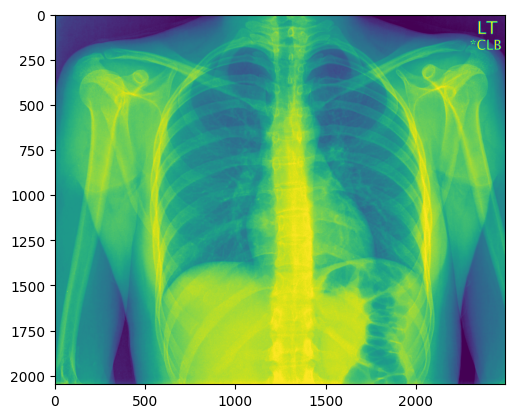

Caption: startseq but clear lungs.                                                                                                                         


In [34]:
z = 1252
pic = list(features.keys())[z]
#image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image = features[pic].reshape((1,14))
x = plt.imread(images+pic)
plt.imshow(x)
plt.show()
print("Caption:", Image_Caption(image))